## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2023-09-12 08:43:19.718551: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Tensorflow/Keras: 2.11.0
sklearn: 1.3.0


## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

In [4]:
# params
DOE =[1,10,1] #Design of experiment
v0_guess = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
flag_save = True

## NN: 1-10-1

----------------------------------------------------------------------------------------------------
NN structure: 1-10-1
****************************************************************************************************
In df n.1/10 we have 109 scenes
df n.1, scene n.0/109
    We have 3 time intervals inside [2.24,2.84]
    * err= 0.10223810732047932
    * Learning rate NN = 6.560998826898867e-06
    * diff = 5.212437383106394e-08


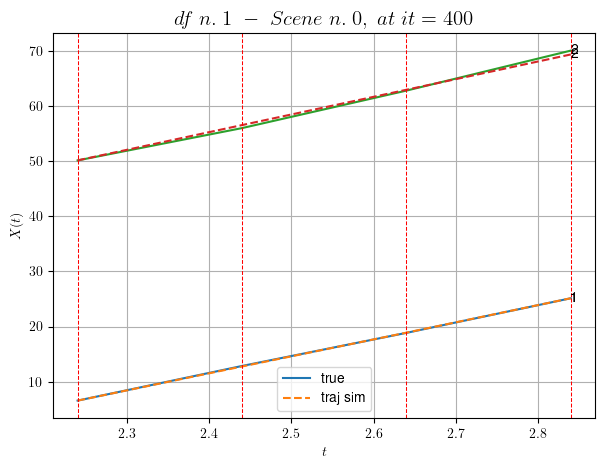

        For scene 0/109
        * use LR_NN=1e-05 with err=0.5349740025788211 at it=24
        * v0_scn_mean = 31.97726088611078
        * MAE = 0.1022380962193694



df n.1, scene n.1/109
    We have 2 time intervals inside [16.44,16.84]
    * err= 0.30020068477160455
    * Learning rate NN = 8.099998922261875e-06
    * diff = 9.532096403863655e-07


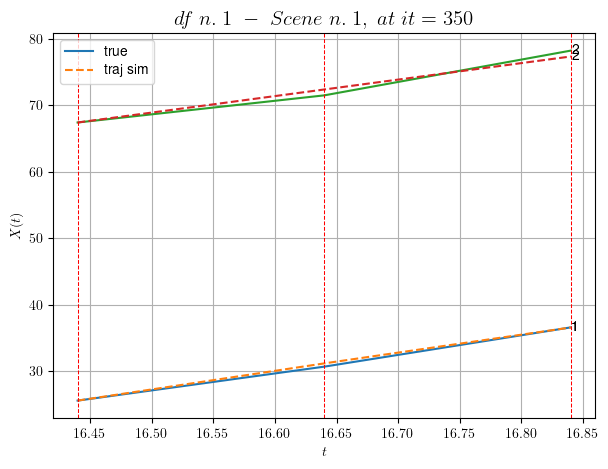

        For scene 1/109
        * use LR_NN=1e-05 with err=0.8888258870791874 at it=24
        * v0_scn_mean = 25.115217273041413
        * MAE = 0.2752089778597403



df n.1, scene n.2/109
    We have 3 time intervals inside [33.44,34.04]
            - Time interval n.0: [33.44, 33.64]
                * y_true: [32.35068864]
                * v_ann: [32.34784698486328, 20.73562398523797]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [33.64, 33.84]
                * y_true: [29.86084509]
                * v_ann: [28.410675048828125, 20.73562398523797]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [33.84, 34.04]
                * y_true: [27.63106672]
                * v_ann: [29.05702781677246, 20.73562398523797]

--------------------------------------------------------------------------------------------------

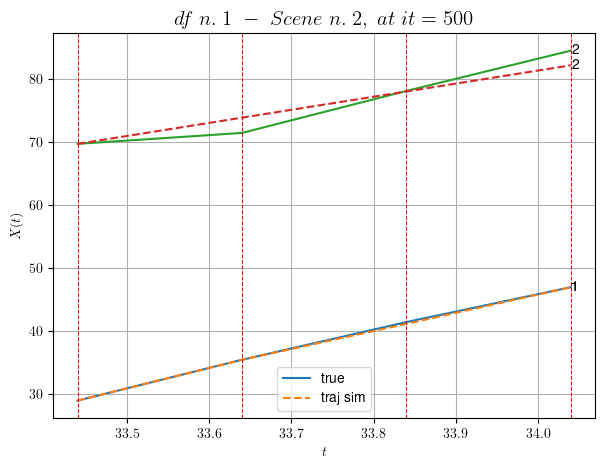

        For scene 2/109
        * use LR_NN=1e-05 with err=5.230920919439614 at it=24
        * v0_scn_mean = 21.10619902575753
        * MAE = 1.2198835804227448



df n.1, scene n.3/109
    We have 4 time intervals inside [37.44,38.24]
            - Time interval n.0: [37.44, 37.64]
                * y_true: [20.4107518]
                * v_ann: [26.0789852142334, 27.295254165821113]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [37.64, 37.84]
                * y_true: [26.78126893]
                * v_ann: [26.330944061279297, 27.295254165821113]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [37.84, 38.04]
                * y_true: [36.04216131]
                * v_ann: [25.740863800048828, 27.295254165821113]

--------------------------------------------------------------------------------------------------

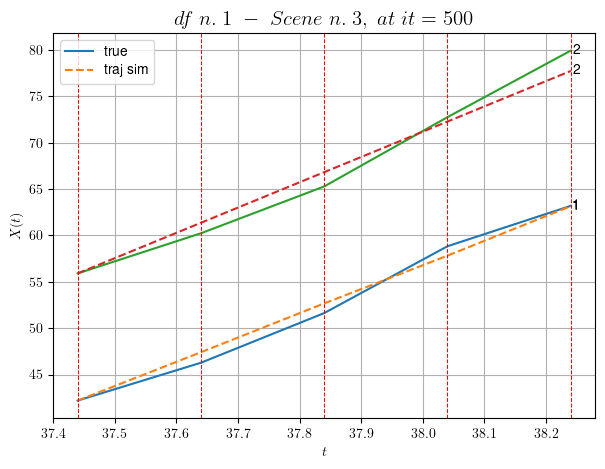

        For scene 3/109
        * use LR_NN=5e-05 with err=1.4551639173624993 at it=24
        * v0_scn_mean = 27.403443999167504
        * MAE = 1.0995274464064377



df n.1, scene n.4/109
    We have 3 time intervals inside [44.24,44.84]
            - Time interval n.0: [44.24, 44.44]
                * y_true: [28.36118373]
                * v_ann: [25.062143325805664, 29.733272374894167]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [44.44, 44.64]
                * y_true: [26.45136946]
                * v_ann: [26.315685272216797, 29.733272374894167]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [44.64, 44.84]
                * y_true: [23.12145598]
                * v_ann: [26.434900283813477, 29.733272374894167]

---------------------------------------------------------------------------------------------

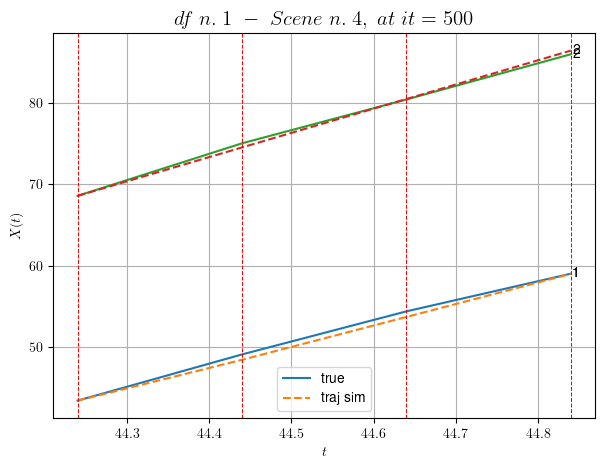

        For scene 4/109
        * use LR_NN=5e-05 with err=0.20814160258352155 at it=24
        * v0_scn_mean = 29.743941479896318
        * MAE = 0.15080007498049755



df n.1, scene n.5/109
    We have 5 time intervals inside [52.84,53.84]
            - Time interval n.0: [52.84, 53.04]
                * y_true: [24.68117551]
                * v_ann: [29.713157653808594, 35.9128223540259]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [53.04, 53.24]
                * y_true: [30.52180624]
                * v_ann: [27.516016006469727, 35.9128223540259]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [53.24, 53.44]
                * y_true: [31.41247605]
                * v_ann: [26.192564010620117, 35.9128223540259]

-------------------------------------------------------------------------------------------------

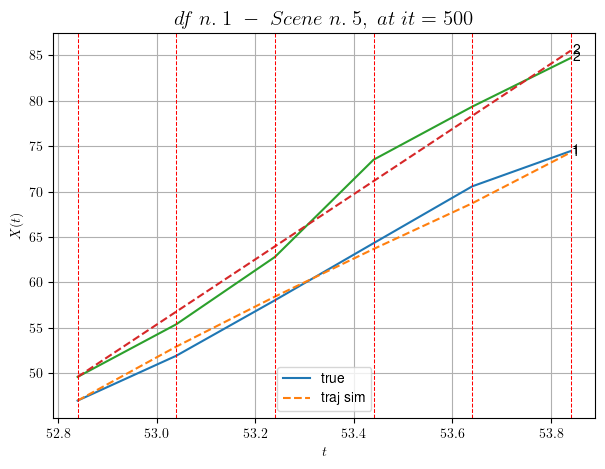

        For scene 5/109
        * use LR_NN=0.001 with err=16.074733070831716 at it=24
        * v0_scn_mean = 35.676309459910044
        * MAE = 1.2718419680942494



df n.1, scene n.6/109
    We have 2 time intervals inside [54.84,55.24]
            - Time interval n.0: [54.84, 55.04]
                * y_true: [39.69303006]
                * v_ann: [36.67112731933594, 30.333444658289288]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [55.04, 55.24]
                * y_true: [27.26241914]
                * v_ann: [30.97646713256836, 30.333444658289288]

----------------------------------------------------------------------------------------------------
    * err= 0.3222869424566485
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0008575206313761186


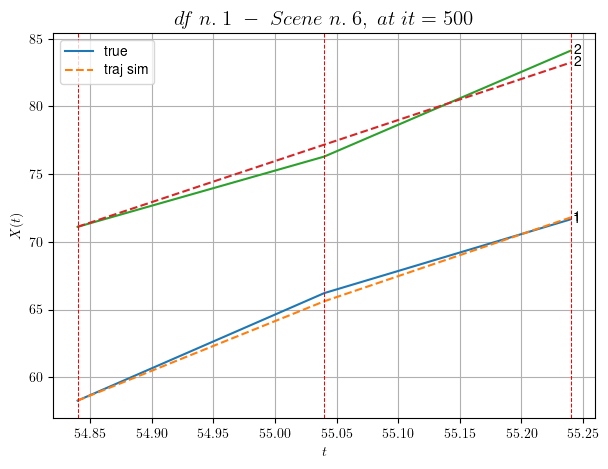

        For scene 6/109
        * use LR_NN=0.0001 with err=0.3109936037137625 at it=24
        * v0_scn_mean = 30.320106871960196
        * MAE = 0.3222869424566485



df n.1, scene n.7/109
    We have 4 time intervals inside [56.84,57.64]
            - Time interval n.0: [56.84, 57.04]
                * y_true: [23.35104229]
                * v_ann: [23.48634910583496, 35.49695649017792]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [57.04, 57.24]
                * y_true: [29.99173244]
                * v_ann: [24.910669326782227, 35.49695649017792]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [57.24, 57.44]
                * y_true: [26.49185212]
                * v_ann: [27.777517318725586, 35.49695649017792]

------------------------------------------------------------------------------------------------

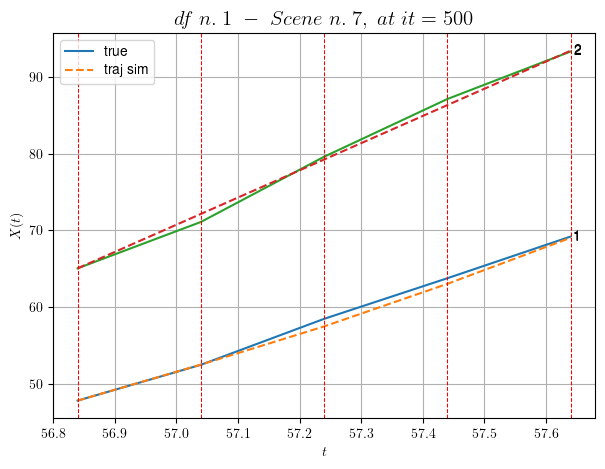

        For scene 7/109
        * use LR_NN=5e-05 with err=4.455131192971994 at it=24
        * v0_scn_mean = 35.27707823061246
        * MAE = 0.3412724955209507



df n.1, scene n.8/109
    We have 4 time intervals inside [60.04,60.84]
            - Time interval n.0: [60.04, 60.24]
                * y_true: [32.6313833]
                * v_ann: [33.992897033691406, 26.52161959108589]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [60.24, 60.44]
                * y_true: [35.39191239]
                * v_ann: [30.62832260131836, 26.52161959108589]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [60.44, 60.64]
                * y_true: [29.16197739]
                * v_ann: [28.9251651763916, 26.52161959108589]

----------------------------------------------------------------------------------------------------
 

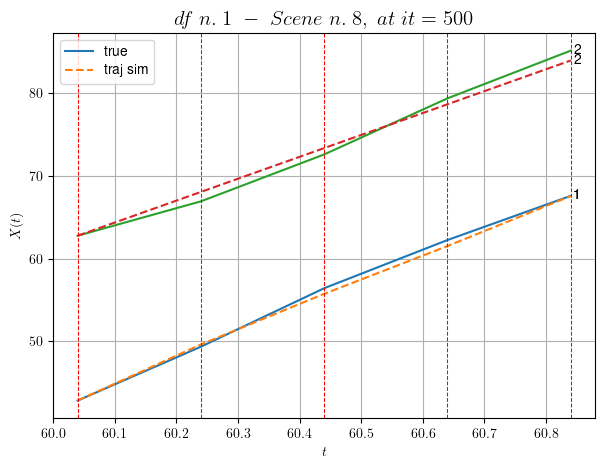

        For scene 8/109
        * use LR_NN=5e-05 with err=1.3566080981643656 at it=24
        * v0_scn_mean = 26.660754807415856
        * MAE = 0.4391846186692252



df n.1, scene n.9/109
    We have 5 time intervals inside [80.64,81.64]
            - Time interval n.0: [80.64, 80.84]
                * y_true: [33.34215633]
                * v_ann: [32.286460876464844, 29.042810010339032]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [80.84, 81.04]
                * y_true: [31.76283343]
                * v_ann: [34.21686935424805, 29.042810010339032]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [81.04, 81.24]
                * y_true: [32.4827505]
                * v_ann: [28.61882781982422, 29.042810010339032]

------------------------------------------------------------------------------------------------

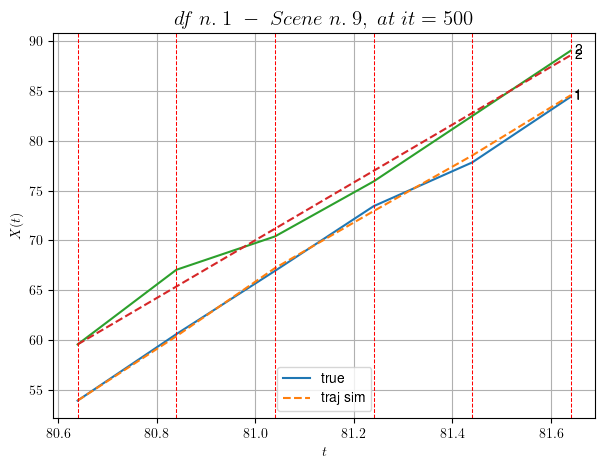

        For scene 9/109
        * use LR_NN=0.0001 with err=1.303668485899672 at it=24
        * v0_scn_mean = 29.081097609918217
        * MAE = 0.4785833482340131



df n.1, scene n.10/109
    We have 3 time intervals inside [87.84,88.44]
            - Time interval n.0: [87.84, 88.04]
                * y_true: [31.60011691]
                * v_ann: [30.22161102294922, 31.600487611858963]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [88.04, 88.24]
                * y_true: [32.50025586]
                * v_ann: [30.155033111572266, 31.600487611858963]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [88.24, 88.44]
                * y_true: [26.76036252]
                * v_ann: [30.456632614135742, 31.600487611858963]

---------------------------------------------------------------------------------------------

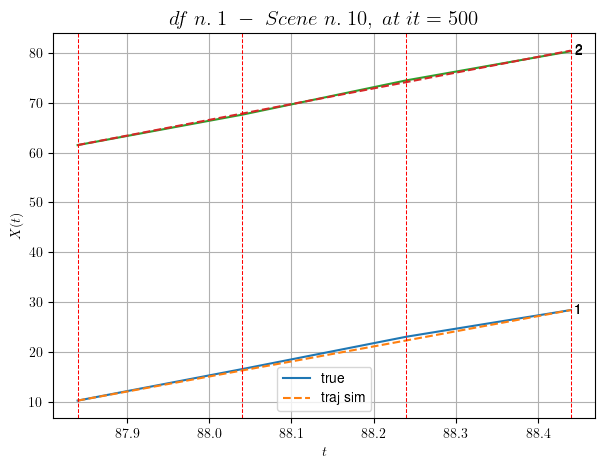

        For scene 10/109
        * use LR_NN=1e-05 with err=0.31115570376864 at it=24
        * v0_scn_mean = 31.536468107396626
        * MAE = 0.10240015056245876



df n.1, scene n.11/109
    We have 5 time intervals inside [89.04,90.04]
            - Time interval n.0: [89.04, 89.24]
                * y_true: [23.80112307]
                * v_ann: [24.63871955871582, 33.126452558658514]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [89.24, 89.44]
                * y_true: [30.25175591]
                * v_ann: [26.540058135986328, 33.126452558658514]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [89.44, 89.64]
                * y_true: [26.85189703]
                * v_ann: [27.24202537536621, 33.126452558658514]

----------------------------------------------------------------------------------------------

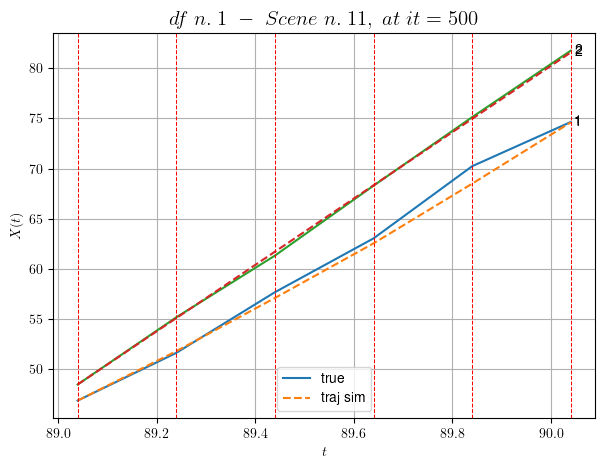

        For scene 11/109
        * use LR_NN=0.001 with err=5.673526812174994 at it=24
        * v0_scn_mean = 33.00139445633616
        * MAE = 0.2950223436818033



df n.1, scene n.12/109
    We have 3 time intervals inside [90.84,91.44]
            - Time interval n.0: [90.84, 91.04]
                * y_true: [30.30091015]
                * v_ann: [36.364620208740234, 39.26169927714716]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [91.04, 91.24]
                * y_true: [32.01131791]
                * v_ann: [37.63448715209961, 39.26169927714716]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [91.24, 91.44]
                * y_true: [49.37285732]
                * v_ann: [38.425296783447266, 39.26169927714716]

-------------------------------------------------------------------------------------------------

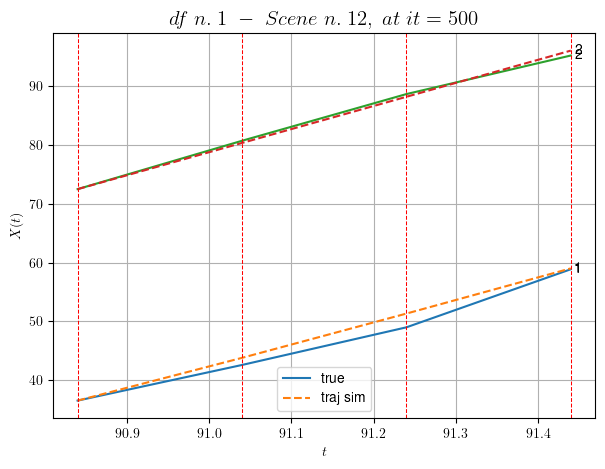

        For scene 12/109
        * use LR_NN=1e-05 with err=6.251403763683389 at it=24
        * v0_scn_mean = 38.89123130613216
        * MAE = 0.9975800450589332



df n.1, scene n.13/109
    We have 3 time intervals inside [109.24,109.84]
            - Time interval n.0: [109.24, 109.44]
                * y_true: [27.49662615]
                * v_ann: [24.74913215637207, 36.8703602679524]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.44, 109.64]
                * y_true: [30.32701959]
                * v_ann: [29.318939208984375, 36.8703602679524]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.64, 109.84]
                * y_true: [27.65727146]
                * v_ann: [30.8472957611084, 36.8703602679524]

----------------------------------------------------------------------------------------------

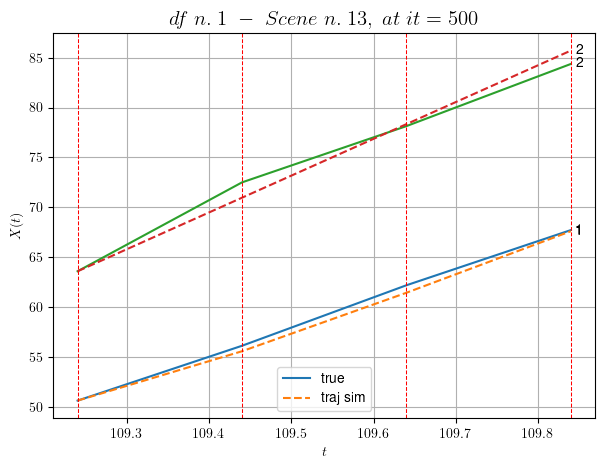

        For scene 13/109
        * use LR_NN=0.001 with err=2.9237112393885543 at it=24
        * v0_scn_mean = 36.59554585728717
        * MAE = 0.47237171472648537



df n.1, scene n.14/109
    We have 5 time intervals inside [116.04,117.04]
            - Time interval n.0: [116.04, 116.24]
                * y_true: [26.72014114]
                * v_ann: [32.37965774536133, 35.75445949476147]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [116.24, 116.44]
                * y_true: [27.07912387]
                * v_ann: [33.91474914550781, 35.75445949476147]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [116.44, 116.64]
                * y_true: [35.55057522]
                * v_ann: [31.298192977905273, 35.75445949476147]

----------------------------------------------------------------------------------------

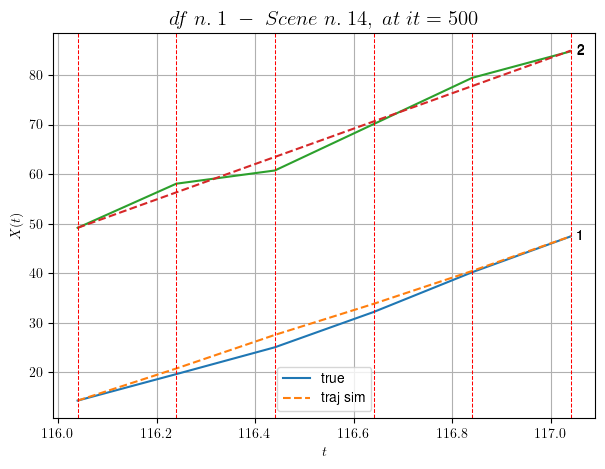

        For scene 14/109
        * use LR_NN=5e-05 with err=7.927039561452908 at it=24
        * v0_scn_mean = 35.52428111501499
        * MAE = 1.9759597054260807



df n.1, scene n.15/109
    We have 3 time intervals inside [120.84,121.44]
            - Time interval n.0: [120.84, 121.04]
                * y_true: [31.55149536]
                * v_ann: [29.614456176757812, 32.626423372882826]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.04, 121.24]
                * y_true: [29.5468664]
                * v_ann: [29.670969009399414, 32.626423372882826]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.24, 121.44]
                * y_true: [28.27701719]
                * v_ann: [30.046913146972656, 32.626423372882826]

--------------------------------------------------------------------------------------

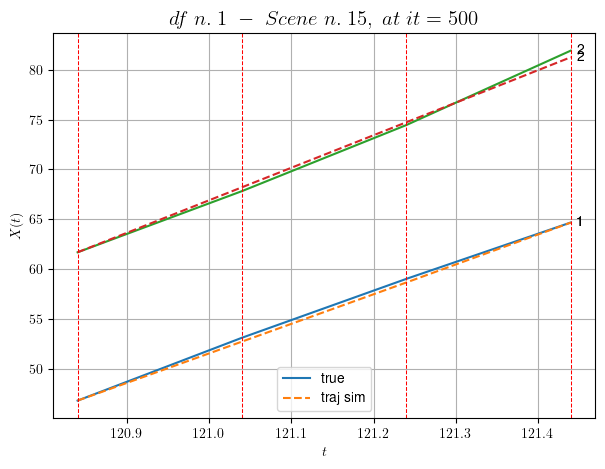

        For scene 15/109
        * use LR_NN=5e-05 with err=0.7645564202696647 at it=24
        * v0_scn_mean = 32.521366437987375
        * MAE = 0.1183679876083646



df n.1, scene n.16/109
    We have 4 time intervals inside [130.64,131.44]
            - Time interval n.0: [130.64, 130.84]
                * y_true: [25.75092635]
                * v_ann: [25.327163696289062, 33.61924590429362]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [130.84, 131.04]
                * y_true: [30.67141813]
                * v_ann: [27.35093879699707, 33.61924590429362]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [131.04, 131.24]
                * y_true: [29.07678141]
                * v_ann: [30.392559051513672, 33.61924590429362]

---------------------------------------------------------------------------------------

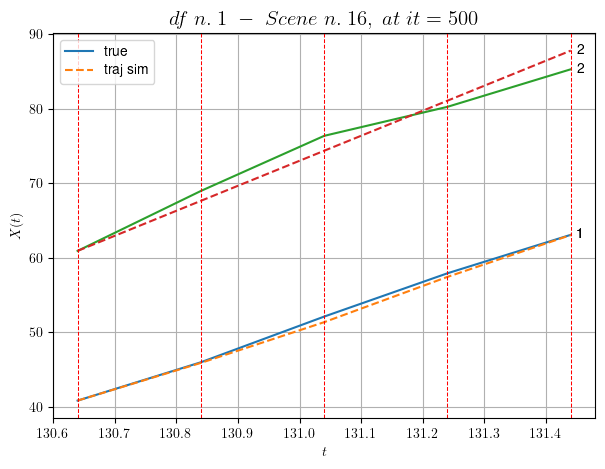

        For scene 16/109
        * use LR_NN=0.0005 with err=1.860013027705694 at it=24
        * v0_scn_mean = 33.47447606815006
        * MAE = 1.1696740966964274



df n.1, scene n.17/109
    We have 3 time intervals inside [140.64,141.24]
            - Time interval n.0: [140.64, 140.84]
                * y_true: [23.34058075]
                * v_ann: [26.389270782470703, 34.92834910020561]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [140.84, 141.04]
                * y_true: [28.71099355]
                * v_ann: [27.68865203857422, 34.92834910020561]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [141.04, 141.24]
                * y_true: [30.37630847]
                * v_ann: [28.612226486206055, 34.92834910020561]

----------------------------------------------------------------------------------------

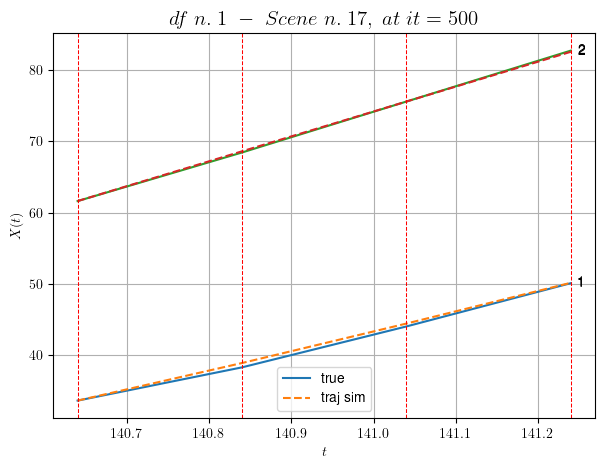

        For scene 17/109
        * use LR_NN=1e-05 with err=1.8264705886521178 at it=24
        * v0_scn_mean = 34.73121513623549
        * MAE = 0.0741301276575217



df n.1, scene n.18/109
    We have 2 time intervals inside [142.04,142.44]
            - Time interval n.0: [142.04, 142.24]
                * y_true: [28.28132547]
                * v_ann: [32.599082946777344, 28.963485178029217]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [142.24, 142.44]
                * y_true: [36.36221879]
                * v_ann: [32.0035285949707, 28.963485178029217]

----------------------------------------------------------------------------------------------------
    * err= 0.1327310997284256
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 3.729276205344245e-06


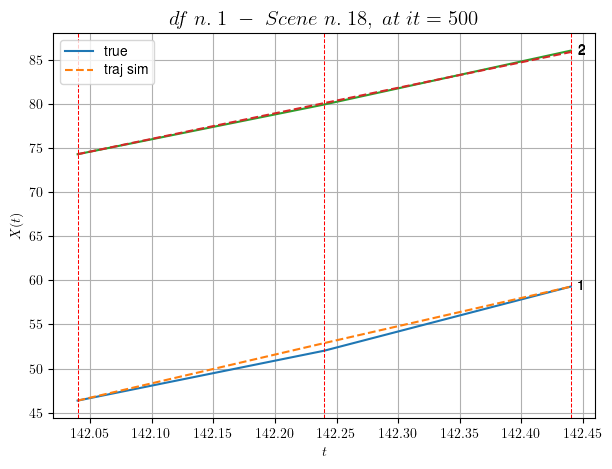

        For scene 18/109
        * use LR_NN=5e-05 with err=0.21453206922949142 at it=24
        * v0_scn_mean = 29.00494577090021
        * MAE = 0.12268233166748982



df n.1, scene n.19/109
    We have 2 time intervals inside [146.24,146.64]
    * err= 0.023356577584254676
    * Learning rate NN = 8.099998922261875e-06
    * diff = 2.447447037048911e-07


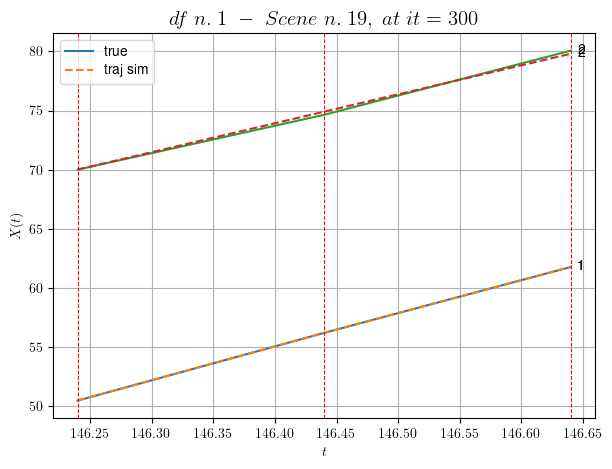

        For scene 19/109
        * use LR_NN=1e-05 with err=0.9422327581850756 at it=24
        * v0_scn_mean = 24.848964336982476
        * MAE = 0.021716220379126114



df n.1, scene n.20/109
    We have 4 time intervals inside [159.84,160.64]
            - Time interval n.0: [159.84, 160.04]
                * y_true: [27.05016252]
                * v_ann: [26.394515991210938, 29.799065415673887]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [160.04, 160.24]
                * y_true: [26.40027468]
                * v_ann: [26.785371780395508, 29.799065415673887]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [160.24, 160.44]
                * y_true: [26.21039649]
                * v_ann: [27.057228088378906, 29.799065415673887]

---------------------------------------------------------------------------------

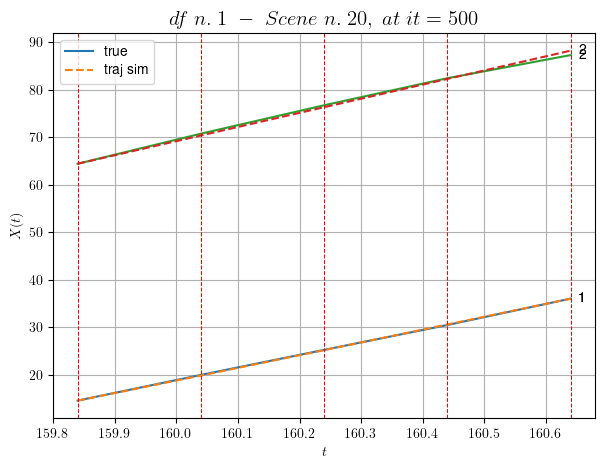

        For scene 20/109
        * use LR_NN=1e-05 with err=0.14743120074516997 at it=24
        * v0_scn_mean = 29.80710279904611
        * MAE = 0.12461715605138136



df n.1, scene n.21/109
    We have 2 time intervals inside [193.24,193.64]
            - Time interval n.0: [193.24, 193.44]
                * y_true: [31.99185522]
                * v_ann: [38.636104583740234, 38.083999376913425]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [193.44, 193.64]
                * y_true: [45.57332335]
                * v_ann: [39.332183837890625, 38.083999376913425]

----------------------------------------------------------------------------------------------------
    * err= 0.3222729735096852
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0013818702269954297


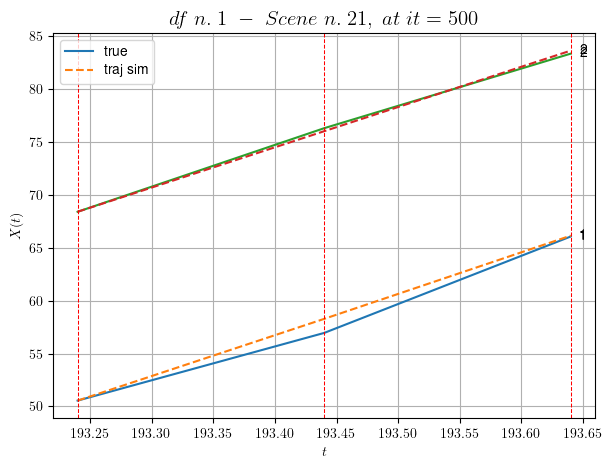

        For scene 21/109
        * use LR_NN=5e-05 with err=2.308891000872064 at it=24
        * v0_scn_mean = 37.760639401899205
        * MAE = 0.3203629928075683



df n.1, scene n.22/109
    We have 3 time intervals inside [194.84,195.44]
            - Time interval n.0: [194.84, 195.04]
                * y_true: [28.55698867]
                * v_ann: [35.49159622192383, 35.59272326000108]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [195.04, 195.24]
                * y_true: [40.37855819]
                * v_ann: [36.829097747802734, 35.59272326000108]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [195.24, 195.44]
                * y_true: [39.37369802]
                * v_ann: [36.418766021728516, 35.59272326000108]

----------------------------------------------------------------------------------------

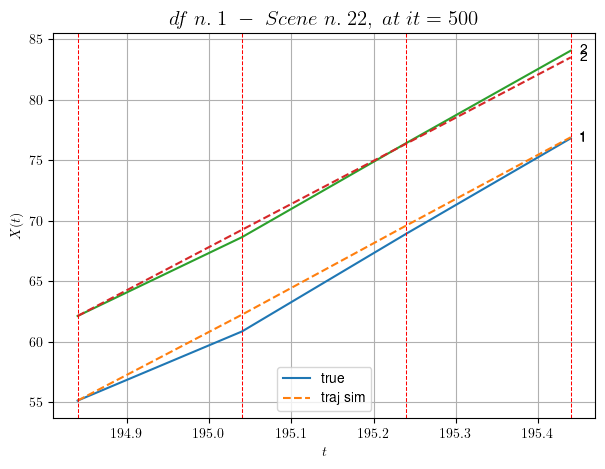

        For scene 22/109
        * use LR_NN=0.0001 with err=2.8296610280564543 at it=24
        * v0_scn_mean = 35.36901432964371
        * MAE = 0.3826107231250385



df n.1, scene n.23/109
    We have 2 time intervals inside [199.44,199.84]
            - Time interval n.0: [199.44, 199.64]
                * y_true: [34.74310553]
                * v_ann: [36.26205062866211, 22.403012729860887]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [199.64, 199.84]
                * y_true: [34.7739018]
                * v_ann: [32.96845626831055, 22.403012729860887]

----------------------------------------------------------------------------------------------------
    * err= 0.015928511469794564
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0007440657683689955


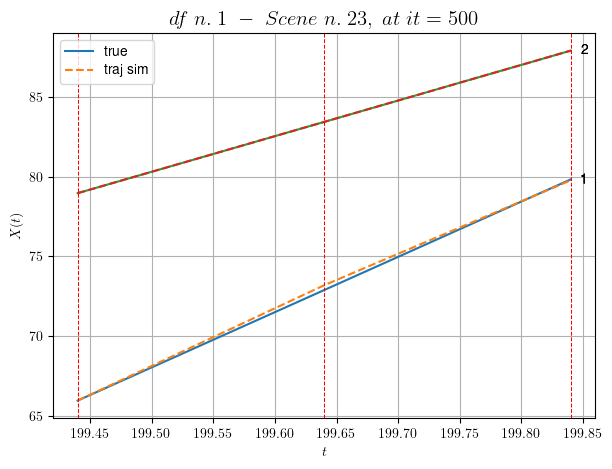

        For scene 23/109
        * use LR_NN=0.0001 with err=2.009714516849058 at it=24
        * v0_scn_mean = 22.70689222060831
        * MAE = 0.015928511469794564



df n.1, scene n.24/109
    We have 4 time intervals inside [200.44,201.24]
            - Time interval n.0: [200.44, 200.64]
                * y_true: [32.7110423]
                * v_ann: [35.31316375732422, 30.71027389121814]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [200.64, 200.84]
                * y_true: [31.56133984]
                * v_ann: [30.836275100708008, 30.71027389121814]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [200.84, 201.04]
                * y_true: [30.91169527]
                * v_ann: [31.00909423828125, 30.71027389121814]

----------------------------------------------------------------------------------------

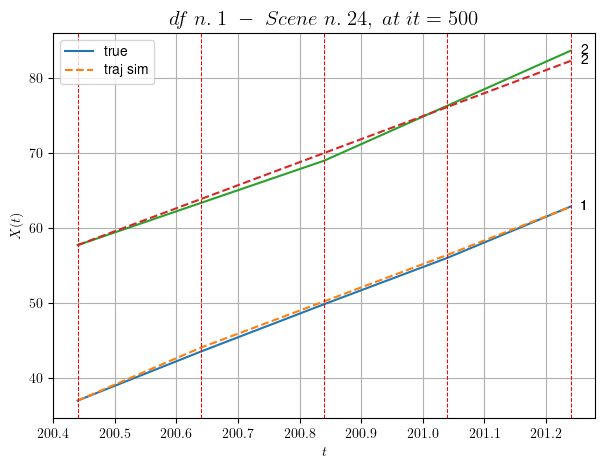

        For scene 24/109
        * use LR_NN=0.001 with err=0.4924357515495486 at it=24
        * v0_scn_mean = 30.681862935575044
        * MAE = 0.34376323035529754



df n.1, scene n.25/109
    We have 3 time intervals inside [209.64,210.24]
            - Time interval n.0: [209.64, 209.84]
                * y_true: [26.81089057]
                * v_ann: [28.922861099243164, 31.507071372239466]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [209.84, 210.04]
                * y_true: [27.83624351]
                * v_ann: [29.31512451171875, 31.507071372239466]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [210.04, 210.24]
                * y_true: [33.3769543]
                * v_ann: [29.912635803222656, 31.507071372239466]

------------------------------------------------------------------------------------

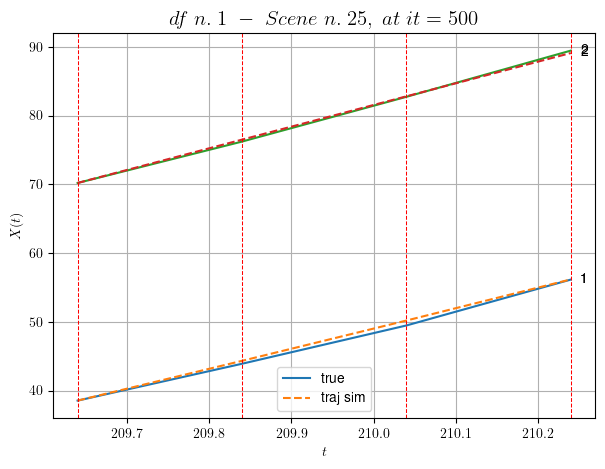

        For scene 25/109
        * use LR_NN=1e-05 with err=0.3029577475551948 at it=24
        * v0_scn_mean = 31.446788517361316
        * MAE = 0.112478988823962



df n.1, scene n.26/109
    We have 3 time intervals inside [219.64,220.24]
            - Time interval n.0: [219.64, 219.84]
                * y_true: [40.60281708]
                * v_ann: [39.638919830322266, 31.715821070729696]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [219.84, 220.04]
                * y_true: [27.552367]
                * v_ann: [33.30126190185547, 31.715821070729696]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [220.04, 220.24]
                * y_true: [40.55423042]
                * v_ann: [36.71812438964844, 31.715821070729696]

----------------------------------------------------------------------------------------

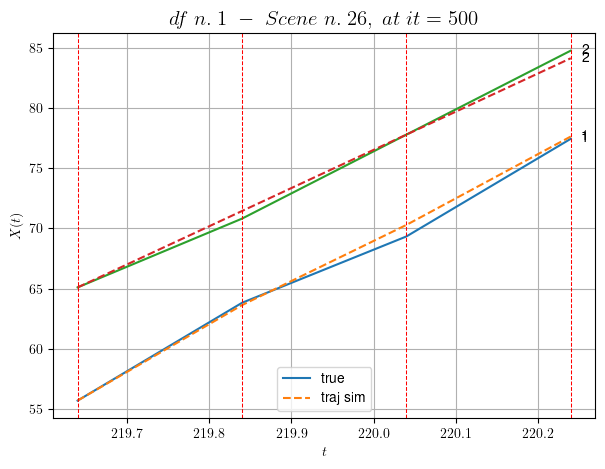

        For scene 26/109
        * use LR_NN=0.0001 with err=0.5044841994751543 at it=24
        * v0_scn_mean = 31.647188227913865
        * MAE = 0.22369113778966968



df n.1, scene n.27/109
    We have 3 time intervals inside [230.04,230.64]
            - Time interval n.0: [230.04, 230.24]
                * y_true: [32.9915228]
                * v_ann: [33.21773910522461, 32.80710231491763]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [230.24, 230.44]
                * y_true: [28.89168758]
                * v_ann: [32.49319076538086, 32.80710231491763]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [230.44, 230.64]
                * y_true: [37.53279475]
                * v_ann: [33.90899658203125, 32.80710231491763]

----------------------------------------------------------------------------------------

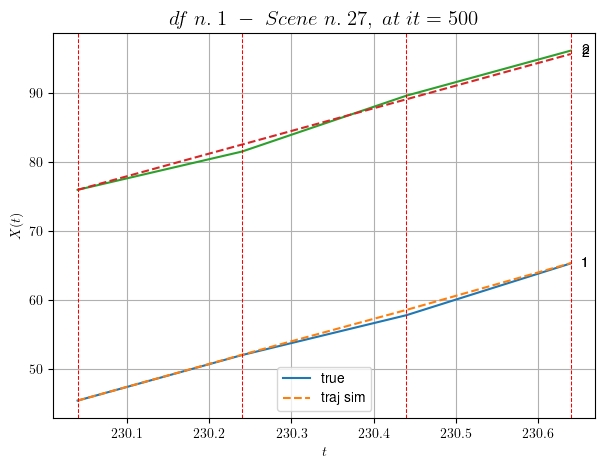

        For scene 27/109
        * use LR_NN=1e-05 with err=1.0003607513849955 at it=24
        * v0_scn_mean = 32.69481822234281
        * MAE = 0.26559425841608714



df n.1, scene n.28/109
    We have 4 time intervals inside [239.44,240.24]
            - Time interval n.0: [239.44, 239.64]
                * y_true: [28.64102922]
                * v_ann: [38.794456481933594, 25.426381424530028]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [239.64, 239.84]
                * y_true: [37.49184091]
                * v_ann: [36.282806396484375, 25.426381424530028]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [239.84, 240.04]
                * y_true: [42.66274465]
                * v_ann: [33.705013275146484, 25.426381424530028]

-----------------------------------------------------------------------------------

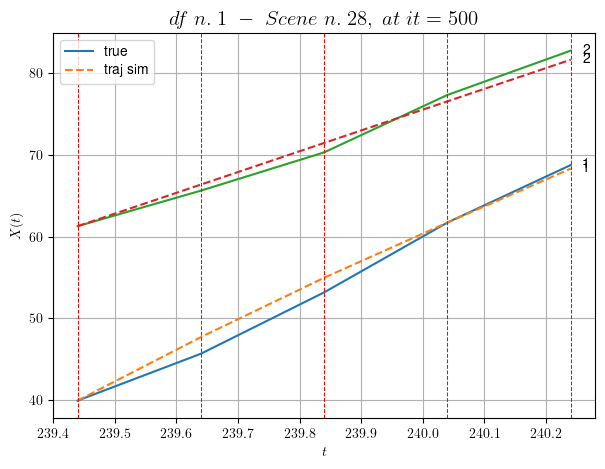

        For scene 28/109
        * use LR_NN=5e-05 with err=3.5757602692124517 at it=24
        * v0_scn_mean = 25.60932616751416
        * MAE = 1.1208652538752801



df n.1, scene n.29/109
    We have 3 time intervals inside [249.84,250.44]
            - Time interval n.0: [249.84, 250.04]
                * y_true: [33.33234882]
                * v_ann: [33.92094039916992, 35.366236560848385]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [250.04, 250.24]
                * y_true: [34.40255424]
                * v_ann: [35.035526275634766, 35.366236560848385]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [250.24, 250.44]
                * y_true: [35.86374718]
                * v_ann: [34.655792236328125, 35.366236560848385]

-------------------------------------------------------------------------------------

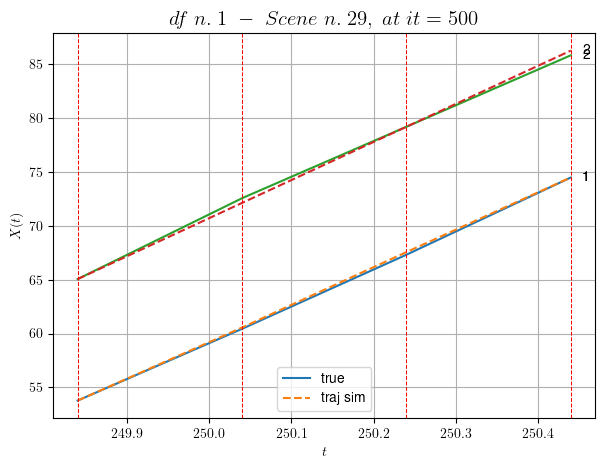

        For scene 29/109
        * use LR_NN=5e-05 with err=1.8340166690145678 at it=24
        * v0_scn_mean = 35.15158709845555
        * MAE = 0.05078372452648047



df n.1, scene n.30/109
    We have 4 time intervals inside [251.44,252.24]
            - Time interval n.0: [251.44, 251.64]
                * y_true: [32.20057892]
                * v_ann: [28.1711483001709, 35.463328018322514]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [251.64, 251.84]
                * y_true: [27.90071663]
                * v_ann: [28.72159194946289, 35.463328018322514]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [251.84, 252.04]
                * y_true: [31.20108088]
                * v_ann: [29.455598831176758, 35.463328018322514]

--------------------------------------------------------------------------------------

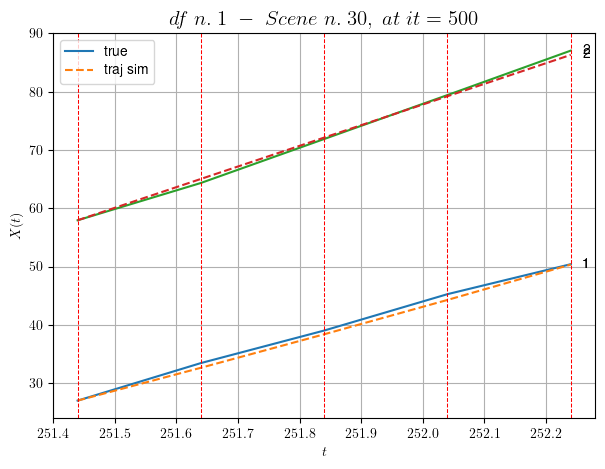

        For scene 30/109
        * use LR_NN=5e-05 with err=4.55843961572658 at it=24
        * v0_scn_mean = 35.24479489763175
        * MAE = 0.3146475023495872



df n.1, scene n.31/109
    We have 10 time intervals inside [261.64,263.64]
            - Time interval n.0: [261.64, 261.84]
                * y_true: [20.93010778]
                * v_ann: [26.987640380859375, 31.892740284546104]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [261.84, 262.04]
                * y_true: [19.94015095]
                * v_ann: [31.001489639282227, 31.892740284546104]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [262.04, 262.24]
                * y_true: [30.02039251]
                * v_ann: [32.14318084716797, 31.892740284546104]

--------------------------------------------------------------------------------------

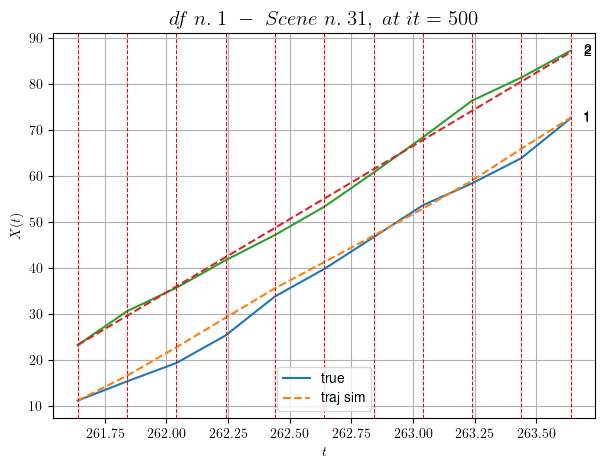

        For scene 31/109
        * use LR_NN=0.0001 with err=4.858118528506955 at it=24
        * v0_scn_mean = 31.81703067317843
        * MAE = 2.3277938171257393



df n.1, scene n.32/109
    We have 3 time intervals inside [271.04,271.64]
            - Time interval n.0: [271.04, 271.24]
                * y_true: [29.28204901]
                * v_ann: [32.39630889892578, 36.29888466501553]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [271.24, 271.44]
                * y_true: [38.30326342]
                * v_ann: [35.909420013427734, 36.29888466501553]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [271.44, 271.64]
                * y_true: [35.20368408]
                * v_ann: [34.87473678588867, 36.29888466501553]

-----------------------------------------------------------------------------------------

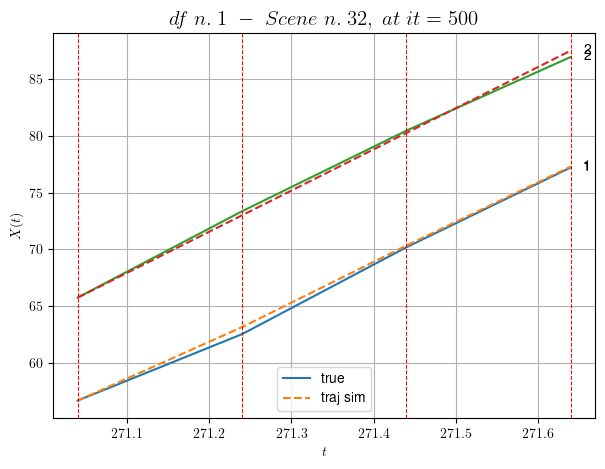

        For scene 32/109
        * use LR_NN=5e-05 with err=2.561490324581239 at it=24
        * v0_scn_mean = 36.04692927846295
        * MAE = 0.10800810264340915



df n.1, scene n.33/109
    We have 4 time intervals inside [272.24,273.04]
            - Time interval n.0: [272.24, 272.44]
                * y_true: [28.87017174]
                * v_ann: [33.233158111572266, 35.468782603099775]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [272.44, 272.64]
                * y_true: [34.43039204]
                * v_ann: [33.50504684448242, 35.468782603099775]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [272.64, 272.84]
                * y_true: [31.36055806]
                * v_ann: [34.34626007080078, 35.468782603099775]

--------------------------------------------------------------------------------------

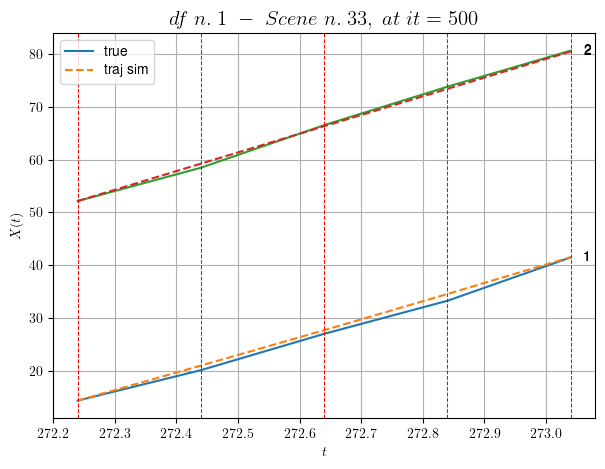

        For scene 33/109
        * use LR_NN=1e-05 with err=4.28242993640114 at it=24
        * v0_scn_mean = 35.25003129901785
        * MAE = 0.37036202027548354



df n.1, scene n.34/109
    We have 5 time intervals inside [291.64,292.64]
            - Time interval n.0: [291.64, 291.84]
                * y_true: [35.45036349]
                * v_ann: [37.600582122802734, 34.1190956887507]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [291.84, 292.04]
                * y_true: [41.11075316]
                * v_ann: [38.58729553222656, 34.1190956887507]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [292.04, 292.24]
                * y_true: [34.09093472]
                * v_ann: [37.50237274169922, 34.1190956887507]

---------------------------------------------------------------------------------------------

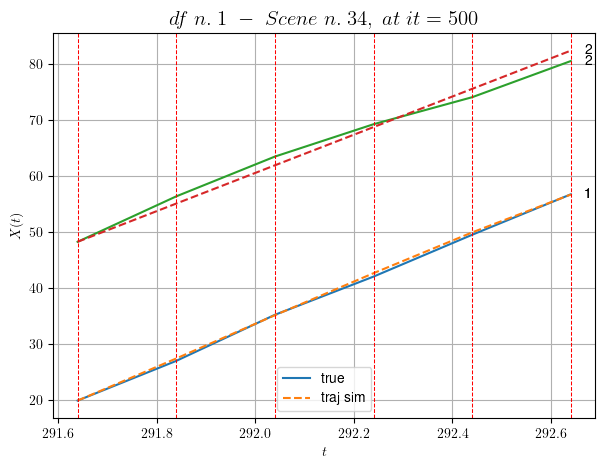

        For scene 34/109
        * use LR_NN=1e-05 with err=2.7764305584492956 at it=24
        * v0_scn_mean = 33.95433186123164
        * MAE = 0.765373311508664



df n.1, scene n.35/109
    We have 3 time intervals inside [294.64,295.24]
            - Time interval n.0: [294.64, 294.84]
                * y_true: [25.10005748]
                * v_ann: [24.916582107543945, 31.912591419187383]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [294.84, 295.04]
                * y_true: [28.17013329]
                * v_ann: [25.50593376159668, 31.912591419187383]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [295.04, 295.24]
                * y_true: [22.14017228]
                * v_ann: [25.052974700927734, 31.912591419187383]

--------------------------------------------------------------------------------------

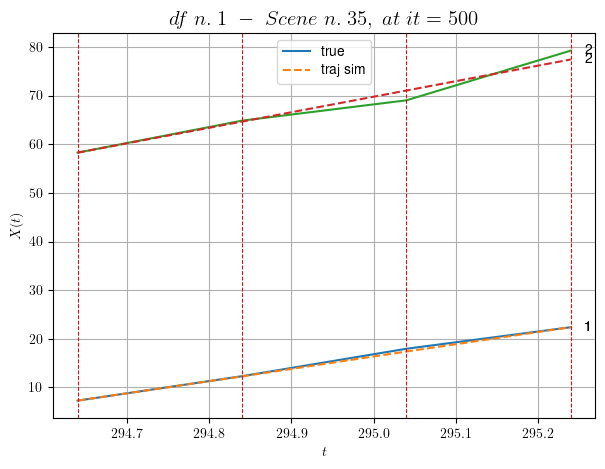

        For scene 35/109
        * use LR_NN=1e-05 with err=1.382064792564812 at it=24
        * v0_scn_mean = 31.83608776243291
        * MAE = 0.9654620821382796



df n.1, scene n.36/109
    We have 4 time intervals inside [296.44,297.24]
            - Time interval n.0: [296.44, 296.64]
                * y_true: [27.57673439]
                * v_ann: [21.184276580810547, 32.254865471371716]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [296.64, 296.84]
                * y_true: [19.54627216]
                * v_ann: [24.099637985229492, 32.254865471371716]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [296.84, 297.04]
                * y_true: [17.55160174]
                * v_ann: [25.886363983154297, 32.254865471371716]

-------------------------------------------------------------------------------------

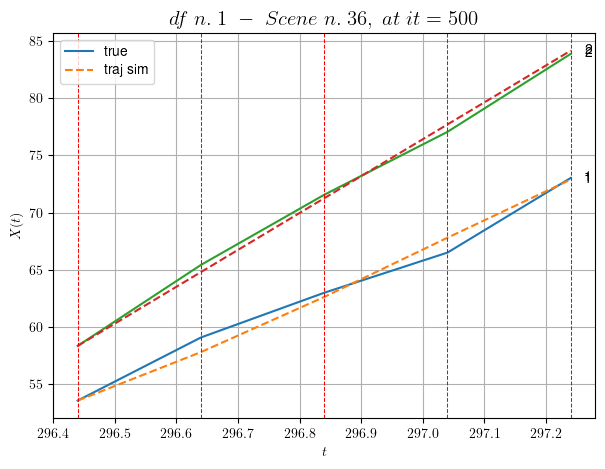

        For scene 36/109
        * use LR_NN=0.001 with err=1.5319844827470148 at it=24
        * v0_scn_mean = 32.1646708525344
        * MAE = 0.4457156549768729



df n.1, scene n.37/109
    We have 4 time intervals inside [298.04,298.84]
            - Time interval n.0: [298.04, 298.24]
                * y_true: [30.57625271]
                * v_ann: [22.933353424072266, 33.34266245905389]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [298.24, 298.44]
                * y_true: [30.57625271]
                * v_ann: [24.674888610839844, 33.34266245905389]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [298.44, 298.64]
                * y_true: [15.00082942]
                * v_ann: [28.81529998779297, 33.34266245905389]

-----------------------------------------------------------------------------------------

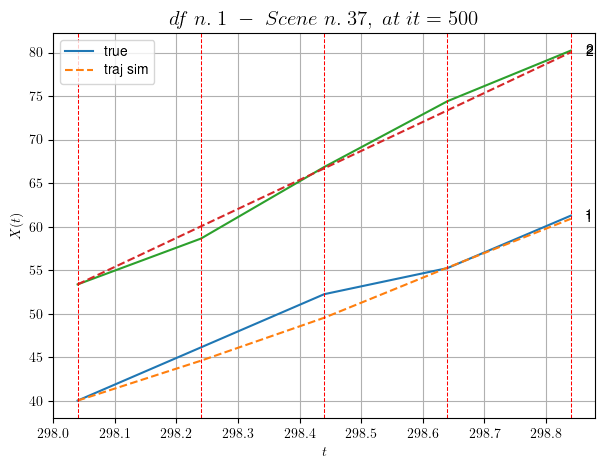

        For scene 37/109
        * use LR_NN=0.0005 with err=3.3639868461910374 at it=24
        * v0_scn_mean = 33.20895596071336
        * MAE = 1.2949615103824499



df n.1, scene n.38/109
    We have 5 time intervals inside [301.44,302.44]
            - Time interval n.0: [301.44, 301.64]
                * y_true: [23.98073382]
                * v_ann: [30.498085021972656, 25.446081747008222]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [301.64, 301.84]
                * y_true: [31.29145934]
                * v_ann: [29.90915870666504, 25.446081747008222]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [301.84, 302.04]
                * y_true: [33.7516476]
                * v_ann: [28.280567169189453, 25.446081747008222]

-------------------------------------------------------------------------------------

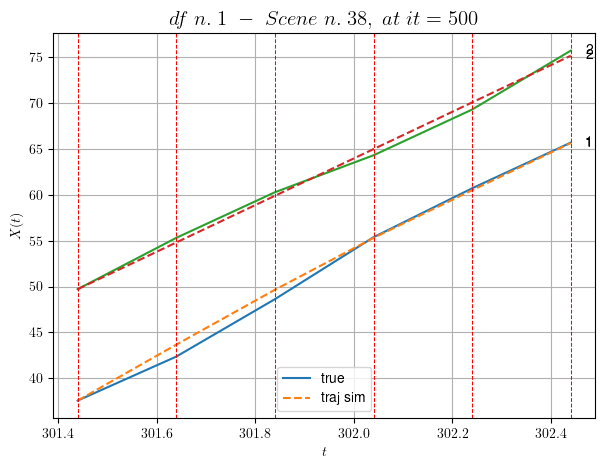

        For scene 38/109
        * use LR_NN=0.0005 with err=4.636441399719619 at it=24
        * v0_scn_mean = 25.628238477093138
        * MAE = 0.38110633889060286



df n.1, scene n.39/109
    We have 2 time intervals inside [307.24,307.64]
            - Time interval n.0: [307.24, 307.44]
                * y_true: [32.90225561]
                * v_ann: [29.954631805419922, 27.873164065567874]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [307.44, 307.64]
                * y_true: [25.81209386]
                * v_ann: [28.89285659790039, 27.873164065567874]

----------------------------------------------------------------------------------------------------
    * err= 0.07032866460411819
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 5.877937840591263e-05


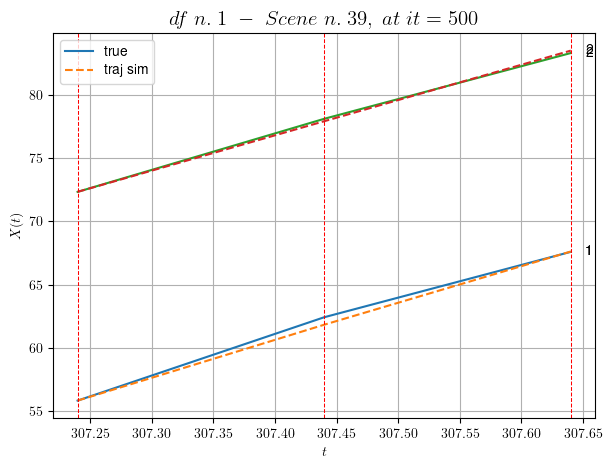

        For scene 39/109
        * use LR_NN=5e-05 with err=0.2507765937072994 at it=24
        * v0_scn_mean = 27.958237502928664
        * MAE = 0.07007782856784452



df n.1, scene n.40/109
    We have 2 time intervals inside [310.84,311.24]
    * err= 0.23605174987406807
    * Learning rate NN = 8.099999104160815e-05
    * diff = 6.65622978457403e-07


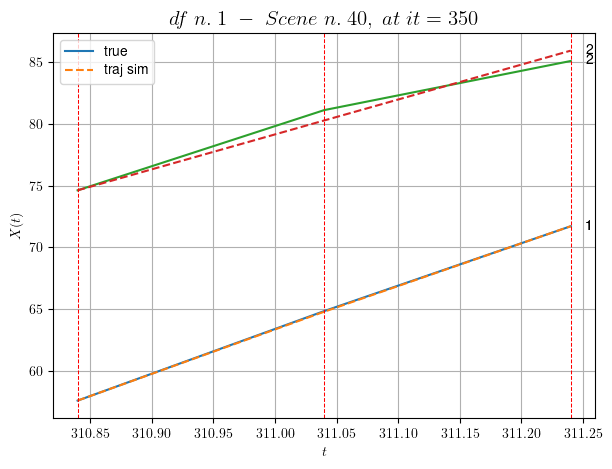

        For scene 40/109
        * use LR_NN=0.0001 with err=0.4206566806601196 at it=24
        * v0_scn_mean = 28.434738777930672
        * MAE = 0.23605174987406807



df n.1, scene n.41/109
    We have 3 time intervals inside [316.44,317.04]
            - Time interval n.0: [316.44, 316.64]
                * y_true: [37.30178767]
                * v_ann: [31.341022491455078, 37.33434122714779]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [316.64, 316.84]
                * y_true: [27.85170332]
                * v_ann: [30.91130828857422, 37.33434122714779]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [316.84, 317.04]
                * y_true: [32.2024108]
                * v_ann: [34.85652160644531, 37.33434122714779]

---------------------------------------------------------------------------------------

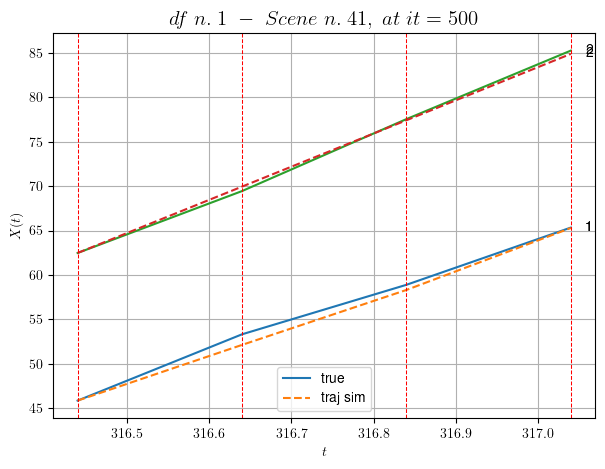

        For scene 41/109
        * use LR_NN=5e-05 with err=4.394351746159577 at it=24
        * v0_scn_mean = 37.04096757811747
        * MAE = 0.26916741051392823



df n.1, scene n.42/109
    We have 6 time intervals inside [317.64,318.84]
            - Time interval n.0: [317.64, 317.84]
                * y_true: [33.22656212]
                * v_ann: [-0.0021115171257406473, 33.19471835365481]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.84, 318.04]
                * y_true: [28.08686413]
                * v_ann: [-0.006499056238681078, 33.19471835365481]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.04, 318.24]
                * y_true: [26.80193964]
                * v_ann: [-3.522613042150624e-05, 33.19471835365481]

----------------------------------------------------------------------------

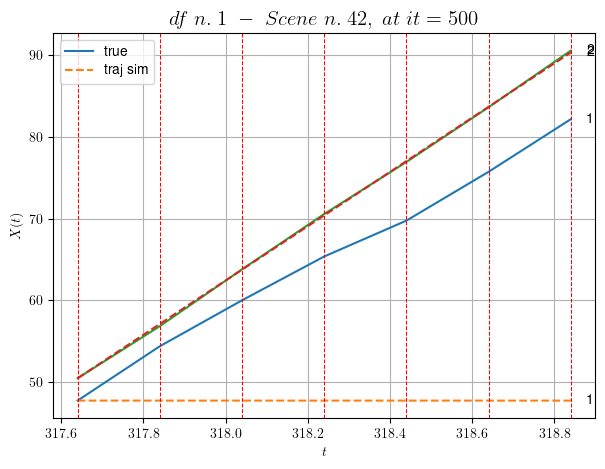

        For scene 42/109
        * use LR_NN=0.005 with err=4.472527896075572 at it=24
        * v0_scn_mean = 33.06692961953183
        * MAE = 1.1849281604619717



df n.1, scene n.43/109
    We have 4 time intervals inside [320.44,321.24]
    * err= 137.33995712528218
    * Learning rate NN = 5.9048988987342454e-06
    * diff = 1.2464616361285152e-07


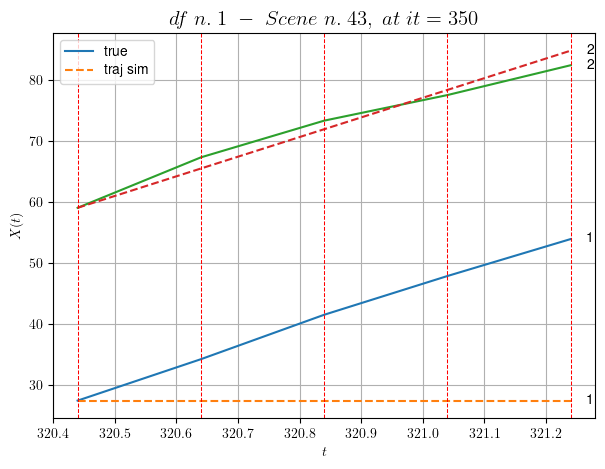

        For scene 43/109
        * use LR_NN=1e-05 with err=1.130691397457408 at it=24
        * v0_scn_mean = 32.068031979875286
        * MAE = 137.1549932384559



df n.1, scene n.44/109
    We have 10 time intervals inside [324.44,326.44]
    * err= 547.1430611704423
    * Learning rate NN = 1.5690524378442205e-05
    * diff = 3.696588919410715e-07


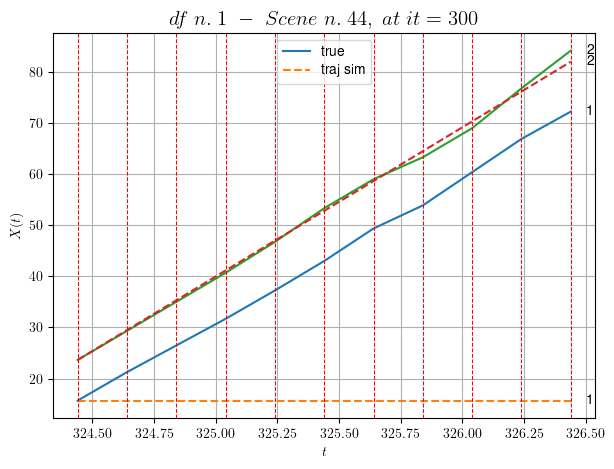

        For scene 44/109
        * use LR_NN=5e-05 with err=0.9509240678483573 at it=24
        * v0_scn_mean = 29.238039743304974
        * MAE = 547.1311446300972



df n.1, scene n.45/109
    We have 8 time intervals inside [332.24,333.84]
            - Time interval n.0: [332.24, 332.44]
                * y_true: [25.53074236]
                * v_ann: [34.67912292480469, 26.651206522067962]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [332.44, 332.64]
                * y_true: [36.42146061]
                * v_ann: [32.973995208740234, 26.651206522067962]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [332.64, 332.84]
                * y_true: [36.36192075]
                * v_ann: [30.359548568725586, 26.651206522067962]

-------------------------------------------------------------------------------------

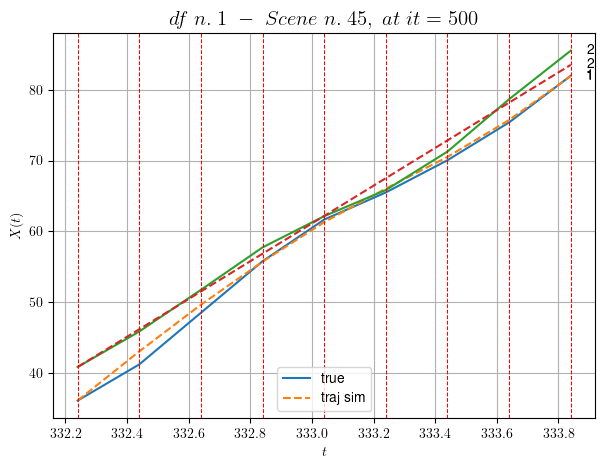

        For scene 45/109
        * use LR_NN=0.001 with err=6.290826144734767 at it=24
        * v0_scn_mean = 26.785158261158614
        * MAE = 0.8831176327690972



df n.1, scene n.46/109
    We have 3 time intervals inside [335.24,335.84]
    * err= 0.20876796113393173
    * Learning rate NN = 8.099998922261875e-06
    * diff = 5.0950966196117164e-08


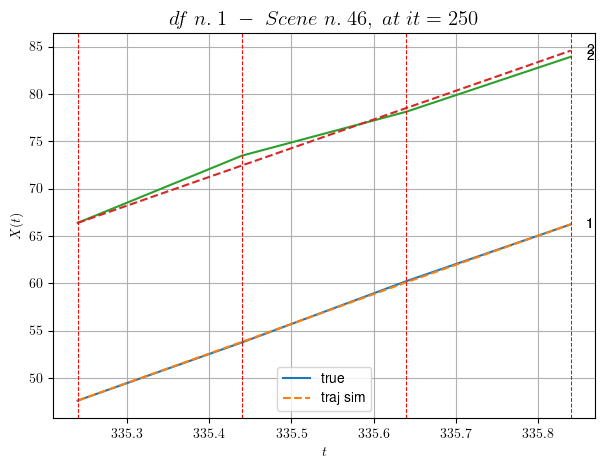

        For scene 46/109
        * use LR_NN=1e-05 with err=0.1870173287366668 at it=24
        * v0_scn_mean = 30.310260309222112
        * MAE = 0.19969127693692834



df n.1, scene n.47/109
    We have 4 time intervals inside [344.44,345.24]
            - Time interval n.0: [344.44, 344.64]
                * y_true: [27.53063305]
                * v_ann: [27.55423927307129, 33.83197138856196]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [344.64, 344.84]
                * y_true: [26.17089419]
                * v_ann: [28.09033203125, 33.83197138856196]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [344.84, 345.04]
                * y_true: [25.97595237]
                * v_ann: [27.841053009033203, 33.83197138856196]

------------------------------------------------------------------------------------------

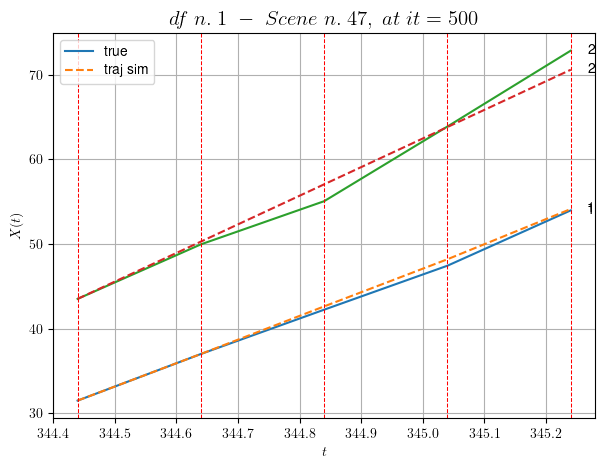

        For scene 47/109
        * use LR_NN=5e-05 with err=3.48806318191071 at it=24
        * v0_scn_mean = 33.678692533049094
        * MAE = 0.99274033480532



df n.1, scene n.48/109
    We have 4 time intervals inside [349.64,350.44]
            - Time interval n.0: [349.64, 349.84]
                * y_true: [34.02093414]
                * v_ann: [31.576175689697266, 30.663808885196868]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [349.84, 350.04]
                * y_true: [30.7912183]
                * v_ann: [31.9724063873291, 30.663808885196868]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [350.04, 350.24]
                * y_true: [28.60141935]
                * v_ann: [30.846094131469727, 30.663808885196868]

------------------------------------------------------------------------------------------

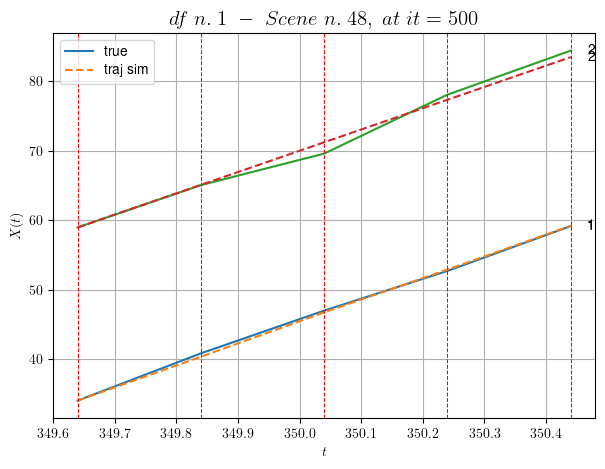

        For scene 48/109
        * use LR_NN=5e-05 with err=0.5496606170314843 at it=24
        * v0_scn_mean = 30.637256529793444
        * MAE = 0.4393636803754317



df n.1, scene n.49/109
    We have 3 time intervals inside [351.64,352.24]
            - Time interval n.0: [351.64, 351.84]
                * y_true: [17.20102191]
                * v_ann: [17.194204330444336, 35.128237730719775]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [351.84, 352.04]
                * y_true: [21.01146522]
                * v_ann: [22.971668243408203, 35.128237730719775]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [352.04, 352.24]
                * y_true: [26.72713019]
                * v_ann: [24.987457275390625, 35.128237730719775]

-----------------------------------------------------------------------------------

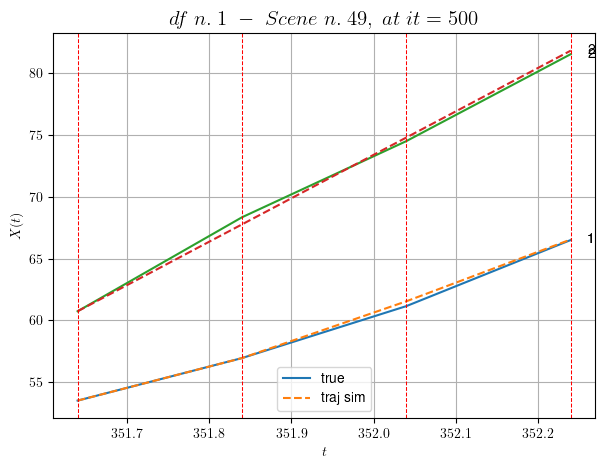

        For scene 49/109
        * use LR_NN=0.0005 with err=1.7248738550896732 at it=24
        * v0_scn_mean = 34.92310822153167
        * MAE = 0.08129375010498577



df n.1, scene n.50/109
    We have 5 time intervals inside [352.84,353.84]
            - Time interval n.0: [352.84, 353.04]
                * y_true: [30.00089881]
                * v_ann: [23.253040313720703, 29.02856357779744]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [353.04, 353.24]
                * y_true: [27.71101029]
                * v_ann: [26.78608512878418, 29.02856357779744]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [353.24, 353.44]
                * y_true: [24.27617752]
                * v_ann: [26.450807571411133, 29.02856357779744]

--------------------------------------------------------------------------------------

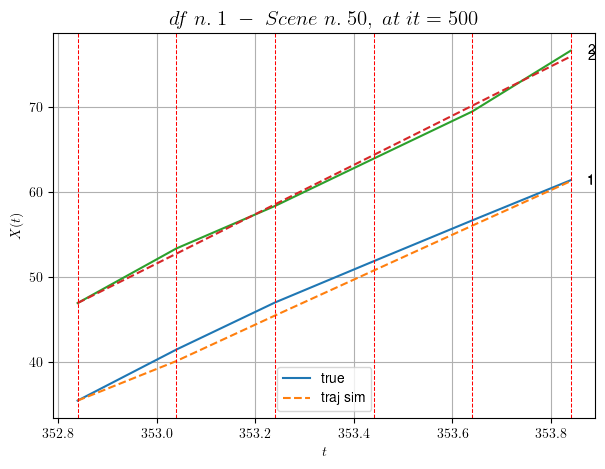

        For scene 50/109
        * use LR_NN=0.001 with err=0.7754373475103793 at it=24
        * v0_scn_mean = 29.067421034677626
        * MAE = 0.45249178202893214



df n.1, scene n.51/109
    We have 4 time intervals inside [358.84,359.64]
            - Time interval n.0: [358.84, 359.04]
                * y_true: [31.9907758]
                * v_ann: [35.748966217041016, 28.62644197692053]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [359.04, 359.24]
                * y_true: [34.35123345]
                * v_ann: [33.8165283203125, 28.62644197692053]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [359.24, 359.44]
                * y_true: [33.37134022]
                * v_ann: [30.504209518432617, 28.62644197692053]

----------------------------------------------------------------------------------------

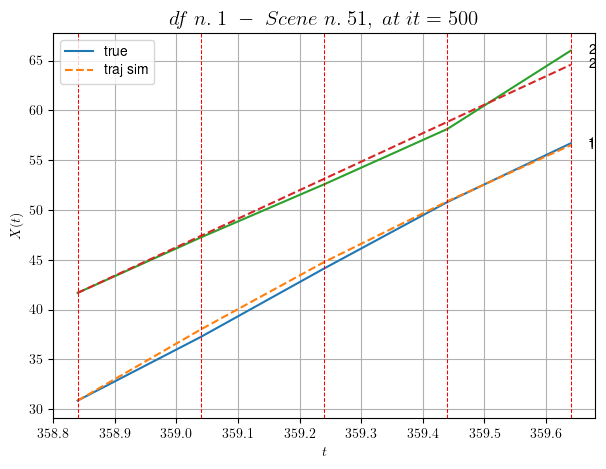

        For scene 51/109
        * use LR_NN=5e-05 with err=0.6256576261873226 at it=24
        * v0_scn_mean = 28.68138429783281
        * MAE = 0.3756360655746166



df n.1, scene n.52/109
    We have 2 time intervals inside [361.24,361.64]
            - Time interval n.0: [361.24, 361.44]
                * y_true: [25.09007353]
                * v_ann: [30.595962524414062, 29.453860908621873]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [361.44, 361.64]
                * y_true: [35.31024178]
                * v_ann: [29.864830017089844, 29.453860908621873]

----------------------------------------------------------------------------------------------------
    * err= 0.20212314093565897
    * Learning rate NN = 7.289998848136747e-06
    * diff = 0.00012608252734769287


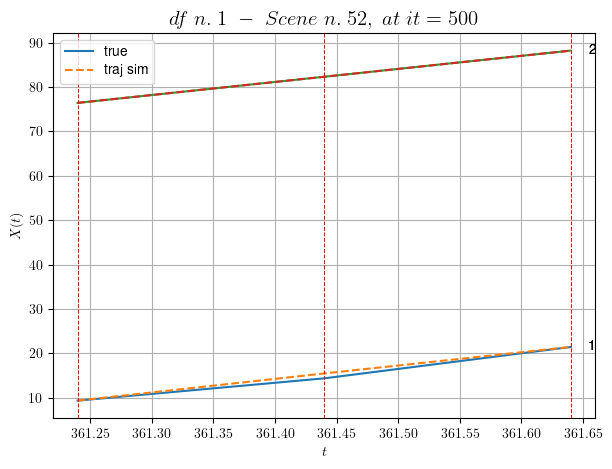

        For scene 52/109
        * use LR_NN=1e-05 with err=0.2332659392923122 at it=24
        * v0_scn_mean = 29.475706472271817
        * MAE = 0.19873791882568934



df n.1, scene n.53/109
    We have 6 time intervals inside [362.84,364.04]
            - Time interval n.0: [362.84, 363.04]
                * y_true: [59.17020934]
                * v_ann: [34.41313934326172, 30.31397642834161]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [363.04, 363.24]
                * y_true: [26.94023047]
                * v_ann: [35.6190299987793, 30.31397642834161]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [363.24, 363.44]
                * y_true: [23.39031489]
                * v_ann: [33.86764907836914, 30.31397642834161]

-----------------------------------------------------------------------------------------

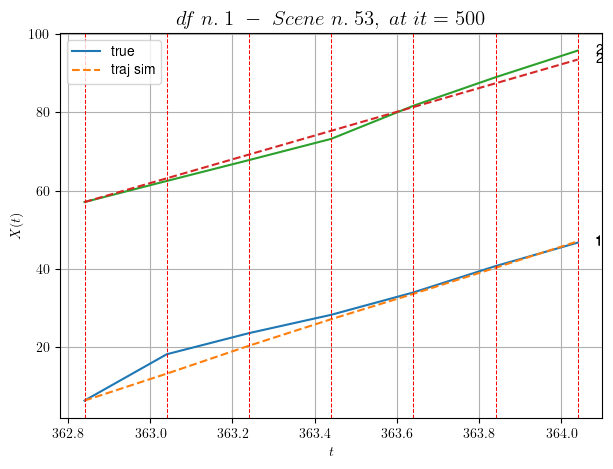

        For scene 53/109
        * use LR_NN=0.0001 with err=3.44559387282351 at it=24
        * v0_scn_mean = 30.30141737121047
        * MAE = 3.363805721295573



df n.1, scene n.54/109
    We have 2 time intervals inside [380.24,380.64]
    * err= 0.30896271314845647
    * Learning rate NN = 0.00040499999886378646
    * diff = 7.425569694130552e-07


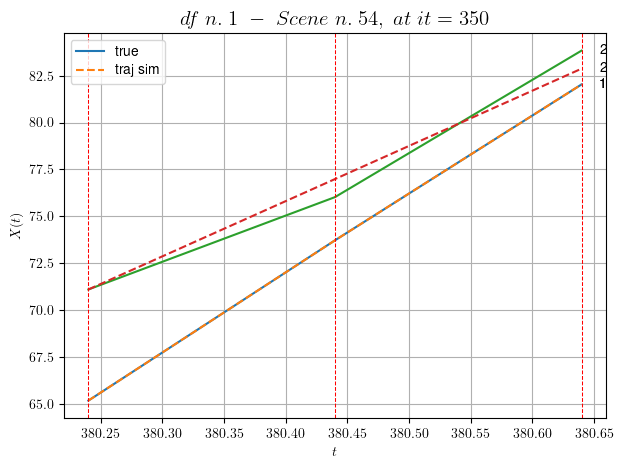

        For scene 54/109
        * use LR_NN=0.0005 with err=1.6097418354441075 at it=24
        * v0_scn_mean = 29.473156192513898
        * MAE = 0.30896271314845647



df n.1, scene n.55/109
    We have 5 time intervals inside [385.04,386.04]
            - Time interval n.0: [385.04, 385.24]
                * y_true: [29.06003834]
                * v_ann: [32.12132263183594, 36.00289770478486]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [385.24, 385.44]
                * y_true: [28.54010433]
                * v_ann: [30.773256301879883, 36.00289770478486]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [385.44, 385.64]
                * y_true: [26.16018293]
                * v_ann: [29.291013717651367, 36.00289770478486]

-------------------------------------------------------------------------------------

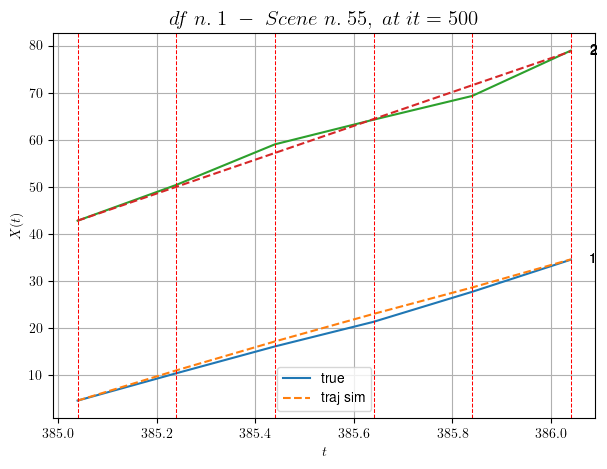

        For scene 55/109
        * use LR_NN=1e-05 with err=6.56308443953786 at it=24
        * v0_scn_mean = 35.76278179663978
        * MAE = 1.1632371746673498



df n.1, scene n.56/109
    We have 2 time intervals inside [393.84,394.24]
            - Time interval n.0: [393.84, 394.04]
                * y_true: [36.27268123]
                * v_ann: [34.905582427978516, 27.269624216531415]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [394.04, 394.24]
                * y_true: [30.30786624]
                * v_ann: [31.8859806060791, 27.269624216531415]

----------------------------------------------------------------------------------------------------
    * err= 0.02999277467416111
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.0008073477431796289


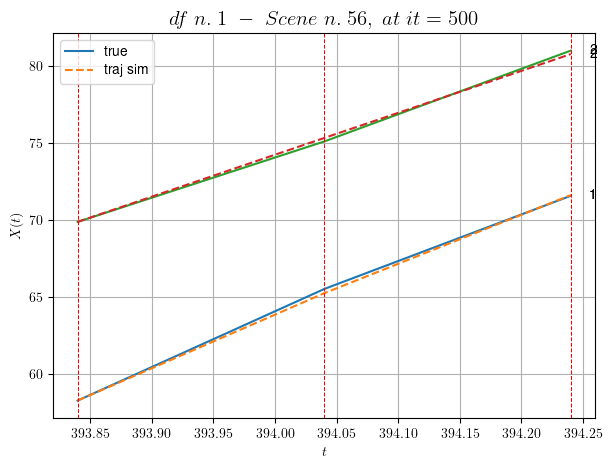

        For scene 56/109
        * use LR_NN=0.0005 with err=0.2245794069785853 at it=24
        * v0_scn_mean = 27.378839247849104
        * MAE = 0.02999277467416111



df n.1, scene n.57/109
    We have 4 time intervals inside [402.04,402.84]
            - Time interval n.0: [402.04, 402.24]
                * y_true: [38.60215299]
                * v_ann: [40.56450653076172, 31.006759212236116]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [402.24, 402.44]
                * y_true: [38.60215299]
                * v_ann: [35.810062408447266, 31.006759212236116]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [402.44, 402.64]
                * y_true: [32.70290702]
                * v_ann: [32.113136291503906, 31.006759212236116]

----------------------------------------------------------------------------------

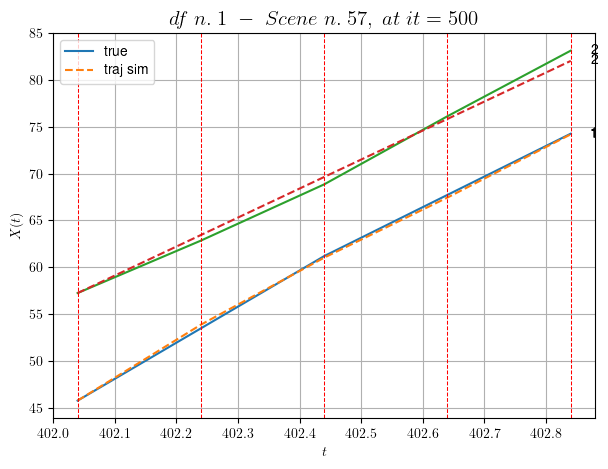

        For scene 57/109
        * use LR_NN=5e-05 with err=0.6140189127305896 at it=24
        * v0_scn_mean = 30.966488843754444
        * MAE = 0.2534866553666471



df n.1, scene n.58/109
    We have 5 time intervals inside [403.64,404.64]
            - Time interval n.0: [403.64, 403.84]
                * y_true: [27.97561343]
                * v_ann: [25.785741806030273, 32.57978285326519]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [403.84, 404.04]
                * y_true: [27.97561343]
                * v_ann: [26.356348037719727, 32.57978285326519]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [404.04, 404.24]
                * y_true: [24.32591098]
                * v_ann: [26.33989906311035, 32.57978285326519]

---------------------------------------------------------------------------------------

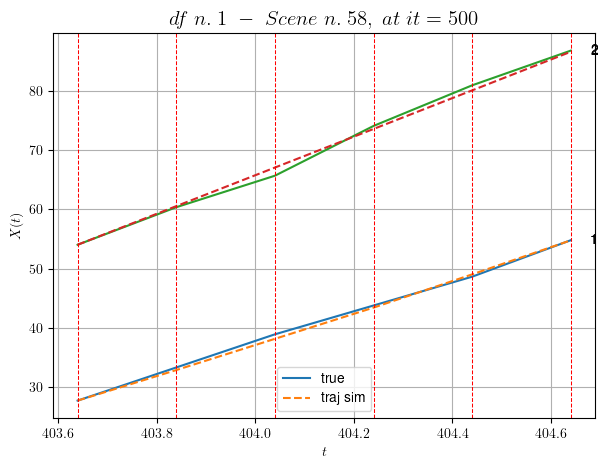

        For scene 58/109
        * use LR_NN=5e-05 with err=1.9167266044890185 at it=24
        * v0_scn_mean = 32.47659153915435
        * MAE = 0.333382037908757



df n.1, scene n.59/109
    We have 5 time intervals inside [411.64,412.64]
            - Time interval n.0: [411.64, 411.84]
                * y_true: [28.51083931]
                * v_ann: [32.8314208984375, 35.8529411171123]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [411.84, 412.04]
                * y_true: [38.00152248]
                * v_ann: [32.58793640136719, 35.8529411171123]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [412.04, 412.24]
                * y_true: [32.76167763]
                * v_ann: [34.66380310058594, 35.8529411171123]

-----------------------------------------------------------------------------------------------

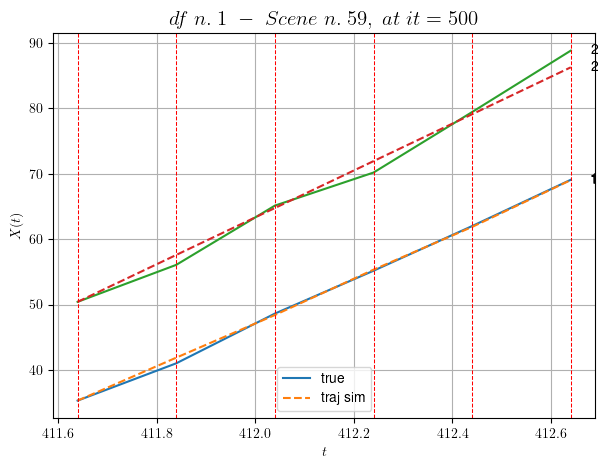

        For scene 59/109
        * use LR_NN=5e-05 with err=8.967622301913648 at it=24
        * v0_scn_mean = 35.61882347247283
        * MAE = 1.080669001901908



df n.1, scene n.60/109
    We have 3 time intervals inside [429.24,429.84]
            - Time interval n.0: [429.24, 429.44]
                * y_true: [36.17723915]
                * v_ann: [37.374786376953125, 26.764923514729325]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [429.44, 429.64]
                * y_true: [34.5674548]
                * v_ann: [34.168601989746094, 26.764923514729325]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [429.64, 429.84]
                * y_true: [31.87296901]
                * v_ann: [30.725093841552734, 26.764923514729325]

---------------------------------------------------------------------------------------

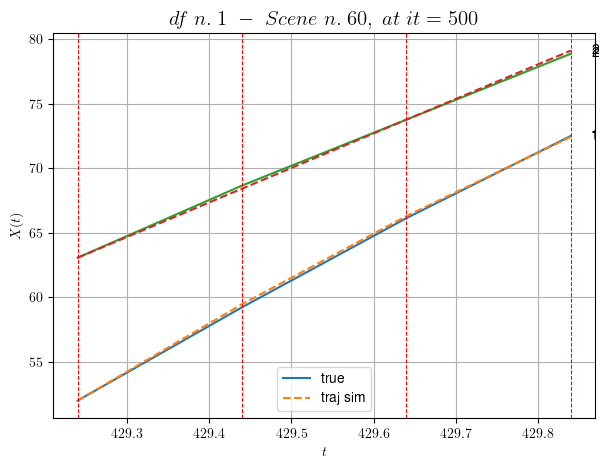

        For scene 60/109
        * use LR_NN=5e-05 with err=0.9054413098381306 at it=24
        * v0_scn_mean = 26.89432657411551
        * MAE = 0.02566491813843598



df n.1, scene n.61/109
    We have 6 time intervals inside [431.04,432.24]
            - Time interval n.0: [431.04, 431.24]
                * y_true: [29.15044808]
                * v_ann: [30.314836502075195, 27.91482717316415]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [431.24, 431.44]
                * y_true: [31.45067763]
                * v_ann: [29.994260787963867, 27.91482717316415]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [431.44, 431.64]
                * y_true: [27.86084986]
                * v_ann: [29.554418563842773, 27.91482717316415]

--------------------------------------------------------------------------------------

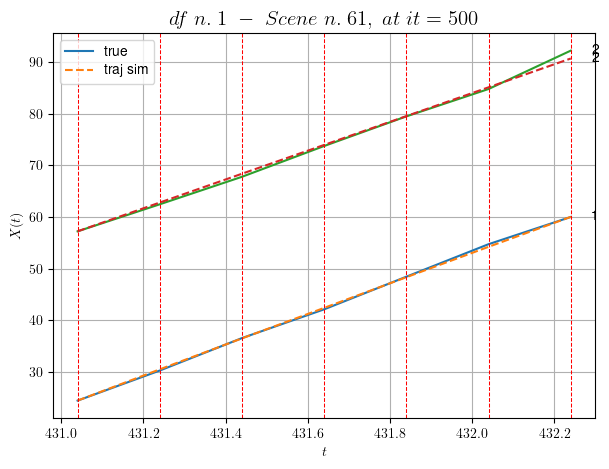

        For scene 61/109
        * use LR_NN=1e-05 with err=1.069167853878519 at it=24
        * v0_scn_mean = 27.998234086220826
        * MAE = 0.22029547598737437



df n.1, scene n.62/109
    We have 5 time intervals inside [444.24,445.24]
            - Time interval n.0: [444.24, 444.44]
                * y_true: [24.85115092]
                * v_ann: [21.094165802001953, 28.494973095575055]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [444.44, 444.64]
                * y_true: [25.38154149]
                * v_ann: [23.031078338623047, 28.494973095575055]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [444.64, 444.84]
                * y_true: [24.0216414]
                * v_ann: [23.719985961914062, 28.494973095575055]

------------------------------------------------------------------------------------

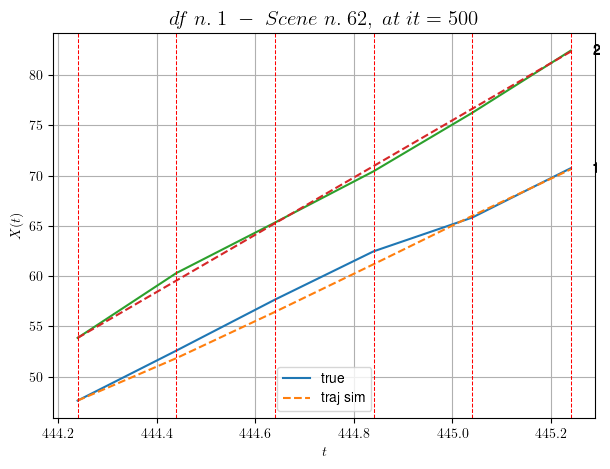

        For scene 62/109
        * use LR_NN=0.001 with err=1.7291756107810128 at it=24
        * v0_scn_mean = 28.555174171741246
        * MAE = 0.395686473303712



df n.1, scene n.63/109
    We have 2 time intervals inside [454.24,454.64]
    * err= 0.12846200147381964
    * Learning rate NN = 8.099998922261875e-06
    * diff = 4.2474417283333565e-07


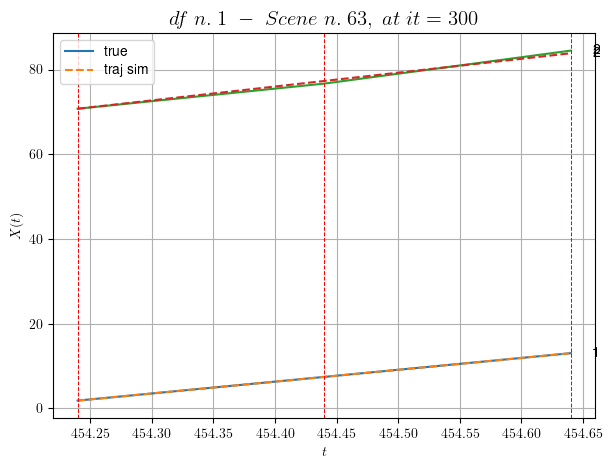

        For scene 63/109
        * use LR_NN=1e-05 with err=0.4982344316970044 at it=24
        * v0_scn_mean = 32.5826229087724
        * MAE = 0.12846200147381964



df n.1, scene n.64/109
    We have 3 time intervals inside [456.24,456.84]
            - Time interval n.0: [456.24, 456.44]
                * y_true: [27.10074139]
                * v_ann: [25.682300567626953, 29.14406361816021]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [456.44, 456.64]
                * y_true: [22.25077732]
                * v_ann: [26.371217727661133, 29.14406361816021]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [456.64, 456.84]
                * y_true: [28.55124928]
                * v_ann: [25.819225311279297, 29.14406361816021]

---------------------------------------------------------------------------------------

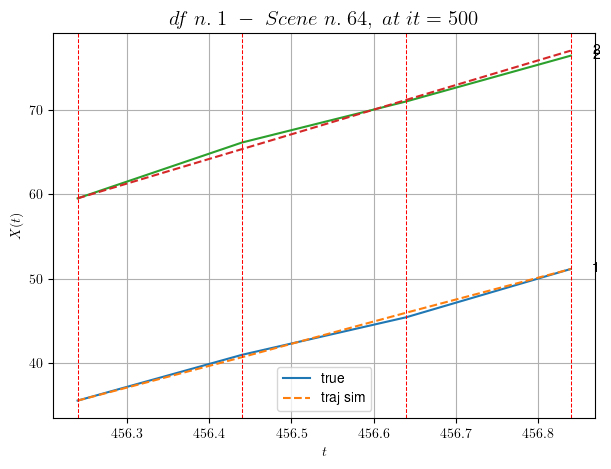

        For scene 64/109
        * use LR_NN=5e-05 with err=0.28479231948848627 at it=24
        * v0_scn_mean = 29.178301073426468
        * MAE = 0.17107055465523952



df n.1, scene n.65/109
    We have 2 time intervals inside [460.64,461.04]
    * err= 0.279011711181771
    * Learning rate NN = 8.099998922261875e-06
    * diff = 7.481505465145588e-08


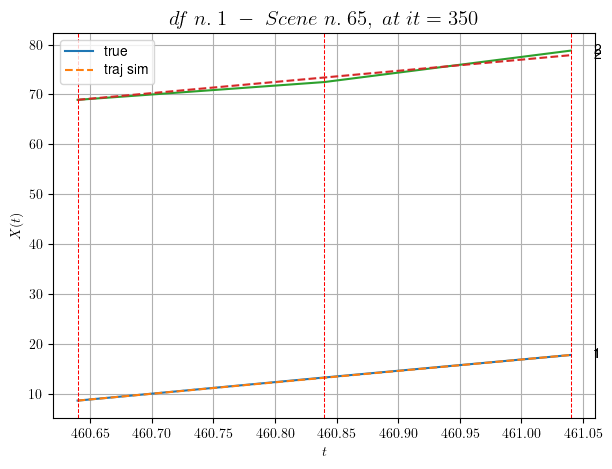

        For scene 65/109
        * use LR_NN=1e-05 with err=1.7441928539444054 at it=24
        * v0_scn_mean = 22.827077423473977
        * MAE = 0.25119900001701617



df n.1, scene n.66/109
    We have 3 time intervals inside [463.04,463.64]
            - Time interval n.0: [463.04, 463.24]
                * y_true: [21.05099884]
                * v_ann: [27.709556579589844, 19.662006047653833]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [463.24, 463.44]
                * y_true: [28.1918149]
                * v_ann: [25.045642852783203, 19.662006047653833]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [463.44, 463.64]
                * y_true: [30.35202585]
                * v_ann: [26.143890380859375, 19.662006047653833]

-----------------------------------------------------------------------------------

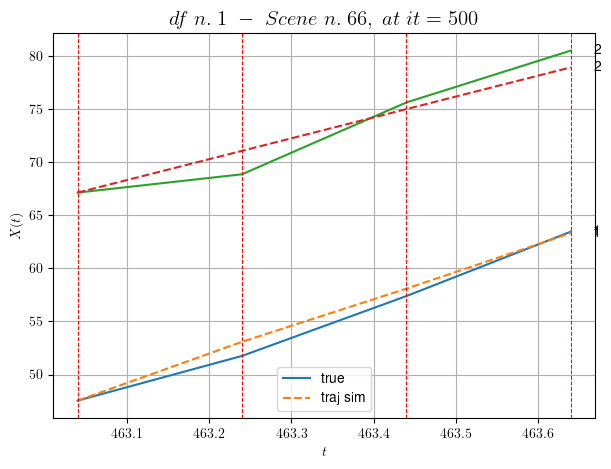

        For scene 66/109
        * use LR_NN=0.0001 with err=6.874463157505342 at it=24
        * v0_scn_mean = 20.075525805668875
        * MAE = 1.1672635209183204



df n.1, scene n.67/109
    We have 5 time intervals inside [472.24,473.24]
            - Time interval n.0: [472.24, 472.44]
                * y_true: [28.01055649]
                * v_ann: [27.072879791259766, 22.7647021560569]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [472.44, 472.64]
                * y_true: [25.87069506]
                * v_ann: [26.44529151916504, 22.7647021560569]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [472.64, 472.84]
                * y_true: [23.02078938]
                * v_ann: [25.6435604095459, 22.7647021560569]

--------------------------------------------------------------------------------------------

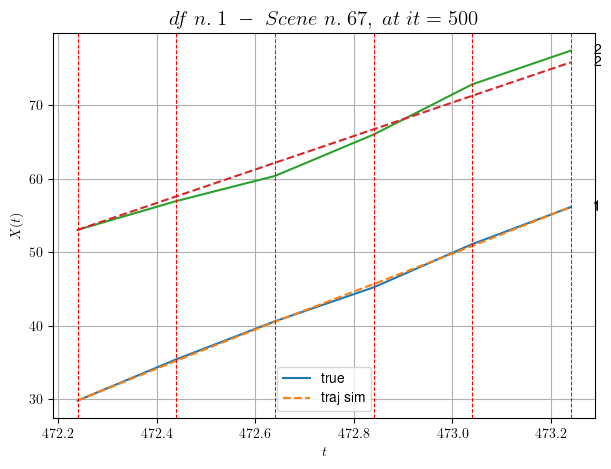

        For scene 67/109
        * use LR_NN=5e-05 with err=8.503132231079723 at it=24
        * v0_scn_mean = 23.054114069759066
        * MAE = 0.6909122580909467



df n.1, scene n.68/109
    We have 3 time intervals inside [474.84,475.44]
            - Time interval n.0: [474.84, 475.04]
                * y_true: [2.42235732]
                * v_ann: [10.80545711517334, 23.444882134000807]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [475.04, 475.24]
                * y_true: [26.3025336]
                * v_ann: [22.606788635253906, 23.444882134000807]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [475.24, 475.44]
                * y_true: [26.3025336]
                * v_ann: [26.26974868774414, 23.444882134000807]

-----------------------------------------------------------------------------------------

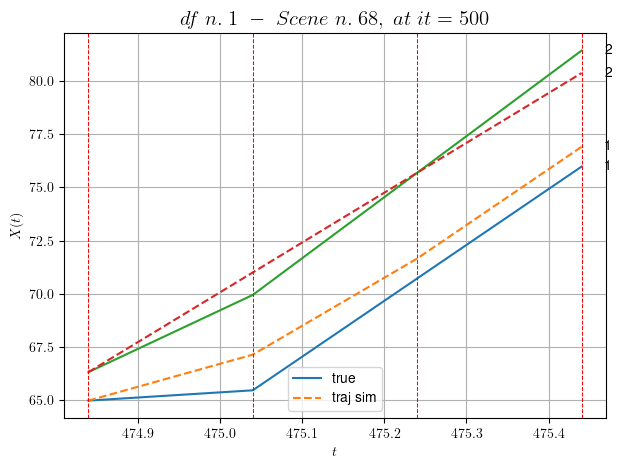

        For scene 68/109
        * use LR_NN=0.0005 with err=2.7207218251058687 at it=24
        * v0_scn_mean = 23.707086848590198
        * MAE = 0.8486965060737062



df n.1, scene n.69/109
    We have 6 time intervals inside [479.24,480.44]
            - Time interval n.0: [479.24, 479.44]
                * y_true: [25.80039081]
                * v_ann: [33.43788528442383, 18.3568737911005]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [479.44, 479.64]
                * y_true: [32.03070589]
                * v_ann: [30.916576385498047, 18.3568737911005]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [479.64, 479.84]
                * y_true: [28.3308487]
                * v_ann: [28.85726547241211, 18.3568737911005]

-------------------------------------------------------------------------------------------

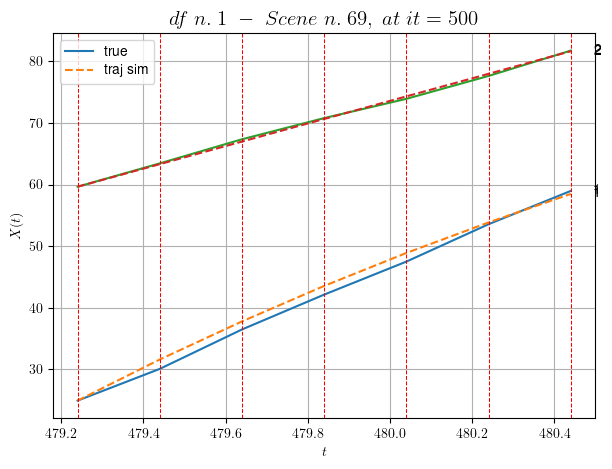

        For scene 69/109
        * use LR_NN=1e-05 with err=36.29748520564404 at it=24
        * v0_scn_mean = 18.82259883936753
        * MAE = 0.6169080238949635



df n.1, scene n.70/109
    We have 5 time intervals inside [483.44,484.44]
            - Time interval n.0: [483.44, 483.64]
                * y_true: [12.92542385]
                * v_ann: [22.412172317504883, 20.279545451256247]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [483.64, 483.84]
                * y_true: [16.04562218]
                * v_ann: [20.340911865234375, 20.279545451256247]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [483.84, 484.04]
                * y_true: [20.72591968]
                * v_ann: [18.983827590942383, 20.279545451256247]

-------------------------------------------------------------------------------------

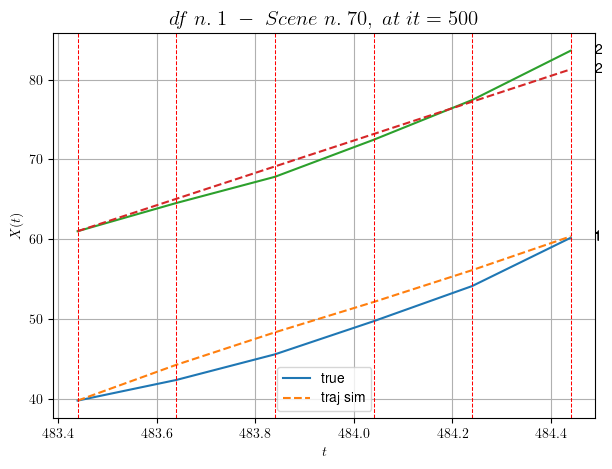

        For scene 70/109
        * use LR_NN=5e-05 with err=17.056417355404143 at it=24
        * v0_scn_mean = 20.668363633131637
        * MAE = 2.4169098296195624



df n.1, scene n.71/109
    We have 4 time intervals inside [489.04,489.84]
            - Time interval n.0: [489.04, 489.24]
                * y_true: [26.7517836]
                * v_ann: [30.763324737548828, 22.729734196718912]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [489.24, 489.44]
                * y_true: [22.40175221]
                * v_ann: [27.975679397583008, 22.729734196718912]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [489.44, 489.64]
                * y_true: [47.70460004]
                * v_ann: [29.310142517089844, 22.729734196718912]

------------------------------------------------------------------------------------

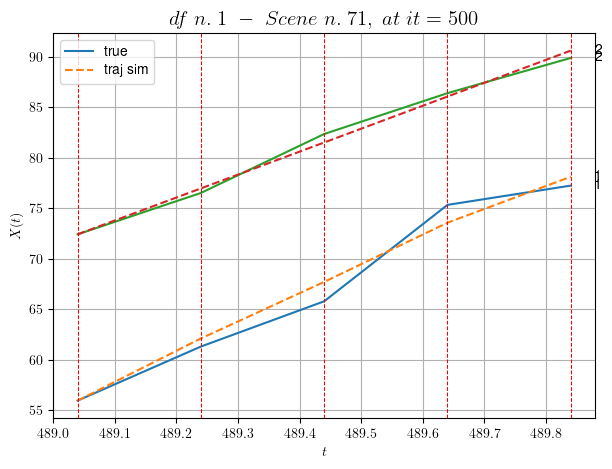

        For scene 71/109
        * use LR_NN=5e-05 with err=7.45359858392726 at it=24
        * v0_scn_mean = 23.02054482879472
        * MAE = 0.9721891228780499



df n.1, scene n.72/109
    We have 4 time intervals inside [515.64,516.44]
            - Time interval n.0: [515.64, 515.84]
                * y_true: [6.11048435]
                * v_ann: [5.68932580947876, 6.109715857611425]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [515.84, 516.04]
                * y_true: [6.11048435]
                * v_ann: [5.680778980255127, 6.109715857611425]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [516.04, 516.24]
                * y_true: [5.68648241]
                * v_ann: [5.757668495178223, 6.109715857611425]

------------------------------------------------------------------------------------------------

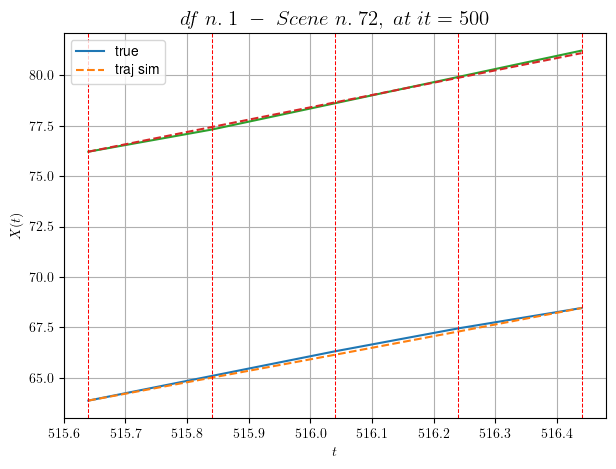

        For scene 72/109
        * use LR_NN=5e-05 with err=68.10178892643849 at it=24
        * v0_scn_mean = 7.065327223125329
        * MAE = 0.009434191290823627



df n.1, scene n.73/109
    We have 5 time intervals inside [529.64,530.64]
            - Time interval n.0: [529.64, 529.84]
                * y_true: [25.15062432]
                * v_ann: [32.34325408935547, 22.628998285034122]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [529.84, 530.04]
                * y_true: [34.2011529]
                * v_ann: [31.315998077392578, 22.628998285034122]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [530.04, 530.24]
                * y_true: [27.75123099]
                * v_ann: [28.46384048461914, 22.628998285034122]

--------------------------------------------------------------------------------------

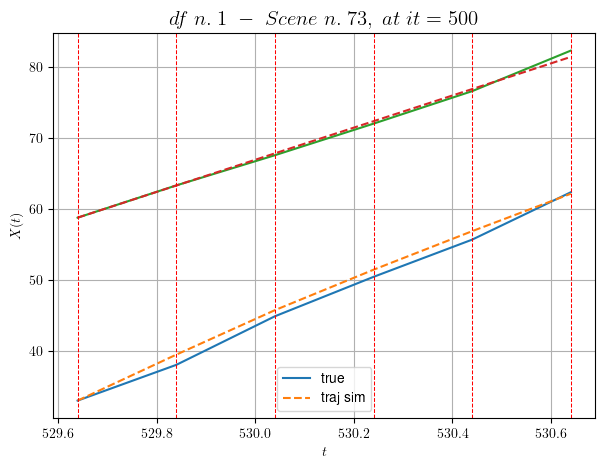

        For scene 73/109
        * use LR_NN=1e-05 with err=10.127567816566172 at it=24
        * v0_scn_mean = 22.923838353577295
        * MAE = 0.5259461343237428



df n.1, scene n.74/109
    We have 8 time intervals inside [531.64,533.24]
            - Time interval n.0: [531.64, 531.84]
                * y_true: [53.04019205]
                * v_ann: [38.325313568115234, 22.382648405902454]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.84, 532.04]
                * y_true: [26.08021954]
                * v_ann: [34.005584716796875, 22.382648405902454]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.04, 532.24]
                * y_true: [27.42037034]
                * v_ann: [32.344444274902344, 22.382648405902454]

-----------------------------------------------------------------------------------

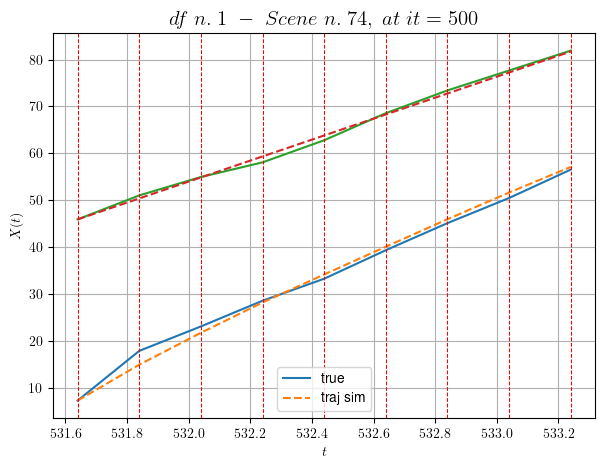

        For scene 74/109
        * use LR_NN=1e-05 with err=26.806155863562772 at it=24
        * v0_scn_mean = 22.68734246960836
        * MAE = 1.0025514606052541



df n.1, scene n.75/109
    We have 2 time intervals inside [561.44,561.84]
    * err= 0.0012267650720520012
    * Learning rate NN = 4.499999704421498e-05
    * diff = 4.739316081009588e-08


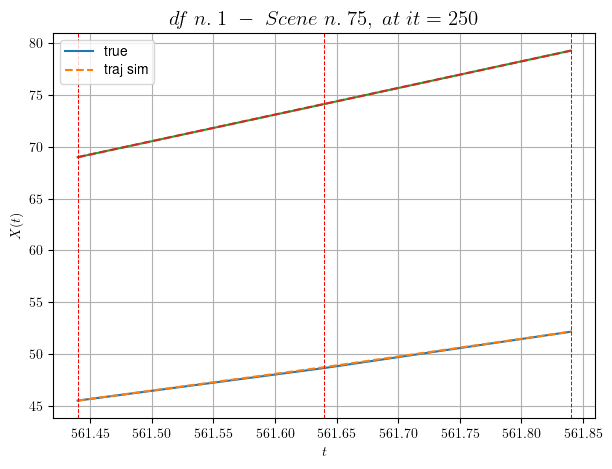

        For scene 75/109
        * use LR_NN=5e-05 with err=0.6060456881942036 at it=24
        * v0_scn_mean = 26.069503465765557
        * MAE = 0.001186375317505886



df n.1, scene n.76/109
    We have 4 time intervals inside [564.24,565.04]
            - Time interval n.0: [564.24, 564.44]
                * y_true: [17.83478281]
                * v_ann: [22.094852447509766, 14.268347650199631]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [564.44, 564.64]
                * y_true: [17.83478281]
                * v_ann: [20.359556198120117, 14.268347650199631]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [564.64, 564.84]
                * y_true: [19.43339212]
                * v_ann: [19.31801986694336, 14.268347650199631]

----------------------------------------------------------------------------------

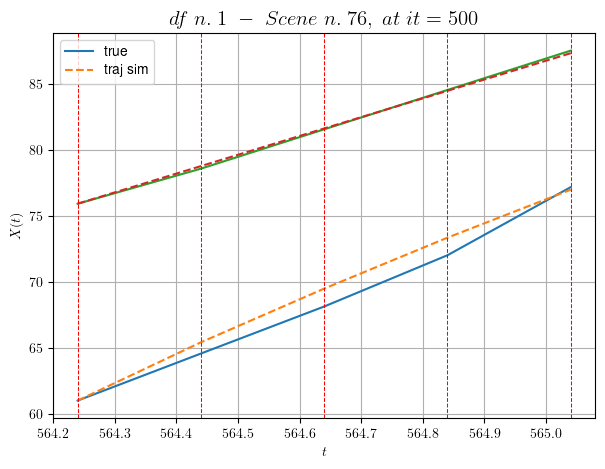

        For scene 76/109
        * use LR_NN=5e-05 with err=29.718497073017563 at it=24
        * v0_scn_mean = 14.897613744071569
        * MAE = 0.44517762118352733



df n.1, scene n.77/109
    We have 8 time intervals inside [571.04,572.64]
            - Time interval n.0: [571.04, 571.24]
                * y_true: [10.66294747]
                * v_ann: [10.42115592956543, 20.877122500554435]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [571.24, 571.44]
                * y_true: [10.91066813]
                * v_ann: [10.715272903442383, 20.877122500554435]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [571.44, 571.64]
                * y_true: [10.91066813]
                * v_ann: [10.94902229309082, 20.877122500554435]

------------------------------------------------------------------------------------

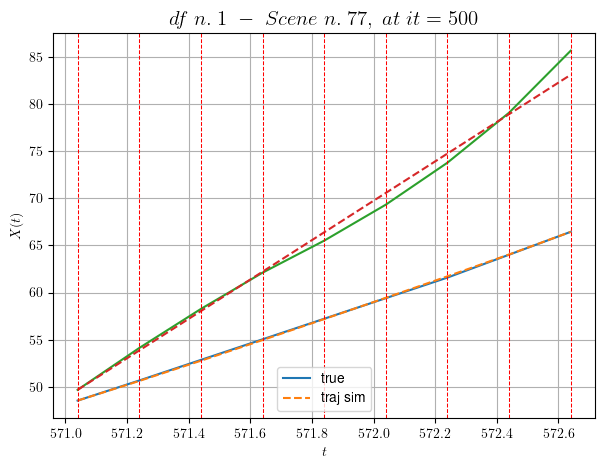

        For scene 77/109
        * use LR_NN=0.001 with err=39.24214264672785 at it=24
        * v0_scn_mean = 21.242037600465583
        * MAE = 0.5507874514836761



df n.1, scene n.78/109
    We have 11 time intervals inside [592.44,594.64]
            - Time interval n.0: [592.44, 592.64]
                * y_true: [15.26011691]
                * v_ann: [15.712509155273438, 12.857107640554322]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [592.64, 592.84]
                * y_true: [15.09015603]
                * v_ann: [15.637025833129883, 12.857107640554322]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [592.84, 593.04]
                * y_true: [14.43018672]
                * v_ann: [15.56395149230957, 12.857107640554322]

------------------------------------------------------------------------------------

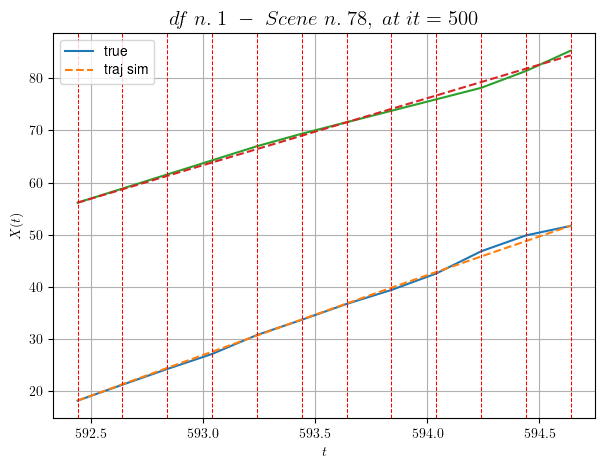

        For scene 78/109
        * use LR_NN=5e-05 with err=250.14258709981456 at it=24
        * v0_scn_mean = 13.542823334801193
        * MAE = 0.26052899200604496



df n.1, scene n.79/109
    We have 2 time intervals inside [595.64,596.04]
            - Time interval n.0: [595.64, 595.84]
                * y_true: [13.82084467]
                * v_ann: [16.565088272094727, 17.284900942460474]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [595.84, 596.04]
                * y_true: [19.77136821]
                * v_ann: [17.26658058166504, 17.284900942460474]

----------------------------------------------------------------------------------------------------
    * err= 0.12654975361876317
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 7.227998666770041e-05


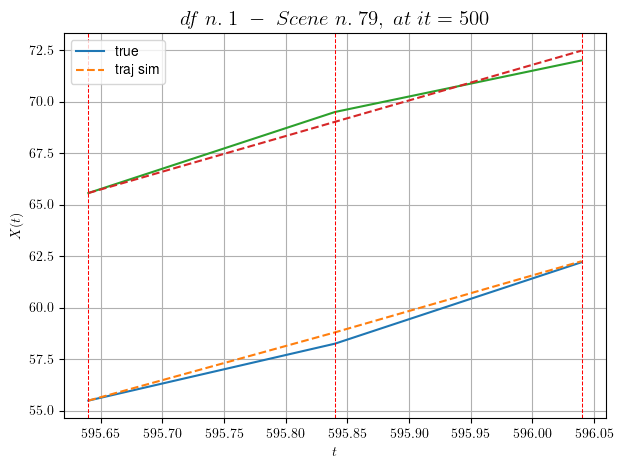

        For scene 79/109
        * use LR_NN=5e-05 with err=5.895592368778294 at it=24
        * v0_scn_mean = 17.793504904664783
        * MAE = 0.12654975361876317



df n.1, scene n.80/109
    We have 4 time intervals inside [597.64,598.44]
            - Time interval n.0: [597.64, 597.84]
                * y_true: [15.60070033]
                * v_ann: [19.133516311645508, 13.840959609622454]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [597.84, 598.04]
                * y_true: [19.75102085]
                * v_ann: [18.690147399902344, 13.840959609622454]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [598.04, 598.24]
                * y_true: [18.55110518]
                * v_ann: [18.258731842041016, 13.840959609622454]

-----------------------------------------------------------------------------------

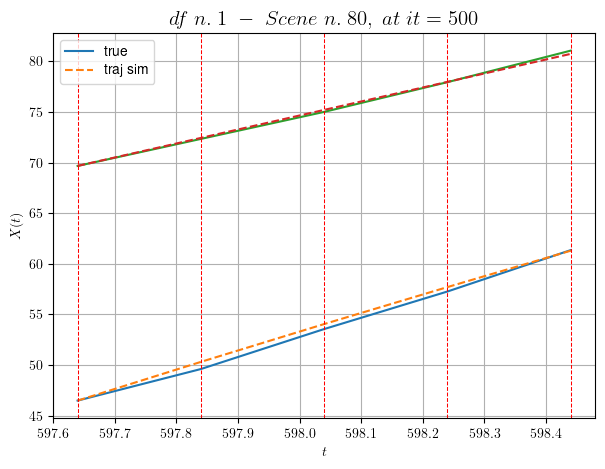

        For scene 80/109
        * use LR_NN=5e-05 with err=31.02050713191213 at it=24
        * v0_scn_mean = 14.48732122511341
        * MAE = 0.10778551553264026



df n.1, scene n.81/109
    We have 2 time intervals inside [14.24,14.64]
            - Time interval n.0: [14.24, 14.44]
                * y_true: [32.1443344  20.77111865]
                * v_ann: [27.608430862426758, 31.683500289916992, 27.636278285272255]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [14.44, 14.64]
                * y_true: [32.5721373  24.27162308]
                * v_ann: [25.54779052734375, 23.42691421508789, 27.636278285272255]

----------------------------------------------------------------------------------------------------
    * err= 1.6738591117172035
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.02852380424163181


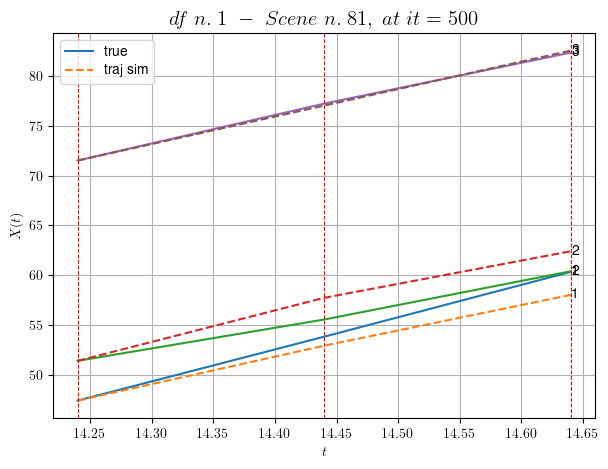

        For scene 81/109
        * use LR_NN=0.001 with err=12.908998040441583 at it=24
        * v0_scn_mean = 27.77810148202991
        * MAE = 1.6738591117172035



df n.1, scene n.82/109
    We have 5 time intervals inside [23.64,24.64]
            - Time interval n.0: [23.64, 23.84]
                * y_true: [26.6509107  26.65125804]
                * v_ann: [26.697296142578125, 25.850215911865234, 31.184420565840067]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [26.926258087158203, 26.35500717163086, 31.184420565840067]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [28.198453903198242, 29.266605377197266, 31.184420565840067

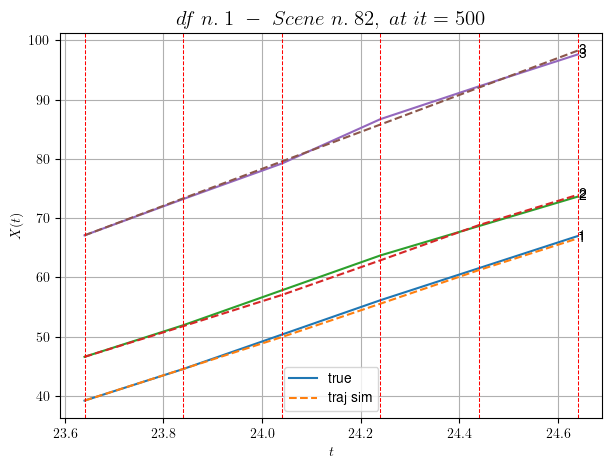

        For scene 82/109
        * use LR_NN=0.001 with err=20.795005902651177 at it=24
        * v0_scn_mean = 31.113355385067617
        * MAE = 0.1674190824372088



df n.1, scene n.83/109
    We have 5 time intervals inside [72.44,73.44]
            - Time interval n.0: [72.44, 72.64]
                * y_true: [25.85001228 31.10049693]
                * v_ann: [27.645267486572266, 28.138259887695312, 28.25092057390849]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.64, 72.84]
                * y_true: [30.00006309 33.82077482]
                * v_ann: [27.742937088012695, 28.22064781188965, 28.25092057390849]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.84, 73.04]
                * y_true: [23.75011307 26.19081077]
                * v_ann: [28.17823028564453, 28.60038185119629, 28.25092057390849]

-

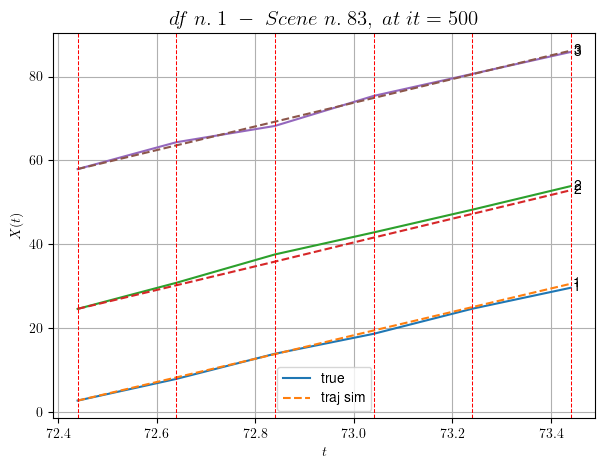

        For scene 83/109
        * use LR_NN=5e-05 with err=3.52638235651581 at it=24
        * v0_scn_mean = 28.355865260943947
        * MAE = 0.5808138183698972



df n.1, scene n.84/109
    We have 3 time intervals inside [84.24,84.84]
            - Time interval n.0: [84.24, 84.44]
                * y_true: [29.4403562  23.48047527]
                * v_ann: [28.069236755371094, 32.763240814208984, 29.49436559358197]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [84.44, 84.64]
                * y_true: [27.01049004 24.28067739]
                * v_ann: [25.470943450927734, 22.549882888793945, 29.49436559358197]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [84.64, 84.84]
                * y_true: [27.60069732 32.65118399]
                * v_ann: [26.48046112060547, 27.38083267211914, 29.49436559358197]

--

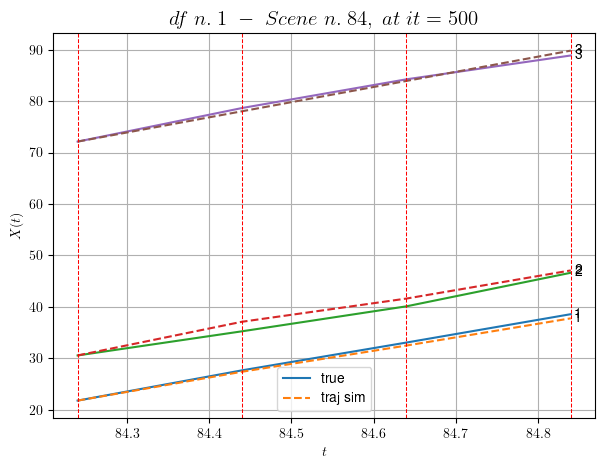

        For scene 84/109
        * use LR_NN=0.0005 with err=16.318291889719863 at it=24
        * v0_scn_mean = 29.524703635264995
        * MAE = 0.45252854411583904



df n.1, scene n.85/109
    We have 2 time intervals inside [131.64,132.04]
            - Time interval n.0: [131.64, 131.84]
                * y_true: [30.80073929 29.11067519]
                * v_ann: [28.652067184448242, 8.706306294504941e-23, 28.442892702247633]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.84, 132.04]
                * y_true: [30.16079766 28.07097758]
                * v_ann: [30.39908790588379, 6.435811254718894e-23, 28.442892702247633]

----------------------------------------------------------------------------------------------------
    * err= 18.37393136684139
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0005185245010181916


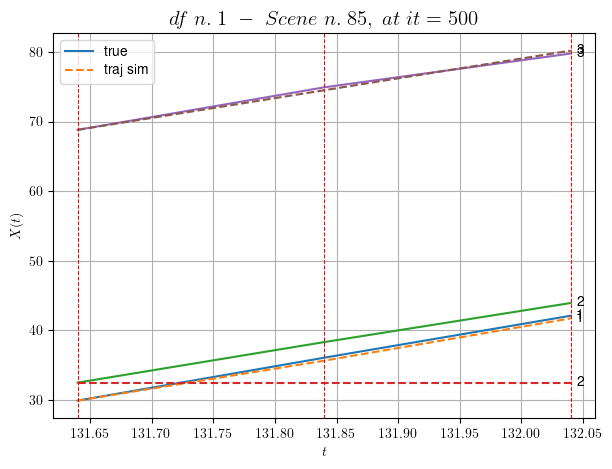

        For scene 85/109
        * use LR_NN=0.001 with err=15.121924743693269 at it=24
        * v0_scn_mean = 28.53631907020157
        * MAE = 0.34343040020545207



df n.1, scene n.86/109
    We have 2 time intervals inside [148.04,148.44]
            - Time interval n.0: [148.04, 148.24]
                * y_true: [21.93113488 25.90203153]
                * v_ann: [0.0023922696709632874, 0.004622180014848709, 27.621656721215906]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [148.24, 148.44]
                * y_true: [23.17638158 33.20310746]
                * v_ann: [0.0005634206463582814, 0.003195560071617365, 27.621656721215906]

----------------------------------------------------------------------------------------------------
    * err= 29.686445453962275
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0004957053481184914


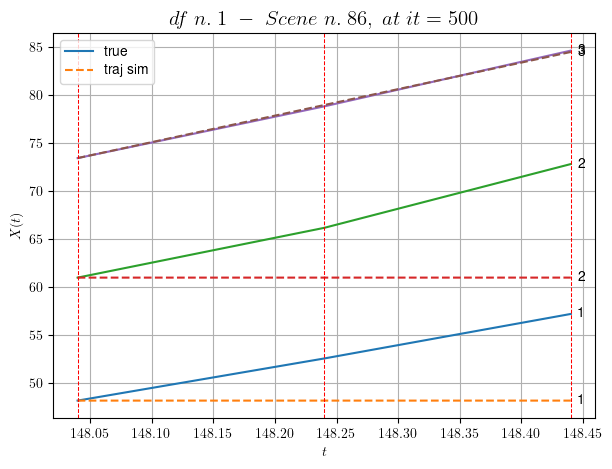

        For scene 86/109
        * use LR_NN=5e-05 with err=0.7932967129633178 at it=24
        * v0_scn_mean = 27.76435721116064
        * MAE = 29.686445453962275



df n.1, scene n.87/109
    We have 2 time intervals inside [161.64,162.04]
            - Time interval n.0: [161.64, 161.84]
                * y_true: [31.66062591 25.70084842]
                * v_ann: [27.263521194458008, 4.704424645751715e-05, 34.71181519803632]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [161.84, 162.04]
                * y_true: [29.96082912 27.30094687]
                * v_ann: [30.211788177490234, 6.704969564452767e-06, 34.71181519803632]

----------------------------------------------------------------------------------------------------
    * err= 15.623122304988014
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0002745410929243519


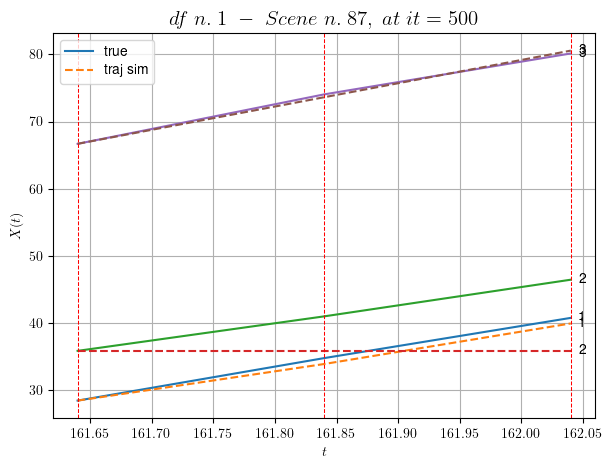

        For scene 87/109
        * use LR_NN=5e-05 with err=12.48061290275566 at it=24
        * v0_scn_mean = 34.429106497704254
        * MAE = 15.623122304988014



df n.1, scene n.88/109
    We have 3 time intervals inside [164.04,164.64]
    * err= 79.96250952850134
    * Learning rate NN = 0.0003280499659013003
    * diff = 3.3026911694378214e-07


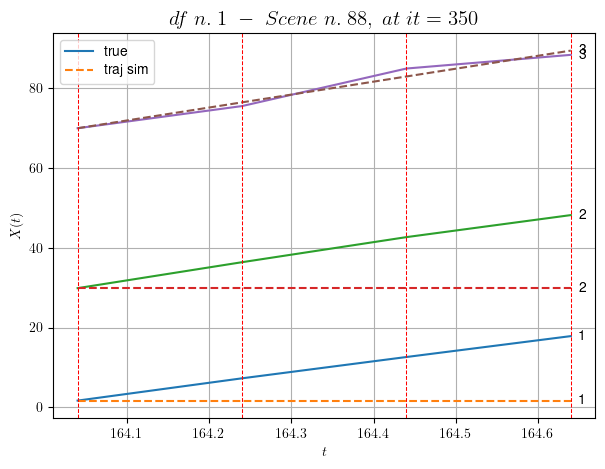

        For scene 88/109
        * use LR_NN=0.0005 with err=1.5971979248434565 at it=24
        * v0_scn_mean = 32.22432243084913
        * MAE = 42.93087730468986



df n.1, scene n.89/109
    We have 2 time intervals inside [215.64,216.04]
    * err= 45.219143593108846
    * Learning rate NN = 4.049999552080408e-05
    * diff = 7.299568309804272e-07


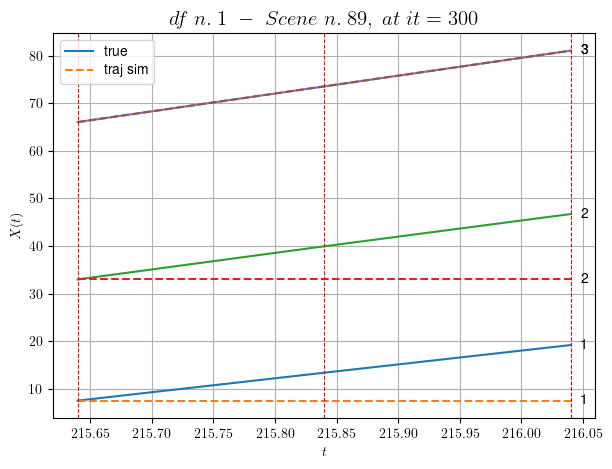

        For scene 89/109
        * use LR_NN=5e-05 with err=1.3408723500403843 at it=24
        * v0_scn_mean = 36.73542957932045
        * MAE = 45.219143593108846



df n.1, scene n.90/109
    We have 2 time intervals inside [216.64,217.04]
    * err= 58.641387248135395
    * Learning rate NN = 0.00036449998151510954
    * diff = 8.168724363599722e-07


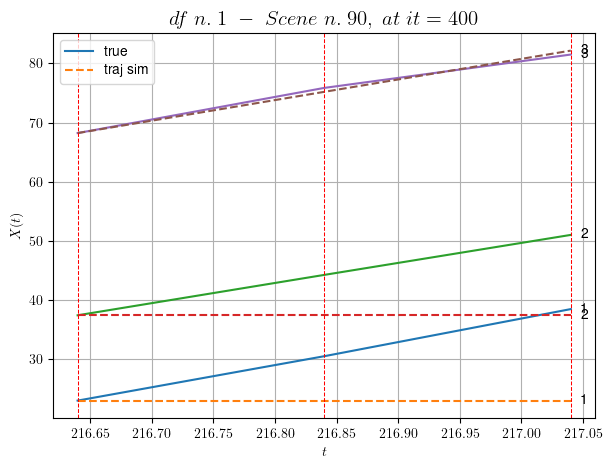

        For scene 90/109
        * use LR_NN=0.0005 with err=9.69328126597391 at it=24
        * v0_scn_mean = 34.487938898881175
        * MAE = 58.63155142475014



df n.1, scene n.91/109
    We have 2 time intervals inside [240.64,241.04]
    * err= 39.18453939442752
    * Learning rate NN = 8.999999408842996e-06
    * diff = 6.422905798331158e-07


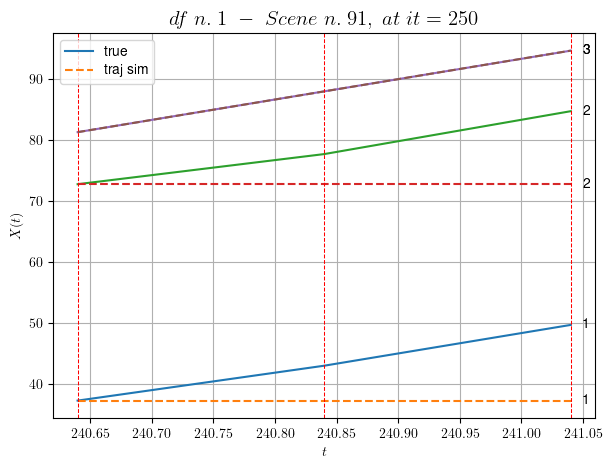

        For scene 91/109
        * use LR_NN=1e-05 with err=8.636029533269527 at it=24
        * v0_scn_mean = 32.94348129408413
        * MAE = 39.18453853076664



df n.1, scene n.92/109
    We have 2 time intervals inside [253.64,254.04]
    * err= 39.72001782907544
    * Learning rate NN = 4.049999552080408e-05
    * diff = 6.937600858236692e-07


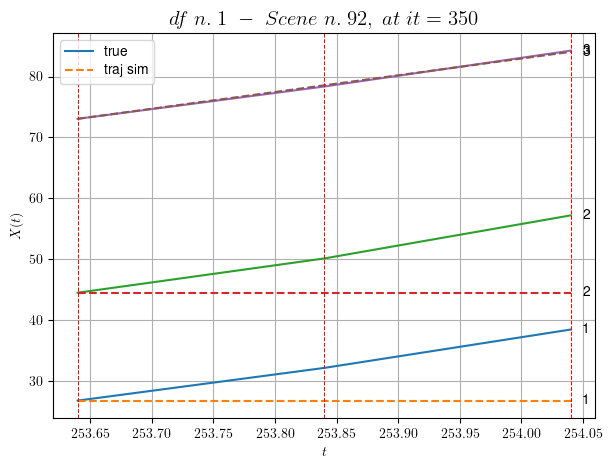

        For scene 92/109
        * use LR_NN=5e-05 with err=1.6152144293655688 at it=24
        * v0_scn_mean = 27.691316850195815
        * MAE = 39.71913461759049



df n.1, scene n.93/109
    We have 5 time intervals inside [262.64,263.64]
    * err= 242.7648086118518
    * Learning rate NN = 0.000430467160185799
    * diff = 7.803934067851515e-07


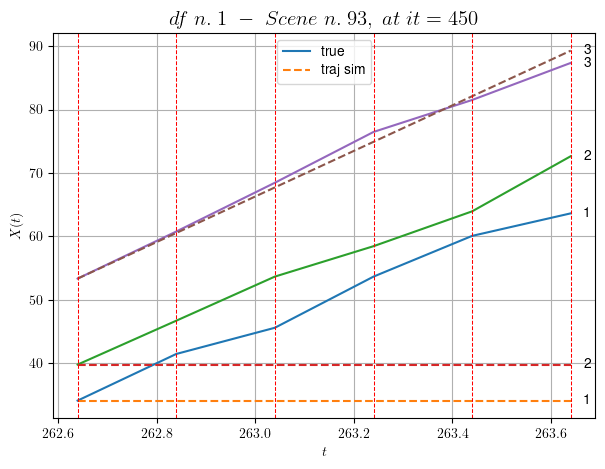

        For scene 93/109
        * use LR_NN=0.001 with err=26.613828610536416 at it=24
        * v0_scn_mean = 35.53569127500394
        * MAE = 242.73232176134488



df n.1, scene n.94/109
    We have 4 time intervals inside [314.84,315.64]
    * err= 146.43905408890268
    * Learning rate NN = 5.314408917911351e-05
    * diff = 9.262787443731213e-07


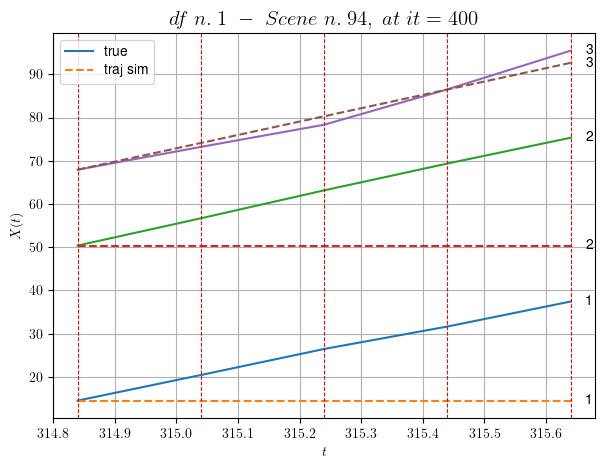

        For scene 94/109
        * use LR_NN=0.0001 with err=20.956238623053252 at it=24
        * v0_scn_mean = 30.856779397688733
        * MAE = 146.43905408890268



df n.1, scene n.95/109
    We have 6 time intervals inside [325.24,326.44]
    * err= 297.400752219137
    * Learning rate NN = 0.000430467160185799
    * diff = 2.694608269848686e-07


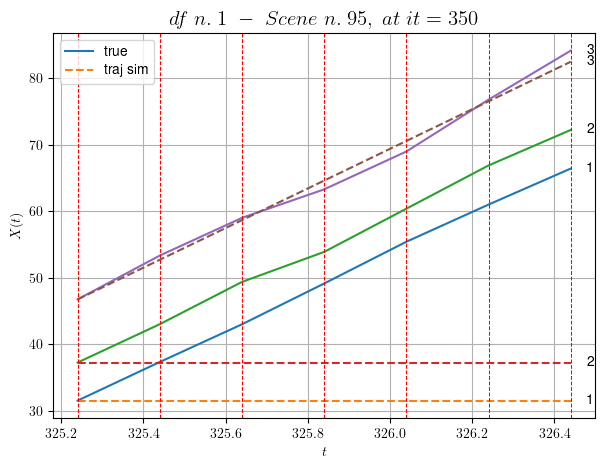

        For scene 95/109
        * use LR_NN=0.001 with err=16.800763639057543 at it=24
        * v0_scn_mean = 29.820830785944853
        * MAE = 297.39791745075036



df n.1, scene n.96/109
    We have 3 time intervals inside [354.04,354.64]
            - Time interval n.0: [354.04, 354.24]
                * y_true: [29.77169216 32.15176545]
                * v_ann: [32.380760192871094, 4.404445141936719e-10, 32.69352217293495]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [354.24, 354.44]
                * y_true: [35.38251939 26.55179403]
                * v_ann: [29.73857307434082, 1.181205133704566e-10, 32.69352217293495]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [354.44, 354.64]
                * y_true: [26.40441101 27.01000163]
                * v_ann: [26.482269287109375, 9.88147758063107e-12, 32.

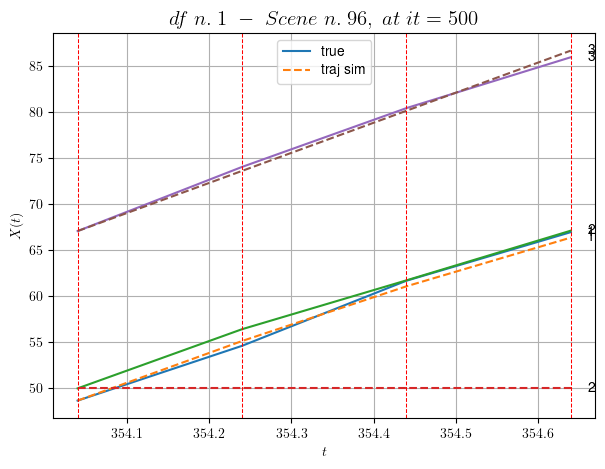

        For scene 96/109
        * use LR_NN=0.001 with err=10.507617969447779 at it=24
        * v0_scn_mean = 32.53191096349221
        * MAE = 39.57039208443275



df n.1, scene n.97/109
    We have 3 time intervals inside [363.44,364.04]
            - Time interval n.0: [363.44, 363.64]
                * y_true: [23.6502752  28.55056389]
                * v_ann: [28.037538528442383, 27.69523048400879, 38.923494443015485]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [363.64, 363.84]
                * y_true: [26.3393983  33.66093634]
                * v_ann: [27.315195083618164, 24.754913330078125, 38.923494443015485]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [363.84, 364.04]
                * y_true: [30.2407755  29.94110461]
                * v_ann: [29.381437301635742, 33.921573638916016, 38.92349444

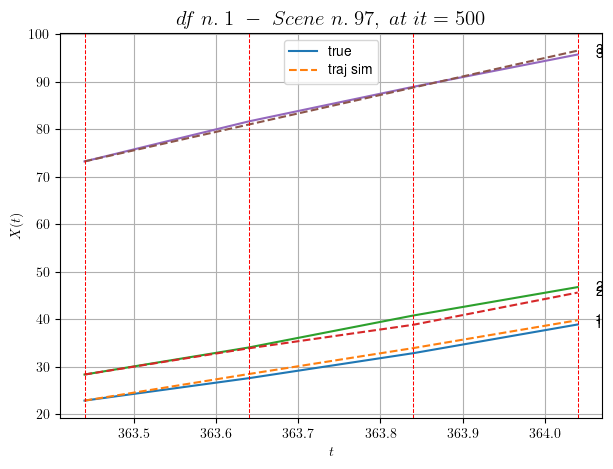

        For scene 97/109
        * use LR_NN=0.0005 with err=21.60729521937247 at it=24
        * v0_scn_mean = 38.38808517707975
        * MAE = 0.4061741980050569



df n.1, scene n.98/109
    We have 4 time intervals inside [386.64,387.44]
            - Time interval n.0: [386.64, 386.84]
                * y_true: [28.15052447 34.1607672 ]
                * v_ann: [34.683597564697266, 36.37161636352539, 39.34610016762267]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [386.84, 387.04]
                * y_true: [34.00091123 38.91120777]
                * v_ann: [32.51493835449219, 31.07561492919922, 39.34610016762267]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.04, 387.24]
                * y_true: [32.52639997 34.00151192]
                * v_ann: [34.925167083740234, 36.797332763671875, 39.34610016762

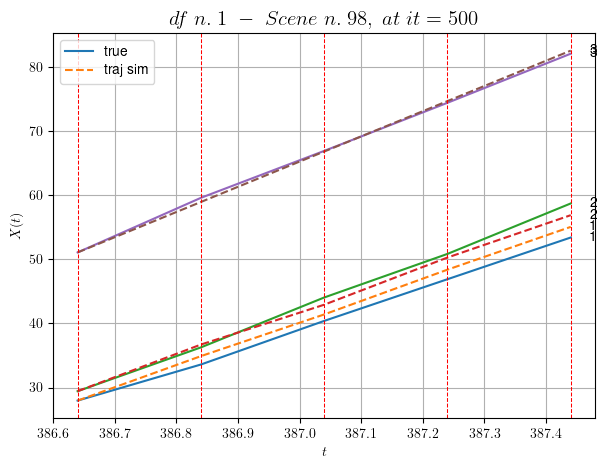

        For scene 98/109
        * use LR_NN=0.001 with err=18.03860484186667 at it=24
        * v0_scn_mean = 38.78533457718474
        * MAE = 0.7855259772316079



df n.1, scene n.99/109
    We have 2 time intervals inside [431.84,432.24]
            - Time interval n.0: [431.84, 432.04]
                * y_true: [30.8908033  31.49166882]
                * v_ann: [32.46357345581055, 31.917715072631836, 30.084161636187716]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [432.04, 432.24]
                * y_true: [39.73151551 26.376716  ]
                * v_ann: [32.44200134277344, 31.922199249267578, 30.084161636187716]

----------------------------------------------------------------------------------------------------
    * err= 0.4279203745796847
    * Learning rate NN = 7.289998848136747e-06
    * diff = 0.002452959836890367


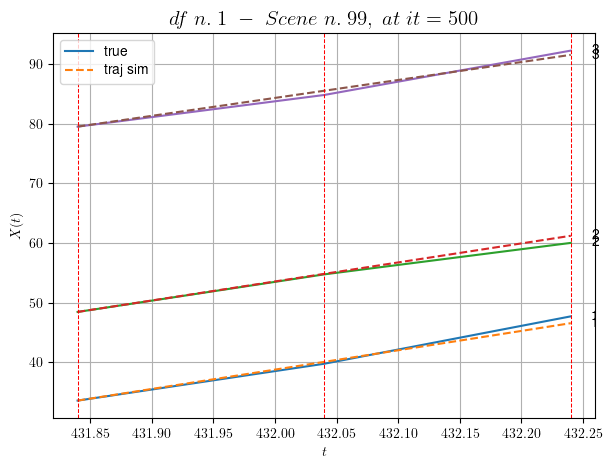

        For scene 99/109
        * use LR_NN=1e-05 with err=7.443902909746554 at it=24
        * v0_scn_mean = 30.079111941795013
        * MAE = 0.39899650896400723



df n.1, scene n.100/109
    We have 3 time intervals inside [446.24,446.84]
            - Time interval n.0: [446.24, 446.44]
                * y_true: [25.89017971 23.30046083]
                * v_ann: [26.956987380981445, 27.545394897460938, 29.554429209125292]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [446.44, 446.64]
                * y_true: [28.05031625 27.72075411]
                * v_ann: [25.520112991333008, 24.813852310180664, 29.554429209125292]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [446.64, 446.84]
                * y_true: [26.94045507 27.8009832 ]
                * v_ann: [26.938018798828125, 27.624271392822266, 29.5544

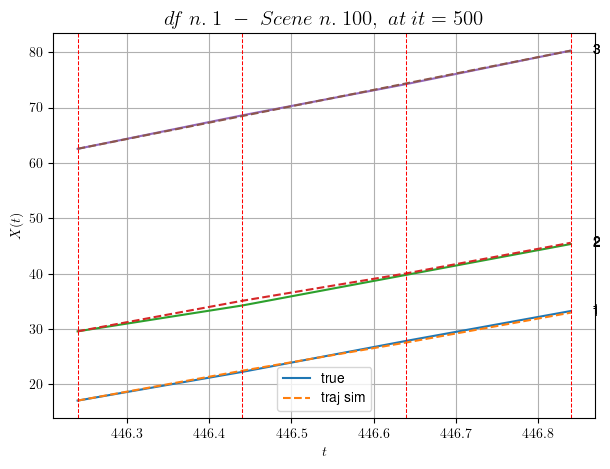

        For scene 100/109
        * use LR_NN=0.0005 with err=11.437562350553145 at it=24
        * v0_scn_mean = 29.581163436573036
        * MAE = 0.05733998002508983



df n.1, scene n.101/109
    We have 3 time intervals inside [447.44,448.04]
            - Time interval n.0: [447.44, 447.64]
                * y_true: [31.0713577  29.31148494]
                * v_ann: [27.112226486206055, 26.89231300354004, 32.58486004517812]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [447.64, 447.84]
                * y_true: [37.68225285 24.50151408]
                * v_ann: [28.047365188598633, 28.10763168334961, 32.58486004517812]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [447.84, 448.04]
                * y_true: [25.261801   20.71149408]
                * v_ann: [28.836814880371094, 29.3608455657959, 32.5848600

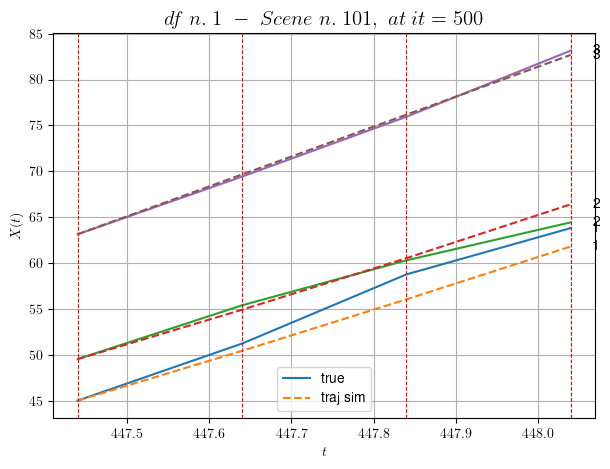

        For scene 101/109
        * use LR_NN=0.0005 with err=24.507337585884034 at it=24
        * v0_scn_mean = 32.42976855852147
        * MAE = 1.363798892225515



df n.1, scene n.102/109
    We have 2 time intervals inside [495.84,496.24]
            - Time interval n.0: [495.84, 496.04]
                * y_true: [23.1307843  13.57637571]
                * v_ann: [19.091028213500977, 19.08527183532715, 23.56309349087305]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [496.04, 496.24]
                * y_true: [23.23098731 16.2618474 ]
                * v_ann: [18.994029998779297, 19.027206420898438, 23.56309349087305]

----------------------------------------------------------------------------------------------------
    * err= 0.862989696715266
    * Learning rate NN = 7.289998757187277e-05
    * diff = 1.8085495793851436e-05


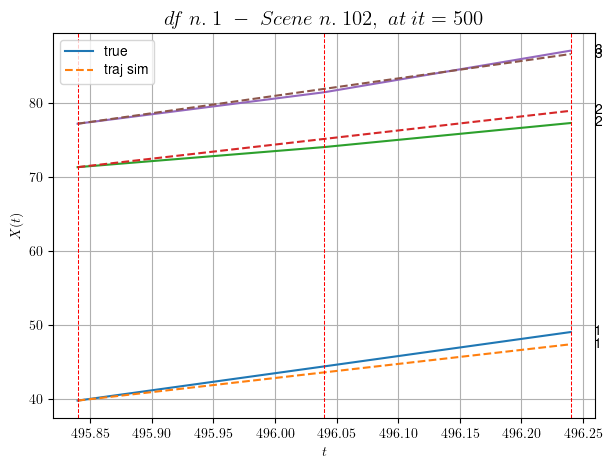

        For scene 102/109
        * use LR_NN=0.0001 with err=2.7975367064915493 at it=24
        * v0_scn_mean = 23.94930759241707
        * MAE = 0.862989696715266



df n.1, scene n.103/109
    We have 4 time intervals inside [496.84,497.64]
            - Time interval n.0: [496.84, 497.04]
                * y_true: [19.47545433 17.05100655]
                * v_ann: [18.04586410522461, 18.0562686920166, 23.67102213011773]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [497.04, 497.24]
                * y_true: [13.44536038 20.12642582]
                * v_ann: [18.175947189331055, 18.158676147460938, 23.67102213011773]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [497.24, 497.44]
                * y_true: [18.49565962 22.17670532]
                * v_ann: [17.303173065185547, 17.46299934387207, 23.6710221301

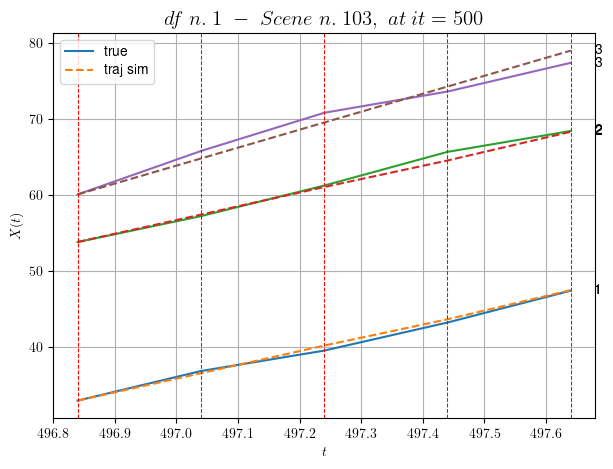

        For scene 103/109
        * use LR_NN=0.001 with err=11.897374269509811 at it=24
        * v0_scn_mean = 24.050760518153446
        * MAE = 0.5072876634538809



df n.1, scene n.104/109
    We have 2 time intervals inside [499.04,499.44]
            - Time interval n.0: [499.04, 499.24]
                * y_true: [23.84103851 15.32650765]
                * v_ann: [21.514854431152344, 21.559616088867188, 17.832163517131253]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [499.24, 499.44]
                * y_true: [26.92142921 19.88726092]
                * v_ann: [21.400571823120117, 21.47637367248535, 17.832163517131253]

----------------------------------------------------------------------------------------------------
    * err= 0.7793355912739317
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0025798473881541995


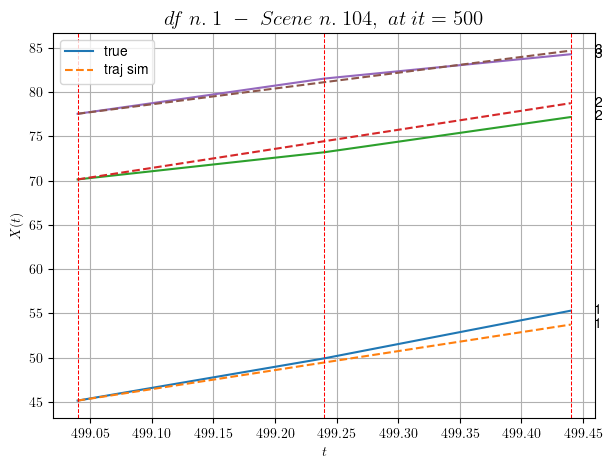

        For scene 104/109
        * use LR_NN=5e-05 with err=4.963480197817167 at it=24
        * v0_scn_mean = 18.562233159793692
        * MAE = 0.6855417946171248



df n.1, scene n.105/109
    We have 2 time intervals inside [500.64,501.04]
            - Time interval n.0: [500.64, 500.84]
                * y_true: [16.2004483  16.13562888]
                * v_ann: [17.50535774230957, 17.625144958496094, 12.361370218693533]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [500.84, 501.04]
                * y_true: [18.900675   17.67575332]
                * v_ann: [16.981483459472656, 16.75467300415039, 12.361370218693533]

----------------------------------------------------------------------------------------------------
    * err= 0.03240165674843884
    * Learning rate NN = 0.00036449998151510954
    * diff = 8.26045232493744e-08


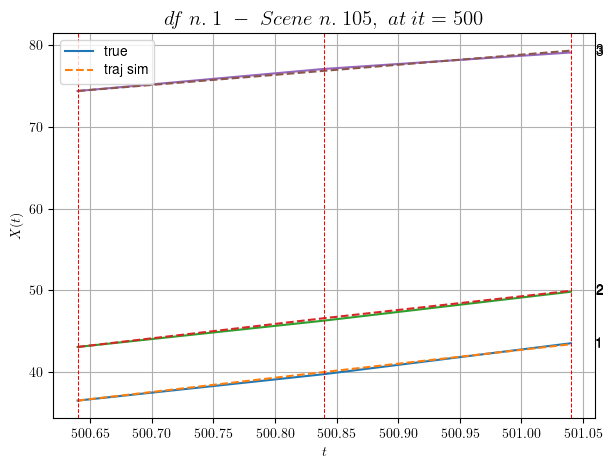

        For scene 105/109
        * use LR_NN=0.0005 with err=10.417973248596512 at it=24
        * v0_scn_mean = 13.419687213635992
        * MAE = 0.031533646735817676



df n.1, scene n.106/109
    We have 4 time intervals inside [502.24,503.04]
            - Time interval n.0: [502.24, 502.44]
                * y_true: [20.97545504 14.04040867]
                * v_ann: [17.873313903808594, 18.204580307006836, 15.581016722934288]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [502.44, 502.64]
                * y_true: [18.07559412 14.7904947 ]
                * v_ann: [17.618566513061523, 17.758811950683594, 15.581016722934288]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [502.64, 502.84]
                * y_true: [18.07559412 14.18054394]
                * v_ann: [17.081253051757812, 16.82711410522461, 15.5

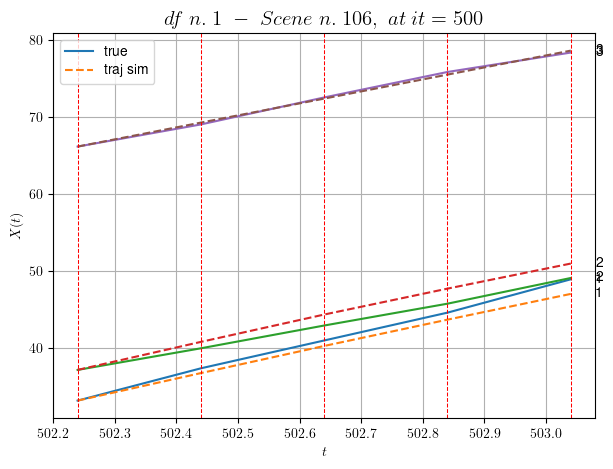

        For scene 106/109
        * use LR_NN=0.001 with err=25.482267367219944 at it=24
        * v0_scn_mean = 16.446155072176975
        * MAE = 1.0399570540855556



df n.1, scene n.107/109
    We have 2 time intervals inside [534.84,535.24]
            - Time interval n.0: [534.84, 535.04]
                * y_true: [ 8.93323515 20.37071651]
                * v_ann: [17.744089126586914, 18.685819625854492, 29.753482357835892]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [535.04, 535.24]
                * y_true: [ 8.47527286 31.64140498]
                * v_ann: [16.390308380126953, 16.258623123168945, 29.753482357835892]

----------------------------------------------------------------------------------------------------
    * err= 2.9074557693547667
    * Learning rate NN = 0.00036449998151510954
    * diff = 5.233734376908217e-05


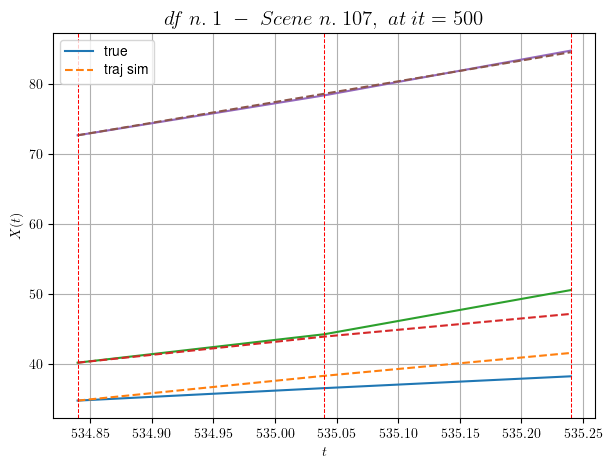

        For scene 107/109
        * use LR_NN=0.0005 with err=0.9604506888089067 at it=24
        * v0_scn_mean = 29.768273405295922
        * MAE = 2.90182202740077



df n.1, scene n.108/109
    We have 3 time intervals inside [573.84,574.44]
            - Time interval n.0: [573.84, 574.04]
                * y_true: [20.07571717 13.74586409]
                * v_ann: [12.782204627990723, 12.584420204162598, 9.338719660906905]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [574.04, 574.24]
                * y_true: [13.45064024 11.92582032]
                * v_ann: [15.327057838439941, 15.539324760437012, 9.338719660906905]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [574.24, 574.44]
                * y_true: [13.45064024 11.00083908]
                * v_ann: [13.572242736816406, 13.478153228759766, 9.3387196

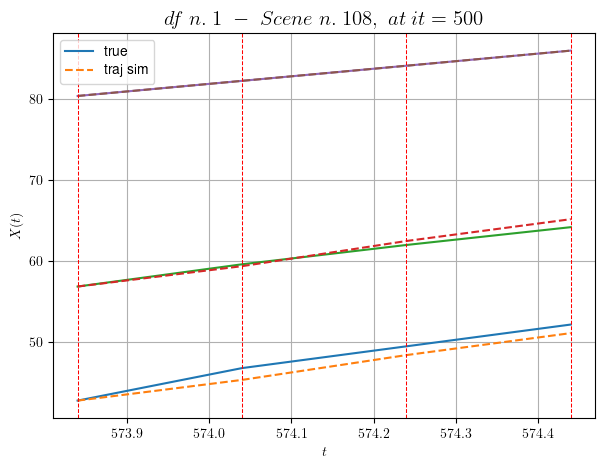

        For scene 108/109
        * use LR_NN=0.001 with err=22.6078681616911 at it=24
        * v0_scn_mean = 10.578395553606091
        * MAE = 0.42548474804489694



For df=1 with 109 scenes, time taken:        1826.40
****************************************************************************************************
****************************************************************************************************
In df n.2/10 we have 69 scenes
df n.2, scene n.0/69
    We have 5 time intervals inside [13.16,14.16]
            - Time interval n.0: [13.16, 13.36]
                * y_true: [14.81021865]
                * v_ann: [11.780166625976562, 24.635349855264952]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [13.36, 13.56]
                * y_true: [14.11025668]
                * v_ann: [13.642852783203125, 24.635349855264952]

---------------------------------------------------------------

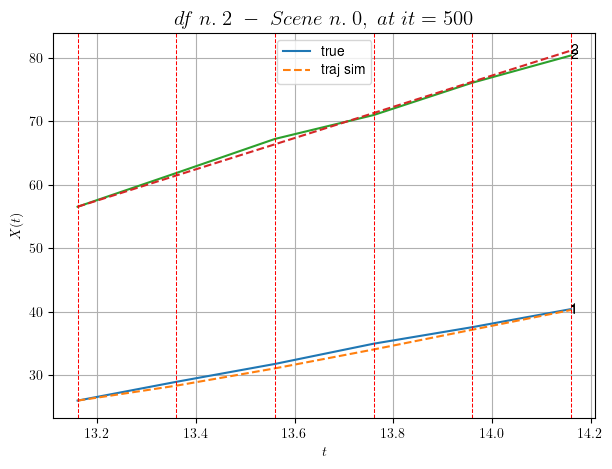

        For scene 0/69
        * use LR_NN=0.0005 with err=6.0948710846665675 at it=24
        * v0_scn_mean = 24.84993586101339
        * MAE = 0.2586973286328991



df n.2, scene n.1/69
    We have 3 time intervals inside [14.76,15.36]
            - Time interval n.0: [14.76, 14.96]
                * y_true: [12.25064682]
                * v_ann: [11.51613712310791, 27.615406088656982]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [14.96, 15.16]
                * y_true: [16.16094924]
                * v_ann: [16.19600486755371, 27.615406088656982]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [15.16, 15.36]
                * y_true: [18.71122804]
                * v_ann: [19.051542282104492, 27.615406088656982]

-------------------------------------------------------------------------------------------------

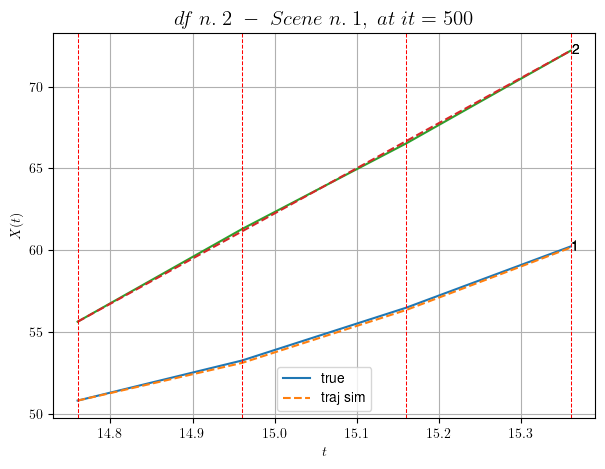

        For scene 1/69
        * use LR_NN=0.001 with err=0.5009253052201663 at it=24
        * v0_scn_mean = 27.710789845092453
        * MAE = 0.01078230237894369



df n.2, scene n.2/69
    We have 4 time intervals inside [52.76,53.56]
            - Time interval n.0: [52.76, 52.96]
                * y_true: [30.25172942]
                * v_ann: [34.69892120361328, 18.434937295304337]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [52.96, 53.16]
                * y_true: [31.50223079]
                * v_ann: [28.857751846313477, 18.434937295304337]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [53.16, 53.36]
                * y_true: [23.35196402]
                * v_ann: [25.749422073364258, 18.434937295304337]

-----------------------------------------------------------------------------------------------

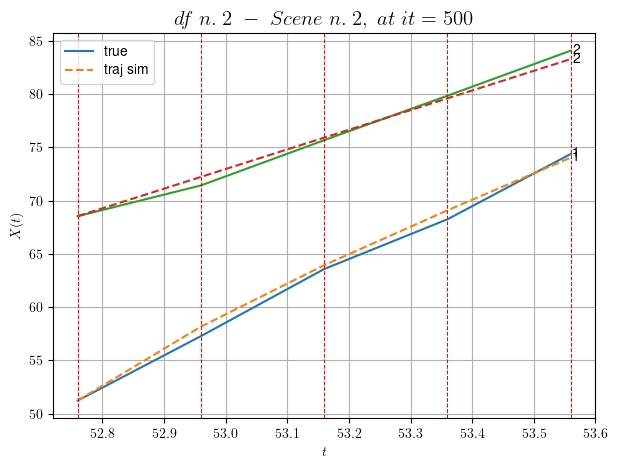

        For scene 2/69
        * use LR_NN=0.0001 with err=15.259958465219032 at it=24
        * v0_scn_mean = 18.897539803403802
        * MAE = 0.3111241241120076



df n.2, scene n.3/69
    We have 4 time intervals inside [54.56,55.36]
            - Time interval n.0: [54.56, 54.76]
                * y_true: [34.74114002]
                * v_ann: [36.3356819152832, 28.71632130964986]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [54.76, 54.96]
                * y_true: [32.07140907]
                * v_ann: [34.478050231933594, 28.71632130964986]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [54.96, 55.16]
                * y_true: [35.83207283]
                * v_ann: [32.46285629272461, 28.71632130964986]

----------------------------------------------------------------------------------------------------

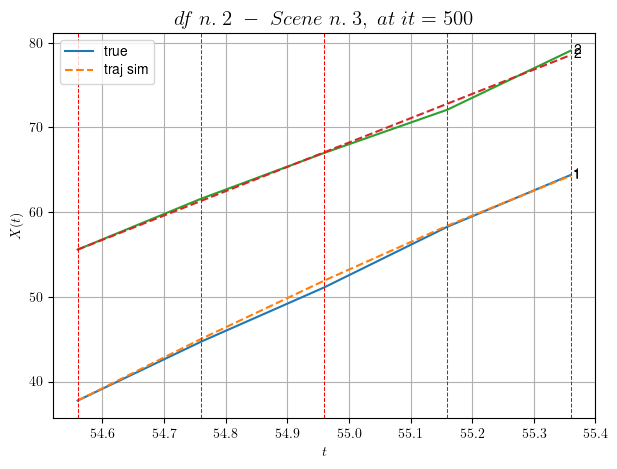

        For scene 3/69
        * use LR_NN=0.0001 with err=0.4063111843076329 at it=24
        * v0_scn_mean = 28.767668457254015
        * MAE = 0.15922495225222666



df n.2, scene n.4/69
    We have 3 time intervals inside [61.16,61.76]
            - Time interval n.0: [61.16, 61.36]
                * y_true: [28.89080545]
                * v_ann: [19.388648986816406, 30.583768746275553]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [61.36, 61.56]
                * y_true: [23.17083447]
                * v_ann: [27.327730178833008, 30.583768746275553]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [61.56, 61.76]
                * y_true: [22.65102829]
                * v_ann: [26.29119873046875, 30.583768746275553]

----------------------------------------------------------------------------------------------

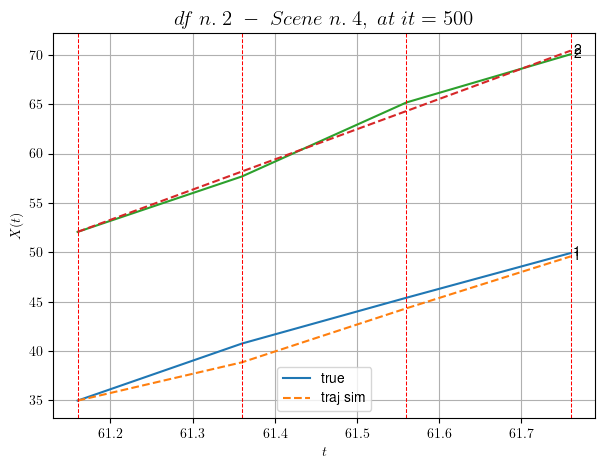

        For scene 4/69
        * use LR_NN=0.001 with err=0.4912556604862962 at it=24
        * v0_scn_mean = 30.560417996429315
        * MAE = 0.45062209183535273



df n.2, scene n.5/69
    We have 8 time intervals inside [70.16,71.76]
            - Time interval n.0: [70.16, 70.36]
                * y_true: [13.71005372]
                * v_ann: [14.435115814208984, 24.74132277086493]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [70.36, 70.56]
                * y_true: [14.49007965]
                * v_ann: [15.39547061920166, 24.74132277086493]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [70.56, 70.76]
                * y_true: [12.37009292]
                * v_ann: [16.341960906982422, 24.74132277086493]

--------------------------------------------------------------------------------------------------

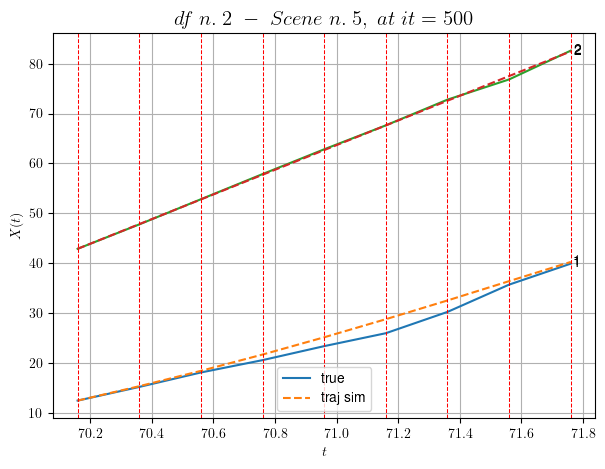

        For scene 5/69
        * use LR_NN=0.0001 with err=12.909979380053148 at it=24
        * v0_scn_mean = 24.951669859990027
        * MAE = 1.0144235751879174



df n.2, scene n.6/69
    We have 6 time intervals inside [77.56,78.76]
            - Time interval n.0: [77.56, 77.76]
                * y_true: [21.77061473]
                * v_ann: [26.863609313964844, 14.529876108312802]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [77.76, 77.96]
                * y_true: [26.75095459]
                * v_ann: [26.28165626525879, 14.529876108312802]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [77.96, 78.16]
                * y_true: [19.2308048]
                * v_ann: [23.68064308166504, 14.529876108312802]

-------------------------------------------------------------------------------------------------

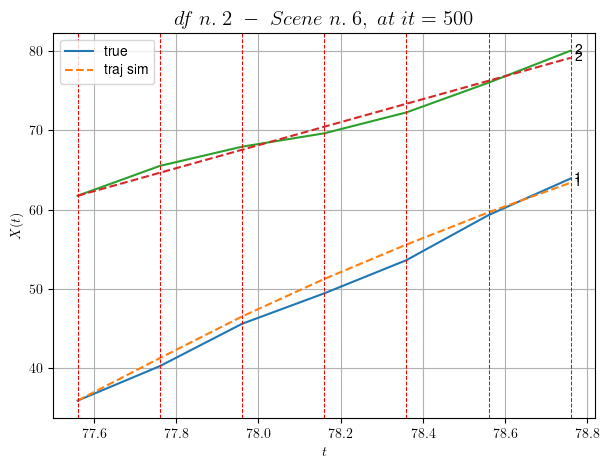

        For scene 6/69
        * use LR_NN=1e-05 with err=63.744596047958936 at it=24
        * v0_scn_mean = 15.14868106386218
        * MAE = 0.9362719986211027



df n.2, scene n.7/69
    We have 5 time intervals inside [84.96,85.96]
            - Time interval n.0: [84.96, 85.16]
                * y_true: [14.95056422]
                * v_ann: [15.211827278137207, 24.168678500842805]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [85.16, 85.36]
                * y_true: [15.66066483]
                * v_ann: [14.804030418395996, 24.168678500842805]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [85.36, 85.56]
                * y_true: [13.67066032]
                * v_ann: [14.556784629821777, 24.168678500842805]

------------------------------------------------------------------------------------------------

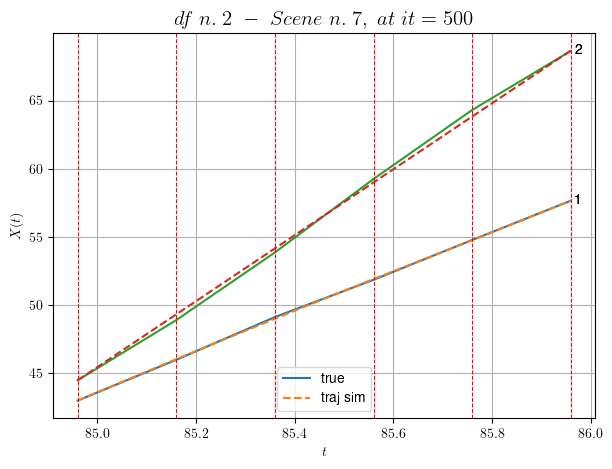

        For scene 7/69
        * use LR_NN=0.001 with err=8.479848418891589 at it=24
        * v0_scn_mean = 24.401931360764564
        * MAE = 0.04798813315938736



df n.2, scene n.8/69
    We have 2 time intervals inside [96.36,96.76]
            - Time interval n.0: [96.36, 96.56]
                * y_true: [11.49034742]
                * v_ann: [12.699430465698242, 20.59884821562977]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [96.56, 96.76]
                * y_true: [14.32646364]
                * v_ann: [13.174050331115723, 20.59884821562977]

----------------------------------------------------------------------------------------------------
    * err= 0.01910446102866764
    * Learning rate NN = 7.289998848136747e-06
    * diff = 3.694069059312355e-06


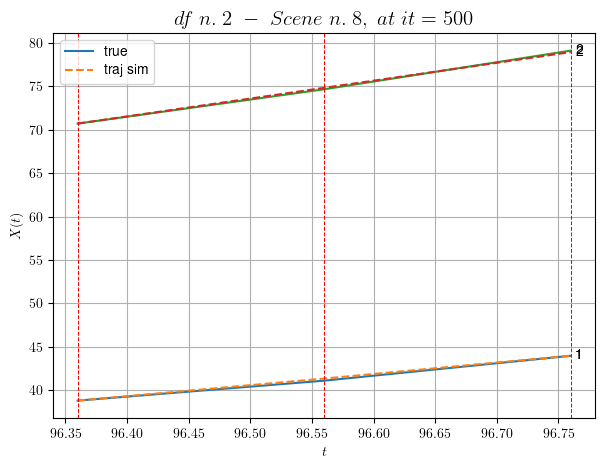

        For scene 8/69
        * use LR_NN=1e-05 with err=2.8573104104664955 at it=24
        * v0_scn_mean = 20.97489428693283
        * MAE = 0.018704604088218096



df n.2, scene n.9/69
    We have 2 time intervals inside [114.36,114.76]
            - Time interval n.0: [114.36, 114.56]
                * y_true: [27.56081405]
                * v_ann: [25.541748046875, 11.484652947736484]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [114.56, 114.76]
                * y_true: [21.25080883]
                * v_ann: [23.47110366821289, 11.484652947736484]

----------------------------------------------------------------------------------------------------
    * err= 0.07990936136116915
    * Learning rate NN = 7.289998848136747e-06
    * diff = 2.8063594584154528e-05


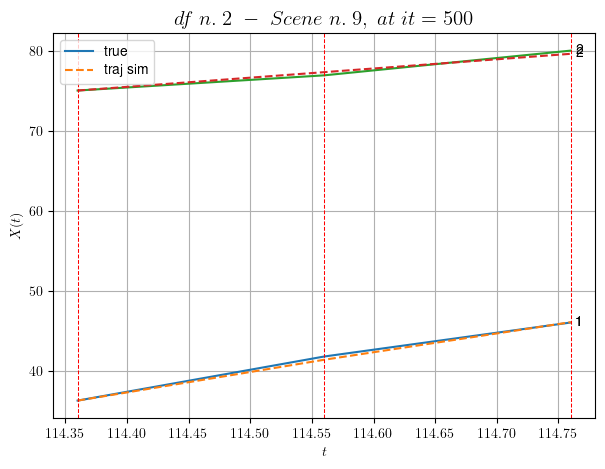

        For scene 9/69
        * use LR_NN=1e-05 with err=11.017923569076014 at it=24
        * v0_scn_mean = 12.225266829685497
        * MAE = 0.07550165120460772



df n.2, scene n.10/69
    We have 4 time intervals inside [127.56,128.36]
            - Time interval n.0: [127.56, 127.76]
                * y_true: [21.85131651]
                * v_ann: [22.274921417236328, 15.931637978874187]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [127.76, 127.96]
                * y_true: [20.90145861]
                * v_ann: [20.544879913330078, 15.931637978874187]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [127.96, 128.16]
                * y_true: [23.00184718]
                * v_ann: [20.900388717651367, 15.931637978874187]

-------------------------------------------------------------------------------------

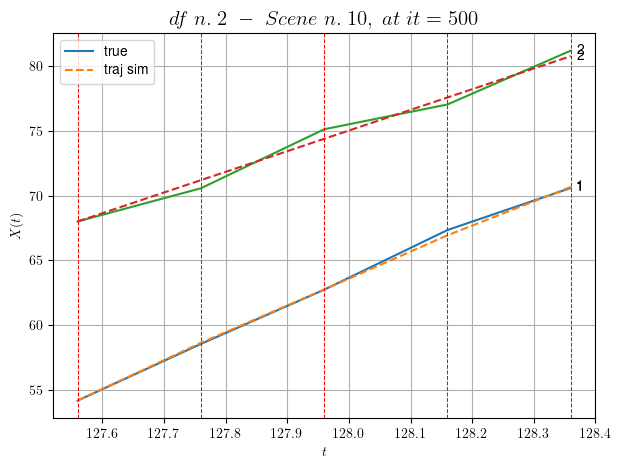

        For scene 10/69
        * use LR_NN=5e-05 with err=23.381841811784184 at it=24
        * v0_scn_mean = 16.49437245961166
        * MAE = 0.15876318273121512



df n.2, scene n.11/69
    We have 2 time intervals inside [145.16,145.56]
    * err= 0.09020838770937992
    * Learning rate NN = 4.049999552080408e-05
    * diff = 2.2845785997704926e-07


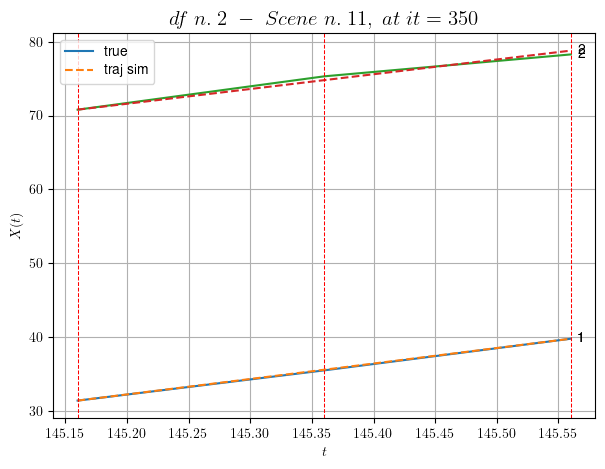

        For scene 11/69
        * use LR_NN=5e-05 with err=3.7547389753725 at it=24
        * v0_scn_mean = 20.589118746424116
        * MAE = 0.09020838770937992



df n.2, scene n.12/69
    We have 6 time intervals inside [163.76,164.96]
            - Time interval n.0: [163.76, 163.96]
                * y_true: [22.33118282]
                * v_ann: [17.887136459350586, 19.717171056115895]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [163.96, 164.16]
                * y_true: [19.30705544]
                * v_ann: [19.066665649414062, 19.717171056115895]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [164.16, 164.36]
                * y_true: [17.5112259]
                * v_ann: [19.015625, 19.717171056115895]

-------------------------------------------------------------------------------------------------

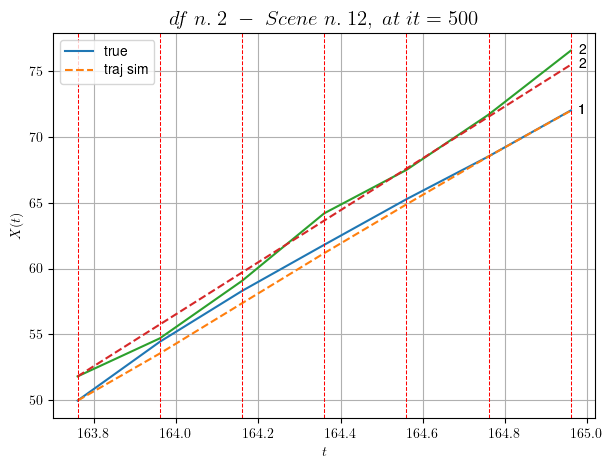

        For scene 12/69
        * use LR_NN=0.005 with err=26.128846960084946 at it=24
        * v0_scn_mean = 20.128484213792238
        * MAE = 0.3744836064645407



df n.2, scene n.13/69
    We have 3 time intervals inside [183.96,184.56]
            - Time interval n.0: [183.96, 184.16]
                * y_true: [11.94015042]
                * v_ann: [13.020687103271484, 17.051810908720892]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [184.16, 184.36]
                * y_true: [14.40021558]
                * v_ann: [12.911334991455078, 17.051810908720892]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [184.36, 184.56]
                * y_true: [12.66022732]
                * v_ann: [13.095035552978516, 17.051810908720892]

-------------------------------------------------------------------------------------

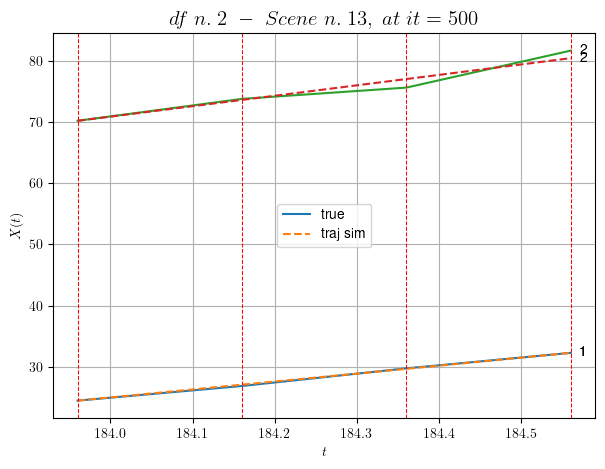

        For scene 13/69
        * use LR_NN=1e-05 with err=11.492789757363518 at it=24
        * v0_scn_mean = 17.5697384722732
        * MAE = 0.4351030663319313



df n.2, scene n.14/69
    We have 10 time intervals inside [198.16,200.16]
            - Time interval n.0: [198.16, 198.36]
                * y_true: [24.60086798]
                * v_ann: [22.443115234375, 17.756279251513206]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [198.36, 198.56]
                * y_true: [19.85085228]
                * v_ann: [22.92759895324707, 17.756279251513206]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [198.56, 198.76]
                * y_true: [19.65099051]
                * v_ann: [21.082691192626953, 17.756279251513206]

------------------------------------------------------------------------------------------

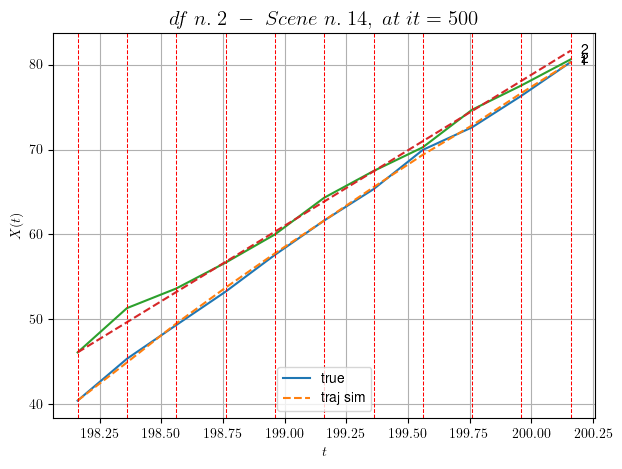

        For scene 14/69
        * use LR_NN=0.001 with err=108.95446732368605 at it=24
        * v0_scn_mean = 18.246028081358965
        * MAE = 0.27892809168348176



df n.2, scene n.15/69
    We have 2 time intervals inside [208.96,209.36]
            - Time interval n.0: [208.96, 209.16]
                * y_true: [10.93080354]
                * v_ann: [10.23622989654541, 19.925309614241876]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [209.16, 209.36]
                * y_true: [8.50069201]
                * v_ann: [9.099432945251465, 19.925309614241876]

----------------------------------------------------------------------------------------------------
    * err= 0.005237957160881487
    * Learning rate NN = 7.289998757187277e-05
    * diff = 5.55783923080061e-05


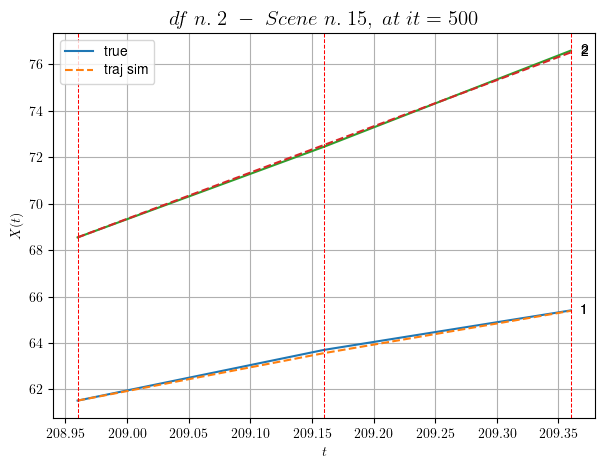

        For scene 15/69
        * use LR_NN=0.0001 with err=3.377289878046498 at it=24
        * v0_scn_mean = 20.328297229595496
        * MAE = 0.005237957160881487



df n.2, scene n.16/69
    We have 9 time intervals inside [210.56,212.36]
            - Time interval n.0: [210.56, 210.76]
                * y_true: [15.80031472]
                * v_ann: [17.56464195251465, 22.562964085931316]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [210.76, 210.96]
                * y_true: [21.08915117]
                * v_ann: [17.974252700805664, 22.562964085931316]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [210.96, 211.16]
                * y_true: [16.15047692]
                * v_ann: [17.968992233276367, 22.562964085931316]

------------------------------------------------------------------------------------

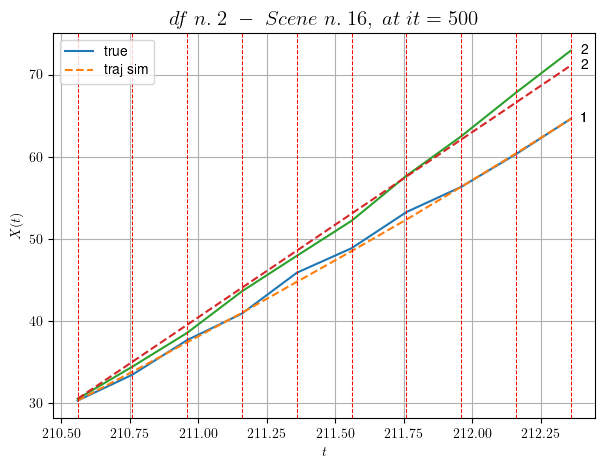

        For scene 16/69
        * use LR_NN=0.001 with err=30.061323088130177 at it=24
        * v0_scn_mean = 22.860445522437786
        * MAE = 0.4948963320565375



df n.2, scene n.17/69
    We have 3 time intervals inside [215.36,215.96]
            - Time interval n.0: [215.36, 215.56]
                * y_true: [23.8914478]
                * v_ann: [24.6066951751709, 17.643232536852032]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.56, 215.76]
                * y_true: [27.35187922]
                * v_ann: [23.681352615356445, 17.643232536852032]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.76, 215.96]
                * y_true: [17.52141306]
                * v_ann: [21.23722267150879, 17.643232536852032]

-----------------------------------------------------------------------------------------

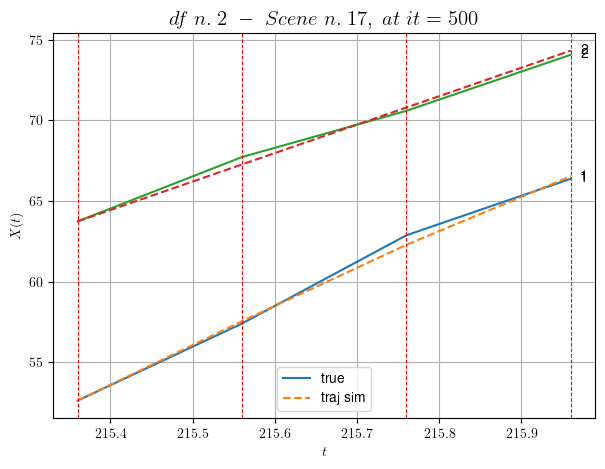

        For scene 17/69
        * use LR_NN=0.0001 with err=11.20322646298746 at it=24
        * v0_scn_mean = 18.13750323528351
        * MAE = 0.08892360133646011



df n.2, scene n.18/69
    We have 4 time intervals inside [218.36,219.16]
            - Time interval n.0: [218.36, 218.56]
                * y_true: [9.80048787]
                * v_ann: [9.585213661193848, 19.2918574497649]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [218.56, 218.76]
                * y_true: [8.90049368]
                * v_ann: [9.457493782043457, 19.2918574497649]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [218.76, 218.96]
                * y_true: [12.75076549]
                * v_ann: [9.332305908203125, 19.2918574497649]

------------------------------------------------------------------------------------------------

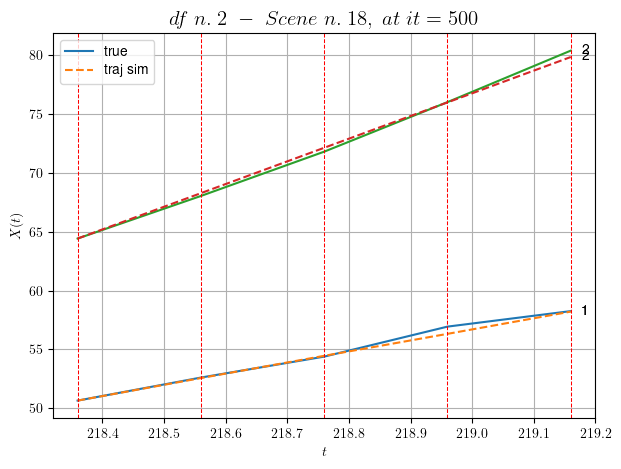

        For scene 18/69
        * use LR_NN=5e-05 with err=13.399953951418592 at it=24
        * v0_scn_mean = 19.72018315169216
        * MAE = 0.0849389287417385



df n.2, scene n.19/69
    We have 4 time intervals inside [220.36,221.16]
            - Time interval n.0: [220.36, 220.56]
                * y_true: [20.88092381]
                * v_ann: [26.31862449645996, 13.996427133410164]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [220.56, 220.76]
                * y_true: [18.0409286]
                * v_ann: [20.608924865722656, 13.996427133410164]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [220.76, 220.96]
                * y_true: [23.87145329]
                * v_ann: [16.297544479370117, 13.996427133410164]

----------------------------------------------------------------------------------------

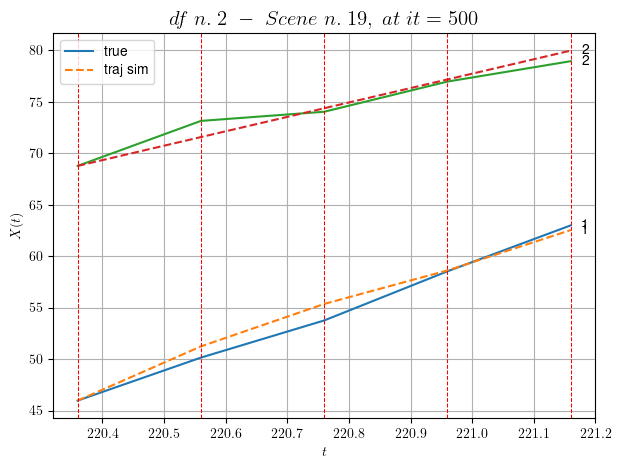

        For scene 19/69
        * use LR_NN=0.001 with err=33.74146521228804 at it=24
        * v0_scn_mean = 14.636570047951421
        * MAE = 0.6025580148667258



df n.2, scene n.20/69
    We have 2 time intervals inside [223.16,223.56]
    * err= 0.014251037360257422
    * Learning rate NN = 0.00040499999886378646
    * diff = 1.48590673425264e-07


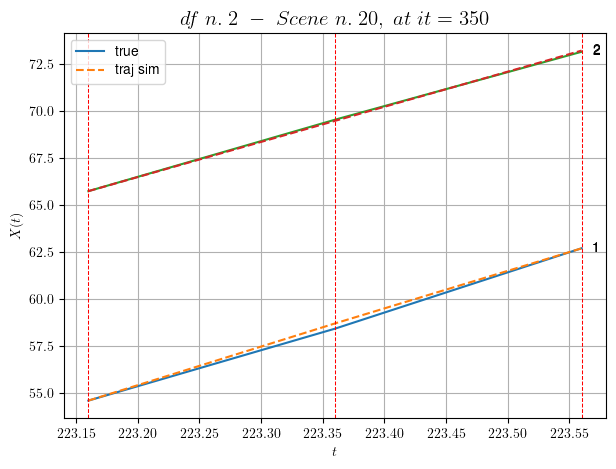

        For scene 20/69
        * use LR_NN=0.0005 with err=4.328835235007853 at it=24
        * v0_scn_mean = 19.34417761178436
        * MAE = 0.014251037360257422



df n.2, scene n.21/69
    We have 10 time intervals inside [233.36,235.36]
            - Time interval n.0: [233.36, 233.56]
                * y_true: [15.9800087]
                * v_ann: [17.28714370727539, 20.300783427084642]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [233.56, 233.76]
                * y_true: [18.0400262]
                * v_ann: [17.555471420288086, 20.300783427084642]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [233.76, 233.96]
                * y_true: [20.58006219]
                * v_ann: [17.65180015563965, 20.300783427084642]

---------------------------------------------------------------------------------------

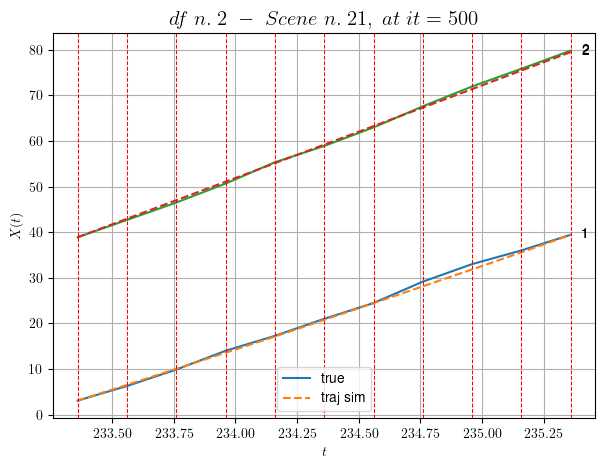

        For scene 21/69
        * use LR_NN=1e-05 with err=64.5712951328713 at it=24
        * v0_scn_mean = 20.688752089926975
        * MAE = 0.19421854982704398



df n.2, scene n.22/69
    We have 7 time intervals inside [246.36,247.76]
            - Time interval n.0: [246.36, 246.56]
                * y_true: [19.95129864]
                * v_ann: [21.32527732849121, 3.538091727525967]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [246.56, 246.76]
                * y_true: [17.951325]
                * v_ann: [18.986989974975586, 3.538091727525967]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [246.76, 246.96]
                * y_true: [19.60162726]
                * v_ann: [17.34686851501465, 3.538091727525967]

---------------------------------------------------------------------------------------------

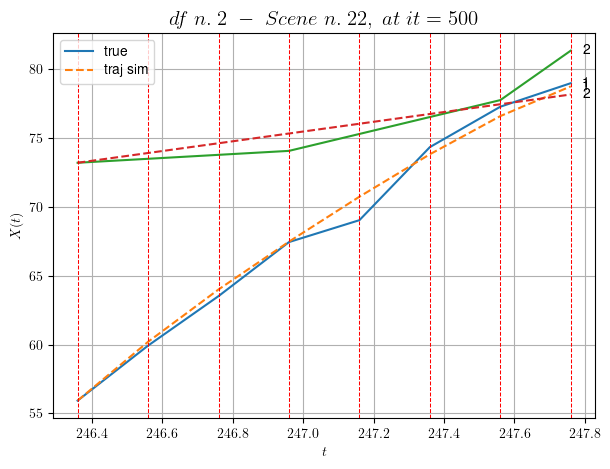

        For scene 22/69
        * use LR_NN=0.0005 with err=238.62471852780945 at it=24
        * v0_scn_mean = 4.596568058222686
        * MAE = 1.0800958365747624



df n.2, scene n.23/69
    We have 4 time intervals inside [250.16,250.96]
            - Time interval n.0: [250.16, 250.36]
                * y_true: [20.04064227]
                * v_ann: [17.914043426513672, 17.364515373912916]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [250.36, 250.56]
                * y_true: [20.33077522]
                * v_ann: [18.042644500732422, 17.364515373912916]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [250.56, 250.76]
                * y_true: [17.28077239]
                * v_ann: [18.414173126220703, 17.364515373912916]

-------------------------------------------------------------------------------------

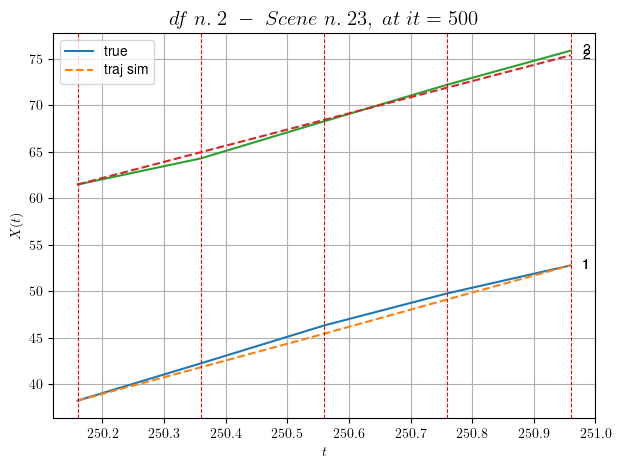

        For scene 23/69
        * use LR_NN=5e-05 with err=18.358452104733793 at it=24
        * v0_scn_mean = 17.869934758859607
        * MAE = 0.21903687009529874



df n.2, scene n.24/69
    We have 3 time intervals inside [253.96,254.56]
            - Time interval n.0: [253.96, 254.16]
                * y_true: [3.96001286]
                * v_ann: [5.581990718841553, 19.059884309201752]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [254.16, 254.36]
                * y_true: [5.65002208]
                * v_ann: [4.754130840301514, 19.059884309201752]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [254.36, 254.56]
                * y_true: [5.43002353]
                * v_ann: [4.7647013664245605, 19.059884309201752]

-----------------------------------------------------------------------------------------

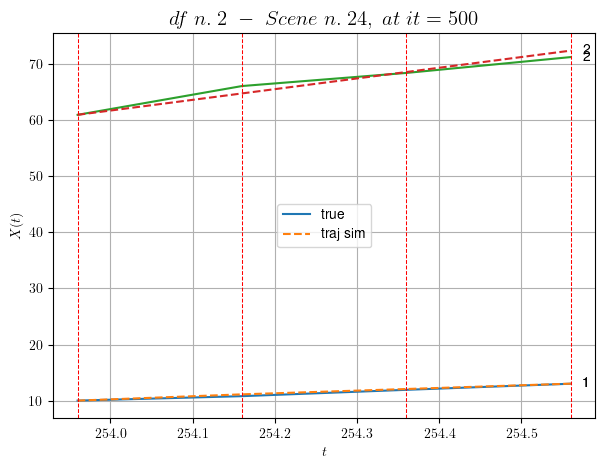

        For scene 24/69
        * use LR_NN=1e-05 with err=10.115034477098593 at it=24
        * v0_scn_mean = 19.497488936750237
        * MAE = 0.4003437466594371



df n.2, scene n.25/69
    We have 8 time intervals inside [256.56,258.16]
            - Time interval n.0: [256.56, 256.76]
                * y_true: [19.53061148]
                * v_ann: [21.365869522094727, 18.832978045462248]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [256.76, 256.96]
                * y_true: [21.00079129]
                * v_ann: [20.876314163208008, 18.832978045462248]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [256.96, 257.16]
                * y_true: [23.14105686]
                * v_ann: [20.404876708984375, 18.832978045462248]

-------------------------------------------------------------------------------------

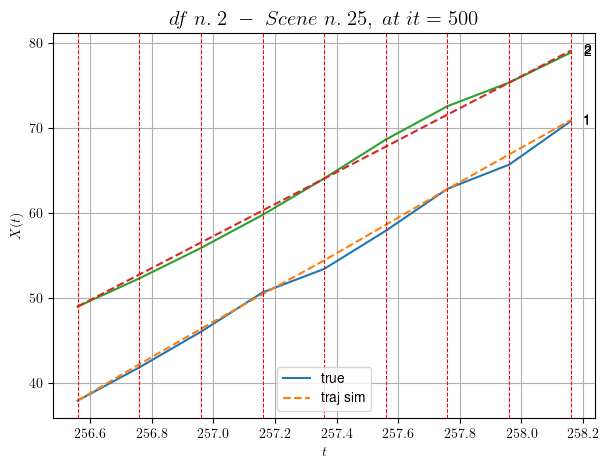

        For scene 25/69
        * use LR_NN=5e-05 with err=55.639747852479616 at it=24
        * v0_scn_mean = 19.279658923558486
        * MAE = 0.32325184710824384



df n.2, scene n.26/69
    We have 2 time intervals inside [275.56,275.96]
            - Time interval n.0: [275.56, 275.76]
                * y_true: [7.75034114]
                * v_ann: [14.475088119506836, 27.245148829197323]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [275.76, 275.96]
                * y_true: [22.30520974]
                * v_ann: [17.529020309448242, 27.245148829197323]

----------------------------------------------------------------------------------------------------
    * err= 0.35815101074724565
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.007817577146715382


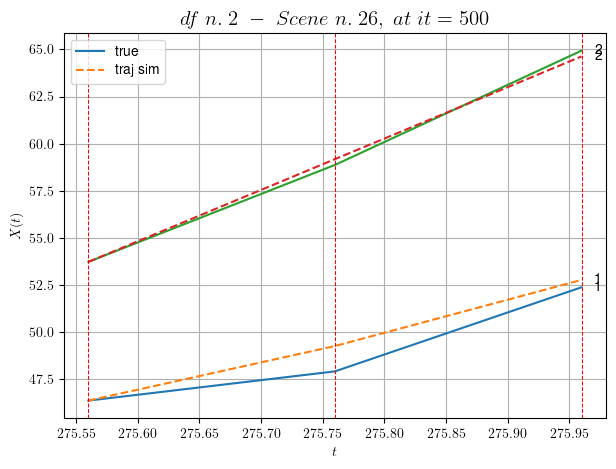

        For scene 26/69
        * use LR_NN=0.0001 with err=0.36494338696274825 at it=24
        * v0_scn_mean = 27.355342876006034
        * MAE = 0.35815101074724565



df n.2, scene n.27/69
    We have 3 time intervals inside [287.36,287.96]
            - Time interval n.0: [287.36, 287.56]
                * y_true: [19.57128016]
                * v_ann: [24.750822067260742, 19.08174409433956]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [287.56, 287.76]
                * y_true: [26.37205005]
                * v_ann: [24.542644500732422, 19.08174409433956]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [287.76, 287.96]
                * y_true: [26.13226254]
                * v_ann: [22.23797607421875, 19.08174409433956]

--------------------------------------------------------------------------------------

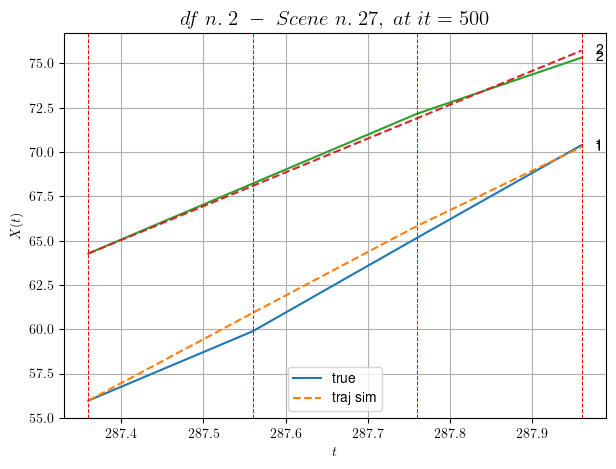

        For scene 27/69
        * use LR_NN=0.0001 with err=8.909826838746277 at it=24
        * v0_scn_mean = 19.518474330483166
        * MAE = 0.2209025182828024



df n.2, scene n.28/69
    We have 3 time intervals inside [292.96,293.56]
            - Time interval n.0: [292.96, 293.16]
                * y_true: [8.97521593]
                * v_ann: [10.684830665588379, 19.771247175293336]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [293.16, 293.36]
                * y_true: [9.88525546]
                * v_ann: [10.948099136352539, 19.771247175293336]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [293.36, 293.56]
                * y_true: [13.52541357]
                * v_ann: [11.1716947555542, 19.771247175293336]

-----------------------------------------------------------------------------------------

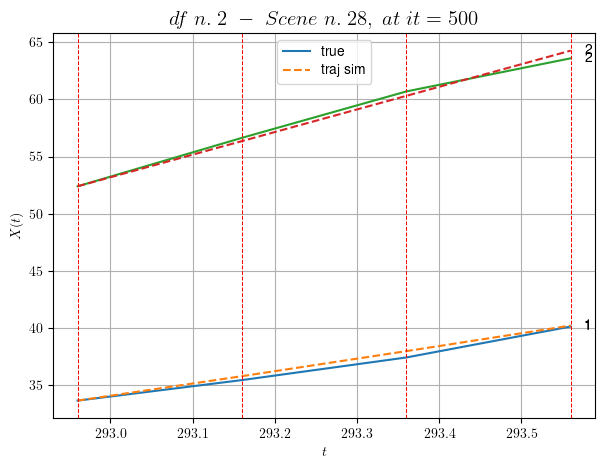

        For scene 28/69
        * use LR_NN=5e-05 with err=7.916561263397348 at it=24
        * v0_scn_mean = 20.18039728820062
        * MAE = 0.13874523683493165



df n.2, scene n.29/69
    We have 2 time intervals inside [314.96,315.36]
            - Time interval n.0: [314.96, 315.16]
                * y_true: [23.83200106]
                * v_ann: [16.023334503173828, 19.975403002157083]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [315.16, 315.36]
                * y_true: [8.26224636]
                * v_ann: [16.319536209106445, 19.975403002157083]

----------------------------------------------------------------------------------------------------
    * err= 0.42898975274846957
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.00033477418362759526


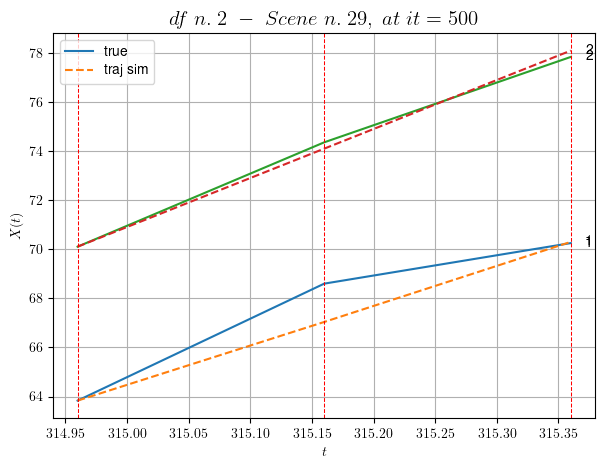

        For scene 29/69
        * use LR_NN=0.0005 with err=3.9504185245850127 at it=24
        * v0_scn_mean = 20.376386881991273
        * MAE = 0.4254209828383404



df n.2, scene n.30/69
    We have 3 time intervals inside [332.76,333.36]
            - Time interval n.0: [332.76, 332.96]
                * y_true: [13.15083663]
                * v_ann: [13.892515182495117, 24.607227640643536]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [332.96, 333.16]
                * y_true: [17.65124615]
                * v_ann: [17.18035316467285, 24.607227640643536]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [333.16, 333.36]
                * y_true: [18.95150362]
                * v_ann: [18.856689453125, 24.607227640643536]

----------------------------------------------------------------------------------------

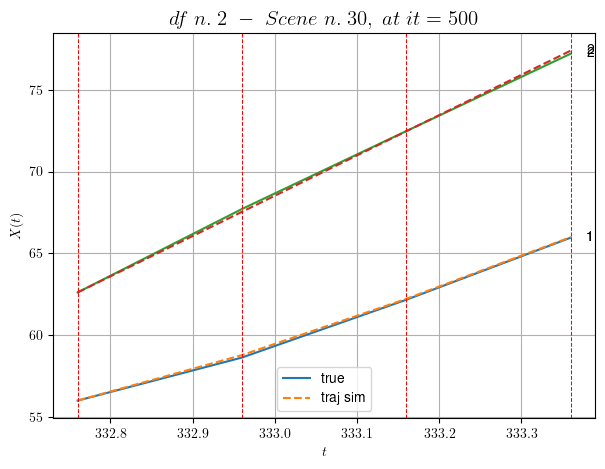

        For scene 30/69
        * use LR_NN=0.0001 with err=2.1496754220219243 at it=24
        * v0_scn_mean = 24.822938534974565
        * MAE = 0.011305717820654343



df n.2, scene n.31/69
    We have 7 time intervals inside [354.76,356.16]
            - Time interval n.0: [354.76, 354.96]
                * y_true: [15.35025294]
                * v_ann: [13.959888458251953, 18.73800634953481]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [354.96, 355.16]
                * y_true: [16.45032349]
                * v_ann: [14.424625396728516, 18.73800634953481]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [355.16, 355.36]
                * y_true: [17.47042754]
                * v_ann: [15.517117500305176, 18.73800634953481]

-------------------------------------------------------------------------------------

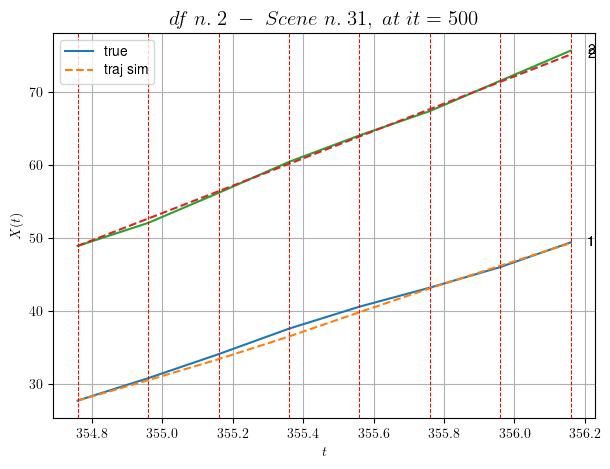

        For scene 31/69
        * use LR_NN=0.001 with err=43.478226413413424 at it=24
        * v0_scn_mean = 19.188486095467265
        * MAE = 0.09389200532242321



df n.2, scene n.32/69
    We have 3 time intervals inside [358.16,358.76]
    * err= 0.1133210909905071
    * Learning rate NN = 4.049999552080408e-05
    * diff = 3.6720309613824664e-07


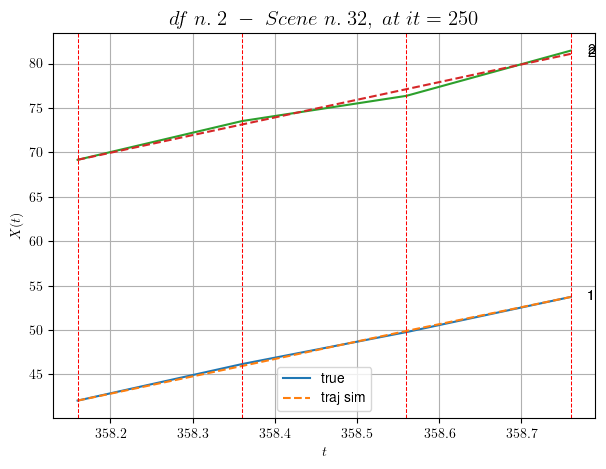

        For scene 32/69
        * use LR_NN=5e-05 with err=7.297455328304544 at it=24
        * v0_scn_mean = 20.686927810675915
        * MAE = 0.1133210909905071



df n.2, scene n.33/69
    We have 4 time intervals inside [362.36,363.16]
            - Time interval n.0: [362.36, 362.56]
                * y_true: [24.84104061]
                * v_ann: [17.4971981048584, 26.93115929258924]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [362.56, 362.76]
                * y_true: [14.1606775]
                * v_ann: [18.33941650390625, 26.93115929258924]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [362.76, 362.96]
                * y_true: [21.95124893]
                * v_ann: [21.09056282043457, 26.93115929258924]

----------------------------------------------------------------------------------------------

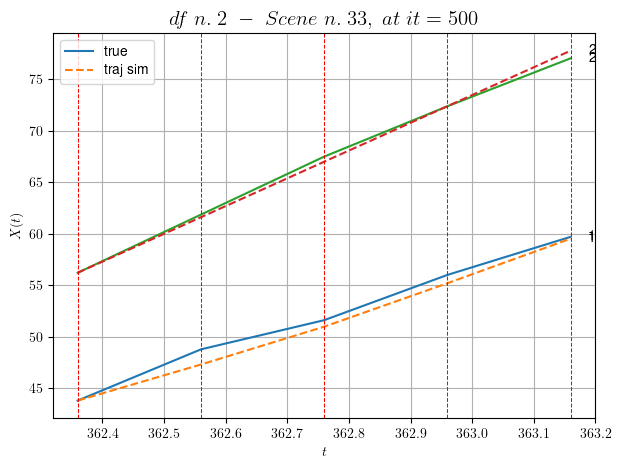

        For scene 33/69
        * use LR_NN=5e-05 with err=1.8703815305120617 at it=24
        * v0_scn_mean = 27.053912920860917
        * MAE = 0.4080500148708413



df n.2, scene n.34/69
    We have 5 time intervals inside [365.16,366.16]
            - Time interval n.0: [365.16, 365.36]
                * y_true: [16.50108755]
                * v_ann: [17.70182991027832, 23.672070636508188]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [365.36, 365.56]
                * y_true: [18.10133819]
                * v_ann: [17.123409271240234, 23.672070636508188]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [365.56, 365.76]
                * y_true: [23.65199157]
                * v_ann: [18.18190574645996, 23.672070636508188]

---------------------------------------------------------------------------------------

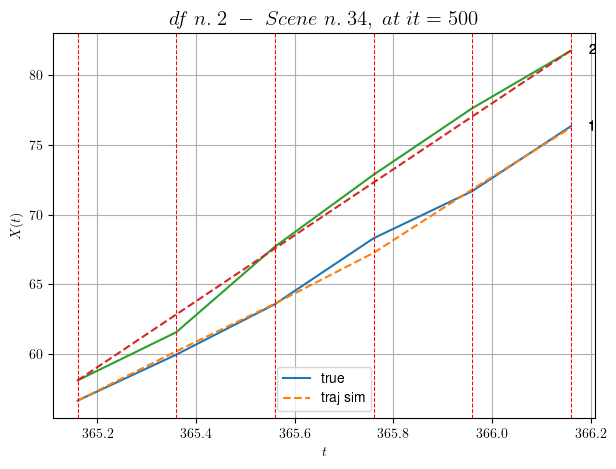

        For scene 34/69
        * use LR_NN=0.005 with err=7.022473868063036 at it=24
        * v0_scn_mean = 23.925187810999216
        * MAE = 0.29118166677118246



df n.2, scene n.35/69
    We have 4 time intervals inside [396.76,397.56]
    * err= 39.62560477253356
    * Learning rate NN = 3.2804993679746985e-05
    * diff = 5.651746164403448e-07


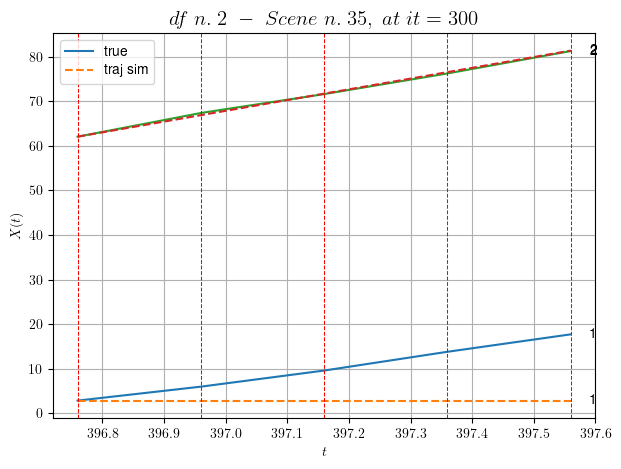

        For scene 35/69
        * use LR_NN=5e-05 with err=4.44301642994803 at it=24
        * v0_scn_mean = 24.514095079984745
        * MAE = 39.62560477253356



df n.2, scene n.36/69
    We have 5 time intervals inside [399.56,400.56]
            - Time interval n.0: [399.56, 399.76]
                * y_true: [22.65080888]
                * v_ann: [-1.5529300071648322e-05, 22.285901484031587]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [399.76, 399.96]
                * y_true: [15.05063497]
                * v_ann: [-8.524814802512992e-06, 22.285901484031587]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [399.96, 400.16]
                * y_true: [19.30093791]
                * v_ann: [-2.4008486434468068e-05, 22.285901484031587]

--------------------------------------------------------------------------

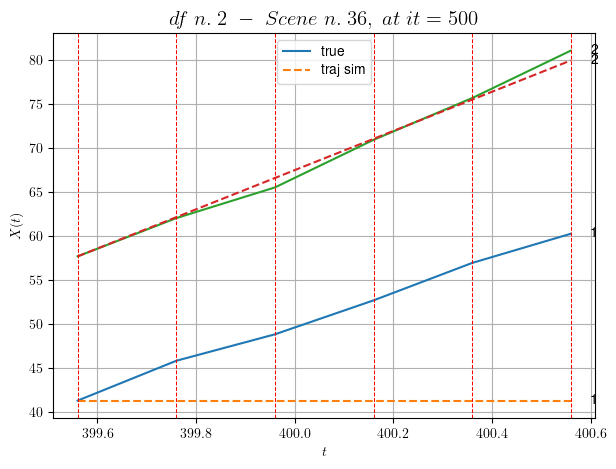

        For scene 36/69
        * use LR_NN=5e-05 with err=10.358732674101601 at it=24
        * v0_scn_mean = 22.594465424608504
        * MAE = 67.92526122105006



df n.2, scene n.37/69
    We have 4 time intervals inside [411.36,412.16]
    * err= 69.06055875301226
    * Learning rate NN = 3.2804993679746985e-05
    * diff = 2.4739293280617858e-08


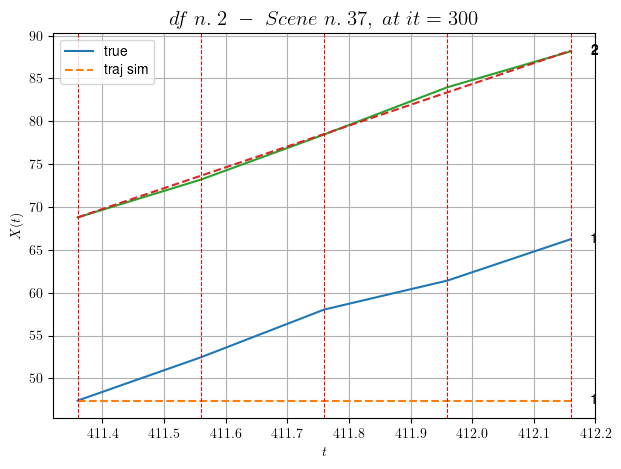

        For scene 37/69
        * use LR_NN=5e-05 with err=3.911965139806514 at it=24
        * v0_scn_mean = 24.715226891049255
        * MAE = 69.05796630602221



df n.2, scene n.38/69
    We have 3 time intervals inside [413.96,414.56]
            - Time interval n.0: [413.96, 414.16]
                * y_true: [18.75115567]
                * v_ann: [23.559574127197266, 23.615524542916376]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [414.16, 414.36]
                * y_true: [16.65115772]
                * v_ann: [25.373275756835938, 23.615524542916376]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [414.36, 414.56]
                * y_true: [38.95323614]
                * v_ann: [26.661340713500977, 23.615524542916376]

---------------------------------------------------------------------------------------

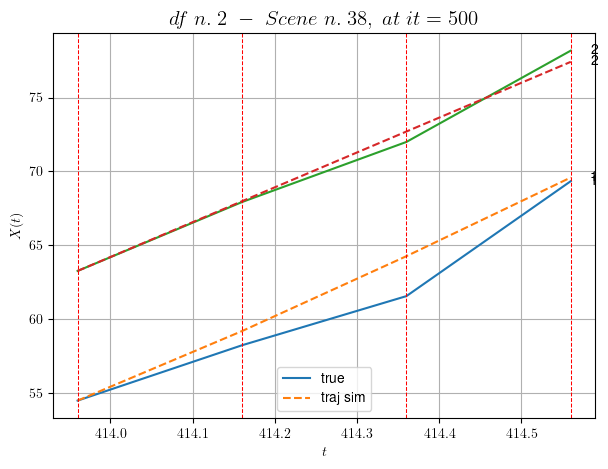

        For scene 38/69
        * use LR_NN=5e-05 with err=3.512850175227292 at it=24
        * v0_scn_mean = 23.870903561150953
        * MAE = 0.7400307501542995



df n.2, scene n.39/69
    We have 6 time intervals inside [428.56,429.76]
    * err= 113.08373934901877
    * Learning rate NN = 0.0002152335800928995
    * diff = 2.2256632803419052e-07


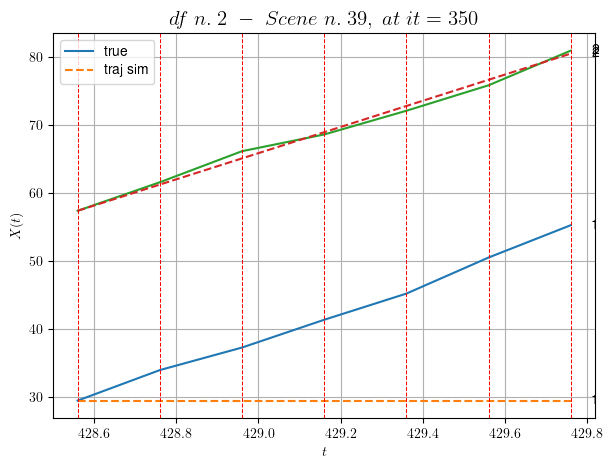

        For scene 39/69
        * use LR_NN=0.0005 with err=31.247190730802334 at it=24
        * v0_scn_mean = 19.890506897717678
        * MAE = 54.98683136153747



df n.2, scene n.40/69
    We have 6 time intervals inside [440.16,441.36]
    * err= 46.91956330127866
    * Learning rate NN = 4.304671165300533e-05
    * diff = 1.0105221548428744e-07


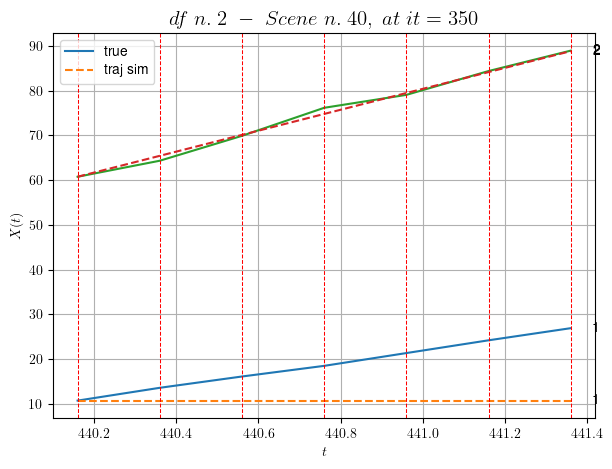

        For scene 40/69
        * use LR_NN=0.0001 with err=11.132205938468404 at it=24
        * v0_scn_mean = 23.759054431573883
        * MAE = 46.913404124667224



df n.2, scene n.41/69
    We have 7 time intervals inside [442.36,443.76]
            - Time interval n.0: [442.36, 442.56]
                * y_true: [12.43042647]
                * v_ann: [12.785223960876465, 21.85795817065082]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [442.56, 442.76]
                * y_true: [15.80061825]
                * v_ann: [12.714550018310547, 21.85795817065082]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [442.76, 442.96]
                * y_true: [13.31057742]
                * v_ann: [13.454442024230957, 21.85795817065082]

---------------------------------------------------------------------------------------

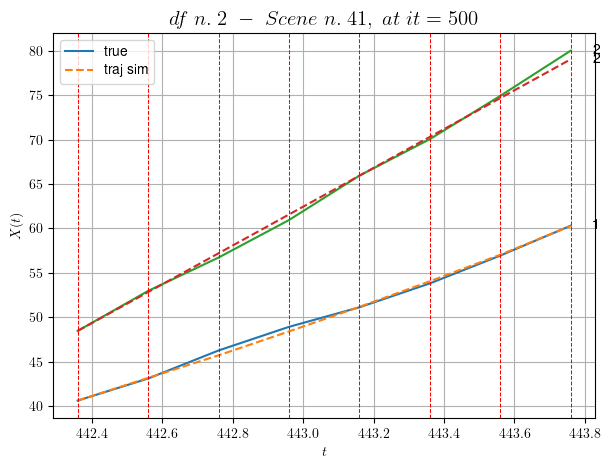

        For scene 41/69
        * use LR_NN=0.001 with err=23.074033996120292 at it=24
        * v0_scn_mean = 22.183639843763856
        * MAE = 0.1471780714138483



df n.2, scene n.42/69
    We have 5 time intervals inside [483.16,484.16]
            - Time interval n.0: [483.16, 483.36]
                * y_true: [13.10044424]
                * v_ann: [14.792110443115234, 18.47029090270065]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [483.36, 483.56]
                * y_true: [11.80044885]
                * v_ann: [15.206446647644043, 18.47029090270065]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [483.56, 483.76]
                * y_true: [23.3010318]
                * v_ann: [16.05048179626465, 18.47029090270065]

------------------------------------------------------------------------------------------

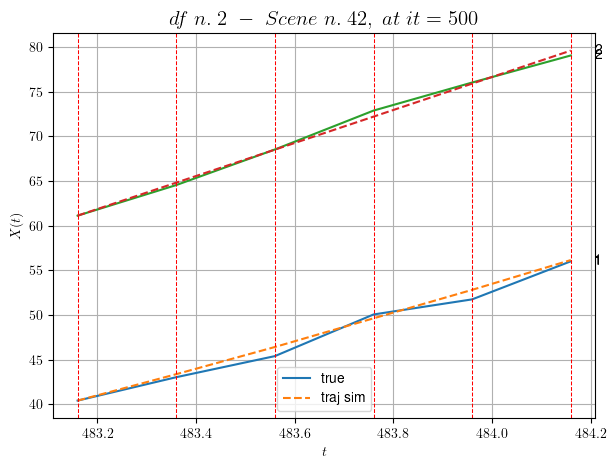

        For scene 42/69
        * use LR_NN=1e-05 with err=24.772233379819657 at it=24
        * v0_scn_mean = 18.931479266504894
        * MAE = 0.2776795242667453



df n.2, scene n.43/69
    We have 3 time intervals inside [494.76,495.36]
            - Time interval n.0: [494.76, 494.96]
                * y_true: [39.5021068]
                * v_ann: [28.637691497802734, 30.442979864263386]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [494.96, 495.16]
                * y_true: [16.60108256]
                * v_ann: [26.673885345458984, 30.442979864263386]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [495.16, 495.36]
                * y_true: [28.7021737]
                * v_ann: [30.352399826049805, 30.442979864263386]

---------------------------------------------------------------------------------------

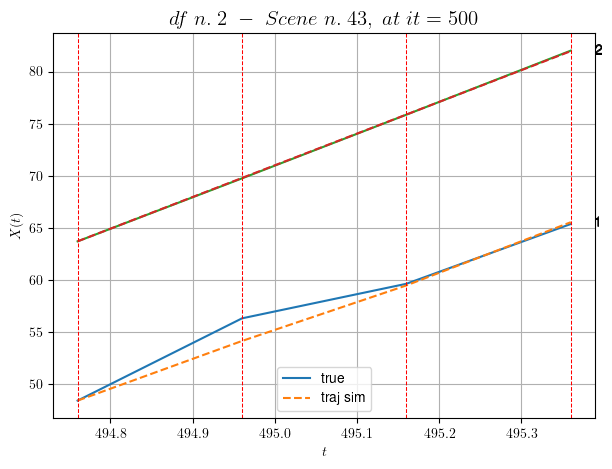

        For scene 43/69
        * use LR_NN=0.0001 with err=0.6449795013938883 at it=24
        * v0_scn_mean = 30.42526066969661
        * MAE = 0.5915013916841374



df n.2, scene n.44/69
    We have 7 time intervals inside [513.16,514.56]
            - Time interval n.0: [513.16, 513.36]
                * y_true: [21.8303416]
                * v_ann: [21.23293113708496, 22.16942692857361]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [513.36, 513.56]
                * y_true: [22.29045729]
                * v_ann: [20.898334503173828, 22.16942692857361]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [513.56, 513.76]
                * y_true: [18.24046898]
                * v_ann: [20.900440216064453, 22.16942692857361]

------------------------------------------------------------------------------------------

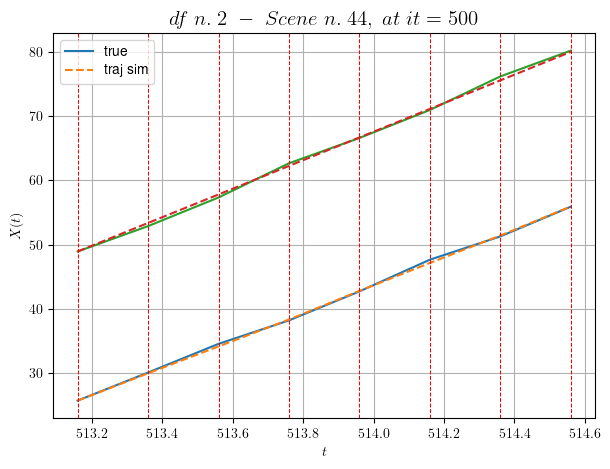

        For scene 44/69
        * use LR_NN=1e-05 with err=20.842901405114308 at it=24
        * v0_scn_mean = 22.482649851371523
        * MAE = 0.09176818715896995



df n.2, scene n.45/69
    We have 2 time intervals inside [530.96,531.36]
            - Time interval n.0: [530.96, 531.16]
                * y_true: [27.47191731]
                * v_ann: [25.95655632019043, 18.78540832306807]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.16, 531.36]
                * y_true: [21.08169407]
                * v_ann: [22.83150863647461, 18.78540832306807]

----------------------------------------------------------------------------------------------------
    * err= 0.09335434382777025
    * Learning rate NN = 7.289998757187277e-05
    * diff = 2.135693950773565e-05


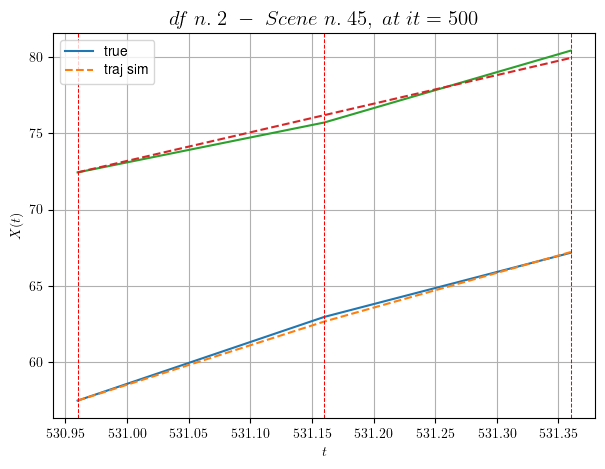

        For scene 45/69
        * use LR_NN=0.0001 with err=3.919832808729077 at it=24
        * v0_scn_mean = 19.233991990060385
        * MAE = 0.08647084574734033



df n.2, scene n.46/69
    We have 4 time intervals inside [534.96,535.76]
            - Time interval n.0: [534.96, 535.16]
                * y_true: [18.70035331]
                * v_ann: [19.866872787475586, 22.621725364453187]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [535.16, 535.36]
                * y_true: [23.55057295]
                * v_ann: [20.4247989654541, 22.621725364453187]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [535.36, 535.56]
                * y_true: [20.55063096]
                * v_ann: [20.206218719482422, 22.621725364453187]

--------------------------------------------------------------------------------------

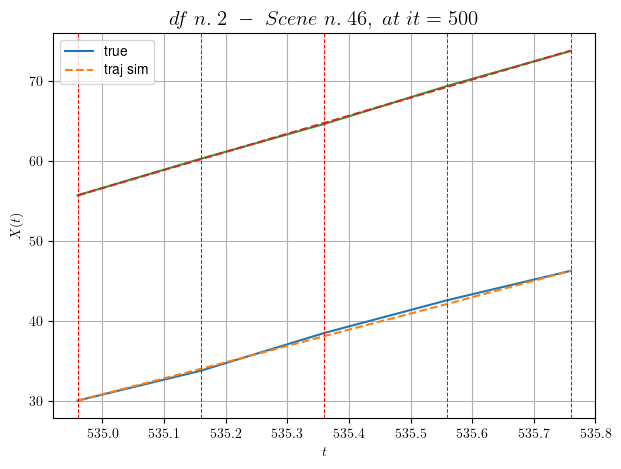

        For scene 46/69
        * use LR_NN=1e-05 with err=6.575620938075216 at it=24
        * v0_scn_mean = 22.916856349819238
        * MAE = 0.04553206846561866



df n.2, scene n.47/69
    We have 2 time intervals inside [547.76,548.16]
            - Time interval n.0: [547.76, 547.96]
                * y_true: [25.25158957]
                * v_ann: [22.69120216369629, 17.73529721015659]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [547.96, 548.16]
                * y_true: [17.50127175]
                * v_ann: [20.386497497558594, 17.73529721015659]

----------------------------------------------------------------------------------------------------
    * err= 0.23029311064446584
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 1.2745267651936842e-05


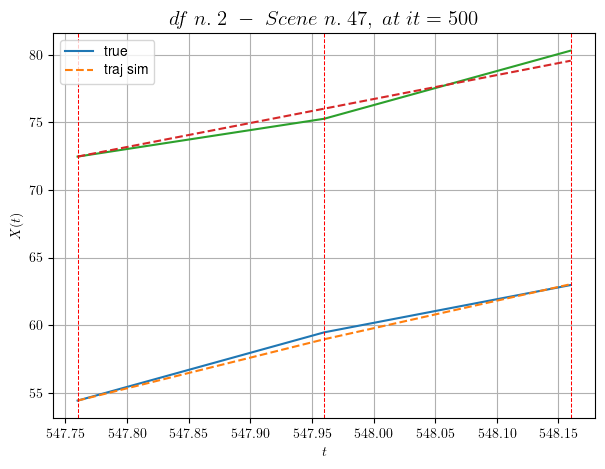

        For scene 47/69
        * use LR_NN=5e-05 with err=4.634125055102769 at it=24
        * v0_scn_mean = 18.2258853216565
        * MAE = 0.2128952229612147



df n.2, scene n.48/69
    We have 6 time intervals inside [557.96,559.16]
            - Time interval n.0: [557.96, 558.16]
                * y_true: [21.95035828]
                * v_ann: [24.089340209960938, 18.265989604983496]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [558.16, 558.36]
                * y_true: [31.40071757]
                * v_ann: [23.084388732910156, 18.265989604983496]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [558.36, 558.56]
                * y_true: [24.95077032]
                * v_ann: [21.34878158569336, 18.265989604983496]

-----------------------------------------------------------------------------------------

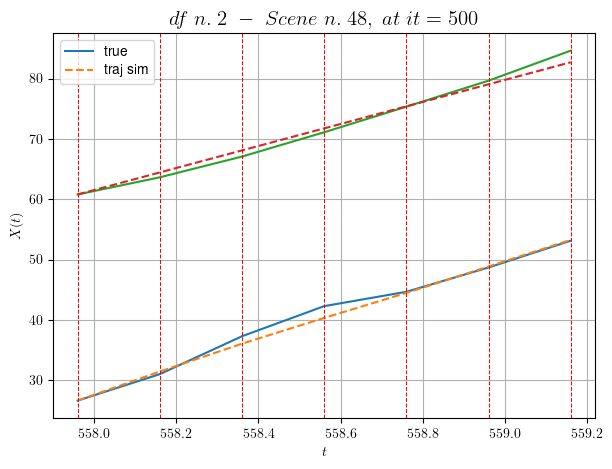

        For scene 48/69
        * use LR_NN=1e-05 with err=33.470354185186416 at it=24
        * v0_scn_mean = 18.735350020695005
        * MAE = 0.7792228904501514



df n.2, scene n.49/69
    We have 2 time intervals inside [576.56,576.96]
    * err= 0.05837310670826224
    * Learning rate NN = 4.049999552080408e-05
    * diff = 2.8202759817103074e-07


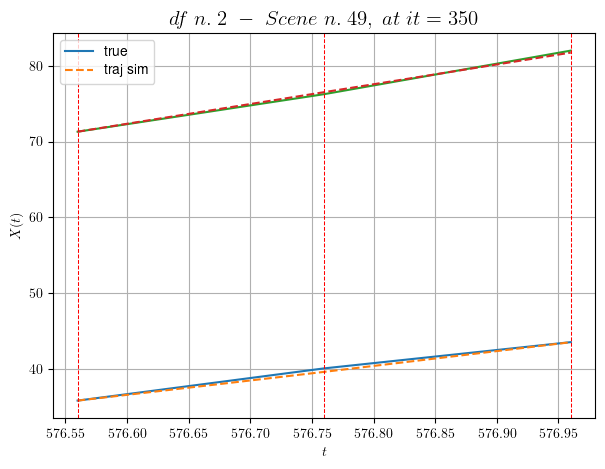

        For scene 49/69
        * use LR_NN=5e-05 with err=0.5186704404184633 at it=24
        * v0_scn_mean = 26.29416514321375
        * MAE = 0.05712249904249625



df n.2, scene n.50/69
    We have 2 time intervals inside [588.96,589.36]
    * err= 0.07442085830354042
    * Learning rate NN = 4.049999552080408e-05
    * diff = 5.567138633422175e-08


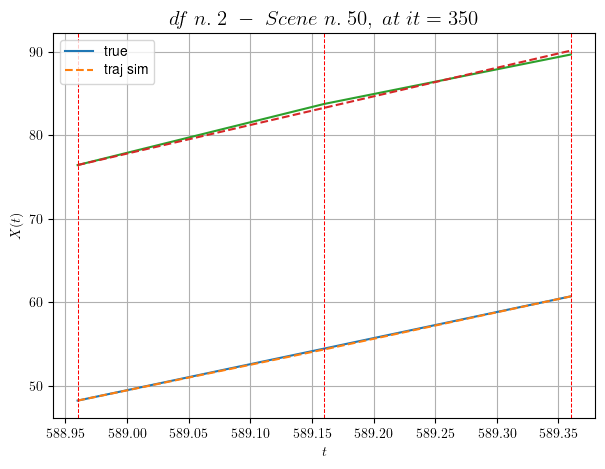

        For scene 50/69
        * use LR_NN=5e-05 with err=0.5381722604929703 at it=24
        * v0_scn_mean = 33.979903425908354
        * MAE = 0.06723089705481444



df n.2, scene n.51/69
    We have 4 time intervals inside [86.16,86.96]
            - Time interval n.0: [86.16, 86.36]
                * y_true: [16.74023073 23.1409288 ]
                * v_ann: [18.610031127929688, 18.60977554321289, 16.235330060145852]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.36, 86.56]
                * y_true: [19.40034801 15.51071286]
                * v_ann: [19.775344848632812, 17.89443016052246, 16.235330060145852]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [86.56, 86.76]
                * y_true: [19.59044325 21.61118084]
                * v_ann: [19.045249938964844, 17.324682235717773, 16.235330060145852]

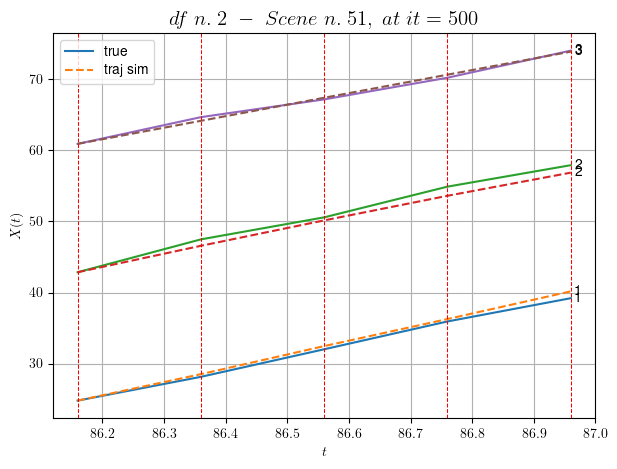

        For scene 51/69
        * use LR_NN=5e-05 with err=15.820144015711897 at it=24
        * v0_scn_mean = 17.061209638533224
        * MAE = 0.3777241018732058



df n.2, scene n.52/69
    We have 4 time intervals inside [109.36,110.16]
            - Time interval n.0: [109.36, 109.56]
                * y_true: [28.77160952 15.03115545]
                * v_ann: [22.816722869873047, 22.961380004882812, 20.03385870433143]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.56, 109.76]
                * y_true: [23.64157457 15.83133823]
                * v_ann: [22.314456939697266, 22.762271881103516, 20.03385870433143]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.76, 109.96]
                * y_true: [24.63196009 20.68195399]
                * v_ann: [21.354351043701172, 21.971651077270508, 20.033858704

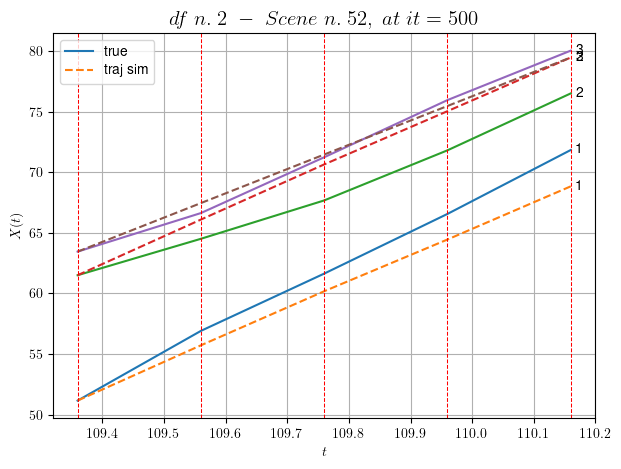

        For scene 52/69
        * use LR_NN=0.001 with err=9.788836340645938 at it=24
        * v0_scn_mean = 20.63182673461345
        * MAE = 3.2557105473346706



df n.2, scene n.53/69
    We have 4 time intervals inside [170.36,171.16]
            - Time interval n.0: [170.36, 170.56]
                * y_true: [25.3307413  19.52081588]
                * v_ann: [23.294742584228516, 25.551044464111328, 16.15160939147781]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [29.74113537 17.1608437 ]
                * v_ann: [23.23914337158203, 24.21954917907715, 16.15160939147781]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [170.76, 170.96]
                * y_true: [24.43113316 23.6413756 ]
                * v_ann: [25.051820755004883, 23.532459259033203, 16.1516093914778

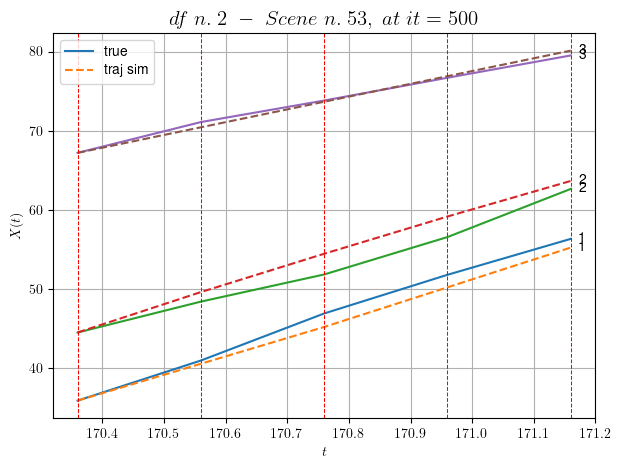

        For scene 53/69
        * use LR_NN=0.0005 with err=33.168463880042964 at it=24
        * v0_scn_mean = 16.982512206226403
        * MAE = 1.5796924536424959



df n.2, scene n.54/69
    We have 4 time intervals inside [179.36,180.16]
            - Time interval n.0: [179.36, 179.56]
                * y_true: [10.36002857 23.43048282]
                * v_ann: [16.90796661376953, 18.07924461364746, 22.081999529878967]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [179.56, 179.76]
                * y_true: [10.37004005 22.87060641]
                * v_ann: [16.60692596435547, 17.794687271118164, 22.081999529878967]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [179.76, 179.96]
                * y_true: [15.39008451 20.81068862]
                * v_ann: [16.704071044921875, 17.862300872802734, 22.081999529

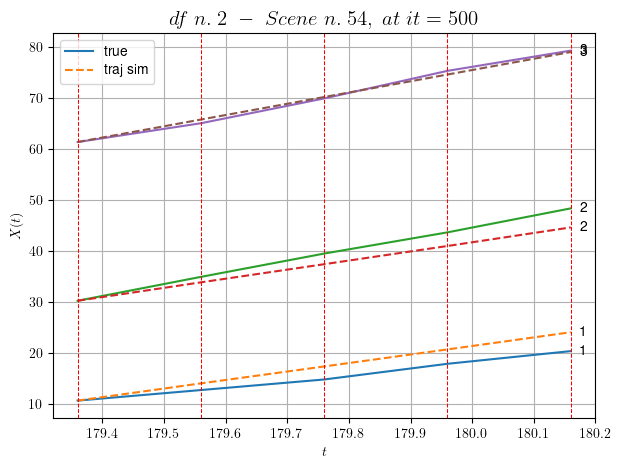

        For scene 54/69
        * use LR_NN=1e-05 with err=5.946508064453347 at it=24
        * v0_scn_mean = 22.55707920258516
        * MAE = 2.683909552749885



df n.2, scene n.55/69
    We have 2 time intervals inside [199.76,200.16]
            - Time interval n.0: [199.76, 199.96]
                * y_true: [18.79121443 18.55195156]
                * v_ann: [19.520835876464844, 19.19161033630371, 14.651669964039732]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [199.96, 200.16]
                * y_true: [20.30155709 19.85230976]
                * v_ann: [19.196521759033203, 19.493701934814453, 14.651669964039732]

----------------------------------------------------------------------------------------------------
    * err= 0.006251347601880769
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.00020118888844446875


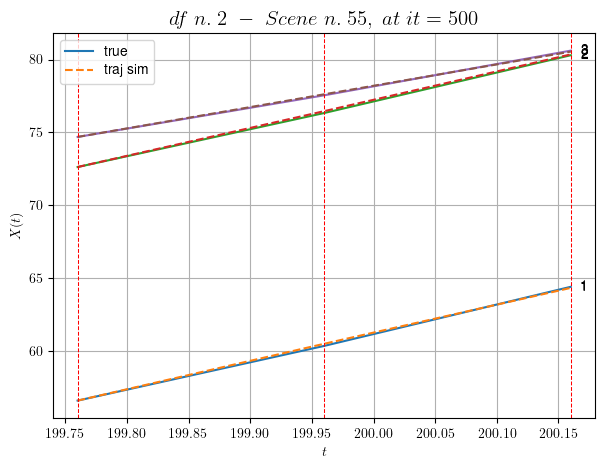

        For scene 55/69
        * use LR_NN=0.0005 with err=9.346186898624998 at it=24
        * v0_scn_mean = 15.572569077090654
        * MAE = 0.006251347601880769



df n.2, scene n.56/69
    We have 4 time intervals inside [212.56,213.36]
            - Time interval n.0: [212.56, 212.76]
                * y_true: [14.43013055 12.85042103]
                * v_ann: [16.090133666992188, 17.014965057373047, 20.507135320916646]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [212.76, 212.96]
                * y_true: [10.79011916 33.80137312]
                * v_ann: [15.84564208984375, 17.486934661865234, 20.507135320916646]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [212.96, 213.16]
                * y_true: [16.24022861 13.70067627]
                * v_ann: [16.534408569335938, 17.115894317626953, 20.507135

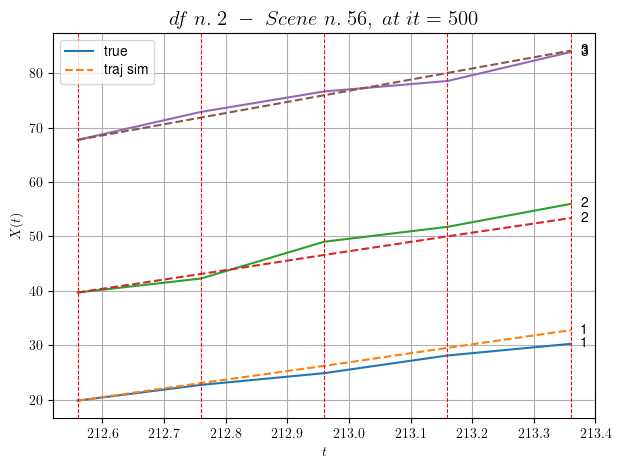

        For scene 56/69
        * use LR_NN=5e-05 with err=8.762201801551587 at it=24
        * v0_scn_mean = 21.076706775452287
        * MAE = 1.405203855006867



df n.2, scene n.57/69
    We have 3 time intervals inside [318.16,318.76]
            - Time interval n.0: [318.16, 318.36]
                * y_true: [13.01007537 20.36054455]
                * v_ann: [16.996164321899414, 16.993267059326172, 20.3551976291637]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [318.36, 318.56]
                * y_true: [14.27010639 20.89068863]
                * v_ann: [16.787506103515625, 16.93073081970215, 20.3551976291637]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.56, 318.76]
                * y_true: [12.16011799 21.20084683]
                * v_ann: [16.988693237304688, 17.160478591918945, 20.3551976291637]

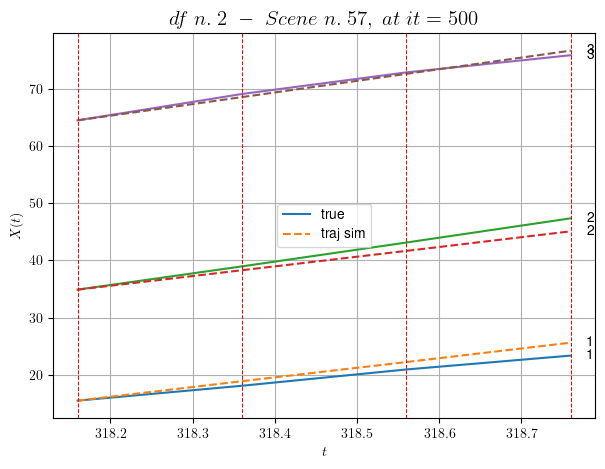

        For scene 57/69
        * use LR_NN=0.0001 with err=4.9611211839466565 at it=24
        * v0_scn_mean = 20.933885338383313
        * MAE = 1.3206212668586377



df n.2, scene n.58/69
    We have 4 time intervals inside [430.16,430.96]
            - Time interval n.0: [430.16, 430.36]
                * y_true: [15.83005748 20.27065425]
                * v_ann: [18.892059326171875, 18.860200881958008, 21.23690274072129]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [430.36, 430.56]
                * y_true: [19.99011659 24.33092793]
                * v_ann: [18.89873504638672, 18.884553909301758, 21.23690274072129]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [430.56, 430.76]
                * y_true: [14.67011767 20.05093433]
                * v_ann: [19.094188690185547, 18.955814361572266, 21.236902740

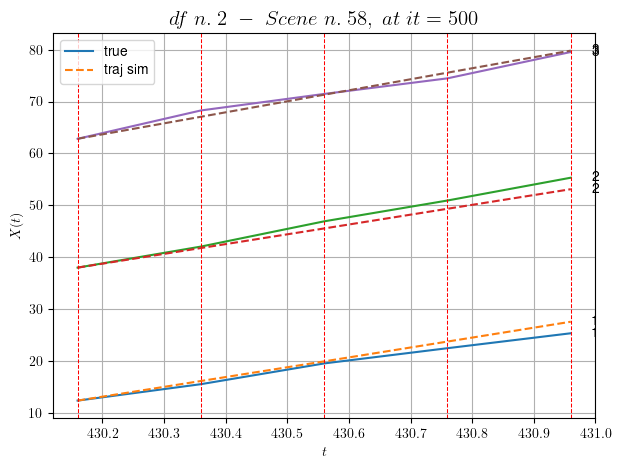

        For scene 58/69
        * use LR_NN=1e-05 with err=8.668226879778267 at it=24
        * v0_scn_mean = 21.7626881828341
        * MAE = 1.2828818709616236



df n.2, scene n.59/69
    We have 2 time intervals inside [435.96,436.36]
            - Time interval n.0: [435.96, 436.16]
                * y_true: [15.85107698 23.95169404]
                * v_ann: [19.832088470458984, 22.747760772705078, 21.458715492508595]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [436.16, 436.36]
                * y_true: [18.0813972  25.19206379]
                * v_ann: [21.797800064086914, 18.271503448486328, 21.458715492508595]

----------------------------------------------------------------------------------------------------
    * err= 0.6367460376443517
    * Learning rate NN = 0.0036449995823204517
    * diff = 0.0008862041543346022


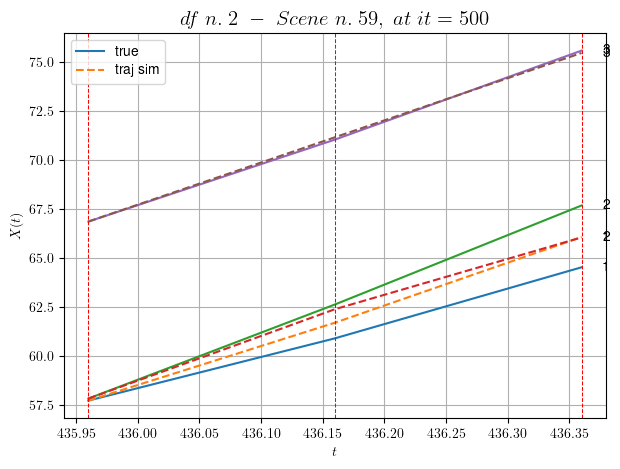

        For scene 59/69
        * use LR_NN=0.005 with err=2.3808821696985567 at it=24
        * v0_scn_mean = 21.971192179473
        * MAE = 0.6367460376443517



df n.2, scene n.60/69
    We have 5 time intervals inside [442.76,443.76]
            - Time interval n.0: [442.76, 442.96]
                * y_true: [18.06141662 13.31057742]
                * v_ann: [21.349184036254883, 15.867801666259766, 22.775896802505507]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [442.96, 443.16]
                * y_true: [20.34015276 11.01053508]
                * v_ann: [20.97423553466797, 15.821557998657227, 22.775896802505507]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [443.16, 443.36]
                * y_true: [26.42894929 13.47072378]
                * v_ann: [20.312679290771484, 16.18939781188965, 22.775896802505

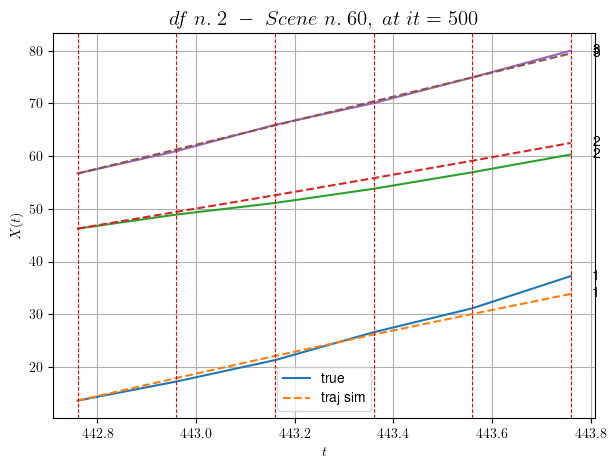

        For scene 60/69
        * use LR_NN=1e-05 with err=8.346241741056977 at it=24
        * v0_scn_mean = 23.20934267000819
        * MAE = 0.6523074825982449



df n.2, scene n.61/69
    We have 2 time intervals inside [487.56,487.96]
            - Time interval n.0: [487.56, 487.76]
                * y_true: [22.90018755 16.61065196]
                * v_ann: [21.283666610717773, 19.989479064941406, 21.11190024799189]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.76, 487.96]
                * y_true: [21.00025249 21.71102285]
                * v_ann: [20.737110137939453, 20.079029083251953, 21.11190024799189]

----------------------------------------------------------------------------------------------------
    * err= 0.10463704026625519
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0006802583854787908


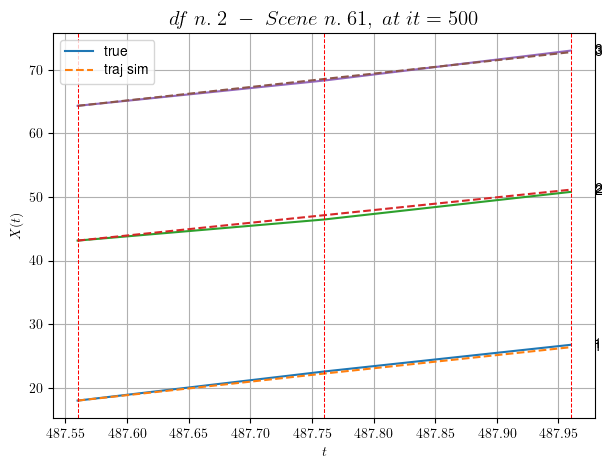

        For scene 61/69
        * use LR_NN=5e-05 with err=1.69744487257129 at it=24
        * v0_scn_mean = 21.645185834056093
        * MAE = 0.09758884059622225



df n.2, scene n.62/69
    We have 5 time intervals inside [531.76,532.76]
            - Time interval n.0: [531.76, 531.96]
                * y_true: [23.26110286 19.80102444]
                * v_ann: [21.64165496826172, 22.460308074951172, 17.911731328079796]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.96, 532.16]
                * y_true: [19.37730225 14.13461647]
                * v_ann: [21.352882385253906, 19.94194221496582, 17.911731328079796]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.16, 532.36]
                * y_true: [16.15104075 20.18132342]
                * v_ann: [18.913330078125, 20.958576202392578, 17.9117313280797

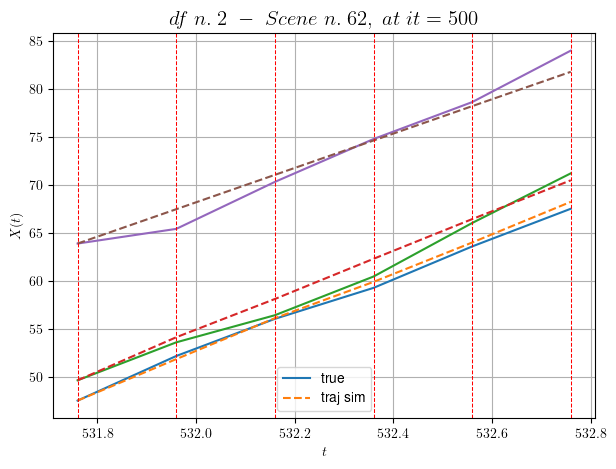

        For scene 62/69
        * use LR_NN=0.001 with err=19.3503348337165 at it=24
        * v0_scn_mean = 18.637026905658132
        * MAE = 1.0129066764841834



df n.2, scene n.63/69
    We have 4 time intervals inside [538.36,539.16]
            - Time interval n.0: [538.36, 538.56]
                * y_true: [17.69068154 17.20117669]
                * v_ann: [21.64926528930664, 19.84946060180664, 21.51886934452355]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [538.56, 538.76]
                * y_true: [18.89091077 18.60142936]
                * v_ann: [19.89811134338379, 19.411235809326172, 21.51886934452355]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [538.76, 538.96]
                * y_true: [19.15102468 24.05210496]
                * v_ann: [19.449310302734375, 19.903026580810547, 21.51886934452355

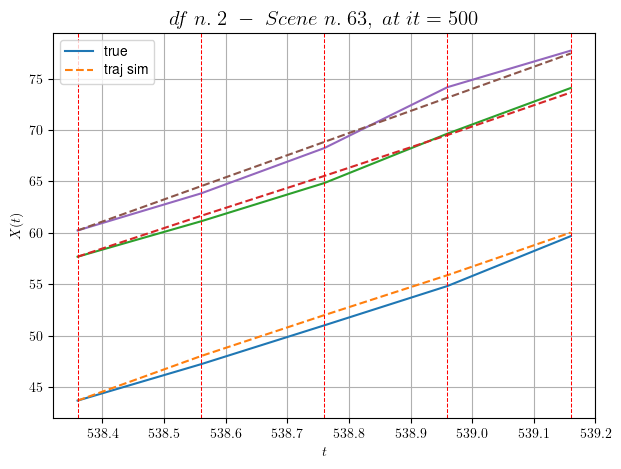

        For scene 63/69
        * use LR_NN=0.001 with err=14.342670798696949 at it=24
        * v0_scn_mean = 22.02773680306831
        * MAE = 0.3864048084237339



df n.2, scene n.64/69
    We have 6 time intervals inside [541.16,542.36]
            - Time interval n.0: [541.16, 541.36]
                * y_true: [22.67086863 28.23390149]
                * v_ann: [25.349658966064453, 25.774295806884766, 20.489990975466682]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [541.36, 541.56]
                * y_true: [19.45088023 23.11862329]
                * v_ann: [24.493385314941406, 24.60426139831543, 20.489990975466682]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [541.56, 541.76]
                * y_true: [24.96136667 24.68114114]
                * v_ann: [22.856719970703125, 22.36724281311035, 20.4899909754

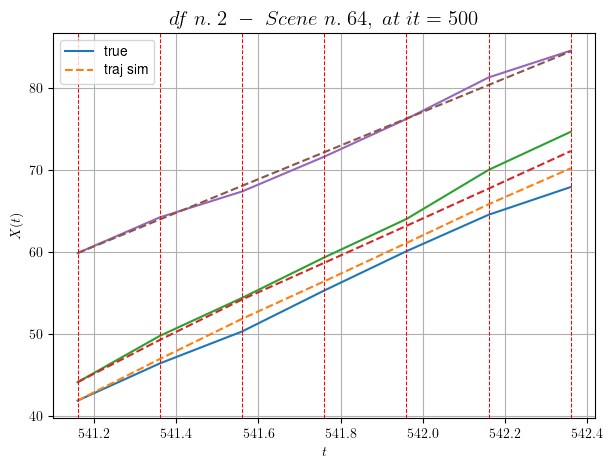

        For scene 64/69
        * use LR_NN=0.001 with err=25.312887513838643 at it=24
        * v0_scn_mean = 21.060591089960607
        * MAE = 1.214390641119141



df n.2, scene n.65/69
    We have 2 time intervals inside [549.76,550.16]
            - Time interval n.0: [549.76, 549.96]
                * y_true: [23.30098965 17.25125335]
                * v_ann: [23.130455017089844, 20.37880516052246, 22.495719525410536]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [549.96, 550.16]
                * y_true: [23.30098965 23.35192881]
                * v_ann: [22.344783782958984, 20.84676742553711, 22.495719525410536]

----------------------------------------------------------------------------------------------------
    * err= 0.05169717164367397
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0009856611970663343


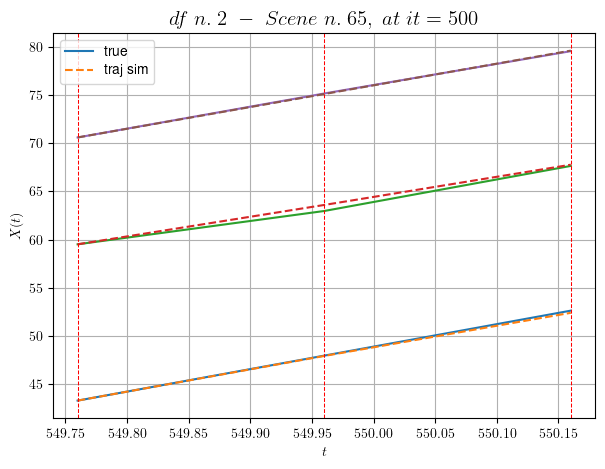

        For scene 65/69
        * use LR_NN=5e-05 with err=1.389561875570026 at it=24
        * v0_scn_mean = 22.945976016958646
        * MAE = 0.04159932306740781



df n.2, scene n.66/69
    We have 2 time intervals inside [566.76,567.16]
            - Time interval n.0: [566.76, 566.96]
                * y_true: [31.35080123 25.9264585 ]
                * v_ann: [27.815237045288086, 25.812734603881836, 24.22252039115205]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [566.96, 567.16]
                * y_true: [23.95081051 25.9264585 ]
                * v_ann: [27.41719627380371, 25.99329948425293, 24.22252039115205]

----------------------------------------------------------------------------------------------------
    * err= 0.058532696995442134
    * Learning rate NN = 7.289998757187277e-05
    * diff = 2.6981757730998313e-06


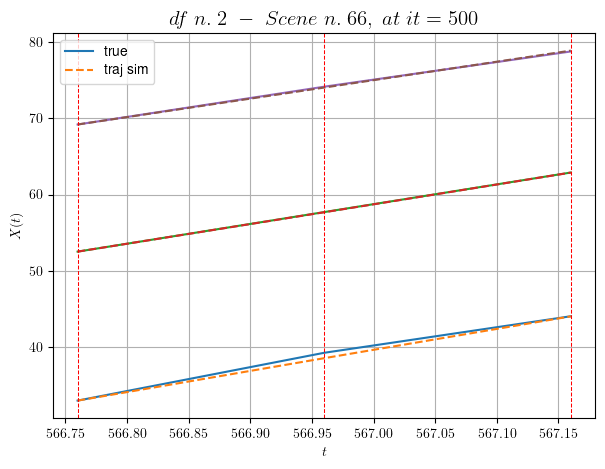

        For scene 66/69
        * use LR_NN=0.0001 with err=0.831513724505572 at it=24
        * v0_scn_mean = 24.56916890828633
        * MAE = 0.0579147295605821



df n.2, scene n.67/69
    We have 3 time intervals inside [87.56,88.16]
            - Time interval n.0: [87.56, 87.76]
                * y_true: [20.56019483 17.07029985 18.3510221 ]
                * v_ann: [19.12401580810547, 20.565597534179688, 19.175302505493164, 23.399103331764643]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [87.76, 87.96]
                * y_true: [21.72029145 17.49039467 19.46124504]
                * v_ann: [19.173463821411133, 19.391735076904297, 18.502899169921875, 23.399103331764643]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [87.96, 88.16]
                * y_true: [24.51045762 21.12058621 15.36109554]
          

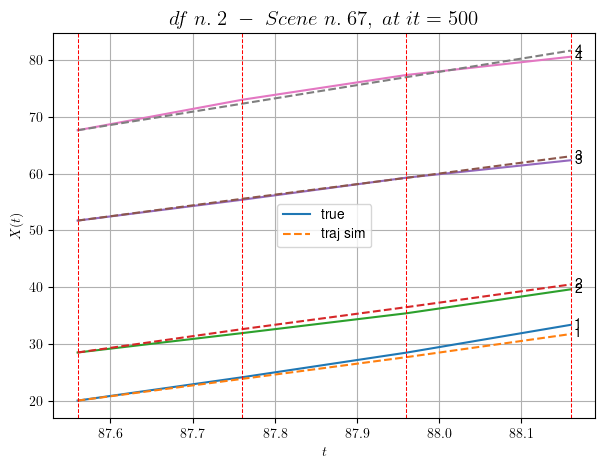

        For scene 67/69
        * use LR_NN=0.0005 with err=9.267137119280012 at it=24
        * v0_scn_mean = 23.92715358503308
        * MAE = 0.5038270774005075



df n.2, scene n.68/69
    We have 2 time intervals inside [305.96,306.36]
            - Time interval n.0: [305.96, 306.16]
                * y_true: [18.64270885 18.88070057 19.63111636]
                * v_ann: [20.411148071289062, 19.946115493774414, 20.67805290222168, 13.681341801173966]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [306.16, 306.36]
                * y_true: [22.41204338 21.34093202 20.7913521 ]
                * v_ann: [20.306615829467773, 19.835865020751953, 20.251598358154297, 13.681341801173966]

----------------------------------------------------------------------------------------------------
    * err= 0.028408184781051844
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.00012152248927835285


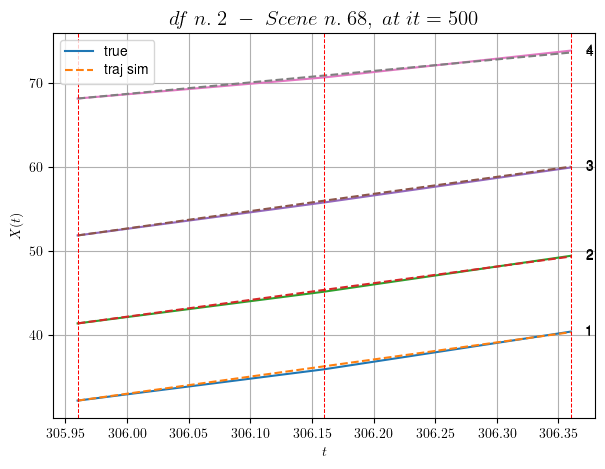

        For scene 68/69
        * use LR_NN=5e-05 with err=5.431451582717302 at it=24
        * v0_scn_mean = 14.98678135400893
        * MAE = 0.028408184781051844



For df=2 with 69 scenes, time taken:        1199.03
****************************************************************************************************
****************************************************************************************************
In df n.3/10 we have 90 scenes
df n.3, scene n.0/90
    We have 7 time intervals inside [9.36,10.76]
            - Time interval n.0: [9.36, 9.56]
                * y_true: [21.20002029]
                * v_ann: [25.042991638183594, 32.52950262782097]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [9.56, 9.76]
                * y_true: [27.90008682]
                * v_ann: [25.9854736328125, 32.52950262782097]

--------------------------------------------------------------------------

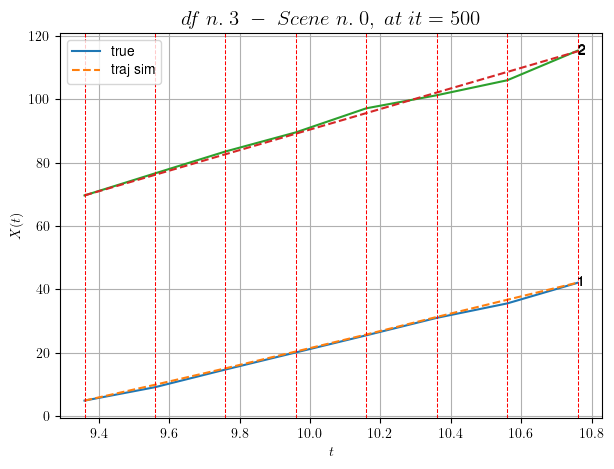

        For scene 0/90
        * use LR_NN=1e-05 with err=2.5953665204404555 at it=24
        * v0_scn_mean = 32.42832252272748
        * MAE = 0.8195549540255662



df n.3, scene n.1/90
    We have 6 time intervals inside [12.76,13.96]
            - Time interval n.0: [12.76, 12.96]
                * y_true: [25.56253837]
                * v_ann: [32.30028533935547, 33.329707464158204]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [12.96, 13.16]
                * y_true: [28.79893317]
                * v_ann: [29.686521530151367, 33.329707464158204]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [13.16, 13.36]
                * y_true: [29.813898]
                * v_ann: [30.39579963684082, 33.329707464158204]

----------------------------------------------------------------------------------------------------

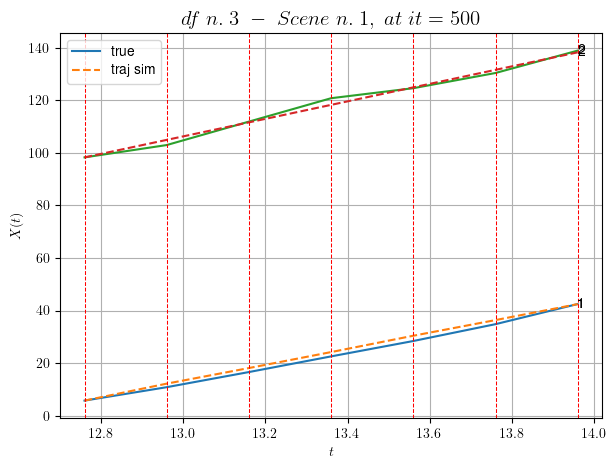

        For scene 1/90
        * use LR_NN=0.0001 with err=4.944112008145575 at it=24
        * v0_scn_mean = 33.19651916561727
        * MAE = 1.825153891948371



df n.3, scene n.2/90
    We have 2 time intervals inside [40.76,41.16]
    * err= 0.9104689523221441
    * Learning rate NN = 8.099998922261875e-06
    * diff = 1.883734067620324e-07


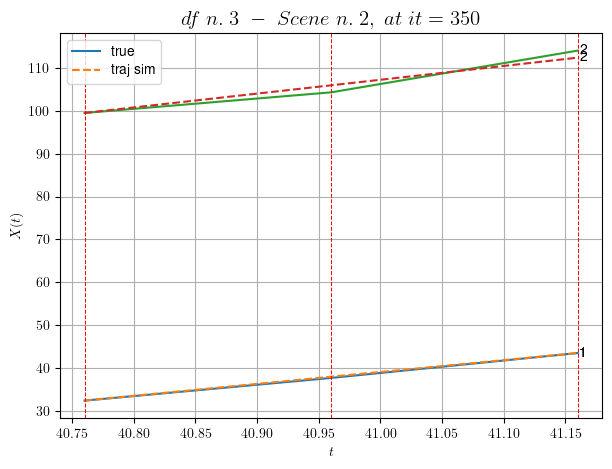

        For scene 2/90
        * use LR_NN=1e-05 with err=1.3157863660693594 at it=24
        * v0_scn_mean = 32.08077588692802
        * MAE = 0.9104689523221441



df n.3, scene n.3/90
    We have 4 time intervals inside [79.56,80.36]
            - Time interval n.0: [79.56, 79.76]
                * y_true: [24.92680088]
                * v_ann: [21.59852409362793, 49.42636153730836]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [79.76, 79.96]
                * y_true: [25.18697287]
                * v_ann: [22.694725036621094, 49.42636153730836]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [79.96, 80.16]
                * y_true: [23.15223081]
                * v_ann: [28.203319549560547, 49.42636153730836]

----------------------------------------------------------------------------------------------------

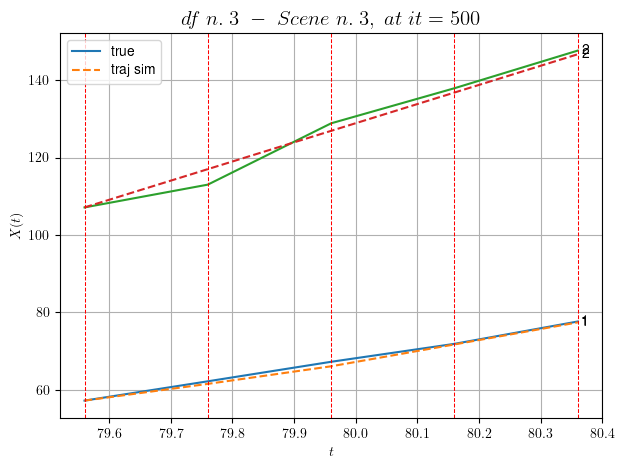

        For scene 3/90
        * use LR_NN=0.0001 with err=53.05621183573545 at it=24
        * v0_scn_mean = 48.64930707596426
        * MAE = 2.3735557138299557



df n.3, scene n.4/90
    We have 5 time intervals inside [115.36,116.36]
            - Time interval n.0: [115.36, 115.56]
                * y_true: [36.92160322]
                * v_ann: [28.364704132080078, 42.47633471767095]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [115.56, 115.76]
                * y_true: [35.25200551]
                * v_ann: [27.093740463256836, 42.47633471767095]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [115.76, 115.96]
                * y_true: [28.14198214]
                * v_ann: [28.925600051879883, 42.47633471767095]

-------------------------------------------------------------------------------------------

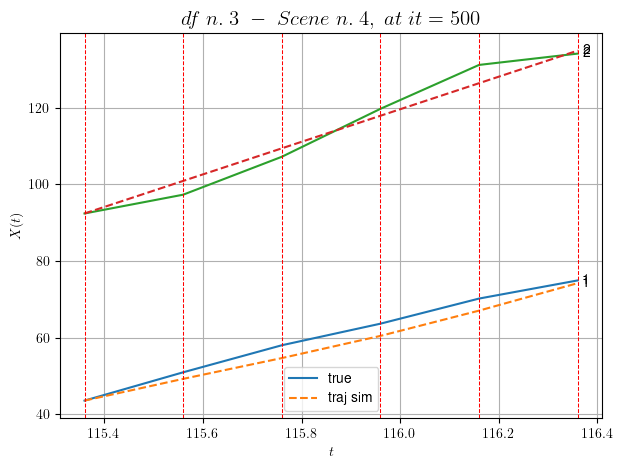

        For scene 4/90
        * use LR_NN=1e-05 with err=40.62764139076957 at it=24
        * v0_scn_mean = 41.977281329059345
        * MAE = 6.575509881407494



df n.3, scene n.5/90
    We have 17 time intervals inside [138.16,141.56]
            - Time interval n.0: [138.16, 138.36]
                * y_true: [20.20049512]
                * v_ann: [24.752901077270508, 28.318639127967636]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [138.36, 138.56]
                * y_true: [34.05418098]
                * v_ann: [27.04896354675293, 28.318639127967636]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [138.56, 138.76]
                * y_true: [19.55085484]
                * v_ann: [23.734941482543945, 28.318639127967636]

-----------------------------------------------------------------------------------------

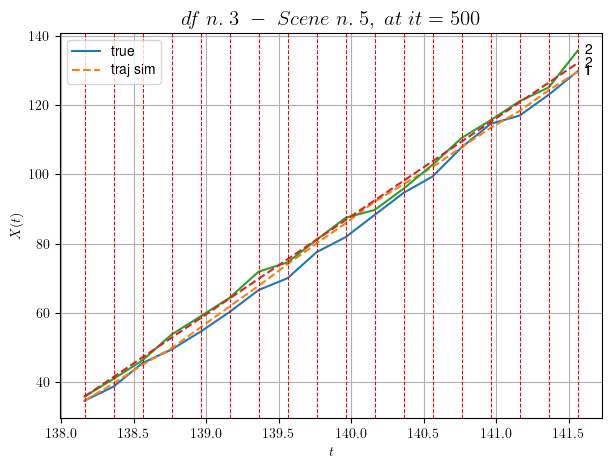

        For scene 5/90
        * use LR_NN=0.001 with err=8.81150419927862 at it=24
        * v0_scn_mean = 28.385893562836173
        * MAE = 3.1903891932543935



df n.3, scene n.6/90
    We have 4 time intervals inside [154.56,155.36]
            - Time interval n.0: [154.56, 154.76]
                * y_true: [16.792902]
                * v_ann: [17.445690155029297, 33.88242010375711]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [154.76, 154.96]
                * y_true: [6.96129808]
                * v_ann: [18.607702255249023, 33.88242010375711]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [154.96, 155.16]
                * y_true: [24.54499404]
                * v_ann: [21.90488052368164, 33.88242010375711]

------------------------------------------------------------------------------------------------

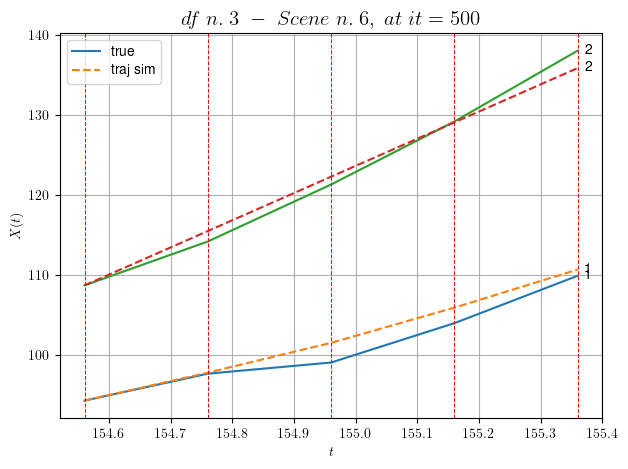

        For scene 6/90
        * use LR_NN=1e-05 with err=3.7560196072727354 at it=24
        * v0_scn_mean = 33.727123299638905
        * MAE = 1.779116253903995



df n.3, scene n.7/90
    We have 3 time intervals inside [183.16,183.76]
            - Time interval n.0: [183.16, 183.36]
                * y_true: [30.02270449]
                * v_ann: [30.066133499145508, 32.3139833104688]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [183.36, 183.56]
                * y_true: [26.94282364]
                * v_ann: [32.63166809082031, 32.3139833104688]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [183.56, 183.76]
                * y_true: [36.47456732]
                * v_ann: [30.42438507080078, 32.3139833104688]

------------------------------------------------------------------------------------------------

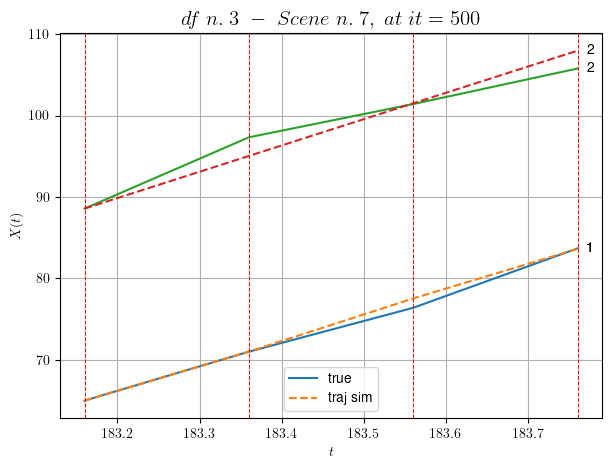

        For scene 7/90
        * use LR_NN=5e-05 with err=1.321601341005458 at it=24
        * v0_scn_mean = 32.22142397806805
        * MAE = 1.236237345043412



df n.3, scene n.8/90
    We have 8 time intervals inside [199.96,201.56]
            - Time interval n.0: [199.96, 200.16]
                * y_true: [39.74420354]
                * v_ann: [38.04240798950195, 35.482633927758336]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [200.16, 200.36]
                * y_true: [28.52349607]
                * v_ann: [37.860477447509766, 35.482633927758336]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [200.36, 200.56]
                * y_true: [36.06528968]
                * v_ann: [36.017940521240234, 35.482633927758336]

-------------------------------------------------------------------------------------------

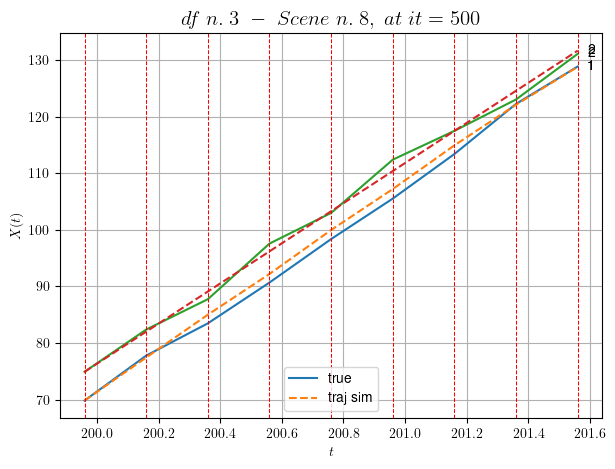

        For scene 8/90
        * use LR_NN=0.001 with err=15.79443736706288 at it=24
        * v0_scn_mean = 35.263328570689865
        * MAE = 1.2709322700395012



df n.3, scene n.9/90
    We have 4 time intervals inside [215.56,216.36]
            - Time interval n.0: [215.56, 215.76]
                * y_true: [37.72349345]
                * v_ann: [36.31804275512695, 30.842897264970183]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.76, 215.96]
                * y_true: [31.43339605]
                * v_ann: [33.44094467163086, 30.842897264970183]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.96, 216.16]
                * y_true: [31.16401611]
                * v_ann: [34.76671600341797, 30.842897264970183]

-------------------------------------------------------------------------------------------

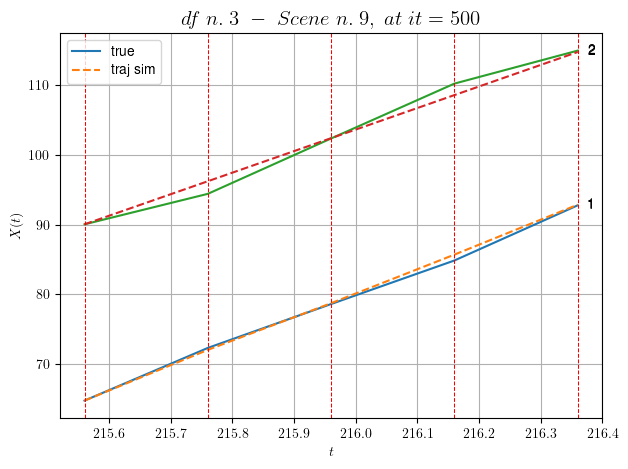

        For scene 9/90
        * use LR_NN=5e-05 with err=0.87573776723247 at it=24
        * v0_scn_mean = 30.809181374377616
        * MAE = 0.6808292186947413



df n.3, scene n.10/90
    We have 9 time intervals inside [234.76,236.56]
            - Time interval n.0: [234.76, 234.96]
                * y_true: [32.05217047]
                * v_ann: [27.083600997924805, 40.3721069069577]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [234.96, 235.16]
                * y_true: [29.65244542]
                * v_ann: [27.033235549926758, 40.3721069069577]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [235.16, 235.36]
                * y_true: [16.45155324]
                * v_ann: [27.035091400146484, 40.3721069069577]

----------------------------------------------------------------------------------------------

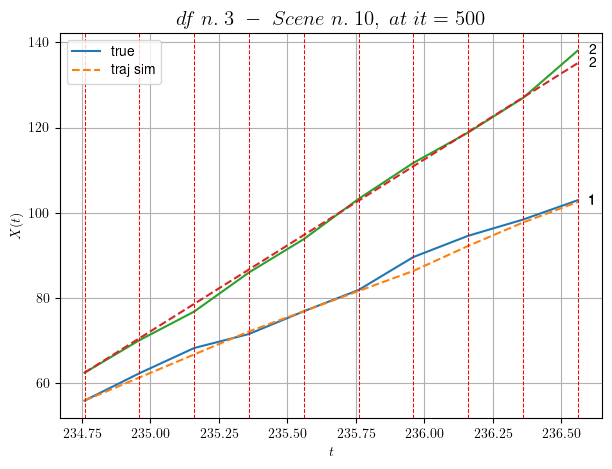

        For scene 10/90
        * use LR_NN=0.0005 with err=102.70782466251632 at it=24
        * v0_scn_mean = 39.95722263076001
        * MAE = 1.7429749919404944



df n.3, scene n.11/90
    We have 2 time intervals inside [237.36,237.76]
            - Time interval n.0: [237.36, 237.56]
                * y_true: [26.58288419]
                * v_ann: [28.295724868774414, 32.371778764505414]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.56, 237.76]
                * y_true: [29.70372271]
                * v_ann: [27.9857234954834, 32.371778764505414]

----------------------------------------------------------------------------------------------------
    * err= 0.43290383978571767
    * Learning rate NN = 7.289998757187277e-05
    * diff = 2.1535526803728722e-05


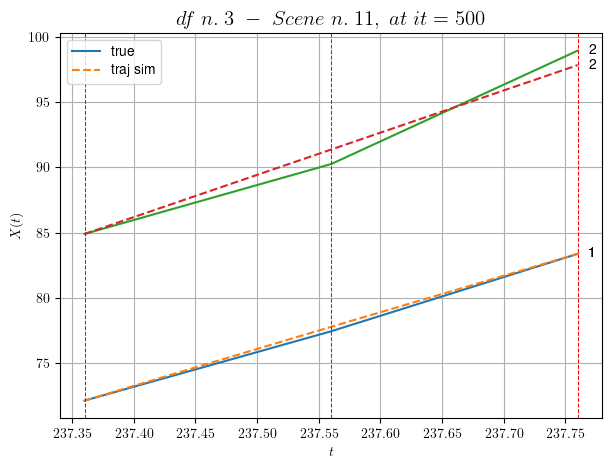

        For scene 11/90
        * use LR_NN=0.0001 with err=0.7942181264005803 at it=24
        * v0_scn_mean = 32.27690761394292
        * MAE = 0.4325920091748448



df n.3, scene n.12/90
    We have 12 time intervals inside [268.56,270.96]
            - Time interval n.0: [268.56, 268.76]
                * y_true: [29.3500352]
                * v_ann: [29.014406204223633, 29.568023140125465]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [268.76, 268.96]
                * y_true: [29.08008566]
                * v_ann: [29.00889778137207, 29.568023140125465]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [268.96, 269.16]
                * y_true: [24.64016214]
                * v_ann: [29.008241653442383, 29.568023140125465]

--------------------------------------------------------------------------------------

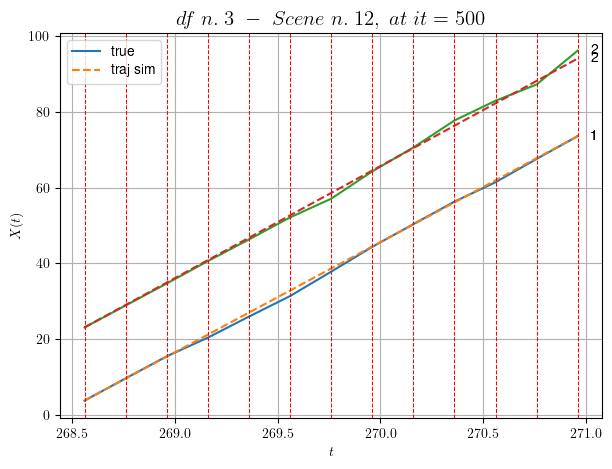

        For scene 12/90
        * use LR_NN=1e-05 with err=0.6092067850009619 at it=24
        * v0_scn_mean = 29.585302214516968
        * MAE = 0.5793361927273645



df n.3, scene n.13/90
    We have 10 time intervals inside [292.56,294.56]
            - Time interval n.0: [292.56, 292.76]
                * y_true: [20.40029016]
                * v_ann: [20.971193313598633, 25.740986248381407]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [292.76, 292.96]
                * y_true: [19.95039872]
                * v_ann: [20.657241821289062, 25.740986248381407]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [292.96, 293.16]
                * y_true: [22.17055226]
                * v_ann: [20.188539505004883, 25.740986248381407]

------------------------------------------------------------------------------------

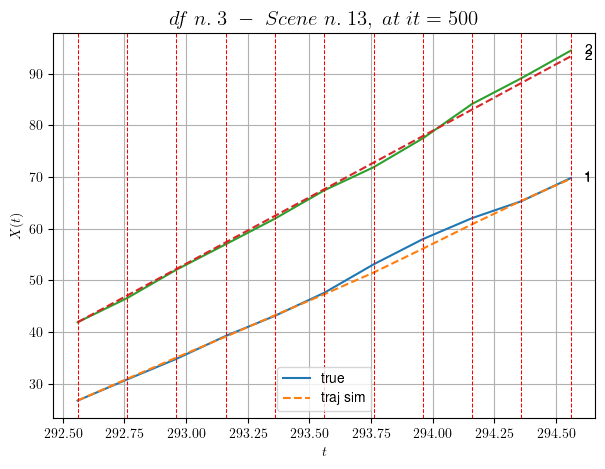

        For scene 13/90
        * use LR_NN=0.001 with err=11.985157695642059 at it=24
        * v0_scn_mean = 25.911346798413746
        * MAE = 0.3452715298903283



df n.3, scene n.14/90
    We have 4 time intervals inside [299.76,300.56]
            - Time interval n.0: [299.76, 299.96]
                * y_true: [31.41374449]
                * v_ann: [32.00053024291992, 35.55620181996972]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [299.96, 300.16]
                * y_true: [27.37378642]
                * v_ann: [25.89659881591797, 35.55620181996972]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [300.16, 300.36]
                * y_true: [19.53299053]
                * v_ann: [20.70766830444336, 35.55620181996972]

-------------------------------------------------------------------------------------------

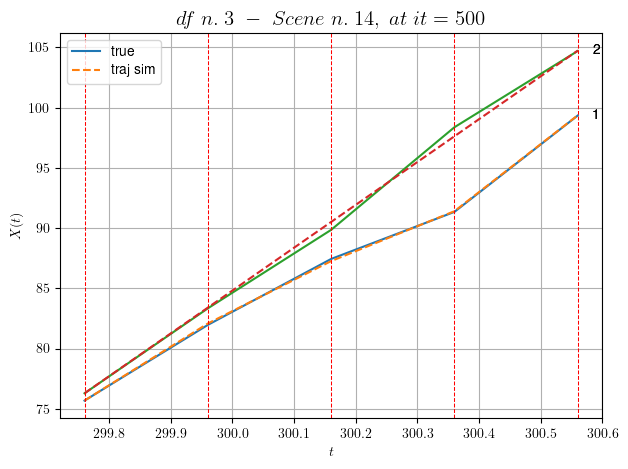

        For scene 14/90
        * use LR_NN=0.001 with err=5.669519481355488 at it=24
        * v0_scn_mean = 35.333953747212085
        * MAE = 0.1046773402681395



df n.3, scene n.15/90
    We have 5 time intervals inside [331.56,332.56]
            - Time interval n.0: [331.56, 331.76]
                * y_true: [29.36025951]
                * v_ann: [29.09095573425293, 25.002166879949275]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [331.76, 331.96]
                * y_true: [26.13036592]
                * v_ann: [27.136886596679688, 25.002166879949275]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [331.96, 332.16]
                * y_true: [26.45053806]
                * v_ann: [27.0564022064209, 25.002166879949275]

-----------------------------------------------------------------------------------------

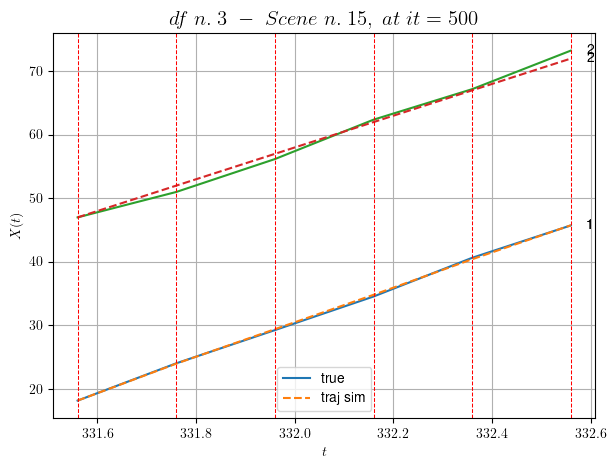

        For scene 15/90
        * use LR_NN=1e-05 with err=3.9594607564536934 at it=24
        * v0_scn_mean = 25.202080204712807
        * MAE = 0.25202682337902416



df n.3, scene n.16/90
    We have 3 time intervals inside [338.36,338.96]
            - Time interval n.0: [338.36, 338.56]
                * y_true: [42.04765341]
                * v_ann: [42.0278434753418, 20.35807022667302]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [338.56, 338.76]
                * y_true: [20.3284091]
                * v_ann: [20.3763370513916, 20.35807022667302]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.76, 338.96]
                * y_true: [23.95541551]
                * v_ann: [23.932504653930664, 20.35807022667302]

--------------------------------------------------------------------------------------------

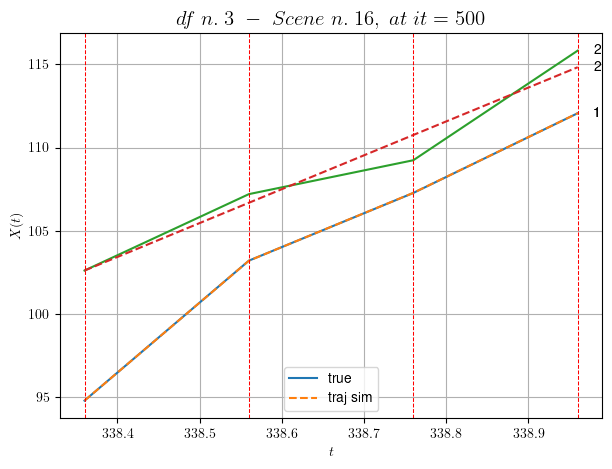

        For scene 16/90
        * use LR_NN=0.001 with err=6.979066557408315 at it=24
        * v0_scn_mean = 20.74374741753197
        * MAE = 0.44557949669110336



df n.3, scene n.17/90
    We have 4 time intervals inside [377.56,378.36]
            - Time interval n.0: [377.56, 377.76]
                * y_true: [28.58096669]
                * v_ann: [26.223026275634766, 38.59992828377911]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [377.76, 377.96]
                * y_true: [33.41151221]
                * v_ann: [28.59886932373047, 38.59992828377911]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [377.96, 378.16]
                * y_true: [28.14158578]
                * v_ann: [30.035207748413086, 38.59992828377911]

------------------------------------------------------------------------------------------

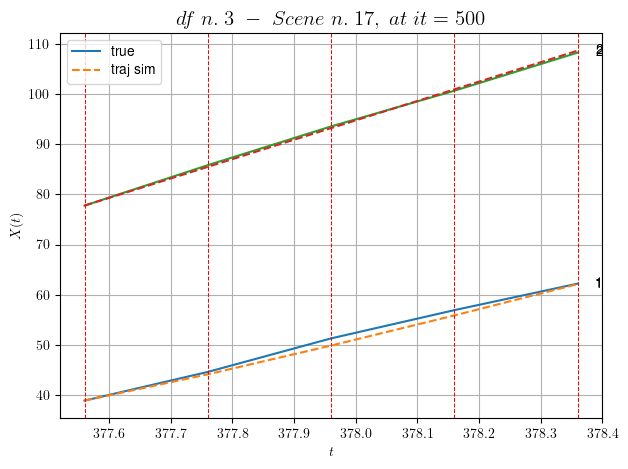

        For scene 17/90
        * use LR_NN=1e-05 with err=8.699243770073679 at it=24
        * v0_scn_mean = 38.25593115249428
        * MAE = 0.38349159411458794



df n.3, scene n.18/90
    We have 6 time intervals inside [385.76,386.96]
            - Time interval n.0: [385.76, 385.96]
                * y_true: [27.95094629]
                * v_ann: [35.56819534301758, 27.617874781177147]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [385.96, 386.16]
                * y_true: [33.20147506]
                * v_ann: [36.12791442871094, 27.617874781177147]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [386.16, 386.36]
                * y_true: [36.102098]
                * v_ann: [35.11341094970703, 27.617874781177147]

-------------------------------------------------------------------------------------------

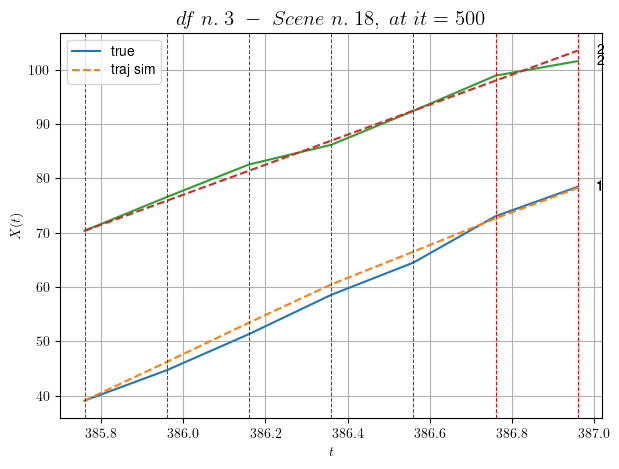

        For scene 18/90
        * use LR_NN=1e-05 with err=3.2063146446287982 at it=24
        * v0_scn_mean = 27.713159789911675
        * MAE = 1.540223903226491



df n.3, scene n.19/90
    We have 4 time intervals inside [402.76,403.56]
            - Time interval n.0: [402.76, 402.96]
                * y_true: [32.26367754]
                * v_ann: [33.08488082885742, 34.5196707222895]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [402.96, 403.16]
                * y_true: [31.06421017]
                * v_ann: [32.612457275390625, 34.5196707222895]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [403.16, 403.36]
                * y_true: [37.17770982]
                * v_ann: [37.517616271972656, 34.5196707222895]

---------------------------------------------------------------------------------------------

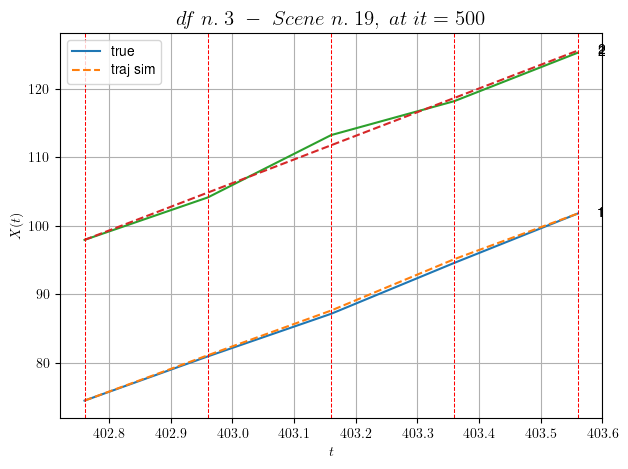

        For scene 19/90
        * use LR_NN=1e-05 with err=2.7217176410709727 at it=24
        * v0_scn_mean = 34.338883893435565
        * MAE = 0.3551688668363025



df n.3, scene n.20/90
    We have 5 time intervals inside [417.16,418.16]
            - Time interval n.0: [417.16, 417.36]
                * y_true: [27.85257929]
                * v_ann: [31.7119197845459, 31.447990123716487]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [417.36, 417.56]
                * y_true: [31.20340101]
                * v_ann: [31.701406478881836, 31.447990123716487]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [417.56, 417.76]
                * y_true: [40.70532339]
                * v_ann: [32.56913757324219, 31.447990123716487]

----------------------------------------------------------------------------------------

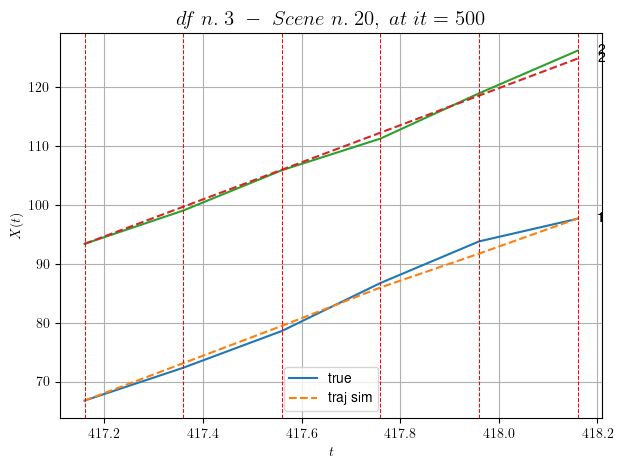

        For scene 20/90
        * use LR_NN=1e-05 with err=1.4459490789260072 at it=24
        * v0_scn_mean = 31.390070518778366
        * MAE = 0.7915479700970796



df n.3, scene n.21/90
    We have 2 time intervals inside [427.36,427.76]
            - Time interval n.0: [427.36, 427.56]
                * y_true: [38.56400372]
                * v_ann: [40.88932418823242, 30.361525596812406]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [427.56, 427.76]
                * y_true: [39.44508031]
                * v_ann: [36.937522888183594, 30.361525596812406]

----------------------------------------------------------------------------------------------------
    * err= 0.05462217512477642
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.00010919775787089636


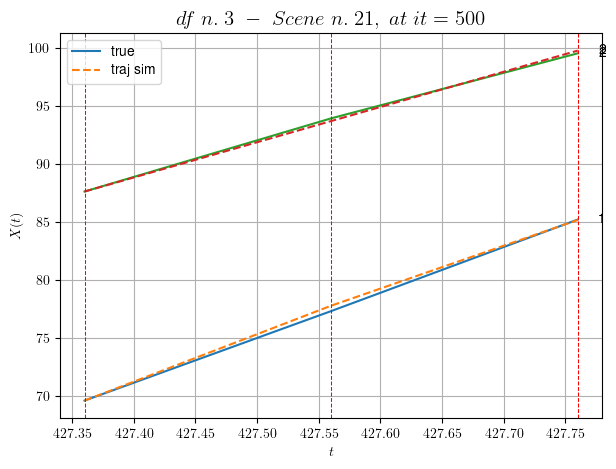

        For scene 21/90
        * use LR_NN=5e-05 with err=0.04762386077235764 at it=24
        * v0_scn_mean = 30.347064572943484
        * MAE = 0.04926050552799484



df n.3, scene n.22/90
    We have 3 time intervals inside [431.76,432.36]
            - Time interval n.0: [431.76, 431.96]
                * y_true: [42.05694869]
                * v_ann: [42.20001220703125, 25.896889333921028]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [431.96, 432.16]
                * y_true: [44.06855704]
                * v_ann: [43.64304733276367, 25.896889333921028]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [432.16, 432.36]
                * y_true: [33.89770032]
                * v_ann: [34.16176986694336, 25.896889333921028]

--------------------------------------------------------------------------------------

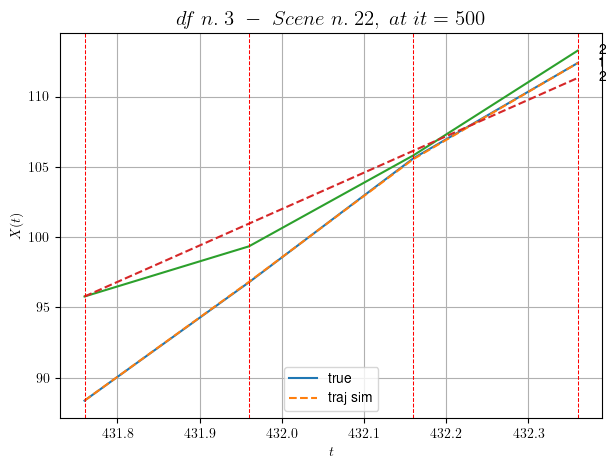

        For scene 22/90
        * use LR_NN=0.001 with err=2.4378098366396035 at it=24
        * v0_scn_mean = 26.061013760533402
        * MAE = 0.8121074750362006



df n.3, scene n.23/90
    We have 7 time intervals inside [436.16,437.56]
            - Time interval n.0: [436.16, 436.36]
                * y_true: [28.38049676]
                * v_ann: [30.88094711303711, 32.92393930276428]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [436.36, 436.56]
                * y_true: [31.10077619]
                * v_ann: [32.10791015625, 32.92393930276428]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [436.56, 436.76]
                * y_true: [33.35116865]
                * v_ann: [31.13982582092285, 32.92393930276428]

----------------------------------------------------------------------------------------------

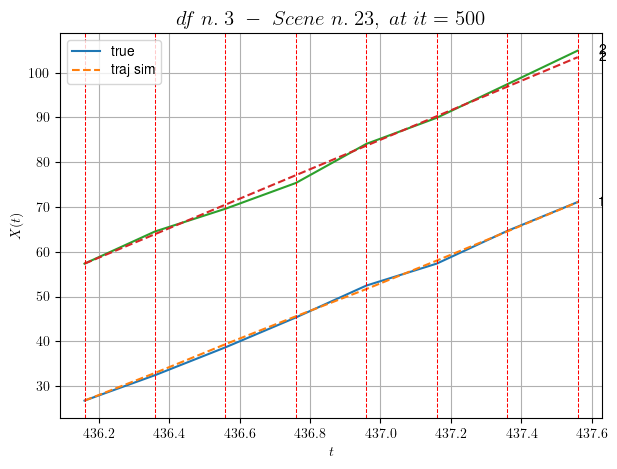

        For scene 23/90
        * use LR_NN=1e-05 with err=4.054206467977627 at it=24
        * v0_scn_mean = 32.80698173067553
        * MAE = 0.5533881200645111



df n.3, scene n.24/90
    We have 3 time intervals inside [438.16,438.76]
            - Time interval n.0: [438.16, 438.36]
                * y_true: [26.48183539]
                * v_ann: [32.3544921875, 34.86837809331495]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [438.36, 438.56]
                * y_true: [35.94307189]
                * v_ann: [33.44055938720703, 34.86837809331495]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [438.56, 438.76]
                * y_true: [35.82358849]
                * v_ann: [32.58457946777344, 34.86837809331495]

-------------------------------------------------------------------------------------------------

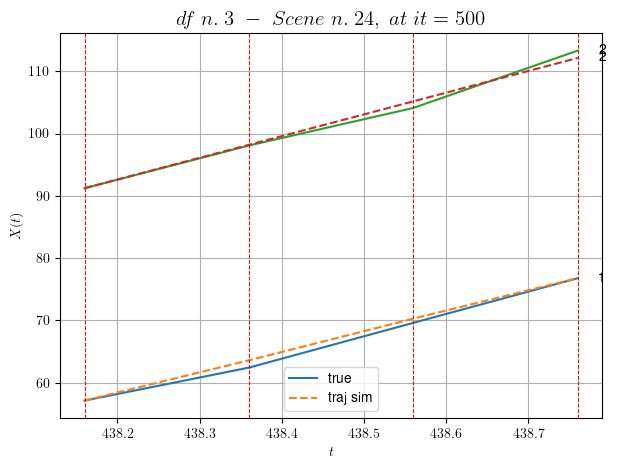

        For scene 24/90
        * use LR_NN=1e-05 with err=2.53450402037161 at it=24
        * v0_scn_mean = 34.67364296962024
        * MAE = 0.5416279810818329



df n.3, scene n.25/90
    We have 10 time intervals inside [464.56,466.56]
            - Time interval n.0: [464.56, 464.76]
                * y_true: [27.69098082]
                * v_ann: [27.548139572143555, 24.498602704880792]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [464.76, 464.96]
                * y_true: [18.42077628]
                * v_ann: [27.840852737426758, 24.498602704880792]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [464.96, 465.16]
                * y_true: [33.36180608]
                * v_ann: [27.714462280273438, 24.498602704880792]

---------------------------------------------------------------------------------------

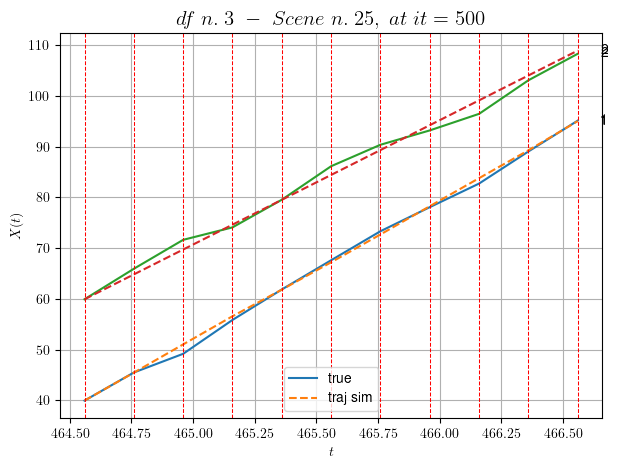

        For scene 25/90
        * use LR_NN=0.0005 with err=25.98121401855691 at it=24
        * v0_scn_mean = 24.718658596643706
        * MAE = 1.109522986333273



df n.3, scene n.26/90
    We have 3 time intervals inside [479.56,480.16]
            - Time interval n.0: [479.56, 479.76]
                * y_true: [28.13211047]
                * v_ann: [23.217287063598633, 23.543200777567314]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [479.76, 479.96]
                * y_true: [15.98145013]
                * v_ann: [24.174150466918945, 23.543200777567314]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [479.96, 480.16]
                * y_true: [26.79272857]
                * v_ann: [23.330224990844727, 23.543200777567314]

--------------------------------------------------------------------------------------

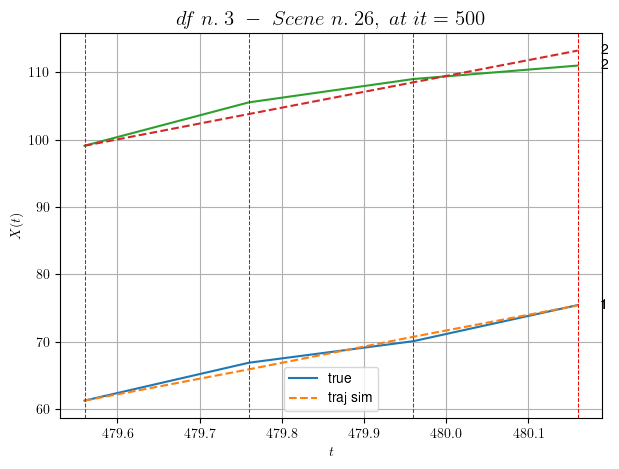

        For scene 26/90
        * use LR_NN=5e-05 with err=5.545087432486163 at it=24
        * v0_scn_mean = 23.801472746415445
        * MAE = 1.1972432189449187



df n.3, scene n.27/90
    We have 5 time intervals inside [486.56,487.56]
            - Time interval n.0: [486.56, 486.76]
                * y_true: [22.56167732]
                * v_ann: [20.150461196899414, 25.85811943170923]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [486.76, 486.96]
                * y_true: [23.21197857]
                * v_ann: [20.924997329711914, 25.85811943170923]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [486.96, 487.16]
                * y_true: [17.98171719]
                * v_ann: [22.146032333374023, 25.85811943170923]

-----------------------------------------------------------------------------------------

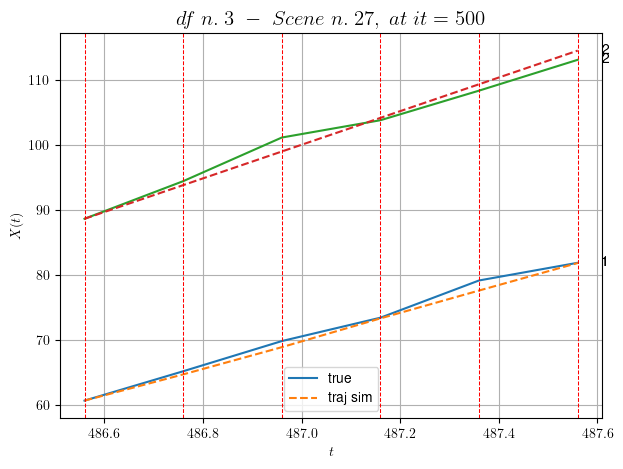

        For scene 27/90
        * use LR_NN=5e-05 with err=5.242327819567228 at it=24
        * v0_scn_mean = 26.02379465440897
        * MAE = 0.960971401721365



df n.3, scene n.28/90
    We have 6 time intervals inside [538.76,539.96]
            - Time interval n.0: [538.76, 538.96]
                * y_true: [20.99100466]
                * v_ann: [19.693023681640625, 28.565734069846993]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [538.96, 539.16]
                * y_true: [24.97142443]
                * v_ann: [22.0495662689209, 28.565734069846993]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [539.16, 539.36]
                * y_true: [24.1116136]
                * v_ann: [26.129703521728516, 28.565734069846993]

-------------------------------------------------------------------------------------------

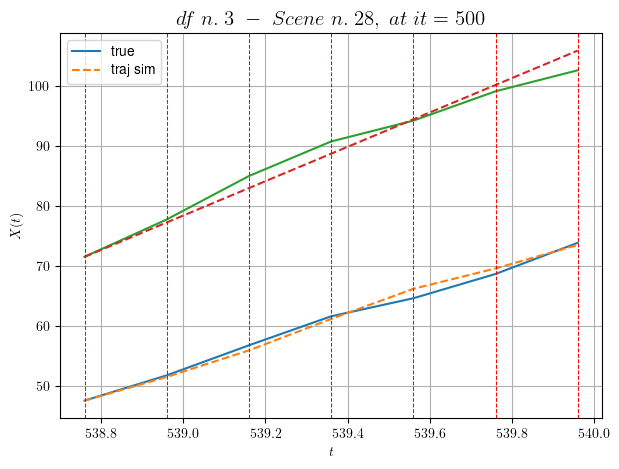

        For scene 28/90
        * use LR_NN=0.001 with err=2.7107342310820495 at it=24
        * v0_scn_mean = 28.623104707041502
        * MAE = 1.6238154603417334



df n.3, scene n.29/90
    We have 5 time intervals inside [544.16,545.16]
            - Time interval n.0: [544.16, 544.36]
                * y_true: [11.03044025]
                * v_ann: [20.468433380126953, 26.245021293269826]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [544.36, 544.56]
                * y_true: [26.59442737]
                * v_ann: [21.587907791137695, 26.245021293269826]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [544.56, 544.76]
                * y_true: [22.38126049]
                * v_ann: [22.267597198486328, 26.245021293269826]

-------------------------------------------------------------------------------------

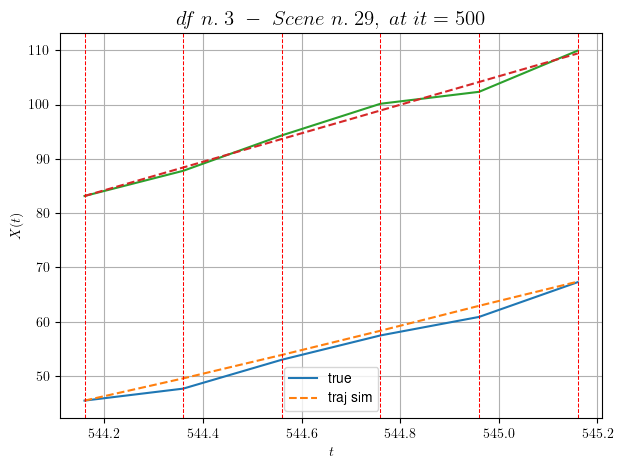

        For scene 29/90
        * use LR_NN=1e-05 with err=3.6596934204123244 at it=24
        * v0_scn_mean = 26.3952204415103
        * MAE = 1.2623205576924683



df n.3, scene n.30/90
    We have 3 time intervals inside [563.76,564.36]
            - Time interval n.0: [563.76, 563.96]
                * y_true: [25.25123233]
                * v_ann: [19.237709045410156, 27.431374274162362]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [563.96, 564.16]
                * y_true: [16.45094022]
                * v_ann: [19.627674102783203, 27.431374274162362]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [564.16, 564.36]
                * y_true: [18.30118347]
                * v_ann: [20.861894607543945, 27.431374274162362]

---------------------------------------------------------------------------------------

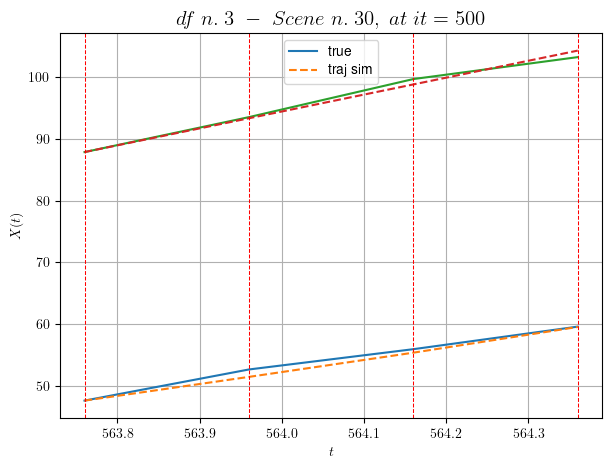

        For scene 30/90
        * use LR_NN=1e-05 with err=1.1183305884615775 at it=24
        * v0_scn_mean = 27.534119303177434
        * MAE = 0.45935116358579997



df n.3, scene n.31/90
    We have 2 time intervals inside [566.96,567.36]
            - Time interval n.0: [566.96, 567.16]
                * y_true: [7.53069511]
                * v_ann: [10.992383003234863, 24.86641811764766]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [567.16, 567.36]
                * y_true: [20.43212573]
                * v_ann: [17.939802169799805, 24.86641811764766]

----------------------------------------------------------------------------------------------------
    * err= 0.09939773750969705
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.009987731588449247


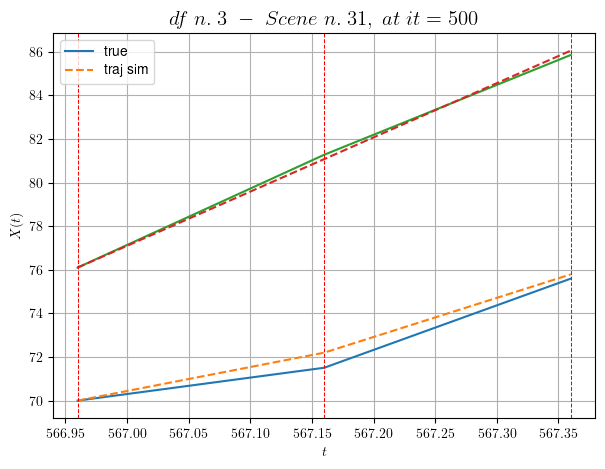

        For scene 31/90
        * use LR_NN=0.0001 with err=1.0260364473704406 at it=24
        * v0_scn_mean = 25.071761392908034
        * MAE = 0.09939773750969705



df n.3, scene n.32/90
    We have 4 time intervals inside [573.76,574.56]
            - Time interval n.0: [573.76, 573.96]
                * y_true: [17.20183898]
                * v_ann: [24.24672508239746, 29.32939981960117]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [573.96, 574.16]
                * y_true: [34.7042468]
                * v_ann: [27.797161102294922, 29.32939981960117]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [574.16, 574.36]
                * y_true: [32.70470322]
                * v_ann: [25.380189895629883, 29.32939981960117]

----------------------------------------------------------------------------------------

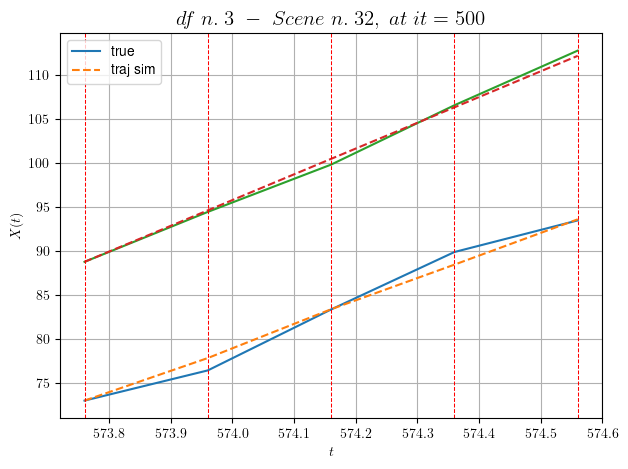

        For scene 32/90
        * use LR_NN=1e-05 with err=0.5041104323338648 at it=24
        * v0_scn_mean = 29.356223826812087
        * MAE = 0.4777836238509402



df n.3, scene n.33/90
    We have 2 time intervals inside [587.76,588.16]
    * err= 0.12162440478883231
    * Learning rate NN = 0.00040499999886378646
    * diff = 8.564250645048954e-07


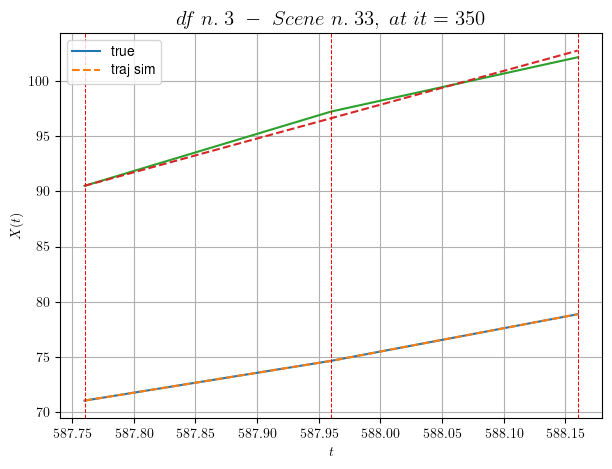

        For scene 33/90
        * use LR_NN=0.0005 with err=0.1095493626361014 at it=24
        * v0_scn_mean = 30.617882226468485
        * MAE = 0.10980135783811491



df n.3, scene n.34/90
    We have 7 time intervals inside [590.36,591.76]
            - Time interval n.0: [590.36, 590.56]
                * y_true: [11.65068678]
                * v_ann: [11.609495162963867, 19.035476639427053]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [590.56, 590.76]
                * y_true: [9.35059372]
                * v_ann: [9.240045547485352, 19.035476639427053]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [590.76, 590.96]
                * y_true: [6.3504254]
                * v_ann: [7.859158515930176, 19.035476639427053]

----------------------------------------------------------------------------------------

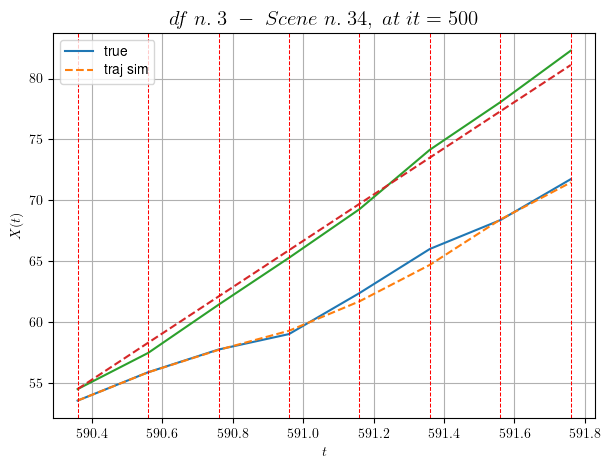

        For scene 34/90
        * use LR_NN=0.005 with err=39.73602954312331 at it=24
        * v0_scn_mean = 19.47405757376578
        * MAE = 0.3340833708805784



df n.3, scene n.35/90
    We have 3 time intervals inside [16.16,16.76]
            - Time interval n.0: [16.16, 16.36]
                * y_true: [27.36596872 40.6089382 ]
                * v_ann: [25.128808975219727, 18.85238265991211, 39.2272817868331]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [16.36, 16.56]
                * y_true: [22.16572117 32.62072047]
                * v_ann: [36.46330642700195, 28.333784103393555, 39.2272817868331]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [16.56, 16.76]
                * y_true: [24.04131334 24.91936545]
                * v_ann: [33.009681701660156, 20.22325325012207, 39.2272817868331]

--------

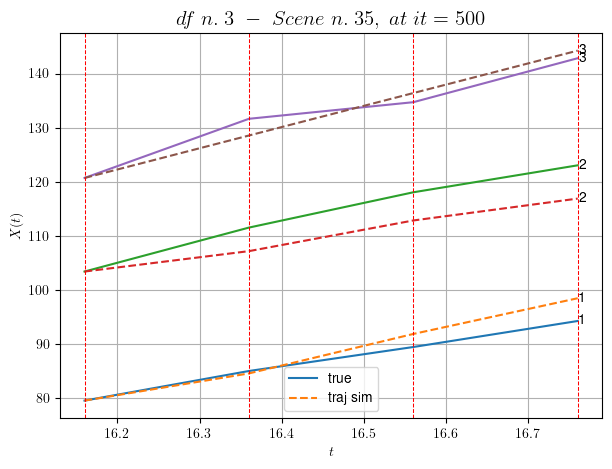

        For scene 35/90
        * use LR_NN=0.0005 with err=12.878162097507053 at it=24
        * v0_scn_mean = 38.67364529390812
        * MAE = 10.161207509790472



df n.3, scene n.36/90
    We have 2 time intervals inside [17.56,17.96]
            - Time interval n.0: [17.56, 17.76]
                * y_true: [26.87631442 28.75240293]
                * v_ann: [10.613749504089355, 33.81947708129883, 37.341608941889035]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [17.76, 17.96]
                * y_true: [26.32655772 34.05345458]
                * v_ann: [10.777409553527832, 33.74097442626953, 37.341608941889035]

----------------------------------------------------------------------------------------------------
    * err= 6.532975728359361
    * Learning rate NN = 7.289998848136747e-06
    * diff = 0.024420479930967076


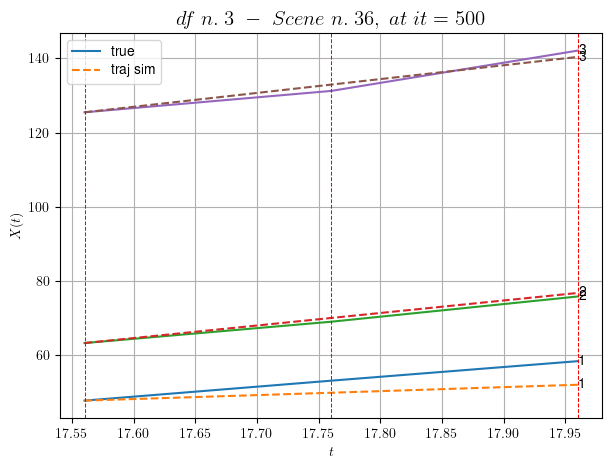

        For scene 36/90
        * use LR_NN=1e-05 with err=9.856829860317461 at it=24
        * v0_scn_mean = 36.90111273499797
        * MAE = 6.532975728359361



df n.3, scene n.37/90
    We have 4 time intervals inside [23.96,24.76]
            - Time interval n.0: [23.96, 24.16]
                * y_true: [31.9527567  21.95230333]
                * v_ann: [25.98040008544922, 24.048479080200195, 27.01666435369722]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [24.16, 24.36]
                * y_true: [26.79271708 14.85171745]
                * v_ann: [24.727928161621094, 26.04416275024414, 27.01666435369722]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.36, 24.56]
                * y_true: [20.5424093  31.65411216]
                * v_ann: [26.17026138305664, 25.590635299682617, 27.01666435369722]

------

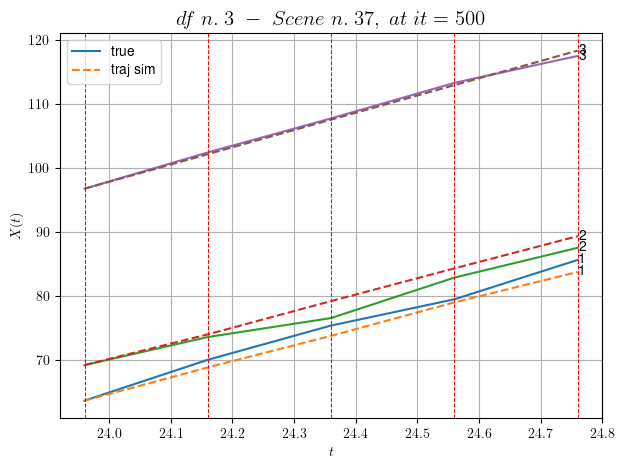

        For scene 37/90
        * use LR_NN=0.0005 with err=31.59620354967076 at it=24
        * v0_scn_mean = 27.19566435853006
        * MAE = 1.4235137971732392



df n.3, scene n.38/90
    We have 4 time intervals inside [42.96,43.76]
            - Time interval n.0: [42.96, 43.16]
                * y_true: [34.44093898 36.40531345]
                * v_ann: [24.89557647705078, 24.552797317504883, 27.350673440922428]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [43.16, 43.36]
                * y_true: [27.09071898 44.10770887]
                * v_ann: [35.53934860229492, 32.48577880859375, 27.350673440922428]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [43.36, 43.56]
                * y_true: [24.51583897 25.2301032 ]
                * v_ann: [39.66780471801758, 28.34101676940918, 27.350673440922428]

---

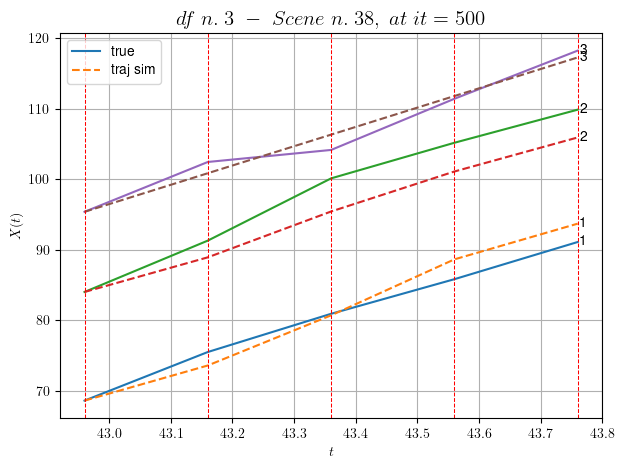

        For scene 38/90
        * use LR_NN=0.001 with err=20.311806977076305 at it=24
        * v0_scn_mean = 27.509632915518058
        * MAE = 4.837878648574969



df n.3, scene n.39/90
    We have 2 time intervals inside [61.76,62.16]
            - Time interval n.0: [61.76, 61.96]
                * y_true: [28.79377133  7.10177762]
                * v_ann: [31.535472869873047, 29.594980239868164, 27.830090416767078]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [61.96, 62.16]
                * y_true: [41.29768472 31.64601894]
                * v_ann: [19.08370590209961, 23.70473861694336, 27.830090416767078]

----------------------------------------------------------------------------------------------------
    * err= 5.847102828853733
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0019292012565701455


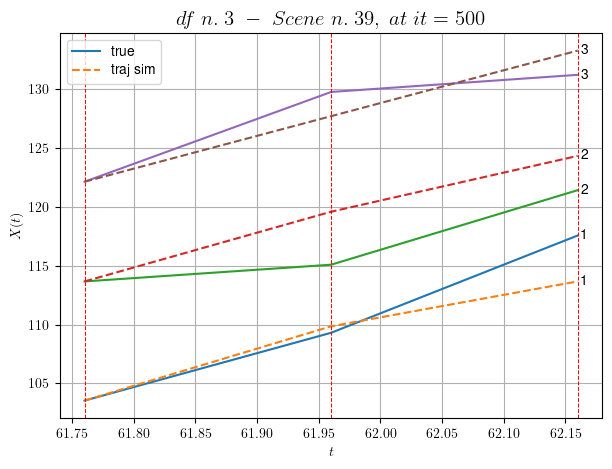

        For scene 39/90
        * use LR_NN=0.001 with err=7.32345417606438 at it=24
        * v0_scn_mean = 27.960284894336894
        * MAE = 5.671219906695579



df n.3, scene n.40/90
    We have 2 time intervals inside [63.76,64.16]
            - Time interval n.0: [63.76, 63.96]
                * y_true: [39.33120973 30.97229006]
                * v_ann: [31.919536590576172, 28.231952667236328, 33.83988267438129]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [63.96, 64.16]
                * y_true: [32.2308074  22.86038312]
                * v_ann: [33.43451690673828, 29.649150848388672, 33.83988267438129]

----------------------------------------------------------------------------------------------------
    * err= 0.813199692081834
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.02301746622584222


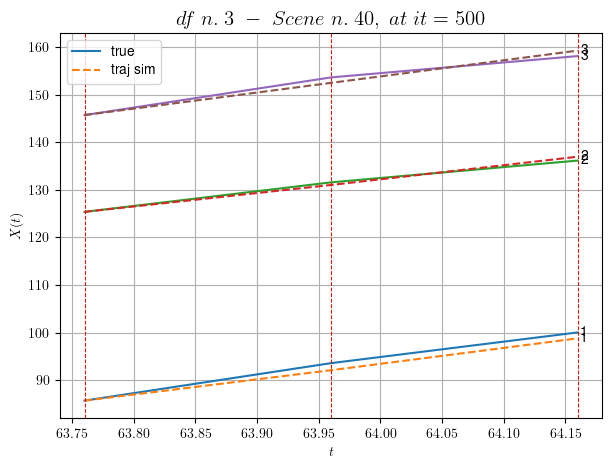

        For scene 40/90
        * use LR_NN=5e-05 with err=1.7615173554104508 at it=24
        * v0_scn_mean = 33.609489886320695
        * MAE = 0.5019873317220387



df n.3, scene n.41/90
    We have 3 time intervals inside [67.16,67.76]
    * err= 70.21882066996724
    * Learning rate NN = 0.0002952449722215533
    * diff = 2.387376270007735e-07


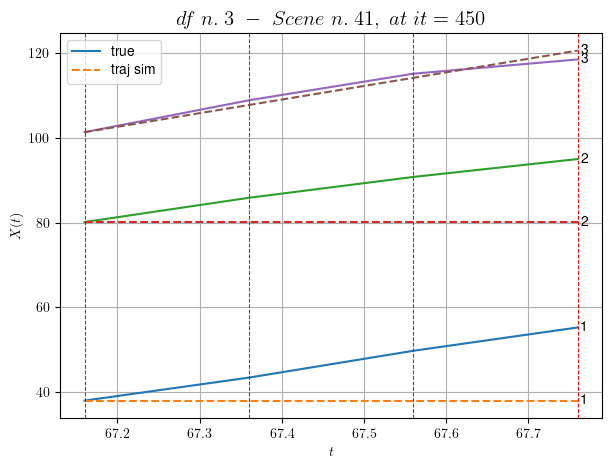

        For scene 41/90
        * use LR_NN=0.0005 with err=3.988772364664236 at it=24
        * v0_scn_mean = 31.99670022990447
        * MAE = 19.129156457934663



df n.3, scene n.42/90
    We have 7 time intervals inside [72.76,74.16]
            - Time interval n.0: [72.76, 72.96]
                * y_true: [28.501496   30.93407752]
                * v_ann: [-6.392643711475646e-14, -1.731611121158494e-08, 28.12124026314026]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.96, 73.16]
                * y_true: [36.65243351 31.9148258 ]
                * v_ann: [-3.968328690282484e-14, -1.270325924451754e-07, 28.12124026314026]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [73.16, 73.36]
                * y_true: [27.70226144 28.33497935]
                * v_ann: [-1.0045123641309189e-13, -1.136206492446945e-

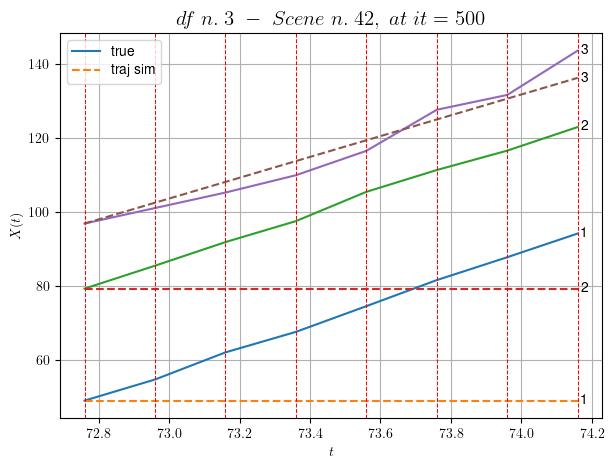

        For scene 42/90
        * use LR_NN=0.0005 with err=42.62893035904205 at it=24
        * v0_scn_mean = 28.233965762999638
        * MAE = 475.7641696802854



df n.3, scene n.43/90
    We have 3 time intervals inside [82.16,82.76]
    * err= 83.67344587836702
    * Learning rate NN = 0.0006560999318026006
    * diff = 8.857510636062216e-07


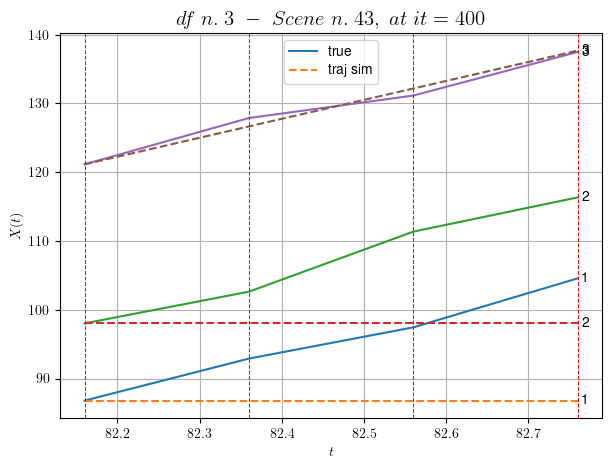

        For scene 43/90
        * use LR_NN=0.001 with err=7.5891189254074805 at it=24
        * v0_scn_mean = 27.733969268662268
        * MAE = 83.67344587836702



df n.3, scene n.44/90
    We have 3 time intervals inside [86.16,86.76]
    * err= 95.01334851939237
    * Learning rate NN = 5.9048988987342454e-06
    * diff = 5.340909297046892e-07


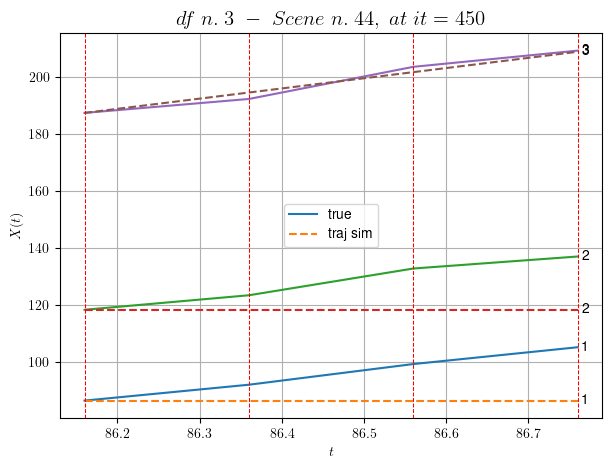

        For scene 44/90
        * use LR_NN=1e-05 with err=13.340416123640685 at it=24
        * v0_scn_mean = 35.380421172315195
        * MAE = 95.01334851939237



df n.3, scene n.45/90
    We have 5 time intervals inside [130.96,131.96]
    * err= 236.66692153356703
    * Learning rate NN = 4.304671165300533e-05
    * diff = 7.52204840637205e-07


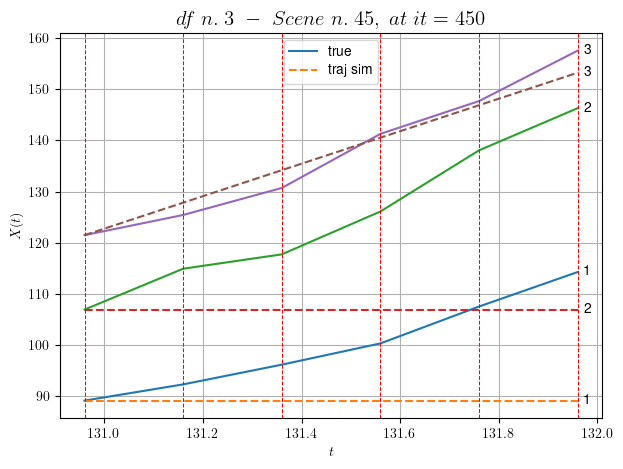

        For scene 45/90
        * use LR_NN=0.0001 with err=58.56562659613388 at it=24
        * v0_scn_mean = 31.635515460700706
        * MAE = 236.66692153356703



df n.3, scene n.46/90
    We have 12 time intervals inside [139.16,141.56]
            - Time interval n.0: [139.16, 139.36]
                * y_true: [22.50033849 31.62238978]
                * v_ann: [25.72821807861328, 28.4019832611084, 28.14463056725922]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [139.36, 139.56]
                * y_true: [29.90063418 17.15160439]
                * v_ann: [27.068771362304688, 25.86754035949707, 28.14463056725922]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [139.56, 139.76]
                * y_true: [27.10078793 37.57385655]
                * v_ann: [24.99757194519043, 27.19790267944336, 28.14463056725922

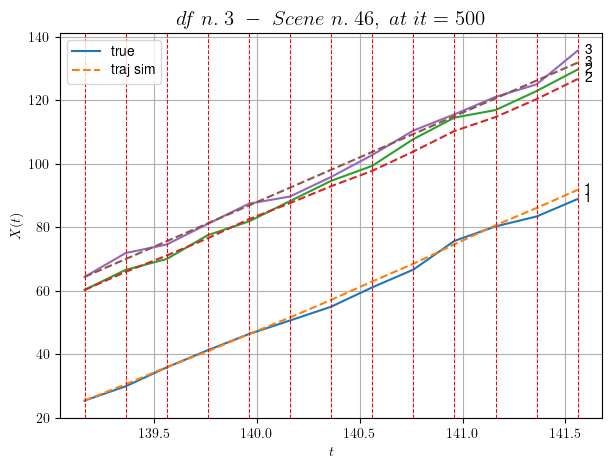

        For scene 46/90
        * use LR_NN=0.0005 with err=180.8876983455647 at it=24
        * v0_scn_mean = 28.255952649921554
        * MAE = 2.8063422445222392



df n.3, scene n.47/90
    We have 3 time intervals inside [143.76,144.36]
            - Time interval n.0: [143.76, 143.96]
                * y_true: [30.62207823 41.7261053 ]
                * v_ann: [29.2624454498291, 22.243741989135742, 29.414744463246983]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [143.96, 144.16]
                * y_true: [21.21173425 33.31570327]
                * v_ann: [43.04105758666992, 26.167909622192383, 29.414744463246983]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [144.16, 144.36]
                * y_true: [29.72284222 27.36558717]
                * v_ann: [30.902494430541992, 19.01490592956543, 29.41474446324

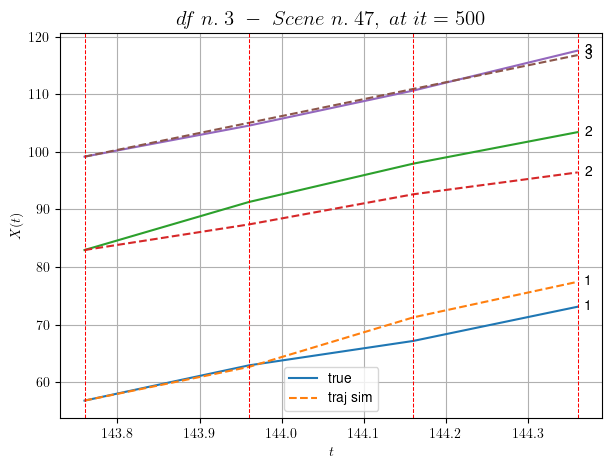

        For scene 47/90
        * use LR_NN=0.0005 with err=16.946870428903882 at it=24
        * v0_scn_mean = 29.449859769175426
        * MAE = 7.787198208590847



df n.3, scene n.48/90
    We have 3 time intervals inside [149.36,149.96]
            - Time interval n.0: [149.36, 149.56]
                * y_true: [25.90049539 27.45094024]
                * v_ann: [17.339771270751953, 29.114517211914062, 23.443555328521036]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [149.56, 149.76]
                * y_true: [21.18057417 22.42095425]
                * v_ann: [17.359344482421875, 28.283302307128906, 23.443555328521036]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [149.76, 149.96]
                * y_true: [37.02126181 27.98148311]
                * v_ann: [17.246654510498047, 27.580760955810547, 23.4435553

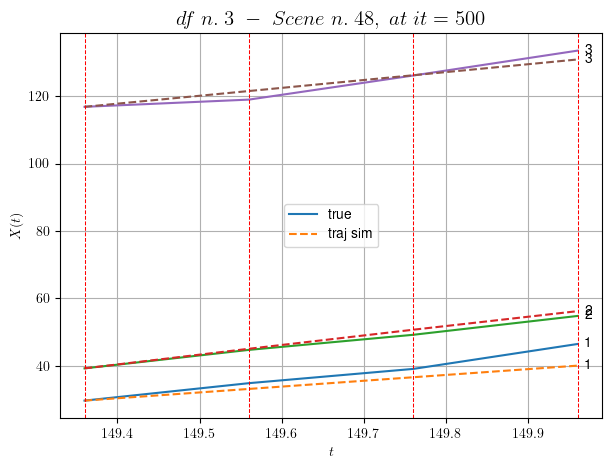

        For scene 48/90
        * use LR_NN=1e-05 with err=24.7414064865814 at it=24
        * v0_scn_mean = 23.83694171443956
        * MAE = 5.685144535316318



df n.3, scene n.49/90
    We have 3 time intervals inside [156.16,156.76]
            - Time interval n.0: [156.16, 156.36]
                * y_true: [12.56997445 35.72646923]
                * v_ann: [21.35391616821289, 29.149797439575195, 36.77961690674234]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [156.36, 156.56]
                * y_true: [42.07610638 31.26485338]
                * v_ann: [30.600950241088867, 28.68938446044922, 36.77961690674234]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [156.56, 156.76]
                * y_true: [30.09491831 26.35466702]
                * v_ann: [37.29240417480469, 31.480932235717773, 36.77961690674234]


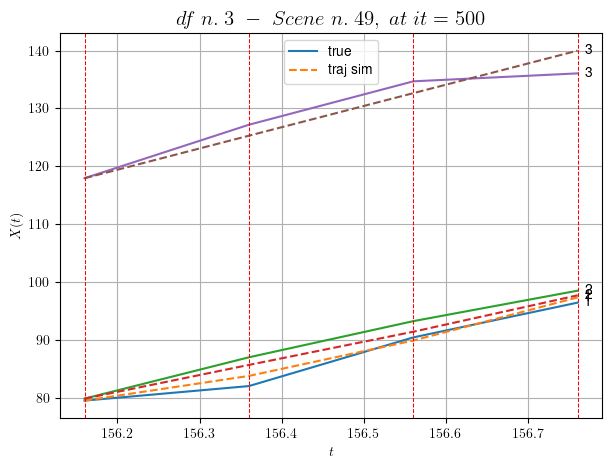

        For scene 49/90
        * use LR_NN=5e-05 with err=28.126610825446786 at it=24
        * v0_scn_mean = 36.37284019672793
        * MAE = 2.760953420091333



df n.3, scene n.50/90
    We have 4 time intervals inside [207.96,208.76]
            - Time interval n.0: [207.96, 208.16]
                * y_true: [30.12104774 28.85226703]
                * v_ann: [30.63798713684082, 31.400625228881836, 31.12490964519084]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [208.16, 208.36]
                * y_true: [31.19139939 27.73265496]
                * v_ann: [30.185903549194336, 30.363698959350586, 31.12490964519084]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [208.36, 208.56]
                * y_true: [31.59181924 26.81292648]
                * v_ann: [29.58487892150879, 28.23185920715332, 31.12490964519084

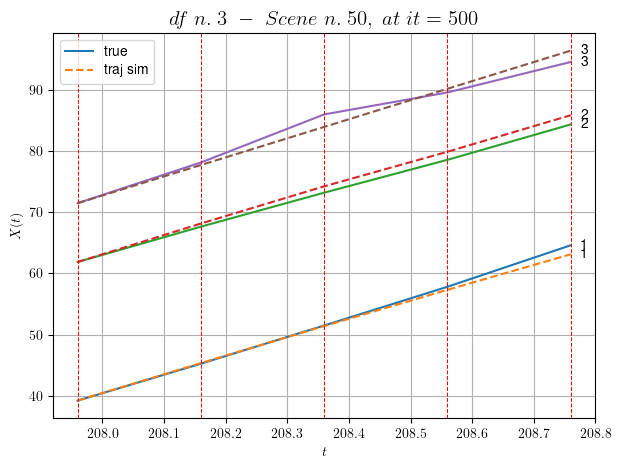

        For scene 50/90
        * use LR_NN=0.0001 with err=9.576072866761828 at it=24
        * v0_scn_mean = 31.057415116985204
        * MAE = 0.5509607253914994



df n.3, scene n.51/90
    We have 5 time intervals inside [218.16,219.16]
            - Time interval n.0: [218.16, 218.36]
                * y_true: [26.47083003 31.40159485]
                * v_ann: [31.81882095336914, 31.281269073486328, 31.94692558326355]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [218.36, 218.56]
                * y_true: [32.09751616 29.50187244]
                * v_ann: [30.639436721801758, 30.62278175354004, 31.94692558326355]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [218.56, 218.76]
                * y_true: [31.61167285 38.50305628]
                * v_ann: [31.11612319946289, 31.359975814819336, 31.946925583263

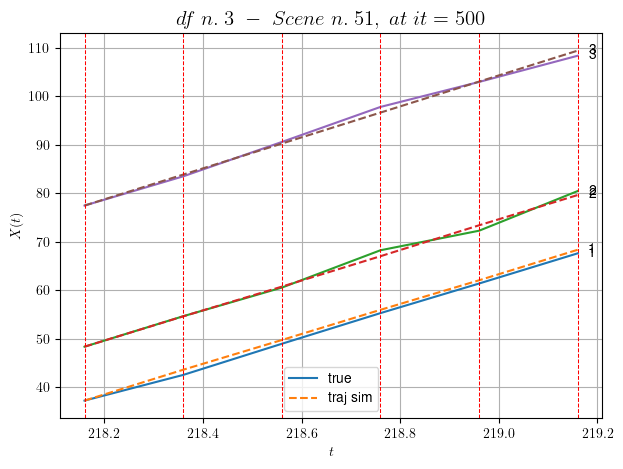

        For scene 51/90
        * use LR_NN=0.0001 with err=29.59136612346469 at it=24
        * v0_scn_mean = 31.83011013568054
        * MAE = 0.5163286964847431



df n.3, scene n.52/90
    We have 4 time intervals inside [222.96,223.76]
            - Time interval n.0: [222.96, 223.16]
                * y_true: [37.21103813 39.71315438]
                * v_ann: [40.471134185791016, 34.37552261352539, 31.279750687417188]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [223.16, 223.36]
                * y_true: [31.35126998 28.99272163]
                * v_ann: [41.7431755065918, 32.20121383666992, 31.279750687417188]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.36, 223.56]
                * y_true: [33.72173898 31.78369531]
                * v_ann: [32.51442337036133, 27.06678581237793, 31.27975068741718

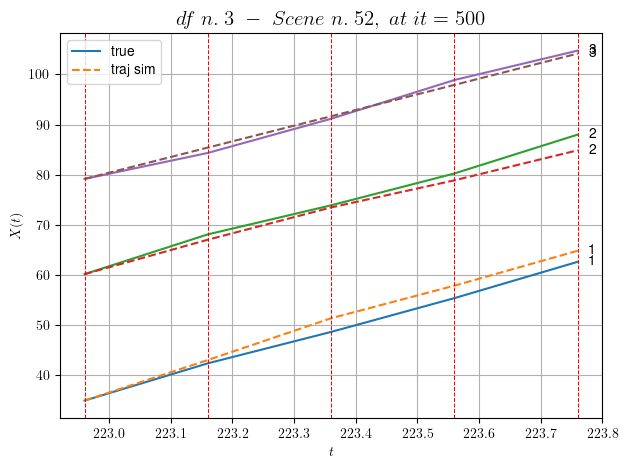

        For scene 52/90
        * use LR_NN=0.0005 with err=5.7186037701100405 at it=24
        * v0_scn_mean = 31.20296570363061
        * MAE = 2.309516020731113



df n.3, scene n.53/90
    We have 6 time intervals inside [247.36,248.56]
            - Time interval n.0: [247.36, 247.56]
                * y_true: [24.34113117 25.37248976]
                * v_ann: [28.701053619384766, 26.051467895507812, 29.199545092787744]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [247.56, 247.76]
                * y_true: [20.86113385 27.00305492]
                * v_ann: [27.22916603088379, 24.98337173461914, 29.199545092787744]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [247.76, 247.96]
                * y_true: [25.44173909 29.15378269]
                * v_ann: [26.883464813232422, 27.0191650390625, 29.199545092787

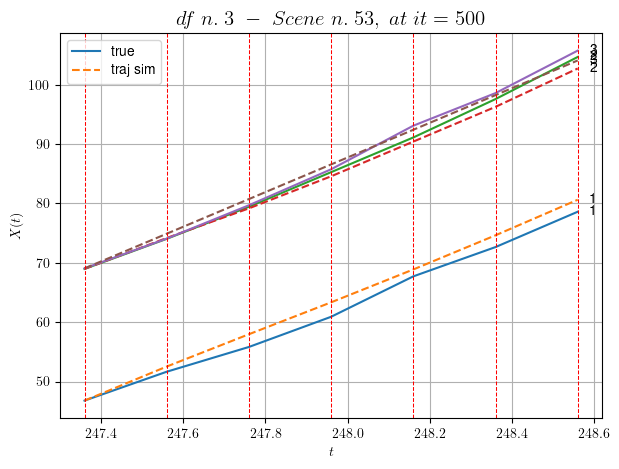

        For scene 53/90
        * use LR_NN=0.001 with err=2.2059522106372254 at it=24
        * v0_scn_mean = 29.247572351281953
        * MAE = 1.3334049918408952



df n.3, scene n.54/90
    We have 7 time intervals inside [269.56,270.96]
            - Time interval n.0: [269.56, 269.76]
                * y_true: [27.75027124 32.18076388]
                * v_ann: [25.531841278076172, 32.03817367553711, 30.53917566971199]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [269.76, 269.96]
                * y_true: [33.80053503 32.77104018]
                * v_ann: [26.44145393371582, 30.5423583984375, 30.53917566971199]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [269.96, 270.16]
                * y_true: [22.10049768 29.95131945]
                * v_ann: [26.337814331054688, 31.33716583251953, 30.53917566971199

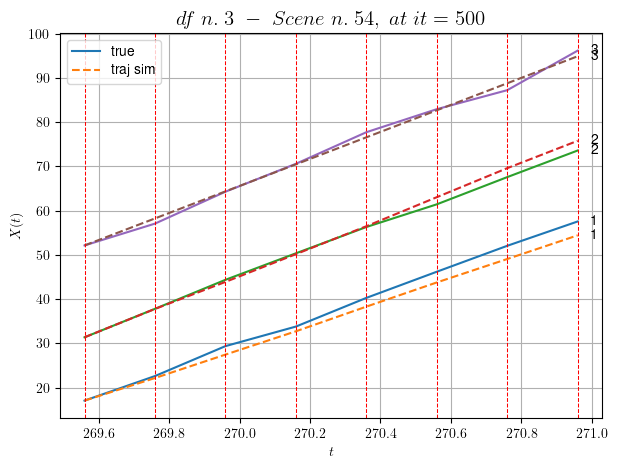

        For scene 54/90
        * use LR_NN=5e-05 with err=5.741591589907575 at it=24
        * v0_scn_mean = 30.506825153737473
        * MAE = 2.1720222907787416



df n.3, scene n.55/90
    We have 2 time intervals inside [316.16,316.56]
            - Time interval n.0: [316.16, 316.36]
                * y_true: [33.9635286 19.3731464]
                * v_ann: [27.922340393066406, 27.44841194152832, 31.119731307251072]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [316.36, 316.56]
                * y_true: [24.60296417 29.75560281]
                * v_ann: [25.802133560180664, 26.394142150878906, 31.119731307251072]

----------------------------------------------------------------------------------------------------
    * err= 0.717130649120696
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.0012103402162116916


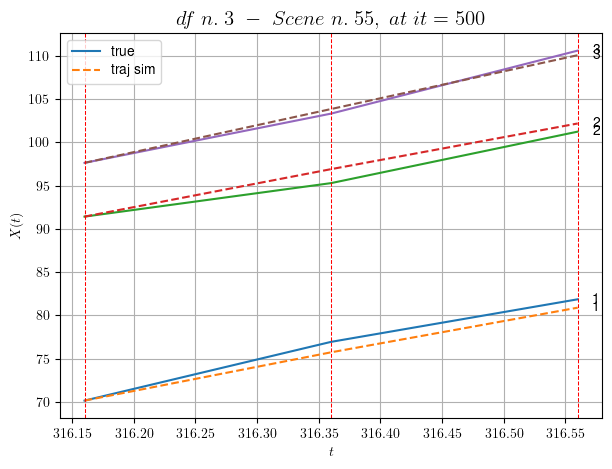

        For scene 55/90
        * use LR_NN=0.0005 with err=3.092856814507817 at it=24
        * v0_scn_mean = 31.052547479089757
        * MAE = 0.24851185434248757



df n.3, scene n.56/90
    We have 4 time intervals inside [317.76,318.56]
            - Time interval n.0: [317.76, 317.96]
                * y_true: [22.24301013 28.10582296]
                * v_ann: [27.06501579284668, 29.455249786376953, 28.729606502534633]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.96, 318.16]
                * y_true: [28.26433817 33.10585656]
                * v_ann: [24.95906639099121, 25.951435089111328, 28.729606502534633]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.16, 318.36]
                * y_true: [11.28182915 18.67354228]
                * v_ann: [25.983366012573242, 17.39270782470703, 28.729606502

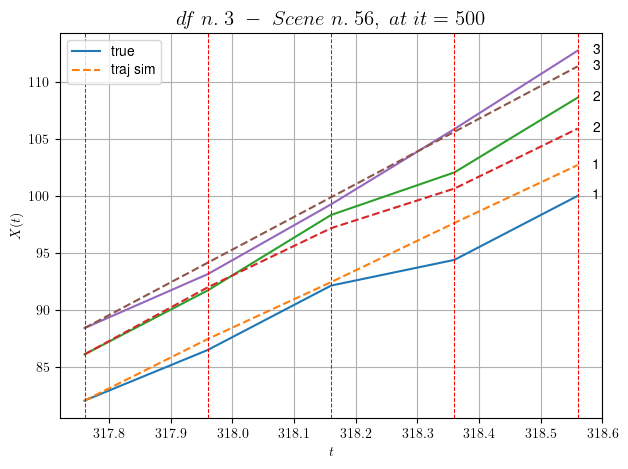

        For scene 56/90
        * use LR_NN=0.001 with err=15.93657378693895 at it=24
        * v0_scn_mean = 28.805830055344643
        * MAE = 1.1648426079291112



df n.3, scene n.57/90
    We have 6 time intervals inside [325.76,326.96]
            - Time interval n.0: [325.76, 325.96]
                * y_true: [25.31057708 30.22149101]
                * v_ann: [25.66935920715332, 28.14006805419922, 33.13555230710646]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.96, 326.16]
                * y_true: [25.23074384 33.46208613]
                * v_ann: [26.08911895751953, 28.607152938842773, 33.13555230710646]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [326.16, 326.36]
                * y_true: [24.63092838 29.01218385]
                * v_ann: [27.442245483398438, 30.620351791381836, 33.1355523071064

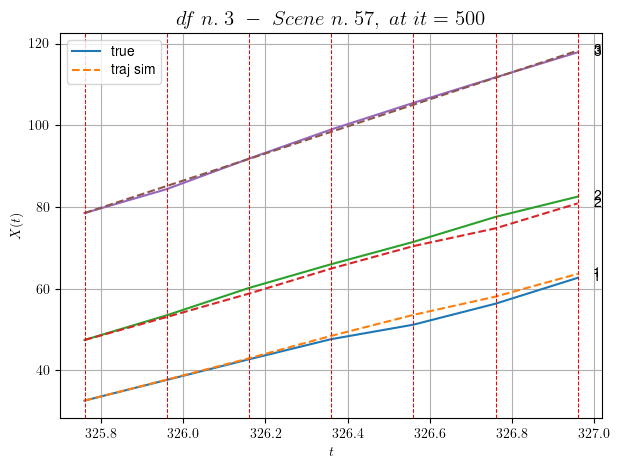

        For scene 57/90
        * use LR_NN=0.0005 with err=11.616572271194753 at it=24
        * v0_scn_mean = 32.947419309460074
        * MAE = 0.7136711794967902



df n.3, scene n.58/90
    We have 2 time intervals inside [335.76,336.16]
            - Time interval n.0: [335.76, 335.96]
                * y_true: [36.00253797 32.17585284]
                * v_ann: [46.540733337402344, 34.426387786865234, 9.495680524399242]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [335.96, 336.16]
                * y_true: [33.90297107 37.71766361]
                * v_ann: [25.258939743041992, 23.943735122680664, 9.495680524399242]

----------------------------------------------------------------------------------------------------
    * err= 1.62289234167214
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.06798307159929573


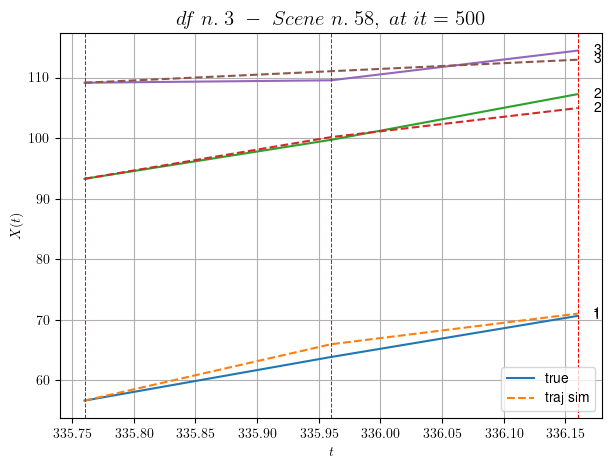

        For scene 58/90
        * use LR_NN=0.0005 with err=16.69428048727125 at it=24
        * v0_scn_mean = 10.725938772335907
        * MAE = 1.62289234167214



df n.3, scene n.59/90
    We have 3 time intervals inside [371.16,371.76]
            - Time interval n.0: [371.16, 371.36]
                * y_true: [24.42036896 26.80112378]
                * v_ann: [27.106307983398438, 27.40491485595703, 32.539507599226575]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.36, 371.56]
                * y_true: [25.21053633 31.30165898]
                * v_ann: [26.64204978942871, 26.26948356628418, 32.539507599226575]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.56, 371.76]
                * y_true: [24.36067127 30.15199262]
                * v_ann: [27.17374610900879, 27.531408309936523, 32.5395075992265

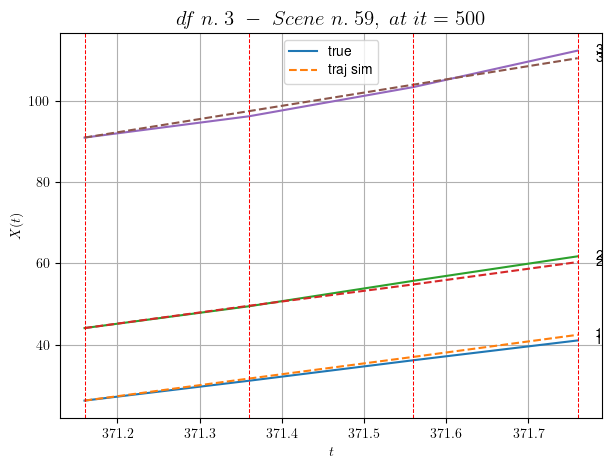

        For scene 59/90
        * use LR_NN=0.0001 with err=7.299498459117873 at it=24
        * v0_scn_mean = 32.387137257290945
        * MAE = 0.822345745673711



df n.3, scene n.60/90
    We have 4 time intervals inside [387.36,388.16]
            - Time interval n.0: [387.36, 387.56]
                * y_true: [32.47194771 39.46360823]
                * v_ann: [27.861988067626953, 29.62442398071289, 33.031898088256106]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [387.56, 387.76]
                * y_true: [28.80212467 26.65295039]
                * v_ann: [31.969118118286133, 35.58988571166992, 33.031898088256106]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.76, 387.96]
                * y_true: [28.30253286 24.25305315]
                * v_ann: [28.15658187866211, 30.00461196899414, 33.031898088256

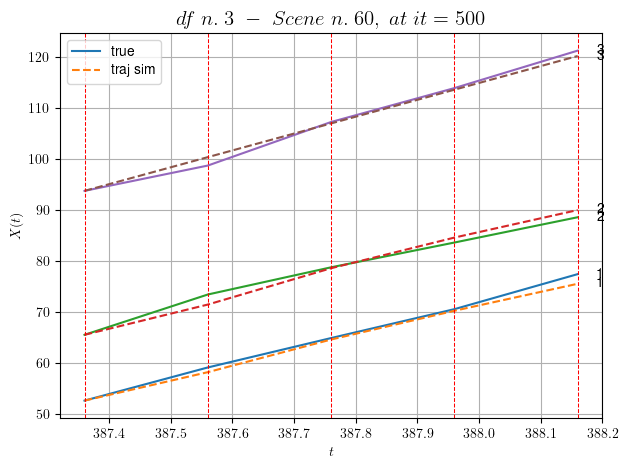

        For scene 60/90
        * use LR_NN=0.0005 with err=16.33610675213045 at it=24
        * v0_scn_mean = 32.84998433908656
        * MAE = 1.028434005186691



df n.3, scene n.61/90
    We have 2 time intervals inside [390.36,390.76]
            - Time interval n.0: [390.36, 390.56]
                * y_true: [34.37306474 33.21473815]
                * v_ann: [32.2855224609375, 31.787866592407227, 36.354260436290275]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [390.56, 390.76]
                * y_true: [31.79338609 29.7348149 ]
                * v_ann: [32.40151596069336, 32.46441650390625, 36.354260436290275]

----------------------------------------------------------------------------------------------------
    * err= 0.5317457372278303
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 5.386741400670303e-05


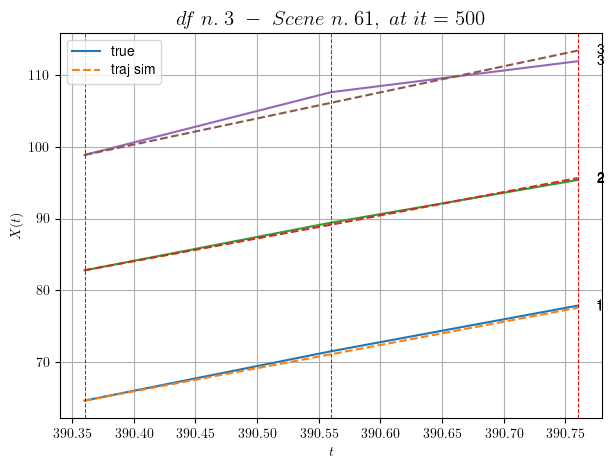

        For scene 61/90
        * use LR_NN=5e-05 with err=1.0485253119985394 at it=24
        * v0_scn_mean = 35.97300509540574
        * MAE = 0.48373826214110843



df n.3, scene n.62/90
    We have 4 time intervals inside [427.96,428.76]
            - Time interval n.0: [427.96, 428.16]
                * y_true: [33.16108667 24.70091575]
                * v_ann: [30.602554321289062, 31.69501304626465, 37.34985617547902]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [428.16, 428.36]
                * y_true: [36.08159054 35.68166414]
                * v_ann: [33.949256896972656, 31.50628662109375, 37.34985617547902]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [428.36, 428.56]
                * y_true: [27.64533545 36.4184567 ]
                * v_ann: [33.075740814208984, 32.738895416259766, 37.34985617547

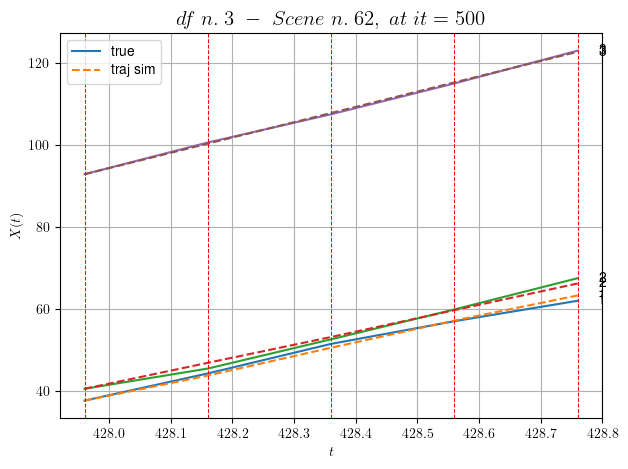

        For scene 62/90
        * use LR_NN=0.0001 with err=72.37710756830337 at it=24
        * v0_scn_mean = 36.9088651349432
        * MAE = 0.44960935158925147



df n.3, scene n.63/90
    We have 3 time intervals inside [439.36,439.96]
            - Time interval n.0: [439.36, 439.56]
                * y_true: [29.12388438 22.06331107]
                * v_ann: [28.0533390045166, 28.1590518951416, 33.53637857273001]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [439.56, 439.76]
                * y_true: [38.07606081 22.99369197]
                * v_ann: [28.367996215820312, 24.06896209716797, 33.53637857273001]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [439.76, 439.96]
                * y_true: [23.98424021 18.65338098]
                * v_ann: [21.302444458007812, 24.683320999145508, 33.53637857273001]

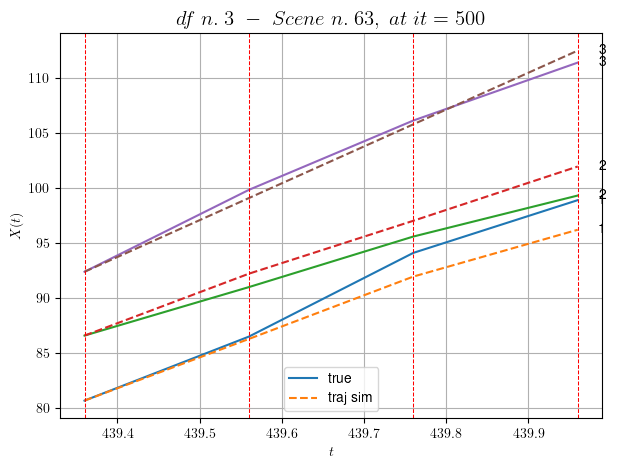

        For scene 63/90
        * use LR_NN=0.001 with err=12.808806625692753 at it=24
        * v0_scn_mean = 33.32419601714205
        * MAE = 1.9975686390996323



df n.3, scene n.64/90
    We have 2 time intervals inside [448.36,448.76]
            - Time interval n.0: [448.36, 448.56]
                * y_true: [32.70350359 27.85524745]
                * v_ann: [33.01637649536133, 32.222618103027344, 31.585048186377207]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [448.56, 448.76]
                * y_true: [39.76511656 28.75604876]
                * v_ann: [32.08310317993164, 31.553869247436523, 31.585048186377207]

----------------------------------------------------------------------------------------------------
    * err= 0.7248174527175636
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.00035043152714708814


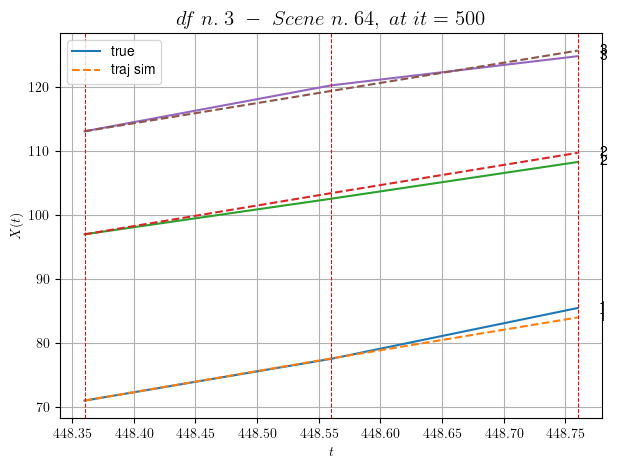

        For scene 64/90
        * use LR_NN=0.0001 with err=0.6419887191685206 at it=24
        * v0_scn_mean = 31.489945366359535
        * MAE = 0.6746592802829486



df n.3, scene n.65/90
    We have 7 time intervals inside [465.16,466.56]
            - Time interval n.0: [465.16, 465.36]
                * y_true: [25.95020905 30.0319773 ]
                * v_ann: [26.331315994262695, 26.074522018432617, 24.722079065128913]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [465.36, 465.56]
                * y_true: [21.30025919 28.782318  ]
                * v_ann: [26.497596740722656, 26.19898223876953, 24.722079065128913]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [465.56, 465.76]
                * y_true: [22.00036741 28.59272475]
                * v_ann: [26.41600227355957, 26.07126235961914, 24.722079065

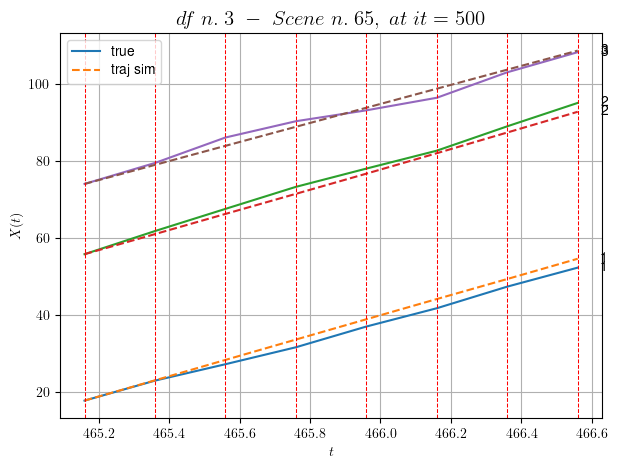

        For scene 65/90
        * use LR_NN=5e-05 with err=63.44828912769236 at it=24
        * v0_scn_mean = 25.038754084253732
        * MAE = 2.132567039089128



df n.3, scene n.66/90
    We have 6 time intervals inside [467.16,468.36]
            - Time interval n.0: [467.16, 467.36]
                * y_true: [14.52040439 29.14139959]
                * v_ann: [20.259925842285156, 20.275117874145508, 20.776262852605416]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [467.36, 467.56]
                * y_true: [ 8.96028804 21.01119683]
                * v_ann: [19.7724609375, 20.03799819946289, 20.776262852605416]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [467.56, 467.76]
                * y_true: [15.62056342 22.22157858]
                * v_ann: [19.75428581237793, 20.013402938842773, 20.776262852605416]

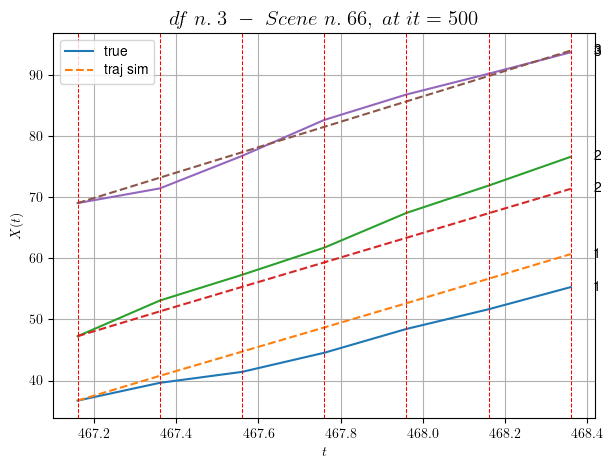

        For scene 66/90
        * use LR_NN=5e-05 with err=16.05083541651899 at it=24
        * v0_scn_mean = 21.329686667323138
        * MAE = 8.792996616758215



df n.3, scene n.67/90
    We have 3 time intervals inside [480.76,481.36]
            - Time interval n.0: [480.76, 480.96]
                * y_true: [26.72145209 13.04113053]
                * v_ann: [18.010650634765625, 18.21027946472168, 18.304841737445233]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [480.96, 481.16]
                * y_true: [27.70182882 12.50117676]
                * v_ann: [17.96208953857422, 18.252424240112305, 18.304841737445233]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [481.16, 481.36]
                * y_true: [16.26121495 12.26123448]
                * v_ann: [18.209253311157227, 18.278488159179688, 18.30484173744

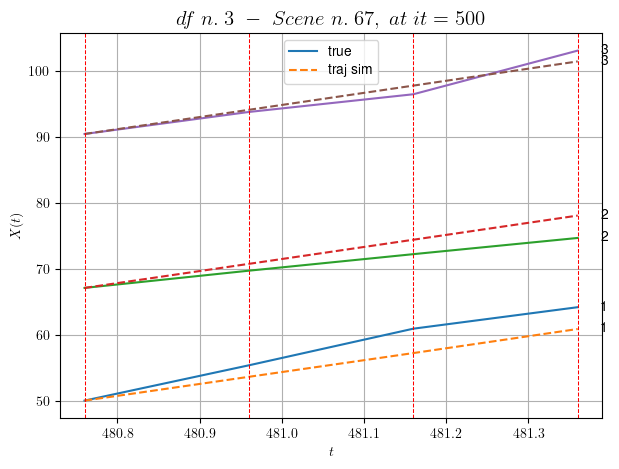

        For scene 67/90
        * use LR_NN=1e-05 with err=15.446218703056985 at it=24
        * v0_scn_mean = 19.00655070811085
        * MAE = 3.9749070316366537



df n.3, scene n.68/90
    We have 2 time intervals inside [487.16,487.56]
            - Time interval n.0: [487.16, 487.36]
                * y_true: [ 6.3002445  28.62315801]
                * v_ann: [14.702838897705078, 14.620628356933594, 23.071831621686396]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.36, 487.56]
                * y_true: [10.63044184 13.60161023]
                * v_ann: [14.572613716125488, 15.015055656433105, 23.071831621686396]

----------------------------------------------------------------------------------------------------
    * err= 2.5677936049125933
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0008433275011712205


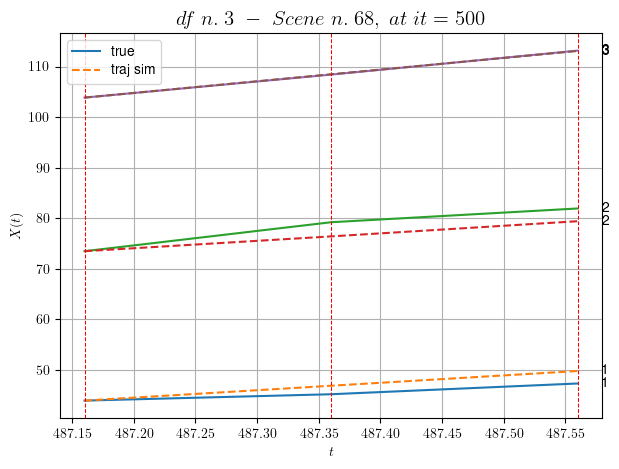

        For scene 68/90
        * use LR_NN=5e-05 with err=3.8821525261340226 at it=24
        * v0_scn_mean = 23.487521413325613
        * MAE = 2.5677936049125933



df n.3, scene n.69/90
    We have 2 time intervals inside [498.56,498.96]
            - Time interval n.0: [498.56, 498.76]
                * y_true: [19.66086018 15.38134444]
                * v_ann: [17.209205627441406, 17.111711502075195, 26.404262964943108]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [498.76, 498.96]
                * y_true: [16.17082592 17.38167269]
                * v_ann: [17.265880584716797, 17.01210594177246, 26.404262964943108]

----------------------------------------------------------------------------------------------------
    * err= 0.18146280182127597
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 1.4144001557914176e-05


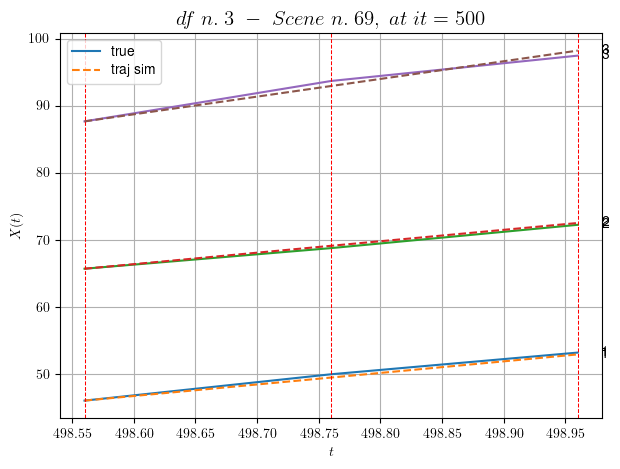

        For scene 69/90
        * use LR_NN=5e-05 with err=0.8295948874314177 at it=24
        * v0_scn_mean = 26.620007025605556
        * MAE = 0.18141272757111113



df n.3, scene n.70/90
    We have 2 time intervals inside [517.96,518.36]
            - Time interval n.0: [517.96, 518.16]
                * y_true: [11.01062169 17.99135838]
                * v_ann: [14.014666557312012, 13.26564884185791, 13.435738688971238]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [518.16, 518.36]
                * y_true: [13.11081201 12.94110202]
                * v_ann: [13.50727653503418, 14.215827941894531, 13.435738688971238]

----------------------------------------------------------------------------------------------------
    * err= 0.27703580768086405
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.00010459690803837907


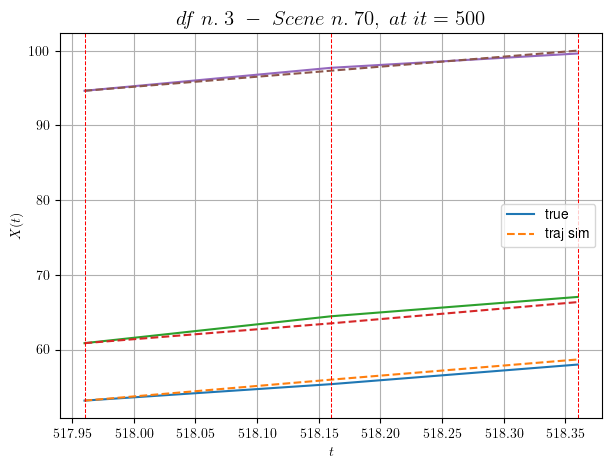

        For scene 70/90
        * use LR_NN=0.001 with err=7.47173475195882 at it=24
        * v0_scn_mean = 14.429593623935423
        * MAE = 0.27653015652052176



df n.3, scene n.71/90
    We have 4 time intervals inside [527.36,528.16]
            - Time interval n.0: [527.36, 527.56]
                * y_true: [14.45064103 23.0016556 ]
                * v_ann: [16.690994262695312, 16.7565975189209, 16.92090602277573]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [527.56, 527.76]
                * y_true: [16.14079976 10.04077962]
                * v_ann: [16.914491653442383, 16.734783172607422, 16.92090602277573]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [527.76, 527.96]
                * y_true: [12.25068777 19.3317022 ]
                * v_ann: [16.673625946044922, 16.656938552856445, 16.920906022775

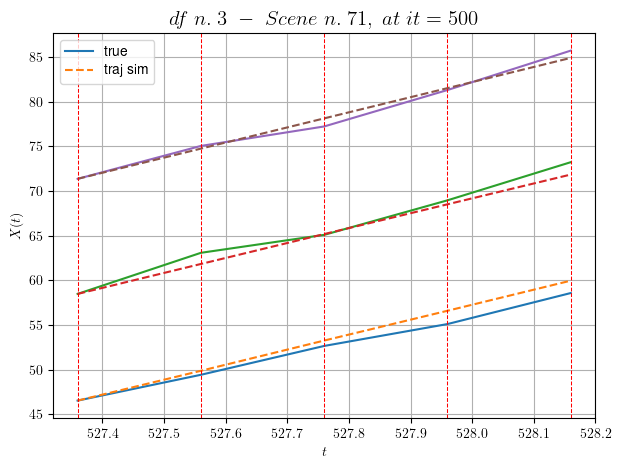

        For scene 71/90
        * use LR_NN=5e-05 with err=14.098880845320053 at it=24
        * v0_scn_mean = 17.705651074185845
        * MAE = 0.6628622677721329



df n.3, scene n.72/90
    We have 3 time intervals inside [530.36,530.96]
            - Time interval n.0: [530.36, 530.56]
                * y_true: [16.07060164 26.13260896]
                * v_ann: [19.998815536499023, 19.1007137298584, 18.054855152783166]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [530.56, 530.76]
                * y_true: [15.14064363 18.85215172]
                * v_ann: [20.44304847717285, 18.95803451538086, 18.054855152783166]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [530.76, 530.96]
                * y_true: [16.69081323 25.36324467]
                * v_ann: [20.562793731689453, 18.703927993774414, 18.05485515278

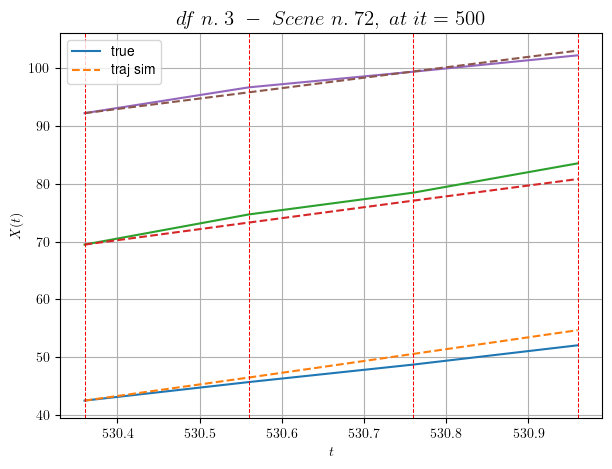

        For scene 72/90
        * use LR_NN=1e-05 with err=11.033795286083654 at it=24
        * v0_scn_mean = 18.77156330730564
        * MAE = 1.9655915241073887



df n.3, scene n.73/90
    We have 6 time intervals inside [576.56,577.76]
            - Time interval n.0: [576.56, 576.76]
                * y_true: [22.12000755 22.50086521]
                * v_ann: [21.458410263061523, 21.12942123413086, 21.516688146761666]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [576.76, 576.96]
                * y_true: [22.90003133 17.69083   ]
                * v_ann: [22.281227111816406, 21.6920223236084, 21.516688146761666]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [576.96, 577.16]
                * y_true: [24.57008129 24.8113942 ]
                * v_ann: [20.772415161132812, 20.703855514526367, 21.51668814676

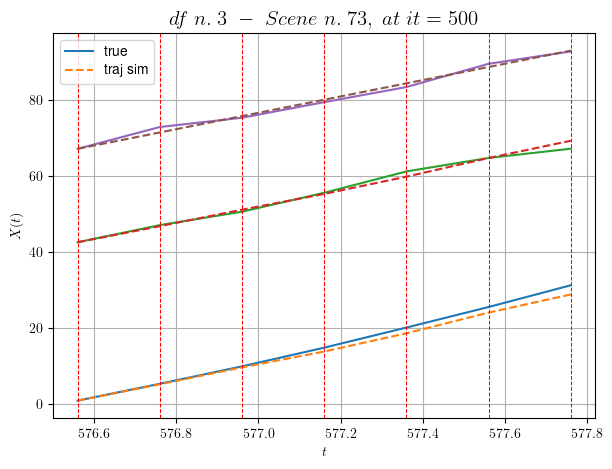

        For scene 73/90
        * use LR_NN=0.0005 with err=19.02045075434943 at it=24
        * v0_scn_mean = 22.025686477073613
        * MAE = 0.6936471261917386



df n.3, scene n.74/90
    We have 5 time intervals inside [579.56,580.56]
            - Time interval n.0: [579.56, 579.76]
                * y_true: [21.03058275 42.18516565]
                * v_ann: [26.555294036865234, 25.66789436340332, 25.358404463470574]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [579.76, 579.96]
                * y_true: [19.36065083 36.06520173]
                * v_ann: [27.089191436767578, 25.521270751953125, 25.358404463470574]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [579.96, 580.16]
                * y_true: [21.76088956 12.96224398]
                * v_ann: [27.438539505004883, 25.289772033691406, 25.35840446

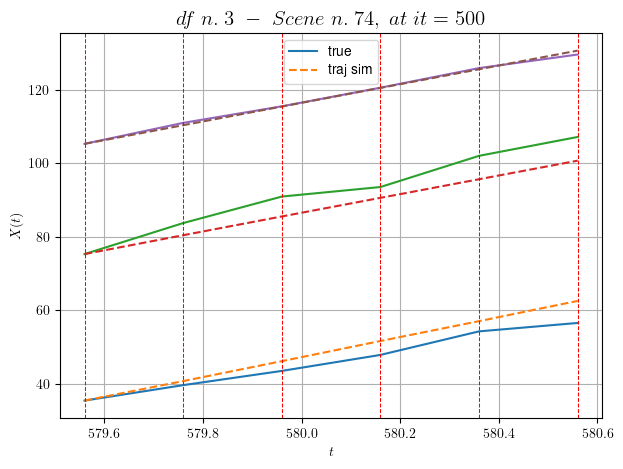

        For scene 74/90
        * use LR_NN=1e-05 with err=37.662249142827 at it=24
        * v0_scn_mean = 25.636899987264936
        * MAE = 11.045840748605846



df n.3, scene n.75/90
    We have 4 time intervals inside [592.16,592.96]
            - Time interval n.0: [592.16, 592.36]
                * y_true: [ 4.45046478 21.56401461]
                * v_ann: [15.829577445983887, 15.51191520690918, 24.70998074865545]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [592.36, 592.56]
                * y_true: [14.40168088 21.61284101]
                * v_ann: [14.608688354492188, 15.153943061828613, 24.70998074865545]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [592.56, 592.76]
                * y_true: [14.40168088 22.933287  ]
                * v_ann: [14.604554176330566, 15.462899208068848, 24.7099807486554

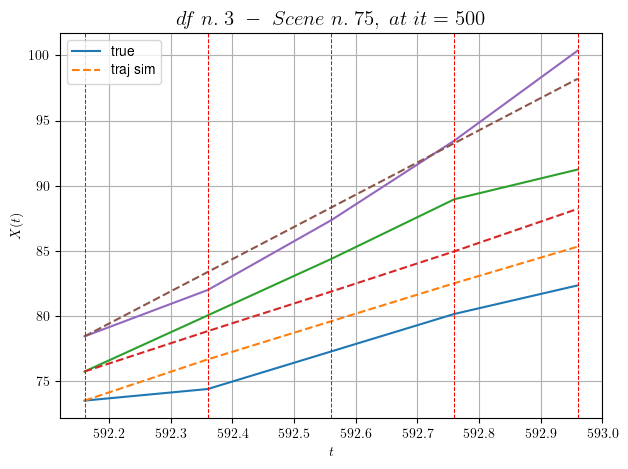

        For scene 75/90
        * use LR_NN=0.001 with err=13.471761647267668 at it=24
        * v0_scn_mean = 25.027381666226187
        * MAE = 3.681913877037306



df n.3, scene n.76/90
    We have 2 time intervals inside [21.56,21.96]
            - Time interval n.0: [21.56, 21.76]
                * y_true: [26.48927836 26.93283237 27.60013316]
                * v_ann: [25.17987632751465, 25.434112548828125, 25.255983352661133, 29.08365839993886]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [21.76, 21.96]
                * y_true: [24.19440937 24.35304119 22.73494812]
                * v_ann: [25.29609489440918, 25.603199005126953, 25.371490478515625, 29.08365839993886]

----------------------------------------------------------------------------------------------------
    * err= 0.09489037354162526
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0001249741203384891


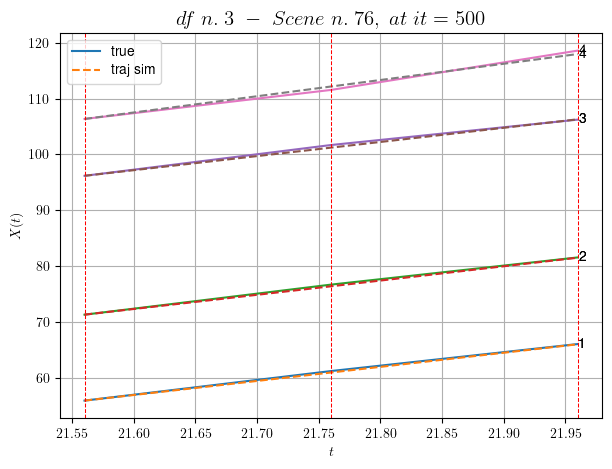

        For scene 76/90
        * use LR_NN=5e-05 with err=3.514508253594998 at it=24
        * v0_scn_mean = 29.156962746047046
        * MAE = 0.09489037354162526



df n.3, scene n.77/90
    We have 3 time intervals inside [31.36,31.96]
            - Time interval n.0: [31.36, 31.56]
                * y_true: [24.92105739 19.11766565 26.56610692]
                * v_ann: [8.480571523250546e-06, 21.433734893798828, 4.836677772225855e-16, 30.91717405915606]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [31.56, 31.76]
                * y_true: [24.72130541 29.91666352 24.00857353]
                * v_ann: [3.219363861717284e-05, 25.586408615112305, 6.332709481248768e-16, 30.91717405915606]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [31.76, 31.96]
                * y_true: [24.58151426  8.80091982 33.80389928

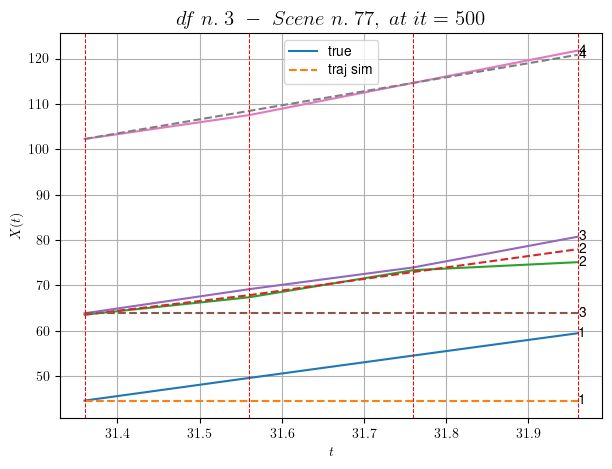

        For scene 77/90
        * use LR_NN=0.001 with err=7.72829286328567 at it=24
        * v0_scn_mean = 30.843803119029175
        * MAE = 4.626669747246993



df n.3, scene n.78/90
    We have 3 time intervals inside [33.76,34.36]
            - Time interval n.0: [33.76, 33.96]
                * y_true: [24.27120267 28.75319668 39.53553599]
                * v_ann: [27.223196029663086, 28.904550552368164, 27.13473129272461, 24.31564748296738]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [33.96, 34.16]
                * y_true: [18.63110748 26.36338094 39.47623422]
                * v_ann: [32.248233795166016, 30.671695709228516, 29.663908004760742, 24.31564748296738]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [34.16, 34.36]
                * y_true: [25.20172426 27.37399424 29.73574355]
              

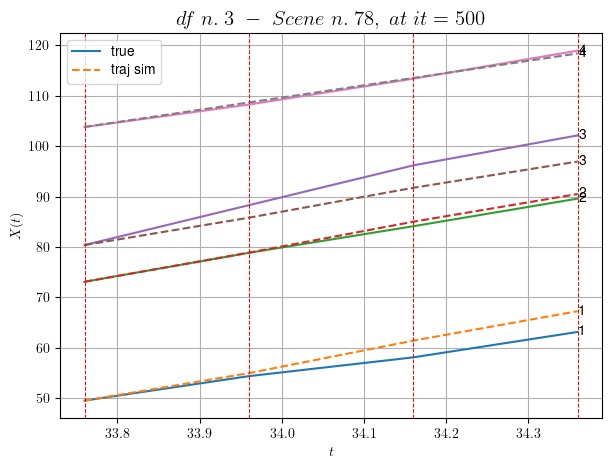

        For scene 78/90
        * use LR_NN=0.001 with err=15.526023352075008 at it=24
        * v0_scn_mean = 24.77037718669547
        * MAE = 4.69944495302742



df n.3, scene n.79/90
    We have 2 time intervals inside [34.96,35.36]
            - Time interval n.0: [34.96, 35.16]
                * y_true: [33.40218228 30.49313647 20.11252108]
                * v_ann: [25.686443328857422, 25.715782165527344, 25.632123947143555, 34.04452453089858]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [35.16, 35.36]
                * y_true: [28.66899207 22.90260208 19.5026699 ]
                * v_ann: [25.970321655273438, 25.93511199951172, 26.107433319091797, 34.04452453089858]

----------------------------------------------------------------------------------------------------
    * err= 1.2379191892591703
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0009685063641167169


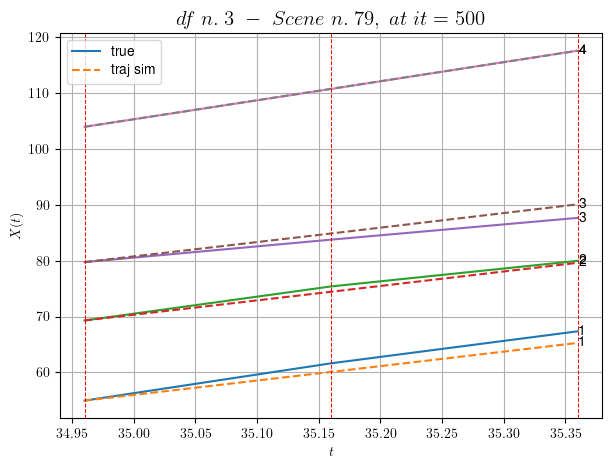

        For scene 79/90
        * use LR_NN=0.0001 with err=9.12157070486641 at it=24
        * v0_scn_mean = 33.720975729844156
        * MAE = 1.1305000695581922



df n.3, scene n.80/90
    We have 6 time intervals inside [83.36,84.56]
            - Time interval n.0: [83.36, 83.56]
                * y_true: [27.1108197  22.97496526 13.79424223]
                * v_ann: [29.894088745117188, 28.652156829833984, 29.496395111083984, 26.107724197314568]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [83.56, 83.76]
                * y_true: [28.73111951 35.1785896  26.83859352]
                * v_ann: [24.231189727783203, 25.74154281616211, 27.29642677307129, 26.107724197314568]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [83.76, 83.96]
                * y_true: [29.25142438 34.77932949 18.27648805]
           

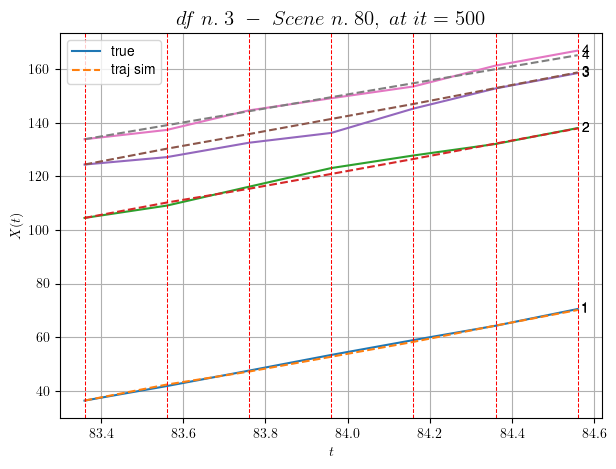

        For scene 80/90
        * use LR_NN=0.0005 with err=104.13223731914013 at it=24
        * v0_scn_mean = 26.419093595549363
        * MAE = 2.496639042172205



df n.3, scene n.81/90
    We have 3 time intervals inside [94.36,94.96]
            - Time interval n.0: [94.36, 94.56]
                * y_true: [33.70387327 38.57908217 21.70251029]
                * v_ann: [29.68640899658203, 30.339452743530273, 29.70452880859375, 29.526156065335076]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [94.56, 94.76]
                * y_true: [29.14386677 24.50535727 32.05702124]
                * v_ann: [32.025177001953125, 28.394332885742188, 32.03942108154297, 29.526156065335076]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [94.76, 94.96]
                * y_true: [29.96461386 30.28702151 28.36707369]
           

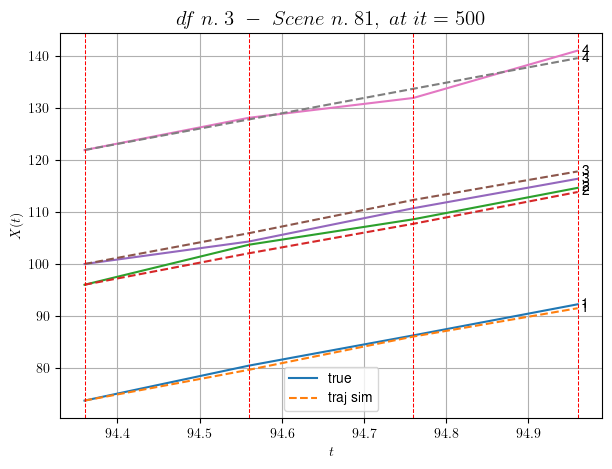

        For scene 81/90
        * use LR_NN=0.001 with err=23.226437665110875 at it=24
        * v0_scn_mean = 29.56406203815747
        * MAE = 1.1144903864821523



df n.3, scene n.82/90
    We have 3 time intervals inside [142.16,142.76]
            - Time interval n.0: [142.16, 142.36]
                * y_true: [31.90177154 33.47450881 19.84324761]
                * v_ann: [23.69104766845703, 25.735393524169922, 24.298721313476562, 28.12123774853807]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [142.36, 142.56]
                * y_true: [31.50218522 24.08376432 24.27420294]
                * v_ann: [27.87538719177246, 27.38174819946289, 29.053407669067383, 28.12123774853807]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [142.56, 142.76]
                * y_true: [24.70204715 30.9853993  17.45337402]
      

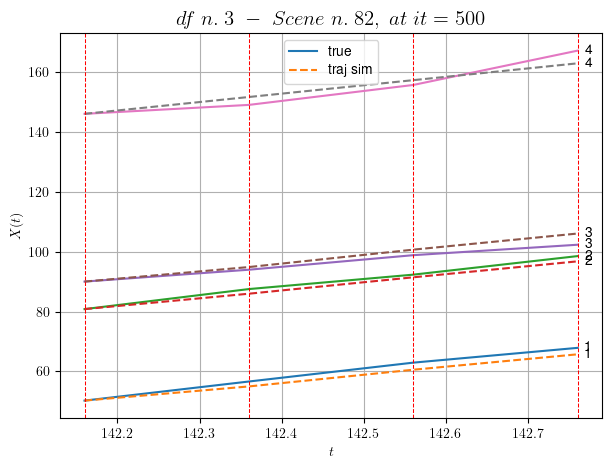

        For scene 82/90
        * use LR_NN=0.0005 with err=30.483537203295942 at it=24
        * v0_scn_mean = 28.271532614914126
        * MAE = 2.759930081931537



df n.3, scene n.83/90
    We have 2 time intervals inside [170.36,170.76]
            - Time interval n.0: [170.36, 170.56]
                * y_true: [24.1106547  30.95205085 31.86307572]
                * v_ann: [25.504905700683594, 25.731586456298828, 25.267688751220703, 32.996539935657715]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [28.33103197 10.10076519 29.63331411]
                * v_ann: [26.105220794677734, 26.170940399169922, 26.051956176757812, 32.996539935657715]

----------------------------------------------------------------------------------------------------
    * err= 0.9876330464705954
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.00011066839296702824


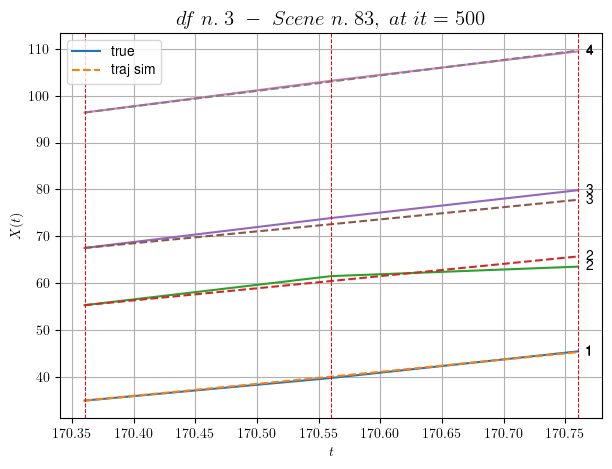

        For scene 83/90
        * use LR_NN=0.0001 with err=1.9287596732938013 at it=24
        * v0_scn_mean = 32.75682649194194
        * MAE = 0.983130460315073



df n.3, scene n.84/90
    We have 2 time intervals inside [248.16,248.56]
            - Time interval n.0: [248.16, 248.36]
                * y_true: [31.21204442 24.6823336  32.34552948]
                * v_ann: [31.949512481689453, 33.5179557800293, 29.564430236816406, 30.248970609827406]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [248.36, 248.56]
                * y_true: [31.9625999  29.77329807 35.48696999]
                * v_ann: [28.688858032226562, 28.701705932617188, 32.408363342285156, 30.248970609827406]

----------------------------------------------------------------------------------------------------
    * err= 0.6759563266505577
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0018800170051643805


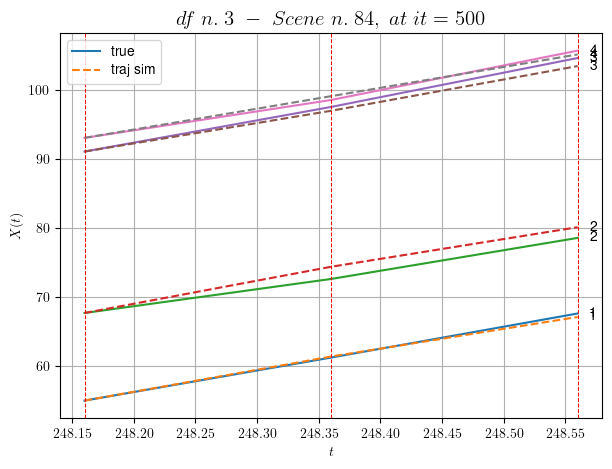

        For scene 84/90
        * use LR_NN=0.001 with err=17.19945782185932 at it=24
        * v0_scn_mean = 30.22905377122442
        * MAE = 0.6759563266505577



df n.3, scene n.85/90
    We have 3 time intervals inside [320.56,321.16]
            - Time interval n.0: [320.56, 320.76]
                * y_true: [27.61038846 20.60122903 24.07186814]
                * v_ann: [29.213523864746094, 28.976816177368164, 29.199291229248047, 28.130140949141946]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [320.76, 320.96]
                * y_true: [30.26064275 26.25184013 33.56317876]
                * v_ann: [28.685867309570312, 28.77192497253418, 28.703353881835938, 28.130140949141946]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [320.96, 321.16]
                * y_true: [38.25114958 30.20253063 29.36323845]
   

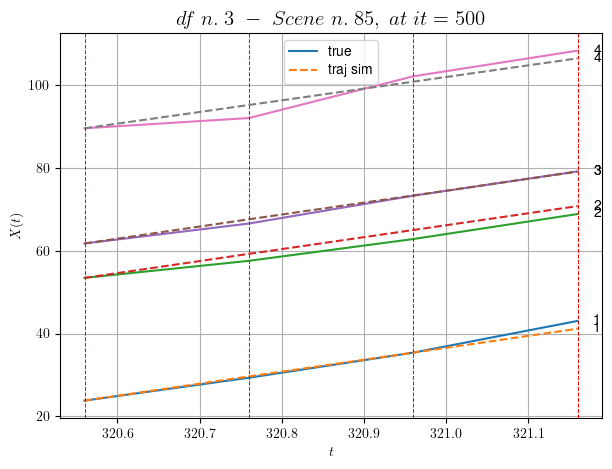

        For scene 85/90
        * use LR_NN=5e-05 with err=8.469478899141276 at it=24
        * v0_scn_mean = 28.27972358844236
        * MAE = 1.8508571876905542



df n.3, scene n.86/90
    We have 3 time intervals inside [333.96,334.56]
            - Time interval n.0: [333.96, 334.16]
                * y_true: [31.40121985 21.58136302 16.05156144]
                * v_ann: [29.565067291259766, 29.39424705505371, 29.457717895507812, 24.218775367789018]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [334.16, 334.36]
                * y_true: [27.67132891 33.9725354  36.25406589]
                * v_ann: [29.364809036254883, 29.10710906982422, 29.002986907958984, 24.218775367789018]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [334.36, 334.56]
                * y_true: [23.81145278 36.52334008 36.85496039]
    

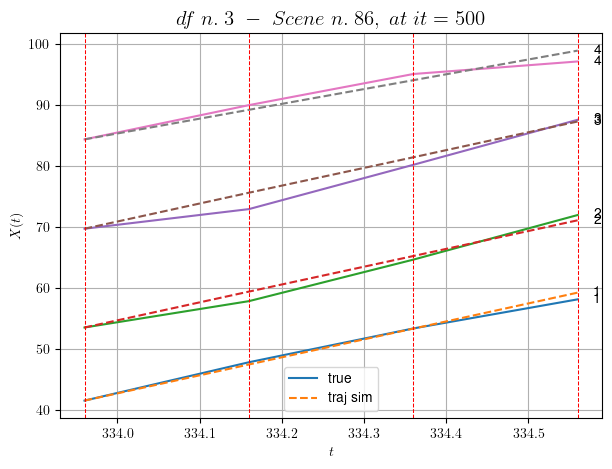

        For scene 86/90
        * use LR_NN=5e-05 with err=4.435863904549066 at it=24
        * v0_scn_mean = 24.68125452549606
        * MAE = 1.1482643216624853



df n.3, scene n.87/90
    We have 2 time intervals inside [393.36,393.76]
            - Time interval n.0: [393.36, 393.56]
                * y_true: [28.21049617 36.91227562 35.66212709]
                * v_ann: [8.629899572731858e-11, 31.269161224365234, -8.571231219425757e-23, 27.006293536405785]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [393.56, 393.76]
                * y_true: [27.89067116 17.24119841 30.82238865]
                * v_ann: [6.890681601701143e-12, 27.519500732421875, -4.815819272992801e-21, 27.006293536405785]

----------------------------------------------------------------------------------------------------
    * err= 33.20021443671174
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.00477713331

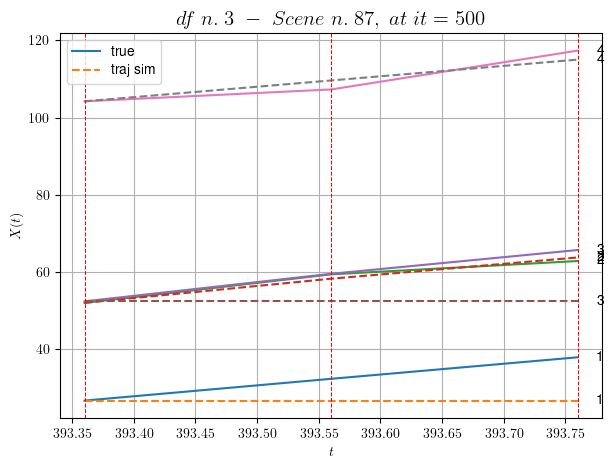

        For scene 87/90
        * use LR_NN=0.001 with err=8.195761948295855 at it=24
        * v0_scn_mean = 27.245780311576308
        * MAE = 5.653310054535993



df n.3, scene n.88/90
    We have 5 time intervals inside [521.76,522.76]
            - Time interval n.0: [521.76, 521.96]
                * y_true: [10.54036018 15.07054541 11.30098461]
                * v_ann: [16.558130264282227, 15.31958293914795, 15.557579040527344, 17.247787667046502]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [521.96, 522.16]
                * y_true: [20.11080333 12.92054275 19.50185752]
                * v_ann: [16.06903648376465, 14.018985748291016, 14.524627685546875, 17.247787667046502]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [522.16, 522.36]
                * y_true: [16.31074126 16.85079656 12.50130097]
    

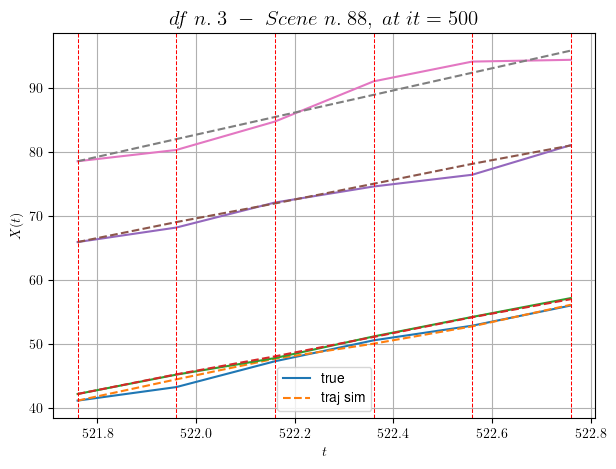

        For scene 88/90
        * use LR_NN=0.001 with err=23.285366246930476 at it=24
        * v0_scn_mean = 18.26792315629884
        * MAE = 0.776783145317756



df n.3, scene n.89/90
    We have 2 time intervals inside [95.36,95.76]
            - Time interval n.0: [95.36, 95.56]
                * y_true: [30.52238998 38.21809619 31.62683865 21.81676128]
                * v_ann: [25.21722984313965, 28.684532165527344, 23.291444778442383, 29.43444061279297, 33.3513742869813]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [95.56, 95.76]
                * y_true: [29.11270185 26.43618159 23.59563306 15.73527867]
                * v_ann: [31.08892822265625, 24.683517456054688, 26.505050659179688, 26.302324295043945, 33.3513742869813]

----------------------------------------------------------------------------------------------------
    * err= 2.066131885029775
    * Learning rate NN = 0.000364499

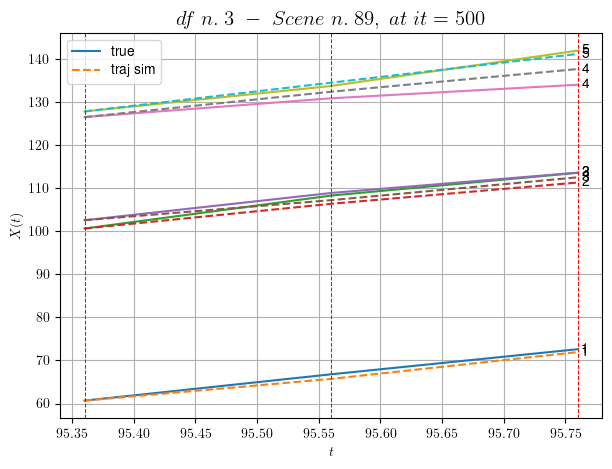

        For scene 89/90
        * use LR_NN=0.0005 with err=13.707896214064295 at it=24
        * v0_scn_mean = 33.016376876139645
        * MAE = 2.0545169628704594



For df=3 with 90 scenes, time taken:        1606.05
****************************************************************************************************
****************************************************************************************************
In df n.4/10 we have 69 scenes
df n.4, scene n.0/69
    We have 6 time intervals inside [16.84,18.04]
            - Time interval n.0: [16.84, 17.04]
                * y_true: [25.23041912]
                * v_ann: [26.523595809936523, 17.45381353810987]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [17.04, 17.24]
                * y_true: [22.39048591]
                * v_ann: [26.205421447753906, 17.45381353810987]

------------------------------------------------------------------

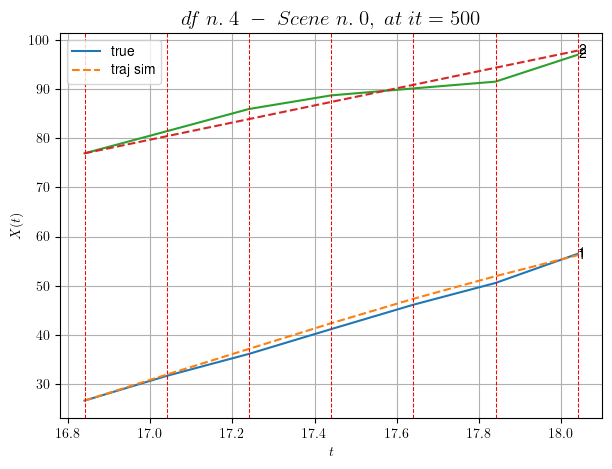

        For scene 0/69
        * use LR_NN=1e-05 with err=47.28593724096135 at it=24
        * v0_scn_mean = 17.9556609964896
        * MAE = 1.5941283754326707



df n.4, scene n.1/69
    We have 3 time intervals inside [59.84,60.44]
            - Time interval n.0: [59.84, 60.04]
                * y_true: [11.16089253]
                * v_ann: [13.310869216918945, 18.625518273300347]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [60.04, 60.24]
                * y_true: [15.2413343]
                * v_ann: [15.683959007263184, 18.625518273300347]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [60.24, 60.44]
                * y_true: [17.42164177]
                * v_ann: [15.046360969543457, 18.625518273300347]

---------------------------------------------------------------------------------------------------

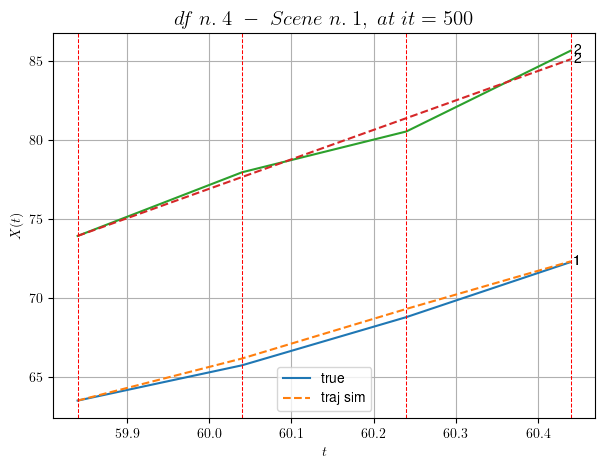

        For scene 1/69
        * use LR_NN=5e-05 with err=9.096081082921005 at it=24
        * v0_scn_mean = 19.08049754228143
        * MAE = 0.19405114161225112



df n.4, scene n.2/69
    We have 3 time intervals inside [65.04,65.64]
            - Time interval n.0: [65.04, 65.24]
                * y_true: [37.33460222]
                * v_ann: [29.36418914794922, 37.419037421482926]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [65.24, 65.44]
                * y_true: [30.99428227]
                * v_ann: [29.15886116027832, 37.419037421482926]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [65.44, 65.64]
                * y_true: [23.47378049]
                * v_ann: [32.40263748168945, 37.419037421482926]

---------------------------------------------------------------------------------------------------

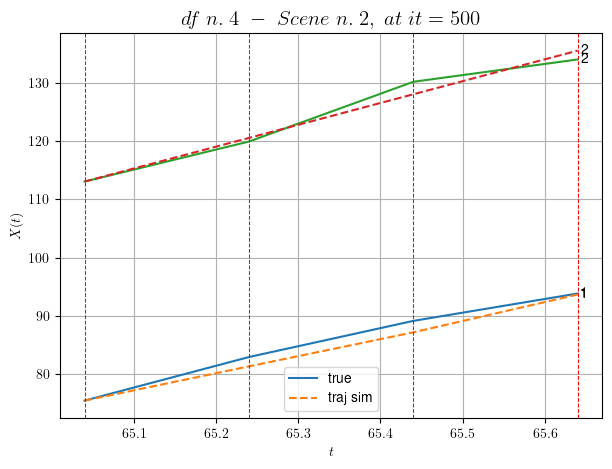

        For scene 2/69
        * use LR_NN=1e-05 with err=5.299412995341025 at it=24
        * v0_scn_mean = 37.12227592468073
        * MAE = 1.7069367904221548



df n.4, scene n.3/69
    We have 2 time intervals inside [67.64,68.04]
            - Time interval n.0: [67.64, 67.84]
                * y_true: [20.95295595]
                * v_ann: [21.069034576416016, 28.464980007712466]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [67.84, 68.04]
                * y_true: [28.30446421]
                * v_ann: [28.216976165771484, 28.464980007712466]

----------------------------------------------------------------------------------------------------
    * err= 0.1653468477518047
    * Learning rate NN = 0.00036449998151510954
    * diff = 3.06593519922016e-06


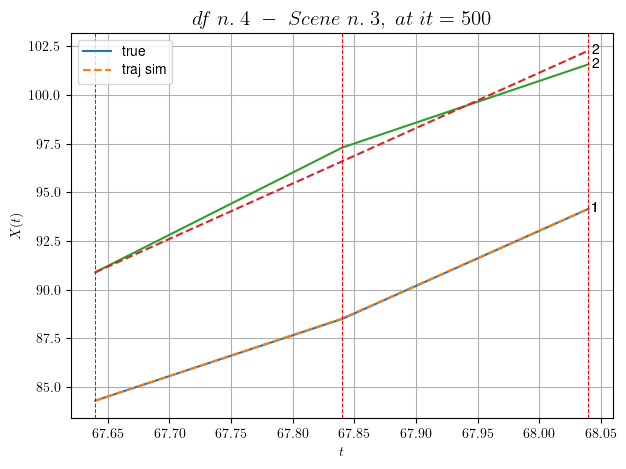

        For scene 3/69
        * use LR_NN=0.0005 with err=0.31645693823320975 at it=24
        * v0_scn_mean = 28.5263808073923
        * MAE = 0.1653468477518047



df n.4, scene n.4/69
    We have 3 time intervals inside [78.44,79.04]
    * err= 0.07408607790478397
    * Learning rate NN = 8.099998922261875e-06
    * diff = 3.743050914772894e-07


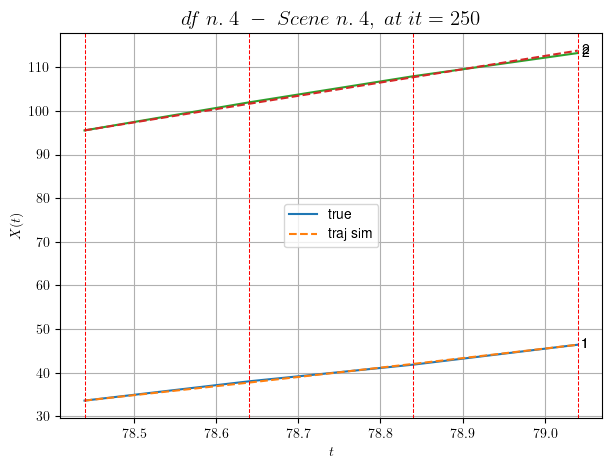

        For scene 4/69
        * use LR_NN=1e-05 with err=0.07270016553604827 at it=24
        * v0_scn_mean = 30.448769923223654
        * MAE = 0.06869045200446644



df n.4, scene n.5/69
    We have 13 time intervals inside [110.64,113.24]
            - Time interval n.0: [110.64, 110.84]
                * y_true: [10.80033908]
                * v_ann: [14.427109718322754, 20.71594392412393]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [110.84, 111.04]
                * y_true: [12.76045781]
                * v_ann: [16.632844924926758, 20.71594392412393]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [111.04, 111.24]
                * y_true: [13.29051772]
                * v_ann: [18.889476776123047, 20.71594392412393]

---------------------------------------------------------------------------------------

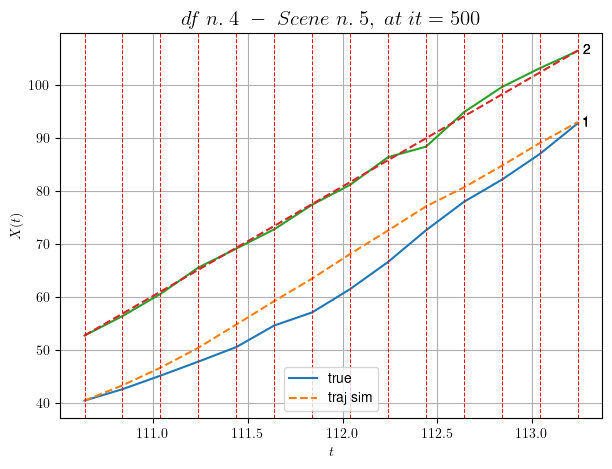

        For scene 5/69
        * use LR_NN=0.001 with err=101.22821535265686 at it=24
        * v0_scn_mean = 21.087306167088084
        * MAE = 3.2149238021566533



df n.4, scene n.6/69
    We have 5 time intervals inside [122.84,123.84]
            - Time interval n.0: [122.84, 123.04]
                * y_true: [15.65157815]
                * v_ann: [9.45917797088623, 25.259320008419273]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [123.04, 123.24]
                * y_true: [3.90041857]
                * v_ann: [13.868070602416992, 25.259320008419273]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [123.24, 123.44]
                * y_true: [14.6217105]
                * v_ann: [21.019140243530273, 25.259320008419273]

-------------------------------------------------------------------------------------------

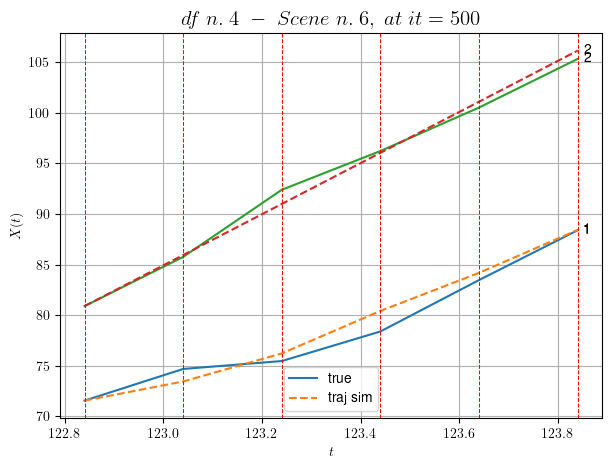

        For scene 6/69
        * use LR_NN=0.001 with err=5.423375781961067 at it=24
        * v0_scn_mean = 25.448947208046327
        * MAE = 0.752792858021918



df n.4, scene n.7/69
    We have 5 time intervals inside [128.24,129.24]
            - Time interval n.0: [128.24, 128.44]
                * y_true: [14.81009626]
                * v_ann: [15.840078353881836, 23.00518102872618]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [128.44, 128.64]
                * y_true: [14.95013258]
                * v_ann: [15.762970924377441, 23.00518102872618]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [128.64, 128.84]
                * y_true: [16.91019825]
                * v_ann: [16.164566040039062, 23.00518102872618]

--------------------------------------------------------------------------------------------

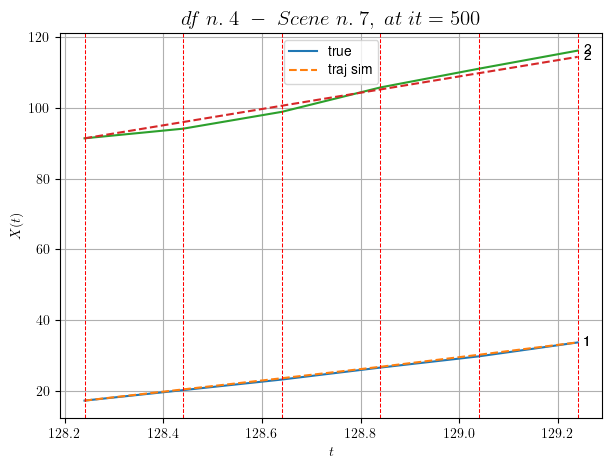

        For scene 7/69
        * use LR_NN=1e-05 with err=7.595975462369643 at it=24
        * v0_scn_mean = 23.28497378752336
        * MAE = 0.8391613443779434



df n.4, scene n.8/69
    We have 15 time intervals inside [129.84,132.84]
            - Time interval n.0: [129.84, 130.04]
                * y_true: [24.3308993]
                * v_ann: [18.3923397064209, 21.06853424485247]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [130.04, 130.24]
                * y_true: [25.1311264]
                * v_ann: [21.32171058654785, 21.06853424485247]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [130.24, 130.44]
                * y_true: [18.02095029]
                * v_ann: [21.982866287231445, 21.06853424485247]

------------------------------------------------------------------------------------------------

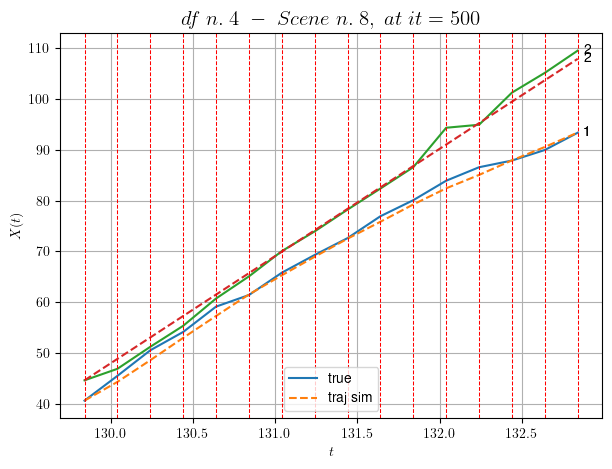

        For scene 8/69
        * use LR_NN=0.001 with err=119.17120984573194 at it=24
        * v0_scn_mean = 21.4257928749903
        * MAE = 1.5034816625698748



df n.4, scene n.9/69
    We have 4 time intervals inside [136.64,137.44]
            - Time interval n.0: [136.64, 136.84]
                * y_true: [17.67050411]
                * v_ann: [17.524425506591797, 25.540461045118512]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [136.84, 137.04]
                * y_true: [20.80072476]
                * v_ann: [18.388988494873047, 25.540461045118512]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [137.04, 137.24]
                * y_true: [22.26092051]
                * v_ann: [18.727293014526367, 25.540461045118512]

-----------------------------------------------------------------------------------------

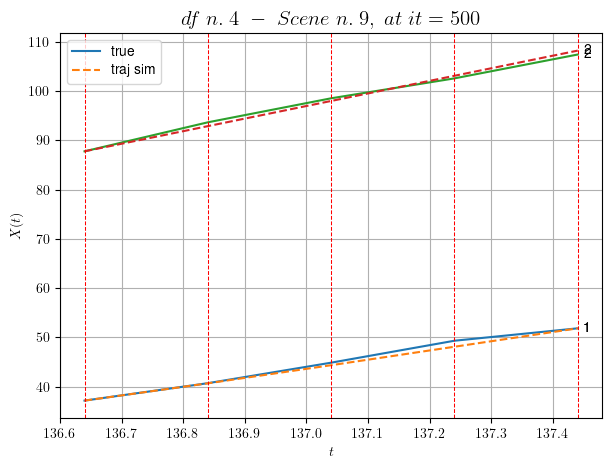

        For scene 9/69
        * use LR_NN=1e-05 with err=3.3183210923049296 at it=24
        * v0_scn_mean = 25.718842603279864
        * MAE = 0.35426484854927487



df n.4, scene n.10/69
    We have 4 time intervals inside [151.04,151.84]
    * err= 0.15422609996447384
    * Learning rate NN = 7.289998757187277e-05
    * diff = 1.8595244899444197e-07


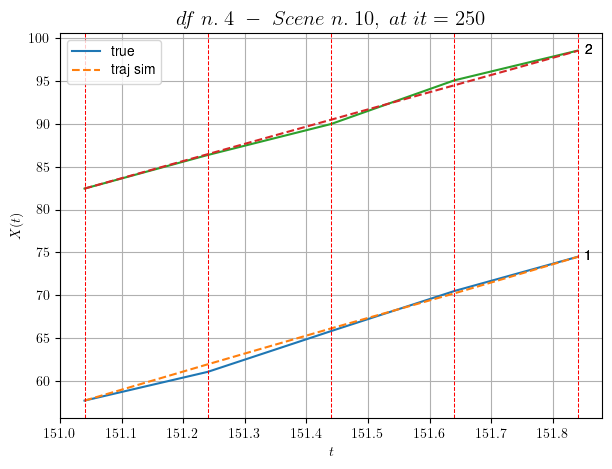

        For scene 10/69
        * use LR_NN=0.0001 with err=11.641346283104179 at it=24
        * v0_scn_mean = 20.888331244249486
        * MAE = 0.15315972909170747



df n.4, scene n.11/69
    We have 2 time intervals inside [153.04,153.44]
            - Time interval n.0: [153.04, 153.24]
                * y_true: [34.43447026]
                * v_ann: [31.328672409057617, 23.385109048523574]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [153.24, 153.44]
                * y_true: [25.55379665]
                * v_ann: [28.93345069885254, 23.385109048523574]

----------------------------------------------------------------------------------------------------
    * err= 0.07868099949605292
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 8.554083579981331e-05


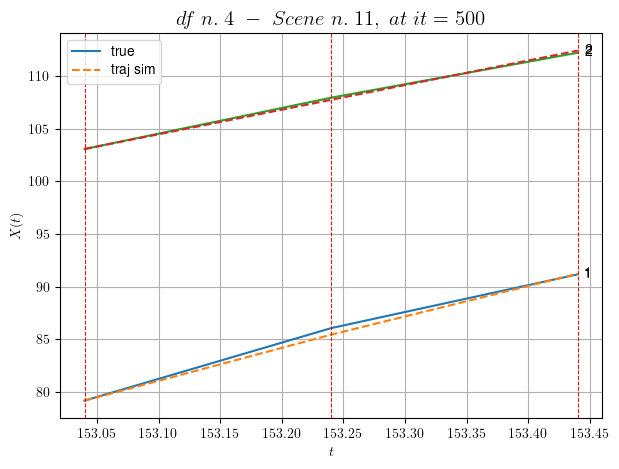

        For scene 11/69
        * use LR_NN=5e-05 with err=1.6328154468025926 at it=24
        * v0_scn_mean = 23.649704686532115
        * MAE = 0.07824088405938193



df n.4, scene n.12/69
    We have 6 time intervals inside [173.24,174.44]
            - Time interval n.0: [173.24, 173.44]
                * y_true: [11.93089915]
                * v_ann: [20.074867248535156, 26.312487041783747]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [173.44, 173.64]
                * y_true: [18.52159277]
                * v_ann: [22.713703155517578, 26.312487041783747]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [173.64, 173.84]
                * y_true: [30.92298077]
                * v_ann: [23.224815368652344, 26.312487041783747]

------------------------------------------------------------------------------------

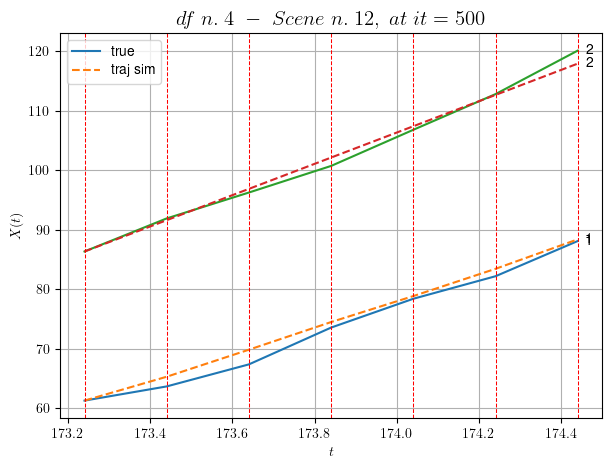

        For scene 12/69
        * use LR_NN=1e-05 with err=4.259565986505275 at it=24
        * v0_scn_mean = 26.45998756008448
        * MAE = 1.3370350169285854



df n.4, scene n.13/69
    We have 5 time intervals inside [176.24,177.24]
            - Time interval n.0: [176.24, 176.44]
                * y_true: [19.93138519]
                * v_ann: [14.171055793762207, 27.94819777081733]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [176.44, 176.64]
                * y_true: [13.15101712]
                * v_ann: [14.764204025268555, 27.94819777081733]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [176.64, 176.84]
                * y_true: [20.45180955]
                * v_ann: [17.493728637695312, 27.94819777081733]

------------------------------------------------------------------------------------------

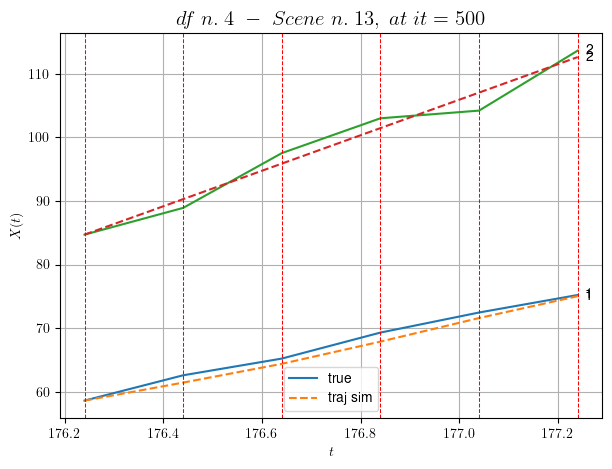

        For scene 13/69
        * use LR_NN=0.0001 with err=2.5287034375607753 at it=24
        * v0_scn_mean = 28.030269859968794
        * MAE = 1.7410326632893147



df n.4, scene n.14/69
    We have 8 time intervals inside [182.04,183.64]
            - Time interval n.0: [182.04, 182.24]
                * y_true: [12.8202906]
                * v_ann: [21.481042861938477, 24.384953428579415]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [182.24, 182.44]
                * y_true: [13.125309]
                * v_ann: [22.880447387695312, 24.384953428579415]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [182.44, 182.64]
                * y_true: [21.64870909]
                * v_ann: [22.807767868041992, 24.384953428579415]

---------------------------------------------------------------------------------------

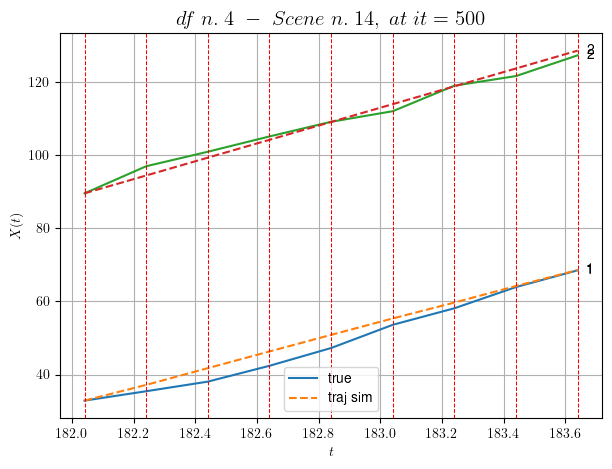

        For scene 14/69
        * use LR_NN=5e-05 with err=19.053458559057432 at it=24
        * v0_scn_mean = 24.60955529139356
        * MAE = 3.6401040039913592



df n.4, scene n.15/69
    We have 9 time intervals inside [195.44,197.24]
            - Time interval n.0: [195.44, 195.64]
                * y_true: [9.85670669]
                * v_ann: [10.537825584411621, 16.73844314065949]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [195.64, 195.84]
                * y_true: [10.16548364]
                * v_ann: [10.092642784118652, 16.73844314065949]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [195.84, 196.04]
                * y_true: [10.16548364]
                * v_ann: [9.763603210449219, 16.73844314065949]

-------------------------------------------------------------------------------------------

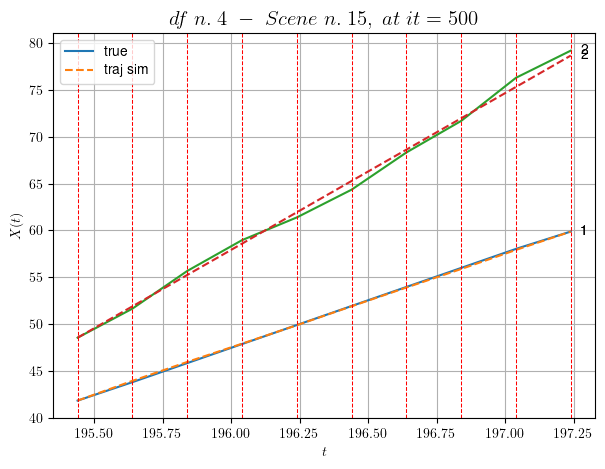

        For scene 15/69
        * use LR_NN=0.005 with err=100.27086352785754 at it=24
        * v0_scn_mean = 17.268905414931616
        * MAE = 0.14855109464111527



df n.4, scene n.16/69
    We have 3 time intervals inside [199.64,200.24]
            - Time interval n.0: [199.64, 199.84]
                * y_true: [16.38215778]
                * v_ann: [14.882568359375, 16.019151603836185]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [199.84, 200.04]
                * y_true: [14.86205621]
                * v_ann: [13.710007667541504, 16.019151603836185]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [200.04, 200.24]
                * y_true: [11.24167368]
                * v_ann: [14.040641784667969, 16.019151603836185]

---------------------------------------------------------------------------------------

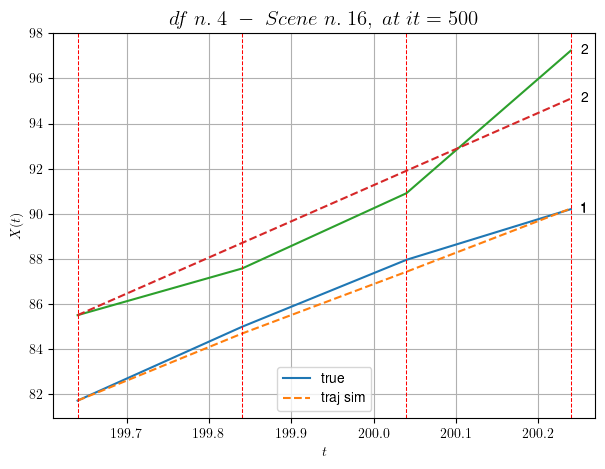

        For scene 16/69
        * use LR_NN=0.0005 with err=12.292619512231763 at it=24
        * v0_scn_mean = 16.578385539576228
        * MAE = 0.814590527271587



df n.4, scene n.17/69
    We have 5 time intervals inside [205.84,206.84]
            - Time interval n.0: [205.84, 206.04]
                * y_true: [11.12077713]
                * v_ann: [9.496478080749512, 14.204943221368154]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [206.04, 206.24]
                * y_true: [13.1509984]
                * v_ann: [9.74891471862793, 14.204943221368154]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [206.24, 206.44]
                * y_true: [9.19074148]
                * v_ann: [10.129683494567871, 14.204943221368154]

------------------------------------------------------------------------------------------

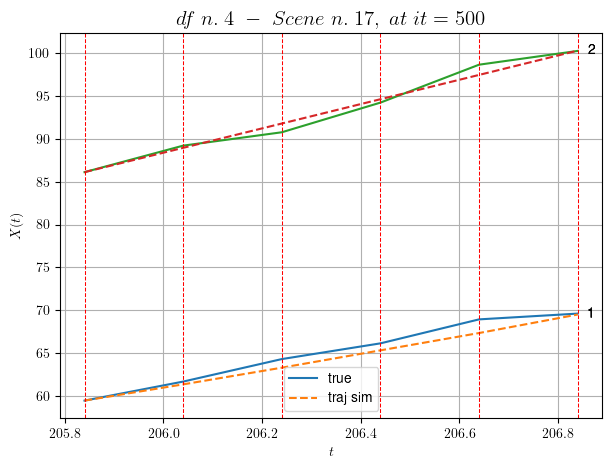

        For scene 17/69
        * use LR_NN=0.0001 with err=45.57130203097043 at it=24
        * v0_scn_mean = 14.836745492392984
        * MAE = 0.5699440503191214



df n.4, scene n.18/69
    We have 2 time intervals inside [258.04,258.44]
            - Time interval n.0: [258.04, 258.24]
                * y_true: [8.65094482]
                * v_ann: [18.141437530517578, 26.487815883435907]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [258.24, 258.44]
                * y_true: [29.00349395]
                * v_ann: [21.3355655670166, 26.487815883435907]

----------------------------------------------------------------------------------------------------
    * err= 0.7970580865557291
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0029313788162722565


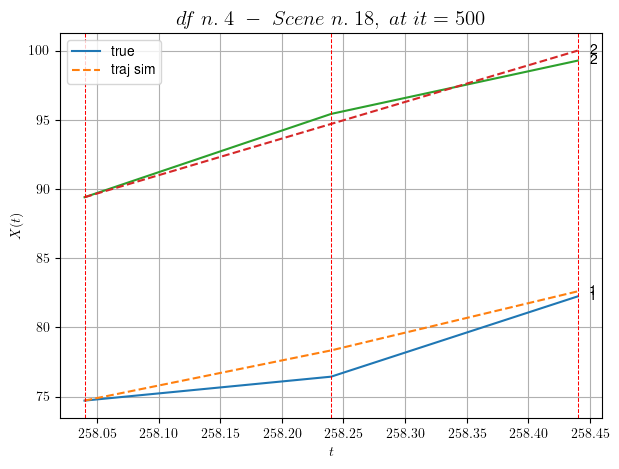

        For scene 18/69
        * use LR_NN=5e-05 with err=1.1104527705324776 at it=24
        * v0_scn_mean = 26.628303248070335
        * MAE = 0.7970580865557291



df n.4, scene n.19/69
    We have 11 time intervals inside [266.84,269.04]
            - Time interval n.0: [266.84, 267.04]
                * y_true: [25.85178656]
                * v_ann: [13.53014087677002, 22.59999558463882]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [267.04, 267.24]
                * y_true: [0.50003797]
                * v_ann: [13.497803688049316, 22.59999558463882]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [267.24, 267.44]
                * y_true: [18.0014362]
                * v_ann: [15.365955352783203, 22.59999558463882]

------------------------------------------------------------------------------------------

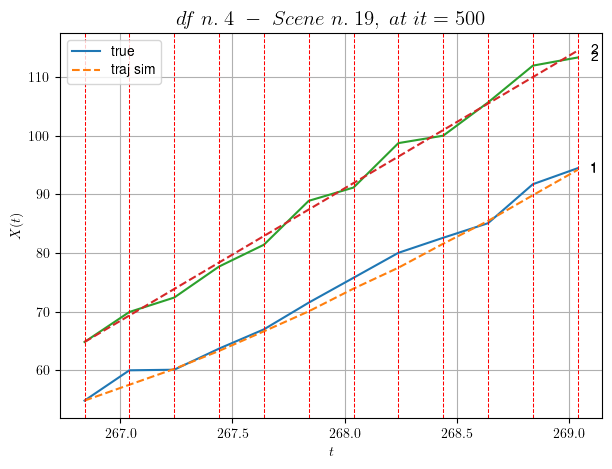

        For scene 19/69
        * use LR_NN=1e-05 with err=48.123096205617735 at it=24
        * v0_scn_mean = 22.89599576119687
        * MAE = 1.7742566538337974



df n.4, scene n.20/69
    We have 8 time intervals inside [285.84,287.44]
            - Time interval n.0: [285.84, 286.04]
                * y_true: [9.53034992]
                * v_ann: [19.84841537475586, 24.201830847422496]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [286.04, 286.24]
                * y_true: [14.93061978]
                * v_ann: [19.337417602539062, 24.201830847422496]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [286.24, 286.44]
                * y_true: [12.82475396]
                * v_ann: [19.05165672302246, 24.201830847422496]

-----------------------------------------------------------------------------------------

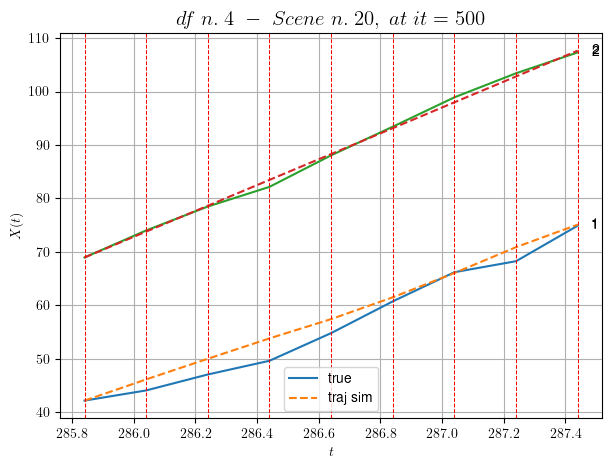

        For scene 20/69
        * use LR_NN=0.0005 with err=16.462602348487817 at it=24
        * v0_scn_mean = 24.433757613481248
        * MAE = 1.647147501822293



df n.4, scene n.21/69
    We have 5 time intervals inside [288.04,289.04]
            - Time interval n.0: [288.04, 288.24]
                * y_true: [15.93157223]
                * v_ann: [10.173246383666992, 22.24789971530882]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [288.24, 288.44]
                * y_true: [13.91151456]
                * v_ann: [9.156149864196777, 22.24789971530882]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [288.44, 288.64]
                * y_true: [10.99127146]
                * v_ann: [10.831283569335938, 22.24789971530882]

-----------------------------------------------------------------------------------------

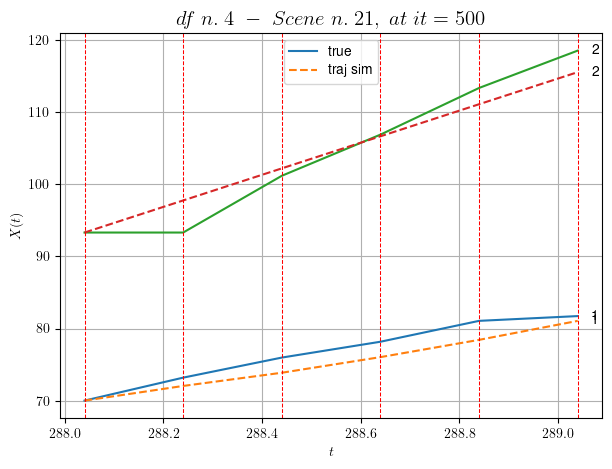

        For scene 21/69
        * use LR_NN=1e-05 with err=10.407852295006057 at it=24
        * v0_scn_mean = 22.557983726637982
        * MAE = 3.2547676511342676



df n.4, scene n.22/69
    We have 6 time intervals inside [301.64,302.84]
            - Time interval n.0: [301.64, 301.84]
                * y_true: [26.55139863]
                * v_ann: [23.831987380981445, 22.529252631155007]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [301.84, 302.04]
                * y_true: [20.20126147]
                * v_ann: [23.785282135009766, 22.529252631155007]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [302.04, 302.24]
                * y_true: [22.80164674]
                * v_ann: [23.889606475830078, 22.529252631155007]

-------------------------------------------------------------------------------------

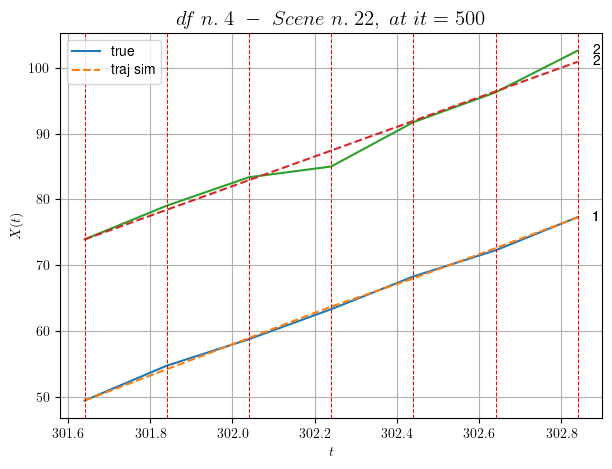

        For scene 22/69
        * use LR_NN=5e-05 with err=14.626514552495406 at it=24
        * v0_scn_mean = 22.828082525851766
        * MAE = 0.7183494018001138



df n.4, scene n.23/69
    We have 3 time intervals inside [320.44,321.04]
            - Time interval n.0: [320.44, 320.64]
                * y_true: [19.06248224]
                * v_ann: [21.88680076599121, 14.162426648993204]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [320.64, 320.84]
                * y_true: [25.04354334]
                * v_ann: [21.43661880493164, 14.162426648993204]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [320.84, 321.04]
                * y_true: [15.51237997]
                * v_ann: [16.494625091552734, 14.162426648993204]

---------------------------------------------------------------------------------------

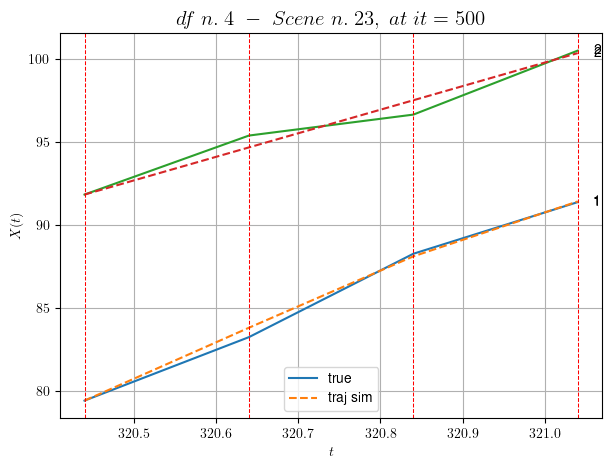

        For scene 23/69
        * use LR_NN=5e-05 with err=18.218368094108396 at it=24
        * v0_scn_mean = 14.7959295829119
        * MAE = 0.20212601641111774



df n.4, scene n.24/69
    We have 10 time intervals inside [321.84,323.84]
            - Time interval n.0: [321.84, 322.04]
                * y_true: [15.91100184]
                * v_ann: [13.524856567382812, 22.81009773351766]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [322.04, 322.24]
                * y_true: [21.52151253]
                * v_ann: [14.86728286743164, 22.81009773351766]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [322.24, 322.44]
                * y_true: [17.33136036]
                * v_ann: [15.340386390686035, 22.81009773351766]

-----------------------------------------------------------------------------------------

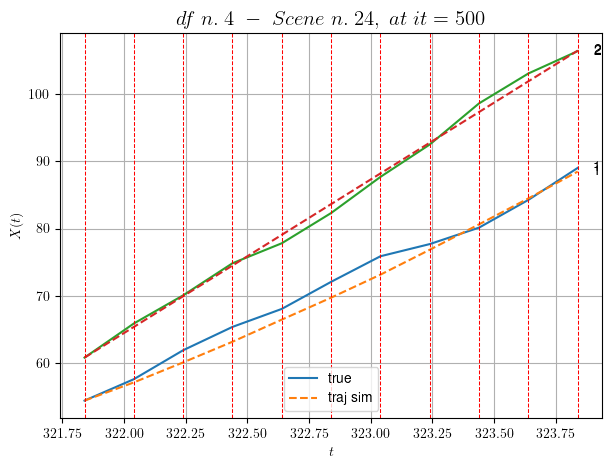

        For scene 24/69
        * use LR_NN=0.001 with err=37.89203145319821 at it=24
        * v0_scn_mean = 23.09769382412263
        * MAE = 1.1778652521992343



df n.4, scene n.25/69
    We have 4 time intervals inside [374.24,375.04]
            - Time interval n.0: [374.24, 374.44]
                * y_true: [17.78133038]
                * v_ann: [18.430561065673828, 20.475722036934293]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [374.44, 374.64]
                * y_true: [17.27142996]
                * v_ann: [18.251680374145508, 20.475722036934293]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [374.64, 374.84]
                * y_true: [14.48134888]
                * v_ann: [18.08580780029297, 20.475722036934293]

----------------------------------------------------------------------------------------

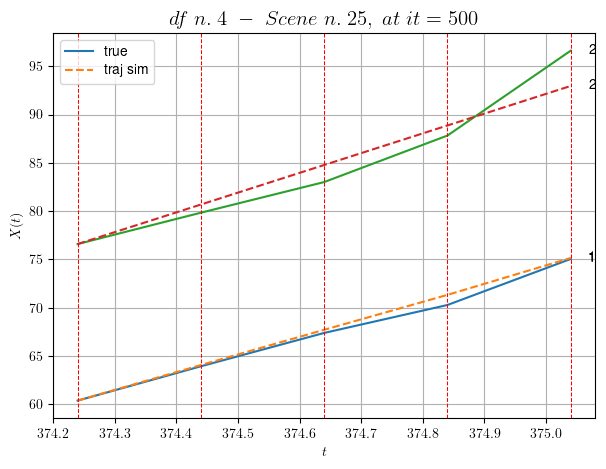

        For scene 25/69
        * use LR_NN=1e-05 with err=10.06644900148092 at it=24
        * v0_scn_mean = 20.856693155384146
        * MAE = 1.794955774561549



df n.4, scene n.26/69
    We have 3 time intervals inside [378.64,379.24]
            - Time interval n.0: [378.64, 378.84]
                * y_true: [24.80186931]
                * v_ann: [19.18134880065918, 21.986682448765226]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [378.84, 379.04]
                * y_true: [6.27054296]
                * v_ann: [19.52051544189453, 21.986682448765226]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [379.04, 379.24]
                * y_true: [27.25270249]
                * v_ann: [20.283557891845703, 21.986682448765226]

------------------------------------------------------------------------------------------

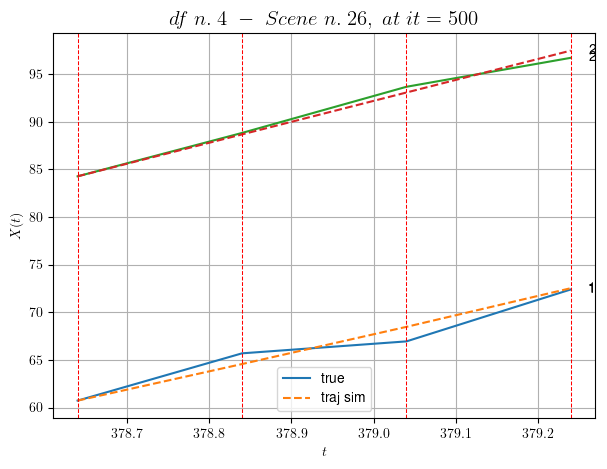

        For scene 26/69
        * use LR_NN=0.0001 with err=5.484249544130256 at it=24
        * v0_scn_mean = 22.307215150753006
        * MAE = 0.5682389863125211



df n.4, scene n.27/69
    We have 4 time intervals inside [387.64,388.44]
            - Time interval n.0: [387.64, 387.84]
                * y_true: [13.24162412]
                * v_ann: [18.014606475830078, 23.572406443207264]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [387.84, 388.04]
                * y_true: [25.47337037]
                * v_ann: [15.507607460021973, 23.572406443207264]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [388.04, 388.24]
                * y_true: [19.81289117]
                * v_ann: [17.561233520507812, 23.572406443207264]

-------------------------------------------------------------------------------------

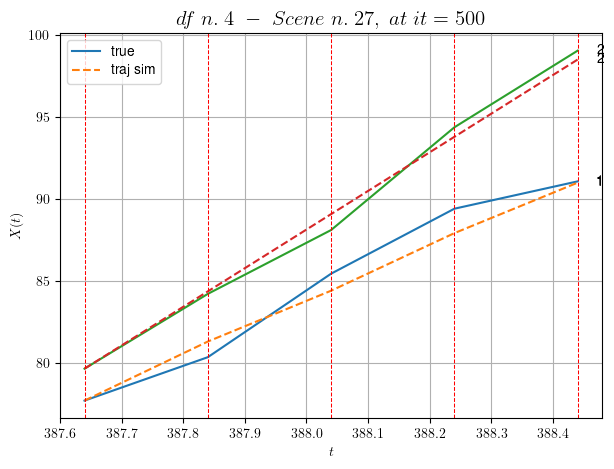

        For scene 27/69
        * use LR_NN=0.0005 with err=7.5943841458250985 at it=24
        * v0_scn_mean = 23.829510185426344
        * MAE = 0.5812407487139069



df n.4, scene n.28/69
    We have 3 time intervals inside [399.24,399.84]
            - Time interval n.0: [399.24, 399.44]
                * y_true: [21.7511121]
                * v_ann: [17.217973709106445, 24.512386475296193]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [399.44, 399.64]
                * y_true: [18.26102056]
                * v_ann: [18.981338500976562, 24.512386475296193]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [399.64, 399.84]
                * y_true: [15.72103462]
                * v_ann: [19.244661331176758, 24.512386475296193]

-------------------------------------------------------------------------------------

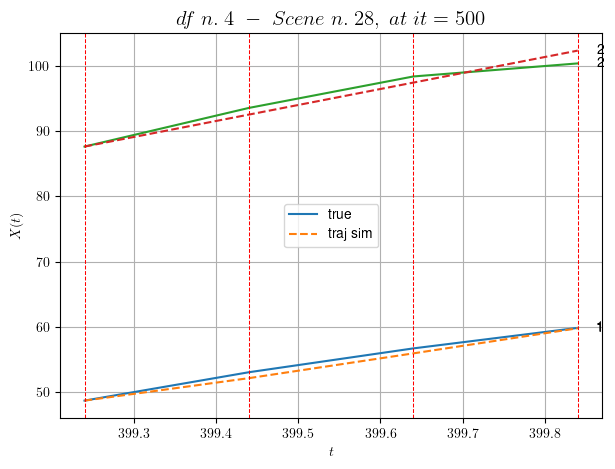

        For scene 28/69
        * use LR_NN=5e-05 with err=3.8660863123928744 at it=24
        * v0_scn_mean = 24.731891016242542
        * MAE = 0.8943041054344775



df n.4, scene n.29/69
    We have 2 time intervals inside [406.24,406.64]
            - Time interval n.0: [406.24, 406.44]
                * y_true: [28.52295146]
                * v_ann: [23.70299530029297, 18.926519541433994]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [406.44, 406.64]
                * y_true: [18.07207404]
                * v_ann: [23.4759578704834, 18.926519541433994]

----------------------------------------------------------------------------------------------------
    * err= 0.1592174357212016
    * Learning rate NN = 7.289998848136747e-06
    * diff = 9.472513135955207e-05


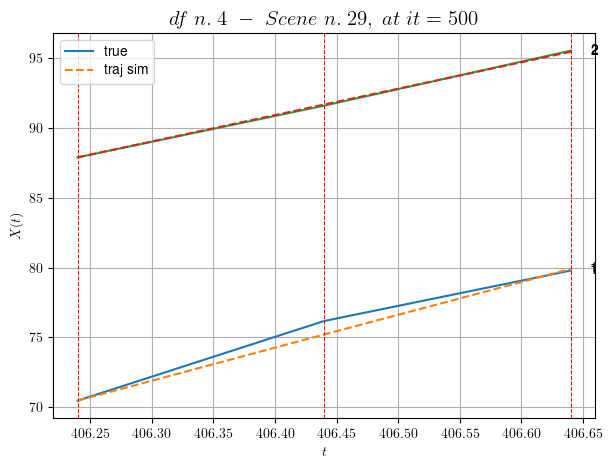

        For scene 29/69
        * use LR_NN=1e-05 with err=4.130443850555196 at it=24
        * v0_scn_mean = 19.369458759691895
        * MAE = 0.15876935932050115



df n.4, scene n.30/69
    We have 10 time intervals inside [408.84,410.84]
            - Time interval n.0: [408.84, 409.04]
                * y_true: [15.25021324]
                * v_ann: [18.711118698120117, 20.951718350918537]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [409.04, 409.24]
                * y_true: [19.57034716]
                * v_ann: [18.94590187072754, 20.951718350918537]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [409.24, 409.44]
                * y_true: [20.90046989]
                * v_ann: [19.222923278808594, 20.951718350918537]

-------------------------------------------------------------------------------------

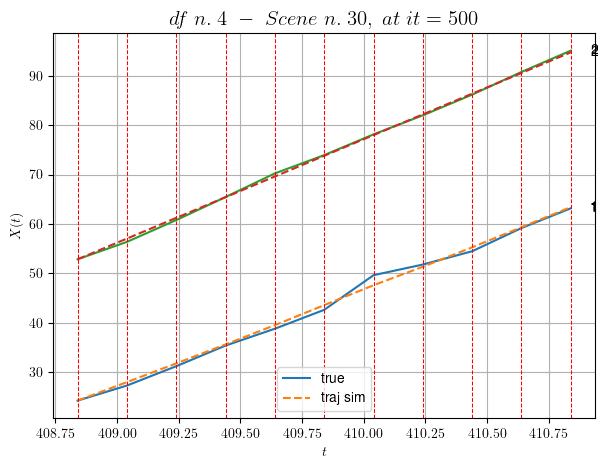

        For scene 30/69
        * use LR_NN=1e-05 with err=56.864432948779516 at it=24
        * v0_scn_mean = 21.31364961681277
        * MAE = 0.3920704792002204



df n.4, scene n.31/69
    We have 2 time intervals inside [411.84,412.24]
            - Time interval n.0: [411.84, 412.04]
                * y_true: [12.04108576]
                * v_ann: [15.488424301147461, 15.182121050296947]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [412.04, 412.24]
                * y_true: [18.83181821]
                * v_ann: [15.383769989013672, 15.182121050296947]

----------------------------------------------------------------------------------------------------
    * err= 0.12839555648395976
    * Learning rate NN = 7.289998848136747e-06
    * diff = 2.1698953658805253e-05


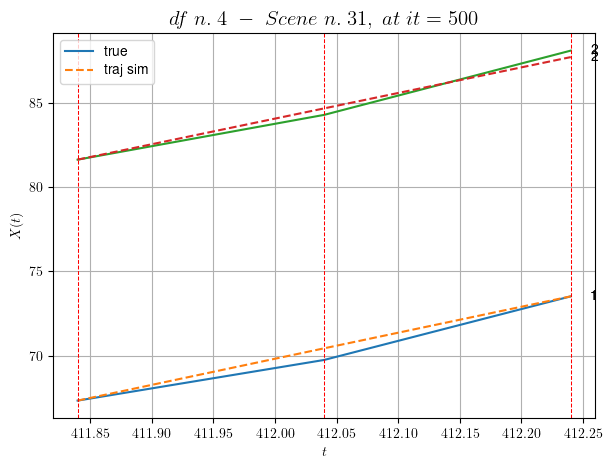

        For scene 31/69
        * use LR_NN=1e-05 with err=7.054229676333208 at it=24
        * v0_scn_mean = 15.774836208171946
        * MAE = 0.12357631676964131



df n.4, scene n.32/69
    We have 10 time intervals inside [419.84,421.84]
            - Time interval n.0: [419.84, 420.04]
                * y_true: [17.73058344]
                * v_ann: [14.512749671936035, 25.806420226564228]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [420.04, 420.24]
                * y_true: [26.13095885]
                * v_ann: [16.249435424804688, 25.806420226564228]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [420.24, 420.44]
                * y_true: [16.22073507]
                * v_ann: [14.777756690979004, 25.806420226564228]

------------------------------------------------------------------------------------

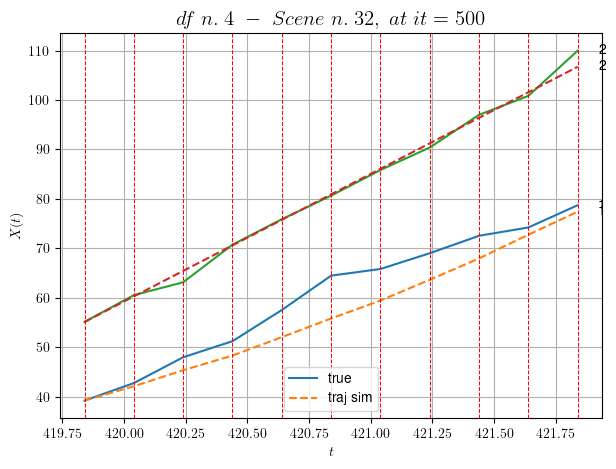

        For scene 32/69
        * use LR_NN=0.0005 with err=15.724510219679228 at it=24
        * v0_scn_mean = 25.974163417469637
        * MAE = 5.029356424496263



df n.4, scene n.33/69
    We have 5 time intervals inside [439.24,440.24]
            - Time interval n.0: [439.24, 439.44]
                * y_true: [15.24141643]
                * v_ann: [20.7142276763916, 21.563926495541395]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [439.44, 439.64]
                * y_true: [28.0128448]
                * v_ann: [21.14618682861328, 21.563926495541395]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [439.64, 439.84]
                * y_true: [20.81245375]
                * v_ann: [21.291929244995117, 21.563926495541395]

-----------------------------------------------------------------------------------------

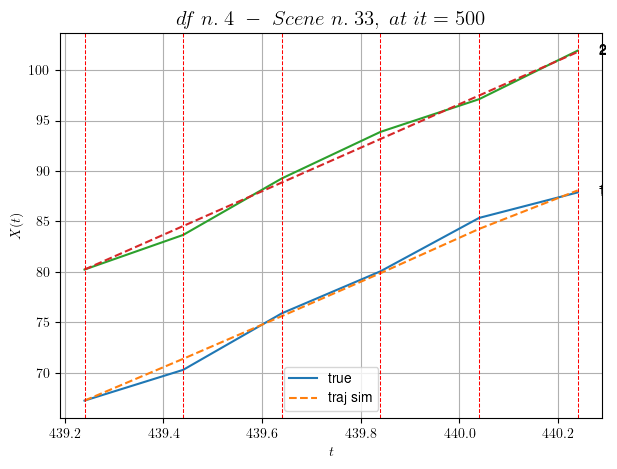

        For scene 33/69
        * use LR_NN=5e-05 with err=13.035953611123329 at it=24
        * v0_scn_mean = 21.901369435655788
        * MAE = 0.3426934246531219



df n.4, scene n.34/69
    We have 2 time intervals inside [479.84,480.24]
    * err= 0.00642159455259143
    * Learning rate NN = 8.999999408842996e-05
    * diff = 3.247637470130127e-07


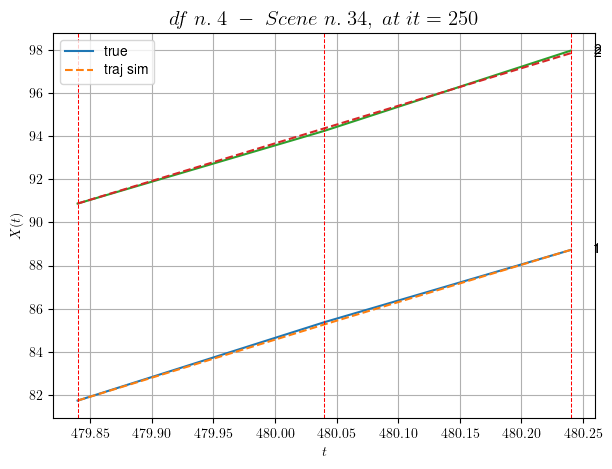

        For scene 34/69
        * use LR_NN=0.0001 with err=5.163717543723969 at it=24
        * v0_scn_mean = 18.447542569451826
        * MAE = 0.005981494110130973



df n.4, scene n.35/69
    We have 2 time intervals inside [481.24,481.64]
            - Time interval n.0: [481.24, 481.44]
                * y_true: [25.25379303]
                * v_ann: [27.844478607177734, 20.40371725522892]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [481.44, 481.64]
                * y_true: [29.69507773]
                * v_ann: [26.250429153442383, 20.40371725522892]

----------------------------------------------------------------------------------------------------
    * err= 0.7604244879730715
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0020060933981087548


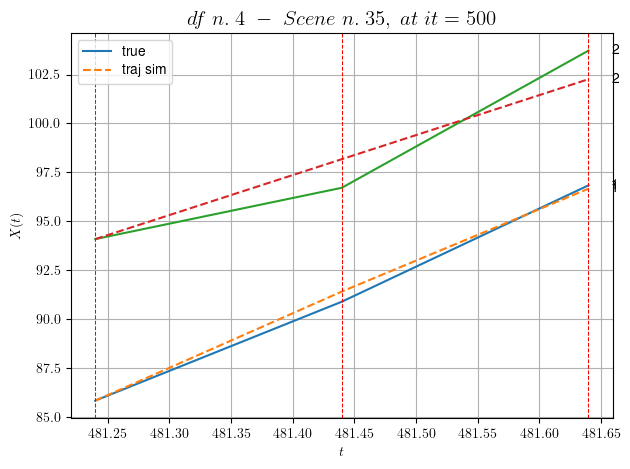

        For scene 35/69
        * use LR_NN=0.0001 with err=3.113595109719647 at it=24
        * v0_scn_mean = 20.787568564946138
        * MAE = 0.7199597800814188



df n.4, scene n.36/69
    We have 5 time intervals inside [500.04,501.04]
            - Time interval n.0: [500.04, 500.24]
                * y_true: [29.61179117]
                * v_ann: [19.328174591064453, 21.189572495102297]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [500.24, 500.44]
                * y_true: [8.70055091]
                * v_ann: [18.20134735107422, 21.189572495102297]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [500.44, 500.64]
                * y_true: [13.8710234]
                * v_ann: [19.92616081237793, 21.189572495102297]

-----------------------------------------------------------------------------------------

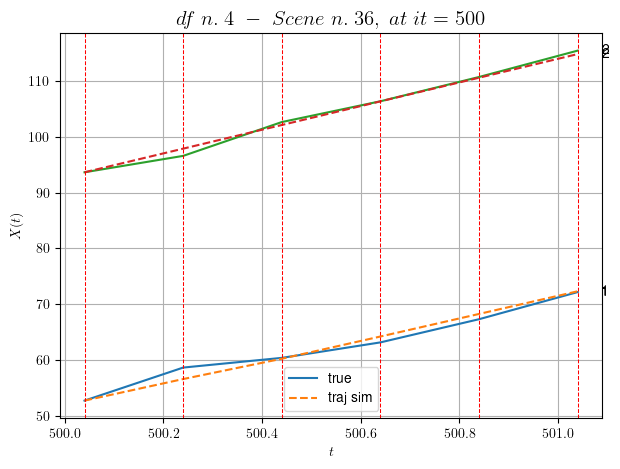

        For scene 36/69
        * use LR_NN=1e-05 with err=14.017139746050649 at it=24
        * v0_scn_mean = 21.54198959523119
        * MAE = 0.7130374571837387



df n.4, scene n.37/69
    We have 12 time intervals inside [566.84,569.24]
            - Time interval n.0: [566.84, 567.04]
                * y_true: [18.52025877]
                * v_ann: [21.00251007080078, 20.028487582197105]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [567.04, 567.24]
                * y_true: [19.89036758]
                * v_ann: [20.789249420166016, 20.028487582197105]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [567.24, 567.44]
                * y_true: [15.89035891]
                * v_ann: [20.291818618774414, 20.028487582197105]

--------------------------------------------------------------------------------------

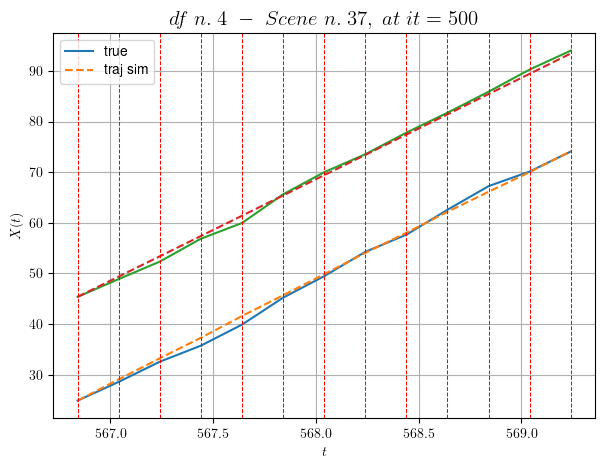

        For scene 37/69
        * use LR_NN=0.0001 with err=96.50736051102426 at it=24
        * v0_scn_mean = 20.427348078833457
        * MAE = 0.47365803921975436



df n.4, scene n.38/69
    We have 3 time intervals inside [584.84,585.44]
            - Time interval n.0: [584.84, 585.04]
                * y_true: [32.88340113]
                * v_ann: [28.506980895996094, 25.889440529704235]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [585.04, 585.24]
                * y_true: [28.11341581]
                * v_ann: [27.877634048461914, 25.889440529704235]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [585.24, 585.44]
                * y_true: [23.09315201]
                * v_ann: [27.842714309692383, 25.889440529704235]

------------------------------------------------------------------------------------

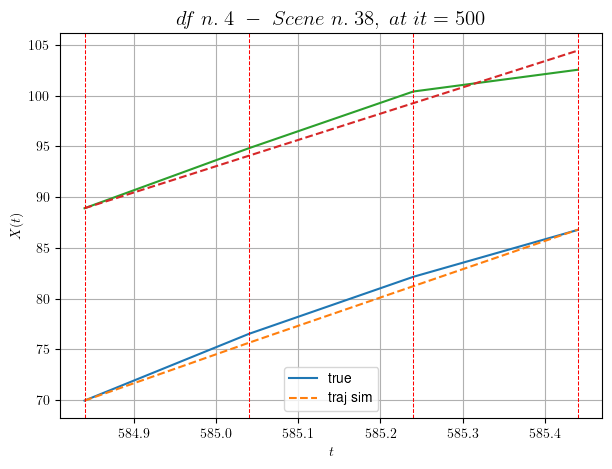

        For scene 38/69
        * use LR_NN=5e-05 with err=2.615848452770595 at it=24
        * v0_scn_mean = 26.053862908484813
        * MAE = 0.8794010516296695



df n.4, scene n.39/69
    We have 2 time intervals inside [7.04,7.44]
            - Time interval n.0: [7.04, 7.24]
                * y_true: [ 8.37556318 26.1843701 ]
                * v_ann: [10.447982788085938, 11.386673927307129, 36.15423035610224]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [7.24, 7.44]
                * y_true: [12.54090657 23.03433042]
                * v_ann: [25.285106658935547, 15.225678443908691, 36.15423035610224]

----------------------------------------------------------------------------------------------------
    * err= 4.270978580721983
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.24327491109508514


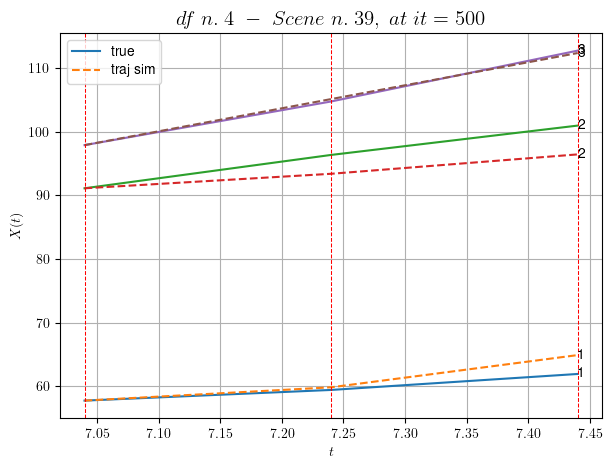

        For scene 39/69
        * use LR_NN=0.001 with err=11.301466314252487 at it=24
        * v0_scn_mean = 35.784976811047734
        * MAE = 4.270978580721983



df n.4, scene n.40/69
    We have 2 time intervals inside [19.84,20.24]
            - Time interval n.0: [19.84, 20.04]
                * y_true: [38.50393497 35.76621737]
                * v_ann: [30.598867416381836, 27.409040451049805, 26.058966670570122]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [20.04, 20.24]
                * y_true: [14.10165462 33.63672046]
                * v_ann: [33.6623420715332, 28.0045166015625, 26.058966670570122]

----------------------------------------------------------------------------------------------------
    * err= 2.116581500279991
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.062237603194231994


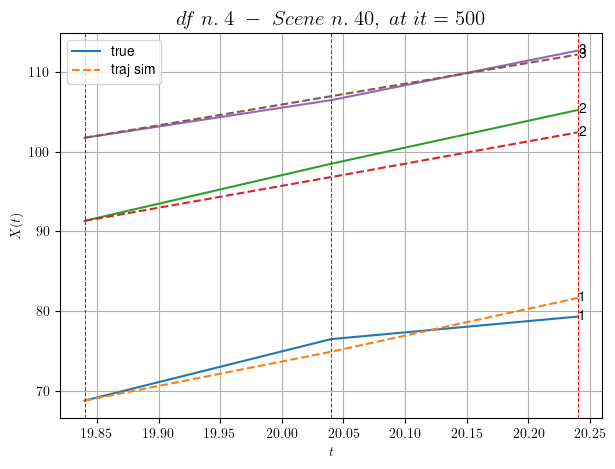

        For scene 40/69
        * use LR_NN=0.0001 with err=10.104719079816295 at it=24
        * v0_scn_mean = 26.29542849339211
        * MAE = 2.116581500279991



df n.4, scene n.41/69
    We have 5 time intervals inside [23.64,24.64]
            - Time interval n.0: [23.64, 23.84]
                * y_true: [16.50112189 27.57447859]
                * v_ann: [16.16801643371582, 21.01720428466797, 25.974575559418618]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [13.80103575 15.46275359]
                * v_ann: [20.491737365722656, 15.141985893249512, 25.974575559418618]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [18.55153987 13.07248815]
                * v_ann: [15.805717468261719, 16.2853946685791, 25.974575559418618]

--

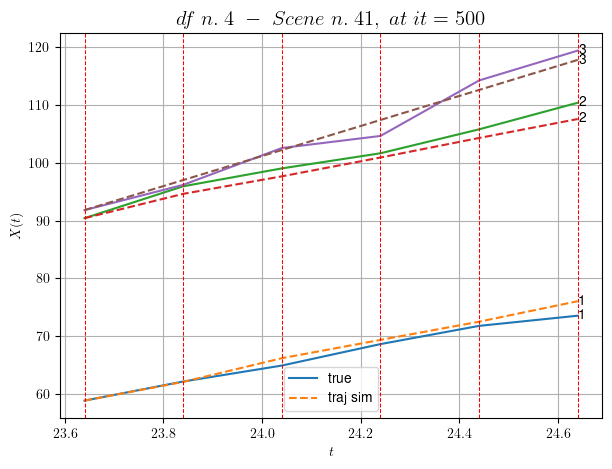

        For scene 41/69
        * use LR_NN=0.001 with err=25.088178456297147 at it=24
        * v0_scn_mean = 26.216100845120653
        * MAE = 2.052415792878609



df n.4, scene n.42/69
    We have 6 time intervals inside [80.24,81.44]
            - Time interval n.0: [80.24, 80.44]
                * y_true: [20.8407888  28.56113721]
                * v_ann: [24.054229736328125, 28.300094604492188, 22.367774273874375]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [80.44, 80.64]
                * y_true: [28.49133895 28.481454  ]
                * v_ann: [27.0314884185791, 27.091938018798828, 22.367774273874375]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [80.64, 80.84]
                * y_true: [29.84173661 32.11200361]
                * v_ann: [27.182851791381836, 26.959117889404297, 22.367774273874375]



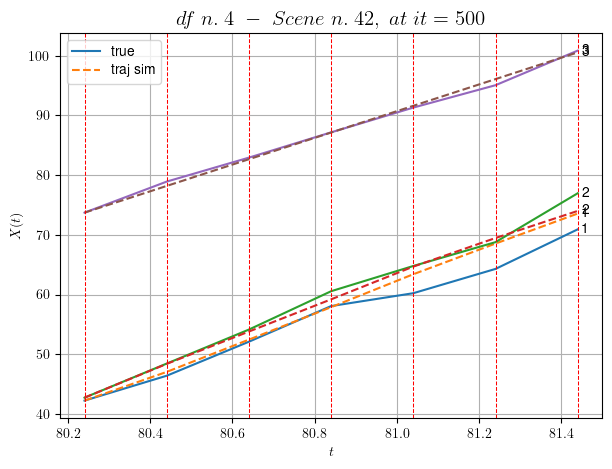

        For scene 42/69
        * use LR_NN=0.0005 with err=41.733818057511776 at it=24
        * v0_scn_mean = 22.82570747477151
        * MAE = 2.3204375738093774



df n.4, scene n.43/69
    We have 4 time intervals inside [89.04,89.84]
            - Time interval n.0: [89.04, 89.24]
                * y_true: [19.34082001 24.8230577 ]
                * v_ann: [19.771989822387695, 19.105361938476562, 32.77543163260234]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [89.24, 89.44]
                * y_true: [14.120693   17.32233598]
                * v_ann: [19.971006393432617, 19.19397735595703, 32.77543163260234]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [89.44, 89.64]
                * y_true: [18.19104002 31.50485669]
                * v_ann: [20.009613037109375, 19.483247756958008, 32.77543163260234]

-

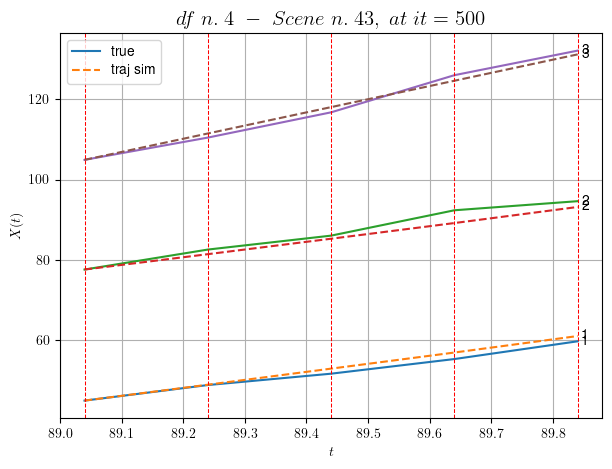

        For scene 43/69
        * use LR_NN=1e-05 with err=3.924629901813173 at it=24
        * v0_scn_mean = 32.608905859257156
        * MAE = 1.6973419699443166



df n.4, scene n.44/69
    We have 6 time intervals inside [96.44,97.64]
            - Time interval n.0: [96.44, 96.64]
                * y_true: [16.86045215 20.08121647]
                * v_ann: [18.79493522644043, 18.924976348876953, 18.401280606024468]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [96.64, 96.84]
                * y_true: [17.24055532  8.93061591]
                * v_ann: [18.595182418823242, 18.827999114990234, 18.401280606024468]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [96.84, 97.04]
                * y_true: [21.11081641 16.18118624]
                * v_ann: [17.219446182250977, 17.597097396850586, 18.401280606024468]


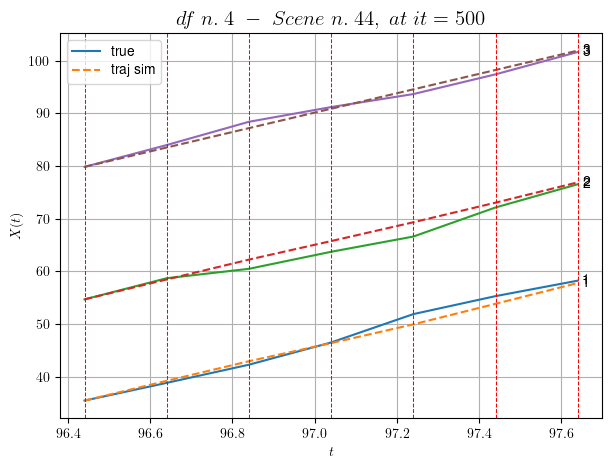

        For scene 44/69
        * use LR_NN=0.0005 with err=31.767376162353003 at it=24
        * v0_scn_mean = 19.097203248905647
        * MAE = 1.2183243307485516



df n.4, scene n.45/69
    We have 7 time intervals inside [182.24,183.64]
            - Time interval n.0: [182.24, 182.44]
                * y_true: [18.61043577 13.125309  ]
                * v_ann: [20.036779403686523, 20.348323822021484, 20.77319956727245]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [182.44, 182.64]
                * y_true: [12.51734154 21.64870909]
                * v_ann: [16.241104125976562, 18.853422164916992, 20.77319956727245]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [182.64, 182.84]
                * y_true: [15.03048681 24.29091592]
                * v_ann: [19.627803802490234, 18.341920852661133, 20.77319956

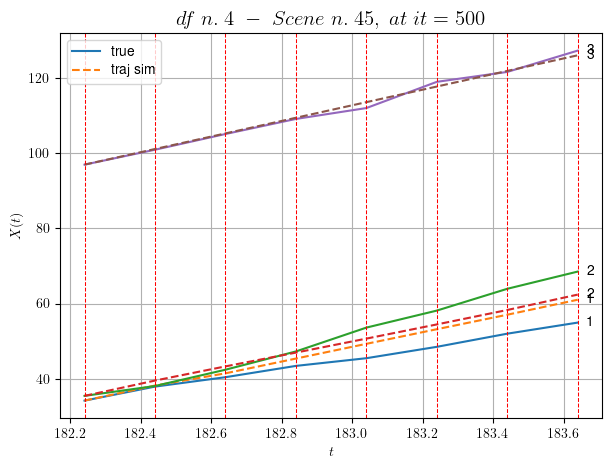

        For scene 45/69
        * use LR_NN=0.0005 with err=38.518928981364446 at it=24
        * v0_scn_mean = 21.326807178972565
        * MAE = 8.504608992147991



df n.4, scene n.46/69
    We have 2 time intervals inside [193.04,193.44]
            - Time interval n.0: [193.04, 193.24]
                * y_true: [26.28155868 27.90372348]
                * v_ann: [25.7166748046875, 25.554616928100586, 18.506528748462838]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [193.24, 193.44]
                * y_true: [29.63205884 19.30286837]
                * v_ann: [26.01482391357422, 25.674175262451172, 18.506528748462838]

----------------------------------------------------------------------------------------------------
    * err= 0.320469816219783
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0029879665418326984


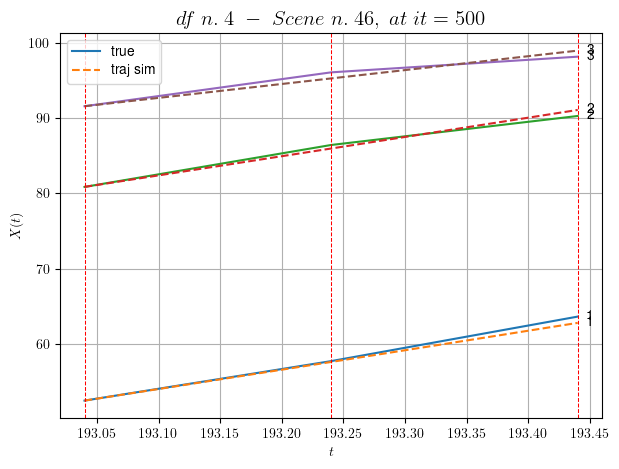

        For scene 46/69
        * use LR_NN=5e-05 with err=7.666813640920881 at it=24
        * v0_scn_mean = 19.196136507522937
        * MAE = 0.2708552026901984



df n.4, scene n.47/69
    We have 2 time intervals inside [196.84,197.24]
            - Time interval n.0: [196.84, 197.04]
                * y_true: [ 8.77046468 10.16548364]
                * v_ann: [9.048263549804688, 8.44008731842041, 20.188773230043527]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [197.04, 197.24]
                * y_true: [7.43042623 9.26246532]
                * v_ann: [8.926247596740723, 9.194316864013672, 20.188773230043527]

----------------------------------------------------------------------------------------------------
    * err= 0.1137261950003761
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.000330502084742168


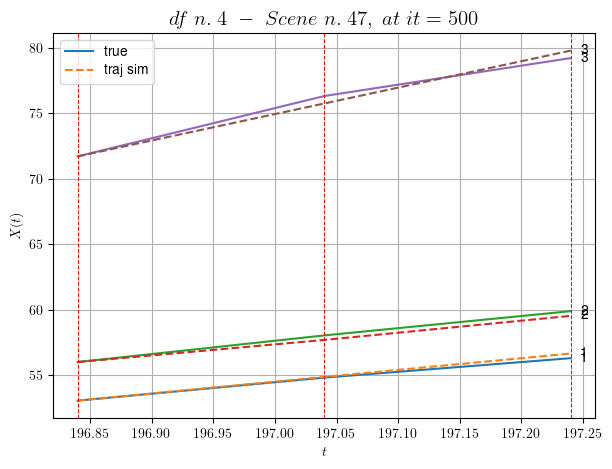

        For scene 47/69
        * use LR_NN=0.001 with err=2.9159384896040295 at it=24
        * v0_scn_mean = 20.777446395737986
        * MAE = 0.1137261950003761



df n.4, scene n.48/69
    We have 3 time intervals inside [222.84,223.44]
            - Time interval n.0: [222.84, 223.04]
                * y_true: [19.28108097 23.47419597]
                * v_ann: [14.110092163085938, 14.677080154418945, 30.10792866273013]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [223.04, 223.24]
                * y_true: [17.49110618 15.20291758]
                * v_ann: [21.029190063476562, 17.929014205932617, 30.10792866273013]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.24, 223.44]
                * y_true: [14.25100604 13.59283886]
                * v_ann: [16.821990966796875, 15.982322692871094, 30.107928662

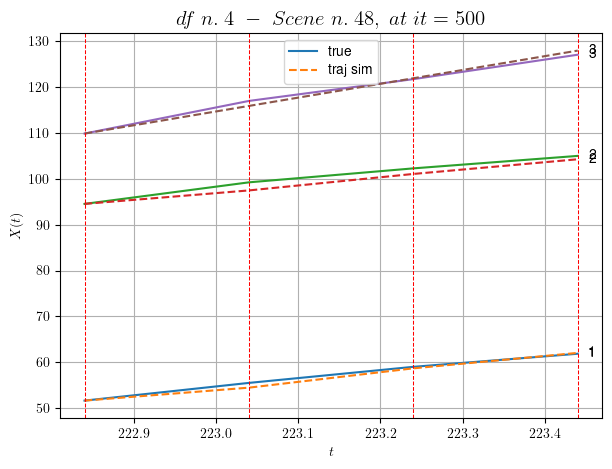

        For scene 48/69
        * use LR_NN=0.0005 with err=5.514292328510163 at it=24
        * v0_scn_mean = 30.101452947812177
        * MAE = 0.6949647730990581



df n.4, scene n.49/69
    We have 12 time intervals inside [224.84,227.24]
            - Time interval n.0: [224.84, 225.04]
                * y_true: [17.10046829 25.29311811]
                * v_ann: [18.807416915893555, 19.644094467163086, 15.713677130054807]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.04, 225.24]
                * y_true: [17.70062553 10.9614656 ]
                * v_ann: [19.188364028930664, 19.918689727783203, 15.713677130054807]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.24, 225.44]
                * y_true: [22.57087879 26.33405568]
                * v_ann: [18.440731048583984, 19.688814163208008, 15.713677

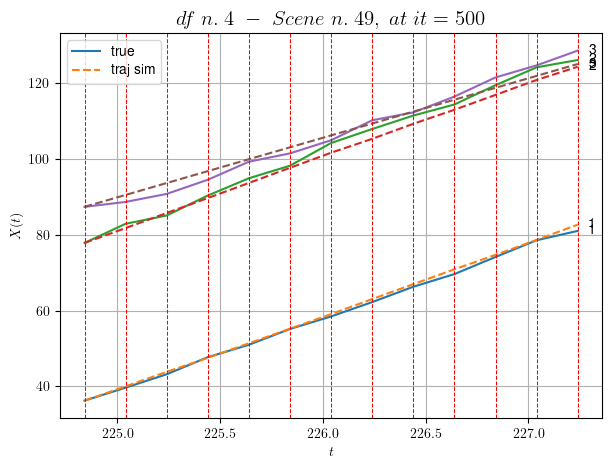

        For scene 49/69
        * use LR_NN=0.0005 with err=220.0885852356565 at it=24
        * v0_scn_mean = 16.570855860826516
        * MAE = 2.622377573554247



df n.4, scene n.50/69
    We have 7 time intervals inside [230.84,232.24]
            - Time interval n.0: [230.84, 231.04]
                * y_true: [ 5.64695095 17.97864337]
                * v_ann: [11.537408828735352, 14.134182929992676, 23.32272300258646]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [231.04, 231.24]
                * y_true: [ 5.72513489 21.19066695]
                * v_ann: [14.941861152648926, 13.729416847229004, 23.32272300258646]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [231.24, 231.44]
                * y_true: [ 6.01015392 28.29114422]
                * v_ann: [14.57457447052002, 13.684015274047852, 23.32272300258

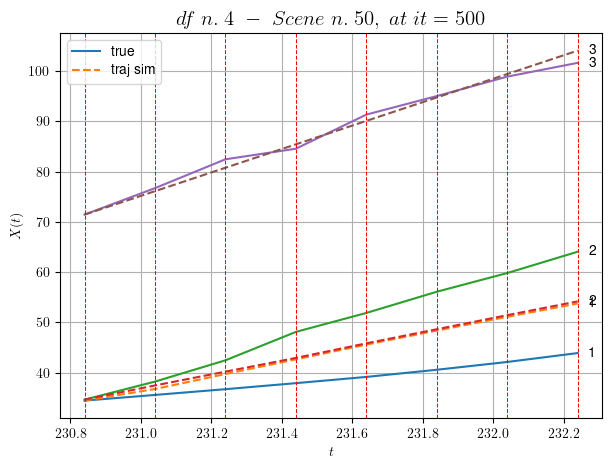

        For scene 50/69
        * use LR_NN=0.001 with err=20.574637386702292 at it=24
        * v0_scn_mean = 23.723359322636178
        * MAE = 25.572915464461563



df n.4, scene n.51/69
    We have 7 time intervals inside [233.84,235.24]
            - Time interval n.0: [233.84, 234.04]
                * y_true: [14.14101026 12.7012637 ]
                * v_ann: [21.4322566986084, 21.934194564819336, 21.462806471988575]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [234.04, 234.24]
                * y_true: [26.43219185 20.11227439]
                * v_ann: [21.17896270751953, 21.85548210144043, 21.462806471988575]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [234.24, 234.44]
                * y_true: [22.40209801 33.22429882]
                * v_ann: [21.391860961914062, 21.938209533691406, 21.46280647198

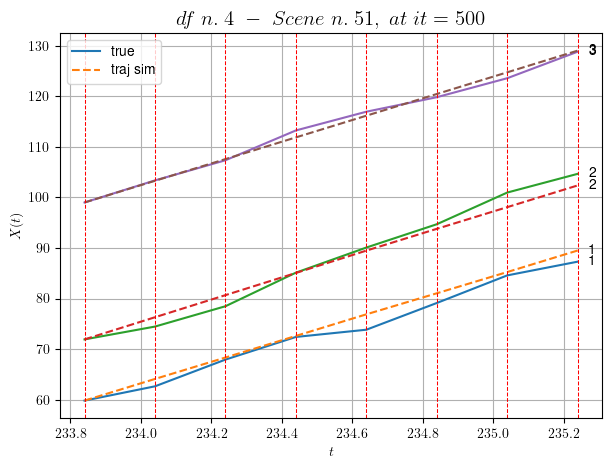

        For scene 51/69
        * use LR_NN=0.0001 with err=31.491984881976805 at it=24
        * v0_scn_mean = 21.975037700367544
        * MAE = 1.6858312592793467



df n.4, scene n.52/69
    We have 2 time intervals inside [302.44,302.84]
            - Time interval n.0: [302.44, 302.64]
                * y_true: [15.00036276 19.90190261]
                * v_ann: [19.881990432739258, 18.966154098510742, 25.744538233029026]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [302.64, 302.84]
                * y_true: [17.72492583 25.30273749]
                * v_ann: [19.971328735351562, 18.946395874023438, 25.744538233029026]

----------------------------------------------------------------------------------------------------
    * err= 0.652527755286244
    * Learning rate NN = 7.289998848136747e-06
    * diff = 0.003699158354275589


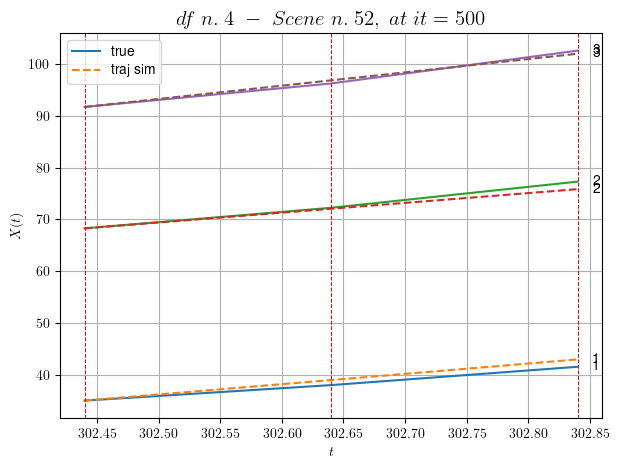

        For scene 52/69
        * use LR_NN=1e-05 with err=2.0870833601027727 at it=24
        * v0_scn_mean = 25.999865747986057
        * MAE = 0.652527755286244



df n.4, scene n.53/69
    We have 4 time intervals inside [364.64,365.44]
            - Time interval n.0: [364.64, 364.84]
                * y_true: [23.68175628 20.26218764]
                * v_ann: [18.427997589111328, 19.336191177368164, 28.20572489389836]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [364.84, 365.04]
                * y_true: [20.38169455 13.81168669]
                * v_ann: [18.801395416259766, 19.388504028320312, 28.20572489389836]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [365.04, 365.24]
                * y_true: [10.17092159 27.1635357 ]
                * v_ann: [19.089275360107422, 18.1304988861084, 28.205724893898

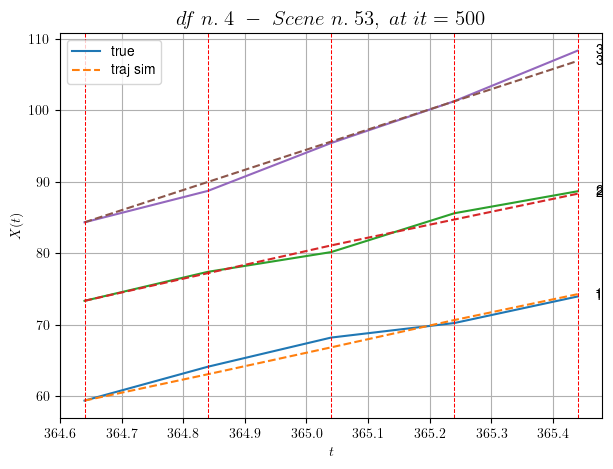

        For scene 53/69
        * use LR_NN=0.0001 with err=0.994512743892062 at it=24
        * v0_scn_mean = 28.313381319705673
        * MAE = 0.5432821530130878



df n.4, scene n.54/69
    We have 5 time intervals inside [422.64,423.64]
            - Time interval n.0: [422.64, 422.84]
                * y_true: [18.36052369 19.91162557]
                * v_ann: [28.174863815307617, 25.328645706176758, 27.5450896077765]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [422.84, 423.04]
                * y_true: [28.40107569 15.51150308]
                * v_ann: [23.7950382232666, 22.52600860595703, 27.5450896077765]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [423.04, 423.24]
                * y_true: [26.09121176 24.58263804]
                * v_ann: [22.86004638671875, 22.256961822509766, 27.5450896077765]


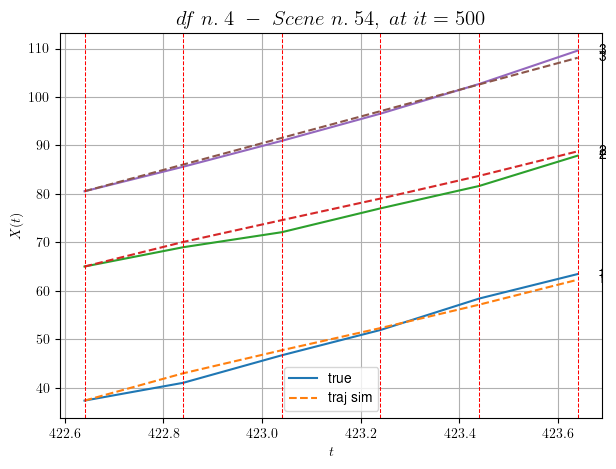

        For scene 54/69
        * use LR_NN=0.0005 with err=2.7406274215320323 at it=24
        * v0_scn_mean = 27.692384121090008
        * MAE = 1.1650650295230678



df n.4, scene n.55/69
    We have 2 time intervals inside [440.44,440.84]
            - Time interval n.0: [440.44, 440.64]
                * y_true: [23.50209477 27.05306951]
                * v_ann: [19.72073745727539, 19.711017608642578, 21.12699449757212]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [440.64, 440.84]
                * y_true: [ 8.15079495 24.70319187]
                * v_ann: [21.413618087768555, 22.053592681884766, 21.12699449757212]

----------------------------------------------------------------------------------------------------
    * err= 1.15142833286432
    * Learning rate NN = 0.00036449998151510954
    * diff = 3.7151102631582944e-05


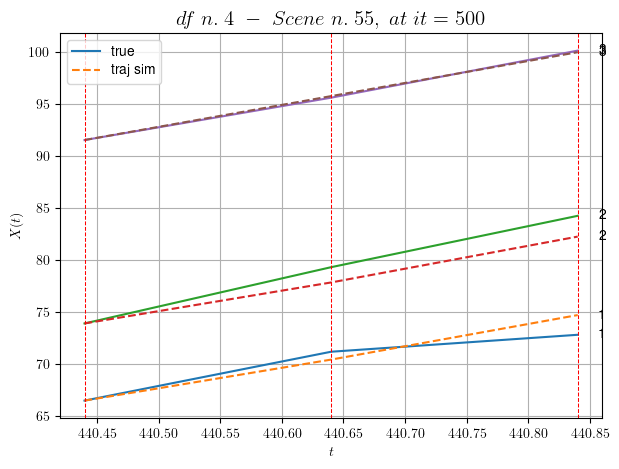

        For scene 55/69
        * use LR_NN=0.0005 with err=2.740100899252559 at it=24
        * v0_scn_mean = 21.65937442933949
        * MAE = 1.1394679667002647



df n.4, scene n.56/69
    We have 5 time intervals inside [459.64,460.64]
            - Time interval n.0: [459.64, 459.84]
                * y_true: [ 8.02057991 18.30147717]
                * v_ann: [19.085315704345703, 20.20726776123047, 21.749477605227415]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [459.84, 460.04]
                * y_true: [15.90126261 32.50305135]
                * v_ann: [17.47076416015625, 18.670812606811523, 21.749477605227415]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [460.04, 460.24]
                * y_true: [12.56106954  7.60079575]
                * v_ann: [18.550874710083008, 18.49837303161621, 21.74947760522

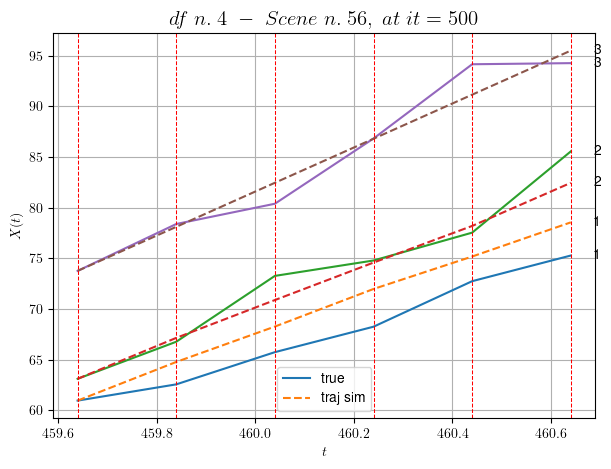

        For scene 56/69
        * use LR_NN=0.001 with err=9.87837062728394 at it=24
        * v0_scn_mean = 22.244508578483092
        * MAE = 3.9708749548092013



df n.4, scene n.57/69
    We have 10 time intervals inside [493.84,495.84]
            - Time interval n.0: [493.84, 494.04]
                * y_true: [22.94003108 21.75102788]
                * v_ann: [24.11665916442871, 24.343040466308594, 20.43694163915576]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [494.04, 494.24]
                * y_true: [17.14085991 24.35137427]
                * v_ann: [24.036466598510742, 24.343780517578125, 20.43694163915576]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [494.24, 494.44]
                * y_true: [21.88131212 25.00167951]
                * v_ann: [23.034103393554688, 23.071359634399414, 20.43694163915

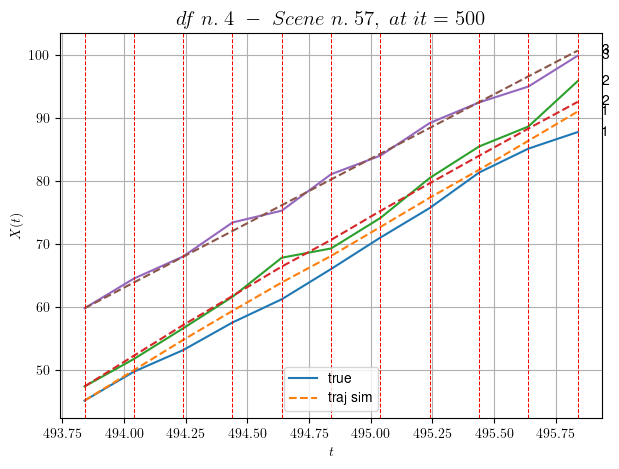

        For scene 57/69
        * use LR_NN=0.001 with err=52.92064113764443 at it=24
        * v0_scn_mean = 21.010724711445576
        * MAE = 1.8230444257859322



df n.4, scene n.58/69
    We have 8 time intervals inside [520.04,521.64]
            - Time interval n.0: [520.04, 520.24]
                * y_true: [17.72000935 17.53021327]
                * v_ann: [21.625762939453125, 23.40220832824707, 25.96280732717903]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [520.24, 520.44]
                * y_true: [21.19003079 20.68032877]
                * v_ann: [19.89601707458496, 20.152557373046875, 25.96280732717903]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [520.44, 520.64]
                * y_true: [20.95006602 20.21041565]
                * v_ann: [20.186599731445312, 20.73915672302246, 25.9628073271790

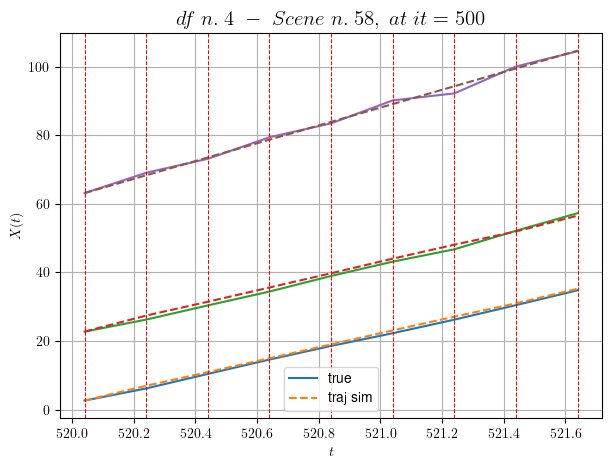

        For scene 58/69
        * use LR_NN=0.0005 with err=28.100633656363225 at it=24
        * v0_scn_mean = 26.205038706285816
        * MAE = 0.4144799574797166



df n.4, scene n.59/69
    We have 4 time intervals inside [550.44,551.24]
            - Time interval n.0: [550.44, 550.64]
                * y_true: [23.95217582 22.66294351]
                * v_ann: [23.678516387939453, 23.46187400817871, 20.148397636536806]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [550.64, 550.84]
                * y_true: [22.2022957  28.49416646]
                * v_ann: [23.585891723632812, 23.407346725463867, 20.148397636536806]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [550.84, 551.04]
                * y_true: [19.80228834 20.61332089]
                * v_ann: [24.20003890991211, 23.565258026123047, 20.14839763

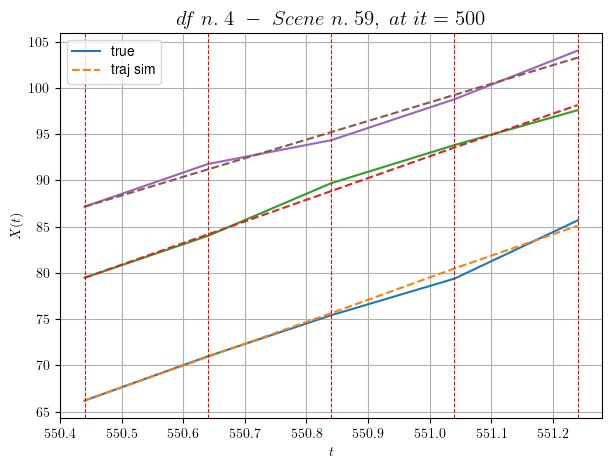

        For scene 59/69
        * use LR_NN=0.0005 with err=14.092848078695644 at it=24
        * v0_scn_mean = 20.739493336030385
        * MAE = 0.309550394394122



df n.4, scene n.60/69
    We have 2 time intervals inside [554.64,555.04]
            - Time interval n.0: [554.64, 554.84]
                * y_true: [16.3871362  34.43556815]
                * v_ann: [25.056163787841797, 24.480642318725586, 20.44072781876661]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.84, 555.04]
                * y_true: [19.58824641 23.53414882]
                * v_ann: [22.039003372192383, 22.451648712158203, 20.44072781876661]

----------------------------------------------------------------------------------------------------
    * err= 1.8687272348800554
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0071131283864440675


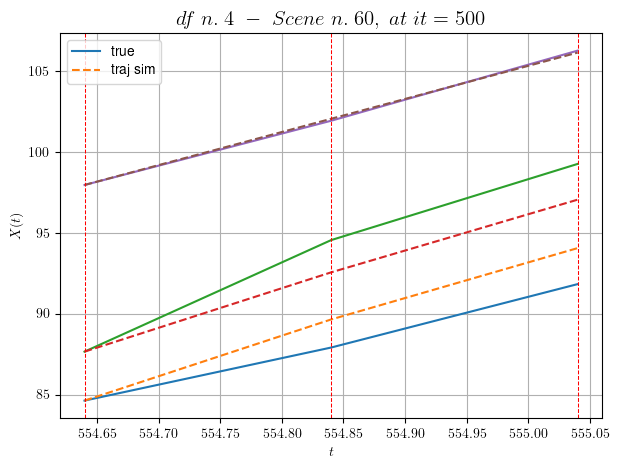

        For scene 60/69
        * use LR_NN=0.001 with err=2.474021841570521 at it=24
        * v0_scn_mean = 21.01428372044863
        * MAE = 1.8687272348800554



df n.4, scene n.61/69
    We have 2 time intervals inside [556.24,556.64]
            - Time interval n.0: [556.24, 556.44]
                * y_true: [24.75252122 21.70224237]
                * v_ann: [23.383625030517578, 24.578311920166016, 15.086092436633818]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [556.44, 556.64]
                * y_true: [25.4427559  22.85265518]
                * v_ann: [24.063215255737305, 22.65074348449707, 15.086092436633818]

----------------------------------------------------------------------------------------------------
    * err= 0.18183511515056416
    * Learning rate NN = 0.0007289999630302191
    * diff = 1.8730777781805763e-05


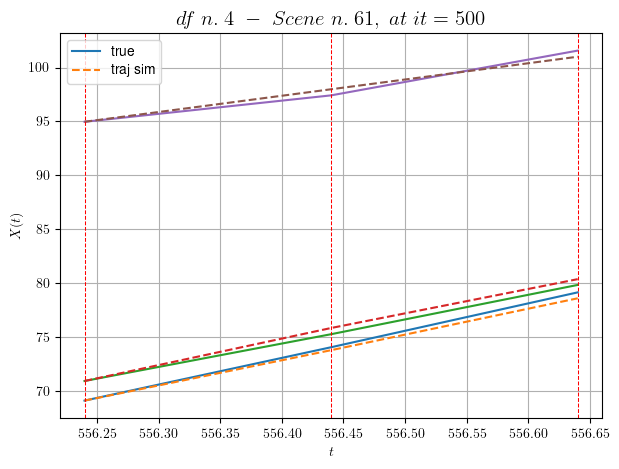

        For scene 61/69
        * use LR_NN=0.001 with err=12.220165350650616 at it=24
        * v0_scn_mean = 15.980926220832702
        * MAE = 0.17967069631841534



df n.4, scene n.62/69
    We have 4 time intervals inside [575.04,575.84]
            - Time interval n.0: [575.04, 575.24]
                * y_true: [25.50060057 18.90068968]
                * v_ann: [22.05118751525879, 21.896045684814453, 24.545621507402075]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [575.24, 575.44]
                * y_true: [27.95087423 28.65128625]
                * v_ann: [22.08836555480957, 22.059913635253906, 24.545621507402075]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [575.44, 575.64]
                * y_true: [21.25083564 15.85084753]
                * v_ann: [22.705638885498047, 25.72624397277832, 24.545621507

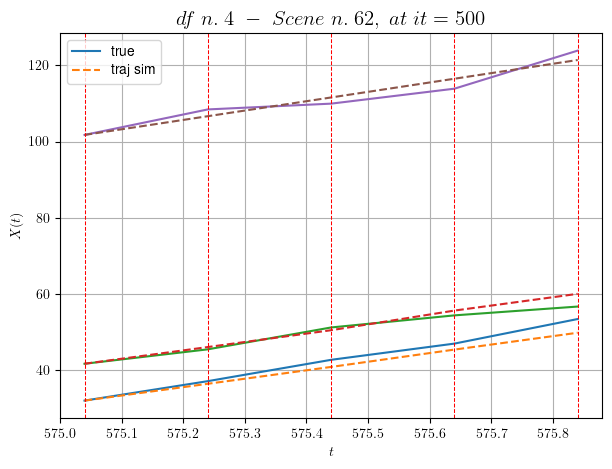

        For scene 62/69
        * use LR_NN=0.0001 with err=42.30643996686214 at it=24
        * v0_scn_mean = 24.872883972068408
        * MAE = 3.435648810097629



df n.4, scene n.63/69
    We have 3 time intervals inside [313.84,314.44]
            - Time interval n.0: [313.84, 314.04]
                * y_true: [15.70108851 23.28855659 11.30165534]
                * v_ann: [28.04473304748535, 30.118392944335938, 32.76976013183594, 26.415529524804217]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [314.04, 314.24]
                * y_true: [25.15198981 24.43240479 30.10483754]
                * v_ann: [19.01531982421875, 13.647810935974121, 14.972309112548828, 26.415529524804217]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [314.24, 314.44]
                * y_true: [27.30252596 23.75264682 40.35752125]
    

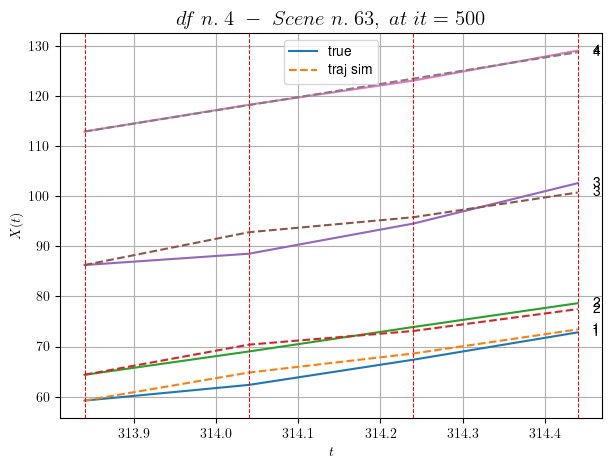

        For scene 63/69
        * use LR_NN=0.001 with err=9.347792612209654 at it=24
        * v0_scn_mean = 26.70227549847882
        * MAE = 1.6333340878850293



df n.4, scene n.64/69
    We have 2 time intervals inside [460.84,461.24]
            - Time interval n.0: [460.84, 461.04]
                * y_true: [19.8211655  14.23151831 20.23251805]
                * v_ann: [19.044095993041992, 18.485715866088867, 19.38214874267578, 26.404314529226873]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [461.04, 461.24]
                * y_true: [19.5413591  21.77263281 16.55223683]
                * v_ann: [18.10613441467285, 18.384836196899414, 18.720298767089844, 26.404314529226873]

----------------------------------------------------------------------------------------------------
    * err= 0.12018634791442445
    * Learning rate NN = 0.0007289999630302191
    * diff = 8.038312644159662e-05


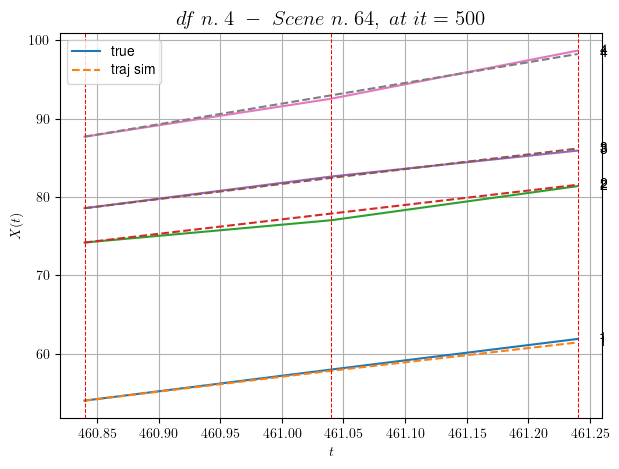

        For scene 64/69
        * use LR_NN=0.001 with err=2.0272861654878227 at it=24
        * v0_scn_mean = 26.691957666053625
        * MAE = 0.12018634791442445



df n.4, scene n.65/69
    We have 2 time intervals inside [462.64,463.04]
            - Time interval n.0: [462.64, 462.84]
                * y_true: [21.60177307 15.7113741  22.90372044]
                * v_ann: [19.30520248413086, 18.381282806396484, 19.361967086791992, 31.352447205664888]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [462.84, 463.04]
                * y_true: [18.06167929 17.53172974 18.9633766 ]
                * v_ann: [19.098581314086914, 19.720684051513672, 18.843017578125, 31.352447205664888]

----------------------------------------------------------------------------------------------------
    * err= 0.2719936020773903
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0010450707646994517


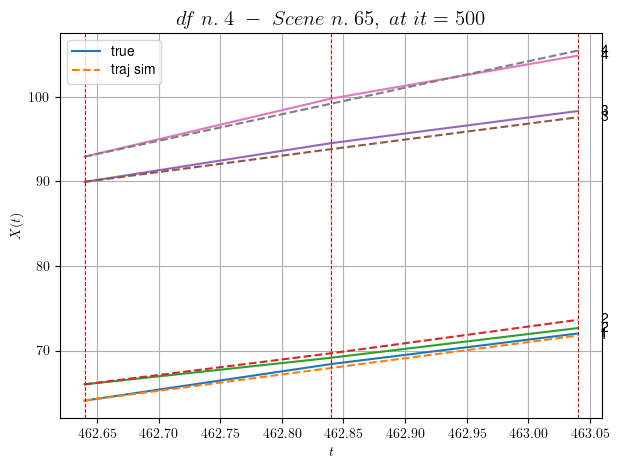

        For scene 65/69
        * use LR_NN=0.001 with err=6.775611933532806 at it=24
        * v0_scn_mean = 31.24425583025306
        * MAE = 0.25889276465665934



df n.4, scene n.66/69
    We have 3 time intervals inside [495.24,495.84]
            - Time interval n.0: [495.24, 495.44]
                * y_true: [12.91123632 28.10335872 24.95329593]
                * v_ann: [21.582239151000977, 22.121381759643555, 22.58481788635254, 16.437805482235426]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [495.44, 495.64]
                * y_true: [ 9.32105302 18.99250639 15.85230368]
                * v_ann: [22.36224365234375, 22.9167423248291, 21.57765007019043, 16.437805482235426]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [495.64, 495.84]
                * y_true: [38.46439916 13.12188353 36.00587838]
      

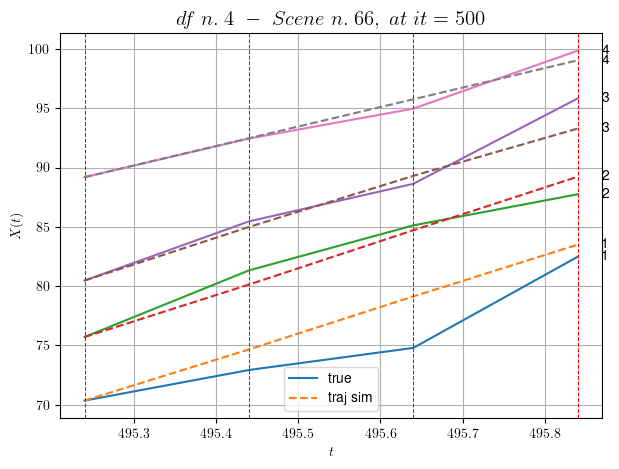

        For scene 66/69
        * use LR_NN=0.0005 with err=10.338503197839678 at it=24
        * v0_scn_mean = 17.52273691048294
        * MAE = 2.1941452856391144



df n.4, scene n.67/69
    We have 5 time intervals inside [541.84,542.84]
            - Time interval n.0: [541.84, 542.04]
                * y_true: [15.49040827 18.57067001 15.06113134]
                * v_ann: [18.81696128845215, 18.75685691833496, 18.744672775268555, 25.31159160096193]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [542.04, 542.24]
                * y_true: [18.02057424 22.22093452 14.29121645]
                * v_ann: [18.265512466430664, 17.367725372314453, 17.48579978942871, 25.31159160096193]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [542.24, 542.44]
                * y_true: [23.32090187 15.10072652 30.16295254]
     

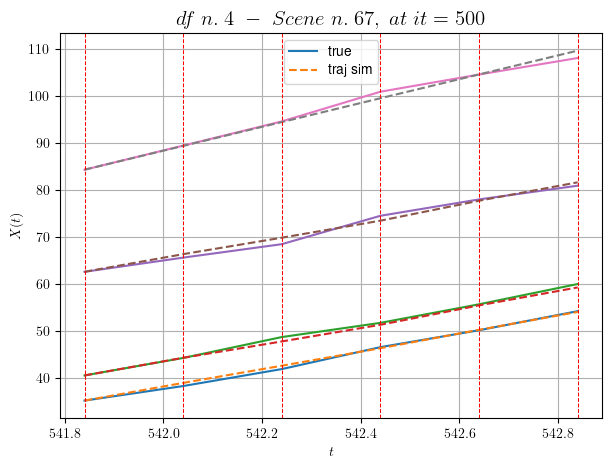

        For scene 67/69
        * use LR_NN=0.001 with err=13.389236169499426 at it=24
        * v0_scn_mean = 25.68664901618459
        * MAE = 0.4660487483126379



df n.4, scene n.68/69
    We have 2 time intervals inside [559.04,559.44]
            - Time interval n.0: [559.04, 559.24]
                * y_true: [23.32160164 21.40183754 23.15354324]
                * v_ann: [18.65746307373047, 18.6840877532959, 18.676353454589844, 21.820834052469753]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [559.24, 559.44]
                * y_true: [16.34126249 10.38103794 18.30306556]
                * v_ann: [18.845151901245117, 19.081266403198242, 18.87128257751465, 21.820834052469753]

----------------------------------------------------------------------------------------------------
    * err= 0.35152263915298704
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0004598563850134463


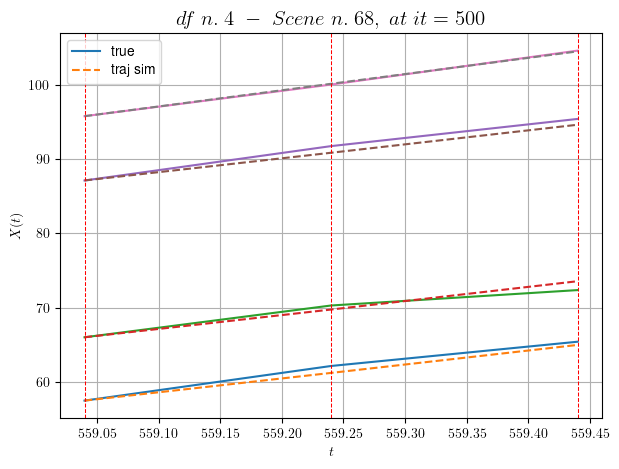

        For scene 68/69
        * use LR_NN=0.0001 with err=5.523772508046367 at it=24
        * v0_scn_mean = 22.475140712184906
        * MAE = 0.3327580862855025



For df=4 with 69 scenes, time taken:        1342.06
****************************************************************************************************
****************************************************************************************************
In df n.5/10 we have 66 scenes
df n.5, scene n.0/66
    We have 2 time intervals inside [22.92,23.32]
    * err= 0.058750187943305984
    * Learning rate NN = 8.099998922261875e-06
    * diff = 7.954597397857865e-07


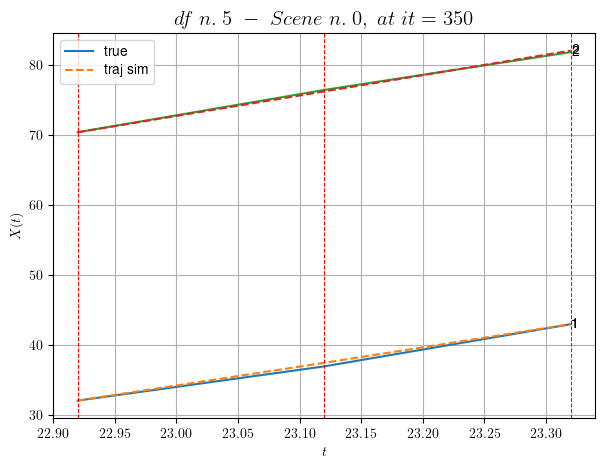

        For scene 0/66
        * use LR_NN=1e-05 with err=0.09382205712565414 at it=24
        * v0_scn_mean = 29.211102385396234
        * MAE = 0.05350690371763559



df n.5, scene n.1/66
    We have 2 time intervals inside [38.72,39.12]
    * err= 0.008276834008382476
    * Learning rate NN = 8.099999104160815e-05
    * diff = 1.8462226994246655e-07


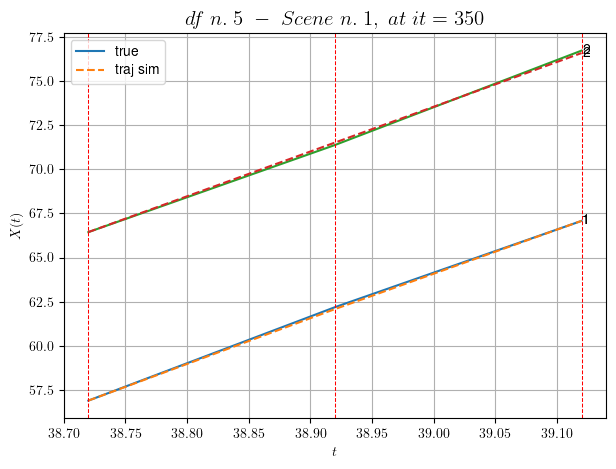

        For scene 1/66
        * use LR_NN=0.0001 with err=0.679728318721184 at it=24
        * v0_scn_mean = 25.636864422101517
        * MAE = 0.007684083861659377



df n.5, scene n.2/66
    We have 2 time intervals inside [47.12,47.52]
            - Time interval n.0: [47.12, 47.32]
                * y_true: [27.13157074]
                * v_ann: [29.517574310302734, 18.771821269963407]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [47.32, 47.52]
                * y_true: [29.78215199]
                * v_ann: [27.20501708984375, 18.771821269963407]

----------------------------------------------------------------------------------------------------
    * err= 0.10782168399309697
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 8.522409156330735e-06


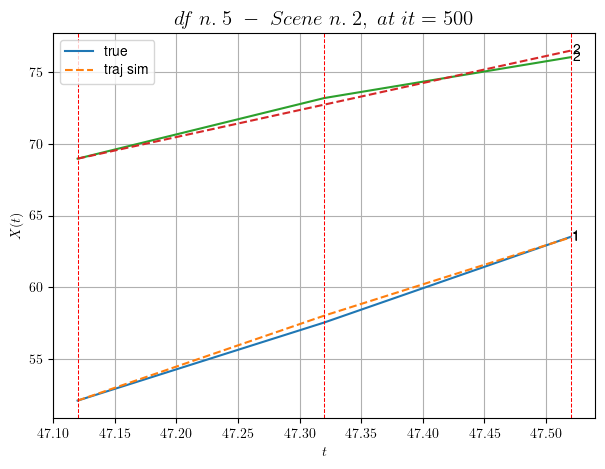

        For scene 2/66
        * use LR_NN=5e-05 with err=4.6546303703538605 at it=24
        * v0_scn_mean = 19.220948419079072
        * MAE = 0.10751943977170968



df n.5, scene n.3/66
    We have 2 time intervals inside [60.92,61.32]
    * err= 0.0017768853776050455
    * Learning rate NN = 8.999999408842996e-06
    * diff = 7.053957432078851e-08


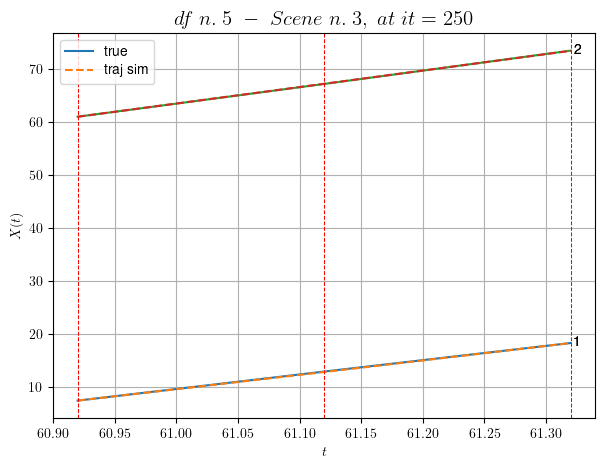

        For scene 3/66
        * use LR_NN=1e-05 with err=0.04497126877128125 at it=24
        * v0_scn_mean = 31.014497606033938
        * MAE = 0.001764128868366461



df n.5, scene n.4/66
    We have 5 time intervals inside [64.32,65.32]
            - Time interval n.0: [64.32, 64.52]
                * y_true: [37.14124909]
                * v_ann: [36.45674133300781, 32.233878573413314]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [64.52, 64.72]
                * y_true: [31.68144271]
                * v_ann: [36.70417404174805, 32.233878573413314]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [64.72, 64.92]
                * y_true: [30.88182123]
                * v_ann: [33.964359283447266, 32.233878573413314]

----------------------------------------------------------------------------------------------

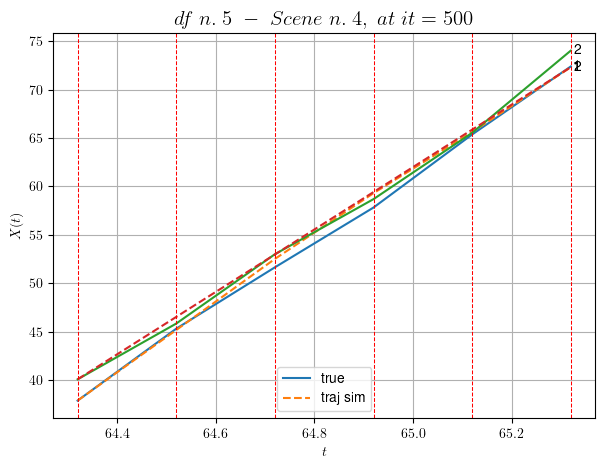

        For scene 4/66
        * use LR_NN=0.01 with err=1.7498112979013634 at it=24
        * v0_scn_mean = 32.14452343049404
        * MAE = 0.5107125012589881



df n.5, scene n.5/66
    We have 4 time intervals inside [73.32,74.12]
            - Time interval n.0: [73.32, 73.52]
                * y_true: [22.4509602]
                * v_ann: [26.110584259033203, 30.983854498861103]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [73.52, 73.72]
                * y_true: [19.77098046]
                * v_ann: [25.638580322265625, 30.983854498861103]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [73.72, 73.92]
                * y_true: [35.00219048]
                * v_ann: [24.464580535888672, 30.983854498861103]

--------------------------------------------------------------------------------------------------

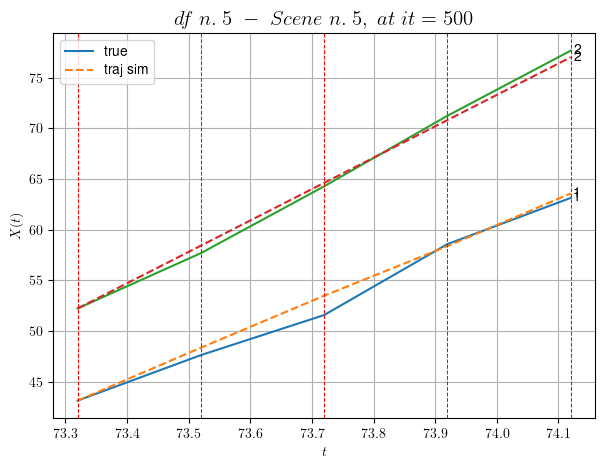

        For scene 5/66
        * use LR_NN=5e-05 with err=0.4874458005532538 at it=24
        * v0_scn_mean = 30.944500318914027
        * MAE = 0.5668146040047128



df n.5, scene n.6/66
    We have 2 time intervals inside [77.52,77.92]
            - Time interval n.0: [77.52, 77.72]
                * y_true: [29.39148069]
                * v_ann: [30.096038818359375, 29.979095396352783]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [77.72, 77.92]
                * y_true: [30.4419639]
                * v_ann: [29.758047103881836, 29.979095396352783]

----------------------------------------------------------------------------------------------------
    * err= 0.031474057371774916
    * Learning rate NN = 0.00036449998151510954
    * diff = 6.148883800562166e-05


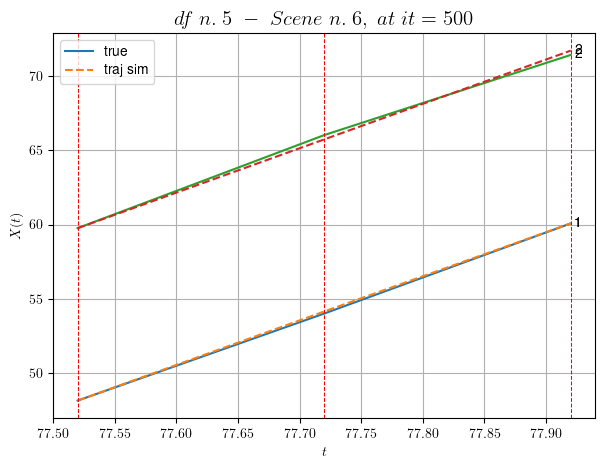

        For scene 6/66
        * use LR_NN=0.0005 with err=0.028581520780145718 at it=24
        * v0_scn_mean = 29.97993158049835
        * MAE = 0.031474057371774916



df n.5, scene n.7/66
    We have 3 time intervals inside [78.72,79.32]
            - Time interval n.0: [78.72, 78.92]
                * y_true: [30.67106023]
                * v_ann: [27.445955276489258, 28.965407295611314]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [78.92, 79.12]
                * y_true: [32.90145429]
                * v_ann: [28.428848266601562, 28.965407295611314]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [79.12, 79.32]
                * y_true: [21.18125424]
                * v_ann: [29.178491592407227, 28.965407295611314]

-------------------------------------------------------------------------------------------

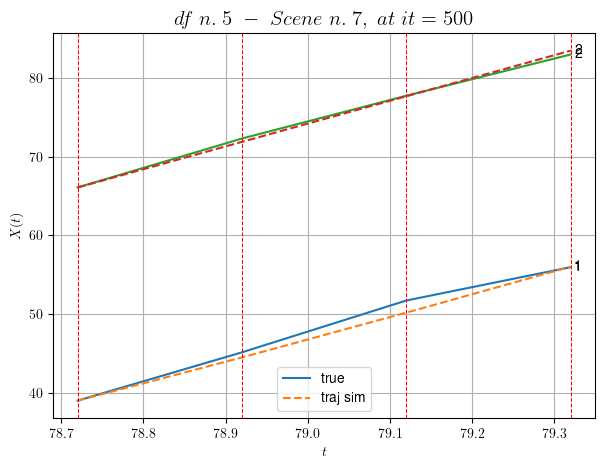

        For scene 7/66
        * use LR_NN=5e-05 with err=0.4299645818960144 at it=24
        * v0_scn_mean = 29.006791003778968
        * MAE = 0.401268408204504



df n.5, scene n.8/66
    We have 7 time intervals inside [96.12,97.52]
            - Time interval n.0: [96.12, 96.32]
                * y_true: [24.32039328]
                * v_ann: [25.03325653076172, 24.58358740127218]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [96.32, 96.52]
                * y_true: [20.210445]
                * v_ann: [24.9864444732666, 24.58358740127218]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [96.52, 96.72]
                * y_true: [26.25074807]
                * v_ann: [25.339689254760742, 24.58358740127218]

----------------------------------------------------------------------------------------------------
   

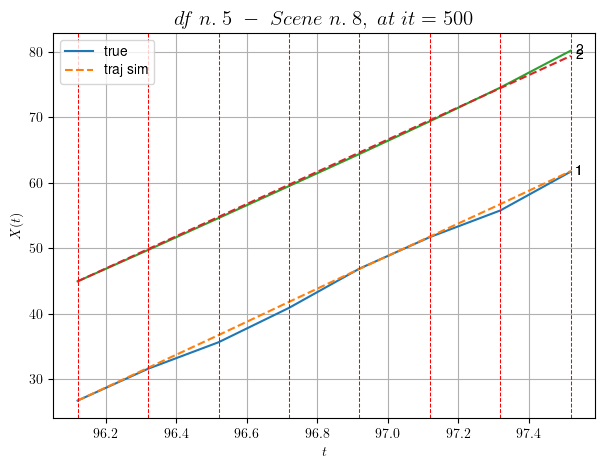

        For scene 8/66
        * use LR_NN=1e-05 with err=10.05253140572945 at it=24
        * v0_scn_mean = 24.800243905179833
        * MAE = 0.23897432120946305



df n.5, scene n.9/66
    We have 2 time intervals inside [101.12,101.52]
    * err= 0.015766139004178018
    * Learning rate NN = 4.049999552080408e-05
    * diff = 5.1384763690570656e-08


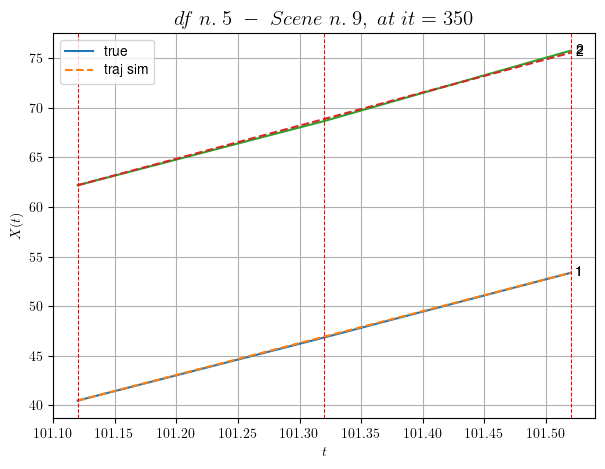

        For scene 9/66
        * use LR_NN=5e-05 with err=0.45060077289158235 at it=24
        * v0_scn_mean = 33.214905678420486
        * MAE = 0.015766138992612318



df n.5, scene n.10/66
    We have 3 time intervals inside [123.92,124.52]
    * err= 0.034161913538920445
    * Learning rate NN = 6.560998826898867e-06
    * diff = 2.528812898666688e-08


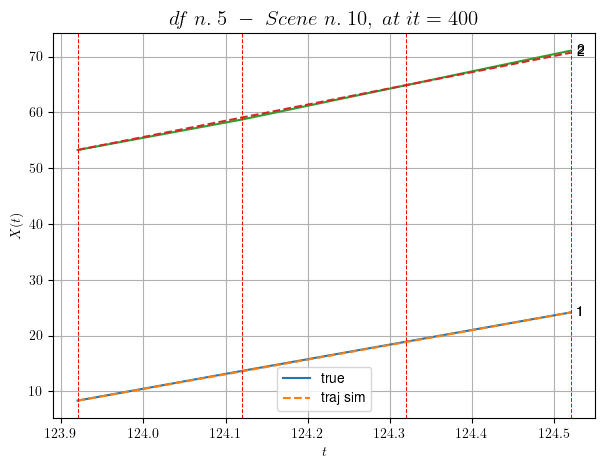

        For scene 10/66
        * use LR_NN=1e-05 with err=0.06426343629661754 at it=24
        * v0_scn_mean = 29.11374977133477
        * MAE = 0.02960320759849917



df n.5, scene n.11/66
    We have 5 time intervals inside [125.12,126.12]
            - Time interval n.0: [125.12, 125.32]
                * y_true: [30.50092783]
                * v_ann: [25.6279354095459, 29.26921039472393]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [125.32, 125.52]
                * y_true: [27.94108841]
                * v_ann: [28.9475154876709, 29.26921039472393]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [125.52, 125.72]
                * y_true: [21.64103704]
                * v_ann: [27.947586059570312, 29.26921039472393]

-------------------------------------------------------------------------------------------

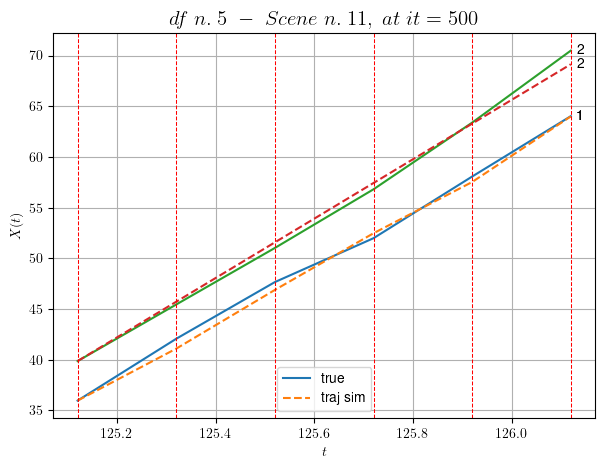

        For scene 11/66
        * use LR_NN=0.005 with err=0.6122402418845321 at it=24
        * v0_scn_mean = 29.298441978928896
        * MAE = 0.35863484957615166



df n.5, scene n.12/66
    We have 3 time intervals inside [134.32,134.92]
            - Time interval n.0: [134.32, 134.52]
                * y_true: [30.69004964]
                * v_ann: [28.866315841674805, 31.249037494539166]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [134.52, 134.72]
                * y_true: [26.43011975]
                * v_ann: [28.805347442626953, 31.249037494539166]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [134.72, 134.92]
                * y_true: [29.69024251]
                * v_ann: [29.185728073120117, 31.249037494539166]

------------------------------------------------------------------------------------

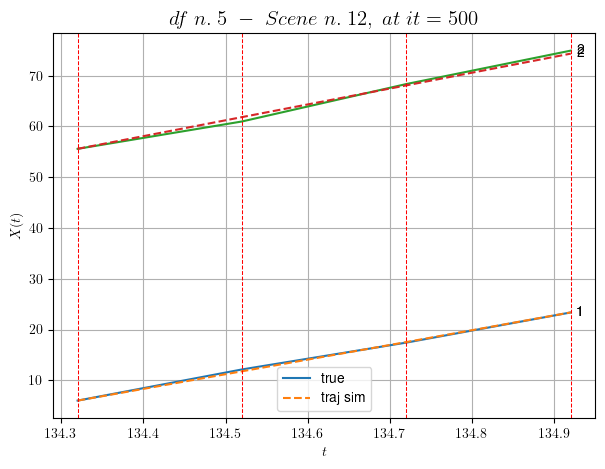

        For scene 12/66
        * use LR_NN=1e-05 with err=0.36431492029009094 at it=24
        * v0_scn_mean = 31.199075994767146
        * MAE = 0.16336045295981555



df n.5, scene n.13/66
    We have 6 time intervals inside [145.92,147.12]
            - Time interval n.0: [145.92, 146.12]
                * y_true: [20.61022162]
                * v_ann: [17.376001358032227, 25.995964105863298]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [146.12, 146.32]
                * y_true: [23.57038291]
                * v_ann: [18.50872039794922, 25.995964105863298]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [146.32, 146.52]
                * y_true: [23.12047758]
                * v_ann: [19.913244247436523, 25.995964105863298]

------------------------------------------------------------------------------------

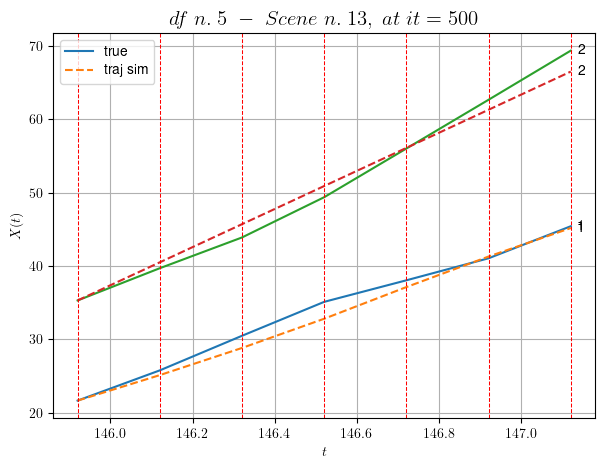

        For scene 13/66
        * use LR_NN=0.001 with err=4.209570826752066 at it=24
        * v0_scn_mean = 26.156125541598065
        * MAE = 1.2356119680128694



df n.5, scene n.14/66
    We have 4 time intervals inside [149.92,150.72]
            - Time interval n.0: [149.92, 150.12]
                * y_true: [26.68049148]
                * v_ann: [31.039142608642578, 23.10299358436146]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [150.12, 150.32]
                * y_true: [38.1410546]
                * v_ann: [29.98423957824707, 23.10299358436146]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [150.32, 150.52]
                * y_true: [25.82092379]
                * v_ann: [29.32381248474121, 23.10299358436146]

--------------------------------------------------------------------------------------------

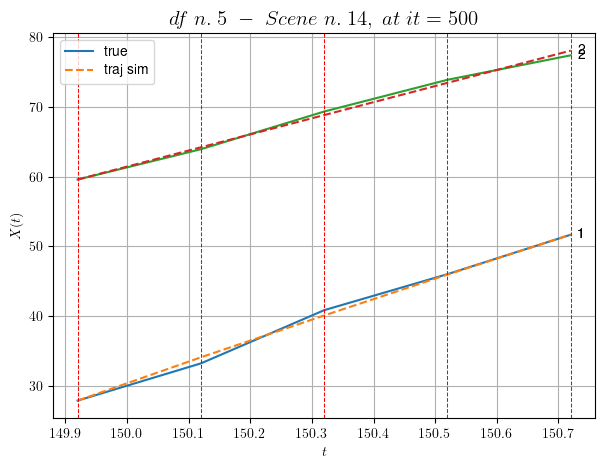

        For scene 14/66
        * use LR_NN=5e-05 with err=6.152380155088727 at it=24
        * v0_scn_mean = 23.378873840934435
        * MAE = 0.23185393625397682



df n.5, scene n.15/66
    We have 2 time intervals inside [167.32,167.72]
            - Time interval n.0: [167.32, 167.52]
                * y_true: [13.72577148]
                * v_ann: [13.281344413757324, 26.10725367471429]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [167.52, 167.72]
                * y_true: [13.72577148]
                * v_ann: [14.117817878723145, 26.10725367471429]

----------------------------------------------------------------------------------------------------
    * err= 0.005153947147263117
    * Learning rate NN = 7.289998757187277e-05
    * diff = 1.4918331010826437e-05


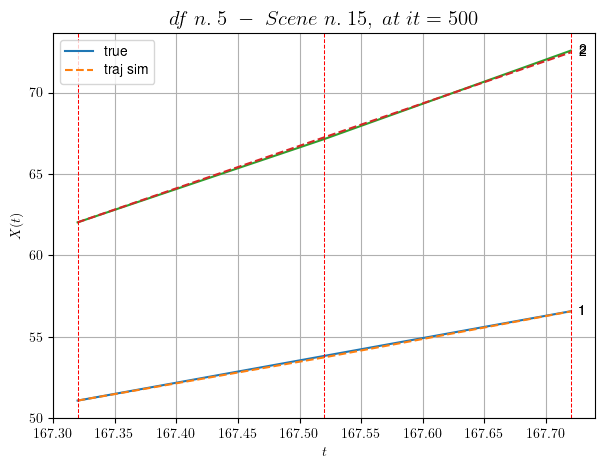

        For scene 15/66
        * use LR_NN=0.0001 with err=0.49884909052793897 at it=24
        * v0_scn_mean = 26.262963527696716
        * MAE = 0.004953760587165029



df n.5, scene n.16/66
    We have 3 time intervals inside [175.72,176.32]
            - Time interval n.0: [175.72, 175.92]
                * y_true: [28.75187595]
                * v_ann: [30.700450897216797, 28.8584180654014]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [175.92, 176.12]
                * y_true: [30.6425727]
                * v_ann: [30.410451889038086, 28.8584180654014]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [176.12, 176.32]
                * y_true: [31.90303719]
                * v_ann: [30.159679412841797, 28.8584180654014]

----------------------------------------------------------------------------------------

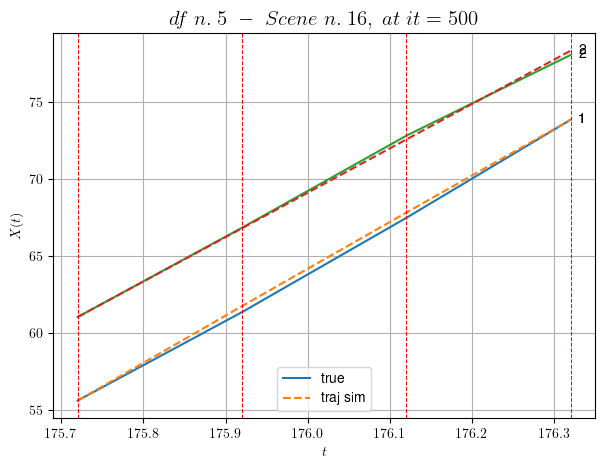

        For scene 16/66
        * use LR_NN=0.0005 with err=0.17279319329131138 at it=24
        * v0_scn_mean = 28.90408134277635
        * MAE = 0.05017700179759069



df n.5, scene n.17/66
    We have 4 time intervals inside [193.72,194.52]
            - Time interval n.0: [193.72, 193.92]
                * y_true: [24.05562773]
                * v_ann: [23.66966438293457, 30.811434876560575]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [193.92, 194.12]
                * y_true: [26.42578066]
                * v_ann: [24.24898338317871, 30.811434876560575]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [194.12, 194.32]
                * y_true: [24.49095616]
                * v_ann: [24.7087459564209, 30.811434876560575]

---------------------------------------------------------------------------------------

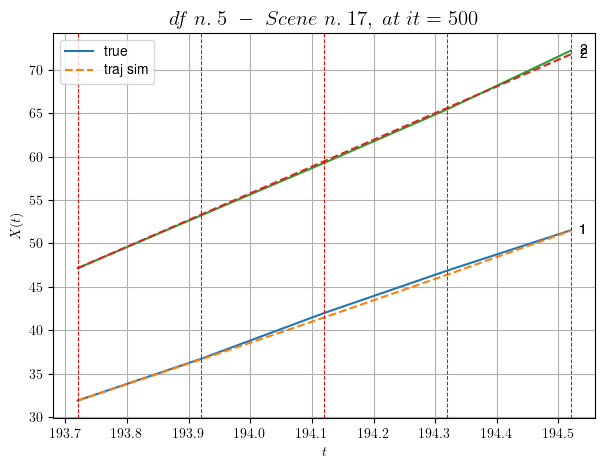

        For scene 17/66
        * use LR_NN=5e-05 with err=0.34722748418555355 at it=24
        * v0_scn_mean = 30.778977481504498
        * MAE = 0.07447835765196704



df n.5, scene n.18/66
    We have 3 time intervals inside [214.32,214.92]
    * err= 0.011318278633990424
    * Learning rate NN = 8.099998922261875e-06
    * diff = 6.154954018452313e-07


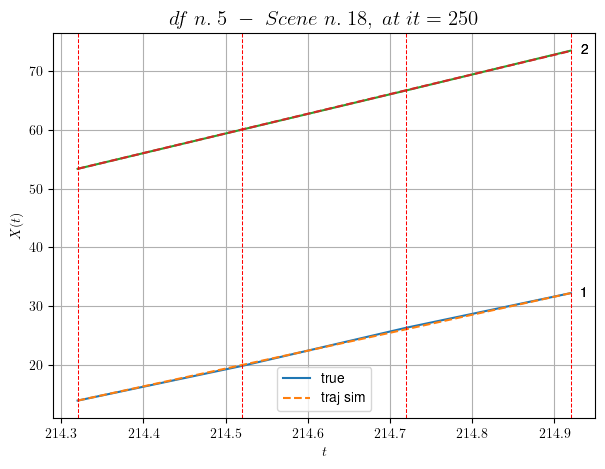

        For scene 18/66
        * use LR_NN=1e-05 with err=0.8448480746871342 at it=24
        * v0_scn_mean = 33.143320035668935
        * MAE = 0.011318278633990424



df n.5, scene n.19/66
    We have 2 time intervals inside [225.72,226.12]
    * err= 0.0002198692093902678
    * Learning rate NN = 0.008999999612569809
    * diff = 1.1166007670389342e-07


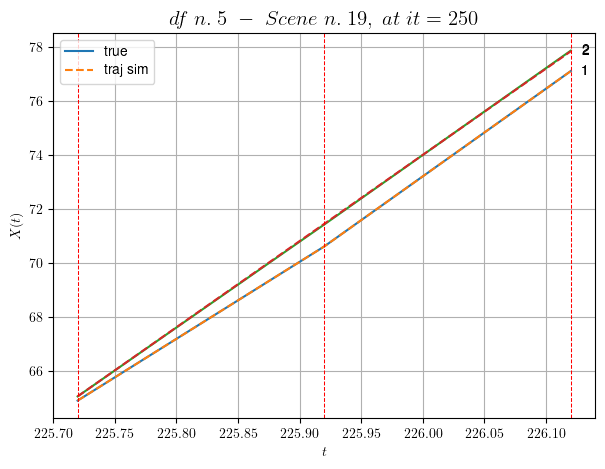

        For scene 19/66
        * use LR_NN=0.01 with err=0.1398965382937421 at it=24
        * v0_scn_mean = 31.859763662748204
        * MAE = 0.0002198692093902678



df n.5, scene n.20/66
    We have 6 time intervals inside [226.72,227.92]
            - Time interval n.0: [226.72, 226.92]
                * y_true: [35.91081855]
                * v_ann: [36.231048583984375, 32.69366457961338]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [226.92, 227.12]
                * y_true: [29.63097708]
                * v_ann: [36.88725280761719, 32.69366457961338]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [227.12, 227.32]
                * y_true: [32.76145219]
                * v_ann: [32.80846405029297, 32.69366457961338]

----------------------------------------------------------------------------------------

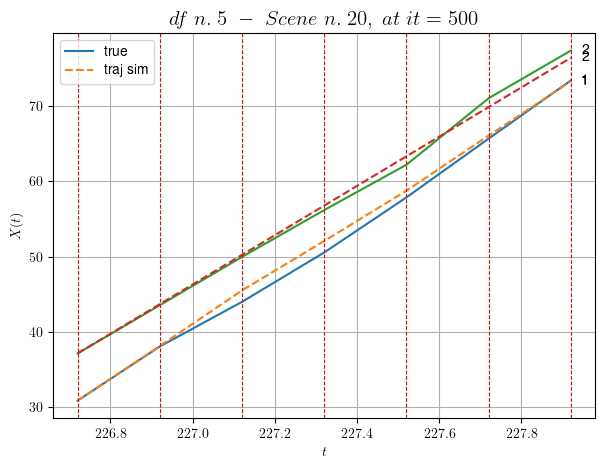

        For scene 20/66
        * use LR_NN=0.001 with err=3.555787137511323 at it=24
        * v0_scn_mean = 32.58591799644941
        * MAE = 0.6313284221352847



df n.5, scene n.21/66
    We have 6 time intervals inside [232.32,233.52]
    * err= 162.6031540340948
    * Learning rate NN = 0.000478296831715852
    * diff = 3.497474665437039e-07


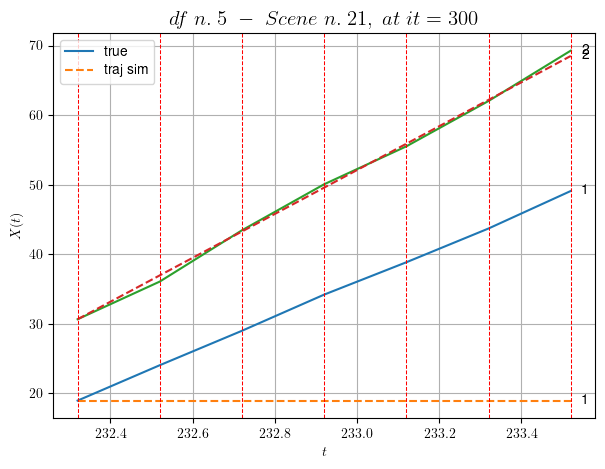

        For scene 21/66
        * use LR_NN=0.001 with err=1.4566704322296014 at it=24
        * v0_scn_mean = 31.43477395584121
        * MAE = 12.964179799917355



df n.5, scene n.22/66
    We have 5 time intervals inside [251.72,252.72]
    * err= 121.4956264200916
    * Learning rate NN = 0.0005904899444431067
    * diff = 1.5735872693767305e-07


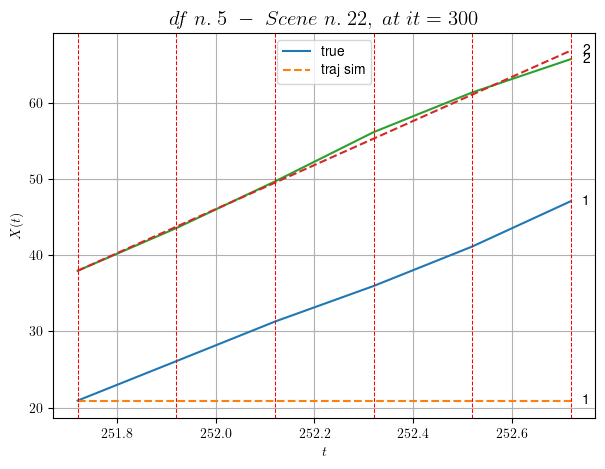

        For scene 22/66
        * use LR_NN=0.001 with err=0.4948575717043332 at it=24
        * v0_scn_mean = 28.983909809018254
        * MAE = 121.4956264200916



df n.5, scene n.23/66
    We have 6 time intervals inside [264.92,266.12]
            - Time interval n.0: [264.92, 265.12]
                * y_true: [20.67034886]
                * v_ann: [-0.00040560931665822864, 29.366788374199814]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [265.12, 265.32]
                * y_true: [29.59071595]
                * v_ann: [-6.511538231279701e-05, 29.366788374199814]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [265.32, 265.52]
                * y_true: [25.33086431]
                * v_ann: [-8.822029485600069e-05, 29.366788374199814]

-------------------------------------------------------------------------

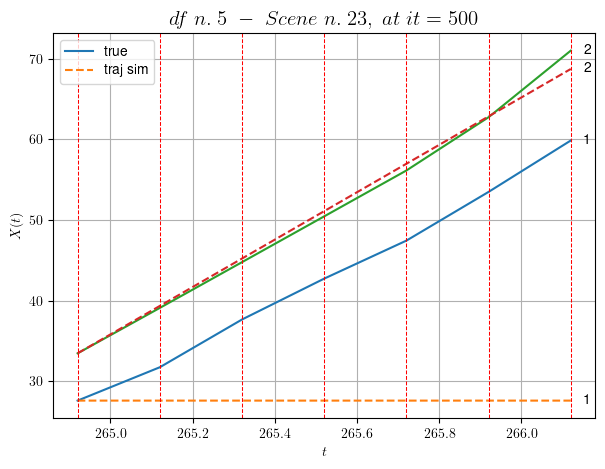

        For scene 23/66
        * use LR_NN=0.0001 with err=0.5280378529741687 at it=24
        * v0_scn_mean = 29.392116839226297
        * MAE = 175.30768593059548



df n.5, scene n.24/66
    We have 7 time intervals inside [274.12,275.52]
    * err= 361.421539232374
    * Learning rate NN = 5.314409008860821e-06
    * diff = 4.915858085041691e-07


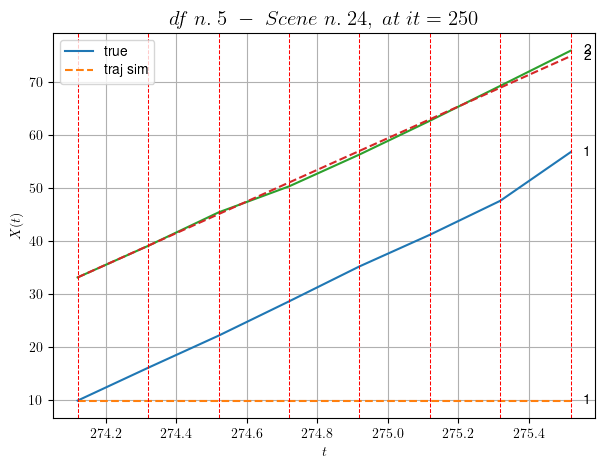

        For scene 24/66
        * use LR_NN=1e-05 with err=1.7896711396767642 at it=24
        * v0_scn_mean = 29.84492131679799
        * MAE = 361.41568524725153



df n.5, scene n.25/66
    We have 2 time intervals inside [280.92,281.32]
    * err= 32.76080220629665
    * Learning rate NN = 8.099998922261875e-06
    * diff = 7.905707377631188e-08


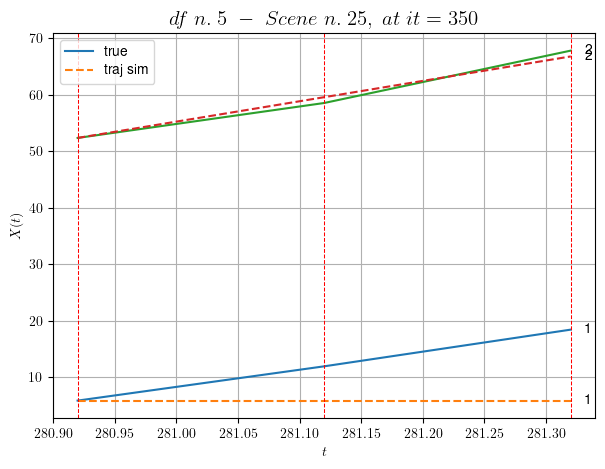

        For scene 25/66
        * use LR_NN=1e-05 with err=1.9929732392202282 at it=24
        * v0_scn_mean = 35.701995822613
        * MAE = 32.76080220629665



df n.5, scene n.26/66
    We have 2 time intervals inside [282.52,282.92]
    * err= 23.72561866664296
    * Learning rate NN = 4.499999704421498e-05
    * diff = 4.399388906506374e-07


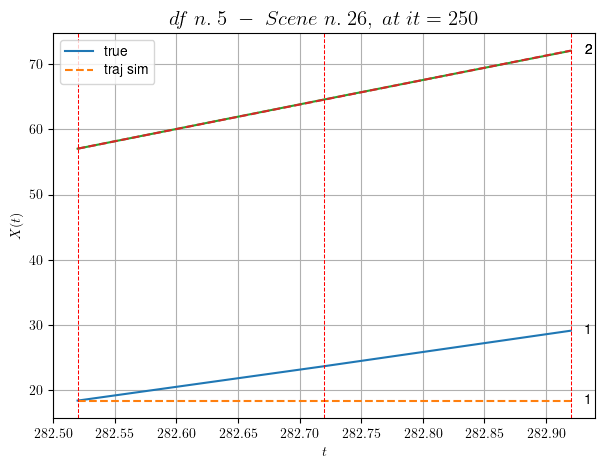

        For scene 26/66
        * use LR_NN=5e-05 with err=1.88337439906143 at it=24
        * v0_scn_mean = 36.93791175039183
        * MAE = 23.725593859978378



df n.5, scene n.27/66
    We have 4 time intervals inside [293.52,294.32]
    * err= 69.79000458611645
    * Learning rate NN = 6.560998735949397e-05
    * diff = 4.326631284357063e-07


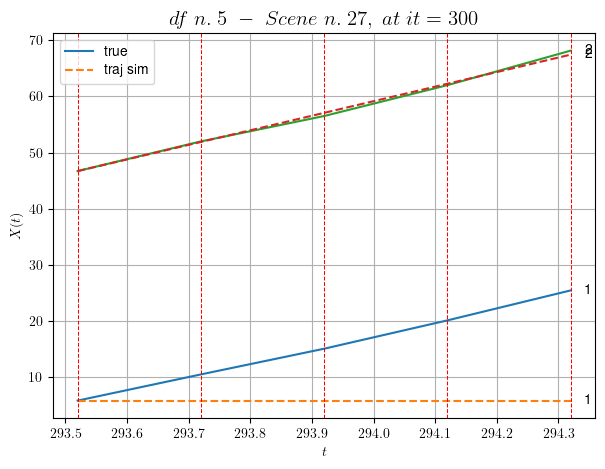

        For scene 27/66
        * use LR_NN=0.0001 with err=1.973369275728574 at it=24
        * v0_scn_mean = 26.201825593884696
        * MAE = 69.78617137880131



df n.5, scene n.28/66
    We have 4 time intervals inside [310.92,311.72]
    * err= 78.20532770790004
    * Learning rate NN = 5.9048988987342454e-06
    * diff = 1.0889715440498549e-07


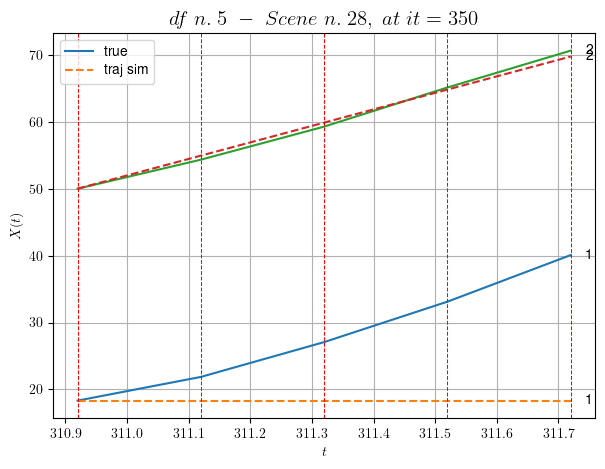

        For scene 28/66
        * use LR_NN=1e-05 with err=4.0718659521123435 at it=24
        * v0_scn_mean = 24.9827033390655
        * MAE = 78.18134792899387



df n.5, scene n.29/66
    We have 7 time intervals inside [326.52,327.92]
    * err= 183.60993882626246
    * Learning rate NN = 0.000430467160185799
    * diff = 3.378339386017615e-07


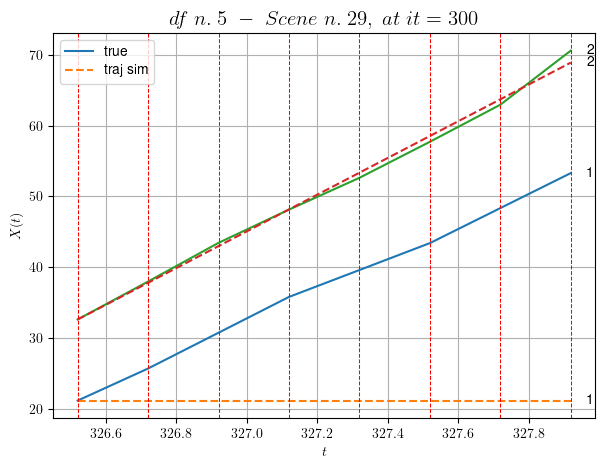

        For scene 29/66
        * use LR_NN=0.001 with err=6.190631556255436 at it=24
        * v0_scn_mean = 26.18286901528348
        * MAE = 183.6091430432761



df n.5, scene n.30/66
    We have 6 time intervals inside [329.32,330.52]
    * err= 172.72141539624843
    * Learning rate NN = 4.7829678806010634e-05
    * diff = 7.005247084634902e-07


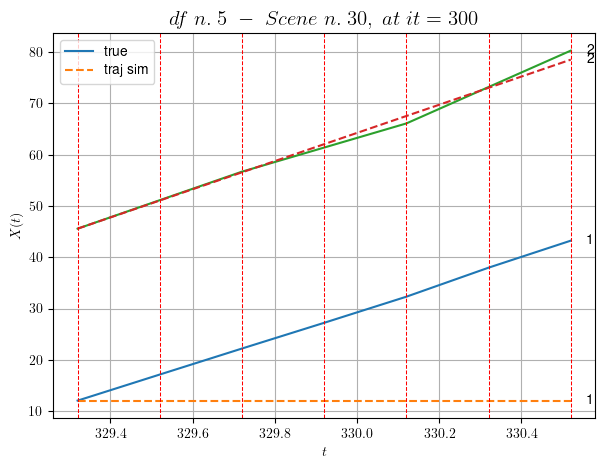

        For scene 30/66
        * use LR_NN=0.0001 with err=1.8358929836996138 at it=24
        * v0_scn_mean = 27.62171734599051
        * MAE = 172.7095908421322



df n.5, scene n.31/66
    We have 7 time intervals inside [332.72,334.12]
    * err= 203.50010946329712
    * Learning rate NN = 0.0002152335800928995
    * diff = 5.536041101095179e-07


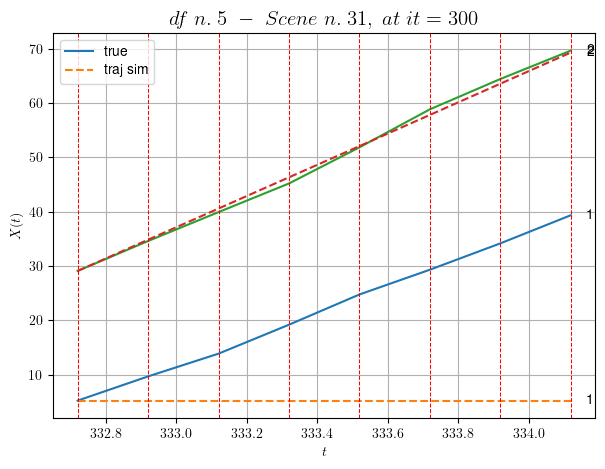

        For scene 31/66
        * use LR_NN=0.0005 with err=0.7137348240647453 at it=24
        * v0_scn_mean = 28.800373411179656
        * MAE = 203.47854115552016



df n.5, scene n.32/66
    We have 9 time intervals inside [337.72,339.52]
            - Time interval n.0: [337.72, 337.92]
                * y_true: [19.16015277]
                * v_ann: [0.0017843330278992653, 27.02003821908801]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [337.92, 338.12]
                * y_true: [22.83026231]
                * v_ann: [0.000292171083856374, 27.02003821908801]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.12, 338.32]
                * y_true: [24.09038948]
                * v_ann: [0.00012815742229577154, 27.02003821908801]

------------------------------------------------------------------------------

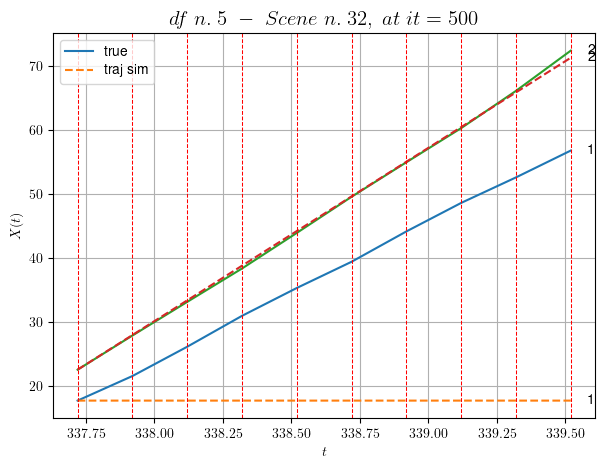

        For scene 32/66
        * use LR_NN=0.001 with err=12.090663229901653 at it=24
        * v0_scn_mean = 27.139236690301317
        * MAE = 270.7659088440827



df n.5, scene n.33/66
    We have 5 time intervals inside [351.12,352.12]
    * err= 172.47451499365323
    * Learning rate NN = 6.560998826898867e-06
    * diff = 7.955176783980278e-07


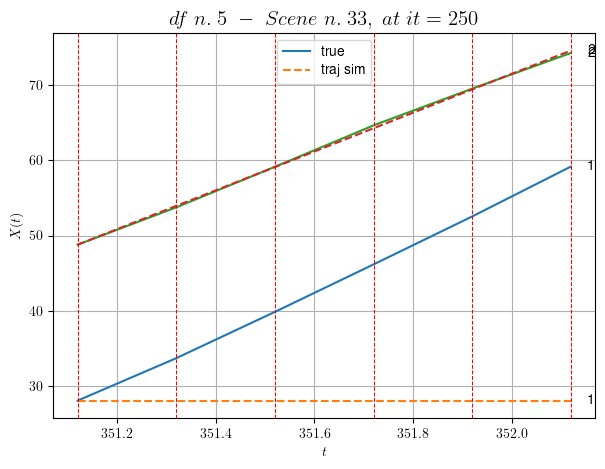

        For scene 33/66
        * use LR_NN=1e-05 with err=3.544978862857992 at it=24
        * v0_scn_mean = 26.16026820235221
        * MAE = 172.47451499365323



df n.5, scene n.34/66
    We have 5 time intervals inside [366.32,367.32]
    * err= 151.01601623269806
    * Learning rate NN = 5.314409008860821e-06
    * diff = 7.852143539821554e-07


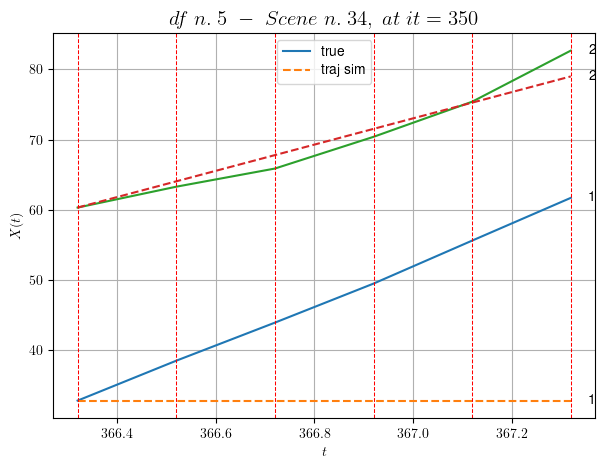

        For scene 34/66
        * use LR_NN=1e-05 with err=21.318496315193652 at it=24
        * v0_scn_mean = 19.359264306635005
        * MAE = 150.8345963367457



df n.5, scene n.35/66
    We have 3 time intervals inside [368.32,368.92]
    * err= 57.689714972419864
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 1.2812109417836837e-07


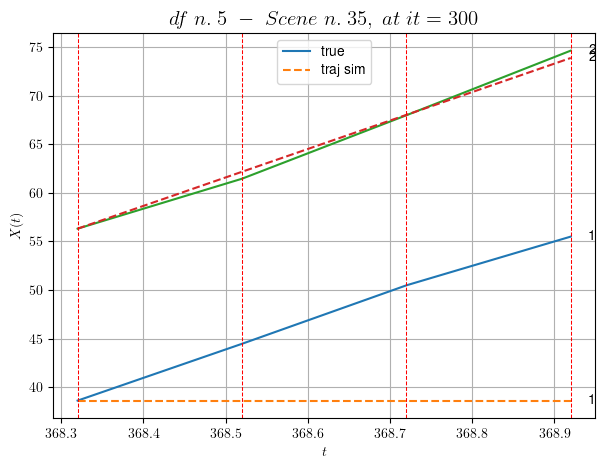

        For scene 35/66
        * use LR_NN=5e-05 with err=0.18568175427213976 at it=24
        * v0_scn_mean = 29.34493000186878
        * MAE = 57.670351590845826



df n.5, scene n.36/66
    We have 2 time intervals inside [395.32,395.72]
    * err= 0.07854192509029534
    * Learning rate NN = 0.008099999278783798
    * diff = 1.8454950254098712e-07


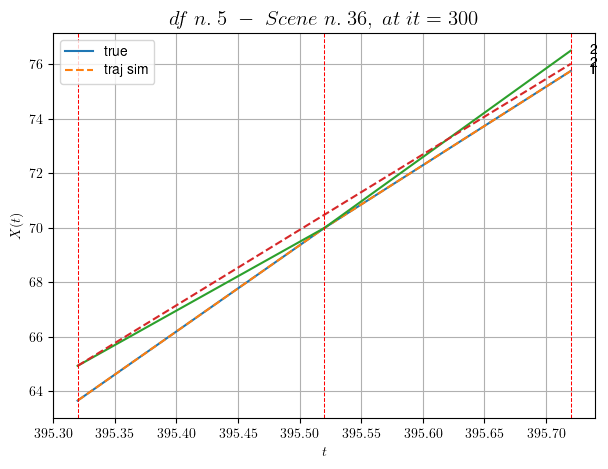

        For scene 36/66
        * use LR_NN=0.01 with err=0.1805404669286665 at it=24
        * v0_scn_mean = 27.85259902676003
        * MAE = 0.07801083149336258



df n.5, scene n.37/66
    We have 2 time intervals inside [396.92,397.32]
            - Time interval n.0: [396.92, 397.12]
                * y_true: [34.6610239]
                * v_ann: [38.79370880126953, 28.23910539262403]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [397.12, 397.32]
                * y_true: [39.0616778]
                * v_ann: [34.76049041748047, 28.23910539262403]

----------------------------------------------------------------------------------------------------
    * err= 0.13499339316344272
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0007206024267909505


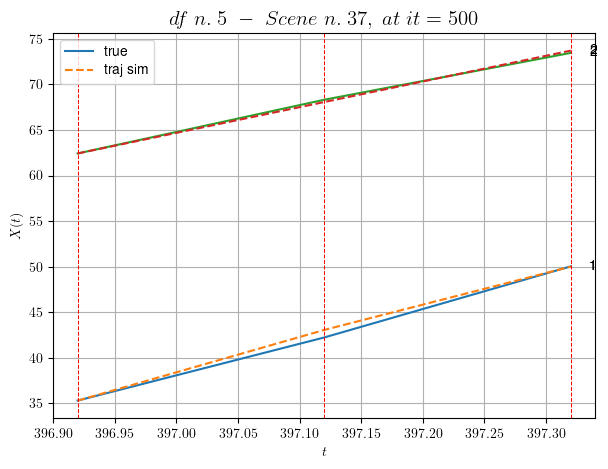

        For scene 37/66
        * use LR_NN=5e-05 with err=0.235040961371618 at it=24
        * v0_scn_mean = 28.309541176905434
        * MAE = 0.13416461928590548



df n.5, scene n.38/66
    We have 3 time intervals inside [407.92,408.52]
    * err= 0.11114685878587957
    * Learning rate NN = 6.560998826898867e-06
    * diff = 6.689386570918332e-07


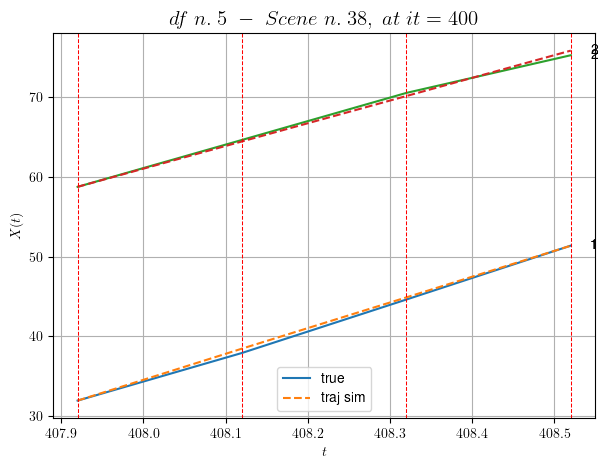

        For scene 38/66
        * use LR_NN=1e-05 with err=0.35716530952731035 at it=24
        * v0_scn_mean = 28.528152993911164
        * MAE = 0.11114685878587957



df n.5, scene n.39/66
    We have 5 time intervals inside [415.32,416.32]
            - Time interval n.0: [415.32, 415.52]
                * y_true: [24.30099057]
                * v_ann: [23.247440338134766, 27.188395316740486]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [415.52, 415.72]
                * y_true: [3.42217247]
                * v_ann: [3.5673277378082275, 27.188395316740486]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [415.72, 415.92]
                * y_true: [36.97197175]
                * v_ann: [32.67155075073242, 27.188395316740486]

-------------------------------------------------------------------------------------

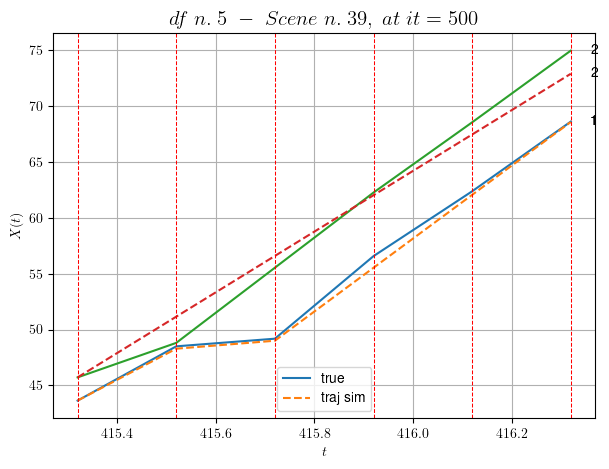

        For scene 39/66
        * use LR_NN=0.001 with err=2.8419636282837963 at it=24
        * v0_scn_mean = 27.300859504050035
        * MAE = 0.9832949969427625



df n.5, scene n.40/66
    We have 3 time intervals inside [431.32,431.92]
            - Time interval n.0: [431.32, 431.52]
                * y_true: [22.38028712]
                * v_ann: [28.437734603881836, 26.58951479678896]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [431.52, 431.72]
                * y_true: [28.04016416]
                * v_ann: [27.65477180480957, 26.58951479678896]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [431.72, 431.92]
                * y_true: [33.23035789]
                * v_ann: [27.631122589111328, 26.58951479678896]

-----------------------------------------------------------------------------------------

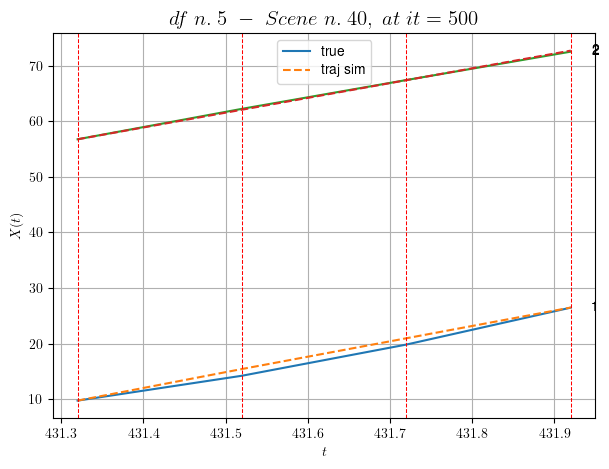

        For scene 40/66
        * use LR_NN=1e-05 with err=1.195873197589521 at it=24
        * v0_scn_mean = 26.725934204891384
        * MAE = 0.34696567024969716



df n.5, scene n.41/66
    We have 8 time intervals inside [445.52,447.12]
            - Time interval n.0: [445.52, 445.72]
                * y_true: [14.80016221]
                * v_ann: [16.811813354492188, 25.63869827600331]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [445.72, 445.92]
                * y_true: [17.50024709]
                * v_ann: [16.8901424407959, 25.63869827600331]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [445.92, 446.12]
                * y_true: [23.10043116]
                * v_ann: [17.445621490478516, 25.63869827600331]

------------------------------------------------------------------------------------------

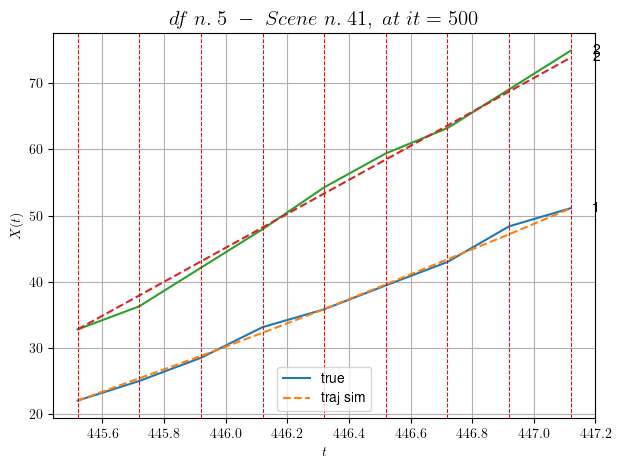

        For scene 41/66
        * use LR_NN=0.0001 with err=10.340328396506893 at it=24
        * v0_scn_mean = 25.813150344929323
        * MAE = 0.5151015308750551



df n.5, scene n.42/66
    We have 5 time intervals inside [449.12,450.12]
            - Time interval n.0: [449.12, 449.32]
                * y_true: [26.30041929]
                * v_ann: [28.84429168701172, 23.52760427573214]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [449.32, 449.52]
                * y_true: [26.14058749]
                * v_ann: [28.438840866088867, 23.52760427573214]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [449.52, 449.72]
                * y_true: [29.23088983]
                * v_ann: [27.961259841918945, 23.52760427573214]

----------------------------------------------------------------------------------------

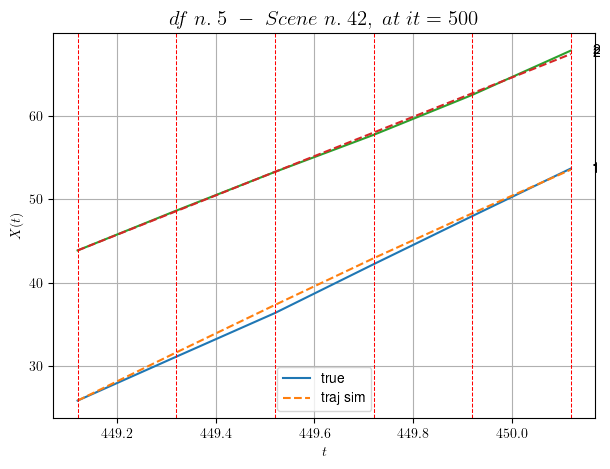

        For scene 42/66
        * use LR_NN=1e-05 with err=7.839809927478094 at it=24
        * v0_scn_mean = 23.786500104653694
        * MAE = 0.1768775802424132



df n.5, scene n.43/66
    We have 3 time intervals inside [450.92,451.52]
            - Time interval n.0: [450.92, 451.12]
                * y_true: [19.05097543]
                * v_ann: [18.05081558227539, 24.877482654595042]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [451.12, 451.32]
                * y_true: [19.05097543]
                * v_ann: [20.72957420349121, 24.877482654595042]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [451.32, 451.52]
                * y_true: [20.07636245]
                * v_ann: [19.263423919677734, 24.877482654595042]

----------------------------------------------------------------------------------------

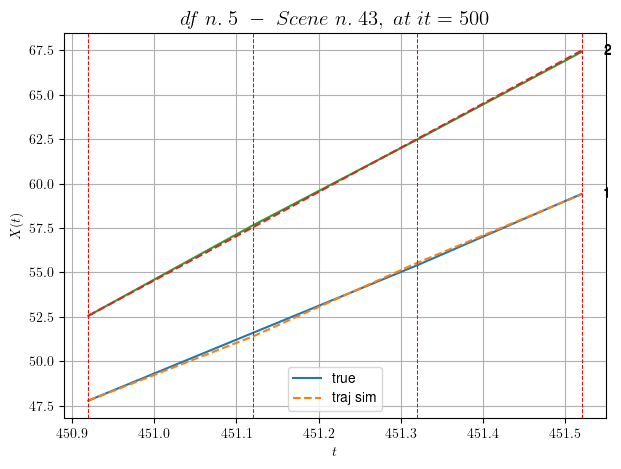

        For scene 43/66
        * use LR_NN=0.005 with err=2.0070598590054805 at it=24
        * v0_scn_mean = 25.08238334837393
        * MAE = 0.009770675356823688



df n.5, scene n.44/66
    We have 5 time intervals inside [457.32,458.32]
            - Time interval n.0: [457.32, 457.52]
                * y_true: [11.94945293]
                * v_ann: [11.299029350280762, 16.493097805853914]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [457.52, 457.72]
                * y_true: [7.74600753]
                * v_ann: [7.940156936645508, 16.493097805853914]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [457.72, 457.92]
                * y_true: [8.72842902]
                * v_ann: [9.401836395263672, 16.493097805853914]

----------------------------------------------------------------------------------------

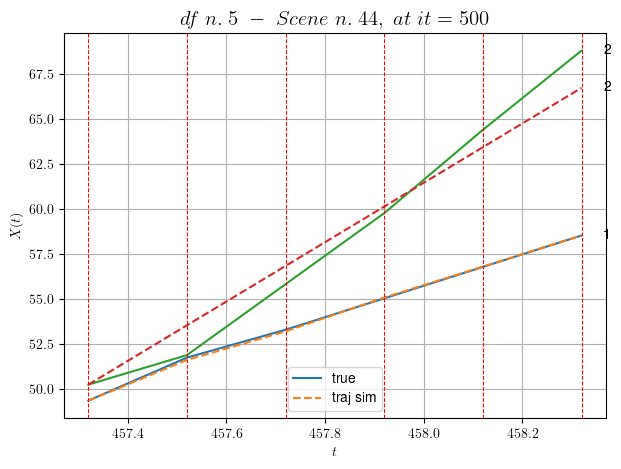

        For scene 44/66
        * use LR_NN=0.005 with err=29.98941952681728 at it=24
        * v0_scn_mean = 17.03337389351612
        * MAE = 0.6477441397206869



df n.5, scene n.45/66
    We have 5 time intervals inside [472.72,473.72]
            - Time interval n.0: [472.72, 472.92]
                * y_true: [19.93584545]
                * v_ann: [22.341646194458008, 19.3947390274162]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [472.92, 473.12]
                * y_true: [20.45091523]
                * v_ann: [22.046079635620117, 19.3947390274162]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [473.12, 473.32]
                * y_true: [22.97126692]
                * v_ann: [22.200000762939453, 19.3947390274162]

---------------------------------------------------------------------------------------------

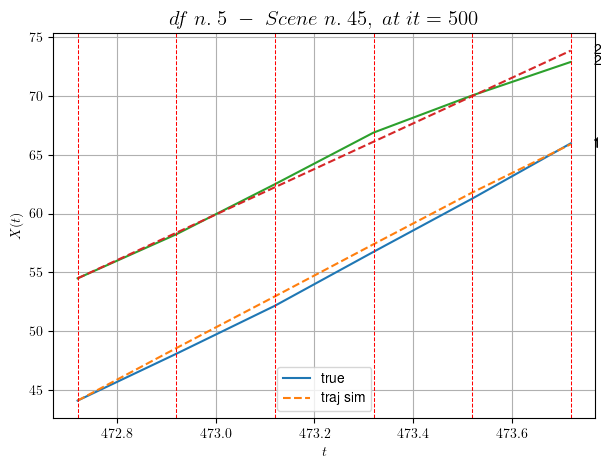

        For scene 45/66
        * use LR_NN=5e-05 with err=21.60659328597937 at it=24
        * v0_scn_mean = 19.818949466238397
        * MAE = 0.26514069875954205



df n.5, scene n.46/66
    We have 2 time intervals inside [490.92,491.32]
            - Time interval n.0: [490.92, 491.12]
                * y_true: [23.97608635]
                * v_ann: [22.939395904541016, 29.115594759202047]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [491.12, 491.32]
                * y_true: [23.6265296]
                * v_ann: [24.558725357055664, 29.115594759202047]

----------------------------------------------------------------------------------------------------
    * err= 0.012306566714543946
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.00010190008071630369


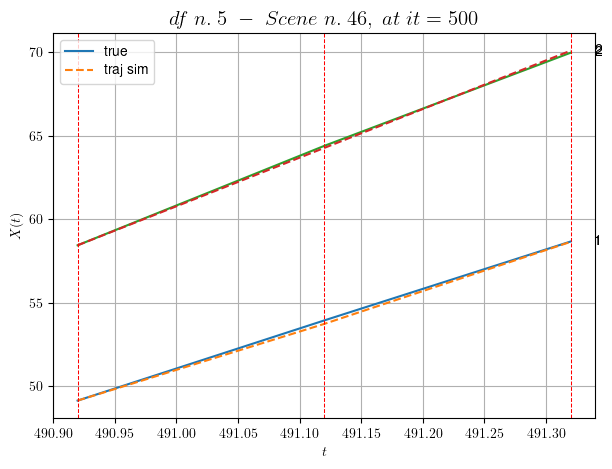

        For scene 46/66
        * use LR_NN=0.0005 with err=0.07516521642431705 at it=24
        * v0_scn_mean = 29.15097096883077
        * MAE = 0.012306566714543946



df n.5, scene n.47/66
    We have 2 time intervals inside [496.72,497.12]
    * err= 0.05552772655218064
    * Learning rate NN = 0.008099999278783798
    * diff = 3.364744715211865e-07


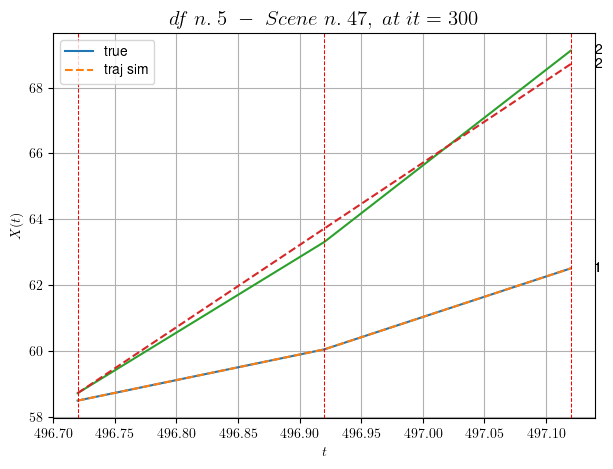

        For scene 47/66
        * use LR_NN=0.01 with err=0.749543353747601 at it=24
        * v0_scn_mean = 25.343568444427394
        * MAE = 0.04997553025422722



df n.5, scene n.48/66
    We have 5 time intervals inside [502.72,503.72]
            - Time interval n.0: [502.72, 502.92]
                * y_true: [19.30098453]
                * v_ann: [25.8376407623291, 13.651414022050044]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [502.92, 503.12]
                * y_true: [23.85148399]
                * v_ann: [23.745067596435547, 13.651414022050044]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [503.12, 503.32]
                * y_true: [30.67723317]
                * v_ann: [23.043603897094727, 13.651414022050044]

----------------------------------------------------------------------------------------

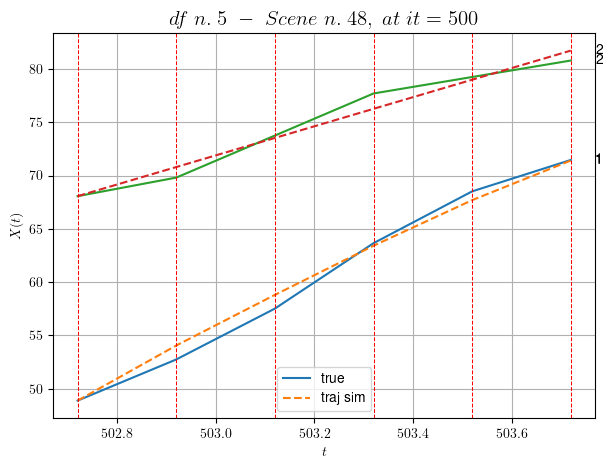

        For scene 48/66
        * use LR_NN=5e-05 with err=49.85125093689326 at it=24
        * v0_scn_mean = 14.305357461043135
        * MAE = 0.6780268861353118



df n.5, scene n.49/66
    We have 3 time intervals inside [525.52,526.12]
            - Time interval n.0: [525.52, 525.72]
                * y_true: [20.6706729]
                * v_ann: [23.589454650878906, 23.539355454248636]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [525.72, 525.92]
                * y_true: [22.29092446]
                * v_ann: [23.18976402282715, 23.539355454248636]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [525.92, 526.12]
                * y_true: [27.65144368]
                * v_ann: [23.971839904785156, 23.539355454248636]

----------------------------------------------------------------------------------------

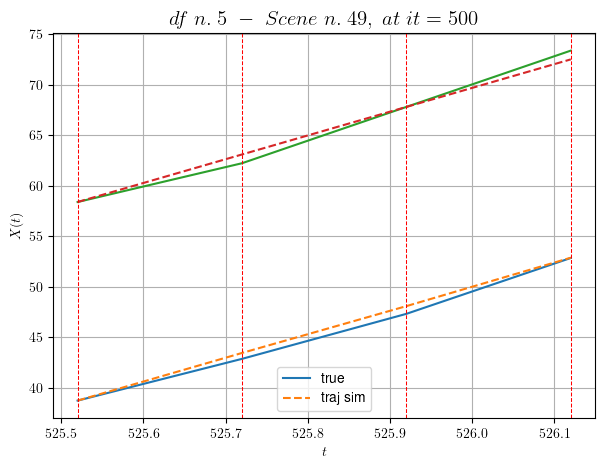

        For scene 49/66
        * use LR_NN=5e-05 with err=2.660123792688748 at it=24
        * v0_scn_mean = 23.79778123602914
        * MAE = 0.28311207693426776



df n.5, scene n.50/66
    We have 2 time intervals inside [533.12,533.52]
    * err= 0.03619433618259851
    * Learning rate NN = 0.00040499999886378646
    * diff = 9.425408942290159e-07


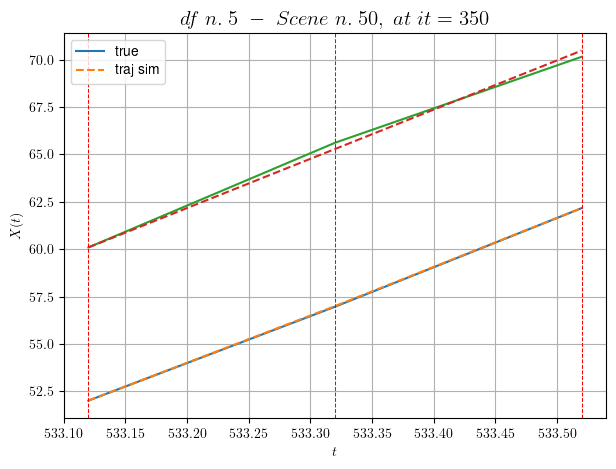

        For scene 50/66
        * use LR_NN=0.0005 with err=0.672593025403663 at it=24
        * v0_scn_mean = 26.18022198634277
        * MAE = 0.03619433618259851



df n.5, scene n.51/66
    We have 3 time intervals inside [535.32,535.92]
            - Time interval n.0: [535.32, 535.52]
                * y_true: [13.74931105]
                * v_ann: [12.816435813903809, 21.278077520483933]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [535.52, 535.72]
                * y_true: [8.15050406]
                * v_ann: [9.664864540100098, 21.278077520483933]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [535.72, 535.92]
                * y_true: [19.77148161]
                * v_ann: [19.50918197631836, 21.278077520483933]

----------------------------------------------------------------------------------------

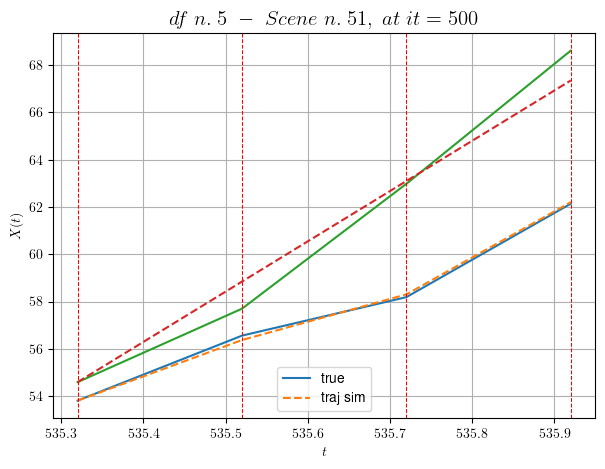

        For scene 51/66
        * use LR_NN=0.005 with err=4.705890814924879 at it=24
        * v0_scn_mean = 21.62695441960097
        * MAE = 0.3722835305657622



df n.5, scene n.52/66
    We have 4 time intervals inside [23.72,24.52]
            - Time interval n.0: [23.72, 23.92]
                * y_true: [21.79018354 24.07032953]
                * v_ann: [-0.0021683848462998867, -3.364525839558721e-23, 24.534803734519368]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.92, 24.12]
                * y_true: [25.91031727 27.52052784]
                * v_ann: [-0.0009293630137108266, -6.963247442482007e-23, 24.534803734519368]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.12, 24.32]
                * y_true: [19.61033273 24.42062846]
                * v_ann: [-0.0005109165795147419, -3.7490179069408904e

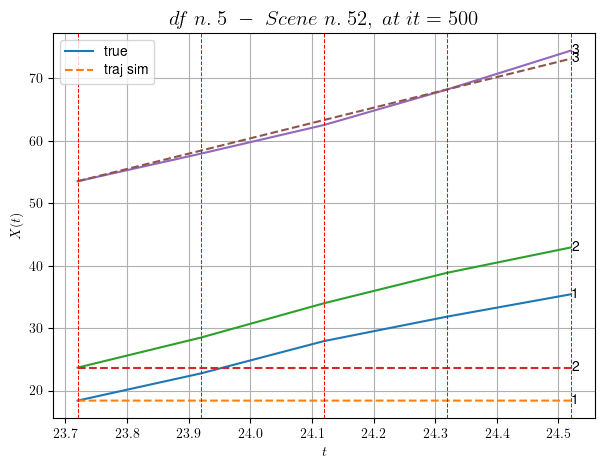

        For scene 52/66
        * use LR_NN=0.001 with err=14.79277663106175 at it=24
        * v0_scn_mean = 24.86271526507275
        * MAE = 50.9706520088619



df n.5, scene n.53/66
    We have 3 time intervals inside [28.12,28.72]
    * err= 62.86954747336312
    * Learning rate NN = 6.560998826898867e-06
    * diff = 3.5787392960173747e-07


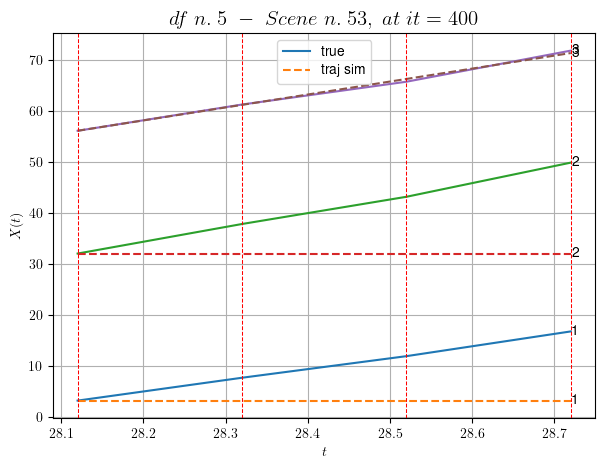

        For scene 53/66
        * use LR_NN=1e-05 with err=4.52265081817227 at it=24
        * v0_scn_mean = 25.725929368611094
        * MAE = 62.86855598006026



df n.5, scene n.54/66
    We have 3 time intervals inside [146.52,147.12]
            - Time interval n.0: [146.52, 146.72]
                * y_true: [32.70054419 14.69037585]
                * v_ann: [24.056310653686523, 23.387916564941406, 33.24718527812282]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [146.72, 146.92]
                * y_true: [35.65090038 15.01046474]
                * v_ann: [24.570093154907227, 22.96070671081543, 33.24718527812282]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [146.92, 147.12]
                * y_true: [28.09191726 21.83491468]
                * v_ann: [25.516624450683594, 27.12762451171875, 33.24718527812282

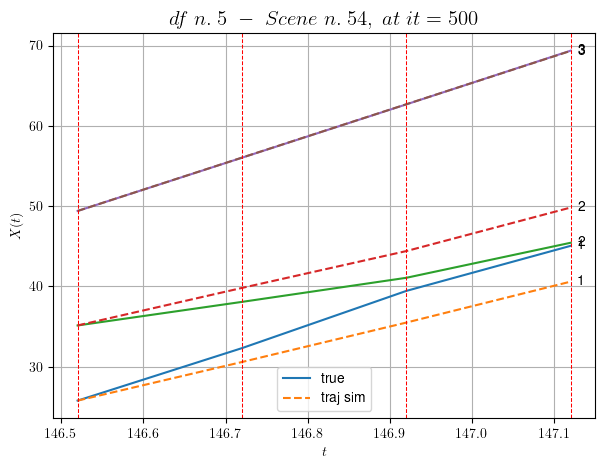

        For scene 54/66
        * use LR_NN=0.001 with err=24.95524716640259 at it=24
        * v0_scn_mean = 33.05235430722714
        * MAE = 2.929601054465522



df n.5, scene n.55/66
    We have 2 time intervals inside [151.12,151.52]
            - Time interval n.0: [151.12, 151.32]
                * y_true: [20.88055844 29.97204611]
                * v_ann: [29.64701271057129, 26.76089859008789, 31.516138737957654]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [151.32, 151.52]
                * y_true: [26.72089495 29.6522691 ]
                * v_ann: [25.45453643798828, 24.538646697998047, 31.516138737957654]

----------------------------------------------------------------------------------------------------
    * err= 0.9879047246325167
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.010379270776631921


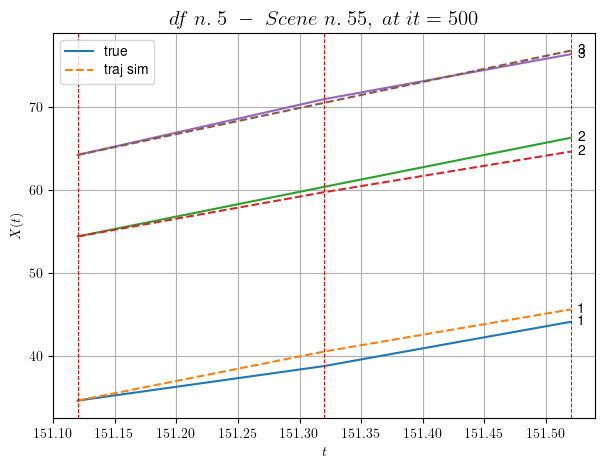

        For scene 55/66
        * use LR_NN=0.0005 with err=5.240752807527586 at it=24
        * v0_scn_mean = 31.42517048175173
        * MAE = 0.6274932257083515



df n.5, scene n.56/66
    We have 6 time intervals inside [177.32,178.52]
            - Time interval n.0: [177.32, 177.52]
                * y_true: [23.78017477 21.57540501]
                * v_ann: [27.804298400878906, 29.21976089477539, 26.180378384786604]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [177.52, 177.72]
                * y_true: [28.99044664 21.37044807]
                * v_ann: [25.08322525024414, 25.487548828125, 26.180378384786604]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [177.72, 177.92]
                * y_true: [30.9005134  20.55062028]
                * v_ann: [24.9378719329834, 25.429126739501953, 26.180378384786604

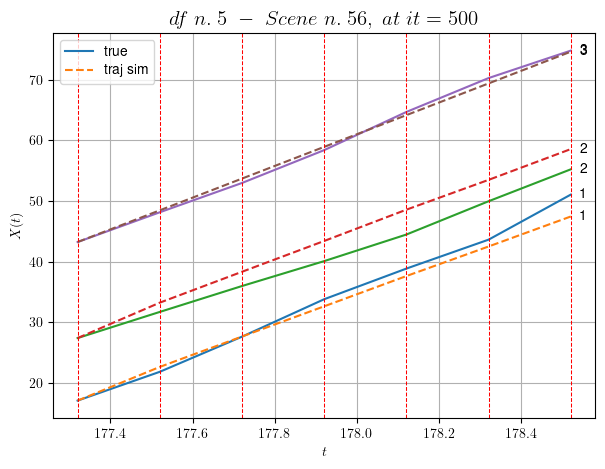

        For scene 56/66
        * use LR_NN=0.001 with err=31.86936152044444 at it=24
        * v0_scn_mean = 26.409555510206506
        * MAE = 3.7731402377048315



df n.5, scene n.57/66
    We have 2 time intervals inside [266.92,267.32]
            - Time interval n.0: [266.92, 267.12]
                * y_true: [18.75024149 31.34179995]
                * v_ann: [31.158077239990234, 29.362911224365234, 29.085701625926752]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [267.12, 267.32]
                * y_true: [26.80047756 43.40316595]
                * v_ann: [30.338951110839844, 28.85292625427246, 29.085701625926752]

----------------------------------------------------------------------------------------------------
    * err= 3.1001609706286093
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.022169063005390566


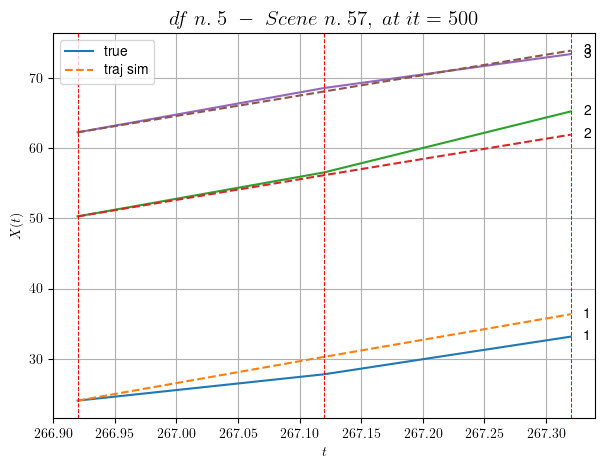

        For scene 57/66
        * use LR_NN=5e-05 with err=13.20422412959582 at it=24
        * v0_scn_mean = 29.1405594873209
        * MAE = 3.1001609706286093



df n.5, scene n.58/66
    We have 2 time intervals inside [316.92,317.32]
            - Time interval n.0: [316.92, 317.12]
                * y_true: [22.23560763 28.12633872]
                * v_ann: [25.215463638305664, 25.256126403808594, 22.342045861211055]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.12, 317.32]
                * y_true: [22.67586827 27.74684297]
                * v_ann: [25.149078369140625, 25.158796310424805, 22.342045861211055]

----------------------------------------------------------------------------------------------------
    * err= 0.3426132337479091
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0009304678398580624


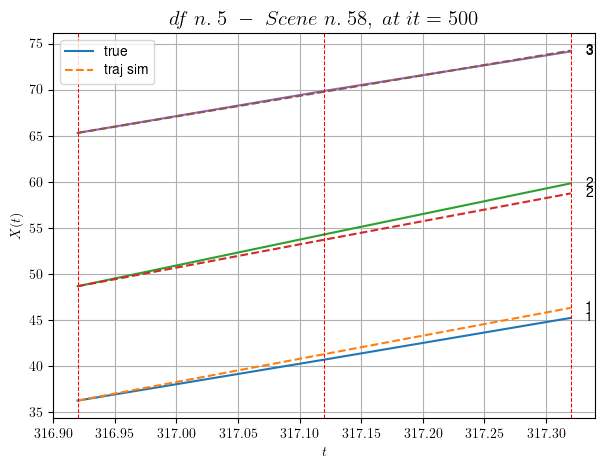

        For scene 58/66
        * use LR_NN=0.001 with err=1.3474483174364107 at it=24
        * v0_scn_mean = 22.801522765712672
        * MAE = 0.3146075244905031



df n.5, scene n.59/66
    We have 2 time intervals inside [319.52,319.92]
    * err= 0.03134210211984698
    * Learning rate NN = 0.0007289999630302191
    * diff = 2.9048446984619725e-07


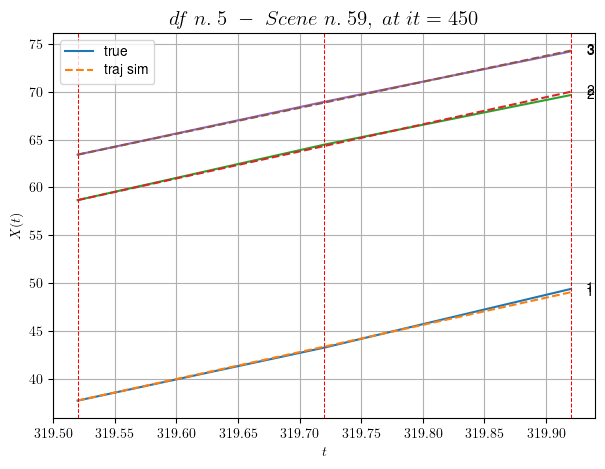

        For scene 59/66
        * use LR_NN=0.001 with err=7.3170781466511805 at it=24
        * v0_scn_mean = 27.40762911722512
        * MAE = 0.027501841567631274



df n.5, scene n.60/66
    We have 2 time intervals inside [330.12,330.52]
            - Time interval n.0: [330.12, 330.32]
                * y_true: [27.05007287 28.28069592]
                * v_ann: [27.685611724853516, 27.538158416748047, 35.478683267491284]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [330.32, 330.52]
                * y_true: [28.75016695 26.32589786]
                * v_ann: [27.69627571105957, 27.538732528686523, 35.478683267491284]

----------------------------------------------------------------------------------------------------
    * err= 0.006006532082039217
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 1.4394227168940815e-05


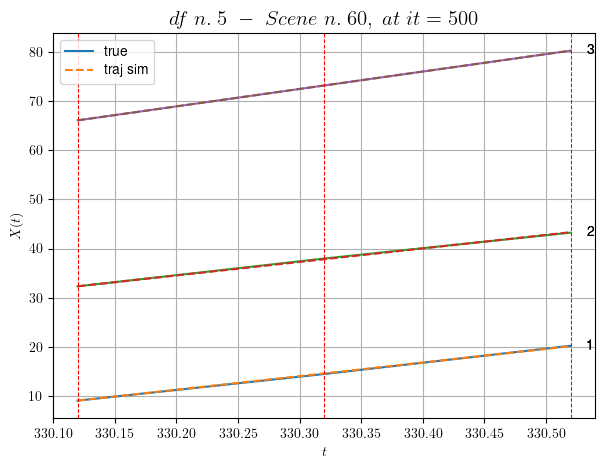

        For scene 60/66
        * use LR_NN=5e-05 with err=1.9275440465439333 at it=24
        * v0_scn_mean = 35.149962517422836
        * MAE = 0.005930709812352984



df n.5, scene n.61/66
    We have 5 time intervals inside [338.52,339.52]
            - Time interval n.0: [338.52, 338.72]
                * y_true: [22.83038671 20.44060351]
                * v_ann: [23.97696304321289, 24.01738166809082, 27.853928426096157]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [338.72, 338.92]
                * y_true: [25.85061095 23.65082523]
                * v_ann: [23.268945693969727, 23.294422149658203, 27.853928426096157]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.92, 339.12]
                * y_true: [28.6708889  22.23087004]
                * v_ann: [23.68196678161621, 23.827232360839844, 27.85392842

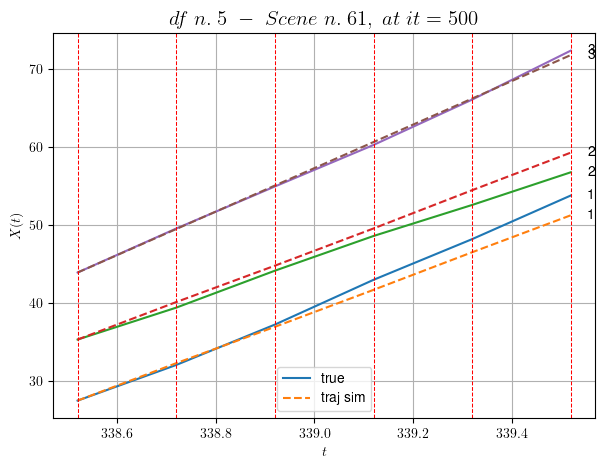

        For scene 61/66
        * use LR_NN=0.001 with err=10.812005713307599 at it=24
        * v0_scn_mean = 27.98269262417592
        * MAE = 1.2942766182222192



df n.5, scene n.62/66
    We have 5 time intervals inside [435.72,436.72]
            - Time interval n.0: [435.72, 435.92]
                * y_true: [16.6003121  32.10080247]
                * v_ann: [20.55099868774414, 19.002180099487305, 23.002269478052625]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [435.92, 436.12]
                * y_true: [17.55040576 22.4007406 ]
                * v_ann: [20.85218620300293, 20.31902313232422, 23.002269478052625]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [436.12, 436.32]
                * y_true: [16.72550921 26.8011085 ]
                * v_ann: [20.723148345947266, 20.17236328125, 23.002269478052625

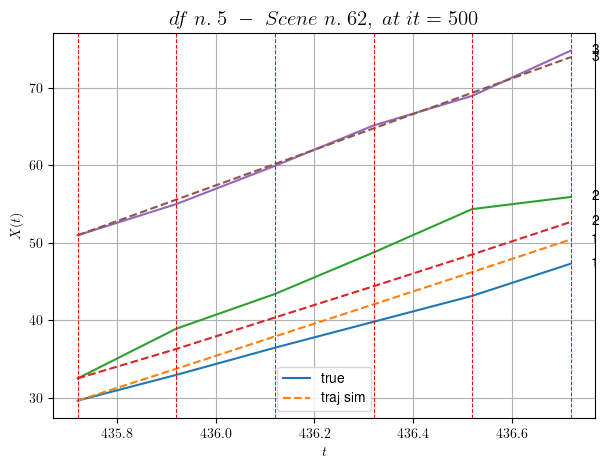

        For scene 62/66
        * use LR_NN=0.0005 with err=11.445765866221189 at it=24
        * v0_scn_mean = 23.422132995186235
        * MAE = 5.949829045206566



df n.5, scene n.63/66
    We have 2 time intervals inside [565.12,565.52]
            - Time interval n.0: [565.12, 565.32]
                * y_true: [12.82514463 16.9507403 ]
                * v_ann: [15.695290565490723, 16.247024536132812, 20.750313634269958]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [565.32, 565.52]
                * y_true: [14.2510345  19.19106683]
                * v_ann: [15.416733741760254, 16.011886596679688, 20.750313634269958]

----------------------------------------------------------------------------------------------------
    * err= 0.17908597094013548
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.002036969706076752


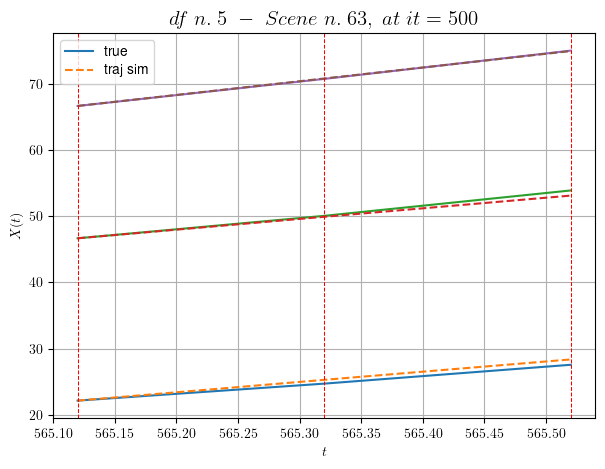

        For scene 63/66
        * use LR_NN=0.0001 with err=2.4978896855218076 at it=24
        * v0_scn_mean = 21.30529440092335
        * MAE = 0.160082024814773



df n.5, scene n.64/66
    We have 3 time intervals inside [578.92,579.52]
    * err= 0.10199478960754745
    * Learning rate NN = 3.2804993679746985e-05
    * diff = 2.4271282768328906e-07


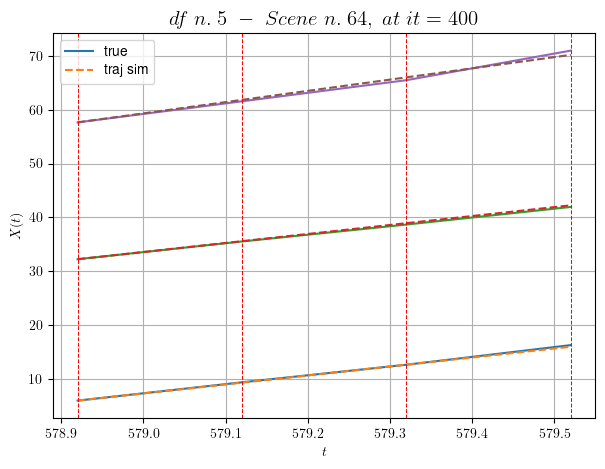

        For scene 64/66
        * use LR_NN=5e-05 with err=3.627990794836352 at it=24
        * v0_scn_mean = 21.597864239641957
        * MAE = 0.09552059614181485



df n.5, scene n.65/66
    We have 2 time intervals inside [178.12,178.52]
            - Time interval n.0: [178.12, 178.32]
                * y_true: [23.59034379 23.87574209 27.4762805 ]
                * v_ann: [27.356903076171875, 26.44282341003418, 28.078577041625977, 26.19236210839537]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [178.32, 178.52]
                * y_true: [17.35034213 37.1766426  26.34131635]
                * v_ann: [24.415040969848633, 24.7564697265625, 24.119827270507812, 26.19236210839537]

----------------------------------------------------------------------------------------------------
    * err= 0.8147562409215336
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0003434663022476858


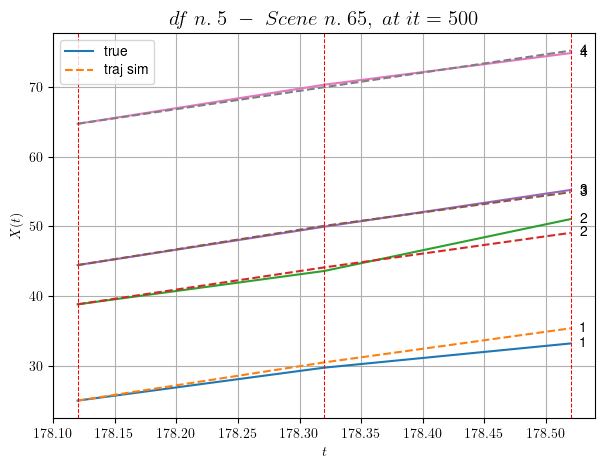

        For scene 65/66
        * use LR_NN=0.001 with err=6.668576161681484 at it=24
        * v0_scn_mean = 26.49696074916654
        * MAE = 0.8147562409215336



For df=5 with 66 scenes, time taken:        1023.48
****************************************************************************************************
****************************************************************************************************
In df n.6/10 we have 52 scenes
df n.6, scene n.0/52
    We have 4 time intervals inside [14.80,15.60]
    * err= 0.009796000008502915
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 3.8216785175695933e-07


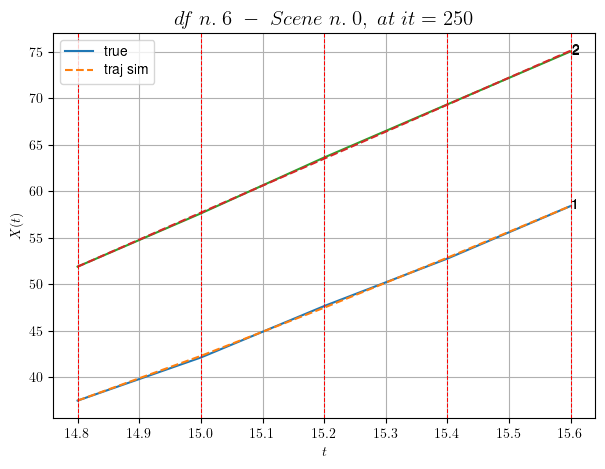

        For scene 0/52
        * use LR_NN=5e-05 with err=0.11843033255401605 at it=24
        * v0_scn_mean = 29.13253007814259
        * MAE = 0.009772647181684647



df n.6, scene n.1/52
    We have 9 time intervals inside [24.60,26.40]
            - Time interval n.0: [24.60, 24.80]
                * y_true: [17.23002109]
                * v_ann: [21.28420066833496, 20.072543725791686]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [24.80, 25.00]
                * y_true: [20.13005018]
                * v_ann: [21.290014266967773, 20.072543725791686]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [25.00, 25.20]
                * y_true: [20.48009455]
                * v_ann: [20.702651977539062, 20.072543725791686]

----------------------------------------------------------------------------------------------

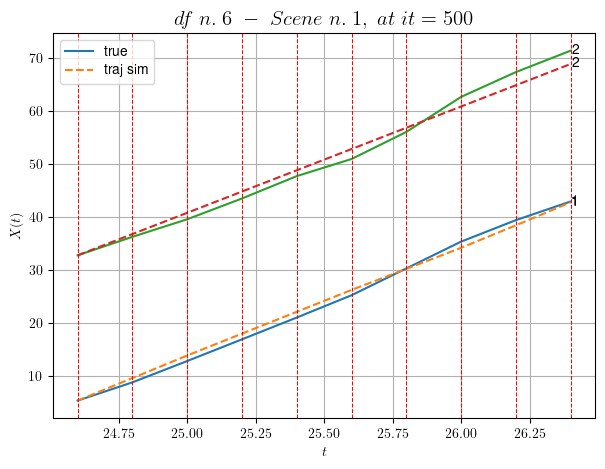

        For scene 1/52
        * use LR_NN=1e-05 with err=51.84767589425641 at it=24
        * v0_scn_mean = 20.469641976684134
        * MAE = 1.4470059267469781



df n.6, scene n.2/52
    We have 5 time intervals inside [29.80,30.80]
            - Time interval n.0: [29.80, 30.00]
                * y_true: [20.15002211]
                * v_ann: [18.592817306518555, 24.207929046504987]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [30.00, 30.20]
                * y_true: [22.29006024]
                * v_ann: [19.7586669921875, 24.207929046504987]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [30.20, 30.40]
                * y_true: [20.82009504]
                * v_ann: [20.112491607666016, 24.207929046504987]

--------------------------------------------------------------------------------------------------

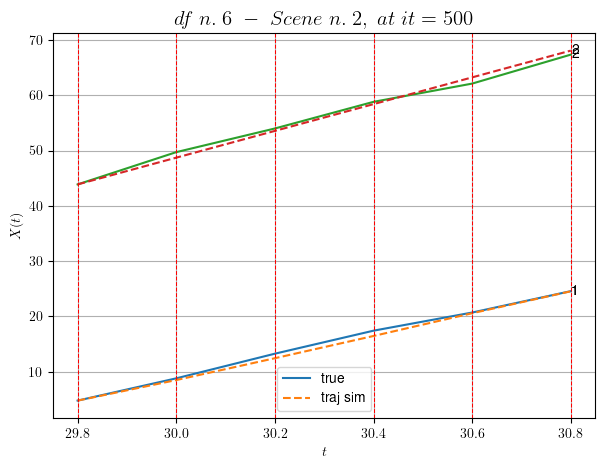

        For scene 2/52
        * use LR_NN=5e-05 with err=7.458841983553149 at it=24
        * v0_scn_mean = 24.439611884600506
        * MAE = 0.40184546121041154



df n.6, scene n.3/52
    We have 5 time intervals inside [31.80,32.80]
            - Time interval n.0: [31.80, 32.00]
                * y_true: [28.45012265]
                * v_ann: [33.73530578613281, 21.080205380799715]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [32.00, 32.20]
                * y_true: [30.25025199]
                * v_ann: [30.79598617553711, 21.080205380799715]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [32.20, 32.40]
                * y_true: [30.60042484]
                * v_ann: [29.592105865478516, 21.080205380799715]

-------------------------------------------------------------------------------------------------

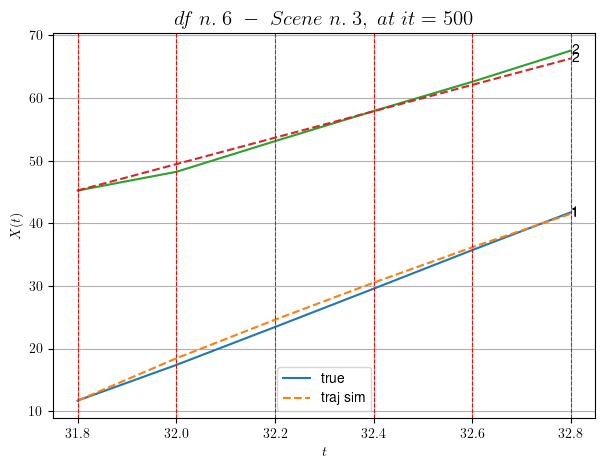

        For scene 3/52
        * use LR_NN=1e-05 with err=13.41690667969083 at it=24
        * v0_scn_mean = 21.436997165499577
        * MAE = 0.5605131186388215



df n.6, scene n.4/52
    We have 5 time intervals inside [66.40,67.40]
            - Time interval n.0: [66.40, 66.60]
                * y_true: [31.42032719]
                * v_ann: [31.020193099975586, 29.946012102239543]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [66.60, 66.80]
                * y_true: [25.99042753]
                * v_ann: [29.959285736083984, 29.946012102239543]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [66.80, 67.00]
                * y_true: [29.58069783]
                * v_ann: [29.32529640197754, 29.946012102239543]

-------------------------------------------------------------------------------------------------

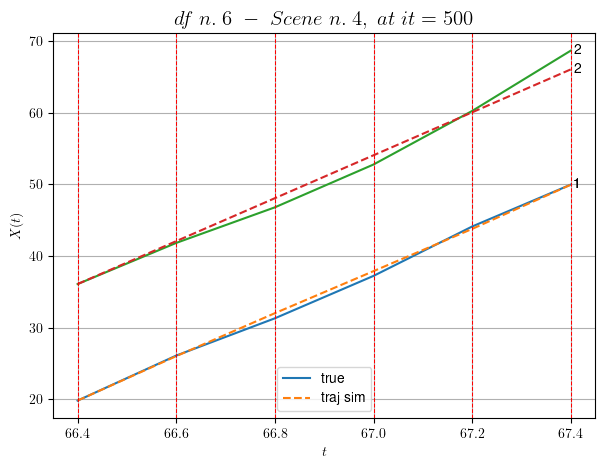

        For scene 4/52
        * use LR_NN=5e-05 with err=0.9341536794623815 at it=24
        * v0_scn_mean = 29.948171618149665
        * MAE = 0.9331374226900235



df n.6, scene n.5/52
    We have 3 time intervals inside [72.20,72.80]
    * err= 0.18050005246822554
    * Learning rate NN = 6.560998735949397e-05
    * diff = 1.4889518182292782e-07


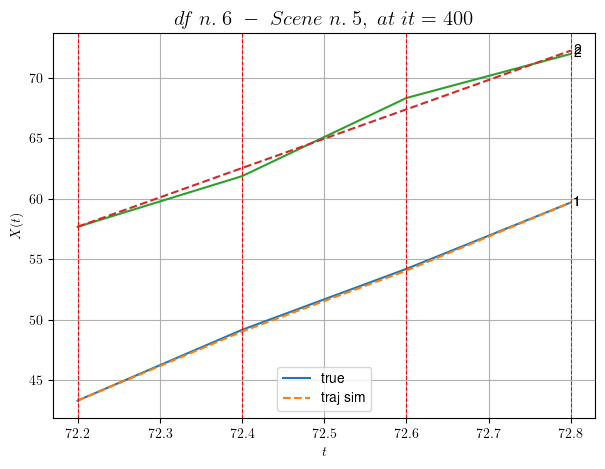

        For scene 5/52
        * use LR_NN=0.0001 with err=2.3574297453150543 at it=24
        * v0_scn_mean = 24.565450977844776
        * MAE = 0.17941770028295667



df n.6, scene n.6/52
    We have 7 time intervals inside [73.80,75.20]
            - Time interval n.0: [73.80, 74.00]
                * y_true: [20.58483588]
                * v_ann: [20.25115966796875, 22.20554837243085]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [74.00, 74.20]
                * y_true: [12.25168131]
                * v_ann: [20.098899841308594, 22.20554837243085]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [74.20, 74.40]
                * y_true: [25.70645636]
                * v_ann: [18.742944717407227, 22.20554837243085]

-------------------------------------------------------------------------------------------------

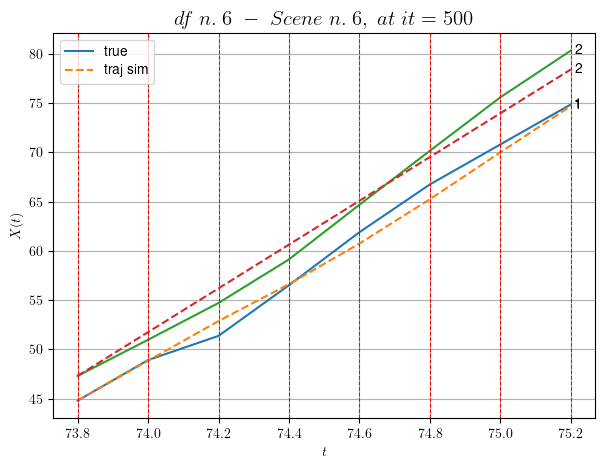

        For scene 6/52
        * use LR_NN=0.005 with err=20.409174094084676 at it=24
        * v0_scn_mean = 22.51732643747375
        * MAE = 1.1511395514906844



df n.6, scene n.7/52
    We have 4 time intervals inside [86.60,87.40]
            - Time interval n.0: [86.60, 86.80]
                * y_true: [8.95018469]
                * v_ann: [10.052814483642578, 28.176915163685493]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.80, 87.00]
                * y_true: [11.65030459]
                * v_ann: [9.929855346679688, 28.176915163685493]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [87.00, 87.20]
                * y_true: [11.65030459]
                * v_ann: [10.23572063446045, 28.176915163685493]

---------------------------------------------------------------------------------------------------

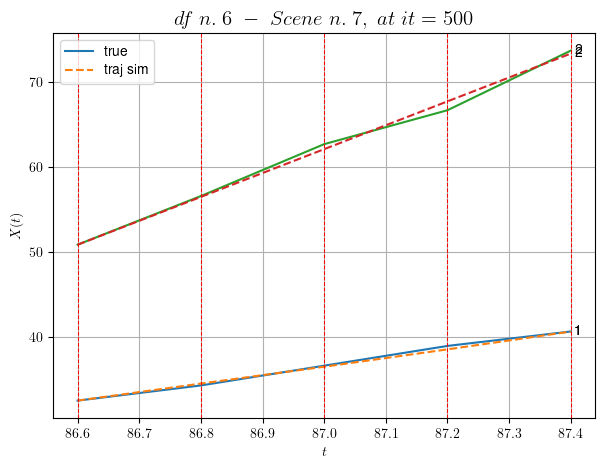

        For scene 7/52
        * use LR_NN=5e-05 with err=0.7549753589753136 at it=24
        * v0_scn_mean = 28.249838557124924
        * MAE = 0.18031221448246088



df n.6, scene n.8/52
    We have 7 time intervals inside [99.40,100.80]
            - Time interval n.0: [99.40, 99.60]
                * y_true: [26.75071408]
                * v_ann: [27.275083541870117, 20.172301927390844]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [99.60, 99.80]
                * y_true: [25.15087073]
                * v_ann: [25.167638778686523, 20.172301927390844]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [99.80, 100.00]
                * y_true: [14.1505841]
                * v_ann: [23.576065063476562, 20.172301927390844]

---------------------------------------------------------------------------------------------

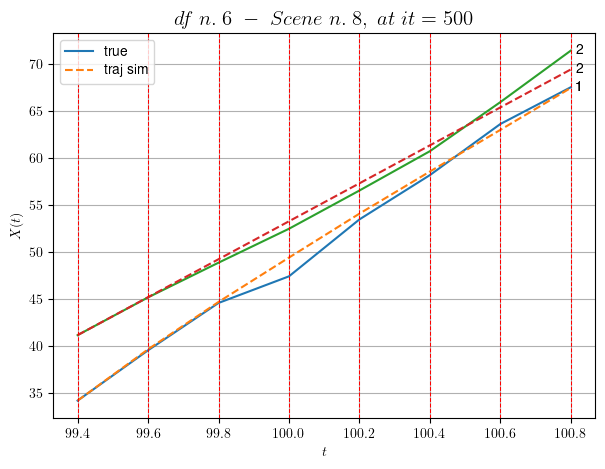

        For scene 8/52
        * use LR_NN=0.001 with err=33.940468665544955 at it=24
        * v0_scn_mean = 20.56540985022011
        * MAE = 0.6822392934451851



df n.6, scene n.9/52
    We have 2 time intervals inside [129.80,130.20]
    * err= 0.014705006576337882
    * Learning rate NN = 0.008099999278783798
    * diff = 2.220536608615875e-07


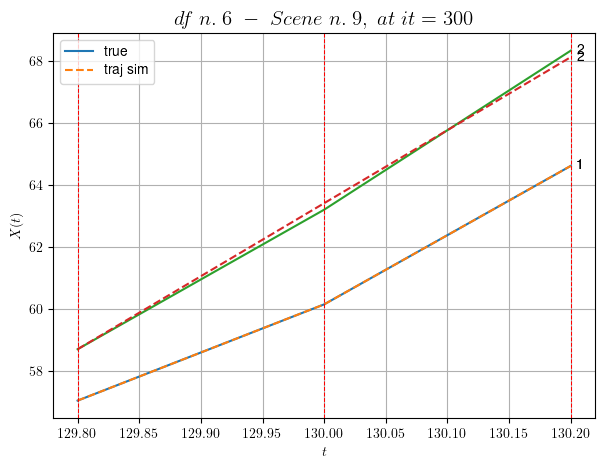

        For scene 9/52
        * use LR_NN=0.01 with err=1.2916804581734784 at it=24
        * v0_scn_mean = 24.02837731377122
        * MAE = 0.013235109409541798



df n.6, scene n.10/52
    We have 8 time intervals inside [131.80,133.40]
            - Time interval n.0: [131.80, 132.00]
                * y_true: [0.35723721]
                * v_ann: [0.005408274009823799, 20.22300032377142]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [132.00, 132.20]
                * y_true: [0.35723721]
                * v_ann: [0.0006872117519378662, 20.22300032377142]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [132.20, 132.40]
                * y_true: [0.35723721]
                * v_ann: [7.307720079552382e-05, 20.22300032377142]

------------------------------------------------------------------------------------

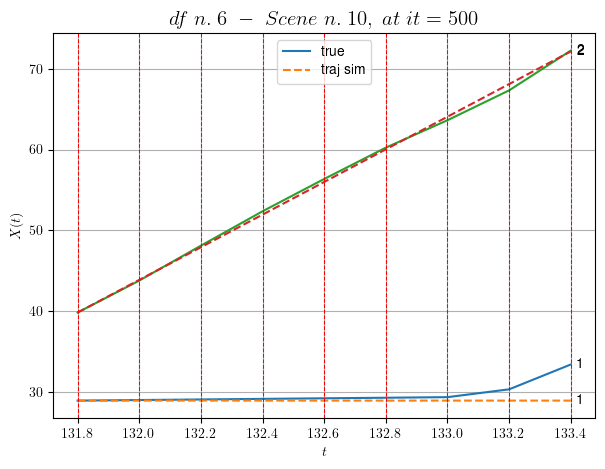

        For scene 10/52
        * use LR_NN=0.01 with err=45.34027160097334 at it=24
        * v0_scn_mean = 20.61408031074684
        * MAE = 1.3144081245461166



df n.6, scene n.11/52
    We have 6 time intervals inside [134.00,135.20]
    * err= 0.6913747881329309
    * Learning rate NN = 0.004304671194404364
    * diff = 5.488467949010811e-07


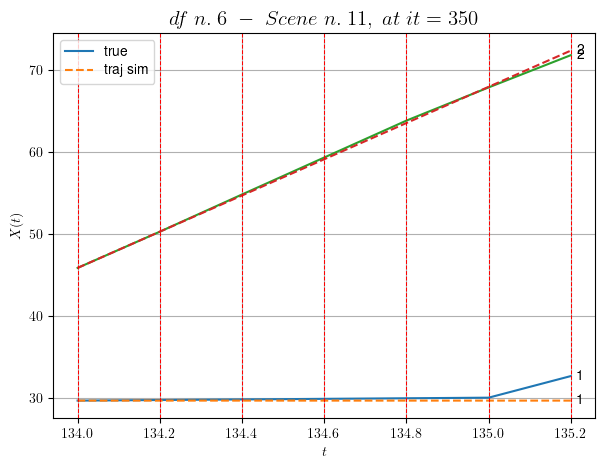

        For scene 11/52
        * use LR_NN=0.01 with err=17.440551308576325 at it=24
        * v0_scn_mean = 22.516761909041765
        * MAE = 0.6913747881329309



df n.6, scene n.12/52
    We have 10 time intervals inside [139.40,141.40]
            - Time interval n.0: [139.40, 139.60]
                * y_true: [0.35723721]
                * v_ann: [0.4582212269306183, 17.7770898385059]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [139.60, 139.80]
                * y_true: [0.35723721]
                * v_ann: [0.16429579257965088, 17.7770898385059]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [139.80, 140.00]
                * y_true: [0.35723721]
                * v_ann: [0.04152524471282959, 17.7770898385059]

--------------------------------------------------------------------------------------------

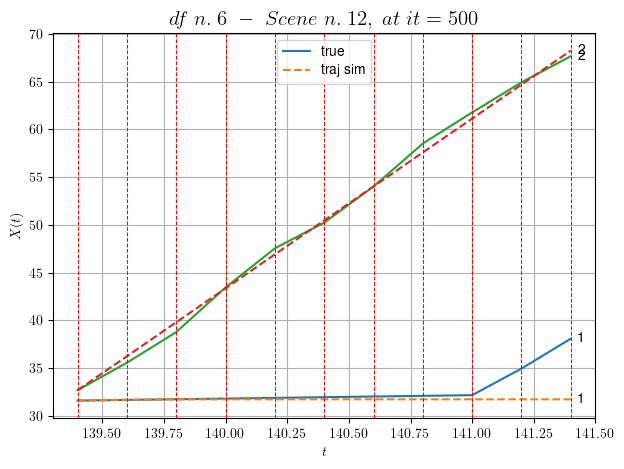

        For scene 12/52
        * use LR_NN=0.001 with err=105.61149307310768 at it=24
        * v0_scn_mean = 18.266006244872337
        * MAE = 2.479579127416499



df n.6, scene n.13/52
    We have 12 time intervals inside [147.60,150.00]
            - Time interval n.0: [147.60, 147.80]
                * y_true: [15.36027953]
                * v_ann: [4.73081636428833, 11.914046199341456]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [147.80, 148.00]
                * y_true: [13.26997227]
                * v_ann: [6.005699157714844, 11.914046199341456]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [148.00, 148.20]
                * y_true: [0.35723721]
                * v_ann: [2.6551103591918945, 11.914046199341456]

-----------------------------------------------------------------------------------------

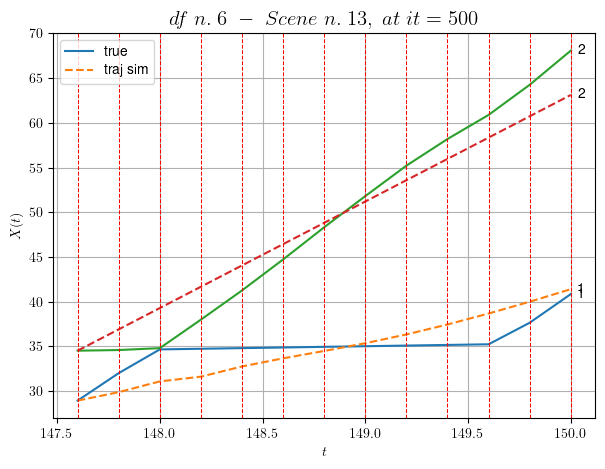

        For scene 13/52
        * use LR_NN=0.0005 with err=302.836374556421 at it=24
        * v0_scn_mean = 12.637484351229718
        * MAE = 5.612879503156386



df n.6, scene n.14/52
    We have 7 time intervals inside [162.20,163.60]
            - Time interval n.0: [162.20, 162.40]
                * y_true: [0.35723721]
                * v_ann: [0.35656240582466125, 21.059787487615633]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [162.40, 162.60]
                * y_true: [0.35723721]
                * v_ann: [0.40401691198349, 21.059787487615633]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [162.60, 162.80]
                * y_true: [0.35723721]
                * v_ann: [0.015549561008810997, 21.059787487615633]

-----------------------------------------------------------------------------------------

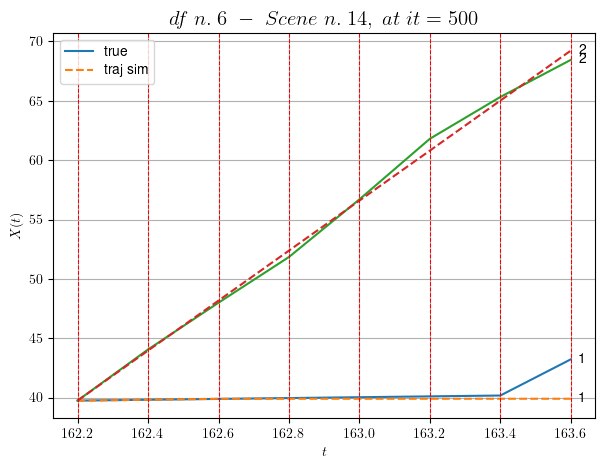

        For scene 14/52
        * use LR_NN=0.005 with err=28.87874332912771 at it=24
        * v0_scn_mean = 21.4173959880427
        * MAE = 0.820417132001118



df n.6, scene n.15/52
    We have 5 time intervals inside [195.80,196.80]
            - Time interval n.0: [195.80, 196.00]
                * y_true: [8.32699474]
                * v_ann: [7.643576145172119, 21.237347440799663]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [196.00, 196.20]
                * y_true: [7.75032617]
                * v_ann: [7.823048114776611, 21.237347440799663]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [196.20, 196.40]
                * y_true: [7.75032617]
                * v_ann: [8.193531036376953, 21.237347440799663]

-----------------------------------------------------------------------------------------------

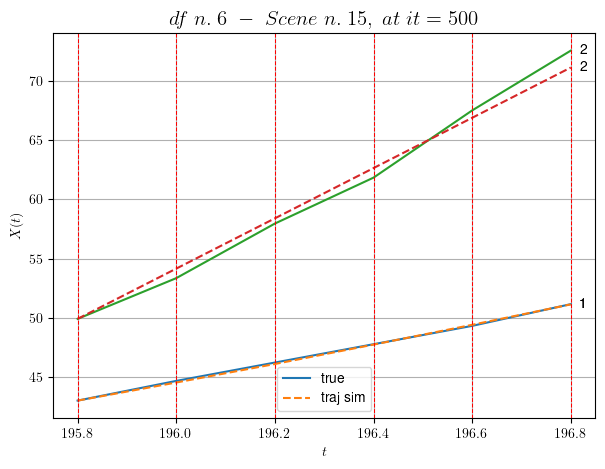

        For scene 15/52
        * use LR_NN=0.001 with err=13.125806406281104 at it=24
        * v0_scn_mean = 21.587853543101055
        * MAE = 0.3310057685837587



df n.6, scene n.16/52
    We have 9 time intervals inside [204.40,206.20]
            - Time interval n.0: [204.40, 204.60]
                * y_true: [8.31429106]
                * v_ann: [9.200082778930664, 16.186070594949047]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [204.60, 204.80]
                * y_true: [3.70012482]
                * v_ann: [8.849055290222168, 16.186070594949047]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [204.80, 205.00]
                * y_true: [10.45040224]
                * v_ann: [10.566122055053711, 16.186070594949047]

-----------------------------------------------------------------------------------------

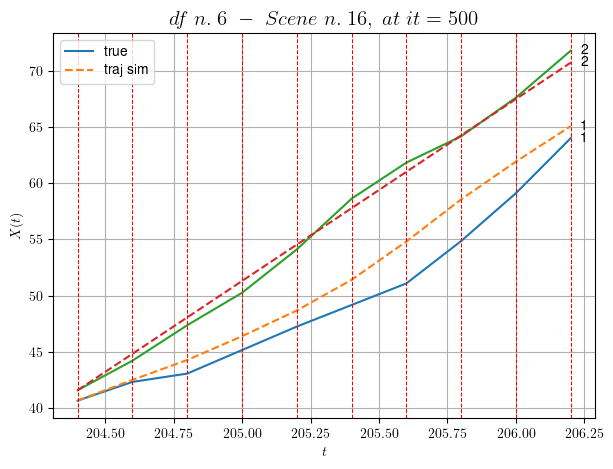

        For scene 16/52
        * use LR_NN=5e-05 with err=106.10630691754542 at it=24
        * v0_scn_mean = 16.73862777104503
        * MAE = 2.567945286809377



df n.6, scene n.17/52
    We have 2 time intervals inside [207.40,207.80]
    * err= 0.00017262976071473596
    * Learning rate NN = 8.999999408842996e-05
    * diff = 1.6375269239877034e-07


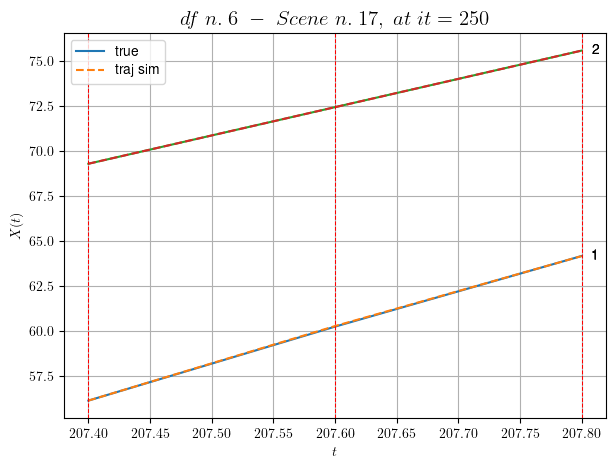

        For scene 17/52
        * use LR_NN=0.0001 with err=6.839236274713604 at it=24
        * v0_scn_mean = 16.822430660965267
        * MAE = 0.00017262945555161365



df n.6, scene n.18/52
    We have 3 time intervals inside [228.80,229.40]
            - Time interval n.0: [228.80, 229.00]
                * y_true: [24.35108467]
                * v_ann: [22.365135192871094, 21.31990483401044]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [229.00, 229.20]
                * y_true: [20.22626331]
                * v_ann: [20.50601577758789, 21.31990483401044]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [229.20, 229.40]
                * y_true: [20.22626331]
                * v_ann: [22.017406463623047, 21.31990483401044]

-------------------------------------------------------------------------------------

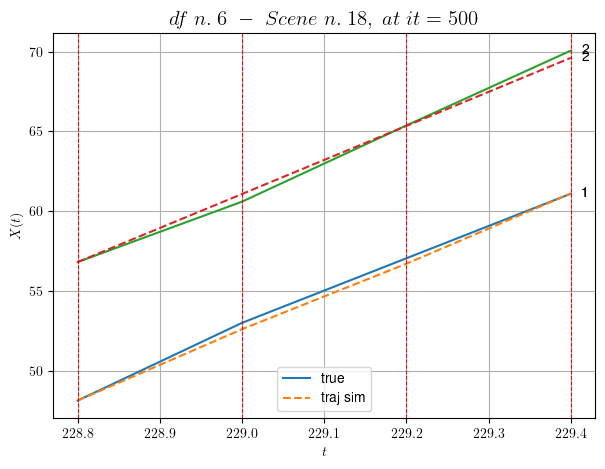

        For scene 18/52
        * use LR_NN=0.0005 with err=4.966293430398694 at it=24
        * v0_scn_mean = 21.667108640583685
        * MAE = 0.08840299915486567



df n.6, scene n.19/52
    We have 4 time intervals inside [231.20,232.00]
            - Time interval n.0: [231.20, 231.40]
                * y_true: [12.00056725]
                * v_ann: [13.37717342376709, 21.155377510208684]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [231.40, 231.60]
                * y_true: [15.22086391]
                * v_ann: [13.262866973876953, 21.155377510208684]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [231.60, 231.80]
                * y_true: [16.02593808]
                * v_ann: [14.998771667480469, 21.155377510208684]

-------------------------------------------------------------------------------------

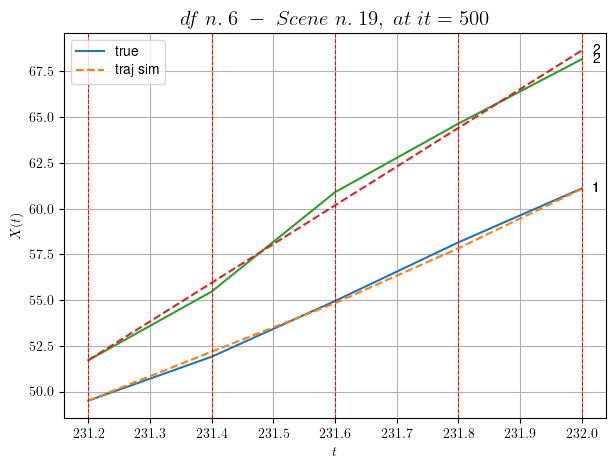

        For scene 19/52
        * use LR_NN=0.005 with err=9.747198213812377 at it=24
        * v0_scn_mean = 21.509162409732674
        * MAE = 0.12223734090367158



df n.6, scene n.20/52
    We have 3 time intervals inside [234.00,234.60]
            - Time interval n.0: [234.00, 234.20]
                * y_true: [26.69004353]
                * v_ann: [21.902551651000977, 20.2013668572743]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [234.20, 234.40]
                * y_true: [21.39007586]
                * v_ann: [21.82402801513672, 20.2013668572743]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [234.40, 234.60]
                * y_true: [17.25009918]
                * v_ann: [21.7215576171875, 20.2013668572743]

----------------------------------------------------------------------------------------------

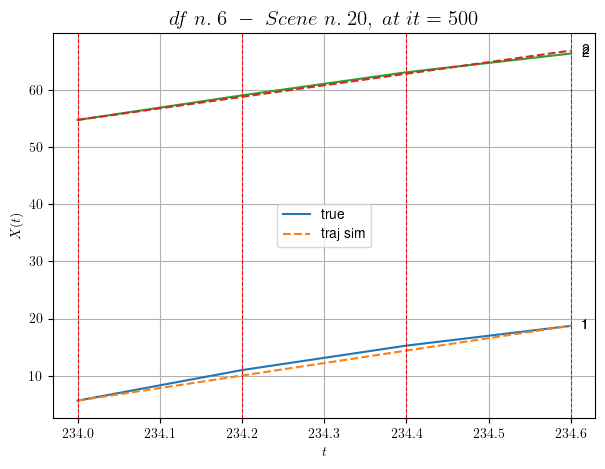

        For scene 20/52
        * use LR_NN=1e-05 with err=7.379979032648584 at it=24
        * v0_scn_mean = 20.59331218290827
        * MAE = 0.25772825959469525



df n.6, scene n.21/52
    We have 4 time intervals inside [236.20,237.00]
            - Time interval n.0: [236.20, 236.40]
                * y_true: [16.87565247]
                * v_ann: [20.70734214782715, 17.634130974588274]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [236.40, 236.60]
                * y_true: [19.47601633]
                * v_ann: [20.47900390625, 17.634130974588274]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [236.60, 236.80]
                * y_true: [19.47601633]
                * v_ann: [19.98577880859375, 17.634130974588274]

--------------------------------------------------------------------------------------------

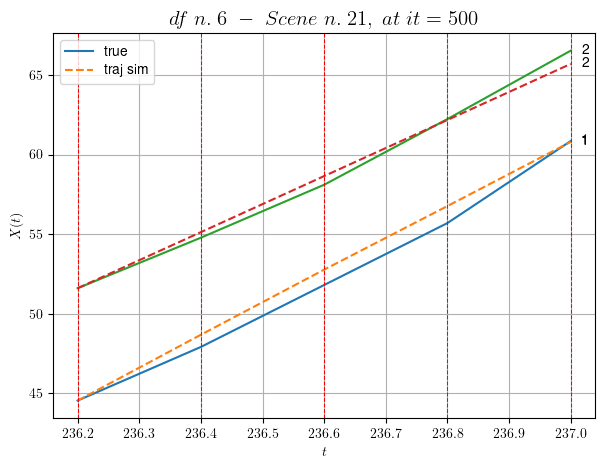

        For scene 21/52
        * use LR_NN=5e-05 with err=17.63944948590783 at it=24
        * v0_scn_mean = 18.128765735510278
        * MAE = 0.36821738436751794



df n.6, scene n.22/52
    We have 3 time intervals inside [252.60,253.20]
            - Time interval n.0: [252.60, 252.80]
                * y_true: [15.85040733]
                * v_ann: [14.26993179321289, 24.514205448075334]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [252.80, 253.00]
                * y_true: [14.75042477]
                * v_ann: [14.557801246643066, 24.514205448075334]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [253.00, 253.20]
                * y_true: [13.10045093]
                * v_ann: [14.610590934753418, 24.514205448075334]

--------------------------------------------------------------------------------------

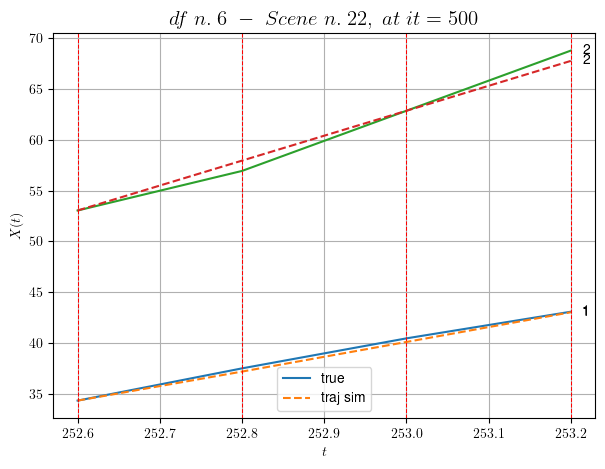

        For scene 22/52
        * use LR_NN=0.0001 with err=1.908839732100094 at it=24
        * v0_scn_mean = 24.733637230110197
        * MAE = 0.2570912540647428



df n.6, scene n.23/52
    We have 2 time intervals inside [263.80,264.20]
    * err= 0.053855106722762155
    * Learning rate NN = 8.099998922261875e-06
    * diff = 1.9650838942175675e-08


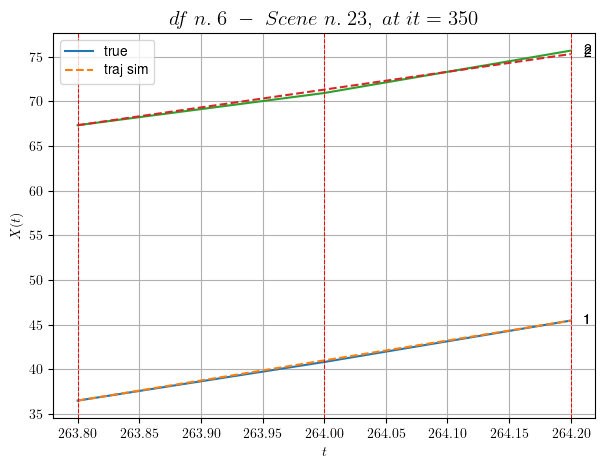

        For scene 23/52
        * use LR_NN=1e-05 with err=3.176809434089325 at it=24
        * v0_scn_mean = 20.513559819023907
        * MAE = 0.049102968038827785



df n.6, scene n.24/52
    We have 6 time intervals inside [286.80,288.00]
            - Time interval n.0: [286.80, 287.00]
                * y_true: [22.82063727]
                * v_ann: [22.168216705322266, 26.634646976102104]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [287.00, 287.20]
                * y_true: [25.60093433]
                * v_ann: [25.713611602783203, 26.634646976102104]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [287.20, 287.40]
                * y_true: [24.85112481]
                * v_ann: [24.814228057861328, 26.634646976102104]

------------------------------------------------------------------------------------

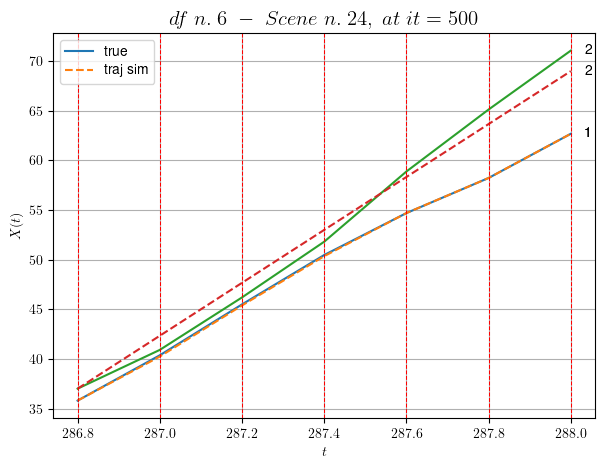

        For scene 24/52
        * use LR_NN=0.005 with err=2.4866731410543763 at it=24
        * v0_scn_mean = 26.76926109703302
        * MAE = 0.7940924944770835



df n.6, scene n.25/52
    We have 2 time intervals inside [296.40,296.80]
            - Time interval n.0: [296.40, 296.60]
                * y_true: [22.17130127]
                * v_ann: [27.154253005981445, 12.399412488572287]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [296.60, 296.80]
                * y_true: [29.46198743]
                * v_ann: [23.56917381286621, 12.399412488572287]

----------------------------------------------------------------------------------------------------
    * err= 0.18242088708349935
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.00020725442673763528


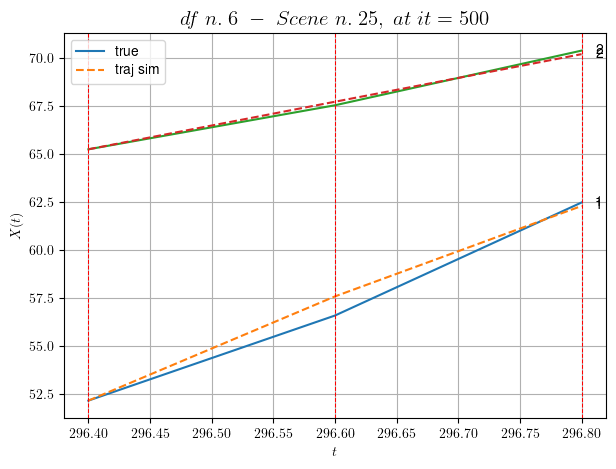

        For scene 25/52
        * use LR_NN=5e-05 with err=10.326210229905206 at it=24
        * v0_scn_mean = 13.10343598889492
        * MAE = 0.18207385293496192



df n.6, scene n.26/52
    We have 5 time intervals inside [320.20,321.20]
            - Time interval n.0: [320.20, 320.40]
                * y_true: [22.07575568]
                * v_ann: [22.578702926635742, 27.667143511899713]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [320.40, 320.60]
                * y_true: [21.84581177]
                * v_ann: [20.825960159301758, 27.667143511899713]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [320.60, 320.80]
                * y_true: [20.9260361]
                * v_ann: [21.549474716186523, 27.667143511899713]

--------------------------------------------------------------------------------------

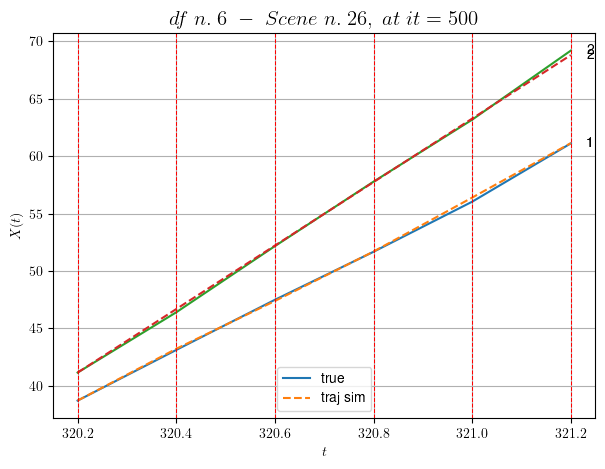

        For scene 26/52
        * use LR_NN=0.005 with err=1.0348774002868357 at it=24
        * v0_scn_mean = 27.760457771403736
        * MAE = 0.028404914878350528



df n.6, scene n.27/52
    We have 2 time intervals inside [359.20,359.60]
    * err= 0.15179636198260396
    * Learning rate NN = 8.099999104160815e-05
    * diff = 3.334740389382418e-08


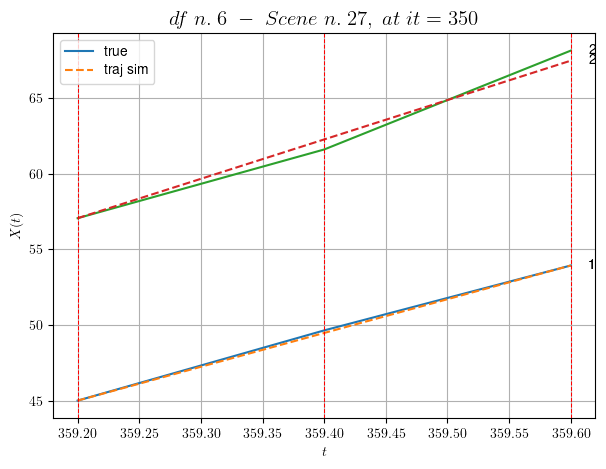

        For scene 27/52
        * use LR_NN=0.0001 with err=0.5001796022994853 at it=24
        * v0_scn_mean = 26.263421135284016
        * MAE = 0.13718975044376358



df n.6, scene n.28/52
    We have 5 time intervals inside [368.20,369.20]
            - Time interval n.0: [368.20, 368.40]
                * y_true: [20.48034946]
                * v_ann: [22.865032196044922, 26.26965461417241]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [368.40, 368.60]
                * y_true: [26.0305779]
                * v_ann: [23.50028419494629, 26.26965461417241]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [368.60, 368.80]
                * y_true: [23.10068181]
                * v_ann: [23.911853790283203, 26.26965461417241]

----------------------------------------------------------------------------------------

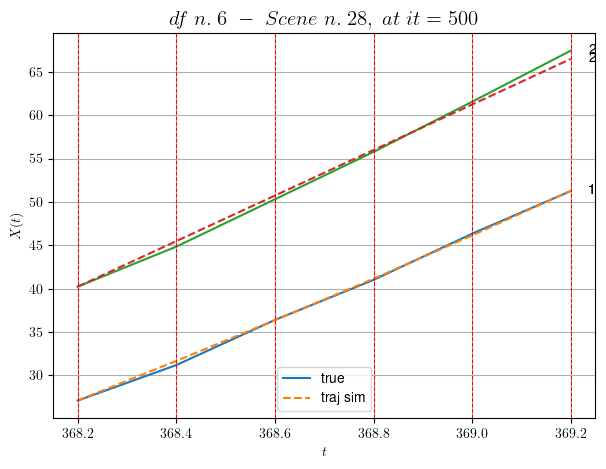

        For scene 28/52
        * use LR_NN=5e-05 with err=2.2233358767801246 at it=24
        * v0_scn_mean = 26.418868429577408
        * MAE = 0.13904088372880713



df n.6, scene n.29/52
    We have 8 time intervals inside [374.40,376.00]
            - Time interval n.0: [374.40, 374.60]
                * y_true: [20.90029714]
                * v_ann: [25.633264541625977, 20.073696885977927]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [374.60, 374.80]
                * y_true: [24.30046975]
                * v_ann: [24.434377670288086, 20.073696885977927]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [374.80, 375.00]
                * y_true: [30.15080009]
                * v_ann: [23.290084838867188, 20.073696885977927]

------------------------------------------------------------------------------------

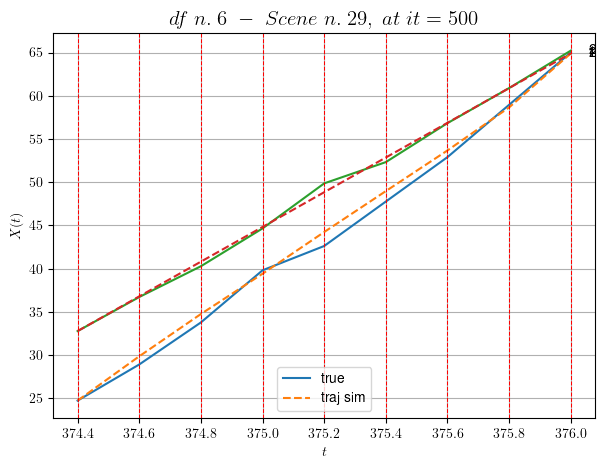

        For scene 29/52
        * use LR_NN=0.001 with err=47.679699524611195 at it=24
        * v0_scn_mean = 20.470749010463017
        * MAE = 0.47312414420017657



df n.6, scene n.30/52
    We have 6 time intervals inside [396.40,397.60]
            - Time interval n.0: [396.40, 396.60]
                * y_true: [18.23021429]
                * v_ann: [14.743432998657227, 25.42985006909659]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [396.60, 396.80]
                * y_true: [14.33022215]
                * v_ann: [17.150127410888672, 25.42985006909659]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [396.80, 397.00]
                * y_true: [16.80032208]
                * v_ann: [15.689412117004395, 25.42985006909659]

---------------------------------------------------------------------------------------

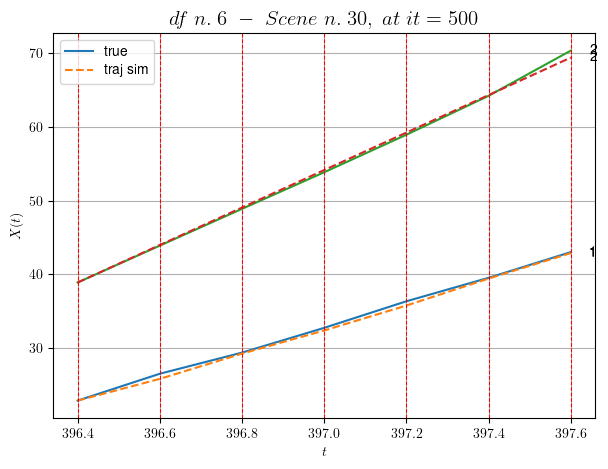

        For scene 30/52
        * use LR_NN=0.001 with err=5.365864373608138 at it=24
        * v0_scn_mean = 25.61265606629629
        * MAE = 0.15112191187858426



df n.6, scene n.31/52
    We have 7 time intervals inside [407.80,409.20]
            - Time interval n.0: [407.80, 408.00]
                * y_true: [21.37567004]
                * v_ann: [22.685791015625, 22.363716298521275]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [408.00, 408.20]
                * y_true: [22.01576805]
                * v_ann: [22.183740615844727, 22.363716298521275]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [408.20, 408.40]
                * y_true: [24.57616006]
                * v_ann: [22.85221290588379, 22.363716298521275]

------------------------------------------------------------------------------------------

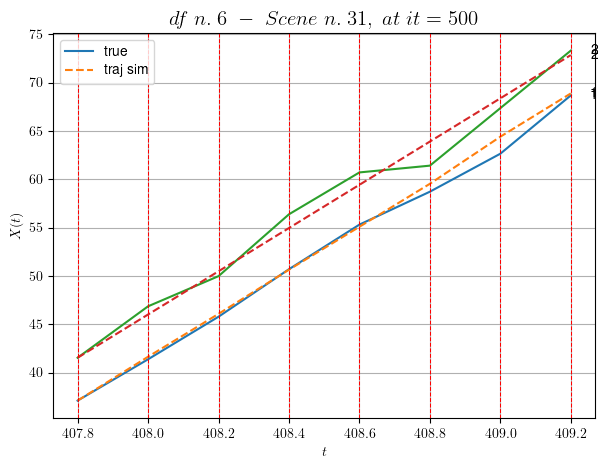

        For scene 31/52
        * use LR_NN=0.0001 with err=22.65206545214141 at it=24
        * v0_scn_mean = 22.66916764652204
        * MAE = 1.006345099636042



df n.6, scene n.32/52
    We have 8 time intervals inside [417.40,419.00]
    * err= 197.96441414207823
    * Learning rate NN = 0.00015690525469835848
    * diff = 6.157384291327617e-07


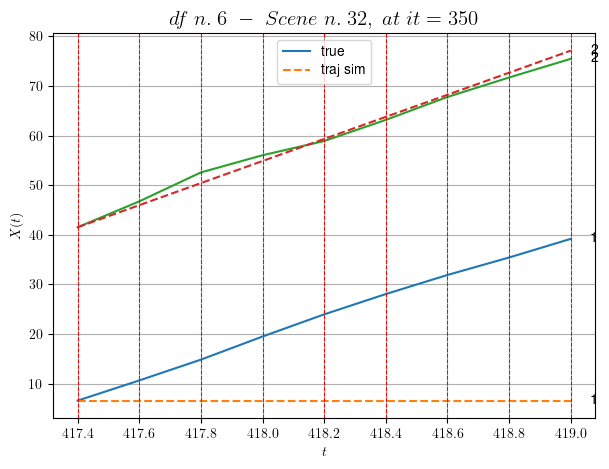

        For scene 32/52
        * use LR_NN=0.0005 with err=31.079631887294045 at it=24
        * v0_scn_mean = 22.69667346192251
        * MAE = 85.50556763606578



df n.6, scene n.33/52
    We have 5 time intervals inside [446.80,447.80]
    * err= 63.61224682908509
    * Learning rate NN = 2.6572044589556754e-05
    * diff = 9.571442660671892e-08


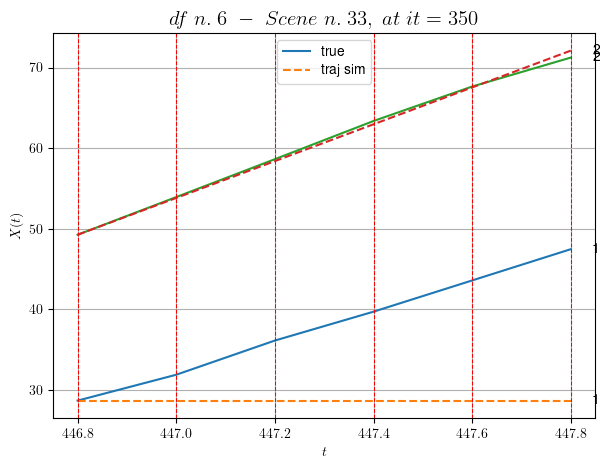

        For scene 33/52
        * use LR_NN=5e-05 with err=9.992716610919196 at it=24
        * v0_scn_mean = 23.250541037239092
        * MAE = 63.61224682908509



df n.6, scene n.34/52
    We have 3 time intervals inside [448.40,449.00]
            - Time interval n.0: [448.40, 448.60]
                * y_true: [20.45120743]
                * v_ann: [19.816556930541992, 16.351257627075242]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [448.60, 448.80]
                * y_true: [22.88145923]
                * v_ann: [26.366113662719727, 16.351257627075242]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [448.80, 449.00]
                * y_true: [30.73239033]
                * v_ann: [27.6379337310791, 16.351257627075242]

-----------------------------------------------------------------------------------------

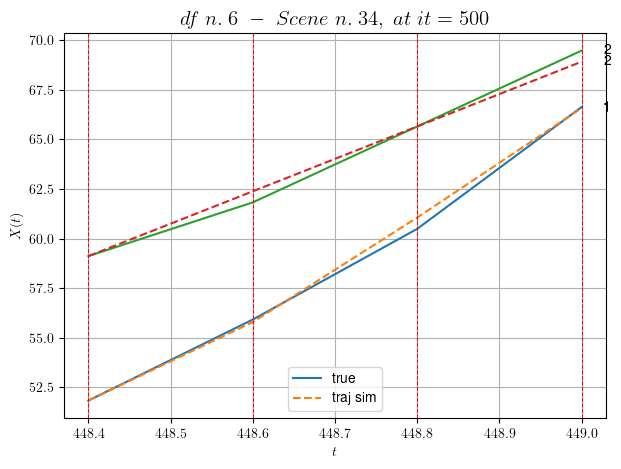

        For scene 34/52
        * use LR_NN=0.0005 with err=13.168269279915005 at it=24
        * v0_scn_mean = 16.897207321888146
        * MAE = 0.12134436315543662



df n.6, scene n.35/52
    We have 3 time intervals inside [450.60,451.20]
            - Time interval n.0: [450.60, 450.80]
                * y_true: [21.37625172]
                * v_ann: [25.114675521850586, 24.707838126992733]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [450.80, 451.00]
                * y_true: [24.60663191]
                * v_ann: [23.821441650390625, 24.707838126992733]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [451.00, 451.20]
                * y_true: [26.4920936]
                * v_ann: [23.73444366455078, 24.707838126992733]

-------------------------------------------------------------------------------------

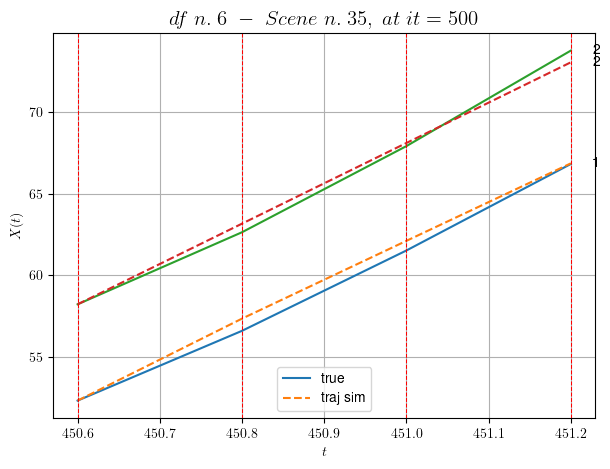

        For scene 35/52
        * use LR_NN=0.0005 with err=1.7723713146773485 at it=24
        * v0_scn_mean = 24.919524601871824
        * MAE = 0.2172478370310696



df n.6, scene n.36/52
    We have 2 time intervals inside [458.00,458.40]
            - Time interval n.0: [458.00, 458.20]
                * y_true: [26.37695887]
                * v_ann: [22.187997817993164, 10.716650123126847]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [458.20, 458.40]
                * y_true: [14.07546308]
                * v_ann: [19.243825912475586, 10.716650123126847]

----------------------------------------------------------------------------------------------------
    * err= 0.39455455370718684
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.0013283325509304


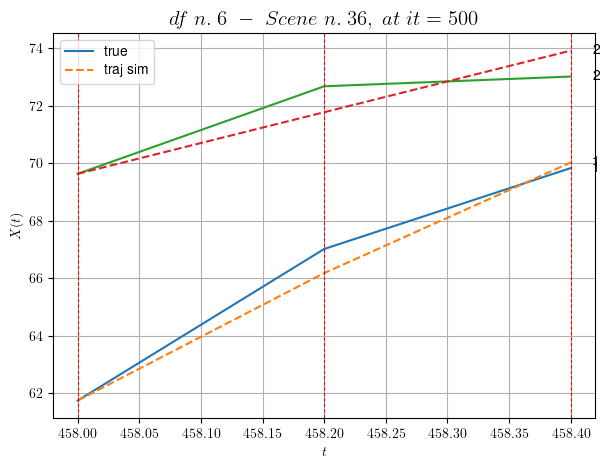

        For scene 36/52
        * use LR_NN=0.0005 with err=13.887085793705857 at it=24
        * v0_scn_mean = 11.487984118054099
        * MAE = 0.39455455370718684



df n.6, scene n.37/52
    We have 2 time intervals inside [460.40,460.80]
    * err= 0.0015790049597071754
    * Learning rate NN = 4.499999704421498e-05
    * diff = 1.0574103235919986e-07


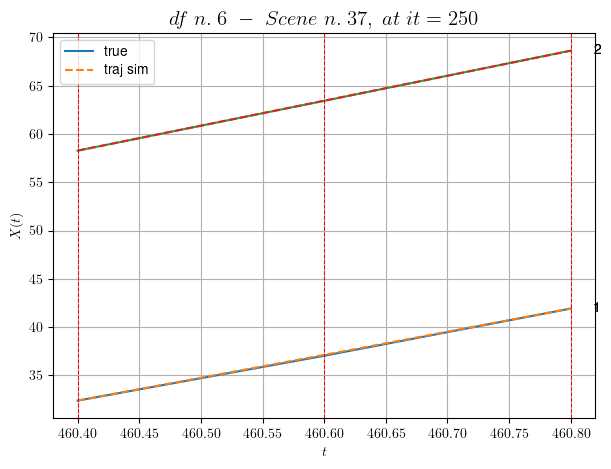

        For scene 37/52
        * use LR_NN=5e-05 with err=0.5665646894450543 at it=24
        * v0_scn_mean = 26.19918038179582
        * MAE = 0.001540937368639258



df n.6, scene n.38/52
    We have 6 time intervals inside [465.20,466.40]
            - Time interval n.0: [465.20, 465.40]
                * y_true: [18.28001138]
                * v_ann: [18.66843605041504, 23.956962458802742]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [465.40, 465.60]
                * y_true: [20.650036]
                * v_ann: [19.026418685913086, 23.956962458802742]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [465.60, 465.80]
                * y_true: [19.5500669]
                * v_ann: [19.618886947631836, 23.956962458802742]

----------------------------------------------------------------------------------------

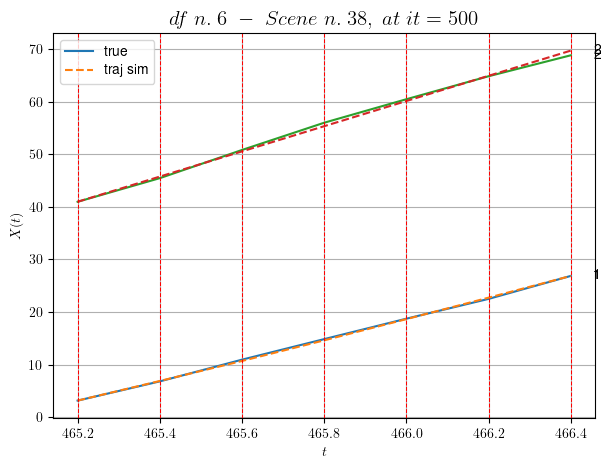

        For scene 38/52
        * use LR_NN=1e-05 with err=9.9917473288535 at it=24
        * v0_scn_mean = 24.198683960403507
        * MAE = 0.12123003615173256



df n.6, scene n.39/52
    We have 6 time intervals inside [467.00,468.20]
            - Time interval n.0: [467.00, 467.20]
                * y_true: [18.72012329]
                * v_ann: [24.668468475341797, 20.547439201769897]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [467.20, 467.40]
                * y_true: [22.09021781]
                * v_ann: [25.262502670288086, 20.547439201769897]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [467.40, 467.60]
                * y_true: [25.12035484]
                * v_ann: [24.51034927368164, 20.547439201769897]

----------------------------------------------------------------------------------------

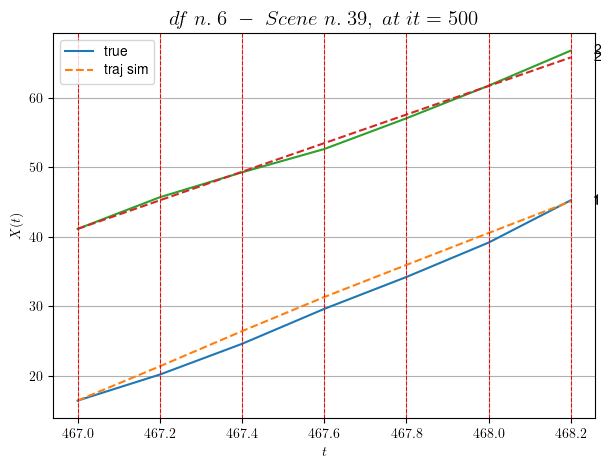

        For scene 39/52
        * use LR_NN=1e-05 with err=23.833842170688808 at it=24
        * v0_scn_mean = 20.925541633626736
        * MAE = 1.0511513400049681



df n.6, scene n.40/52
    We have 10 time intervals inside [477.80,479.80]
            - Time interval n.0: [477.80, 478.00]
                * y_true: [11.6501536]
                * v_ann: [12.712401390075684, 21.601430911083135]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [478.00, 478.20]
                * y_true: [14.75023559]
                * v_ann: [12.203564643859863, 21.601430911083135]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [478.20, 478.40]
                * y_true: [11.45023382]
                * v_ann: [12.22496223449707, 21.601430911083135]

--------------------------------------------------------------------------------------

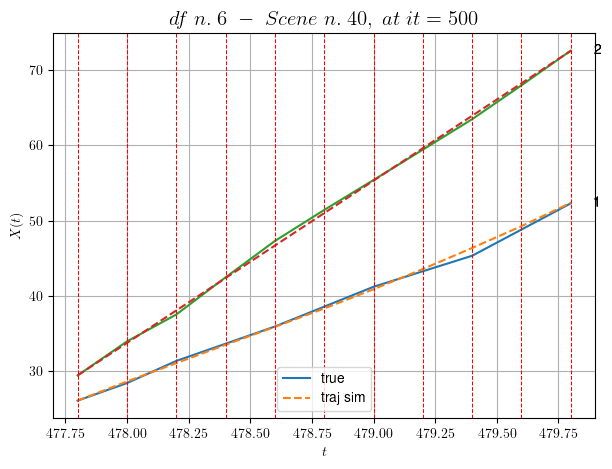

        For scene 40/52
        * use LR_NN=0.001 with err=53.65740963472987 at it=24
        * v0_scn_mean = 21.937373674574392
        * MAE = 0.128054177459147



df n.6, scene n.41/52
    We have 6 time intervals inside [487.00,488.20]
            - Time interval n.0: [487.00, 487.20]
                * y_true: [14.83016814]
                * v_ann: [15.038612365722656, 24.548038627552586]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.20, 487.40]
                * y_true: [16.8602423]
                * v_ann: [15.787423133850098, 24.548038627552586]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [487.40, 487.60]
                * y_true: [16.46530479]
                * v_ann: [16.355422973632812, 24.548038627552586]

----------------------------------------------------------------------------------------

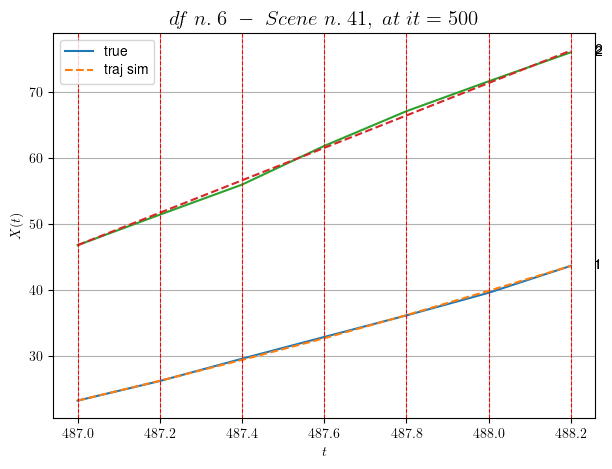

        For scene 41/52
        * use LR_NN=5e-05 with err=7.58242261708823 at it=24
        * v0_scn_mean = 24.766117082409
        * MAE = 0.09175682397789511



df n.6, scene n.42/52
    We have 3 time intervals inside [493.80,494.40]
    * err= 0.01689486585888049
    * Learning rate NN = 0.0036449995823204517
    * diff = 9.7385574137146e-07


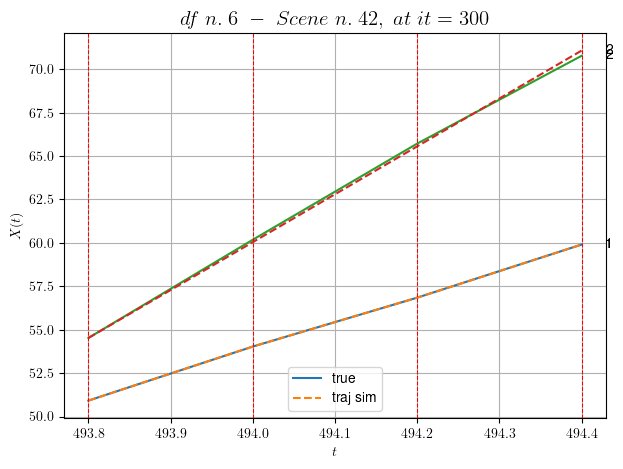

        For scene 42/52
        * use LR_NN=0.005 with err=0.7486453123538807 at it=24
        * v0_scn_mean = 27.73855900801084
        * MAE = 0.01689486585888049



df n.6, scene n.43/52
    We have 4 time intervals inside [507.40,508.20]
            - Time interval n.0: [507.40, 507.60]
                * y_true: [7.25036781]
                * v_ann: [14.124792098999023, 12.083014257344258]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [507.60, 507.80]
                * y_true: [12.82075121]
                * v_ann: [14.206151962280273, 12.083014257344258]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [507.80, 508.00]
                * y_true: [21.1763263]
                * v_ann: [14.059932708740234, 12.083014257344258]

---------------------------------------------------------------------------------------

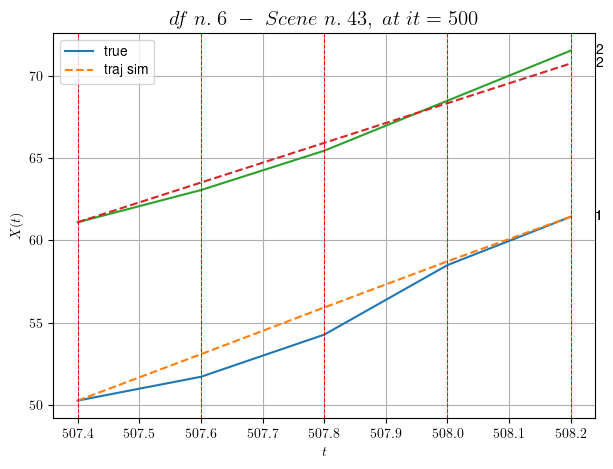

        For scene 43/52
        * use LR_NN=0.0001 with err=37.57181241169339 at it=24
        * v0_scn_mean = 12.799693686913896
        * MAE = 0.5646492376684631



df n.6, scene n.44/52
    We have 2 time intervals inside [530.40,530.80]
    * err= 0.3215675992801523
    * Learning rate NN = 8.099998922261875e-06
    * diff = 5.063217038414614e-07


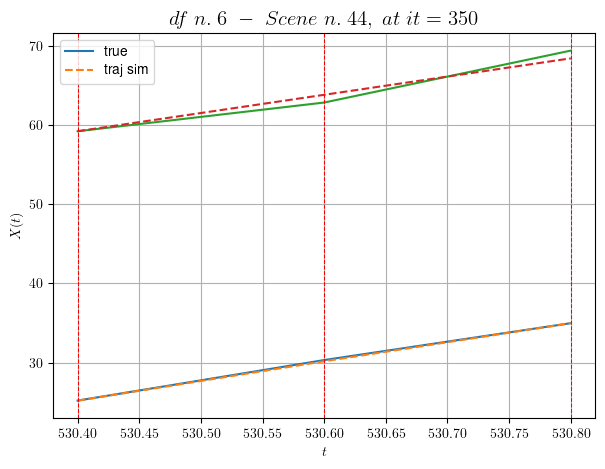

        For scene 44/52
        * use LR_NN=1e-05 with err=1.5017223217522973 at it=24
        * v0_scn_mean = 23.392389280370704
        * MAE = 0.28929680351087095



df n.6, scene n.45/52
    We have 3 time intervals inside [551.40,552.00]
            - Time interval n.0: [551.40, 551.60]
                * y_true: [26.08674174]
                * v_ann: [29.765727996826172, 18.102658549475112]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [551.60, 551.80]
                * y_true: [30.06264682]
                * v_ann: [28.70319938659668, 18.102658549475112]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [551.80, 552.00]
                * y_true: [30.95284603]
                * v_ann: [27.691425323486328, 18.102658549475112]

-------------------------------------------------------------------------------------

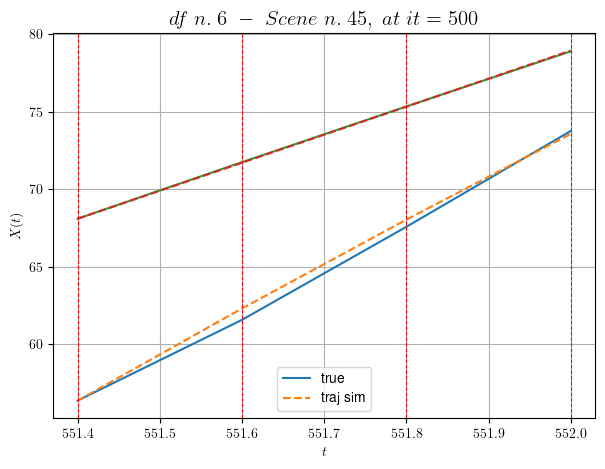

        For scene 45/52
        * use LR_NN=5e-05 with err=10.454019118144307 at it=24
        * v0_scn_mean = 18.57855220740531
        * MAE = 0.09946486190774269



df n.6, scene n.46/52
    We have 8 time intervals inside [576.00,577.60]
            - Time interval n.0: [576.00, 576.20]
                * y_true: [15.84021031]
                * v_ann: [17.636804580688477, 21.301030620242113]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [576.20, 576.40]
                * y_true: [20.27538477]
                * v_ann: [18.367008209228516, 21.301030620242113]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [576.40, 576.60]
                * y_true: [21.925472]
                * v_ann: [19.39541244506836, 21.301030620242113]

----------------------------------------------------------------------------------------

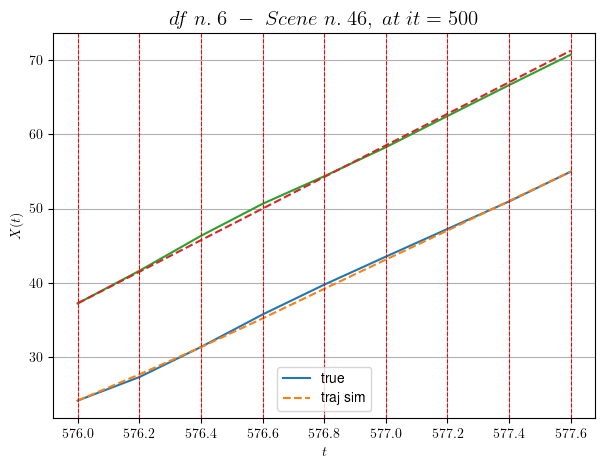

        For scene 46/52
        * use LR_NN=0.001 with err=35.623709684378895 at it=24
        * v0_scn_mean = 21.64898939536574
        * MAE = 0.10985202256281415



df n.6, scene n.47/52
    We have 3 time intervals inside [585.60,586.20]
            - Time interval n.0: [585.60, 585.80]
                * y_true: [18.50110458]
                * v_ann: [22.54815101623535, 24.542073255088674]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [585.80, 586.00]
                * y_true: [26.55213972]
                * v_ann: [25.552303314208984, 24.542073255088674]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [586.00, 586.20]
                * y_true: [26.55213972]
                * v_ann: [23.95033073425293, 24.542073255088674]

---------------------------------------------------------------------------------------

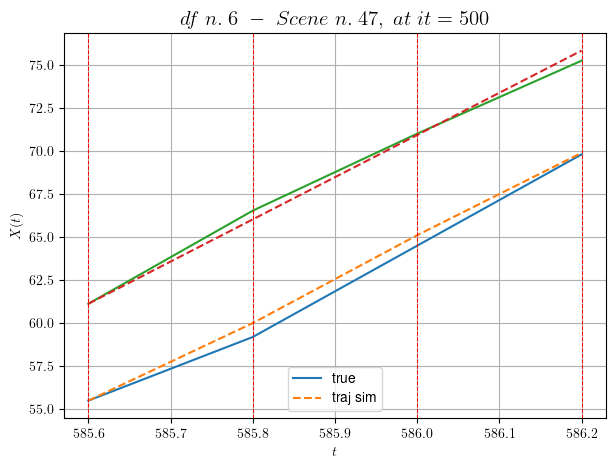

        For scene 47/52
        * use LR_NN=0.0001 with err=2.5054888800756125 at it=24
        * v0_scn_mean = 24.76039032484494
        * MAE = 0.2049797679389052



df n.6, scene n.48/52
    We have 6 time intervals inside [593.40,594.60]
            - Time interval n.0: [593.40, 593.60]
                * y_true: [20.11067815]
                * v_ann: [21.969715118408203, 21.280809908315653]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [593.60, 593.80]
                * y_true: [18.13073933]
                * v_ann: [21.93505096435547, 21.280809908315653]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [593.80, 594.00]
                * y_true: [23.23120854]
                * v_ann: [21.876317977905273, 21.280809908315653]

--------------------------------------------------------------------------------------

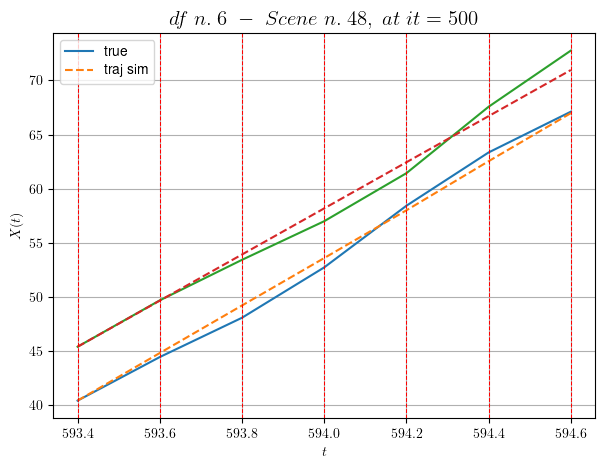

        For scene 48/52
        * use LR_NN=0.0001 with err=19.455627500766624 at it=24
        * v0_scn_mean = 21.629577511917525
        * MAE = 0.6884204716281629



df n.6, scene n.49/52
    We have 3 time intervals inside [552.20,552.80]
            - Time interval n.0: [552.20, 552.40]
                * y_true: [14.01030513 13.18063102]
                * v_ann: [19.337013244628906, 15.77206802368164, 20.233205039551997]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [552.40, 552.60]
                * y_true: [18.39048446 22.9012939 ]
                * v_ann: [18.924579620361328, 16.55176544189453, 20.233205039551997]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [552.60, 552.80]
                * y_true: [16.95052919 22.22132939]
                * v_ann: [19.78911018371582, 16.323055267333984, 20.233205039

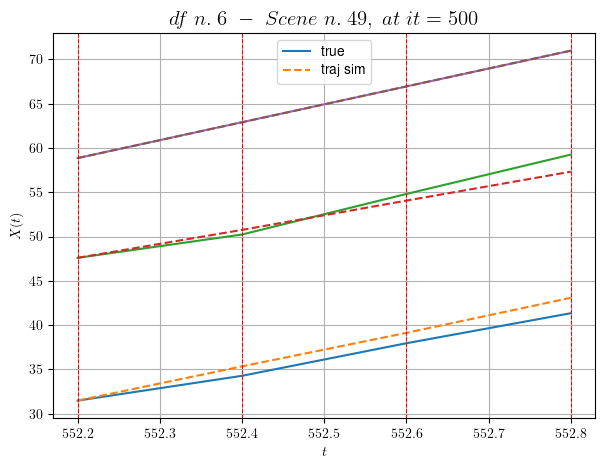

        For scene 49/52
        * use LR_NN=0.0001 with err=5.8948957974930325 at it=24
        * v0_scn_mean = 20.819212298670895
        * MAE = 0.8416356739824695



df n.6, scene n.50/52
    We have 2 time intervals inside [553.00,553.40]
            - Time interval n.0: [553.00, 553.20]
                * y_true: [23.0804555  19.17546127 18.9008181 ]
                * v_ann: [19.299362182617188, 18.6229190826416, 18.82583999633789, 23.748812608935992]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [553.20, 553.40]
                * y_true: [22.02058024 17.45053567 16.85079909]
                * v_ann: [19.94597816467285, 19.924144744873047, 20.62992286682129, 23.748812608935992]

----------------------------------------------------------------------------------------------------
    * err= 0.2602963509738598
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.0006736563667935624


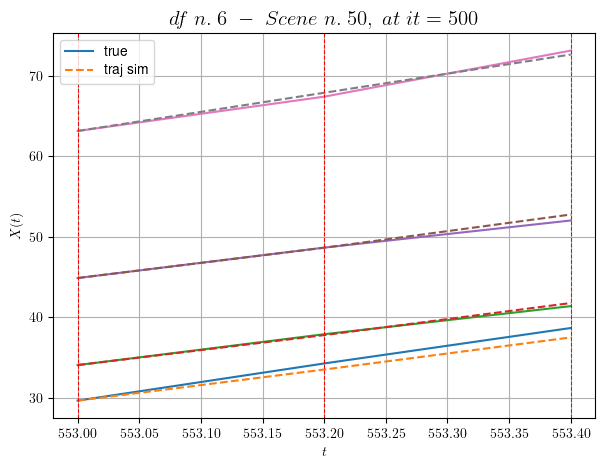

        For scene 50/52
        * use LR_NN=0.001 with err=5.358956139413255 at it=24
        * v0_scn_mean = 24.248887258031143
        * MAE = 0.20764145346056764



df n.6, scene n.51/52
    We have 2 time intervals inside [554.00,554.40]
            - Time interval n.0: [554.00, 554.20]
                * y_true: [20.50061186 21.35116733 22.20133365]
                * v_ann: [22.005964279174805, 21.780517578125, 21.877450942993164, 23.64705062033054]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.20, 554.40]
                * y_true: [18.86075328 25.85180384 21.5614577 ]
                * v_ann: [21.488340377807617, 21.664798736572266, 21.487686157226562, 23.64705062033054]

----------------------------------------------------------------------------------------------------
    * err= 0.12990746800313246
    * Learning rate NN = 0.0007289999630302191
    * diff = 6.13663339946724e-05


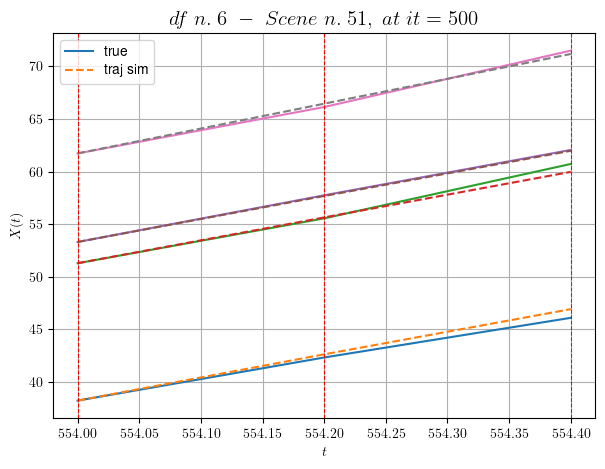

        For scene 51/52
        * use LR_NN=0.001 with err=4.757957243547184 at it=24
        * v0_scn_mean = 24.155265897367563
        * MAE = 0.1290031667604014



For df=6 with 52 scenes, time taken:        997.70
****************************************************************************************************
****************************************************************************************************
In df n.7/10 we have 30 scenes
df n.7, scene n.0/30
    We have 8 time intervals inside [37.36,38.96]
            - Time interval n.0: [37.36, 37.56]
                * y_true: [25.35701236]
                * v_ann: [31.525651931762695, 25.361418058283437]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [37.56, 37.76]
                * y_true: [25.73989368]
                * v_ann: [30.29967498779297, 25.361418058283437]

--------------------------------------------------------------------

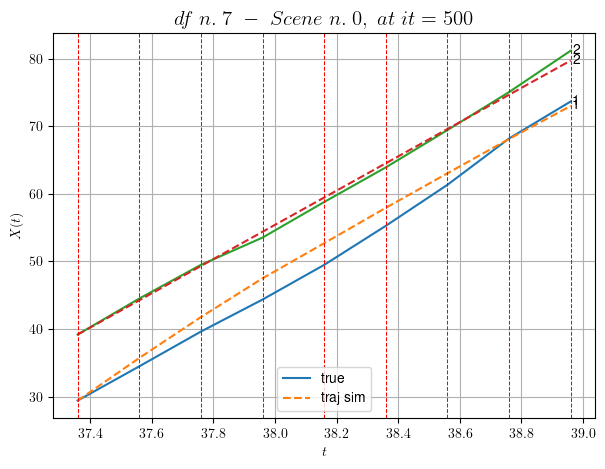

        For scene 0/30
        * use LR_NN=0.001 with err=10.533383528877238 at it=24
        * v0_scn_mean = 25.546961335916638
        * MAE = 1.5294286363414566



df n.7, scene n.1/30
    We have 3 time intervals inside [43.16,43.76]
            - Time interval n.0: [43.16, 43.36]
                * y_true: [28.21793458]
                * v_ann: [31.277217864990234, 25.959463570058276]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [43.36, 43.56]
                * y_true: [32.07362933]
                * v_ann: [28.971725463867188, 25.959463570058276]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [43.56, 43.76]
                * y_true: [29.22963958]
                * v_ann: [29.00194549560547, 25.959463570058276]

------------------------------------------------------------------------------------------------

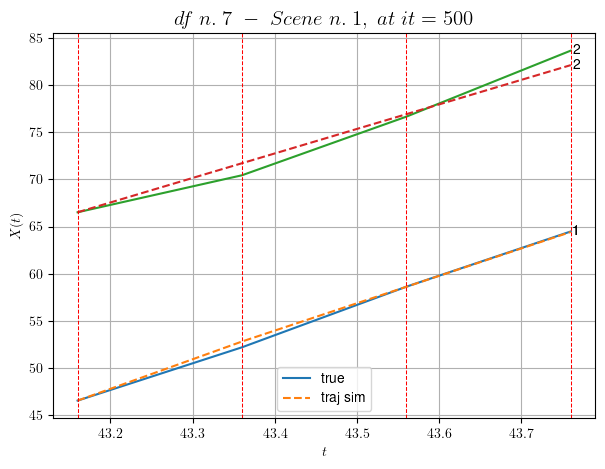

        For scene 1/30
        * use LR_NN=5e-05 with err=1.1538673156098584 at it=24
        * v0_scn_mean = 26.121085027225128
        * MAE = 0.4872305549768564



df n.7, scene n.2/30
    We have 7 time intervals inside [44.96,46.36]
            - Time interval n.0: [44.96, 45.16]
                * y_true: [26.28719925]
                * v_ann: [27.879335403442383, 26.657757035933585]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [45.16, 45.36]
                * y_true: [30.92729896]
                * v_ann: [26.554821014404297, 26.657757035933585]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [45.36, 45.56]
                * y_true: [23.73776955]
                * v_ann: [26.534704208374023, 26.657757035933585]

-----------------------------------------------------------------------------------------------

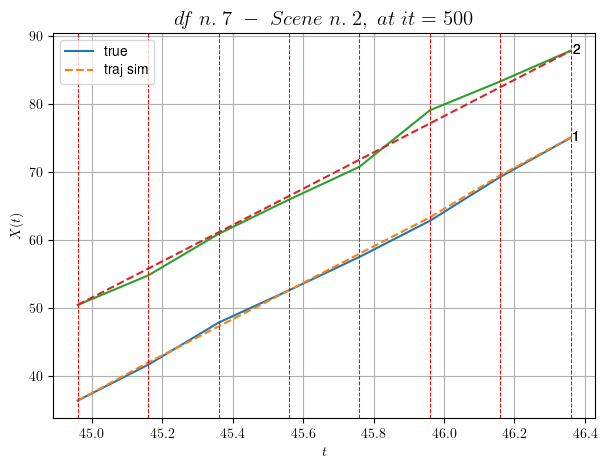

        For scene 2/30
        * use LR_NN=5e-05 with err=3.738180848222285 at it=24
        * v0_scn_mean = 26.79144675447068
        * MAE = 0.4676174187663412



df n.7, scene n.3/30
    We have 5 time intervals inside [51.36,52.36]
            - Time interval n.0: [51.36, 51.56]
                * y_true: [23.57882573]
                * v_ann: [28.00894546508789, 25.158740607132888]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [51.56, 51.76]
                * y_true: [24.23722079]
                * v_ann: [28.869094848632812, 25.158740607132888]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [51.76, 51.96]
                * y_true: [33.24501337]
                * v_ann: [29.36549949645996, 25.158740607132888]

---------------------------------------------------------------------------------------------------

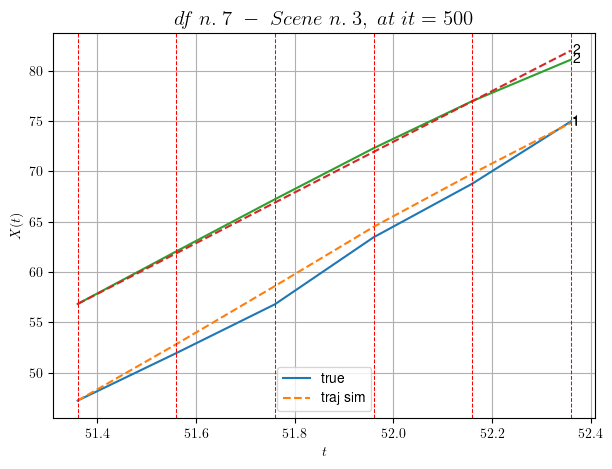

        For scene 3/30
        * use LR_NN=5e-05 with err=5.458678593124258 at it=24
        * v0_scn_mean = 25.35239098281058
        * MAE = 0.60328424645818



df n.7, scene n.4/30
    We have 5 time intervals inside [60.56,61.56]
            - Time interval n.0: [60.56, 60.76]
                * y_true: [22.61948097]
                * v_ann: [27.852766036987305, 25.527220166442856]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [60.76, 60.96]
                * y_true: [23.0211989]
                * v_ann: [28.383752822875977, 25.527220166442856]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [60.96, 61.16]
                * y_true: [33.01460981]
                * v_ann: [31.22576332092285, 25.527220166442856]

----------------------------------------------------------------------------------------------------


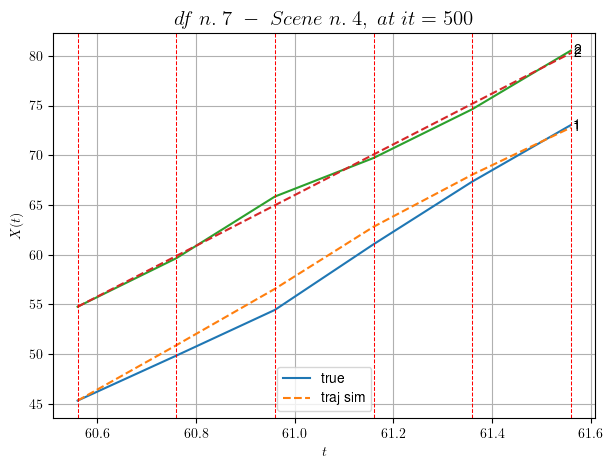

        For scene 4/30
        * use LR_NN=5e-05 with err=4.79094207854644 at it=24
        * v0_scn_mean = 25.706131359750884
        * MAE = 0.8789072393557178



df n.7, scene n.5/30
    We have 4 time intervals inside [76.36,77.16]
            - Time interval n.0: [76.36, 76.56]
                * y_true: [22.39037134]
                * v_ann: [25.803377151489258, 35.5367678218336]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [76.56, 76.76]
                * y_true: [26.28445994]
                * v_ann: [26.192306518554688, 35.5367678218336]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [76.76, 76.96]
                * y_true: [31.57858085]
                * v_ann: [27.719701766967773, 35.5367678218336]

----------------------------------------------------------------------------------------------------
  

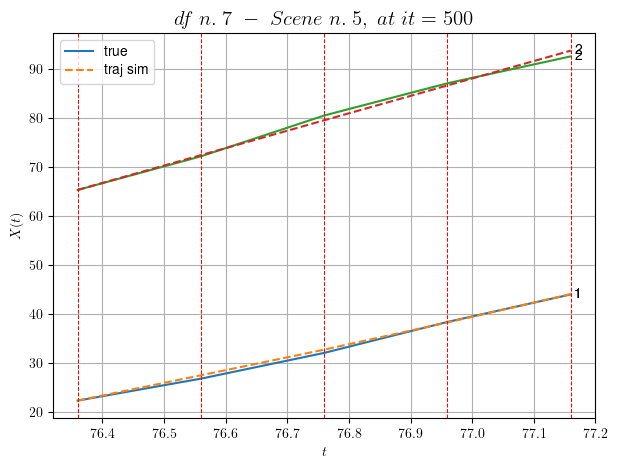

        For scene 5/30
        * use LR_NN=5e-05 with err=3.6416901492612443 at it=24
        * v0_scn_mean = 35.31529710900231
        * MAE = 0.33655441983949586



df n.7, scene n.6/30
    We have 3 time intervals inside [82.16,82.76]
            - Time interval n.0: [82.16, 82.36]
                * y_true: [22.49086216]
                * v_ann: [22.182756423950195, 31.745431023356087]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [82.36, 82.56]
                * y_true: [21.91444074]
                * v_ann: [23.03514862060547, 31.745431023356087]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [82.56, 82.76]
                * y_true: [24.18388115]
                * v_ann: [23.37485122680664, 31.745431023356087]

-------------------------------------------------------------------------------------------------

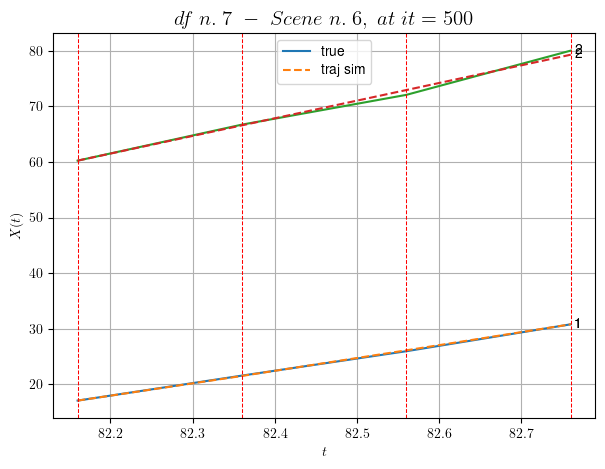

        For scene 6/30
        * use LR_NN=1e-05 with err=0.4338409635316325 at it=24
        * v0_scn_mean = 31.675613782435306
        * MAE = 0.16749387113662403



df n.7, scene n.7/30
    We have 3 time intervals inside [86.96,87.56]
            - Time interval n.0: [86.96, 87.16]
                * y_true: [31.1433952]
                * v_ann: [31.739912033081055, 27.633294787015792]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [87.16, 87.36]
                * y_true: [29.29438457]
                * v_ann: [31.647001266479492, 27.633294787015792]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [87.36, 87.56]
                * y_true: [32.87952873]
                * v_ann: [29.729618072509766, 27.633294787015792]

-----------------------------------------------------------------------------------------------

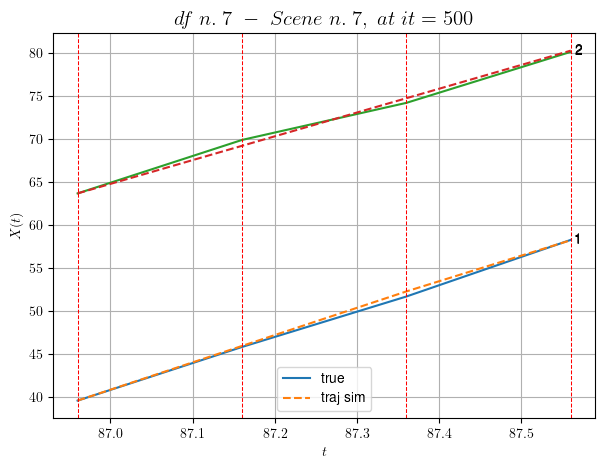

        For scene 7/30
        * use LR_NN=5e-05 with err=0.6460022299176706 at it=24
        * v0_scn_mean = 27.72796299551701
        * MAE = 0.14202186267035916



df n.7, scene n.8/30
    We have 3 time intervals inside [90.56,91.16]
            - Time interval n.0: [90.56, 90.76]
                * y_true: [33.04453039]
                * v_ann: [32.42966842651367, 29.53569419125577]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [90.76, 90.96]
                * y_true: [36.18763126]
                * v_ann: [32.638946533203125, 29.53569419125577]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [90.96, 91.16]
                * y_true: [21.90135867]
                * v_ann: [27.147520065307617, 29.53569419125577]

---------------------------------------------------------------------------------------------------

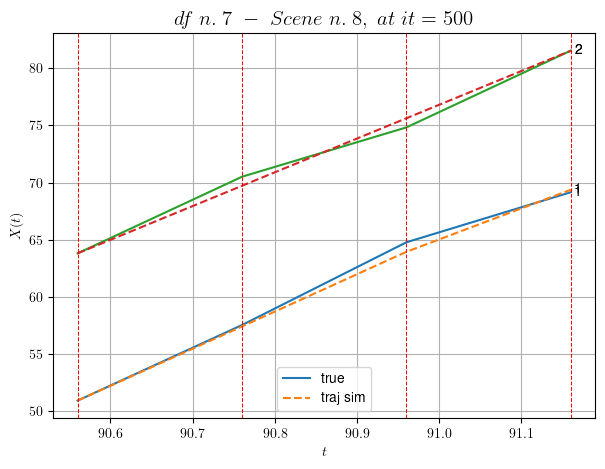

        For scene 8/30
        * use LR_NN=5e-05 with err=0.24864400155105076 at it=24
        * v0_scn_mean = 29.554266423601977
        * MAE = 0.25282434574899465



df n.7, scene n.9/30
    We have 5 time intervals inside [92.16,93.16]
            - Time interval n.0: [92.16, 92.36]
                * y_true: [22.06765878]
                * v_ann: [21.4937801361084, 26.406840765364826]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [92.36, 92.56]
                * y_true: [25.65636302]
                * v_ann: [21.649320602416992, 26.406840765364826]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [92.56, 92.76]
                * y_true: [20.44760846]
                * v_ann: [22.542322158813477, 26.406840765364826]

-----------------------------------------------------------------------------------------------

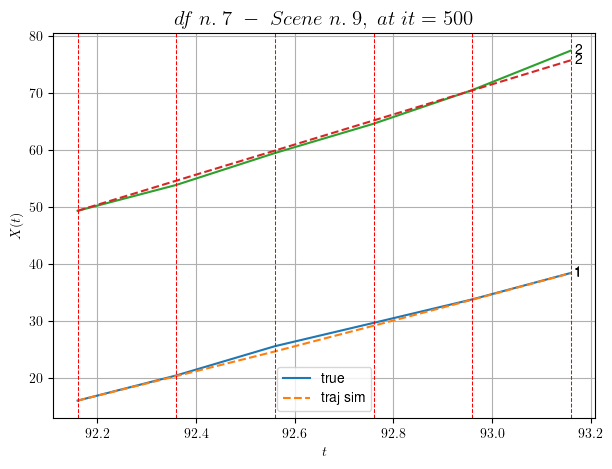

        For scene 9/30
        * use LR_NN=0.0001 with err=2.153990288260282 at it=24
        * v0_scn_mean = 26.5505671347227
        * MAE = 0.3815256948982301



df n.7, scene n.10/30
    We have 7 time intervals inside [110.96,112.36]
            - Time interval n.0: [110.96, 111.16]
                * y_true: [22.6227995]
                * v_ann: [23.27395248413086, 27.6762568074593]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [111.16, 111.36]
                * y_true: [23.80055078]
                * v_ann: [24.357208251953125, 27.6762568074593]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [111.36, 111.56]
                * y_true: [26.30746114]
                * v_ann: [26.284770965576172, 27.6762568074593]

------------------------------------------------------------------------------------------------

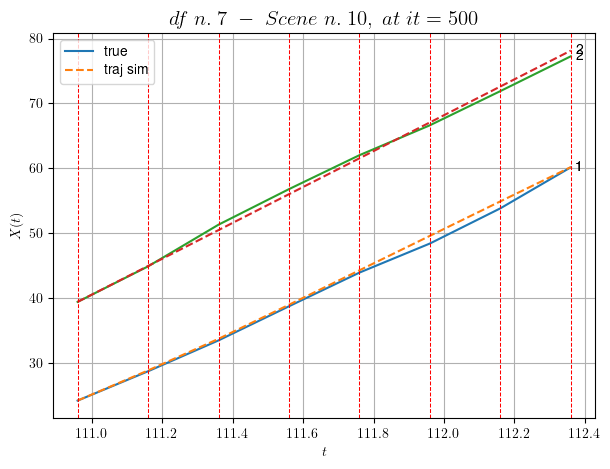

        For scene 10/30
        * use LR_NN=5e-05 with err=2.633580298668292 at it=24
        * v0_scn_mean = 27.769206535143073
        * MAE = 0.3639816935405981



df n.7, scene n.11/30
    We have 3 time intervals inside [116.96,117.56]
            - Time interval n.0: [116.96, 117.16]
                * y_true: [29.80898437]
                * v_ann: [30.499656677246094, 14.981640724782324]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [117.16, 117.36]
                * y_true: [21.49364724]
                * v_ann: [17.354887008666992, 14.981640724782324]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [117.36, 117.56]
                * y_true: [11.41585007]
                * v_ann: [14.849788665771484, 14.981640724782324]

--------------------------------------------------------------------------------------

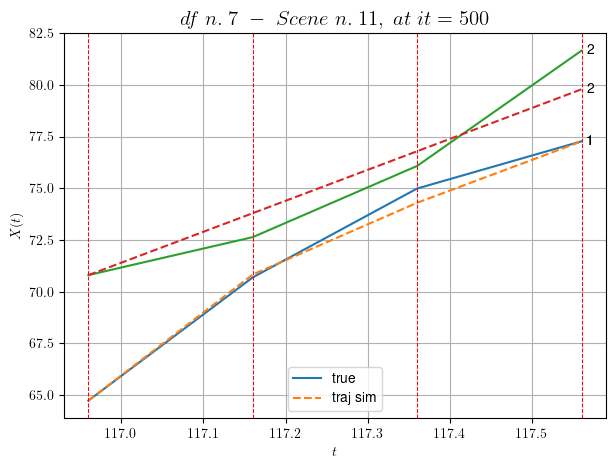

        For scene 11/30
        * use LR_NN=0.0005 with err=14.47899311423786 at it=24
        * v0_scn_mean = 15.58237509567622
        * MAE = 0.6546795835952827



df n.7, scene n.12/30
    We have 7 time intervals inside [138.56,139.96]
            - Time interval n.0: [138.56, 138.76]
                * y_true: [4.08913]
                * v_ann: [22.7132625579834, 23.573405043852205]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [138.76, 138.96]
                * y_true: [21.77829279]
                * v_ann: [23.857736587524414, 23.573405043852205]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [138.96, 139.16]
                * y_true: [26.03066503]
                * v_ann: [22.944210052490234, 23.573405043852205]

--------------------------------------------------------------------------------------------

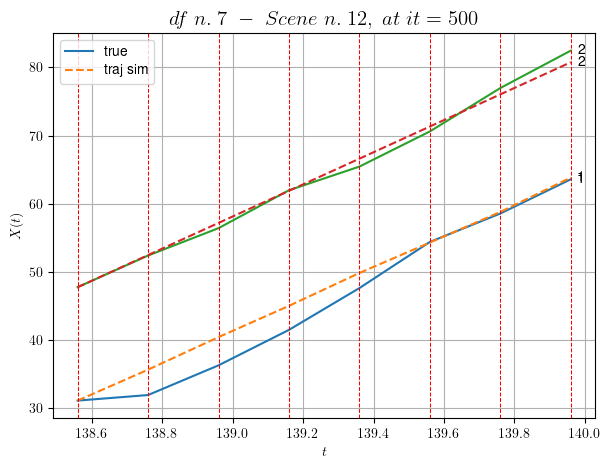

        For scene 12/30
        * use LR_NN=0.0005 with err=15.01459771150636 at it=24
        * v0_scn_mean = 23.8304688420491
        * MAE = 1.8739554681007011



df n.7, scene n.13/30
    We have 3 time intervals inside [154.96,155.56]
            - Time interval n.0: [154.96, 155.16]
                * y_true: [9.47635991]
                * v_ann: [8.122161865234375, 24.52487868148255]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [155.16, 155.36]
                * y_true: [11.49147565]
                * v_ann: [11.807807922363281, 24.52487868148255]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [155.36, 155.56]
                * y_true: [13.22499707]
                * v_ann: [13.757238388061523, 24.52487868148255]

--------------------------------------------------------------------------------------------

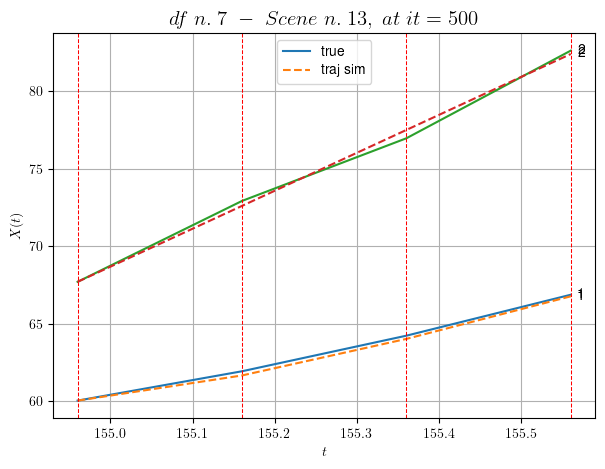

        For scene 13/30
        * use LR_NN=0.0001 with err=2.1970179352414267 at it=24
        * v0_scn_mean = 24.743883534180874
        * MAE = 0.07072934698914873



df n.7, scene n.14/30
    We have 4 time intervals inside [162.36,163.16]
            - Time interval n.0: [162.36, 162.56]
                * y_true: [21.23426094]
                * v_ann: [16.972137451171875, 32.323787690864776]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [162.56, 162.76]
                * y_true: [22.34095528]
                * v_ann: [20.18027114868164, 32.323787690864776]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [162.76, 162.96]
                * y_true: [20.77195672]
                * v_ann: [24.16497230529785, 32.323787690864776]

-------------------------------------------------------------------------------------

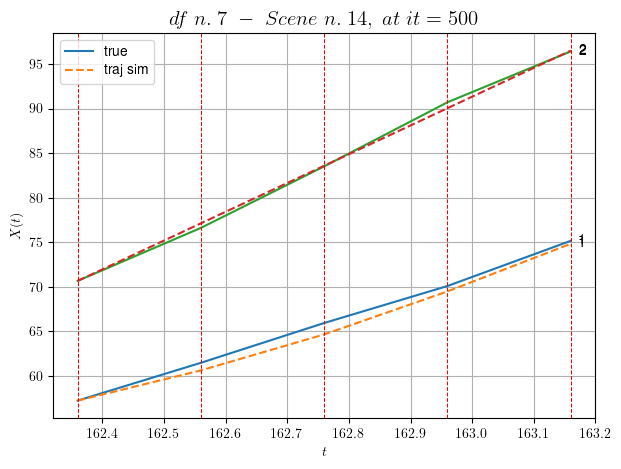

        For scene 14/30
        * use LR_NN=0.0005 with err=0.8967226896080873 at it=24
        * v0_scn_mean = 32.230836183248016
        * MAE = 0.34700267019869946



df n.7, scene n.15/30
    We have 4 time intervals inside [175.96,176.76]
            - Time interval n.0: [175.96, 176.16]
                * y_true: [16.06532355]
                * v_ann: [18.255029678344727, 21.81462918305666]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [176.16, 176.36]
                * y_true: [18.00626116]
                * v_ann: [19.06855010986328, 21.81462918305666]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [176.36, 176.56]
                * y_true: [22.4570007]
                * v_ann: [19.315168380737305, 21.81462918305666]

----------------------------------------------------------------------------------------

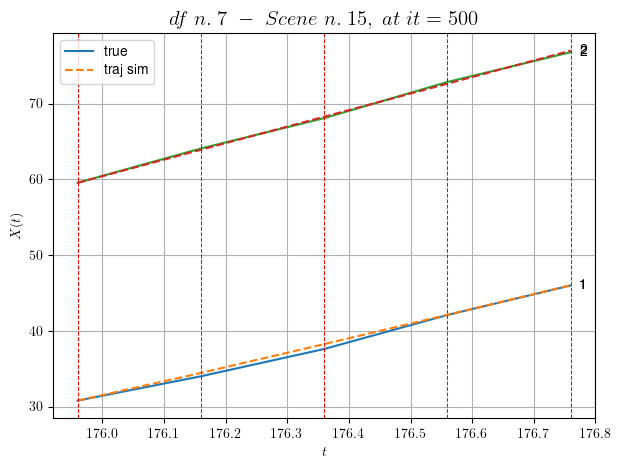

        For scene 15/30
        * use LR_NN=1e-05 with err=8.224222747403964 at it=24
        * v0_scn_mean = 22.142044015671978
        * MAE = 0.07707675359212947



df n.7, scene n.16/30
    We have 4 time intervals inside [177.76,178.56]
            - Time interval n.0: [177.76, 177.96]
                * y_true: [32.54285647]
                * v_ann: [37.7697639465332, 20.683526203706396]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [177.96, 178.16]
                * y_true: [23.85498335]
                * v_ann: [26.96674919128418, 20.683526203706396]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [178.16, 178.36]
                * y_true: [24.01227025]
                * v_ann: [26.9860782623291, 20.683526203706396]

------------------------------------------------------------------------------------------

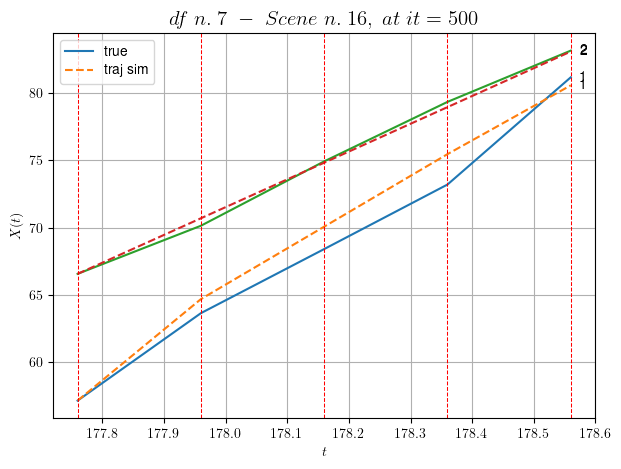

        For scene 16/30
        * use LR_NN=5e-05 with err=10.8250133247415 at it=24
        * v0_scn_mean = 21.056185155486933
        * MAE = 0.9826987571956755



df n.7, scene n.17/30
    We have 3 time intervals inside [179.16,179.76]
    * err= 0.20549667007304295
    * Learning rate NN = 3.2804993679746985e-05
    * diff = 8.561881176816222e-07


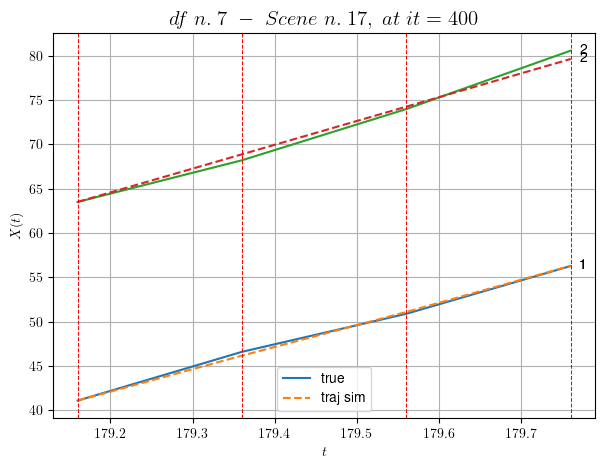

        For scene 17/30
        * use LR_NN=5e-05 with err=0.6348892415664534 at it=24
        * v0_scn_mean = 27.0382540430398
        * MAE = 0.18305607162497461



df n.7, scene n.18/30
    We have 2 time intervals inside [190.56,190.96]
    * err= 0.004042955645188327
    * Learning rate NN = 0.0004500000213738531
    * diff = 2.3382250631358292e-07


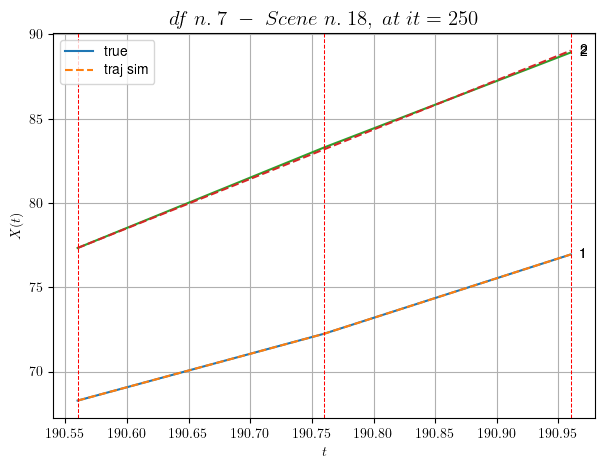

        For scene 18/30
        * use LR_NN=0.0005 with err=0.028299836282463107 at it=24
        * v0_scn_mean = 29.34093584942415
        * MAE = 0.004042955645188327



df n.7, scene n.19/30
    We have 3 time intervals inside [206.96,207.56]
    * err= 0.062026148506087606
    * Learning rate NN = 0.00040499999886378646
    * diff = 9.436840125442991e-07


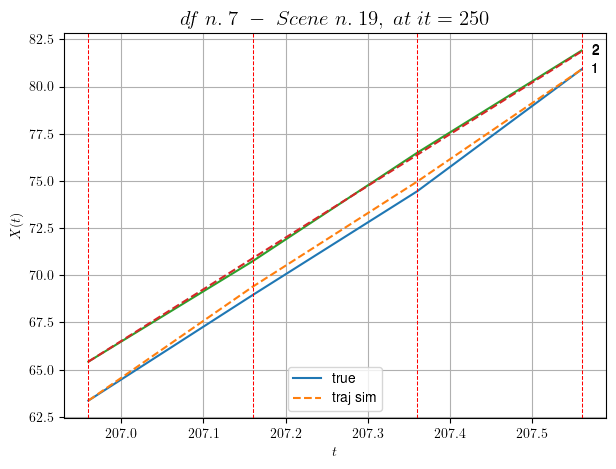

        For scene 19/30
        * use LR_NN=0.0005 with err=0.510155345690098 at it=24
        * v0_scn_mean = 27.607315270515727
        * MAE = 0.06148952655522817



df n.7, scene n.20/30
    We have 7 time intervals inside [219.96,221.36]
            - Time interval n.0: [219.96, 220.16]
                * y_true: [26.85290938]
                * v_ann: [28.77395248413086, 31.227007582862328]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [220.16, 220.36]
                * y_true: [28.31792495]
                * v_ann: [30.38193130493164, 31.227007582862328]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [220.36, 220.56]
                * y_true: [31.38990118]
                * v_ann: [31.488563537597656, 31.227007582862328]

--------------------------------------------------------------------------------------

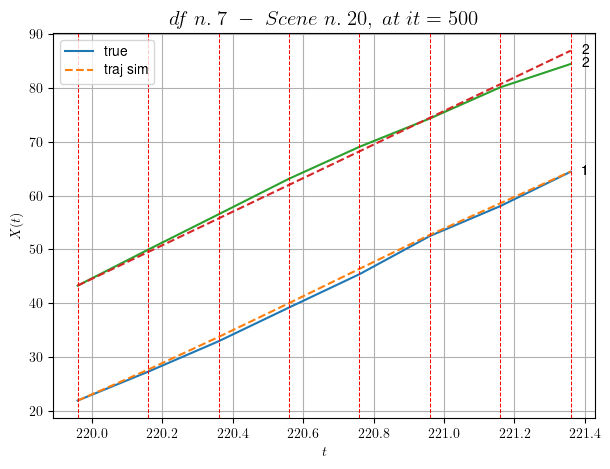

        For scene 20/30
        * use LR_NN=1e-05 with err=0.8930727588893238 at it=24
        * v0_scn_mean = 31.17792727955715
        * MAE = 0.7128945870171391



df n.7, scene n.21/30
    We have 7 time intervals inside [226.76,228.16]
            - Time interval n.0: [226.76, 226.96]
                * y_true: [26.80615591]
                * v_ann: [24.959667205810547, 30.698361324533423]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [226.96, 227.16]
                * y_true: [27.56613237]
                * v_ann: [25.169828414916992, 30.698361324533423]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [227.16, 227.36]
                * y_true: [23.97470155]
                * v_ann: [24.905792236328125, 30.698361324533423]

--------------------------------------------------------------------------------------

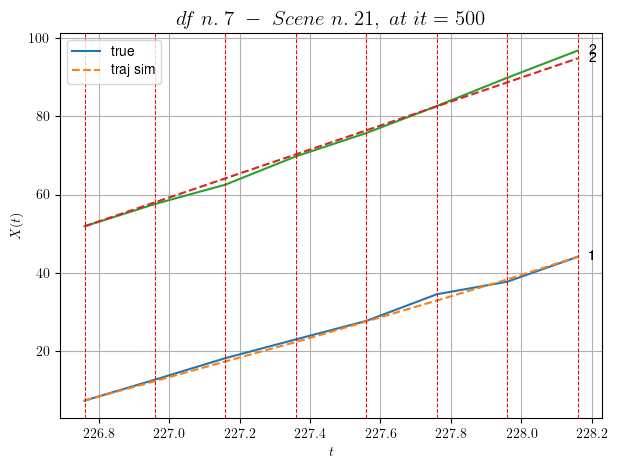

        For scene 21/30
        * use LR_NN=1e-05 with err=1.2499605888848184 at it=24
        * v0_scn_mean = 30.67042687155739
        * MAE = 0.8191506342955688



df n.7, scene n.22/30
    We have 2 time intervals inside [38.56,38.96]
            - Time interval n.0: [38.56, 38.76]
                * y_true: [34.50899027 34.29923068]
                * v_ann: [30.32685089111328, 32.56037139892578, 28.99001059008476]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.76, 38.96]
                * y_true: [33.76780394 27.40980382]
                * v_ann: [32.3045539855957, 34.29445266723633, 28.99001059008476]

----------------------------------------------------------------------------------------------------
    * err= 0.3565915591706735
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.01035041942554038


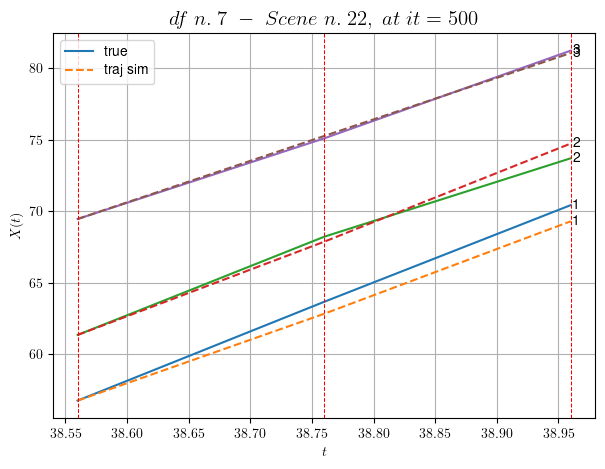

        For scene 22/30
        * use LR_NN=0.001 with err=3.246054096173826 at it=24
        * v0_scn_mean = 29.050609909333453
        * MAE = 0.3565915591706735



df n.7, scene n.23/30
    We have 3 time intervals inside [39.76,40.36]
            - Time interval n.0: [39.76, 39.96]
                * y_true: [22.5368218  26.50901133]
                * v_ann: [26.96225929260254, 27.382570266723633, 28.629752721377198]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [39.96, 40.16]
                * y_true: [27.13488394 22.34107329]
                * v_ann: [23.980571746826172, 24.212411880493164, 28.629752721377198]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [40.16, 40.36]
                * y_true: [29.97962766 28.56631616]
                * v_ann: [27.576738357543945, 26.997127532958984, 28.629752721377198]


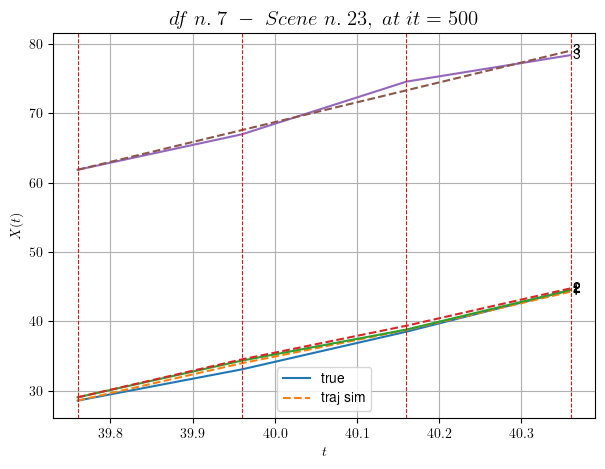

        For scene 23/30
        * use LR_NN=0.001 with err=7.415803627316616 at it=24
        * v0_scn_mean = 28.711967496573333
        * MAE = 0.2998274290204495



df n.7, scene n.24/30
    We have 2 time intervals inside [45.96,46.36]
            - Time interval n.0: [45.96, 46.16]
                * y_true: [25.63954073 32.24792255]
                * v_ann: [28.871009826660156, 28.020977020263672, 21.679366296074992]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [46.16, 46.36]
                * y_true: [27.5623729  28.76269973]
                * v_ann: [29.41240119934082, 27.669963836669922, 21.679366296074992]

----------------------------------------------------------------------------------------------------
    * err= 0.3682381734113931
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.003537297498062031


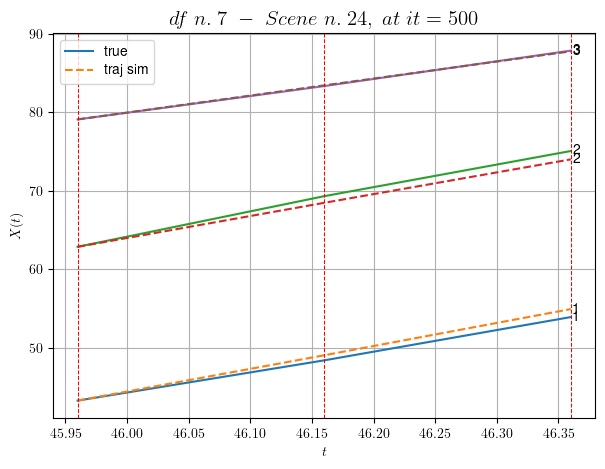

        For scene 24/30
        * use LR_NN=5e-05 with err=3.048832265075832 at it=24
        * v0_scn_mean = 22.178603944732043
        * MAE = 0.3682381734113931



df n.7, scene n.25/30
    We have 2 time intervals inside [162.76,163.16]
            - Time interval n.0: [162.76, 162.96]
                * y_true: [10.08699654 20.77195672]
                * v_ann: [16.853696823120117, 15.895054817199707, 33.51455461644857]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [162.96, 163.16]
                * y_true: [12.77745535 25.37230132]
                * v_ann: [18.395288467407227, 18.04050064086914, 33.51455461644857]

----------------------------------------------------------------------------------------------------
    * err= 1.7079761552437052
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0015645863127438098


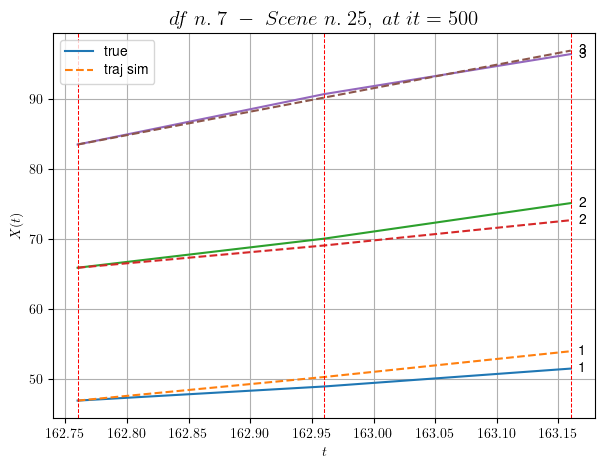

        For scene 25/30
        * use LR_NN=5e-05 with err=1.9622621623093794 at it=24
        * v0_scn_mean = 33.30368149725767
        * MAE = 1.6550958352478637



df n.7, scene n.26/30
    We have 3 time intervals inside [165.76,166.36]
            - Time interval n.0: [165.76, 165.96]
                * y_true: [14.62535373 14.97522028]
                * v_ann: [14.724869728088379, 14.88167953491211, 27.262209824915317]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [165.96, 166.16]
                * y_true: [14.90483904 10.97892299]
                * v_ann: [14.757588386535645, 14.20052433013916, 27.262209824915317]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.16, 166.36]
                * y_true: [13.82116599 15.66867879]
                * v_ann: [13.362396240234375, 12.899194717407227, 27.2622098249

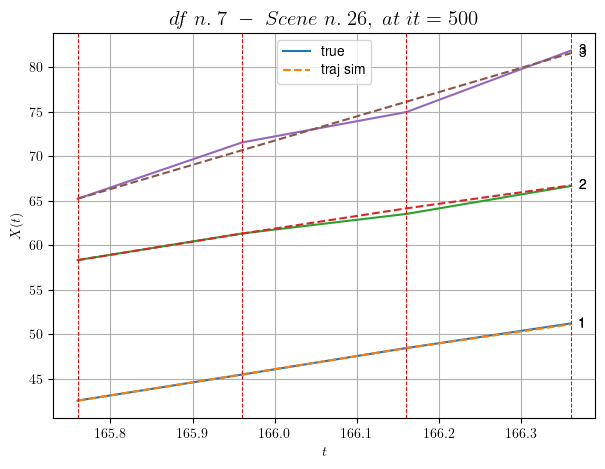

        For scene 26/30
        * use LR_NN=0.001 with err=1.3569534998689863 at it=24
        * v0_scn_mean = 27.426477112500226
        * MAE = 0.21694704972683887



df n.7, scene n.27/30
    We have 3 time intervals inside [188.16,188.76]
            - Time interval n.0: [188.16, 188.36]
                * y_true: [18.26365072 21.2472937 ]
                * v_ann: [19.900728225708008, 21.388477325439453, 24.898608242942228]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [188.36, 188.56]
                * y_true: [19.58083161 26.63811802]
                * v_ann: [19.60663604736328, 21.007610321044922, 24.898608242942228]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [188.56, 188.76]
                * y_true: [19.1135942  21.22632097]
                * v_ann: [20.763423919677734, 22.380901336669922, 24.8986082

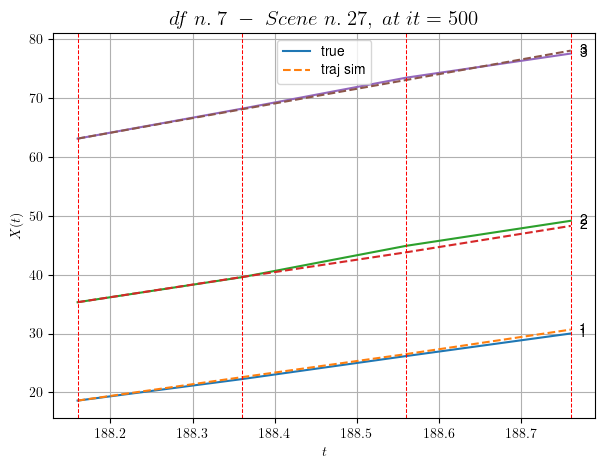

        For scene 27/30
        * use LR_NN=0.0001 with err=2.0718708579101293 at it=24
        * v0_scn_mean = 25.20469151932389
        * MAE = 0.1859648385834851



df n.7, scene n.28/30
    We have 2 time intervals inside [220.96,221.36]
            - Time interval n.0: [220.96, 221.16]
                * y_true: [27.25777683 27.84910592]
                * v_ann: [29.213184356689453, 34.44710159301758, 26.579845406052705]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [221.16, 221.36]
                * y_true: [24.9447965  32.01250046]
                * v_ann: [18.784875869750977, 23.433128356933594, 26.579845406052705]

----------------------------------------------------------------------------------------------------
    * err= 0.3593056958805833
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.01461148811502544


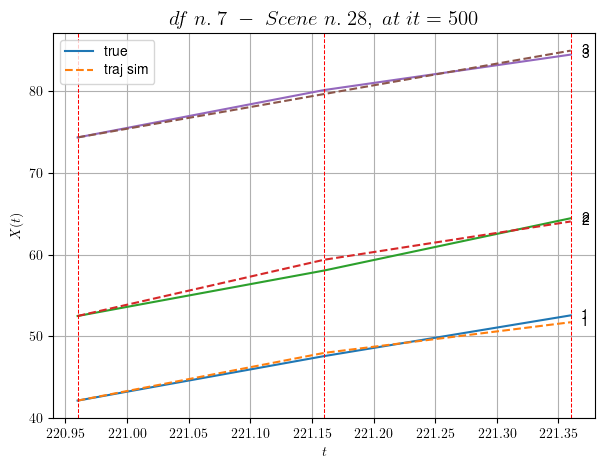

        For scene 28/30
        * use LR_NN=0.001 with err=2.8654706919625497 at it=24
        * v0_scn_mean = 26.785054528131994
        * MAE = 0.28791996187275753



df n.7, scene n.29/30
    We have 4 time intervals inside [166.56,167.36]
            - Time interval n.0: [166.56, 166.76]
                * y_true: [17.24164345 15.73752306 15.58083022]
                * v_ann: [17.772960662841797, 17.450937271118164, 17.140766143798828, 17.368635969066265]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [166.76, 166.96]
                * y_true: [18.38470966 27.72552812  9.3330177 ]
                * v_ann: [16.015623092651367, 16.576431274414062, 15.499788284301758, 17.368635969066265]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.96, 167.16]
                * y_true: [16.02323775 24.97208403 13.98221987]

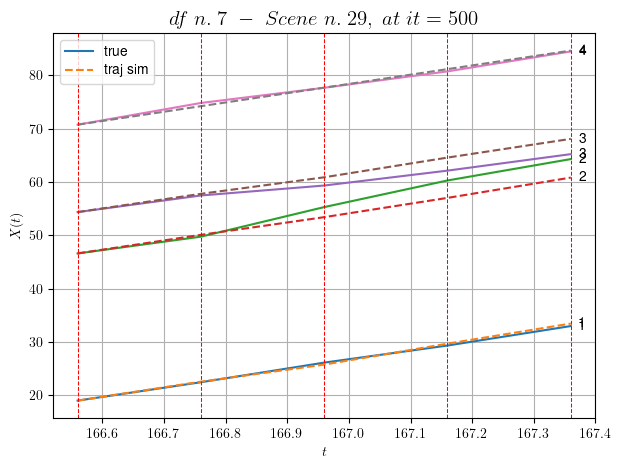

        For scene 29/30
        * use LR_NN=0.001 with err=27.602814281842036 at it=24
        * v0_scn_mean = 18.379103987412584
        * MAE = 2.1021215030907707



For df=7 with 30 scenes, time taken:        488.89
****************************************************************************************************
****************************************************************************************************
In df n.8/10 we have 79 scenes
df n.8, scene n.0/79
    We have 4 time intervals inside [15.24,16.04]
            - Time interval n.0: [15.24, 15.44]
                * y_true: [20.72015193]
                * v_ann: [24.818281173706055, 20.3722802984085]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [15.44, 15.64]
                * y_true: [22.3102442]
                * v_ann: [25.226287841796875, 20.3722802984085]

-----------------------------------------------------------------------

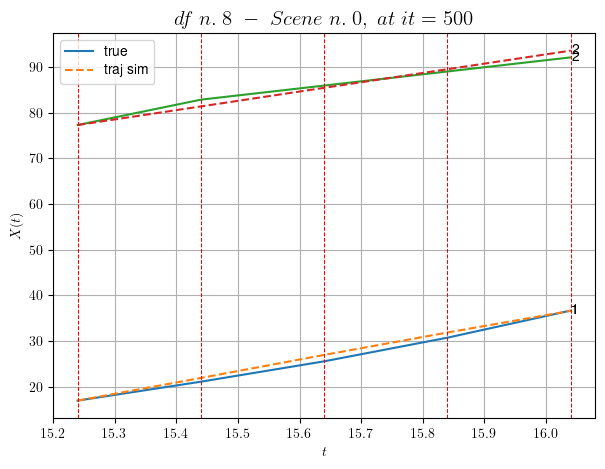

        For scene 0/79
        * use LR_NN=1e-05 with err=13.958244032165881 at it=24
        * v0_scn_mean = 20.757389086398558
        * MAE = 0.8778505750058351



df n.8, scene n.1/79
    We have 4 time intervals inside [28.44,29.24]
            - Time interval n.0: [28.44, 28.64]
                * y_true: [8.71284384]
                * v_ann: [7.207169055938721, 19.374312728051596]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [28.64, 28.84]
                * y_true: [8.50235658]
                * v_ann: [7.444500923156738, 19.374312728051596]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [28.84, 29.04]
                * y_true: [7.66040755]
                * v_ann: [7.95433235168457, 19.374312728051596]

----------------------------------------------------------------------------------------------------
 

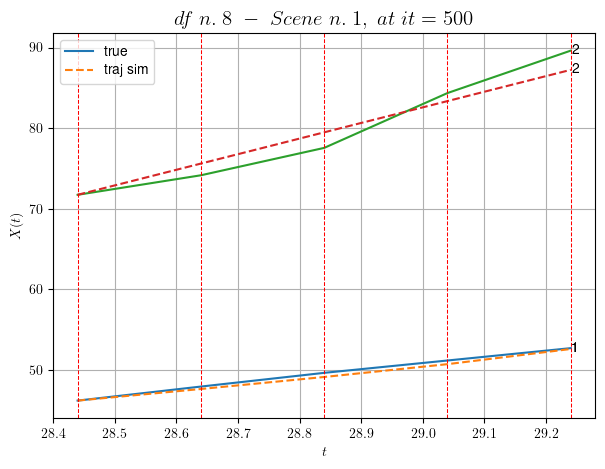

        For scene 1/79
        * use LR_NN=5e-05 with err=11.801990740117335 at it=24
        * v0_scn_mean = 19.799340218848332
        * MAE = 1.1392586040641108



df n.8, scene n.2/79
    We have 4 time intervals inside [48.04,48.84]
            - Time interval n.0: [48.04, 48.24]
                * y_true: [1.45008394]
                * v_ann: [1.0914878845214844, 19.366199251197184]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [48.24, 48.44]
                * y_true: [1.45008394]
                * v_ann: [1.3203248977661133, 19.366199251197184]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [48.44, 48.64]
                * y_true: [1.45008394]
                * v_ann: [1.519823431968689, 19.366199251197184]

---------------------------------------------------------------------------------------------------

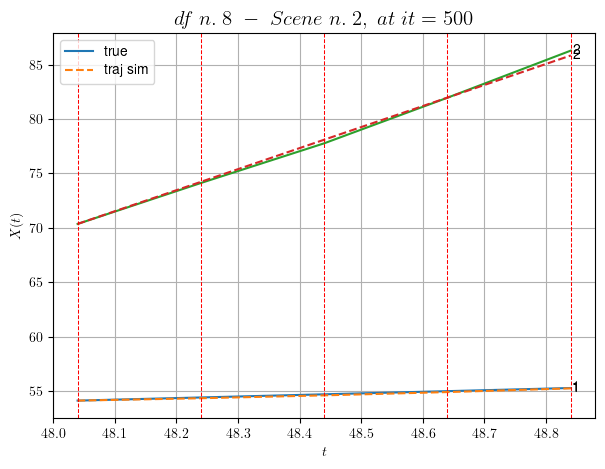

        For scene 2/79
        * use LR_NN=0.0005 with err=13.179129953851954 at it=24
        * v0_scn_mean = 19.791551281068124
        * MAE = 0.032323352879472494



df n.8, scene n.3/79
    We have 7 time intervals inside [58.44,59.84]
            - Time interval n.0: [58.44, 58.64]
                * y_true: [0.49091559]
                * v_ann: [19.188119888305664, 27.356016886559164]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [58.64, 58.84]
                * y_true: [17.39372277]
                * v_ann: [19.417110443115234, 27.356016886559164]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [58.84, 59.04]
                * y_true: [26.31054645]
                * v_ann: [20.880897521972656, 27.356016886559164]

---------------------------------------------------------------------------------------------

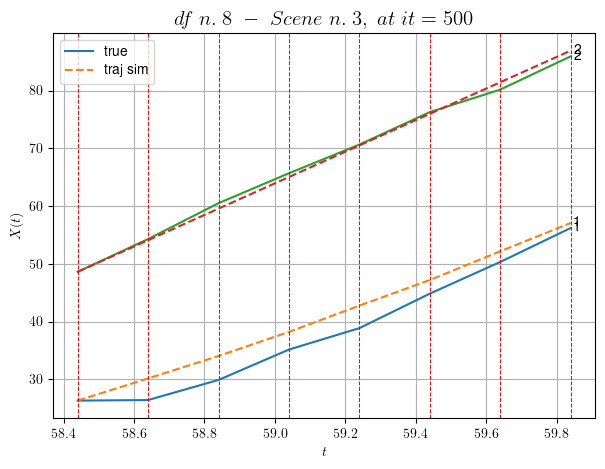

        For scene 3/79
        * use LR_NN=0.0005 with err=5.649118211351434 at it=24
        * v0_scn_mean = 27.461776211076533
        * MAE = 2.3894625780852974



df n.8, scene n.4/79
    We have 3 time intervals inside [64.04,64.64]
            - Time interval n.0: [64.04, 64.24]
                * y_true: [0.10384778]
                * v_ann: [-0.08886237442493439, 28.11126217595817]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [64.24, 64.44]
                * y_true: [0.10384778]
                * v_ann: [0.08469942957162857, 28.11126217595817]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [64.44, 64.64]
                * y_true: [0.10384778]
                * v_ann: [0.2655160129070282, 28.11126217595817]

--------------------------------------------------------------------------------------------------

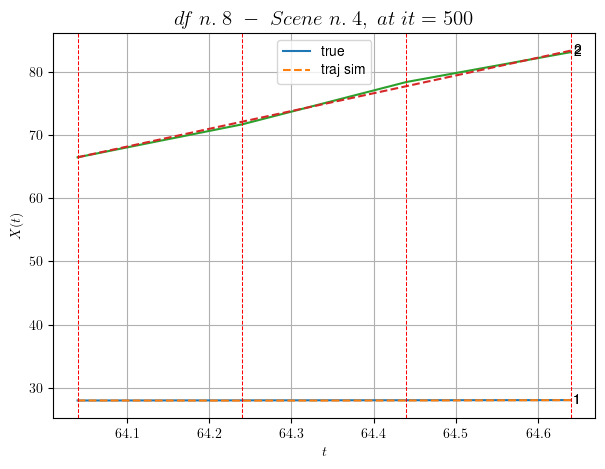

        For scene 4/79
        * use LR_NN=0.0001 with err=0.31603660027703995 at it=24
        * v0_scn_mean = 28.186811688904818
        * MAE = 0.08363599730910103



df n.8, scene n.5/79
    We have 6 time intervals inside [89.24,90.44]
            - Time interval n.0: [89.24, 89.44]
                * y_true: [18.05066392]
                * v_ann: [33.79717254638672, 10.6585127883746]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [89.44, 89.64]
                * y_true: [35.35163844]
                * v_ann: [30.909116744995117, 10.6585127883746]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [89.64, 89.84]
                * y_true: [13.10073144]
                * v_ann: [24.002195358276367, 10.6585127883746]

---------------------------------------------------------------------------------------------------

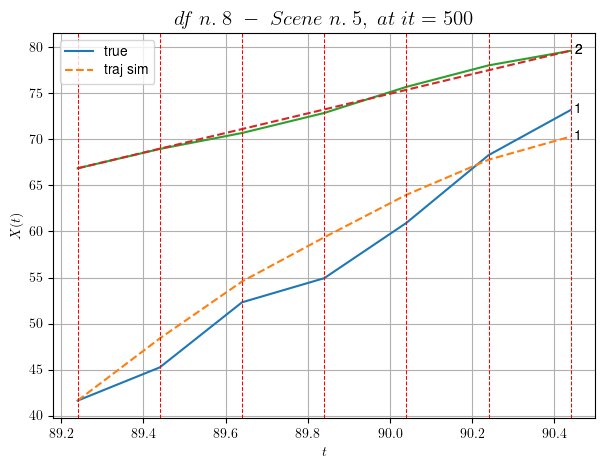

        For scene 5/79
        * use LR_NN=5e-05 with err=100.14241530547847 at it=24
        * v0_scn_mean = 11.432172276691865
        * MAE = 3.800206494333515



df n.8, scene n.6/79
    We have 10 time intervals inside [101.04,103.04]
            - Time interval n.0: [101.04, 101.24]
                * y_true: [18.44035973]
                * v_ann: [20.939287185668945, 26.48969548240825]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [101.24, 101.44]
                * y_true: [17.96043382]
                * v_ann: [19.30486488342285, 26.48969548240825]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [101.44, 101.64]
                * y_true: [17.55051624]
                * v_ann: [19.158803939819336, 26.48969548240825]

-------------------------------------------------------------------------------------------

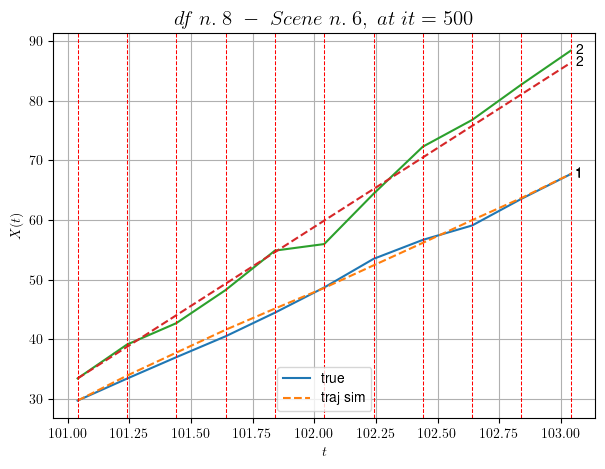

        For scene 6/79
        * use LR_NN=0.001 with err=18.584209751320188 at it=24
        * v0_scn_mean = 26.630107663084797
        * MAE = 1.5980151386828325



df n.8, scene n.7/79
    We have 3 time intervals inside [105.04,105.64]
            - Time interval n.0: [105.04, 105.24]
                * y_true: [21.1009302]
                * v_ann: [29.983182907104492, 27.68802462182387]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [105.24, 105.44]
                * y_true: [30.82171709]
                * v_ann: [31.086687088012695, 27.68802462182387]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [105.44, 105.64]
                * y_true: [39.03276006]
                * v_ann: [30.012218475341797, 27.68802462182387]

-------------------------------------------------------------------------------------------

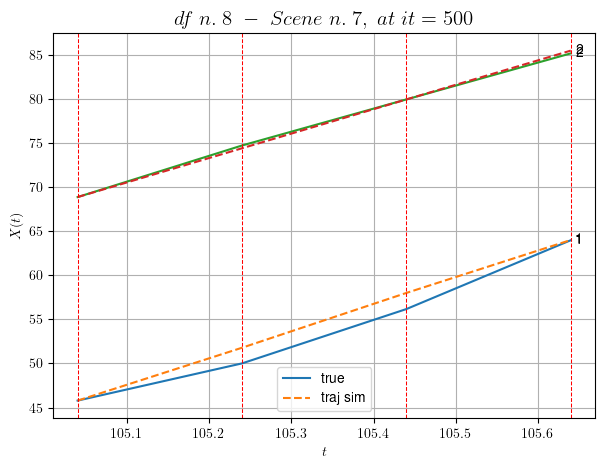

        For scene 7/79
        * use LR_NN=5e-05 with err=1.4698489121291374 at it=24
        * v0_scn_mean = 27.780503636933318
        * MAE = 0.8305951496577015



df n.8, scene n.8/79
    We have 2 time intervals inside [116.04,116.44]
            - Time interval n.0: [116.04, 116.24]
                * y_true: [26.70188245]
                * v_ann: [26.261260986328125, 29.990508338298042]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [116.24, 116.44]
                * y_true: [26.60221886]
                * v_ann: [27.02968406677246, 29.990508338298042]

----------------------------------------------------------------------------------------------------
    * err= 0.0013247392995453377
    * Learning rate NN = 7.289998757187277e-05
    * diff = 5.508299010718301e-06


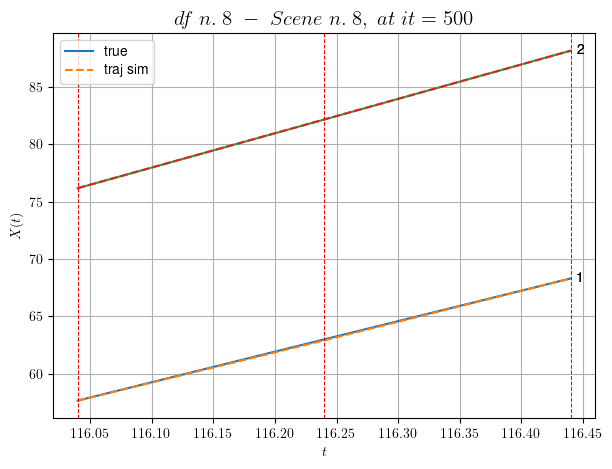

        For scene 8/79
        * use LR_NN=0.0001 with err=0.0026736371150109925 at it=24
        * v0_scn_mean = 29.990888004766145
        * MAE = 0.0013192009657846315



df n.8, scene n.9/79
    We have 3 time intervals inside [127.84,128.44]
            - Time interval n.0: [127.84, 128.04]
                * y_true: [21.61084593]
                * v_ann: [22.722017288208008, 37.027384413421686]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [128.04, 128.24]
                * y_true: [29.37145511]
                * v_ann: [25.058387756347656, 37.027384413421686]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [128.24, 128.44]
                * y_true: [23.33137295]
                * v_ann: [26.48072624206543, 37.027384413421686]

---------------------------------------------------------------------------------

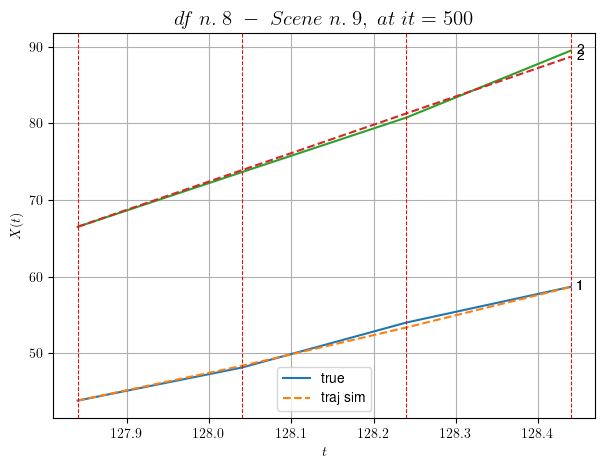

        For scene 9/79
        * use LR_NN=5e-05 with err=4.022094972205557 at it=24
        * v0_scn_mean = 36.746289036937824
        * MAE = 0.1817179093943935



df n.8, scene n.10/79
    We have 2 time intervals inside [138.84,139.24]
            - Time interval n.0: [138.84, 139.04]
                * y_true: [30.02321616]
                * v_ann: [31.059711456298828, 37.554786770989494]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [139.04, 139.24]
                * y_true: [34.10253194]
                * v_ann: [33.13908004760742, 37.554786770989494]

----------------------------------------------------------------------------------------------------
    * err= 0.05532942087476668
    * Learning rate NN = 7.289998757187277e-05
    * diff = 2.1633981902670352e-05


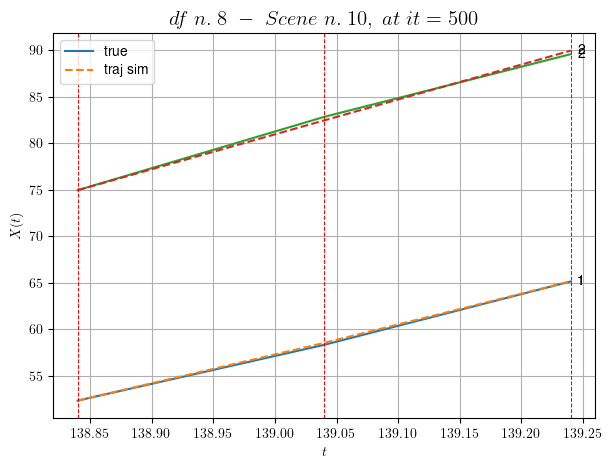

        For scene 10/79
        * use LR_NN=0.0001 with err=1.76446878803966 at it=24
        * v0_scn_mean = 37.25259530020753
        * MAE = 0.051569271918967215



df n.8, scene n.11/79
    We have 3 time intervals inside [154.24,154.84]
            - Time interval n.0: [154.24, 154.44]
                * y_true: [16.35114044]
                * v_ann: [17.47532081604004, 35.440393347036846]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [154.44, 154.64]
                * y_true: [25.35202142]
                * v_ann: [27.038976669311523, 35.440393347036846]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [154.64, 154.84]
                * y_true: [28.9027085]
                * v_ann: [26.50987434387207, 35.440393347036846]

----------------------------------------------------------------------------------------

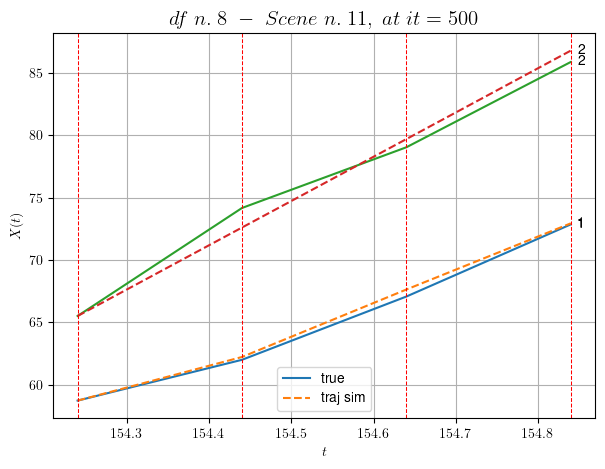

        For scene 11/79
        * use LR_NN=0.0001 with err=1.883518655566701 at it=24
        * v0_scn_mean = 35.22277761319667
        * MAE = 0.5109699099551301



df n.8, scene n.12/79
    We have 3 time intervals inside [166.84,167.44]
            - Time interval n.0: [166.84, 167.04]
                * y_true: [14.80039759]
                * v_ann: [16.44564437866211, 15.667717542016634]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [167.04, 167.24]
                * y_true: [20.4006375]
                * v_ann: [15.946296691894531, 15.667717542016634]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [167.24, 167.44]
                * y_true: [13.420495]
                * v_ann: [16.1745548248291, 15.667717542016634]

--------------------------------------------------------------------------------------------

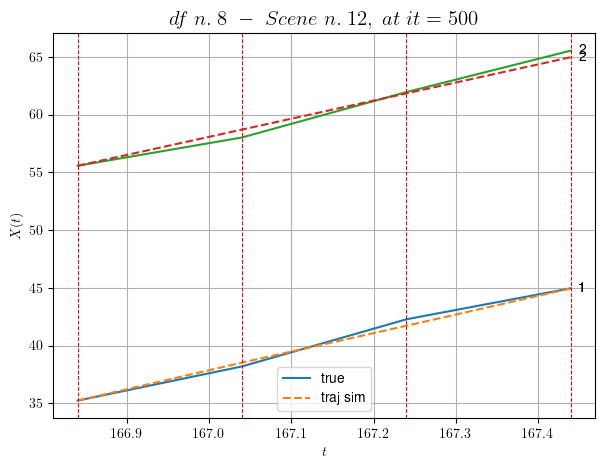

        For scene 12/79
        * use LR_NN=0.0001 with err=13.640550016591492 at it=24
        * v0_scn_mean = 16.24100884022628
        * MAE = 0.1435047344614105



df n.8, scene n.13/79
    We have 2 time intervals inside [176.24,176.64]
            - Time interval n.0: [176.24, 176.44]
                * y_true: [6.14038325]
                * v_ann: [5.407116889953613, 28.209763890714004]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [176.44, 176.64]
                * y_true: [6.14038326]
                * v_ann: [6.722427845001221, 28.209763890714004]

----------------------------------------------------------------------------------------------------
    * err= 0.12321959006798512
    * Learning rate NN = 7.289998757187277e-05
    * diff = 3.815137176038652e-06


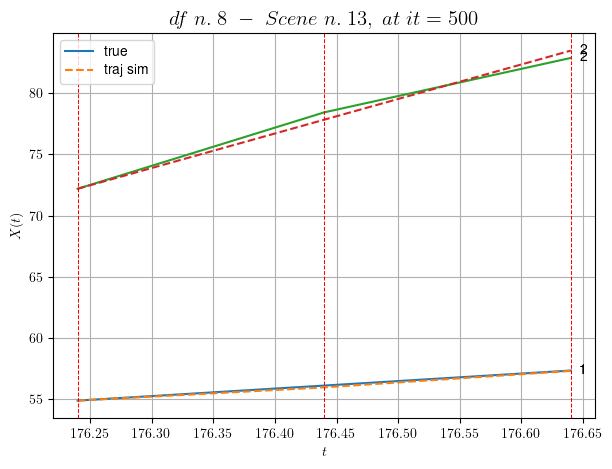

        For scene 13/79
        * use LR_NN=0.0001 with err=0.30225824567277787 at it=24
        * v0_scn_mean = 28.281373335072352
        * MAE = 0.12321705799513494



df n.8, scene n.14/79
    We have 4 time intervals inside [178.44,179.24]
            - Time interval n.0: [178.44, 178.64]
                * y_true: [22.76155551]
                * v_ann: [30.746414184570312, 12.308982889932018]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [178.64, 178.84]
                * y_true: [36.29307367]
                * v_ann: [23.03217315673828, 12.308982889932018]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [178.84, 179.04]
                * y_true: [16.78302591]
                * v_ann: [13.954487800598145, 12.308982889932018]

-----------------------------------------------------------------------------------

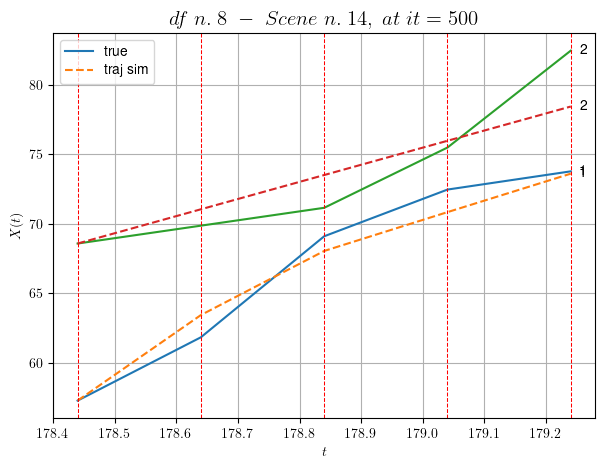

        For scene 14/79
        * use LR_NN=0.0001 with err=35.238795847014714 at it=24
        * v0_scn_mean = 13.016623574199471
        * MAE = 2.702372113556603



df n.8, scene n.15/79
    We have 5 time intervals inside [190.84,191.84]
            - Time interval n.0: [190.84, 191.04]
                * y_true: [30.51246457]
                * v_ann: [15.991158485412598, 12.068548421445527]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [191.04, 191.24]
                * y_true: [14.21130177]
                * v_ann: [8.713262557983398, 12.068548421445527]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [191.24, 191.44]
                * y_true: [4.75758557]
                * v_ann: [9.876782417297363, 12.068548421445527]

----------------------------------------------------------------------------------------

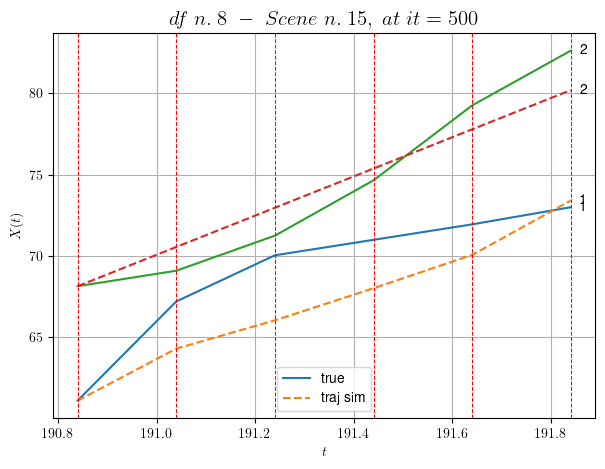

        For scene 15/79
        * use LR_NN=0.0001 with err=58.90089553883806 at it=24
        * v0_scn_mean = 12.785806484450706
        * MAE = 3.578959737888505



df n.8, scene n.16/79
    We have 2 time intervals inside [194.44,194.84]
            - Time interval n.0: [194.44, 194.64]
                * y_true: [11.75098765]
                * v_ann: [17.849328994750977, 17.64870499817793]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [194.64, 194.84]
                * y_true: [24.50229075]
                * v_ann: [18.74964714050293, 17.64870499817793]

----------------------------------------------------------------------------------------------------
    * err= 0.3279168650285471
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 2.0174953126783635e-05


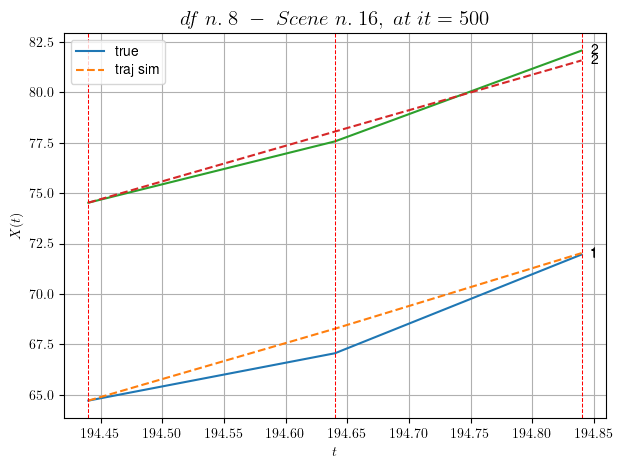

        For scene 16/79
        * use LR_NN=5e-05 with err=4.955825893397943 at it=24
        * v0_scn_mean = 18.142756798156327
        * MAE = 0.3239502942628081



df n.8, scene n.17/79
    We have 4 time intervals inside [197.84,198.64]
            - Time interval n.0: [197.84, 198.04]
                * y_true: [22.53153444]
                * v_ann: [13.504585266113281, 23.275091763732032]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [198.04, 198.24]
                * y_true: [13.78102172]
                * v_ann: [16.925886154174805, 23.275091763732032]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [198.24, 198.44]
                * y_true: [11.85098834]
                * v_ann: [16.794872283935547, 23.275091763732032]

--------------------------------------------------------------------------------------

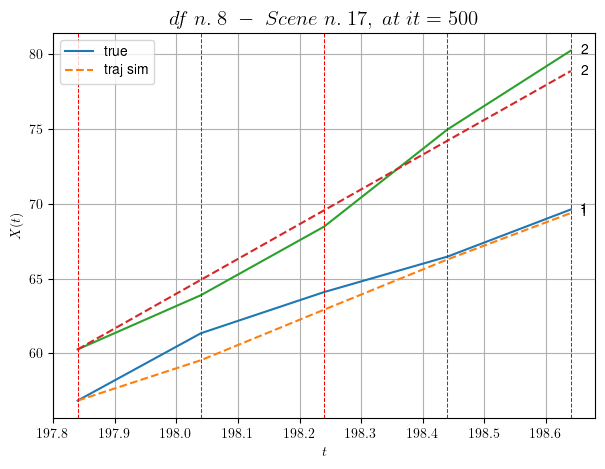

        For scene 17/79
        * use LR_NN=0.005 with err=6.040876211540096 at it=24
        * v0_scn_mean = 23.544088093131645
        * MAE = 0.9414151518614671



df n.8, scene n.18/79
    We have 6 time intervals inside [210.84,212.04]
            - Time interval n.0: [210.84, 211.04]
                * y_true: [18.40045523]
                * v_ann: [22.89507484436035, 21.37734163264228]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [211.04, 211.24]
                * y_true: [21.20064657]
                * v_ann: [23.80296516418457, 21.37734163264228]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [211.24, 211.44]
                * y_true: [18.20066994]
                * v_ann: [24.28531265258789, 21.37734163264228]

--------------------------------------------------------------------------------------------

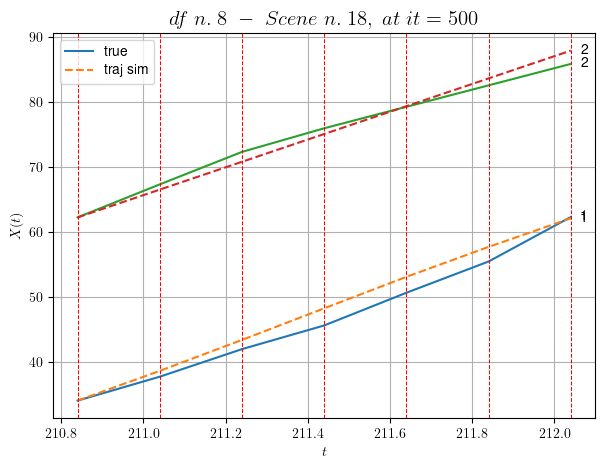

        For scene 18/79
        * use LR_NN=1e-05 with err=24.41600433095046 at it=24
        * v0_scn_mean = 21.722247967270818
        * MAE = 2.1337402721877354



df n.8, scene n.19/79
    We have 11 time intervals inside [250.44,252.64]
            - Time interval n.0: [250.44, 250.64]
                * y_true: [16.04072287]
                * v_ann: [17.145299911499023, 14.644824448517864]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [250.64, 250.84]
                * y_true: [15.51077127]
                * v_ann: [15.972097396850586, 14.644824448517864]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [250.84, 251.04]
                * y_true: [15.34089466]
                * v_ann: [15.8649263381958, 14.644824448517864]

---------------------------------------------------------------------------------------

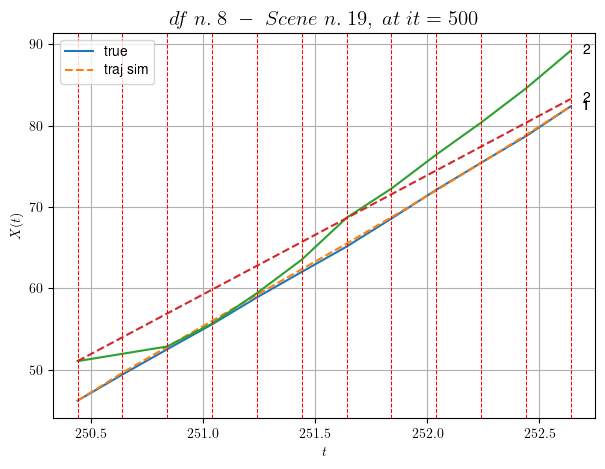

        For scene 19/79
        * use LR_NN=0.005 with err=176.3068748697567 at it=24
        * v0_scn_mean = 15.259031470459682
        * MAE = 4.1302451184183955



df n.8, scene n.20/79
    We have 5 time intervals inside [276.64,277.64]
            - Time interval n.0: [276.64, 276.84]
                * y_true: [19.91101059]
                * v_ann: [19.91363525390625, 26.490508846064177]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [276.84, 277.04]
                * y_true: [24.60145519]
                * v_ann: [24.592405319213867, 26.490508846064177]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [277.04, 277.24]
                * y_true: [20.33137939]
                * v_ann: [20.341882705688477, 26.490508846064177]

---------------------------------------------------------------------------------------

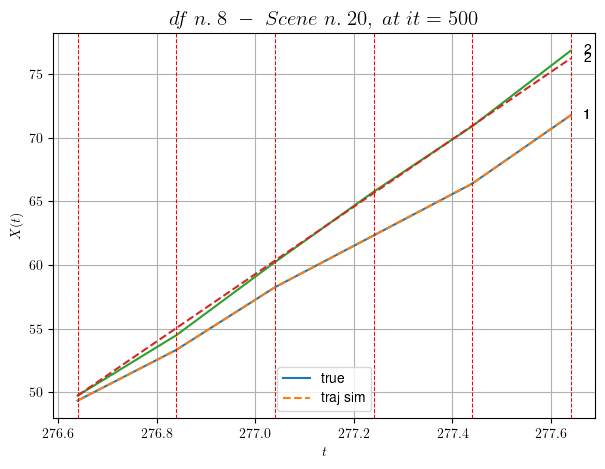

        For scene 20/79
        * use LR_NN=0.01 with err=2.2387603266551594 at it=24
        * v0_scn_mean = 26.630888492195417
        * MAE = 0.05917748382768175



df n.8, scene n.21/79
    We have 5 time intervals inside [278.64,279.64]
            - Time interval n.0: [278.64, 278.84]
                * y_true: [25.33138011]
                * v_ann: [21.881547927856445, 27.40725931573358]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [278.84, 279.04]
                * y_true: [26.10168972]
                * v_ann: [22.401628494262695, 27.40725931573358]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [279.04, 279.24]
                * y_true: [28.27219854]
                * v_ann: [22.048307418823242, 27.40725931573358]

----------------------------------------------------------------------------------------

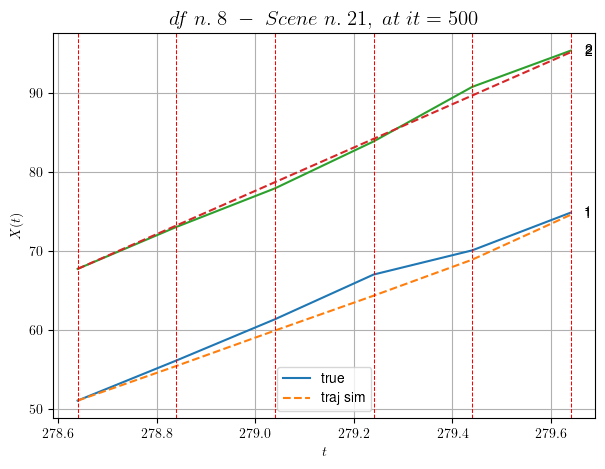

        For scene 21/79
        * use LR_NN=5e-05 with err=2.031035284641775 at it=24
        * v0_scn_mean = 27.510968943083654
        * MAE = 1.0800452845436694



df n.8, scene n.22/79
    We have 4 time intervals inside [281.44,282.24]
            - Time interval n.0: [281.44, 281.64]
                * y_true: [31.54245626]
                * v_ann: [31.5992374420166, 25.060172008753163]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [281.64, 281.84]
                * y_true: [26.752427]
                * v_ann: [28.39180564880371, 25.060172008753163]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [281.84, 282.04]
                * y_true: [30.20476381]
                * v_ann: [28.70564079284668, 25.060172008753163]

--------------------------------------------------------------------------------------------

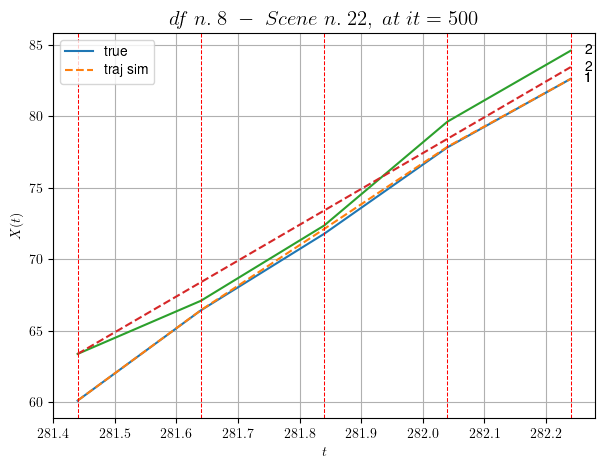

        For scene 22/79
        * use LR_NN=0.005 with err=2.8932635989175393 at it=24
        * v0_scn_mean = 25.257765128364888
        * MAE = 0.5125049423676644



df n.8, scene n.23/79
    We have 6 time intervals inside [283.84,285.04]
            - Time interval n.0: [283.84, 284.04]
                * y_true: [21.50116485]
                * v_ann: [21.6634521484375, 31.024373752742626]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [284.04, 284.24]
                * y_true: [21.05133002]
                * v_ann: [20.683813095092773, 31.024373752742626]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [284.24, 284.44]
                * y_true: [35.30269143]
                * v_ann: [19.55109405517578, 31.024373752742626]

----------------------------------------------------------------------------------------

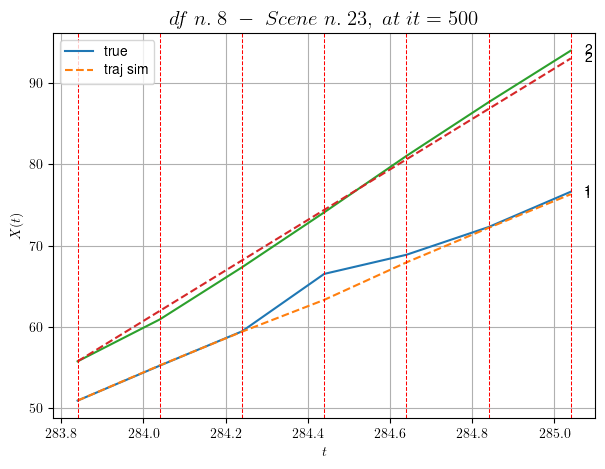

        For scene 23/79
        * use LR_NN=0.001 with err=8.60654790215431 at it=24
        * v0_scn_mean = 30.98339880264076
        * MAE = 1.0612413662251976



df n.8, scene n.24/79
    We have 2 time intervals inside [313.24,313.64]
    * err= 0.06676564390545556
    * Learning rate NN = 0.008099999278783798
    * diff = 2.441457904178712e-07


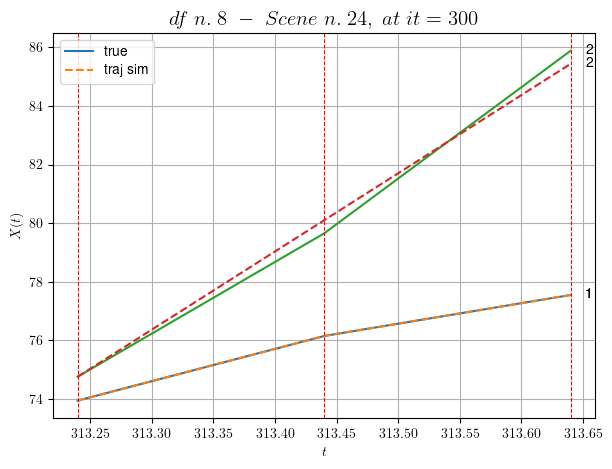

        For scene 24/79
        * use LR_NN=0.01 with err=0.33179844849682094 at it=24
        * v0_scn_mean = 26.91875877244017
        * MAE = 0.060089129280486916



df n.8, scene n.25/79
    We have 5 time intervals inside [319.44,320.44]
            - Time interval n.0: [319.44, 319.64]
                * y_true: [9.82525355]
                * v_ann: [6.556804656982422, 24.072557838554268]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [319.64, 319.84]
                * y_true: [9.82525355]
                * v_ann: [6.890491962432861, 24.072557838554268]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [319.84, 320.04]
                * y_true: [7.3502267]
                * v_ann: [7.417989253997803, 24.072557838554268]

-------------------------------------------------------------------------------------------

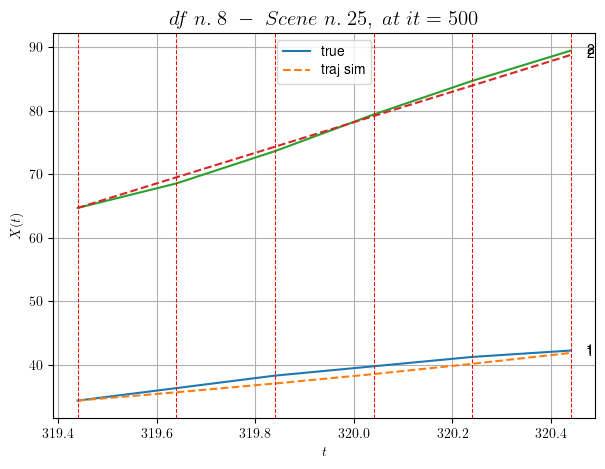

        For scene 25/79
        * use LR_NN=1e-05 with err=6.229089718708358 at it=24
        * v0_scn_mean = 24.309655524966516
        * MAE = 0.6057571788259603



df n.8, scene n.26/79
    We have 8 time intervals inside [323.44,325.04]
            - Time interval n.0: [323.44, 323.64]
                * y_true: [24.33027056]
                * v_ann: [19.80133819580078, 25.75837440986018]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [323.64, 323.84]
                * y_true: [24.59038686]
                * v_ann: [20.11836814880371, 25.75837440986018]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [323.84, 324.04]
                * y_true: [20.91043945]
                * v_ann: [20.8695011138916, 25.75837440986018]

---------------------------------------------------------------------------------------------

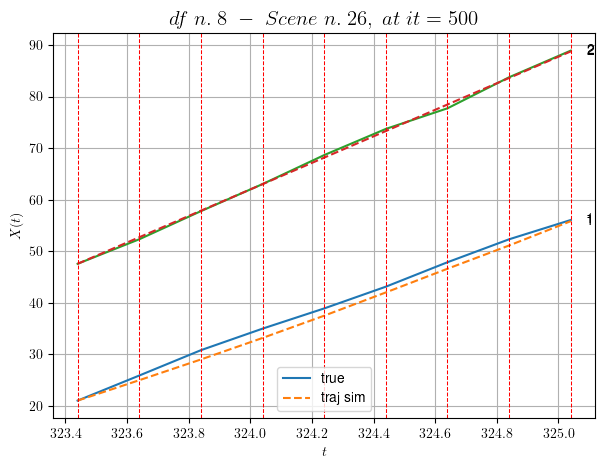

        For scene 26/79
        * use LR_NN=0.0001 with err=8.953154165995821 at it=24
        * v0_scn_mean = 25.928039433433494
        * MAE = 0.8145170910276786



df n.8, scene n.27/79
    We have 9 time intervals inside [327.84,329.64]
            - Time interval n.0: [327.84, 328.04]
                * y_true: [22.06055829]
                * v_ann: [29.23607063293457, 23.318084130194872]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [328.04, 328.24]
                * y_true: [23.96078165]
                * v_ann: [27.50159454345703, 23.318084130194872]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [328.24, 328.44]
                * y_true: [24.43098932]
                * v_ann: [27.217121124267578, 23.318084130194872]

---------------------------------------------------------------------------------------

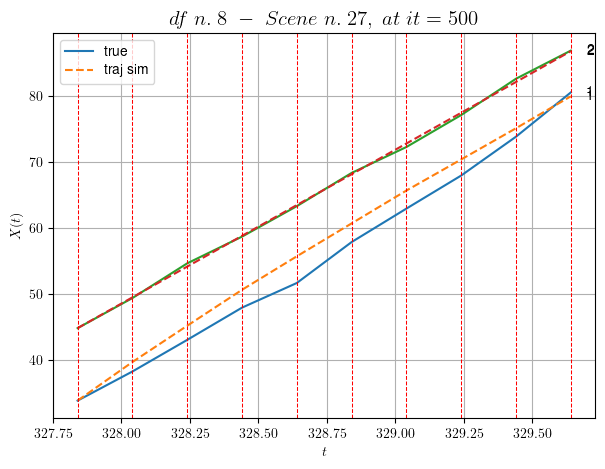

        For scene 27/79
        * use LR_NN=0.001 with err=27.048040449938128 at it=24
        * v0_scn_mean = 23.58536076493576
        * MAE = 1.8191236463683451



df n.8, scene n.28/79
    We have 4 time intervals inside [335.04,335.84]
            - Time interval n.0: [335.04, 335.24]
                * y_true: [24.8512221]
                * v_ann: [23.1369686126709, 23.061271780932774]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [335.24, 335.44]
                * y_true: [19.04114233]
                * v_ann: [21.256141662597656, 23.061271780932774]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [335.44, 335.64]
                * y_true: [28.30193393]
                * v_ann: [24.43621063232422, 23.061271780932774]

------------------------------------------------------------------------------------------

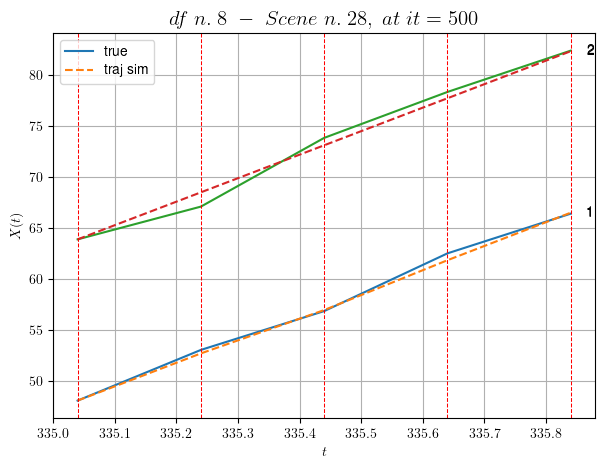

        For scene 28/79
        * use LR_NN=5e-05 with err=5.54074304254252 at it=24
        * v0_scn_mean = 23.338820909643044
        * MAE = 0.3340097707206788



df n.8, scene n.29/79
    We have 14 time intervals inside [366.64,369.44]
            - Time interval n.0: [366.64, 366.84]
                * y_true: [17.86619918]
                * v_ann: [12.95947265625, 18.211190440756237]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [366.84, 367.04]
                * y_true: [7.2501536]
                * v_ann: [8.04722785949707, 18.211190440756237]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [367.04, 367.24]
                * y_true: [7.20516912]
                * v_ann: [11.319506645202637, 18.211190440756237]

-----------------------------------------------------------------------------------------------

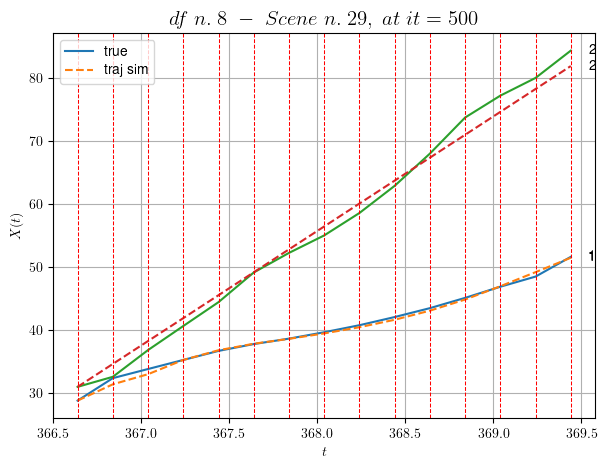

        For scene 29/79
        * use LR_NN=0.001 with err=179.89205845687113 at it=24
        * v0_scn_mean = 18.682742823035806
        * MAE = 1.2828809235374166



df n.8, scene n.30/79
    We have 9 time intervals inside [389.24,391.04]
            - Time interval n.0: [389.24, 389.44]
                * y_true: [8.38525844]
                * v_ann: [8.946720123291016, 19.019765770329105]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [389.44, 389.64]
                * y_true: [9.22528905]
                * v_ann: [7.2356109619140625, 19.019765770329105]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [389.64, 389.84]
                * y_true: [6.14521269]
                * v_ann: [6.9899091720581055, 19.019765770329105]

-----------------------------------------------------------------------------------------

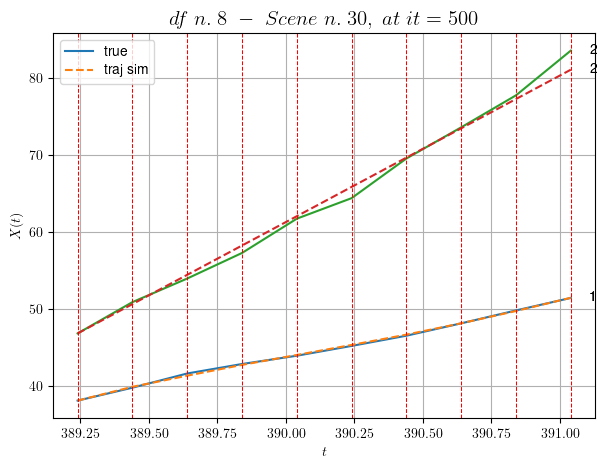

        For scene 30/79
        * use LR_NN=0.001 with err=66.95436051345457 at it=24
        * v0_scn_mean = 19.458975139433267
        * MAE = 0.48257466869514337



df n.8, scene n.31/79
    We have 2 time intervals inside [397.24,397.64]
            - Time interval n.0: [397.24, 397.44]
                * y_true: [16.60087318]
                * v_ann: [22.77021026611328, 29.637208516307787]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [397.44, 397.64]
                * y_true: [30.91194424]
                * v_ann: [25.486717224121094, 29.637208516307787]

----------------------------------------------------------------------------------------------------
    * err= 0.7402066499612762
    * Learning rate NN = 7.289998848136747e-06
    * diff = 0.0001259984677214332


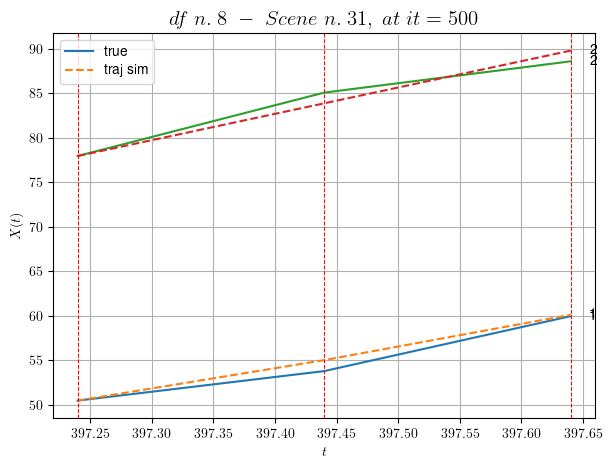

        For scene 31/79
        * use LR_NN=1e-05 with err=0.7015209994721497 at it=24
        * v0_scn_mean = 29.651720175653086
        * MAE = 0.6723580716214168



df n.8, scene n.32/79
    We have 3 time intervals inside [404.84,405.44]
            - Time interval n.0: [404.84, 405.04]
                * y_true: [1.47503232]
                * v_ann: [8.647281646728516, 27.902766852719747]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [405.04, 405.24]
                * y_true: [8.01795896]
                * v_ann: [9.605253219604492, 27.902766852719747]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [405.24, 405.44]
                * y_true: [17.33045096]
                * v_ann: [10.317350387573242, 27.902766852719747]

-----------------------------------------------------------------------------------------

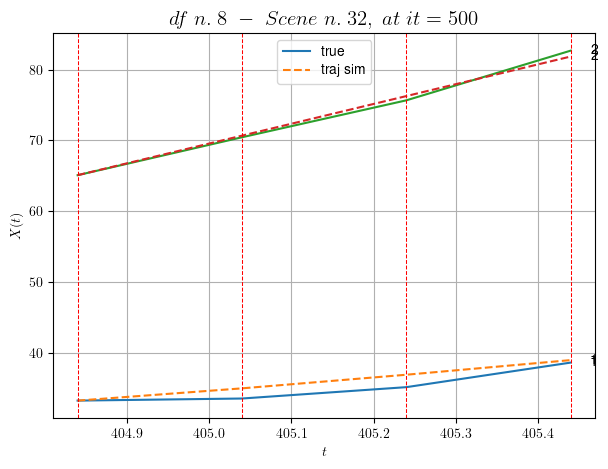

        For scene 32/79
        * use LR_NN=1e-05 with err=1.1725529353430393 at it=24
        * v0_scn_mean = 27.986656178592458
        * MAE = 0.7938878641266651



df n.8, scene n.33/79
    We have 10 time intervals inside [412.04,414.04]
            - Time interval n.0: [412.04, 412.24]
                * y_true: [24.0804594]
                * v_ann: [21.16925811767578, 22.871866245202693]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [412.24, 412.44]
                * y_true: [27.74068623]
                * v_ann: [22.596799850463867, 22.871866245202693]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [412.44, 412.64]
                * y_true: [22.39072047]
                * v_ann: [24.068002700805664, 22.871866245202693]

--------------------------------------------------------------------------------------

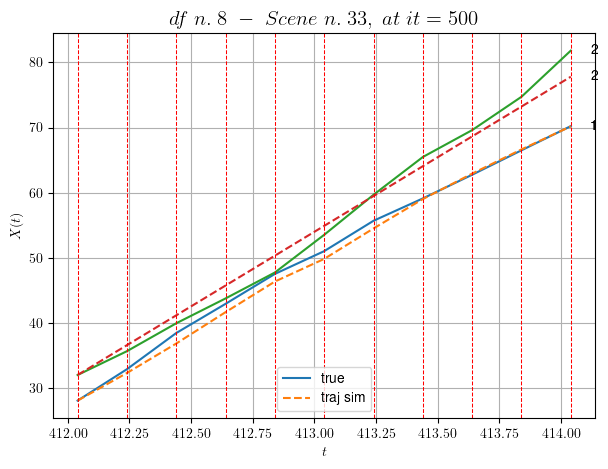

        For scene 33/79
        * use LR_NN=0.005 with err=33.35997817225075 at it=24
        * v0_scn_mean = 23.156991595340237
        * MAE = 2.0377613063347186



df n.8, scene n.34/79
    We have 11 time intervals inside [418.84,421.04]
            - Time interval n.0: [418.84, 419.04]
                * y_true: [0.12387653]
                * v_ann: [10.06844711303711, 20.28967509238386]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [419.04, 419.24]
                * y_true: [0.12387653]
                * v_ann: [11.305771827697754, 20.28967509238386]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [419.24, 419.44]
                * y_true: [11.93873624]
                * v_ann: [11.850075721740723, 20.28967509238386]

-------------------------------------------------------------------------------------------

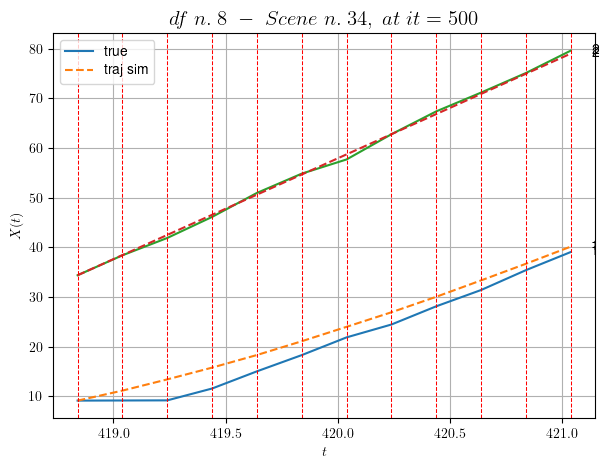

        For scene 34/79
        * use LR_NN=0.0005 with err=79.10696939860749 at it=24
        * v0_scn_mean = 20.67808808861416
        * MAE = 1.1656168179970159



df n.8, scene n.35/79
    We have 6 time intervals inside [437.64,438.84]
            - Time interval n.0: [437.64, 437.84]
                * y_true: [22.55008828]
                * v_ann: [18.972517013549805, 32.073548894469546]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [437.84, 438.04]
                * y_true: [21.30014205]
                * v_ann: [20.407155990600586, 32.073548894469546]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [438.04, 438.24]
                * y_true: [20.75020757]
                * v_ann: [21.38245391845703, 32.073548894469546]

---------------------------------------------------------------------------------------

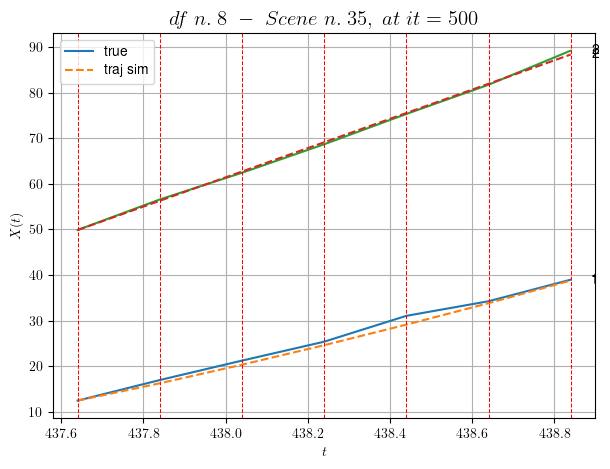

        For scene 35/79
        * use LR_NN=5e-05 with err=1.5873788666432374 at it=24
        * v0_scn_mean = 31.99060693870682
        * MAE = 0.49480079431138646



df n.8, scene n.36/79
    We have 14 time intervals inside [445.44,448.24]
            - Time interval n.0: [445.44, 445.64]
                * y_true: [0.12387653]
                * v_ann: [5.664320468902588, 21.040373735870407]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [445.64, 445.84]
                * y_true: [0.12387653]
                * v_ann: [10.488295555114746, 21.040373735870407]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [445.84, 446.04]
                * y_true: [12.34322315]
                * v_ann: [14.662562370300293, 21.040373735870407]

---------------------------------------------------------------------------------------

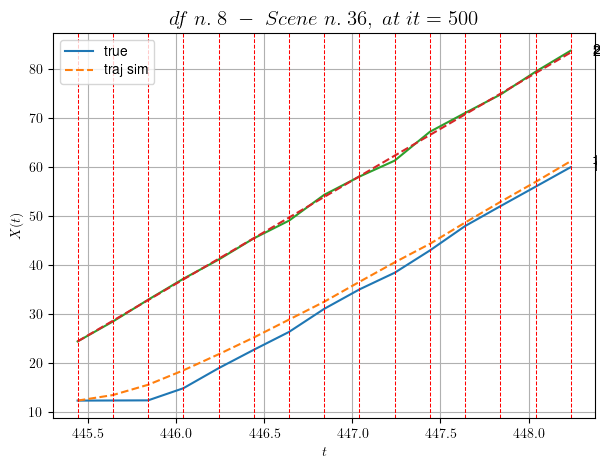

        For scene 36/79
        * use LR_NN=0.001 with err=108.955036990909 at it=24
        * v0_scn_mean = 21.39875878636719
        * MAE = 0.9863651730735081



df n.8, scene n.37/79
    We have 3 time intervals inside [453.64,454.24]
            - Time interval n.0: [453.64, 453.84]
                * y_true: [28.34103701]
                * v_ann: [31.8914794921875, 27.92010328442685]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [453.84, 454.04]
                * y_true: [30.17138066]
                * v_ann: [29.80027198791504, 27.92010328442685]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [454.04, 454.24]
                * y_true: [34.68214182]
                * v_ann: [31.515316009521484, 27.92010328442685]

----------------------------------------------------------------------------------------------

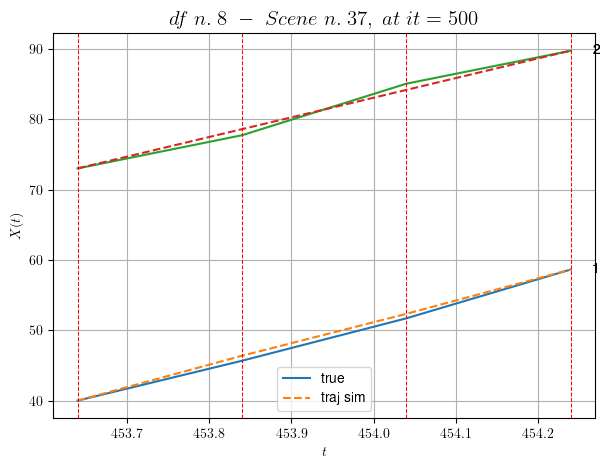

        For scene 37/79
        * use LR_NN=5e-05 with err=0.5262648792402641 at it=24
        * v0_scn_mean = 28.003299153034074
        * MAE = 0.3019959107109603



df n.8, scene n.38/79
    We have 4 time intervals inside [456.44,457.24]
            - Time interval n.0: [456.44, 456.64]
                * y_true: [23.84053136]
                * v_ann: [25.658451080322266, 22.637249688333263]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [456.64, 456.84]
                * y_true: [24.61071928]
                * v_ann: [25.382335662841797, 22.637249688333263]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [456.84, 457.04]
                * y_true: [25.2209288]
                * v_ann: [23.73967742919922, 22.637249688333263]

---------------------------------------------------------------------------------------

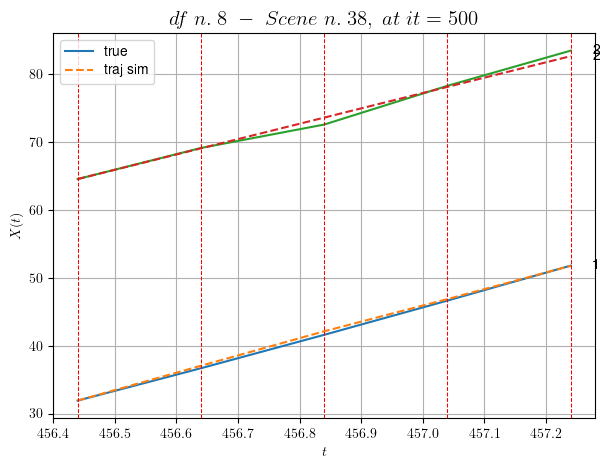

        For scene 38/79
        * use LR_NN=1e-05 with err=6.193266350929978 at it=24
        * v0_scn_mean = 22.931759700743914
        * MAE = 0.2101061718918742



df n.8, scene n.39/79
    We have 8 time intervals inside [458.64,460.24]
            - Time interval n.0: [458.64, 458.84]
                * y_true: [25.95045298]
                * v_ann: [24.04781150817871, 22.184785448498662]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [458.84, 459.04]
                * y_true: [22.25052189]
                * v_ann: [22.99551773071289, 22.184785448498662]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [459.04, 459.24]
                * y_true: [20.55060692]
                * v_ann: [23.528675079345703, 22.184785448498662]

----------------------------------------------------------------------------------------

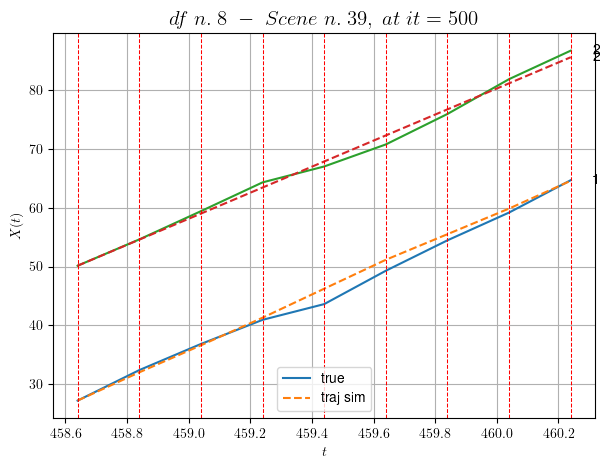

        For scene 39/79
        * use LR_NN=1e-05 with err=28.3834239305763 at it=24
        * v0_scn_mean = 22.497394030498995
        * MAE = 1.033626241965374



df n.8, scene n.40/79
    We have 15 time intervals inside [475.84,478.84]
            - Time interval n.0: [475.84, 476.04]
                * y_true: [0.12387653]
                * v_ann: [0.021417729556560516, 18.58562797515516]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [476.04, 476.24]
                * y_true: [0.12387653]
                * v_ann: [0.003723018104210496, 18.58562797515516]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [476.24, 476.44]
                * y_true: [0.12387653]
                * v_ann: [0.0013525978429242969, 18.58562797515516]

--------------------------------------------------------------------------------------

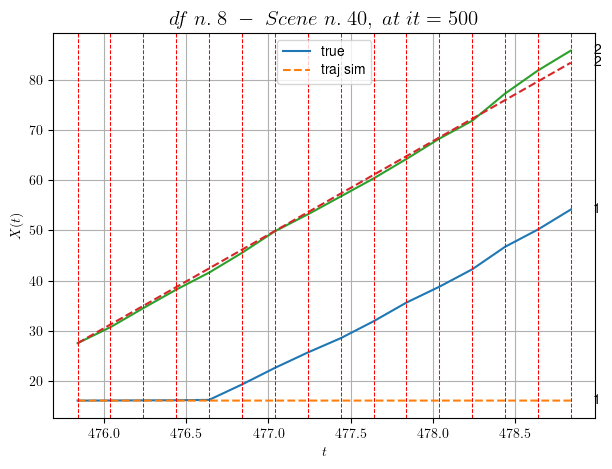

        For scene 40/79
        * use LR_NN=0.001 with err=197.50483872307868 at it=24
        * v0_scn_mean = 19.042202856062147
        * MAE = 177.08235190567893



df n.8, scene n.41/79
    We have 9 time intervals inside [488.24,490.04]
            - Time interval n.0: [488.24, 488.44]
                * y_true: [23.74050104]
                * v_ann: [26.926471710205078, 18.510799599164013]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [488.44, 488.64]
                * y_true: [16.69043259]
                * v_ann: [24.0802001953125, 18.510799599164013]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [488.64, 488.84]
                * y_true: [18.92060399]
                * v_ann: [23.851028442382812, 18.510799599164013]

---------------------------------------------------------------------------------------

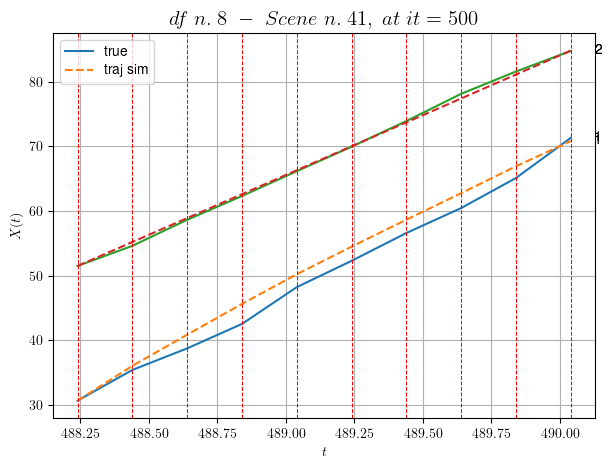

        For scene 41/79
        * use LR_NN=0.0005 with err=75.16969748683456 at it=24
        * v0_scn_mean = 18.970367615109517
        * MAE = 1.7616758617940684



df n.8, scene n.42/79
    We have 2 time intervals inside [491.84,492.24]
            - Time interval n.0: [491.84, 492.04]
                * y_true: [24.0518314]
                * v_ann: [23.05720329284668, 22.552414214619045]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [492.04, 492.24]
                * y_true: [23.60207937]
                * v_ann: [24.545377731323242, 22.552414214619045]

----------------------------------------------------------------------------------------------------
    * err= 0.19918027199352767
    * Learning rate NN = 0.00036449998151510954
    * diff = 6.093050258726418e-06


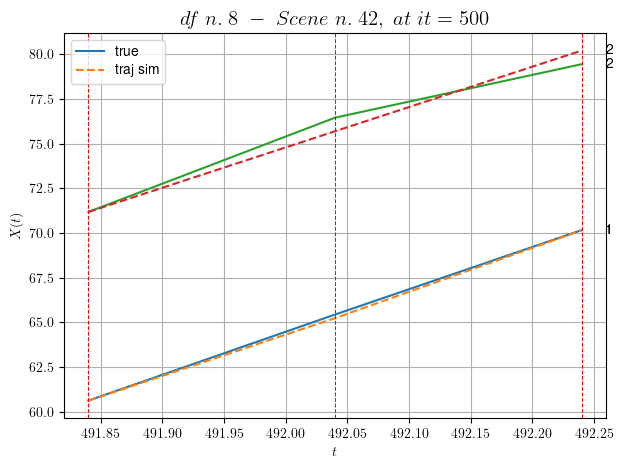

        For scene 42/79
        * use LR_NN=0.0005 with err=2.4252147142776863 at it=24
        * v0_scn_mean = 22.85031764597696
        * MAE = 0.19900179251745237



df n.8, scene n.43/79
    We have 7 time intervals inside [494.44,495.84]
            - Time interval n.0: [494.44, 494.64]
                * y_true: [0.12387653]
                * v_ann: [5.848554611206055, 22.008439992317083]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [494.64, 494.84]
                * y_true: [0.12387653]
                * v_ann: [6.600191593170166, 22.008439992317083]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [494.84, 495.04]
                * y_true: [0.12387653]
                * v_ann: [7.5343098640441895, 22.008439992317083]

-----------------------------------------------------------------------------------------

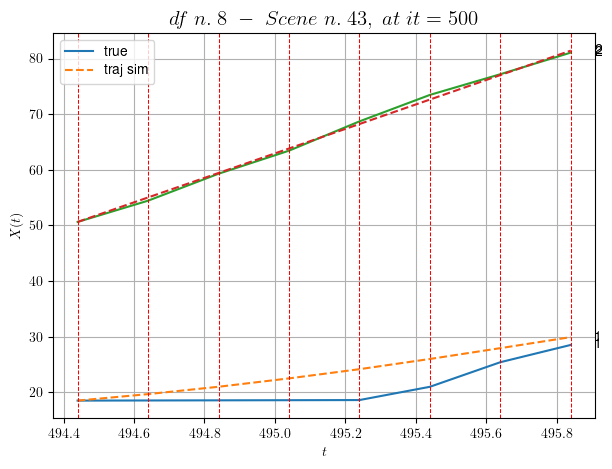

        For scene 43/79
        * use LR_NN=5e-05 with err=24.51195017848881 at it=24
        * v0_scn_mean = 22.328102392564652
        * MAE = 5.513644325367039



df n.8, scene n.44/79
    We have 12 time intervals inside [496.44,498.84]
            - Time interval n.0: [496.44, 496.64]
                * y_true: [20.50051219]
                * v_ann: [21.025184631347656, 18.546831523765878]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [496.64, 496.84]
                * y_true: [21.20065888]
                * v_ann: [21.090898513793945, 18.546831523765878]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [496.84, 497.04]
                * y_true: [18.1506795]
                * v_ann: [21.37602996826172, 18.546831523765878]

----------------------------------------------------------------------------------------

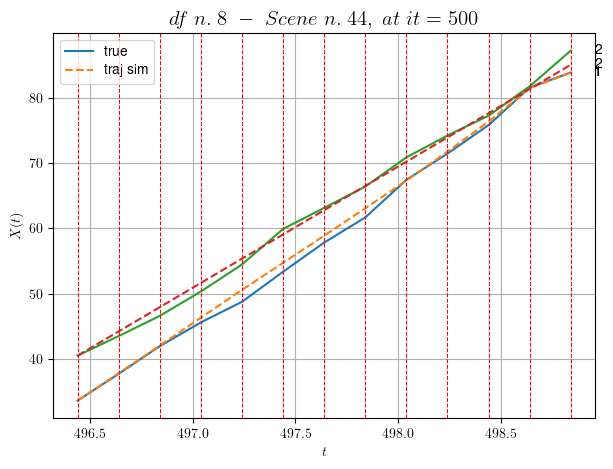

        For scene 44/79
        * use LR_NN=0.001 with err=128.0081361402607 at it=24
        * v0_scn_mean = 19.00495826272766
        * MAE = 0.7777030959275941



df n.8, scene n.45/79
    We have 7 time intervals inside [503.04,504.44]
            - Time interval n.0: [503.04, 503.24]
                * y_true: [20.36074323]
                * v_ann: [23.430288314819336, 19.009581413848082]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [503.24, 503.44]
                * y_true: [14.7806219]
                * v_ann: [21.94587516784668, 19.009581413848082]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [503.44, 503.64]
                * y_true: [20.79103351]
                * v_ann: [20.5195369720459, 19.009581413848082]

-------------------------------------------------------------------------------------------

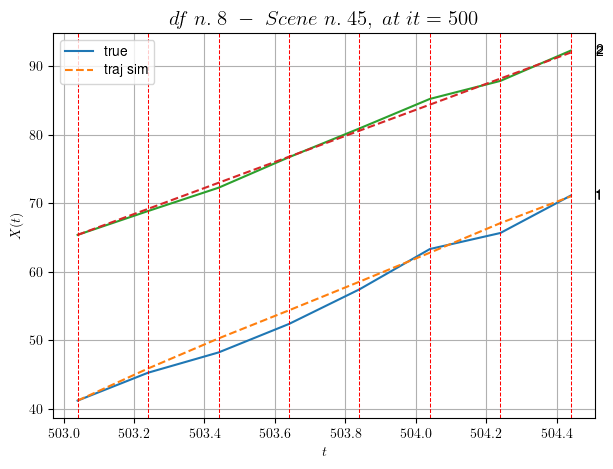

        For scene 45/79
        * use LR_NN=0.0005 with err=42.08195721956883 at it=24
        * v0_scn_mean = 19.44919815721
        * MAE = 0.7132884368783388



df n.8, scene n.46/79
    We have 4 time intervals inside [516.64,517.44]
            - Time interval n.0: [516.64, 516.84]
                * y_true: [18.26096698]
                * v_ann: [20.612457275390625, 23.019463891833595]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [516.84, 517.04]
                * y_true: [20.81127229]
                * v_ann: [21.630006790161133, 23.019463891833595]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [517.04, 517.24]
                * y_true: [22.54159044]
                * v_ann: [19.020294189453125, 23.019463891833595]

-----------------------------------------------------------------------------------------

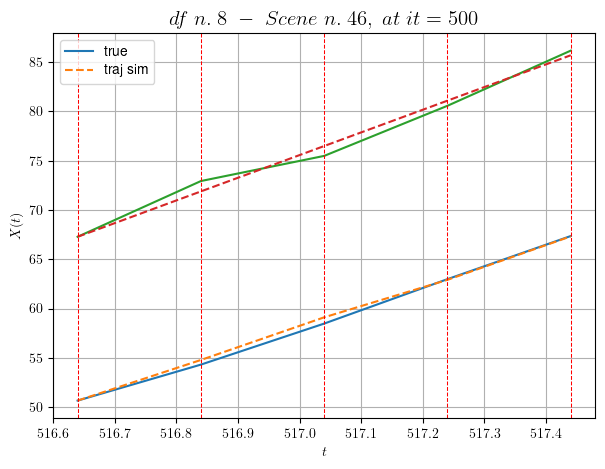

        For scene 46/79
        * use LR_NN=0.001 with err=6.326569416542325 at it=24
        * v0_scn_mean = 23.298685336107813
        * MAE = 0.2977834206801573



df n.8, scene n.47/79
    We have 6 time intervals inside [519.24,520.44]
            - Time interval n.0: [519.24, 519.44]
                * y_true: [9.41391239]
                * v_ann: [9.326798439025879, 21.673608825679928]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [519.44, 519.64]
                * y_true: [9.38810376]
                * v_ann: [10.211039543151855, 21.673608825679928]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [519.64, 519.84]
                * y_true: [9.38810376]
                * v_ann: [8.603878021240234, 21.673608825679928]

-------------------------------------------------------------------------------------------

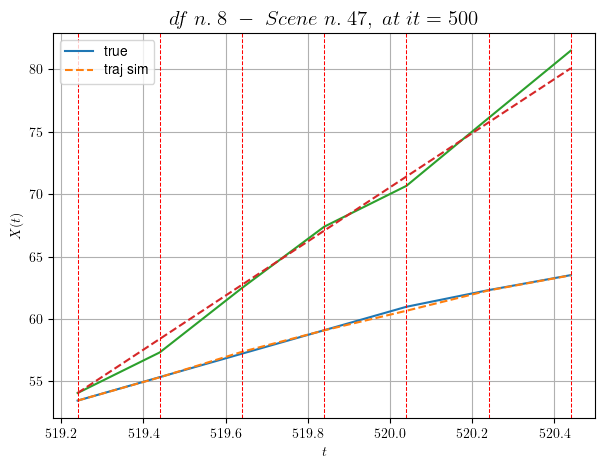

        For scene 47/79
        * use LR_NN=0.005 with err=17.189544546448474 at it=24
        * v0_scn_mean = 22.006664472584326
        * MAE = 0.29626952207242313



df n.8, scene n.48/79
    We have 7 time intervals inside [521.04,522.44]
            - Time interval n.0: [521.04, 521.24]
                * y_true: [17.76052146]
                * v_ann: [27.102622985839844, 9.8560079838447]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [521.24, 521.44]
                * y_true: [21.0507393]
                * v_ann: [21.709508895874023, 9.8560079838447]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [521.44, 521.64]
                * y_true: [20.2108584]
                * v_ann: [19.984289169311523, 9.8560079838447]

-----------------------------------------------------------------------------------------------

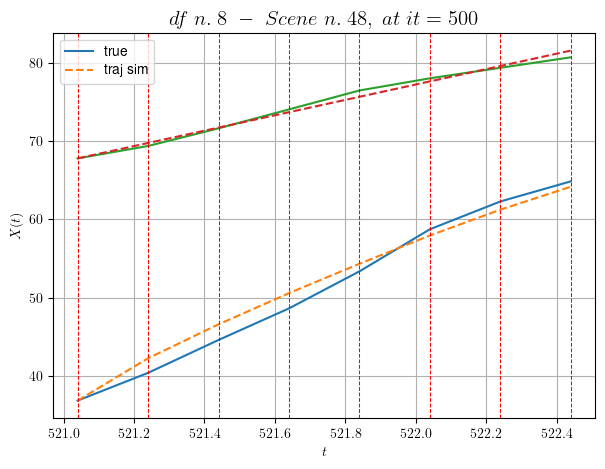

        For scene 48/79
        * use LR_NN=0.0005 with err=143.5851932286343 at it=24
        * v0_scn_mean = 10.661767664337257
        * MAE = 0.8811450333542468



df n.8, scene n.49/79
    We have 9 time intervals inside [529.04,530.84]
            - Time interval n.0: [529.04, 529.24]
                * y_true: [6.80006618]
                * v_ann: [5.372684955596924, 23.147710514458527]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [529.24, 529.44]
                * y_true: [7.54008988]
                * v_ann: [6.694938659667969, 23.147710514458527]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [529.44, 529.64]
                * y_true: [7.7250958]
                * v_ann: [7.634392738342285, 23.147710514458527]

--------------------------------------------------------------------------------------------

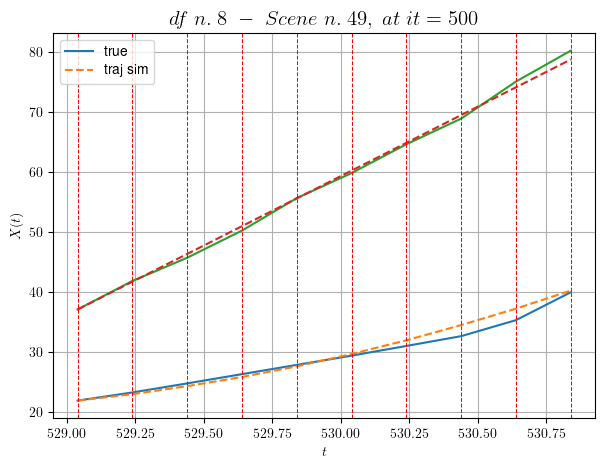

        For scene 49/79
        * use LR_NN=1e-05 with err=26.10050761805579 at it=24
        * v0_scn_mean = 23.42180209382778
        * MAE = 0.6648789916972315



df n.8, scene n.50/79
    We have 5 time intervals inside [531.84,532.84]
            - Time interval n.0: [531.84, 532.04]
                * y_true: [10.82542785]
                * v_ann: [11.209224700927734, 23.472410774644512]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [532.04, 532.24]
                * y_true: [7.02530718]
                * v_ann: [11.662519454956055, 23.472410774644512]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.24, 532.44]
                * y_true: [8.3145217]
                * v_ann: [14.306798934936523, 23.472410774644512]

------------------------------------------------------------------------------------------

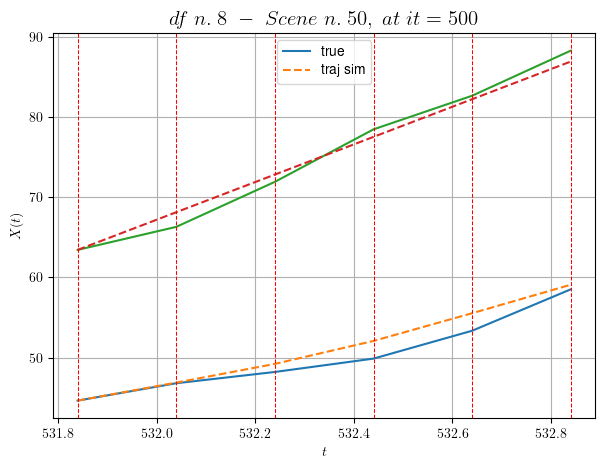

        For scene 50/79
        * use LR_NN=5e-05 with err=7.79830249355368 at it=24
        * v0_scn_mean = 23.733514343609496
        * MAE = 1.4951338541716763



df n.8, scene n.51/79
    We have 3 time intervals inside [536.64,537.24]
            - Time interval n.0: [536.64, 536.84]
                * y_true: [10.77027677]
                * v_ann: [12.287590980529785, 15.683354883417405]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [536.84, 537.04]
                * y_true: [10.91031236]
                * v_ann: [12.717368125915527, 15.683354883417405]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [537.04, 537.24]
                * y_true: [16.15053495]
                * v_ann: [12.931617736816406, 15.683354883417405]

---------------------------------------------------------------------------------------

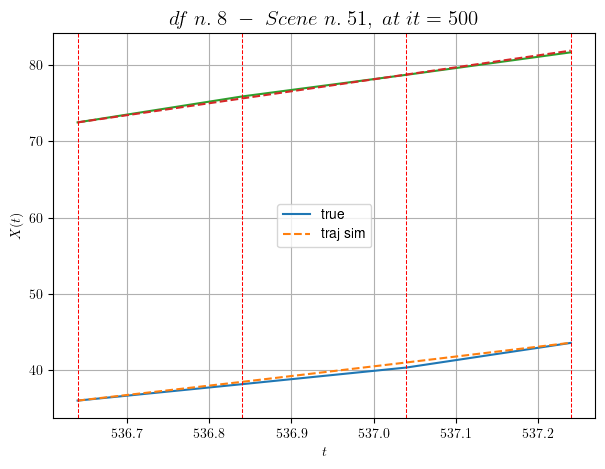

        For scene 51/79
        * use LR_NN=1e-05 with err=14.758192875665335 at it=24
        * v0_scn_mean = 16.25602068797075
        * MAE = 0.08177781506875186



df n.8, scene n.52/79
    We have 2 time intervals inside [545.44,545.84]
    * err= 0.0008263756933680959
    * Learning rate NN = 8.999999408842996e-05
    * diff = 8.898838084329171e-08


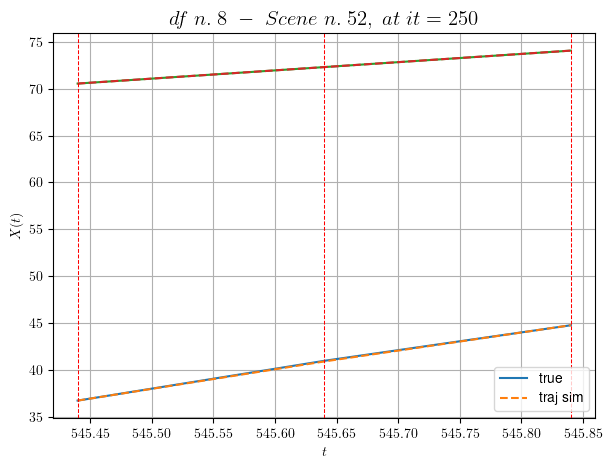

        For scene 52/79
        * use LR_NN=0.0001 with err=14.98151180170559 at it=24
        * v0_scn_mean = 10.496813362264408
        * MAE = 0.0008263674859474373



df n.8, scene n.53/79
    We have 7 time intervals inside [548.04,549.44]
            - Time interval n.0: [548.04, 548.24]
                * y_true: [10.09033294]
                * v_ann: [11.816665649414062, 22.284223357283732]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [548.24, 548.44]
                * y_true: [13.93051874]
                * v_ann: [11.293033599853516, 22.284223357283732]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [548.44, 548.64]
                * y_true: [16.31069106]
                * v_ann: [12.28287124633789, 22.284223357283732]

-----------------------------------------------------------------------------------

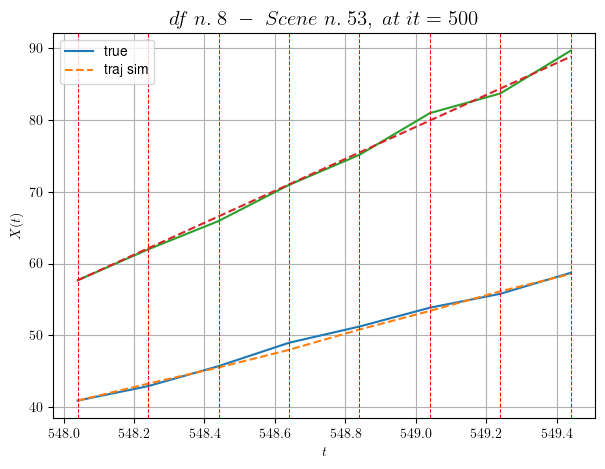

        For scene 53/79
        * use LR_NN=0.001 with err=20.442423716647234 at it=24
        * v0_scn_mean = 22.592854422931683
        * MAE = 0.2771466177757132



df n.8, scene n.54/79
    We have 4 time intervals inside [574.24,575.04]
            - Time interval n.0: [574.24, 574.44]
                * y_true: [18.8213558]
                * v_ann: [24.200590133666992, 19.077749443552676]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [574.44, 574.64]
                * y_true: [30.87266665]
                * v_ann: [23.15535545349121, 19.077749443552676]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [574.64, 574.84]
                * y_true: [28.81373524]
                * v_ann: [23.212196350097656, 19.077749443552676]

---------------------------------------------------------------------------------------

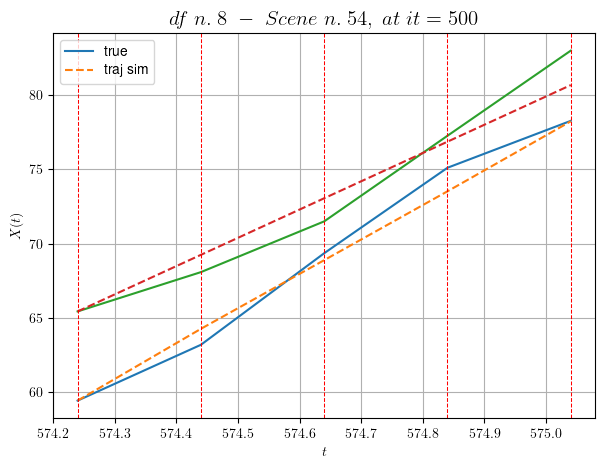

        For scene 54/79
        * use LR_NN=0.0005 with err=14.282819779395261 at it=24
        * v0_scn_mean = 19.51463946572608
        * MAE = 1.2529280978384798



df n.8, scene n.55/79
    We have 3 time intervals inside [584.64,585.24]
            - Time interval n.0: [584.64, 584.84]
                * y_true: [24.36091679]
                * v_ann: [28.196735382080078, 18.808680134805034]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [584.84, 585.04]
                * y_true: [28.1513048]
                * v_ann: [27.745731353759766, 18.808680134805034]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [585.04, 585.24]
                * y_true: [31.25183435]
                * v_ann: [27.393465042114258, 18.808680134805034]

--------------------------------------------------------------------------------------

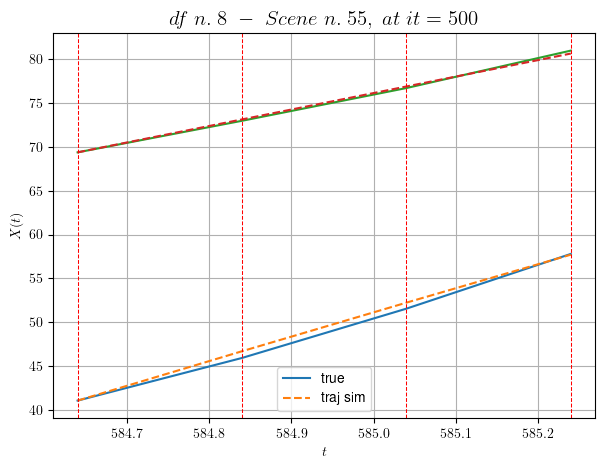

        For scene 55/79
        * use LR_NN=1e-05 with err=8.749070870444074 at it=24
        * v0_scn_mean = 19.25633292932748
        * MAE = 0.1537961586900155



df n.8, scene n.56/79
    We have 2 time intervals inside [587.44,587.84]
            - Time interval n.0: [587.44, 587.64]
                * y_true: [23.77240101]
                * v_ann: [23.25481605529785, 30.037171265454383]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [587.64, 587.84]
                * y_true: [21.65253003]
                * v_ann: [22.09463882446289, 30.037171265454383]

----------------------------------------------------------------------------------------------------
    * err= 0.004726069792443852
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.0003387563175519361


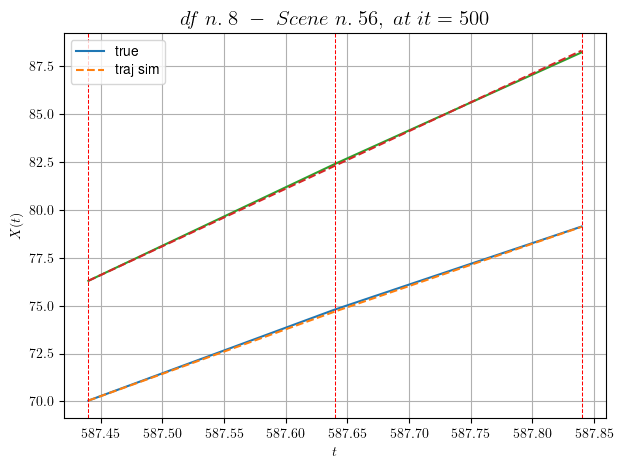

        For scene 56/79
        * use LR_NN=0.0005 with err=0.10996885663070341 at it=24
        * v0_scn_mean = 30.03568441482847
        * MAE = 0.004726069792443852



df n.8, scene n.57/79
    We have 8 time intervals inside [592.84,594.44]
            - Time interval n.0: [592.84, 593.04]
                * y_true: [18.30050522]
                * v_ann: [21.34993553161621, 20.354057423513904]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [593.04, 593.24]
                * y_true: [18.46062677]
                * v_ann: [20.453296661376953, 20.354057423513904]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [593.24, 593.44]
                * y_true: [23.16095213]
                * v_ann: [20.420583724975586, 20.354057423513904]

-----------------------------------------------------------------------------------

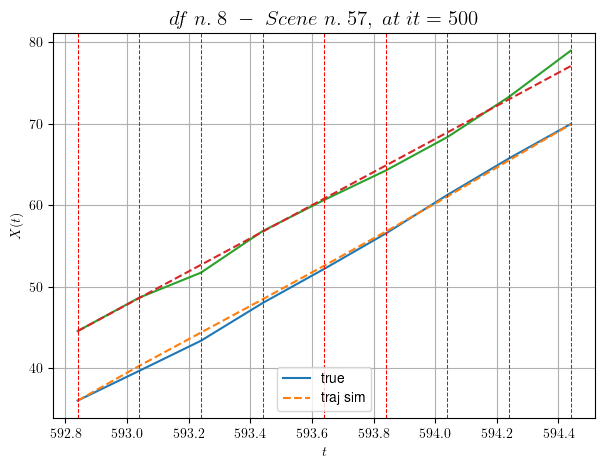

        For scene 57/79
        * use LR_NN=0.001 with err=40.99723442302253 at it=24
        * v0_scn_mean = 20.739895126499388
        * MAE = 0.3539299027756956



df n.8, scene n.58/79
    We have 3 time intervals inside [36.44,37.04]
            - Time interval n.0: [36.44, 36.64]
                * y_true: [16.4303266   8.20020738]
                * v_ann: [12.241447448730469, 11.495317459106445, 17.156795934620806]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [36.64, 36.84]
                * y_true: [18.55044671  6.80018642]
                * v_ann: [12.450620651245117, 12.437301635742188, 17.156795934620806]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [36.84, 37.04]
                * y_true: [12.9262384  10.75446129]
                * v_ann: [12.15846061706543, 12.805828094482422, 17.156795934620806]


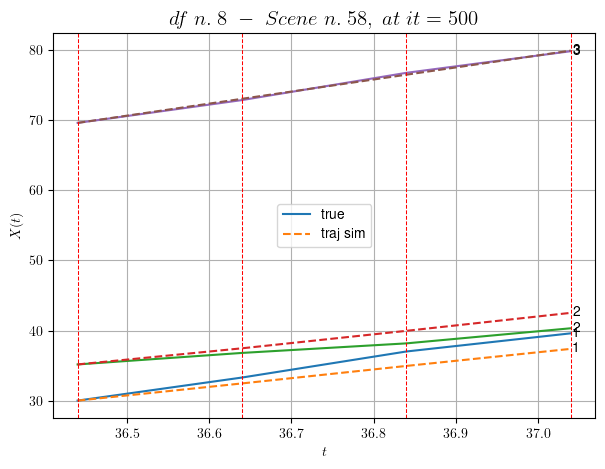

        For scene 58/79
        * use LR_NN=0.001 with err=12.545136154205018 at it=24
        * v0_scn_mean = 17.927387601911498
        * MAE = 1.5324857786603212



df n.8, scene n.59/79
    We have 4 time intervals inside [50.24,51.04]
            - Time interval n.0: [50.24, 50.44]
                * y_true: [14.83043604 14.50055453]
                * v_ann: [18.248706817626953, 21.442602157592773, 30.15766097411086]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [50.44, 50.64]
                * y_true: [15.35052738 17.38080918]
                * v_ann: [17.212446212768555, 18.165714263916016, 30.15766097411086]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [50.64, 50.84]
                * y_true: [19.54078826 19.30097894]
                * v_ann: [16.956987380981445, 17.286827087402344, 30.15766097411086]



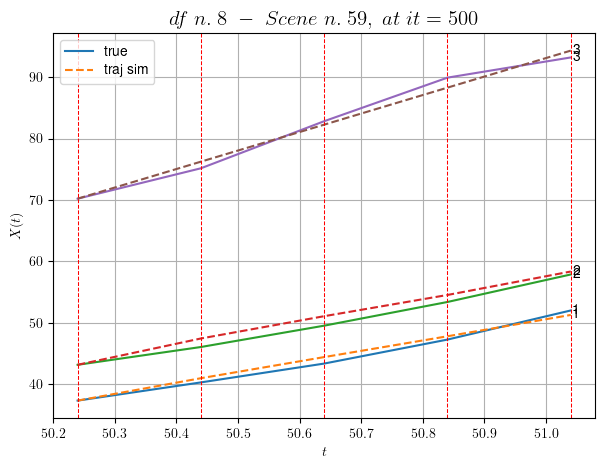

        For scene 59/79
        * use LR_NN=0.0005 with err=11.889654879480355 at it=24
        * v0_scn_mean = 30.14820132274279
        * MAE = 0.8264918108473175



df n.8, scene n.60/79
    We have 4 time intervals inside [102.24,103.04]
            - Time interval n.0: [102.24, 102.44]
                * y_true: [22.78095819 15.94092959]
                * v_ann: [20.741931915283203, 20.97298812866211, 31.34829198332158]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [102.44, 102.64]
                * y_true: [23.36120187 12.10080168]
                * v_ann: [20.039188385009766, 20.757081985473633, 31.34829198332158]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [102.64, 102.84]
                * y_true: [20.51121756 22.37162153]
                * v_ann: [19.020294189453125, 19.075084686279297, 31.3482919833

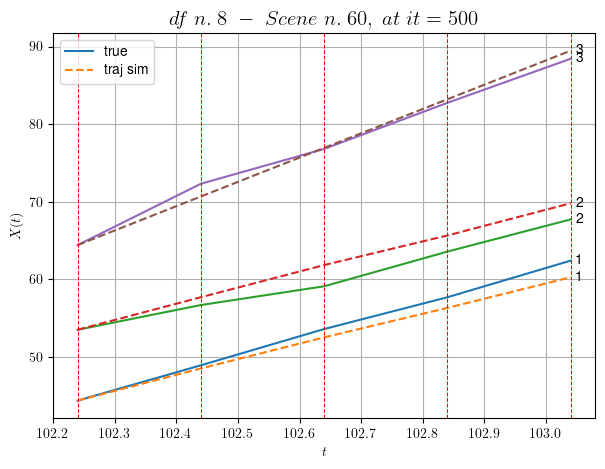

        For scene 60/79
        * use LR_NN=0.001 with err=11.319459928845603 at it=24
        * v0_scn_mean = 31.26739452485779
        * MAE = 1.845668456428627



df n.8, scene n.61/79
    We have 3 time intervals inside [108.84,109.44]
            - Time interval n.0: [108.84, 109.04]
                * y_true: [17.9810803  26.65193678]
                * v_ann: [20.6812744140625, 20.594690322875977, 20.549015112613265]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.04, 109.24]
                * y_true: [14.30252156 22.9019425 ]
                * v_ann: [21.229839324951172, 21.540929794311523, 20.549015112613265]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.24, 109.44]
                * y_true: [21.24158827 21.25204953]
                * v_ann: [20.155942916870117, 19.95627784729004, 20.549015112613

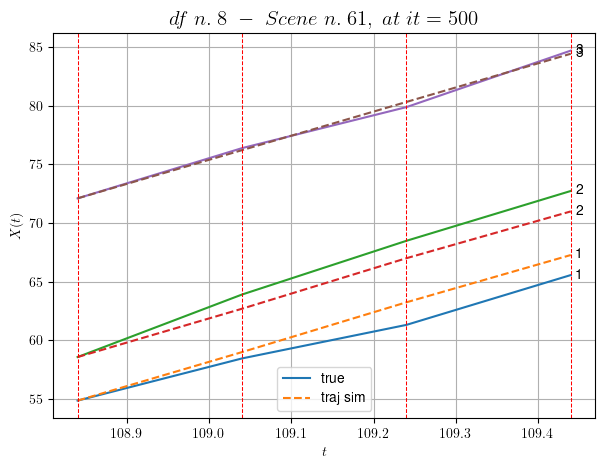

        For scene 61/79
        * use LR_NN=0.001 with err=5.990068538964277 at it=24
        * v0_scn_mean = 21.116073781527607
        * MAE = 1.126843330657508



df n.8, scene n.62/79
    We have 2 time intervals inside [130.04,130.44]
            - Time interval n.0: [130.04, 130.24]
                * y_true: [23.9806113  21.72216875]
                * v_ann: [24.264232635498047, 23.638320922851562, 41.055622304852065]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [130.24, 130.44]
                * y_true: [20.38064152 27.22317612]
                * v_ann: [22.501129150390625, 22.78209686279297, 41.055622304852065]

----------------------------------------------------------------------------------------------------
    * err= 0.07790620355082505
    * Learning rate NN = 0.00036449998151510954
    * diff = 1.8254535728512433e-05


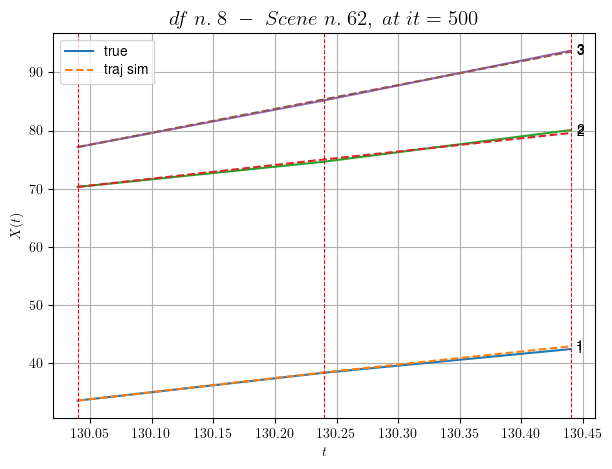

        For scene 62/79
        * use LR_NN=0.0005 with err=9.348358744453995 at it=24
        * v0_scn_mean = 40.39228546293464
        * MAE = 0.0775834380134318



df n.8, scene n.63/79
    We have 5 time intervals inside [215.24,216.24]
            - Time interval n.0: [215.24, 215.44]
                * y_true: [ 1.34614625 10.42531549]
                * v_ann: [17.663150787353516, 19.179658889770508, 15.100689610550242]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.44, 215.64]
                * y_true: [18.28906766 10.32533879]
                * v_ann: [14.216703414916992, 14.737021446228027, 15.100689610550242]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.64, 215.84]
                * y_true: [29.02100933 15.78058213]
                * v_ann: [16.31635856628418, 14.96120548248291, 15.1006896105

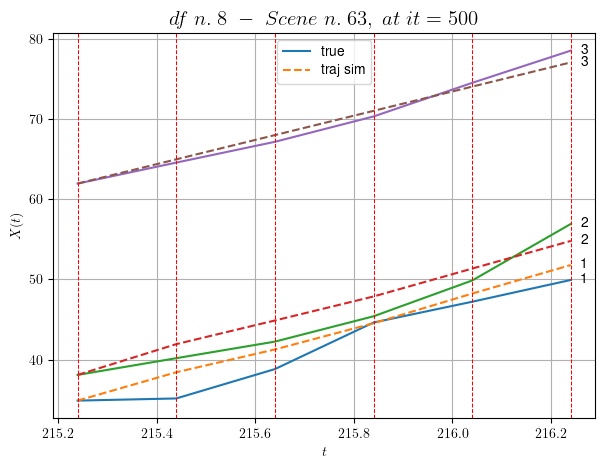

        For scene 63/79
        * use LR_NN=0.001 with err=39.64853015018104 at it=24
        * v0_scn_mean = 15.994647564970462
        * MAE = 2.6229499990085334



df n.8, scene n.64/79
    We have 4 time intervals inside [222.64,223.44]
            - Time interval n.0: [222.64, 222.84]
                * y_true: [3.4148313  7.54419185]
                * v_ann: [3.3749287128448486, 5.44924259185791, 12.428538122911212]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [222.84, 223.04]
                * y_true: [1.34614625 9.61287691]
                * v_ann: [8.033856391906738, 5.596152305603027, 12.428538122911212]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.04, 223.24]
                * y_true: [ 1.34614625 10.20300693]
                * v_ann: [6.644785404205322, 5.736464500427246, 12.428538122911212]



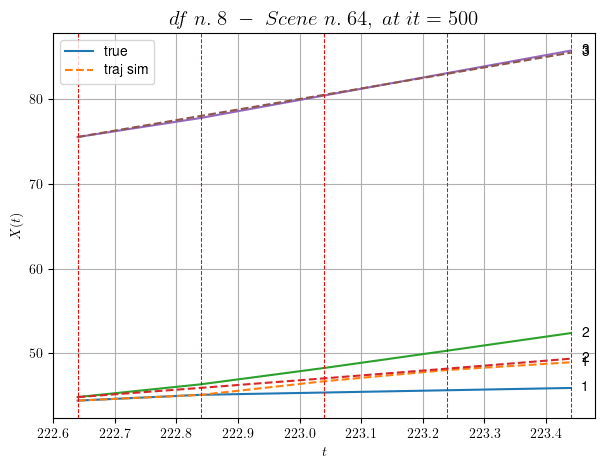

        For scene 64/79
        * use LR_NN=0.0001 with err=25.18381713947493 at it=24
        * v0_scn_mean = 13.48282504661597
        * MAE = 2.1325476860881074



df n.8, scene n.65/79
    We have 5 time intervals inside [225.24,226.24]
            - Time interval n.0: [225.24, 225.44]
                * y_true: [9.85023046 1.34614625]
                * v_ann: [5.434785842895508, 7.447329998016357, 13.143683398703338]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.44, 225.64]
                * y_true: [11.30531094  1.34614625]
                * v_ann: [5.941458702087402, 8.120489120483398, 13.143683398703338]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.64, 225.84]
                * y_true: [12.27536459  1.34614625]
                * v_ann: [7.11215353012085, 8.674694061279297, 13.143683398703338]


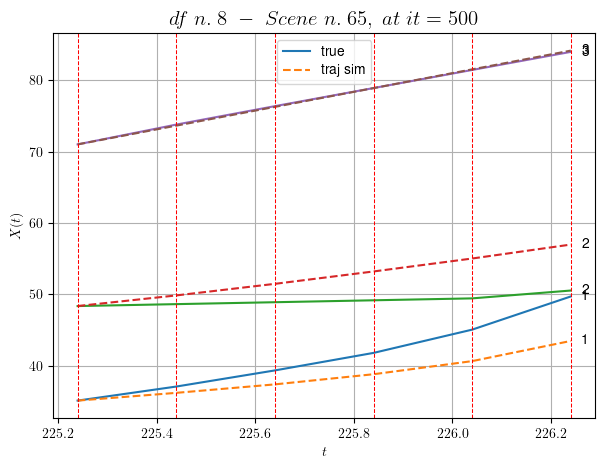

        For scene 65/79
        * use LR_NN=0.001 with err=49.8677326166655 at it=24
        * v0_scn_mean = 14.155061637969057
        * MAE = 9.386288995838987



df n.8, scene n.66/79
    We have 4 time intervals inside [227.04,227.84]
            - Time interval n.0: [227.04, 227.24]
                * y_true: [ 1.34614625 11.86069537]
                * v_ann: [7.072189807891846, 7.183991432189941, 26.24315546538644]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [227.24, 227.44]
                * y_true: [ 1.34614625 11.90074479]
                * v_ann: [7.122670650482178, 7.216261863708496, 26.24315546538644]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [227.44, 227.64]
                * y_true: [ 1.34614625 14.03099458]
                * v_ann: [7.045731067657471, 7.767498016357422, 26.24315546538644]

-

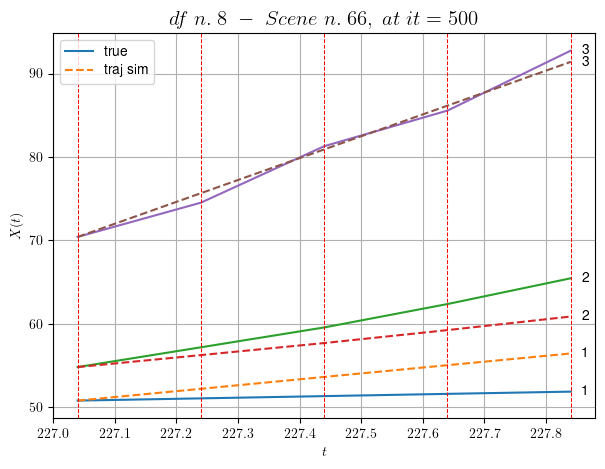

        For scene 66/79
        * use LR_NN=0.0005 with err=2.888404910187218 at it=24
        * v0_scn_mean = 26.468565968789253
        * MAE = 5.196927823647042



df n.8, scene n.67/79
    We have 2 time intervals inside [237.64,238.04]
            - Time interval n.0: [237.64, 237.84]
                * y_true: [17.80043487 10.22573725]
                * v_ann: [16.615747451782227, 10.81262493133545, 29.702967492374864]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.84, 238.04]
                * y_true: [20.29063338 11.60088234]
                * v_ann: [16.097251892089844, 11.954824447631836, 29.702967492374864]

----------------------------------------------------------------------------------------------------
    * err= 0.1644620834864939
    * Learning rate NN = 7.289998848136747e-06
    * diff = 0.003277497176114169


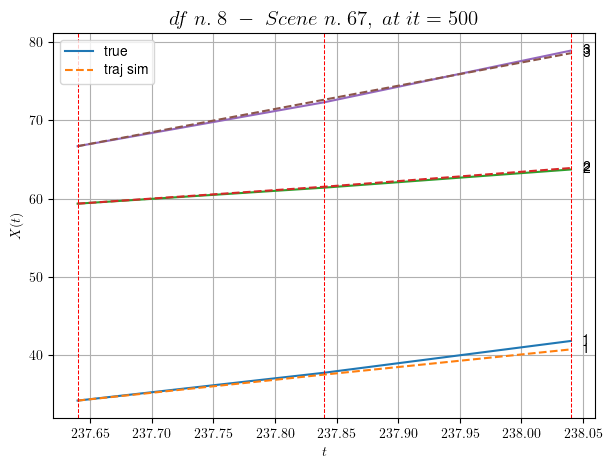

        For scene 67/79
        * use LR_NN=1e-05 with err=0.2094205331237511 at it=24
        * v0_scn_mean = 29.72078942949624
        * MAE = 0.14800536573226944



df n.8, scene n.68/79
    We have 2 time intervals inside [239.84,240.24]
            - Time interval n.0: [239.84, 240.04]
                * y_true: [16.30079237 13.85576065]
                * v_ann: [15.659080505371094, 15.501289367675781, 30.131239538599125]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [240.04, 240.24]
                * y_true: [17.06097057 17.27611431]
                * v_ann: [16.56712532043457, 16.77263641357422, 30.131239538599125]

----------------------------------------------------------------------------------------------------
    * err= 0.03668226496777934
    * Learning rate NN = 0.0007289999630302191
    * diff = 9.632905929038427e-05


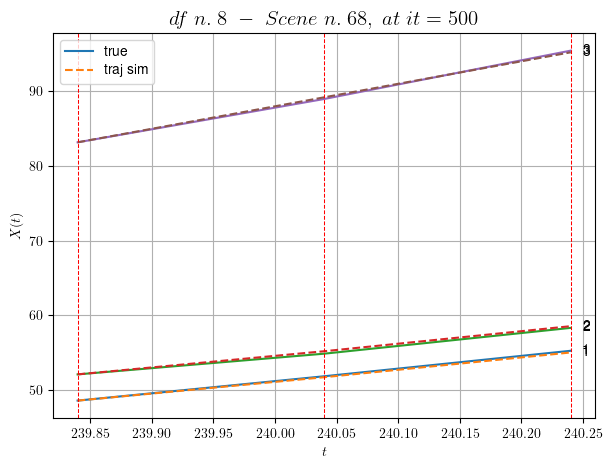

        For scene 68/79
        * use LR_NN=0.001 with err=4.115666282522034 at it=24
        * v0_scn_mean = 30.12336517217561
        * MAE = 0.03639327566220162



df n.8, scene n.69/79
    We have 4 time intervals inside [243.44,244.24]
            - Time interval n.0: [243.44, 243.64]
                * y_true: [18.26109982  7.28715228]
                * v_ann: [13.63704776763916, 13.10570240020752, 16.742914270051056]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [243.64, 243.84]
                * y_true: [23.05153691  9.06731774]
                * v_ann: [14.078768730163574, 12.879249572753906, 16.742914270051056]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [243.84, 244.04]
                * y_true: [10.52334632 16.05532609]
                * v_ann: [12.900041580200195, 14.69371223449707, 16.74291427005

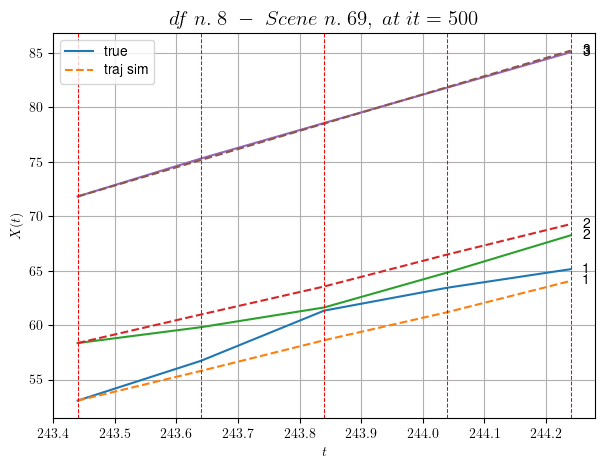

        For scene 69/79
        * use LR_NN=0.001 with err=26.30051183205985 at it=24
        * v0_scn_mean = 17.53833881863344
        * MAE = 1.543494170950216



df n.8, scene n.70/79
    We have 5 time intervals inside [251.64,252.64]
            - Time interval n.0: [251.64, 251.84]
                * y_true: [14.32016282 17.2315068 ]
                * v_ann: [16.609769821166992, 18.525461196899414, 19.82490608802429]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [251.84, 252.04]
                * y_true: [20.34029568 17.65159646]
                * v_ann: [16.576749801635742, 18.183073043823242, 19.82490608802429]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [252.04, 252.24]
                * y_true: [20.93040622 16.61174803]
                * v_ann: [17.046701431274414, 17.110414505004883, 19.824906088024

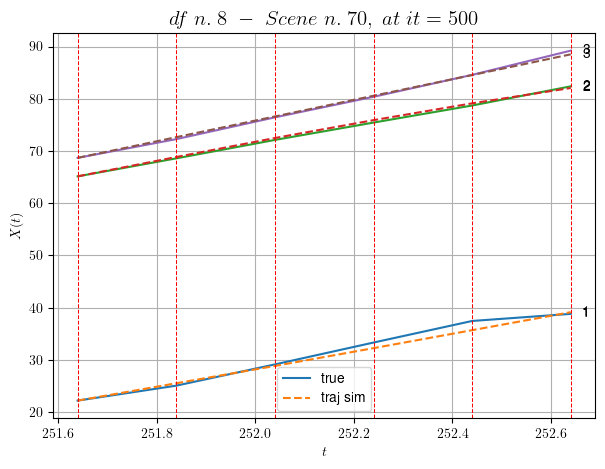

        For scene 70/79
        * use LR_NN=0.0005 with err=24.66004397032414 at it=24
        * v0_scn_mean = 20.435411265903163
        * MAE = 0.3296414503592884



df n.8, scene n.71/79
    We have 3 time intervals inside [290.84,291.44]
            - Time interval n.0: [290.84, 291.04]
                * y_true: [10.67508652 21.71084933]
                * v_ann: [15.821359634399414, 15.755277633666992, 25.378244279773952]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [291.04, 291.24]
                * y_true: [ 9.47510968 18.71084105]
                * v_ann: [15.675772666931152, 15.9072904586792, 25.378244279773952]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [291.24, 291.44]
                * y_true: [ 9.47510968 24.76138307]
                * v_ann: [15.222871780395508, 16.369199752807617, 25.378244279

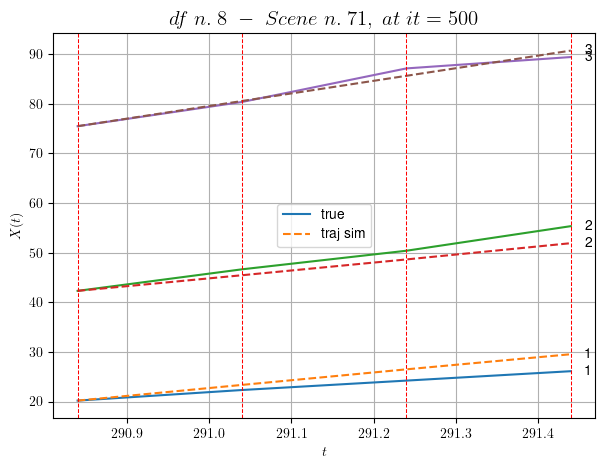

        For scene 71/79
        * use LR_NN=5e-05 with err=2.3834308876729438 at it=24
        * v0_scn_mean = 25.655549415481346
        * MAE = 1.1279305512008981



df n.8, scene n.72/79
    We have 5 time intervals inside [350.64,351.64]
            - Time interval n.0: [350.64, 350.84]
                * y_true: [14.24956692  9.34769854]
                * v_ann: [13.66020393371582, 14.826830863952637, 24.017556031657953]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [350.84, 351.04]
                * y_true: [ 4.06677119 24.77080184]
                * v_ann: [13.110651016235352, 16.146106719970703, 24.017556031657953]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [351.04, 351.24]
                * y_true: [15.46321179 18.97073364]
                * v_ann: [17.367801666259766, 14.831819534301758, 24.01755603

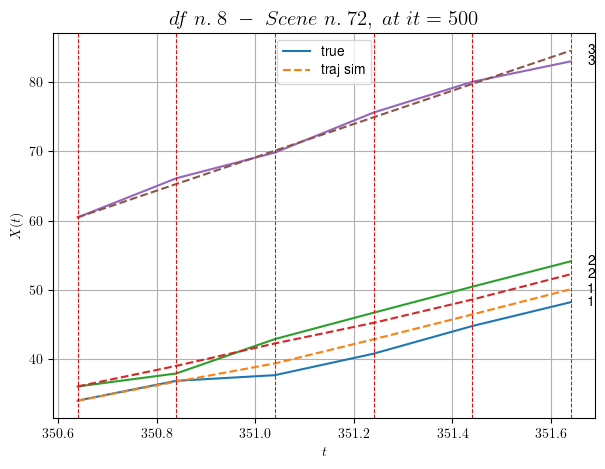

        For scene 72/79
        * use LR_NN=0.001 with err=10.316217114419304 at it=24
        * v0_scn_mean = 24.376502401159836
        * MAE = 1.5322817988637283



df n.8, scene n.73/79
    We have 3 time intervals inside [368.84,369.44]
            - Time interval n.0: [368.84, 369.04]
                * y_true: [17.45059381  8.87536169]
                * v_ann: [13.782978057861328, 12.056540489196777, 17.012012000820373]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.04, 369.24]
                * y_true: [23.11801305  8.05829994]
                * v_ann: [14.678169250488281, 13.049481391906738, 17.012012000820373]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.24, 369.44]
                * y_true: [ 6.12528304 15.69072344]
                * v_ann: [11.177237510681152, 14.244029998779297, 17.0120120

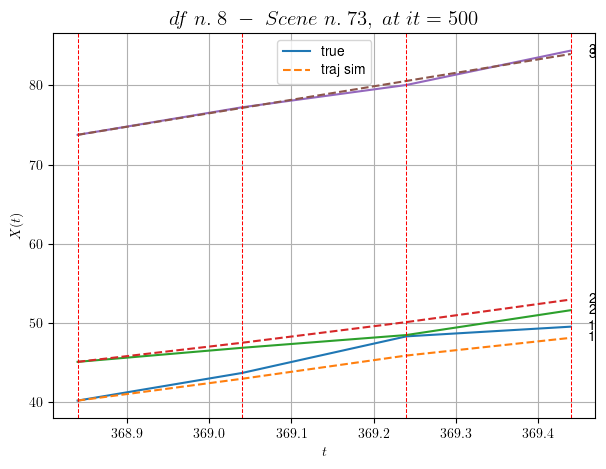

        For scene 73/79
        * use LR_NN=0.0005 with err=16.950608711068185 at it=24
        * v0_scn_mean = 17.791290697638345
        * MAE = 1.112124801945855



df n.8, scene n.74/79
    We have 2 time intervals inside [414.44,414.84]
            - Time interval n.0: [414.44, 414.64]
                * y_true: [25.58017481 23.93124381]
                * v_ann: [23.040390014648438, 20.549198150634766, 14.740228637605556]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [414.64, 414.84]
                * y_true: [28.7103211   9.12051681]
                * v_ann: [23.42136001586914, 20.026416778564453, 14.740228637605556]

----------------------------------------------------------------------------------------------------
    * err= 0.6341436059852562
    * Learning rate NN = 7.289998757187277e-05
    * diff = 1.7832650164306685e-05


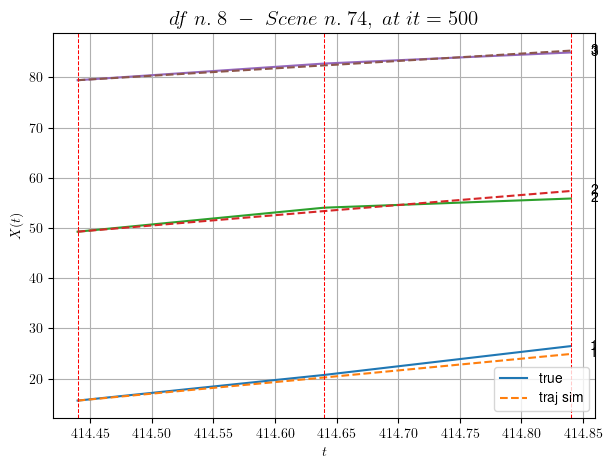

        For scene 74/79
        * use LR_NN=0.0001 with err=6.090812343976069 at it=24
        * v0_scn_mean = 15.655814234218601
        * MAE = 0.6321276911927597



df n.8, scene n.75/79
    We have 5 time intervals inside [477.84,478.84]
            - Time interval n.0: [477.84, 478.04]
                * y_true: [17.90015387 15.74042221]
                * v_ann: [18.632740020751953, 18.130542755126953, 21.268159302177217]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [478.04, 478.24]
                * y_true: [18.02021575 17.32056356]
                * v_ann: [18.528629302978516, 18.370494842529297, 21.268159302177217]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [478.24, 478.44]
                * y_true: [20.95033635 22.3908747 ]
                * v_ann: [18.462154388427734, 18.341285705566406, 21.2681593

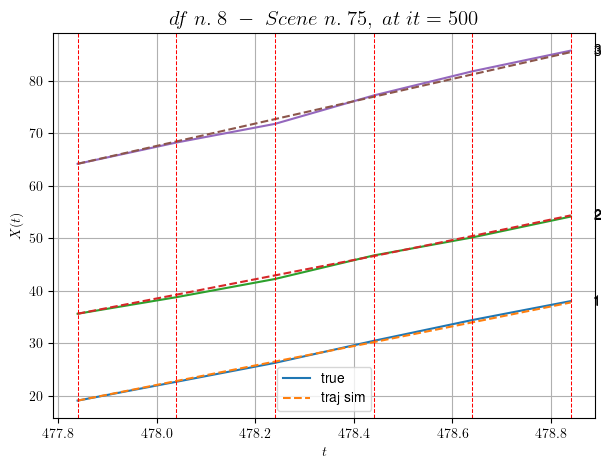

        For scene 75/79
        * use LR_NN=0.0001 with err=16.65932677638401 at it=24
        * v0_scn_mean = 21.79206935200585
        * MAE = 0.14433150196185465



df n.8, scene n.76/79
    We have 2 time intervals inside [522.64,523.04]
            - Time interval n.0: [522.64, 522.84]
                * y_true: [ 6.78505349 16.71042372]
                * v_ann: [14.63061809539795, 13.433847427368164, 25.155972882594618]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [522.84, 523.04]
                * y_true: [ 7.85007105 23.28071684]
                * v_ann: [12.826994895935059, 14.053289413452148, 25.155972882594618]

----------------------------------------------------------------------------------------------------
    * err= 1.7996943135904342
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.00022565232414950565


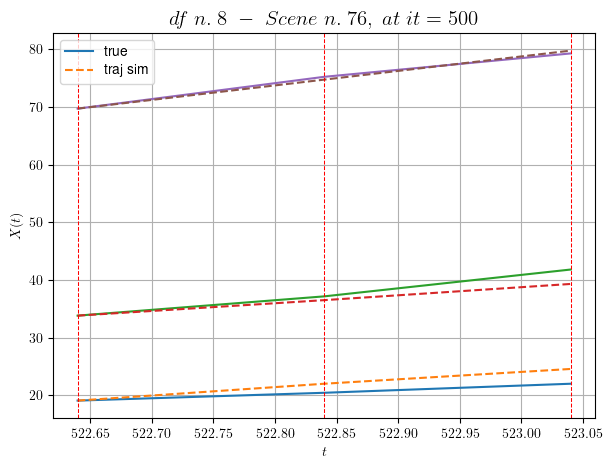

        For scene 76/79
        * use LR_NN=0.0001 with err=0.8736877082662536 at it=24
        * v0_scn_mean = 25.446614292152642
        * MAE = 1.7329740844371078



df n.8, scene n.77/79
    We have 7 time intervals inside [593.04,594.44]
            - Time interval n.0: [593.04, 593.24]
                * y_true: [18.14041096 18.46062677]
                * v_ann: [18.889612197875977, 19.304838180541992, 20.297836048725543]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [593.24, 593.44]
                * y_true: [15.67042287 23.16095213]
                * v_ann: [18.750137329101562, 18.969287872314453, 20.297836048725543]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [593.44, 593.64]
                * y_true: [13.25043489 21.00101152]
                * v_ann: [19.244813919067383, 19.20276641845703, 20.2978360

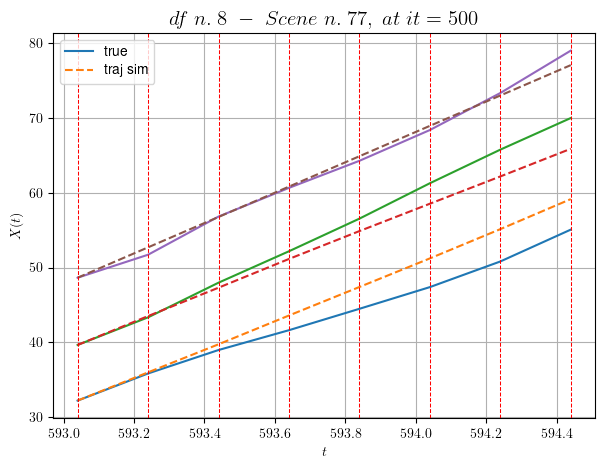

        For scene 77/79
        * use LR_NN=0.001 with err=29.48325158751628 at it=24
        * v0_scn_mean = 20.879965450195783
        * MAE = 4.472013085553343



df n.8, scene n.78/79
    We have 4 time intervals inside [256.44,257.24]
            - Time interval n.0: [256.44, 256.64]
                * y_true: [ 7.48303167 10.07767618 21.73093279]
                * v_ann: [11.810297966003418, 14.282853126525879, 16.47940444946289, 17.104258674666195]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [256.64, 256.84]
                * y_true: [13.09283525 13.17831107 21.42106847]
                * v_ann: [16.149858474731445, 16.0621280670166, 14.545465469360352, 17.104258674666195]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [256.84, 257.04]
                * y_true: [11.5255681  16.82586504 17.99104223]
     

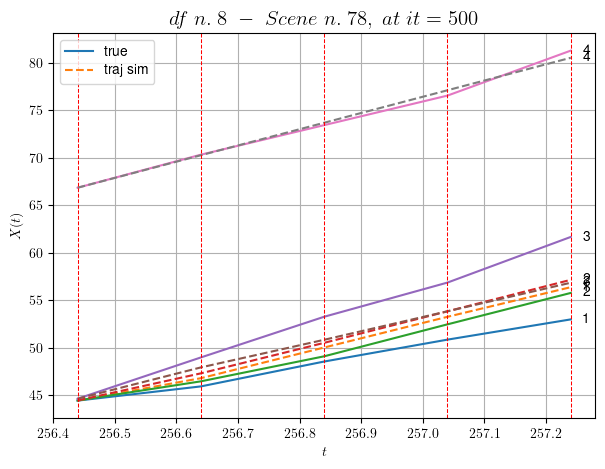

        For scene 78/79
        * use LR_NN=0.001 with err=12.177874272830346 at it=24
        * v0_scn_mean = 18.135876016246087
        * MAE = 3.2776342716452294



For df=8 with 79 scenes, time taken:        1805.04
****************************************************************************************************
****************************************************************************************************
In df n.9/10 we have 33 scenes
df n.9, scene n.0/33
    We have 5 time intervals inside [15.40,16.40]
            - Time interval n.0: [15.40, 15.60]
                * y_true: [30.73739248]
                * v_ann: [33.05859375, 28.3801854174506]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [15.60, 15.80]
                * y_true: [35.33215767]
                * v_ann: [31.89232635498047, 28.3801854174506]

-----------------------------------------------------------------------------

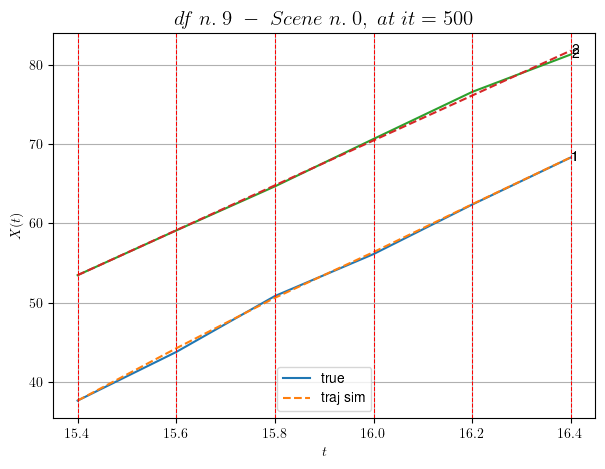

        For scene 0/33
        * use LR_NN=5e-05 with err=0.5690051726547702 at it=24
        * v0_scn_mean = 28.444978000740186
        * MAE = 0.06894884183950789



df n.9, scene n.1/33
    We have 2 time intervals inside [19.80,20.20]
            - Time interval n.0: [19.80, 20.00]
                * y_true: [33.54113565]
                * v_ann: [30.80579376220703, 39.64570602734413]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [20.00, 20.20]
                * y_true: [31.45149299]
                * v_ann: [33.965476989746094, 39.64570602734413]

----------------------------------------------------------------------------------------------------
    * err= 0.053599809674331124
    * Learning rate NN = 7.289998757187277e-05
    * diff = 3.523498373387418e-05


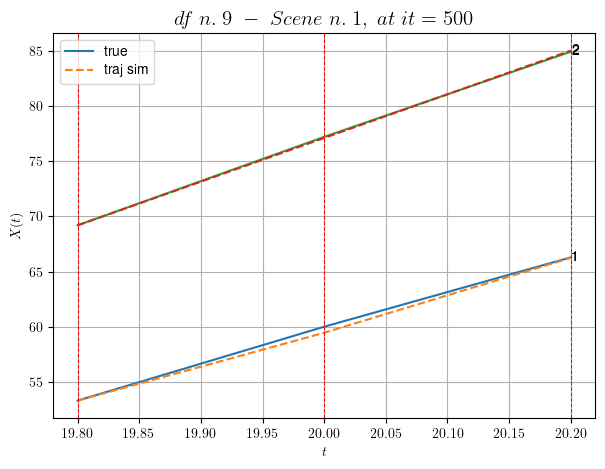

        For scene 1/33
        * use LR_NN=0.0001 with err=3.088235931983134 at it=24
        * v0_scn_mean = 39.25987778632405
        * MAE = 0.052740589699179455



df n.9, scene n.2/33
    We have 2 time intervals inside [30.80,31.20]
    * err= 0.022323779342406806
    * Learning rate NN = 8.999999408842996e-06
    * diff = 5.816567537168804e-07


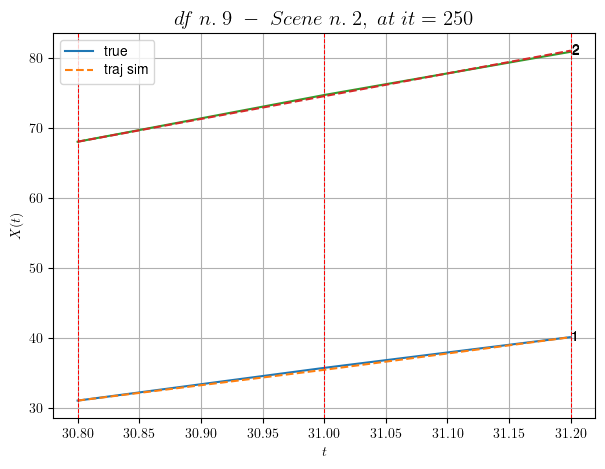

        For scene 2/33
        * use LR_NN=1e-05 with err=0.21155123850274576 at it=24
        * v0_scn_mean = 32.33304952646825
        * MAE = 0.021532607425090517



df n.9, scene n.3/33
    We have 5 time intervals inside [36.60,37.60]
            - Time interval n.0: [36.60, 36.80]
                * y_true: [22.87949769]
                * v_ann: [20.533262252807617, 29.981948107113574]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [36.80, 37.00]
                * y_true: [24.659198]
                * v_ann: [23.229074478149414, 29.981948107113574]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [37.00, 37.20]
                * y_true: [29.18472774]
                * v_ann: [27.596725463867188, 29.981948107113574]

-----------------------------------------------------------------------------------------------

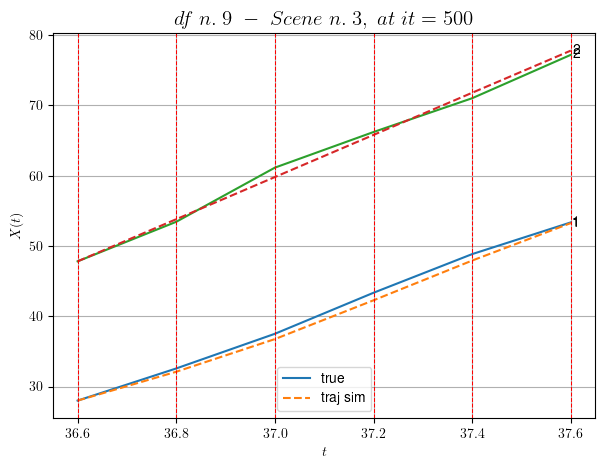

        For scene 3/33
        * use LR_NN=0.001 with err=0.31126480726633726 at it=24
        * v0_scn_mean = 29.982670182828926
        * MAE = 0.27380774539229263



df n.9, scene n.4/33
    We have 3 time intervals inside [51.40,52.00]
            - Time interval n.0: [51.40, 51.60]
                * y_true: [18.9890482]
                * v_ann: [15.007383346557617, 32.13226424153484]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [51.60, 51.80]
                * y_true: [18.95651223]
                * v_ann: [18.692934036254883, 32.13226424153484]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [51.80, 52.00]
                * y_true: [19.58186103]
                * v_ann: [21.73796272277832, 32.13226424153484]

--------------------------------------------------------------------------------------------------

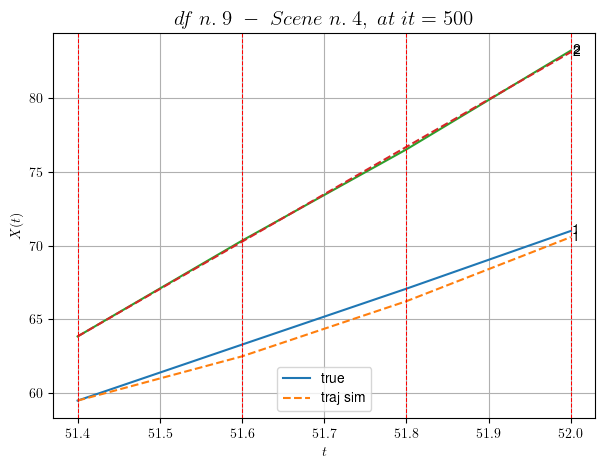

        For scene 4/33
        * use LR_NN=0.0005 with err=1.223455968858437 at it=24
        * v0_scn_mean = 32.046973671889745
        * MAE = 0.1966832604333681



df n.9, scene n.5/33
    We have 2 time intervals inside [57.80,58.20]
            - Time interval n.0: [57.80, 58.00]
                * y_true: [22.99410221]
                * v_ann: [24.80983543395996, 22.383621655895407]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [58.00, 58.20]
                * y_true: [26.0452022]
                * v_ann: [24.194778442382812, 22.383621655895407]

----------------------------------------------------------------------------------------------------
    * err= 0.25102720224496466
    * Learning rate NN = 7.289998848136747e-06
    * diff = 2.498858514499158e-06


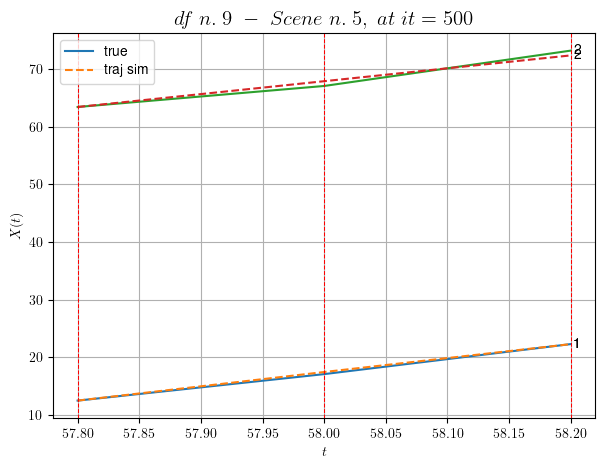

        For scene 5/33
        * use LR_NN=1e-05 with err=1.7678420208619228 at it=24
        * v0_scn_mean = 22.68827678960138
        * MAE = 0.2293337565322932



df n.9, scene n.6/33
    We have 8 time intervals inside [82.40,84.00]
            - Time interval n.0: [82.40, 82.60]
                * y_true: [31.06989228]
                * v_ann: [30.767736434936523, 34.29480154475975]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [82.60, 82.80]
                * y_true: [29.82804448]
                * v_ann: [32.14091491699219, 34.29480154475975]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [82.80, 83.00]
                * y_true: [37.59099484]
                * v_ann: [33.43424987792969, 34.29480154475975]

----------------------------------------------------------------------------------------------------


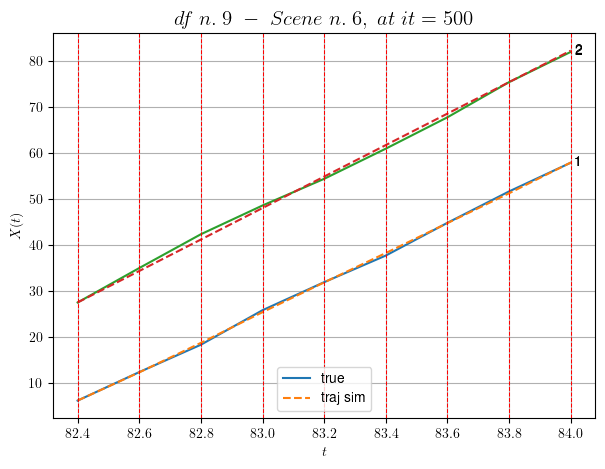

        For scene 6/33
        * use LR_NN=5e-05 with err=7.825163738827111 at it=24
        * v0_scn_mean = 34.123009483002114
        * MAE = 0.24566867895268157



df n.9, scene n.7/33
    We have 7 time intervals inside [117.00,118.40]
            - Time interval n.0: [117.00, 117.20]
                * y_true: [27.10832167]
                * v_ann: [24.30488395690918, 32.74675131139]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [117.20, 117.40]
                * y_true: [29.73749083]
                * v_ann: [25.986665725708008, 32.74675131139]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [117.40, 117.60]
                * y_true: [25.41587293]
                * v_ann: [25.566213607788086, 32.74675131139]

----------------------------------------------------------------------------------------------------

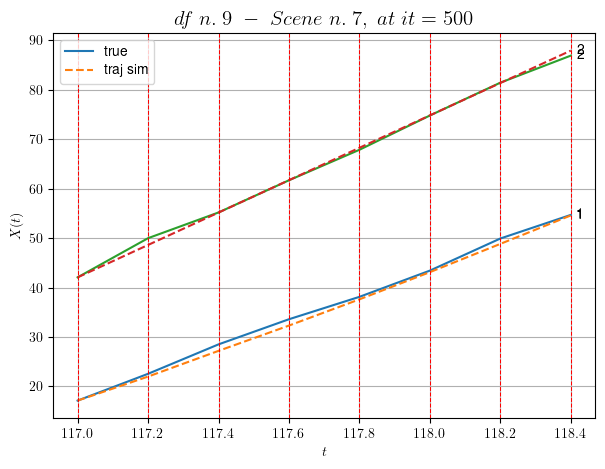

        For scene 7/33
        * use LR_NN=1e-05 with err=2.9322301223592153 at it=24
        * v0_scn_mean = 32.636881258955306
        * MAE = 0.5182829862502397



df n.9, scene n.8/33
    We have 3 time intervals inside [126.40,127.00]
    * err= 0.06969479301329032
    * Learning rate NN = 3.2804993679746985e-05
    * diff = 1.2515910280397335e-08


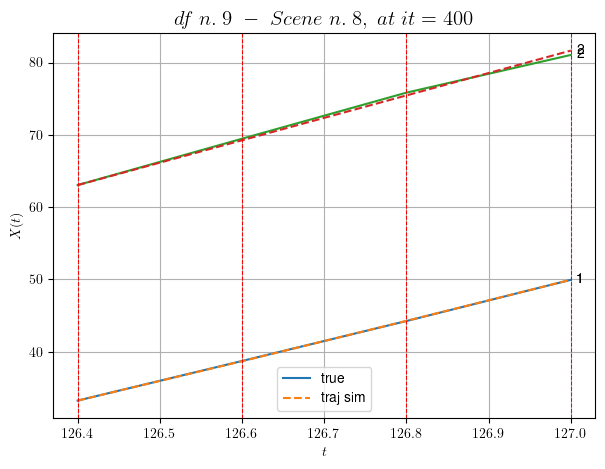

        For scene 8/33
        * use LR_NN=5e-05 with err=0.10072506368430598 at it=24
        * v0_scn_mean = 30.962134965753556
        * MAE = 0.06378431785112404



df n.9, scene n.9/33
    We have 6 time intervals inside [129.80,131.00]
            - Time interval n.0: [129.80, 130.00]
                * y_true: [25.09153851]
                * v_ann: [21.3132266998291, 25.485804967815255]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [130.00, 130.20]
                * y_true: [21.96260078]
                * v_ann: [22.099403381347656, 25.485804967815255]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [130.20, 130.40]
                * y_true: [20.15999275]
                * v_ann: [24.679452896118164, 25.485804967815255]

---------------------------------------------------------------------------------------

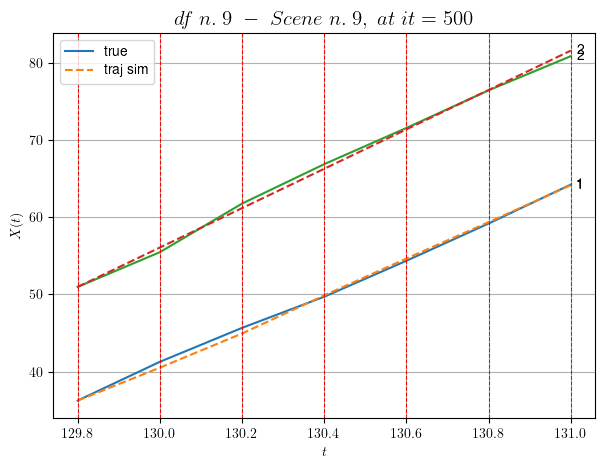

        For scene 9/33
        * use LR_NN=0.001 with err=5.6705523750129485 at it=24
        * v0_scn_mean = 25.666372769068097
        * MAE = 0.18585884217014903



df n.9, scene n.10/33
    We have 2 time intervals inside [140.00,140.40]
            - Time interval n.0: [140.00, 140.20]
                * y_true: [21.21233893]
                * v_ann: [23.491619110107422, 22.365188336411403]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [140.20, 140.40]
                * y_true: [26.63314751]
                * v_ann: [24.45899200439453, 22.365188336411403]

----------------------------------------------------------------------------------------------------
    * err= 0.07734225926858074
    * Learning rate NN = 7.289998757187277e-05
    * diff = 4.65341984581813e-06


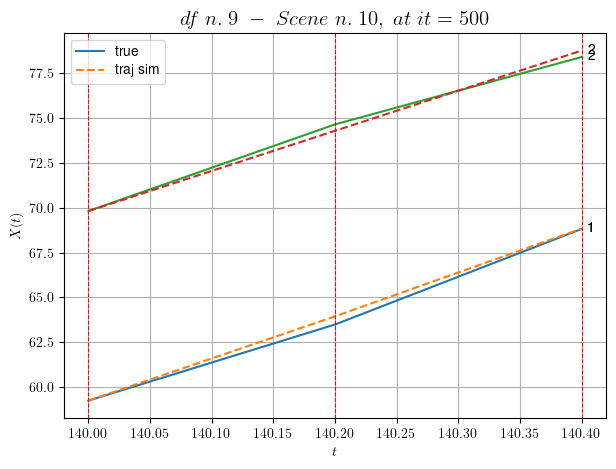

        For scene 10/33
        * use LR_NN=0.0001 with err=2.198561877078712 at it=24
        * v0_scn_mean = 22.670580802896936
        * MAE = 0.07706220859022157



df n.9, scene n.11/33
    We have 2 time intervals inside [143.60,144.00]
            - Time interval n.0: [143.60, 143.80]
                * y_true: [21.99451945]
                * v_ann: [26.81011199951172, 27.476067876169346]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [143.80, 144.00]
                * y_true: [32.47370265]
                * v_ann: [27.87208366394043, 27.476067876169346]

----------------------------------------------------------------------------------------------------
    * err= 0.25375418360850993
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 7.857058010707352e-06


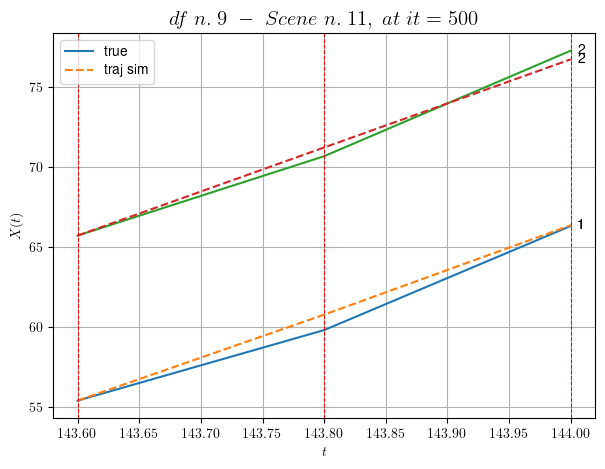

        For scene 11/33
        * use LR_NN=5e-05 with err=0.34799613013592595 at it=24
        * v0_scn_mean = 27.57702516110391
        * MAE = 0.22488605200782125



df n.9, scene n.12/33
    We have 2 time intervals inside [153.60,154.00]
            - Time interval n.0: [153.60, 153.80]
                * y_true: [25.49025935]
                * v_ann: [28.302091598510742, 26.67035901994437]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [153.80, 154.00]
                * y_true: [31.45259948]
                * v_ann: [28.68208885192871, 26.67035901994437]

----------------------------------------------------------------------------------------------------
    * err= 0.05736827791222427
    * Learning rate NN = 7.289998848136747e-06
    * diff = 7.654158966578783e-06


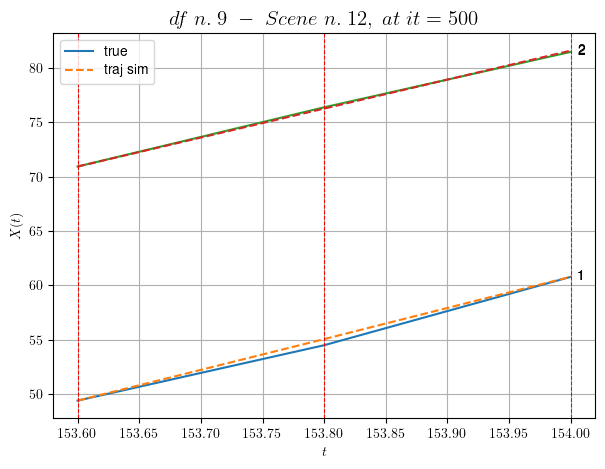

        For scene 12/33
        * use LR_NN=1e-05 with err=0.44231442501952223 at it=24
        * v0_scn_mean = 26.803544659121325
        * MAE = 0.05725975050049304



df n.9, scene n.13/33
    We have 5 time intervals inside [155.40,156.40]
            - Time interval n.0: [155.40, 155.60]
                * y_true: [29.25651225]
                * v_ann: [32.19292449951172, 25.42352154213608]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [155.60, 155.80]
                * y_true: [27.27414917]
                * v_ann: [31.444849014282227, 25.42352154213608]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [155.80, 156.00]
                * y_true: [30.96998359]
                * v_ann: [30.516246795654297, 25.42352154213608]

---------------------------------------------------------------------------------------

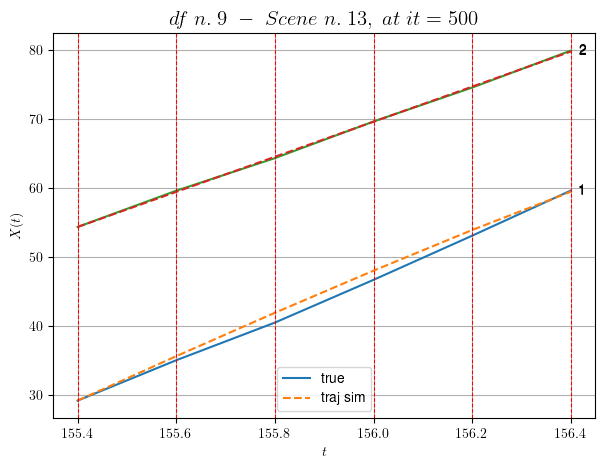

        For scene 13/33
        * use LR_NN=1e-05 with err=4.211427018362793 at it=24
        * v0_scn_mean = 25.606580680415362
        * MAE = 0.41171594259583244



df n.9, scene n.14/33
    We have 6 time intervals inside [161.60,162.80]
            - Time interval n.0: [161.60, 161.80]
                * y_true: [21.4660985]
                * v_ann: [16.53942108154297, 22.164023913692947]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [161.80, 162.00]
                * y_true: [19.14413932]
                * v_ann: [17.45857810974121, 22.164023913692947]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [162.00, 162.20]
                * y_true: [15.69105389]
                * v_ann: [17.06988525390625, 22.164023913692947]

-----------------------------------------------------------------------------------------

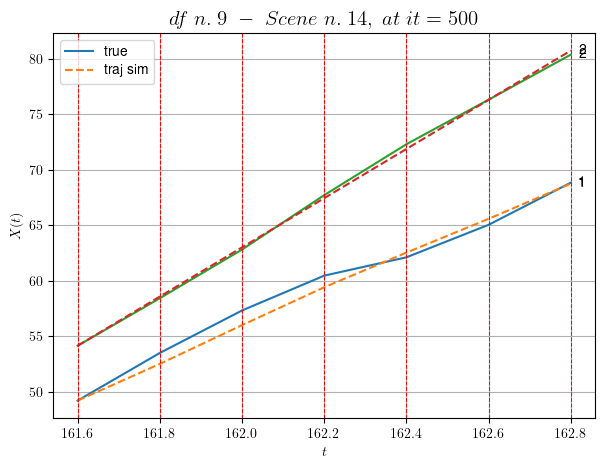

        For scene 14/33
        * use LR_NN=0.001 with err=19.58468291250644 at it=24
        * v0_scn_mean = 22.477462957085763
        * MAE = 0.3389114809777



df n.9, scene n.15/33
    We have 7 time intervals inside [165.60,167.00]
            - Time interval n.0: [165.60, 165.80]
                * y_true: [5.80515552]
                * v_ann: [9.689736366271973, 15.549223069343494]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [165.80, 166.00]
                * y_true: [13.42041723]
                * v_ann: [9.839570999145508, 15.549223069343494]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.00, 166.20]
                * y_true: [9.84291222]
                * v_ann: [10.029153823852539, 15.549223069343494]

---------------------------------------------------------------------------------------------

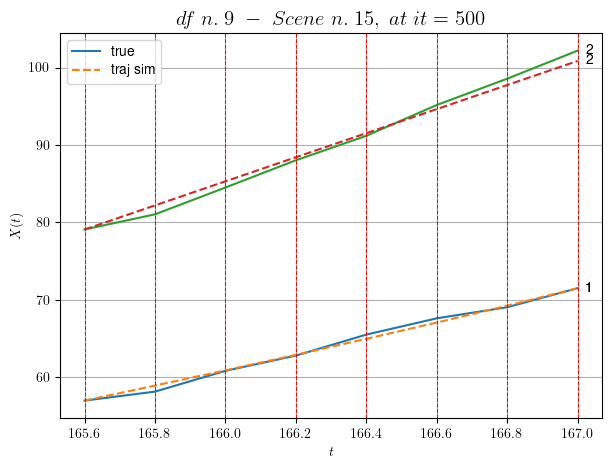

        For scene 15/33
        * use LR_NN=1e-05 with err=69.3234135449382 at it=24
        * v0_scn_mean = 16.127254146459457
        * MAE = 0.3294073975202959



df n.9, scene n.16/33
    We have 18 time intervals inside [172.60,176.20]
            - Time interval n.0: [172.60, 172.80]
                * y_true: [7.57017038]
                * v_ann: [12.133942604064941, 7.5796009487189036]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [172.80, 173.00]
                * y_true: [5.21712635]
                * v_ann: [11.82004165649414, 7.5796009487189036]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [173.00, 173.20]
                * y_true: [10.96479034]
                * v_ann: [11.419931411743164, 7.5796009487189036]

-----------------------------------------------------------------------------------------

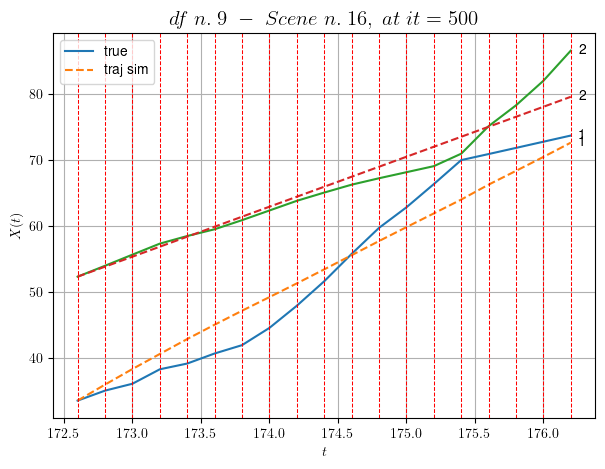

        For scene 16/33
        * use LR_NN=0.001 with err=1108.8528662413025 at it=24
        * v0_scn_mean = 8.476416910598848
        * MAE = 8.200017690438717



df n.9, scene n.17/33
    We have 16 time intervals inside [186.20,189.40]
            - Time interval n.0: [186.20, 186.40]
                * y_true: [1.63882191]
                * v_ann: [5.418634414672852, 1.6231210654495436]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [186.40, 186.60]
                * y_true: [1.63882191]
                * v_ann: [5.426738739013672, 1.6231210654495436]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [186.60, 186.80]
                * y_true: [1.63882191]
                * v_ann: [5.434866428375244, 1.6231210654495436]

--------------------------------------------------------------------------------------------

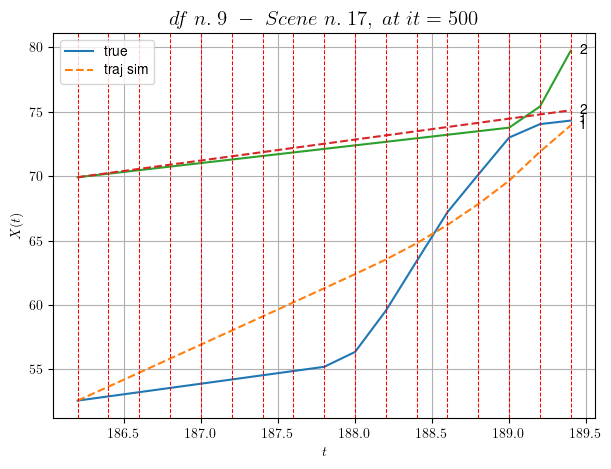

        For scene 17/33
        * use LR_NN=1e-05 with err=1417.7702091675123 at it=24
        * v0_scn_mean = 2.758196222614708
        * MAE = 6.428111911552352



df n.9, scene n.18/33
    We have 5 time intervals inside [191.20,192.20]
            - Time interval n.0: [191.20, 191.40]
                * y_true: [9.81240437]
                * v_ann: [9.379501342773438, 9.117095848783483]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [191.40, 191.60]
                * y_true: [8.00871891]
                * v_ann: [9.414677619934082, 9.117095848783483]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [191.60, 191.80]
                * y_true: [8.49713355]
                * v_ann: [9.299532890319824, 9.117095848783483]

------------------------------------------------------------------------------------------------

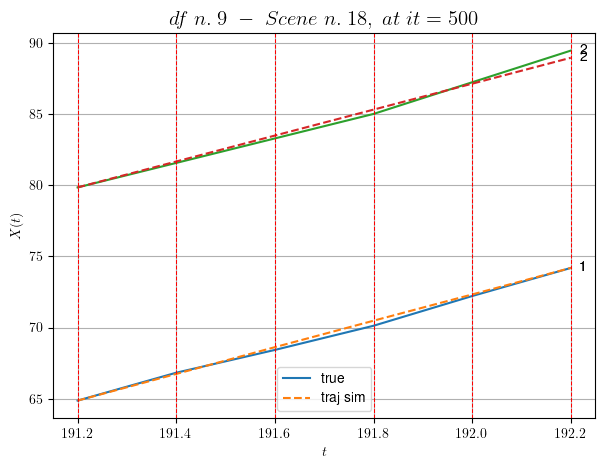

        For scene 18/33
        * use LR_NN=0.0001 with err=78.94716943625109 at it=24
        * v0_scn_mean = 9.952412014672616
        * MAE = 0.047408119675502874



df n.9, scene n.19/33
    We have 2 time intervals inside [195.00,195.40]
            - Time interval n.0: [195.00, 195.20]
                * y_true: [15.29426248]
                * v_ann: [17.896841049194336, 26.77481390978863]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [195.20, 195.40]
                * y_true: [20.89286113]
                * v_ann: [18.585084915161133, 26.77481390978863]

----------------------------------------------------------------------------------------------------
    * err= 0.04579168137615884
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0001092358421663775


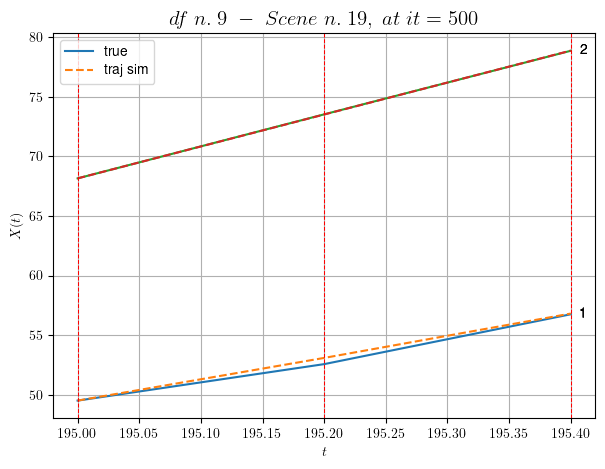

        For scene 19/33
        * use LR_NN=5e-05 with err=0.3746766911193671 at it=24
        * v0_scn_mean = 26.903821353372216
        * MAE = 0.04521376669895619



df n.9, scene n.20/33
    We have 6 time intervals inside [197.60,198.80]
            - Time interval n.0: [197.60, 197.80]
                * y_true: [25.64680127]
                * v_ann: [25.249797821044922, 19.310295514409194]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [197.80, 198.00]
                * y_true: [20.34731781]
                * v_ann: [22.631362915039062, 19.310295514409194]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [198.00, 198.20]
                * y_true: [20.0662913]
                * v_ann: [20.531147003173828, 19.310295514409194]

-------------------------------------------------------------------------------------

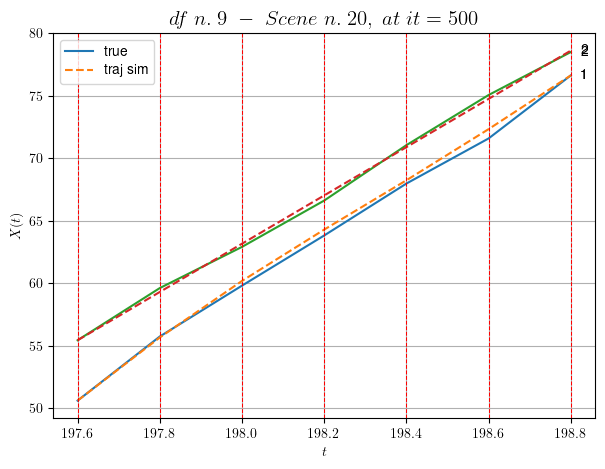

        For scene 20/33
        * use LR_NN=0.0001 with err=29.965019838909082 at it=24
        * v0_scn_mean = 19.73788369375107
        * MAE = 0.10381295557094888



df n.9, scene n.21/33
    We have 12 time intervals inside [203.80,206.20]
            - Time interval n.0: [203.80, 204.00]
                * y_true: [7.9642704]
                * v_ann: [8.749903678894043, 17.40555771714608]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [204.00, 204.20]
                * y_true: [10.57855329]
                * v_ann: [8.821622848510742, 17.40555771714608]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [204.20, 204.40]
                * y_true: [8.12921025]
                * v_ann: [9.044989585876465, 17.40555771714608]

--------------------------------------------------------------------------------------------

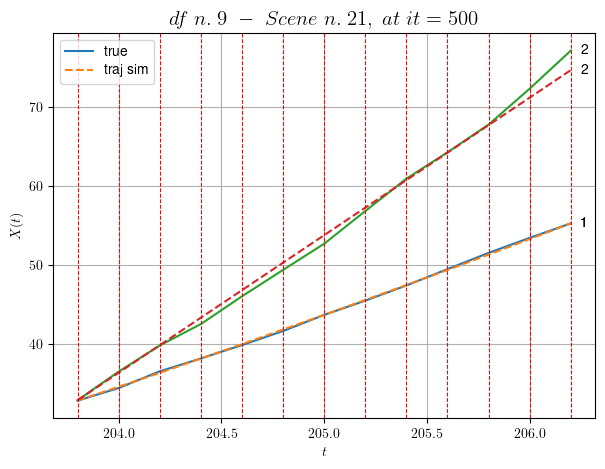

        For scene 21/33
        * use LR_NN=0.001 with err=156.14890574926667 at it=24
        * v0_scn_mean = 17.909335408364317
        * MAE = 0.39366516207168584



df n.9, scene n.22/33
    We have 2 time intervals inside [219.80,220.20]
            - Time interval n.0: [219.80, 220.00]
                * y_true: [15.58371514]
                * v_ann: [14.061775207519531, 29.573992502784012]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [220.00, 220.20]
                * y_true: [13.92467981]
                * v_ann: [15.18150520324707, 29.573992502784012]

----------------------------------------------------------------------------------------------------
    * err= 0.030617970185620454
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0001386487614971621


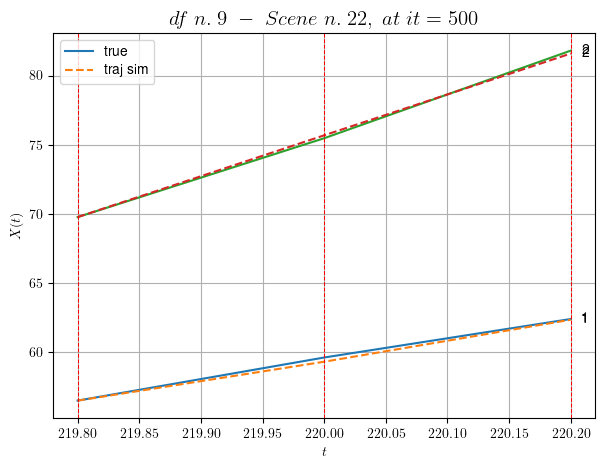

        For scene 22/33
        * use LR_NN=0.0001 with err=0.05596105480405569 at it=24
        * v0_scn_mean = 29.59103280267158
        * MAE = 0.030617970185620454



df n.9, scene n.23/33
    We have 4 time intervals inside [225.20,226.00]
            - Time interval n.0: [225.20, 225.40]
                * y_true: [10.23803701]
                * v_ann: [21.71331214904785, 24.73787660577361]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.40, 225.60]
                * y_true: [15.18402828]
                * v_ann: [16.53043556213379, 24.73787660577361]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.60, 225.80]
                * y_true: [24.75572707]
                * v_ann: [17.244281768798828, 24.73787660577361]

---------------------------------------------------------------------------------------

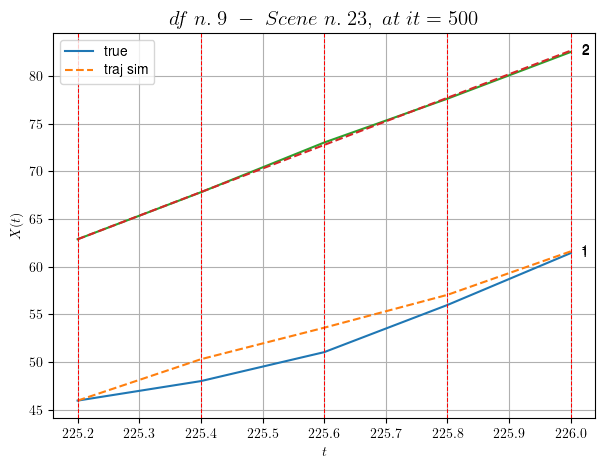

        For scene 23/33
        * use LR_NN=0.001 with err=3.775428460210931 at it=24
        * v0_scn_mean = 24.948361541501974
        * MAE = 0.4585951862439224



df n.9, scene n.24/33
    We have 3 time intervals inside [5.40,6.00]
            - Time interval n.0: [5.40, 5.60]
                * y_true: [17.46255149 32.38946228]
                * v_ann: [25.142812728881836, 26.95359992980957, 29.081107080157132]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [5.60, 5.80]
                * y_true: [27.89361325 30.52270411]
                * v_ann: [26.826826095581055, 26.66372299194336, 29.081107080157132]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [5.80, 6.00]
                * y_true: [26.75613901 28.6867411 ]
                * v_ann: [29.801069259643555, 28.154869079589844, 29.081107080157132]

--------

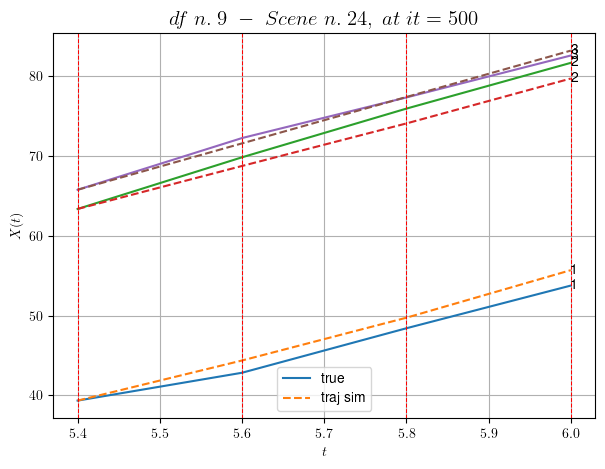

        For scene 24/33
        * use LR_NN=0.001 with err=24.39475159918005 at it=24
        * v0_scn_mean = 29.13624061409139
        * MAE = 1.2207928776198795



df n.9, scene n.25/33
    We have 2 time intervals inside [20.80,21.20]
            - Time interval n.0: [20.80, 21.00]
                * y_true: [29.01888251 26.46522664]
                * v_ann: [27.628582000732422, 27.10983657836914, 32.73331157196282]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [21.00, 21.20]
                * y_true: [29.93697896 25.84808908]
                * v_ann: [28.013999938964844, 28.500791549682617, 32.73331157196282]

----------------------------------------------------------------------------------------------------
    * err= 0.14215226245701704
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.00017523860687146398


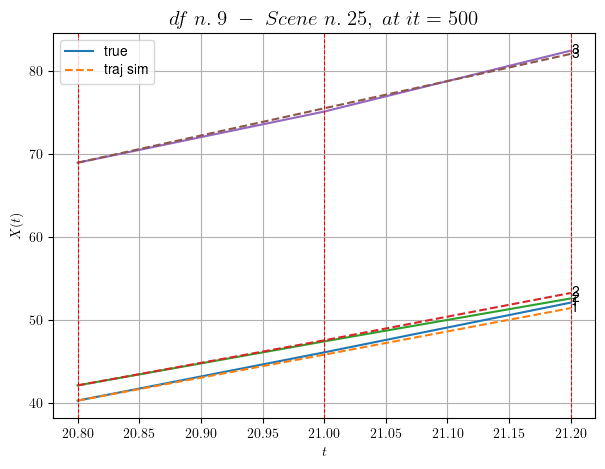

        For scene 25/33
        * use LR_NN=0.001 with err=11.267678265805865 at it=24
        * v0_scn_mean = 32.56931300036489
        * MAE = 0.13781372668542333



df n.9, scene n.26/33
    We have 6 time intervals inside [37.80,39.00]
            - Time interval n.0: [37.80, 38.00]
                * y_true: [21.35828745 27.25004814]
                * v_ann: [20.617088317871094, 21.049230575561523, 23.63905106929795]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.00, 38.20]
                * y_true: [19.23626153 17.91519282]
                * v_ann: [22.726985931396484, 22.557899475097656, 23.63905106929795]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [38.20, 38.40]
                * y_true: [24.96063116 28.62771944]
                * v_ann: [20.781444549560547, 20.479454040527344, 23.63905106929795]



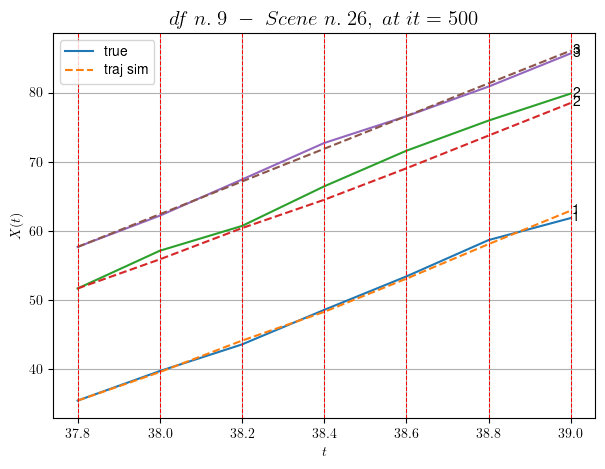

        For scene 26/33
        * use LR_NN=0.001 with err=33.54587342333969 at it=24
        * v0_scn_mean = 24.02070771954727
        * MAE = 1.0160327295720186



df n.9, scene n.27/33
    We have 2 time intervals inside [44.40,44.80]
            - Time interval n.0: [44.40, 44.60]
                * y_true: [24.95803839 22.94664651]
                * v_ann: [25.075822830200195, 25.72568702697754, 18.01610672050828]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [44.60, 44.80]
                * y_true: [22.38974011 30.85088397]
                * v_ann: [24.81052017211914, 25.201793670654297, 18.01610672050828]

----------------------------------------------------------------------------------------------------
    * err= 0.1132351713730884
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0017312321713926215


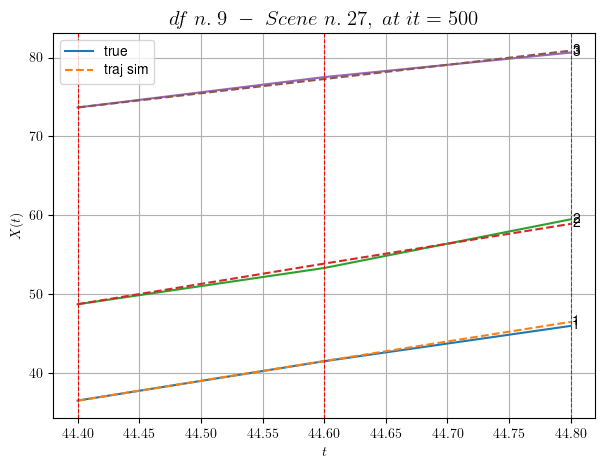

        For scene 27/33
        * use LR_NN=5e-05 with err=5.34852626421386 at it=24
        * v0_scn_mean = 18.735139779226916
        * MAE = 0.09374005157275213



df n.9, scene n.28/33
    We have 3 time intervals inside [117.80,118.40]
            - Time interval n.0: [117.80, 118.00]
                * y_true: [26.21501314 26.51617559]
                * v_ann: [25.136123657226562, 25.00994300842285, 32.94782563350103]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [118.00, 118.20]
                * y_true: [24.27291409 32.45579962]
                * v_ann: [25.464262008666992, 25.872238159179688, 32.94782563350103]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [118.20, 118.40]
                * y_true: [21.96072195 23.86482679]
                * v_ann: [25.957210540771484, 26.92022132873535, 32.947825633501

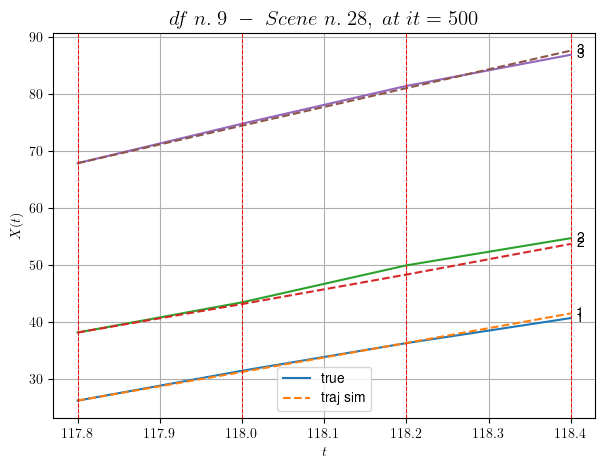

        For scene 28/33
        * use LR_NN=0.0001 with err=6.573774282733312 at it=24
        * v0_scn_mean = 32.7709562278419
        * MAE = 0.38110497329208126



df n.9, scene n.29/33
    We have 2 time intervals inside [119.20,119.60]
            - Time interval n.0: [119.20, 119.40]
                * y_true: [23.20444186 22.52067771]
                * v_ann: [25.118560791015625, 25.137928009033203, 26.734589830538365]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [119.40, 119.60]
                * y_true: [27.39348249 26.5570173 ]
                * v_ann: [24.695222854614258, 24.700077056884766, 26.734589830538365]

----------------------------------------------------------------------------------------------------
    * err= 0.05323039200475576
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0004876262605182091


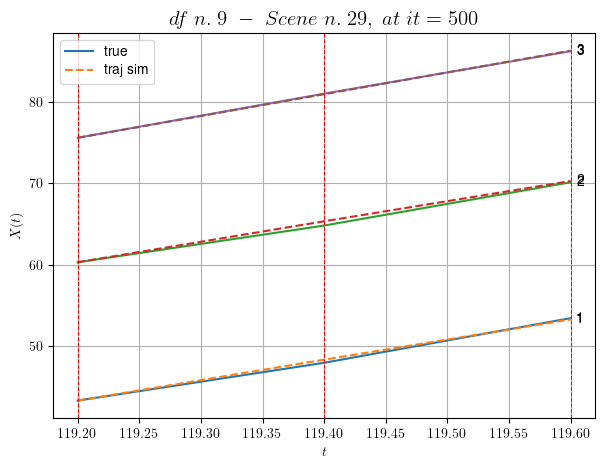

        For scene 29/33
        * use LR_NN=5e-05 with err=0.2957757006877008 at it=24
        * v0_scn_mean = 26.930514294096305
        * MAE = 0.05323039200475576



df n.9, scene n.30/33
    We have 2 time intervals inside [120.20,120.60]
            - Time interval n.0: [120.20, 120.40]
                * y_true: [30.48045094 26.16776015]
                * v_ann: [26.221895217895508, 26.955690383911133, 27.348987307571523]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [120.40, 120.60]
                * y_true: [26.23623075 25.12734403]
                * v_ann: [26.937637329101562, 27.72724723815918, 27.348987307571523]

----------------------------------------------------------------------------------------------------
    * err= 0.22185028966773823
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0014620863503574666


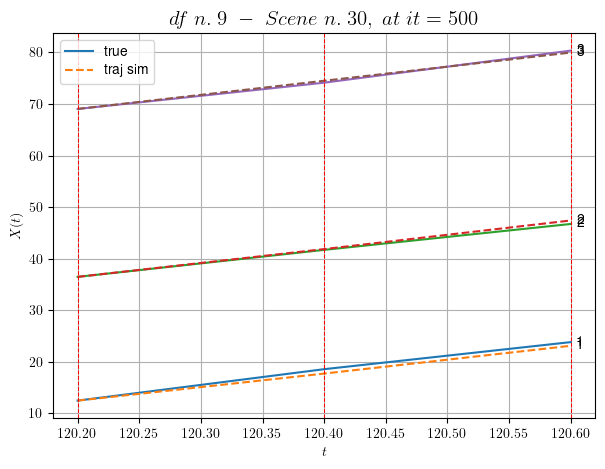

        For scene 30/33
        * use LR_NN=5e-05 with err=1.6223880747916832 at it=24
        * v0_scn_mean = 27.508047950092237
        * MAE = 0.22185028966773823



df n.9, scene n.31/33
    We have 3 time intervals inside [121.40,122.00]
            - Time interval n.0: [121.40, 121.60]
                * y_true: [23.88369588 31.34452269]
                * v_ann: [27.07187843322754, 25.625080108642578, 28.65752843457791]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.60, 121.80]
                * y_true: [22.66516063 24.1738881 ]
                * v_ann: [25.35199737548828, 26.29903793334961, 28.65752843457791]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.80, 122.00]
                * y_true: [27.39865086 24.79107704]
                * v_ann: [24.577346801757812, 25.190757751464844, 28.65752843457

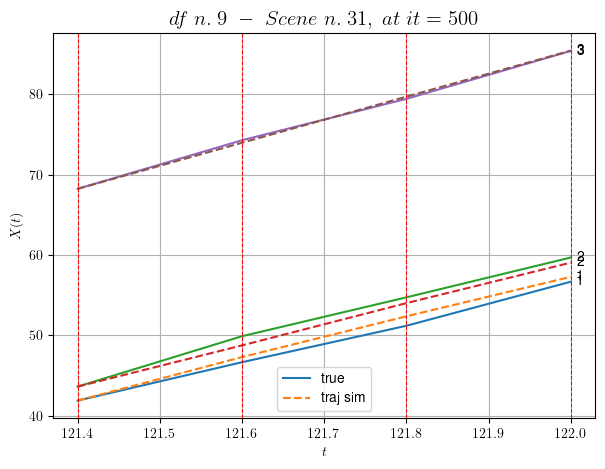

        For scene 31/33
        * use LR_NN=0.0005 with err=13.17536690003462 at it=24
        * v0_scn_mean = 28.738076668229162
        * MAE = 0.33949820768387



df n.9, scene n.32/33
    We have 2 time intervals inside [205.80,206.20]
            - Time interval n.0: [205.80, 206.00]
                * y_true: [16.81767795  9.52209489]
                * v_ann: [12.459349632263184, 12.036096572875977, 23.158651176007396]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [206.00, 206.20]
                * y_true: [13.65726133  9.1692133 ]
                * v_ann: [12.23106861114502, 12.39069938659668, 23.158651176007396]

----------------------------------------------------------------------------------------------------
    * err= 0.40937660728143754
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0022865424183908245


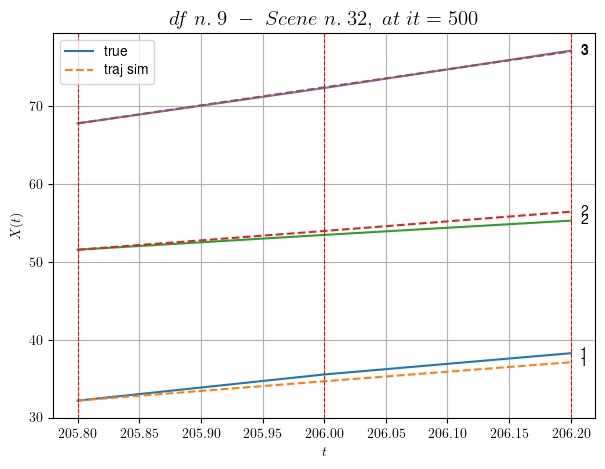

        For scene 32/33
        * use LR_NN=5e-05 with err=1.3131305253841532 at it=24
        * v0_scn_mean = 23.569131798284864
        * MAE = 0.39234569538763736



For df=9 with 33 scenes, time taken:        682.01
****************************************************************************************************
****************************************************************************************************
In df n.10/10 we have 74 scenes
df n.10, scene n.0/74
    We have 3 time intervals inside [12.72,13.32]
            - Time interval n.0: [12.72, 12.92]
                * y_true: [11.70075978]
                * v_ann: [11.024742126464844, 23.837684223240988]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [12.92, 13.12]
                * y_true: [15.28108747]
                * v_ann: [12.808258056640625, 23.837684223240988]

---------------------------------------------------------------

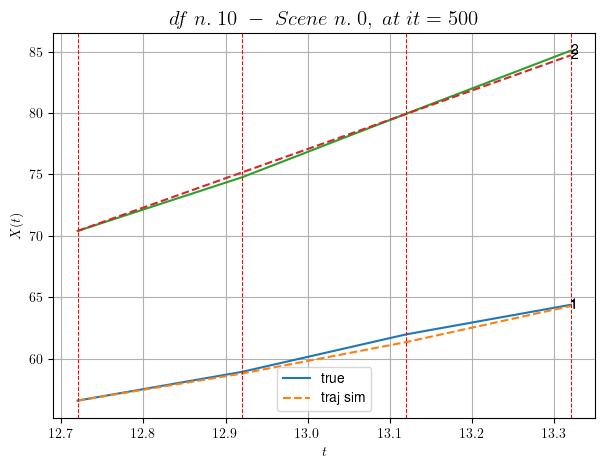

        For scene 0/74
        * use LR_NN=1e-05 with err=2.482597063420733 at it=24
        * v0_scn_mean = 24.084176854264243
        * MAE = 0.08384444941110816



df n.10, scene n.1/74
    We have 5 time intervals inside [24.52,25.52]
            - Time interval n.0: [24.52, 24.72]
                * y_true: [20.69094088]
                * v_ann: [15.717048645019531, 27.846729228086385]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [24.72, 24.92]
                * y_true: [21.00112482]
                * v_ann: [19.134544372558594, 27.846729228086385]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.92, 25.12]
                * y_true: [22.54141935]
                * v_ann: [23.256467819213867, 27.846729228086385]

----------------------------------------------------------------------------------------------

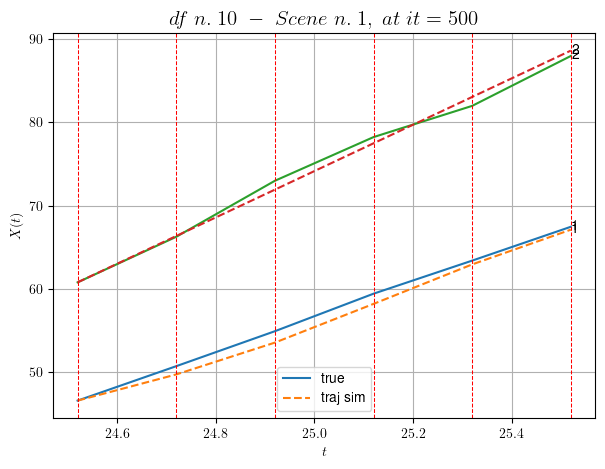

        For scene 1/74
        * use LR_NN=0.001 with err=1.4677626970351196 at it=24
        * v0_scn_mean = 27.932860058946424
        * MAE = 0.4122513654197139



df n.10, scene n.2/74
    We have 7 time intervals inside [34.92,36.32]
            - Time interval n.0: [34.92, 35.12]
                * y_true: [23.68551506]
                * v_ann: [19.1507625579834, 25.10228996222764]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [35.12, 35.32]
                * y_true: [19.89940705]
                * v_ann: [19.856706619262695, 25.10228996222764]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [35.32, 35.52]
                * y_true: [19.9226572]
                * v_ann: [23.062612533569336, 25.10228996222764]

----------------------------------------------------------------------------------------------------

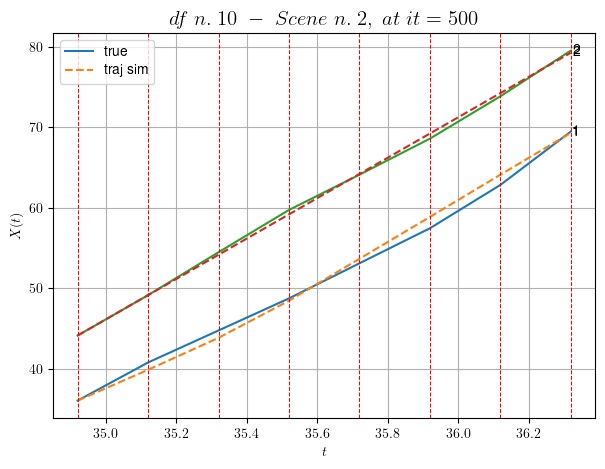

        For scene 2/74
        * use LR_NN=5e-05 with err=9.082702322815058 at it=24
        * v0_scn_mean = 25.298198363701086
        * MAE = 0.41990604898016887



df n.10, scene n.3/74
    We have 3 time intervals inside [41.32,41.92]
            - Time interval n.0: [41.32, 41.52]
                * y_true: [27.9207748]
                * v_ann: [29.477340698242188, 23.270817806163645]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [41.52, 41.72]
                * y_true: [27.55103886]
                * v_ann: [27.744104385375977, 23.270817806163645]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [41.72, 41.92]
                * y_true: [29.24138341]
                * v_ann: [27.370487213134766, 23.270817806163645]

-----------------------------------------------------------------------------------------------

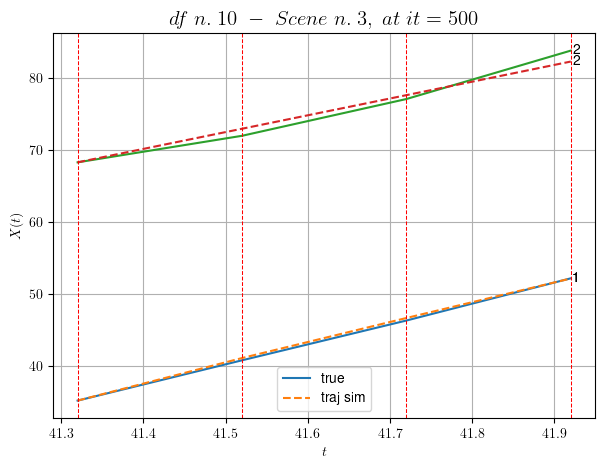

        For scene 3/74
        * use LR_NN=1e-05 with err=2.794002804422973 at it=24
        * v0_scn_mean = 23.53998509386573
        * MAE = 0.425330336184316



df n.10, scene n.4/74
    We have 3 time intervals inside [56.92,57.52]
    * err= 0.2482488946769545
    * Learning rate NN = 0.0036449995823204517
    * diff = 3.107385972977994e-07


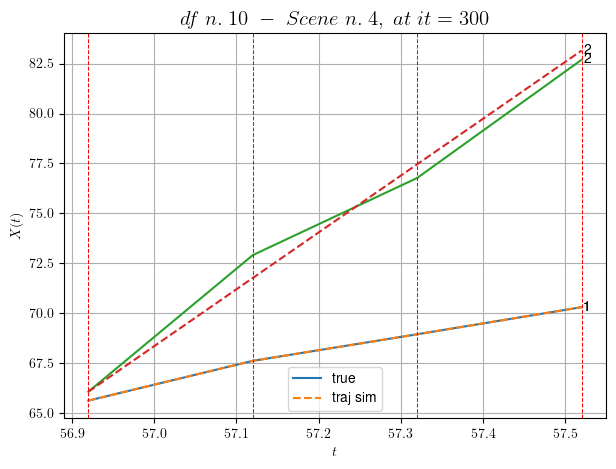

        For scene 4/74
        * use LR_NN=0.005 with err=0.5490796217230158 at it=24
        * v0_scn_mean = 28.540485153323196
        * MAE = 0.2482488946769545



df n.10, scene n.5/74
    We have 4 time intervals inside [59.12,59.92]
            - Time interval n.0: [59.12, 59.32]
                * y_true: [7.04118507]
                * v_ann: [6.460313320159912, 24.64241489798159]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [59.32, 59.52]
                * y_true: [9.13519325]
                * v_ann: [6.735259532928467, 24.64241489798159]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [59.52, 59.72]
                * y_true: [7.00075911]
                * v_ann: [7.206299781799316, 24.64241489798159]

----------------------------------------------------------------------------------------------------
  

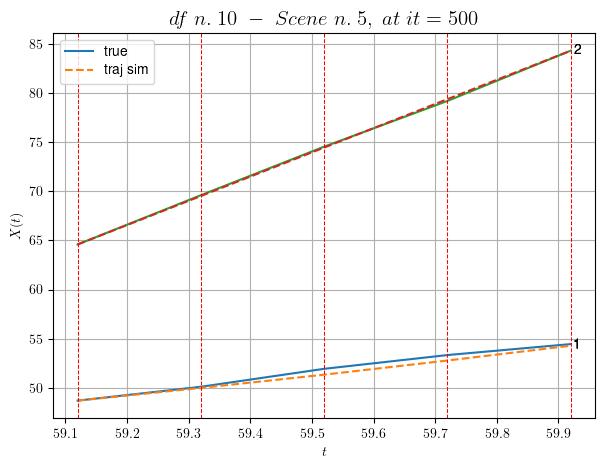

        For scene 5/74
        * use LR_NN=5e-05 with err=3.7043633898554735 at it=24
        * v0_scn_mean = 24.856718302021676
        * MAE = 0.07533049578546407



df n.10, scene n.6/74
    We have 5 time intervals inside [64.92,65.92]
            - Time interval n.0: [64.92, 65.12]
                * y_true: [5.04006152]
                * v_ann: [8.53528118133545, 23.262500294243743]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [65.12, 65.32]
                * y_true: [3.97005162]
                * v_ann: [9.199854850769043, 23.262500294243743]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [65.32, 65.52]
                * y_true: [3.01004135]
                * v_ann: [10.016929626464844, 23.262500294243743]

---------------------------------------------------------------------------------------------------

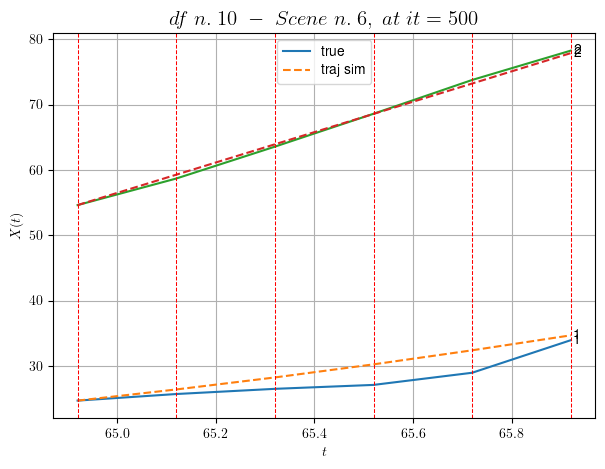

        For scene 6/74
        * use LR_NN=5e-05 with err=9.877261988625179 at it=24
        * v0_scn_mean = 23.53200028242218
        * MAE = 2.20553048652925



df n.10, scene n.7/74
    We have 4 time intervals inside [81.72,82.52]
            - Time interval n.0: [81.72, 81.92]
                * y_true: [0.07201947]
                * v_ann: [5.109790802001953, 21.36406302671324]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [81.92, 82.12]
                * y_true: [0.07201947]
                * v_ann: [4.3867878913879395, 21.36406302671324]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [82.12, 82.32]
                * y_true: [2.09202578]
                * v_ann: [3.628422260284424, 21.36406302671324]

----------------------------------------------------------------------------------------------------
     

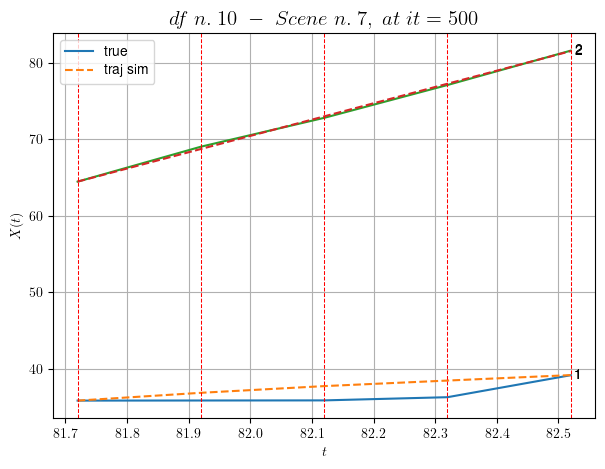

        For scene 7/74
        * use LR_NN=0.001 with err=9.985761788187983 at it=24
        * v0_scn_mean = 21.709500505578543
        * MAE = 0.8727141511082902



df n.10, scene n.8/74
    We have 8 time intervals inside [85.72,87.32]
            - Time interval n.0: [85.72, 85.92]
                * y_true: [0.07201947]
                * v_ann: [2.532829999923706, 23.19995130380208]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [85.92, 86.12]
                * y_true: [4.16376399]
                * v_ann: [9.535188674926758, 23.19995130380208]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [86.12, 86.32]
                * y_true: [21.51063868]
                * v_ann: [17.409921646118164, 23.19995130380208]

----------------------------------------------------------------------------------------------------
 

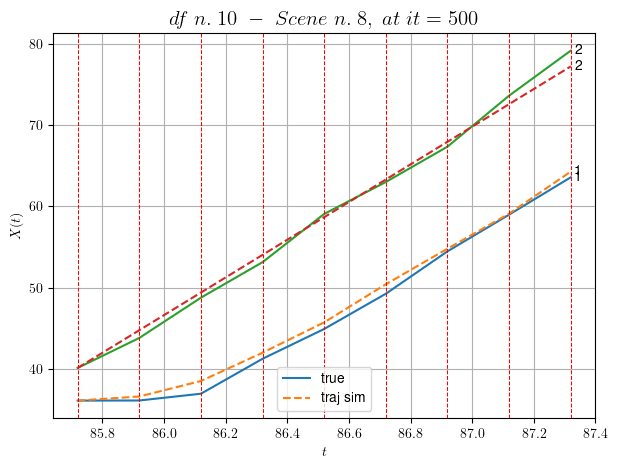

        For scene 8/74
        * use LR_NN=0.001 with err=19.925680876987798 at it=24
        * v0_scn_mean = 23.471953251598055
        * MAE = 0.748411103915843



df n.10, scene n.9/74
    We have 10 time intervals inside [97.32,99.32]
            - Time interval n.0: [97.32, 97.52]
                * y_true: [11.48366043]
                * v_ann: [2.0072062015533447, 19.018016829365102]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [97.52, 97.72]
                * y_true: [0.07201947]
                * v_ann: [2.154620885848999, 19.018016829365102]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [97.72, 97.92]
                * y_true: [7.07479559]
                * v_ann: [8.973305702209473, 19.018016829365102]

--------------------------------------------------------------------------------------------------

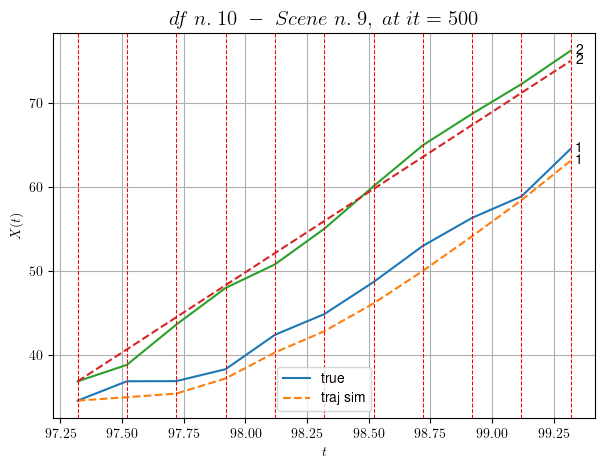

        For scene 9/74
        * use LR_NN=0.0001 with err=79.57062769384446 at it=24
        * v0_scn_mean = 19.457296156106693
        * MAE = 2.3153960966693266



df n.10, scene n.10/74
    We have 5 time intervals inside [100.52,101.52]
            - Time interval n.0: [100.52, 100.72]
                * y_true: [15.44102969]
                * v_ann: [20.37267303466797, 19.675993616954766]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [100.72, 100.92]
                * y_true: [24.7218456]
                * v_ann: [18.896411895751953, 19.675993616954766]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [100.92, 101.12]
                * y_true: [19.48315215]
                * v_ann: [21.436790466308594, 19.675993616954766]

---------------------------------------------------------------------------------------

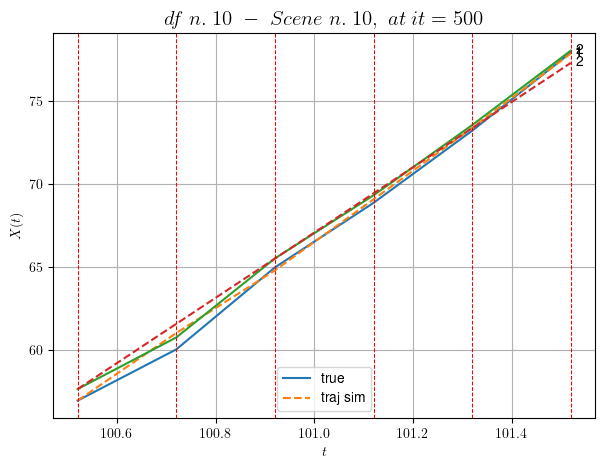

        For scene 10/74
        * use LR_NN=0.01 with err=18.73379902316057 at it=24
        * v0_scn_mean = 20.088953872197575
        * MAE = 0.1960134918395716



df n.10, scene n.11/74
    We have 4 time intervals inside [103.72,104.52]
            - Time interval n.0: [103.72, 103.92]
                * y_true: [18.3928945]
                * v_ann: [17.879253387451172, 24.24265454583431]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [103.92, 104.12]
                * y_true: [16.70145174]
                * v_ann: [17.63405990600586, 24.24265454583431]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [104.12, 104.32]
                * y_true: [20.23196797]
                * v_ann: [18.75406265258789, 24.24265454583431]

--------------------------------------------------------------------------------------------

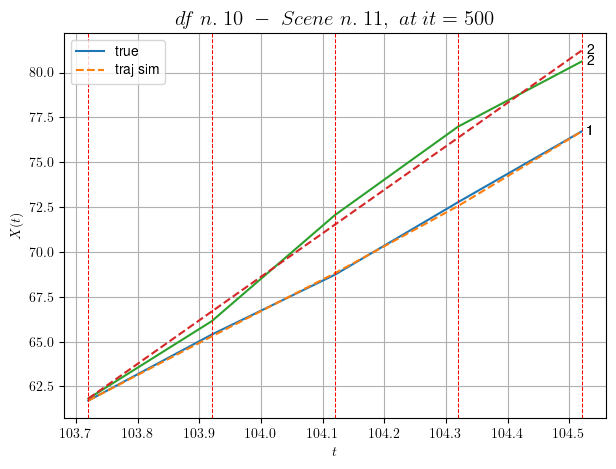

        For scene 11/74
        * use LR_NN=0.005 with err=4.196149612407208 at it=24
        * v0_scn_mean = 24.472948363956885
        * MAE = 0.1384386452552237



df n.10, scene n.12/74
    We have 2 time intervals inside [109.72,110.12]
            - Time interval n.0: [109.72, 109.92]
                * y_true: [5.75051979]
                * v_ann: [6.005171298980713, 22.592418168551998]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.92, 110.12]
                * y_true: [8.76081232]
                * v_ann: [8.642029762268066, 22.592418168551998]

----------------------------------------------------------------------------------------------------
    * err= 0.0078603268034204
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.00018752234646493213


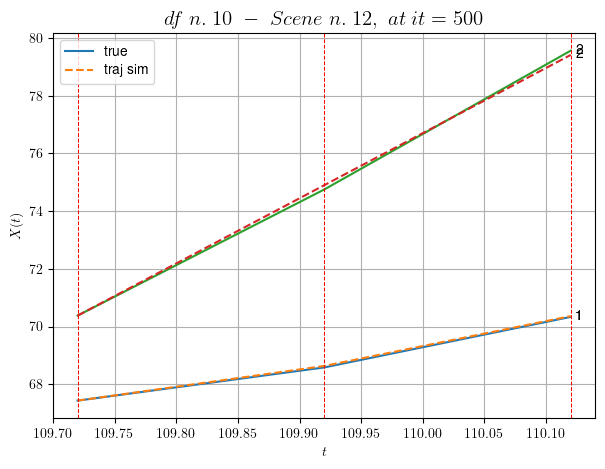

        For scene 12/74
        * use LR_NN=0.0005 with err=1.7634622071435628 at it=24
        * v0_scn_mean = 22.888721441753184
        * MAE = 0.0078603268034204



df n.10, scene n.13/74
    We have 8 time intervals inside [116.72,118.32]
            - Time interval n.0: [116.72, 116.92]
                * y_true: [1.82657583]
                * v_ann: [8.78250789642334, 19.612707397568286]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [116.92, 117.12]
                * y_true: [1.82657583]
                * v_ann: [3.3795347213745117, 19.612707397568286]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [117.12, 117.32]
                * y_true: [1.82657583]
                * v_ann: [5.018336296081543, 19.612707397568286]

-----------------------------------------------------------------------------------------

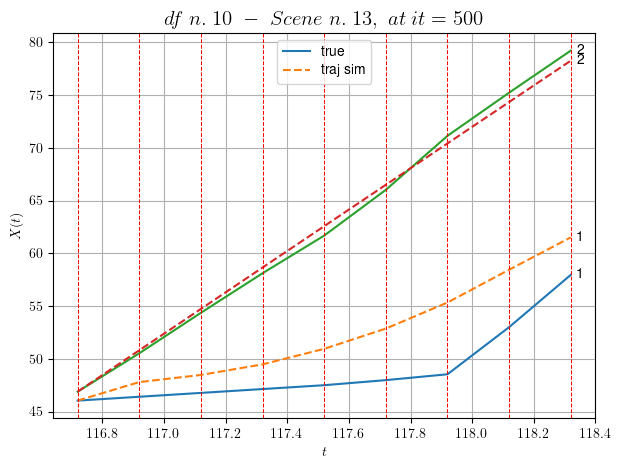

        For scene 13/74
        * use LR_NN=1e-05 with err=48.99198300251428 at it=24
        * v0_scn_mean = 20.028199101586065
        * MAE = 7.684272513268717



df n.10, scene n.14/74
    We have 2 time intervals inside [118.92,119.32]
    * err= 0.036441322448771477
    * Learning rate NN = 4.049999552080408e-05
    * diff = 1.2611421677105605e-07


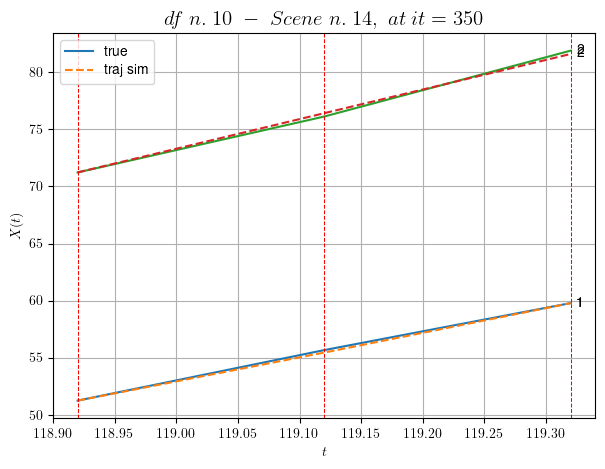

        For scene 14/74
        * use LR_NN=5e-05 with err=0.4998648203775854 at it=24
        * v0_scn_mean = 26.19984672997232
        * MAE = 0.03375034791463181



df n.10, scene n.15/74
    We have 2 time intervals inside [139.92,140.32]
            - Time interval n.0: [139.92, 140.12]
                * y_true: [28.34197471]
                * v_ann: [31.02313232421875, 27.422660948669282]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [140.12, 140.32]
                * y_true: [31.34257406]
                * v_ann: [28.42546844482422, 27.422660948669282]

----------------------------------------------------------------------------------------------------
    * err= 0.13914815446653864
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 3.2664247873182006e-06


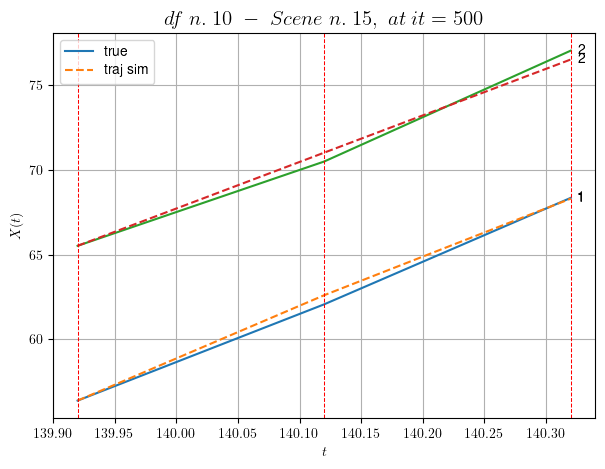

        For scene 15/74
        * use LR_NN=5e-05 with err=0.2859090504713228 at it=24
        * v0_scn_mean = 27.525754510702523
        * MAE = 0.12521206872784438



df n.10, scene n.16/74
    We have 5 time intervals inside [159.92,160.92]
            - Time interval n.0: [159.92, 160.12]
                * y_true: [16.1202741]
                * v_ann: [12.3333101272583, 21.428672023291114]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [160.12, 160.32]
                * y_true: [13.25025986]
                * v_ann: [12.81291389465332, 21.428672023291114]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [160.32, 160.52]
                * y_true: [12.66030115]
                * v_ann: [13.567815780639648, 21.428672023291114]

---------------------------------------------------------------------------------------

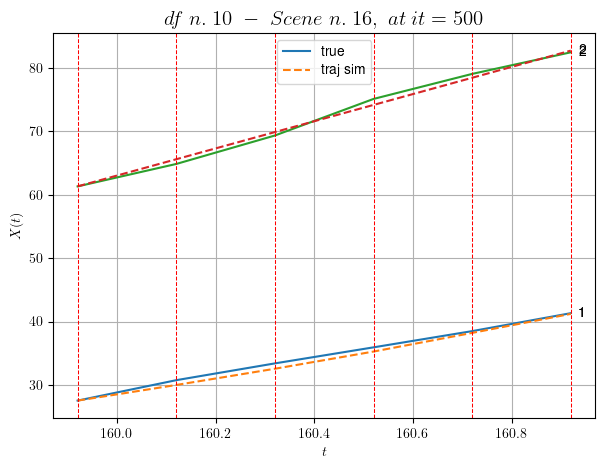

        For scene 16/74
        * use LR_NN=0.0001 with err=13.096159583991577 at it=24
        * v0_scn_mean = 21.77152514229392
        * MAE = 0.32738182613609534



df n.10, scene n.17/74
    We have 4 time intervals inside [182.72,183.52]
            - Time interval n.0: [182.72, 182.92]
                * y_true: [22.96029399]
                * v_ann: [25.97953987121582, 22.502260179114707]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [182.92, 183.12]
                * y_true: [25.95047007]
                * v_ann: [25.455747604370117, 22.502260179114707]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [183.12, 183.32]
                * y_true: [25.46062236]
                * v_ann: [24.83553123474121, 22.502260179114707]

-------------------------------------------------------------------------------------

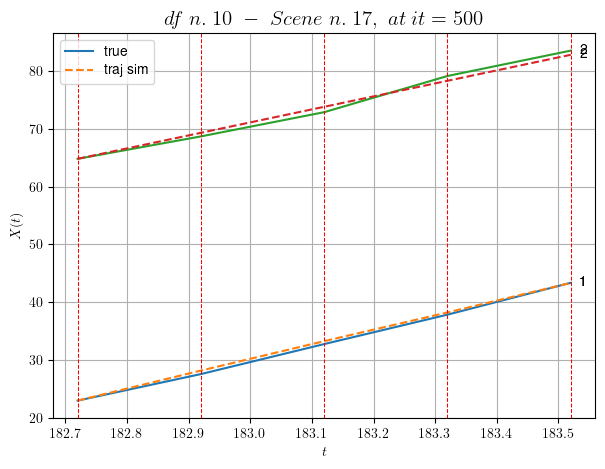

        For scene 17/74
        * use LR_NN=1e-05 with err=6.20926373215284 at it=24
        * v0_scn_mean = 22.802169771892544
        * MAE = 0.2958105232005278



df n.10, scene n.18/74
    We have 6 time intervals inside [188.92,190.12]
            - Time interval n.0: [188.92, 189.12]
                * y_true: [25.11758737]
                * v_ann: [23.45760154724121, 27.06160992268717]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [189.12, 189.32]
                * y_true: [24.28121512]
                * v_ann: [23.85128402709961, 27.06160992268717]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [189.32, 189.52]
                * y_true: [24.90146436]
                * v_ann: [23.385473251342773, 27.06160992268717]

-------------------------------------------------------------------------------------------

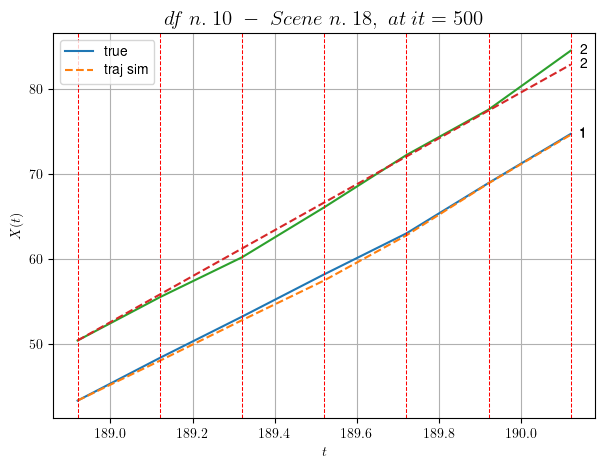

        For scene 18/74
        * use LR_NN=0.0005 with err=1.9882019881788606 at it=24
        * v0_scn_mean = 27.17914552575697
        * MAE = 0.32300734151202526



df n.10, scene n.19/74
    We have 9 time intervals inside [201.32,203.12]
            - Time interval n.0: [201.32, 201.52]
                * y_true: [24.52008638]
                * v_ann: [25.656085968017578, 26.320098161162182]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [201.52, 201.72]
                * y_true: [25.9301702]
                * v_ann: [26.223655700683594, 26.320098161162182]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [201.72, 201.92]
                * y_true: [29.26032799]
                * v_ann: [25.89268684387207, 26.320098161162182]

-------------------------------------------------------------------------------------

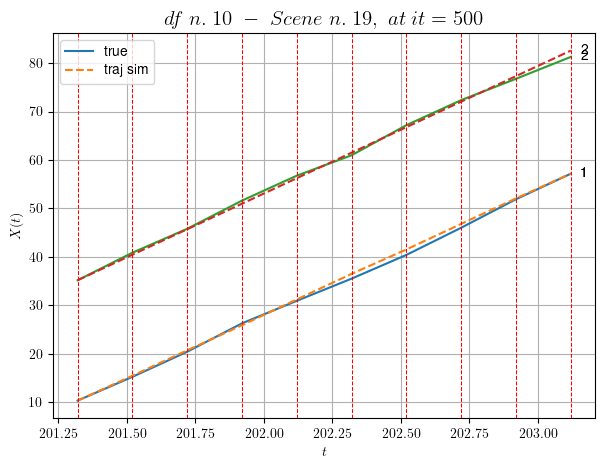

        For scene 19/74
        * use LR_NN=0.0005 with err=8.676487349595199 at it=24
        * v0_scn_mean = 26.46729423468731
        * MAE = 0.2734680738583036



df n.10, scene n.20/74
    We have 6 time intervals inside [209.32,210.52]
            - Time interval n.0: [209.32, 209.52]
                * y_true: [17.92044086]
                * v_ann: [14.363649368286133, 27.594562747147442]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [209.52, 209.72]
                * y_true: [18.1805462]
                * v_ann: [16.203433990478516, 27.594562747147442]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [209.72, 209.92]
                * y_true: [20.36072689]
                * v_ann: [18.22266960144043, 27.594562747147442]

---------------------------------------------------------------------------------------

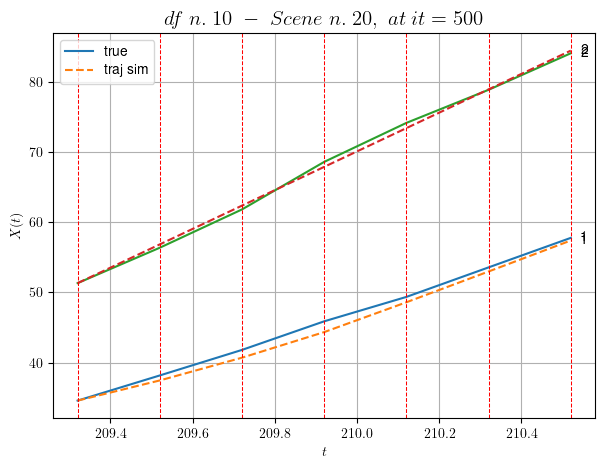

        For scene 20/74
        * use LR_NN=0.0005 with err=1.7765609125055382 at it=24
        * v0_scn_mean = 27.690780237242564
        * MAE = 0.3848620066961992



df n.10, scene n.21/74
    We have 3 time intervals inside [214.72,215.32]
            - Time interval n.0: [214.72, 214.92]
                * y_true: [24.40146441]
                * v_ann: [27.44854736328125, 28.84411723153517]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [214.92, 215.12]
                * y_true: [30.70222368]
                * v_ann: [32.44797134399414, 28.84411723153517]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.12, 215.32]
                * y_true: [32.35284791]
                * v_ann: [27.196876525878906, 28.84411723153517]

----------------------------------------------------------------------------------------

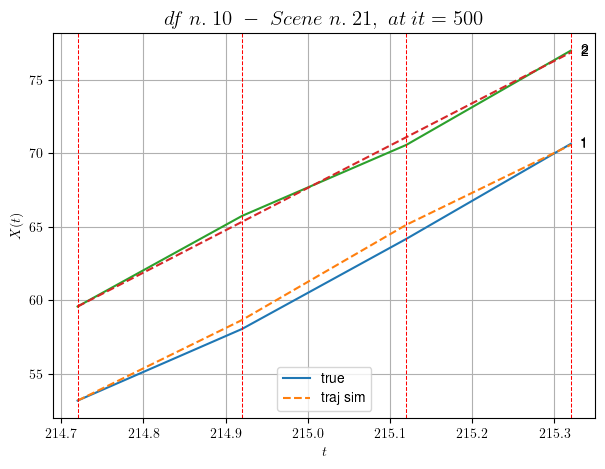

        For scene 21/74
        * use LR_NN=0.0001 with err=0.30188312976416226 at it=24
        * v0_scn_mean = 28.890352542264704
        * MAE = 0.18974808715909958



df n.10, scene n.22/74
    We have 6 time intervals inside [225.52,226.72]
            - Time interval n.0: [225.52, 225.72]
                * y_true: [21.78221563]
                * v_ann: [19.971250534057617, 28.699883785023637]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.72, 225.92]
                * y_true: [26.53150038]
                * v_ann: [20.96337890625, 28.699883785023637]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.92, 226.12]
                * y_true: [24.06160729]
                * v_ann: [22.129304885864258, 28.699883785023637]

-------------------------------------------------------------------------------------

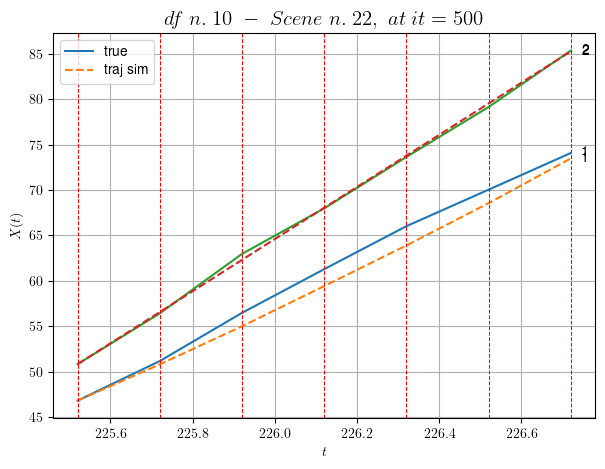

        For scene 22/74
        * use LR_NN=0.0001 with err=5.866679786498162 at it=24
        * v0_scn_mean = 28.75188843361281
        * MAE = 0.9626038295802392



df n.10, scene n.23/74
    We have 2 time intervals inside [235.52,235.92]
            - Time interval n.0: [235.52, 235.72]
                * y_true: [29.10171425]
                * v_ann: [24.397846221923828, 26.569531373914693]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [235.72, 235.92]
                * y_true: [19.25133961]
                * v_ann: [24.088647842407227, 26.569531373914693]

----------------------------------------------------------------------------------------------------
    * err= 0.1628056178812728
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.0001827002683590928


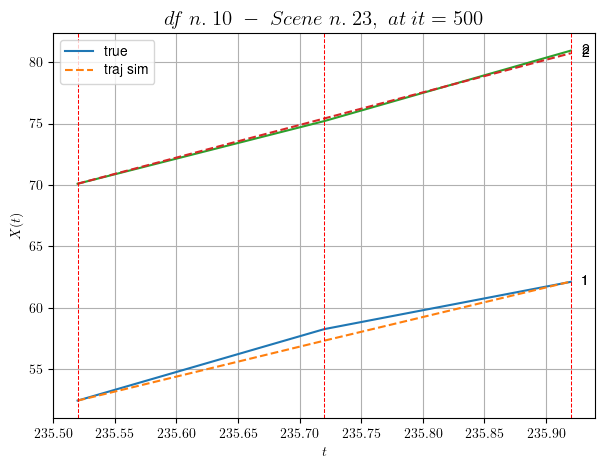

        For scene 23/74
        * use LR_NN=0.0001 with err=0.5148517388706447 at it=24
        * v0_scn_mean = 26.706750118931353
        * MAE = 0.16163334786963718



df n.10, scene n.24/74
    We have 4 time intervals inside [264.12,264.92]
            - Time interval n.0: [264.12, 264.32]
                * y_true: [13.05791248]
                * v_ann: [19.048349380493164, 23.45229191089349]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [264.32, 264.52]
                * y_true: [24.93096209]
                * v_ann: [20.956701278686523, 23.45229191089349]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [264.52, 264.72]
                * y_true: [24.31109264]
                * v_ann: [20.241945266723633, 23.45229191089349]

-------------------------------------------------------------------------------------

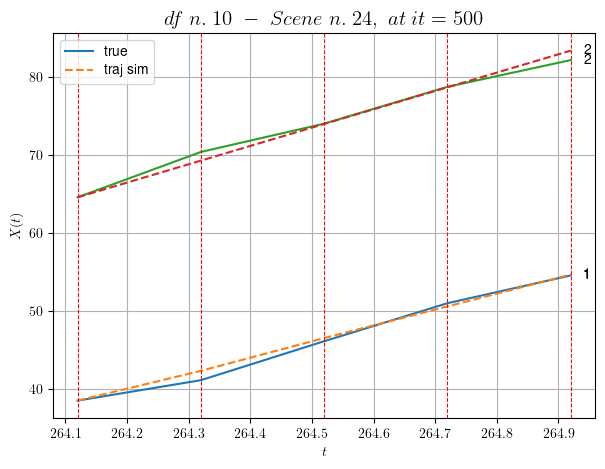

        For scene 24/74
        * use LR_NN=5e-05 with err=6.501906749898194 at it=24
        * v0_scn_mean = 23.714200234407553
        * MAE = 0.44696736433564616



df n.10, scene n.25/74
    We have 6 time intervals inside [275.92,277.12]
            - Time interval n.0: [275.92, 276.12]
                * y_true: [3.81567404]
                * v_ann: [16.513362884521484, 19.05141022652587]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [276.12, 276.32]
                * y_true: [18.48916658]
                * v_ann: [14.409329414367676, 19.05141022652587]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [276.32, 276.52]
                * y_true: [18.87049839]
                * v_ann: [16.878496170043945, 19.05141022652587]

----------------------------------------------------------------------------------------

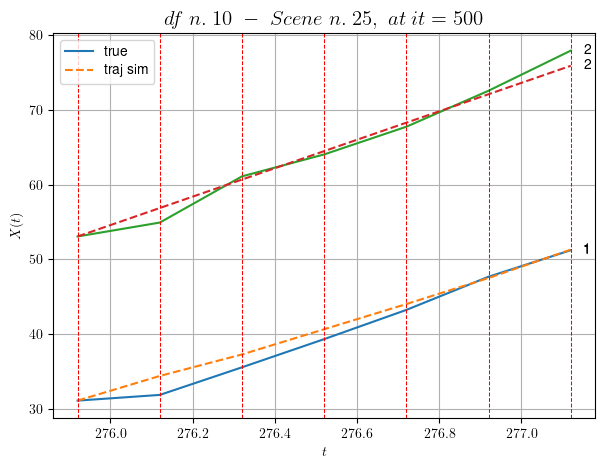

        For scene 25/74
        * use LR_NN=0.0005 with err=29.291661974206303 at it=24
        * v0_scn_mean = 19.489353817381488
        * MAE = 1.1605611424461157



df n.10, scene n.26/74
    We have 2 time intervals inside [279.52,279.92]
            - Time interval n.0: [279.52, 279.72]
                * y_true: [16.95098752]
                * v_ann: [22.2330265045166, 18.48544509200714]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [279.72, 279.92]
                * y_true: [26.95183076]
                * v_ann: [21.54166603088379, 18.48544509200714]

----------------------------------------------------------------------------------------------------
    * err= 0.3212616444499406
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 2.8164921050954916e-07


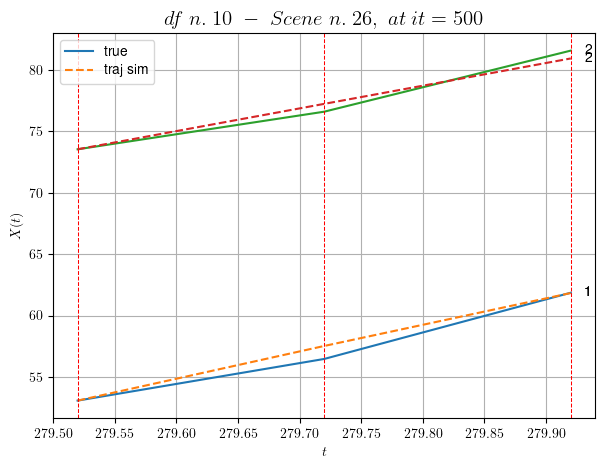

        For scene 26/74
        * use LR_NN=5e-05 with err=4.267843141158494 at it=24
        * v0_scn_mean = 18.94602728823743
        * MAE = 0.3118783986085457



df n.10, scene n.27/74
    We have 4 time intervals inside [282.72,283.52]
            - Time interval n.0: [282.72, 282.92]
                * y_true: [12.52227184]
                * v_ann: [10.85029125213623, 23.180355370996622]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [282.92, 283.12]
                * y_true: [6.92983149]
                * v_ann: [9.867395401000977, 23.180355370996622]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [283.12, 283.32]
                * y_true: [15.03956301]
                * v_ann: [11.651342391967773, 23.180355370996622]

-----------------------------------------------------------------------------------------

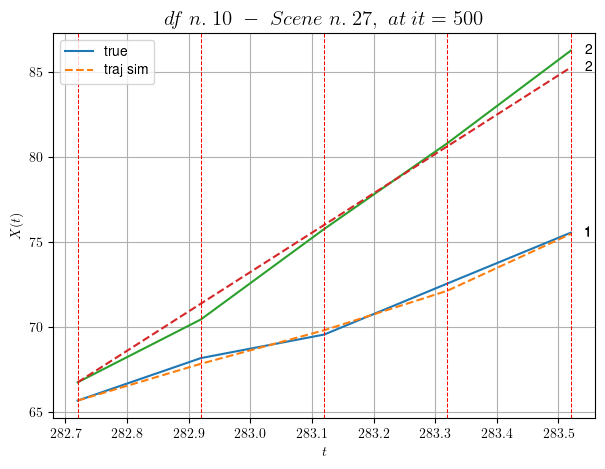

        For scene 27/74
        * use LR_NN=0.005 with err=5.177038366139367 at it=24
        * v0_scn_mean = 23.453141156105396
        * MAE = 0.22858628818851473



df n.10, scene n.28/74
    We have 10 time intervals inside [298.32,300.32]
            - Time interval n.0: [298.32, 298.52]
                * y_true: [21.88077662]
                * v_ann: [20.416196823120117, 14.578703915530495]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [298.52, 298.72]
                * y_true: [11.89969318]
                * v_ann: [14.225111961364746, 14.578703915530495]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [298.72, 298.92]
                * y_true: [4.14685101]
                * v_ann: [14.009329795837402, 14.578703915530495]

------------------------------------------------------------------------------------

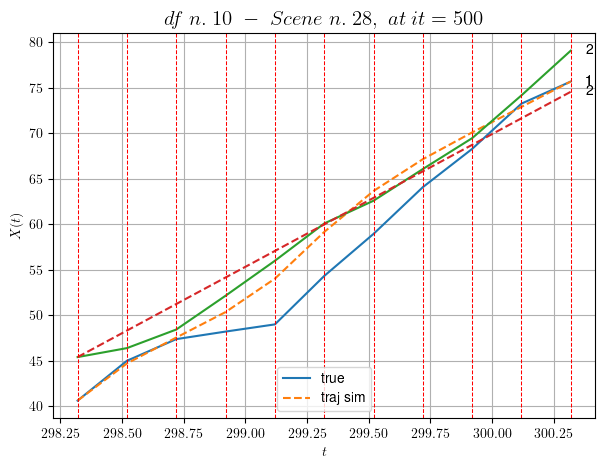

        For scene 28/74
        * use LR_NN=0.0005 with err=156.23957353993558 at it=24
        * v0_scn_mean = 15.195555758791583
        * MAE = 6.028147314078119



df n.10, scene n.29/74
    We have 4 time intervals inside [303.52,304.32]
            - Time interval n.0: [303.52, 303.72]
                * y_true: [26.22226166]
                * v_ann: [27.69246482849121, 8.561224404570373]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [303.72, 303.92]
                * y_true: [20.65203911]
                * v_ann: [19.83392906188965, 8.561224404570373]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [303.92, 304.12]
                * y_true: [18.91793967]
                * v_ann: [14.943632125854492, 8.561224404570373]

-----------------------------------------------------------------------------------------

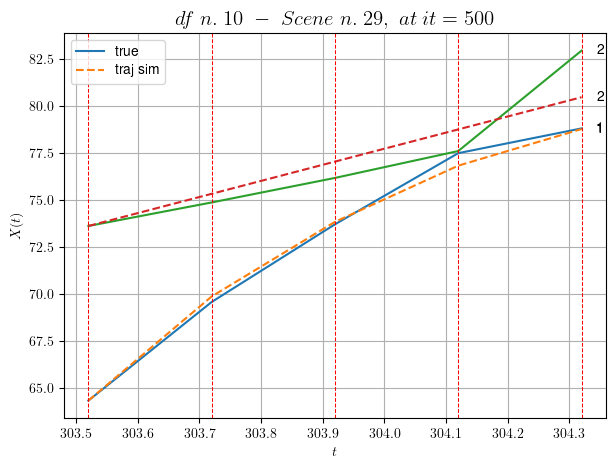

        For scene 29/74
        * use LR_NN=0.001 with err=53.02133102986684 at it=24
        * v0_scn_mean = 9.418775428223885
        * MAE = 0.8593337099397292



df n.10, scene n.30/74
    We have 2 time intervals inside [305.72,306.12]
    * err= 0.47799344645918
    * Learning rate NN = 0.004049999639391899
    * diff = 2.2490507911587798e-07


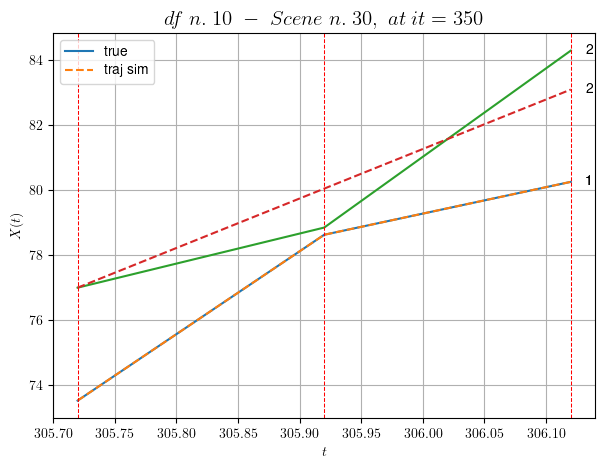

        For scene 30/74
        * use LR_NN=0.005 with err=6.572527678523572 at it=24
        * v0_scn_mean = 16.07268675943605
        * MAE = 0.430194411789629



df n.10, scene n.31/74
    We have 4 time intervals inside [311.32,312.12]
            - Time interval n.0: [311.32, 311.52]
                * y_true: [24.08137325]
                * v_ann: [24.095060348510742, 17.69185162158464]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [311.52, 311.72]
                * y_true: [20.04132559]
                * v_ann: [21.776453018188477, 17.69185162158464]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [311.72, 311.92]
                * y_true: [20.48155914]
                * v_ann: [22.116901397705078, 17.69185162158464]

------------------------------------------------------------------------------------------

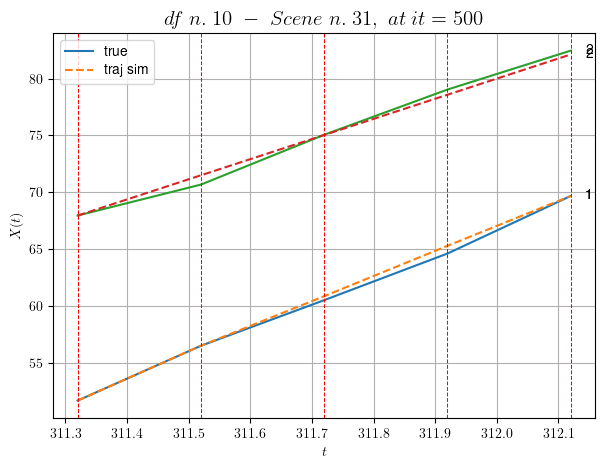

        For scene 31/74
        * use LR_NN=5e-05 with err=17.391099758667316 at it=24
        * v0_scn_mean = 18.184177556627176
        * MAE = 0.14759548431343247



df n.10, scene n.32/74
    We have 4 time intervals inside [316.12,316.92]
            - Time interval n.0: [316.12, 316.32]
                * y_true: [5.39037804]
                * v_ann: [5.125096797943115, 23.40156520227089]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [316.32, 316.52]
                * y_true: [5.50039632]
                * v_ann: [6.007135391235352, 23.40156520227089]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [316.52, 316.72]
                * y_true: [7.48057532]
                * v_ann: [7.220076560974121, 23.40156520227089]

--------------------------------------------------------------------------------------------

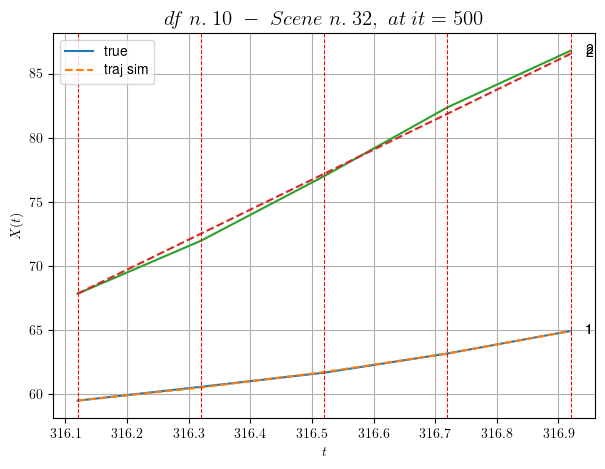

        For scene 32/74
        * use LR_NN=0.001 with err=4.90459951907666 at it=24
        * v0_scn_mean = 23.66550259412989
        * MAE = 0.05792557385728224



df n.10, scene n.33/74
    We have 5 time intervals inside [325.92,326.92]
            - Time interval n.0: [325.92, 326.12]
                * y_true: [14.52079076]
                * v_ann: [12.9613037109375, 22.916468107417952]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [326.12, 326.32]
                * y_true: [11.29068818]
                * v_ann: [13.15608024597168, 22.916468107417952]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [326.32, 326.52]
                * y_true: [16.66109868]
                * v_ann: [14.17164421081543, 22.916468107417952]

------------------------------------------------------------------------------------------

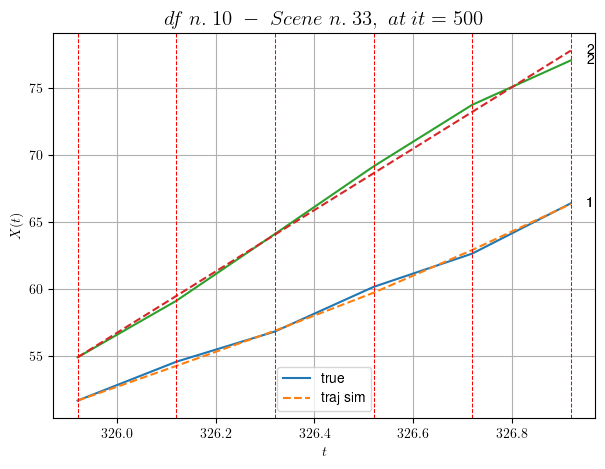

        For scene 33/74
        * use LR_NN=0.001 with err=10.430016281702175 at it=24
        * v0_scn_mean = 23.199809383064856
        * MAE = 0.1314599986575603



df n.10, scene n.34/74
    We have 3 time intervals inside [328.72,329.32]
            - Time interval n.0: [328.72, 328.92]
                * y_true: [18.6911305]
                * v_ann: [23.51988983154297, 9.9178151383506]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [328.92, 329.12]
                * y_true: [19.13132794]
                * v_ann: [21.97831153869629, 9.9178151383506]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [329.12, 329.32]
                * y_true: [28.94236374]
                * v_ann: [20.021203994750977, 9.9178151383506]

------------------------------------------------------------------------------------------------

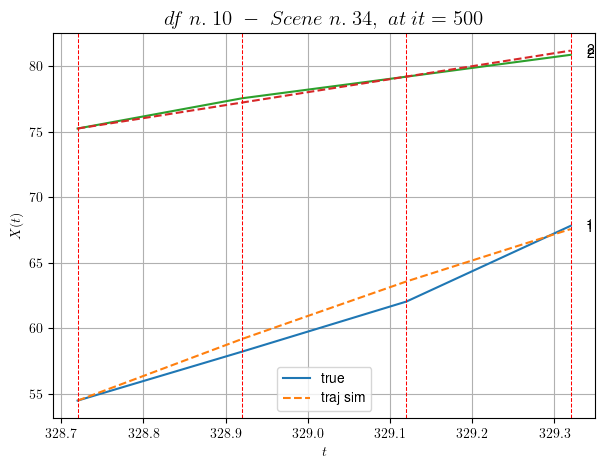

        For scene 34/74
        * use LR_NN=5e-05 with err=29.425524055672927 at it=24
        * v0_scn_mean = 10.721102532663592
        * MAE = 0.4450741491473593



df n.10, scene n.35/74
    We have 3 time intervals inside [335.52,336.12]
            - Time interval n.0: [335.52, 335.72]
                * y_true: [16.28027901]
                * v_ann: [17.434642791748047, 14.651600250952871]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [335.72, 335.92]
                * y_true: [19.62042777]
                * v_ann: [17.027936935424805, 14.651600250952871]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [335.92, 336.12]
                * y_true: [15.680409]
                * v_ann: [17.089275360107422, 14.651600250952871]

--------------------------------------------------------------------------------------

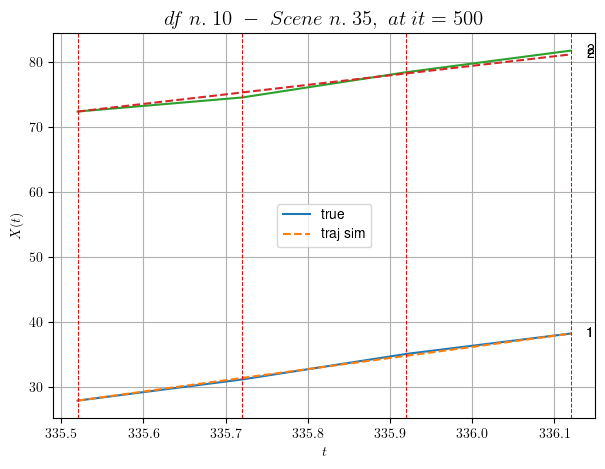

        For scene 35/74
        * use LR_NN=1e-05 with err=15.591542932230805 at it=24
        * v0_scn_mean = 15.2655362407979
        * MAE = 0.12180926296576045



df n.10, scene n.36/74
    We have 4 time intervals inside [401.52,402.32]
            - Time interval n.0: [401.52, 401.72]
                * y_true: [28.00176783]
                * v_ann: [25.645069122314453, 22.732620950386863]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [401.72, 401.92]
                * y_true: [25.04184799]
                * v_ann: [25.03447914123535, 22.732620950386863]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [401.92, 402.12]
                * y_true: [25.95226491]
                * v_ann: [25.183074951171875, 22.732620950386863]

--------------------------------------------------------------------------------------

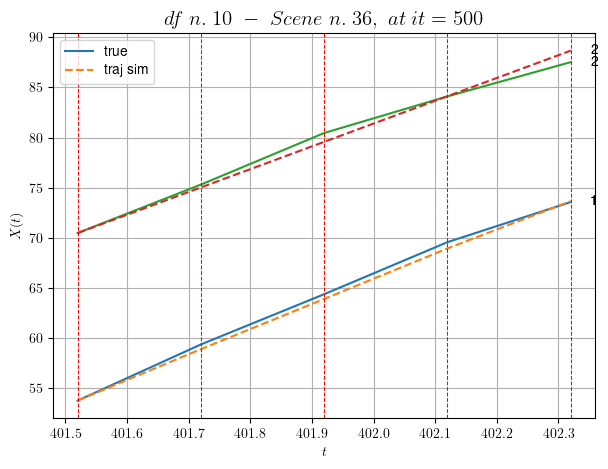

        For scene 36/74
        * use LR_NN=5e-05 with err=7.366590737539364 at it=24
        * v0_scn_mean = 23.02331611231574
        * MAE = 0.30198905796857756



df n.10, scene n.37/74
    We have 8 time intervals inside [403.52,405.12]
            - Time interval n.0: [403.52, 403.72]
                * y_true: [5.13505057]
                * v_ann: [11.152175903320312, 21.916705677642202]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [403.72, 403.92]
                * y_true: [5.15005248]
                * v_ann: [12.18175983428955, 21.916705677642202]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [403.92, 404.12]
                * y_true: [4.87005665]
                * v_ann: [12.502006530761719, 21.916705677642202]

-----------------------------------------------------------------------------------------

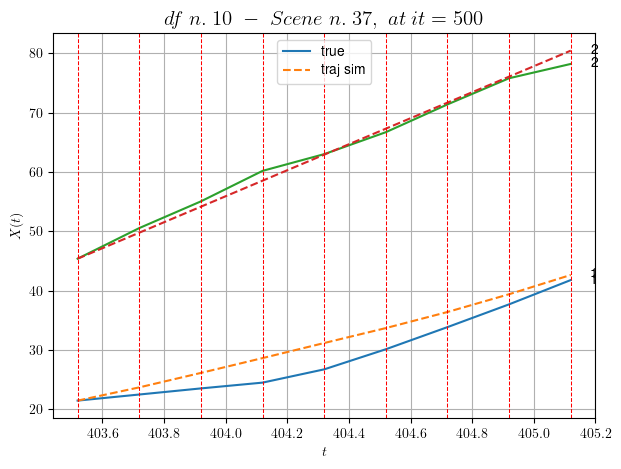

        For scene 37/74
        * use LR_NN=0.0005 with err=34.78007417134879 at it=24
        * v0_scn_mean = 22.240037450474897
        * MAE = 2.5721356409334613



df n.10, scene n.38/74
    We have 2 time intervals inside [410.32,410.72]
    * err= 0.03081229721070136
    * Learning rate NN = 0.00040499999886378646
    * diff = 1.6901066049457292e-07


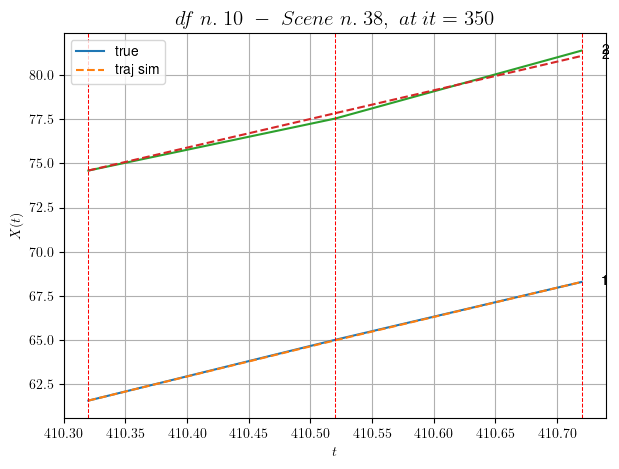

        For scene 38/74
        * use LR_NN=0.0005 with err=6.056004217184858 at it=24
        * v0_scn_mean = 17.034320641352682
        * MAE = 0.027761027415077844



df n.10, scene n.39/74
    We have 4 time intervals inside [413.32,414.12]
            - Time interval n.0: [413.32, 413.52]
                * y_true: [8.78543594]
                * v_ann: [7.3888468742370605, 21.811424999012385]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [413.52, 413.72]
                * y_true: [10.7755528]
                * v_ann: [8.331233024597168, 21.811424999012385]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [413.72, 413.92]
                * y_true: [8.5554699]
                * v_ann: [9.048028945922852, 21.811424999012385]

----------------------------------------------------------------------------------------

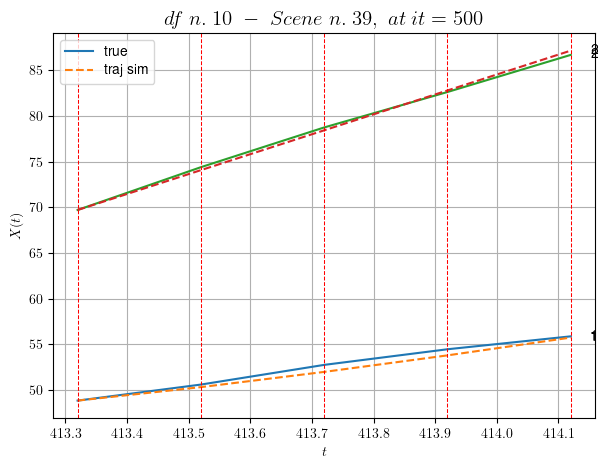

        For scene 39/74
        * use LR_NN=1e-05 with err=8.618033978897927 at it=24
        * v0_scn_mean = 22.138967998989713
        * MAE = 0.11903058412544189



df n.10, scene n.40/74
    We have 5 time intervals inside [414.72,415.72]
            - Time interval n.0: [414.72, 414.92]
                * y_true: [19.31122214]
                * v_ann: [6.093041896820068, 13.666087163340974]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [414.92, 415.12]
                * y_true: [27.71202987]
                * v_ann: [8.129179000854492, 13.666087163340974]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [415.12, 415.32]
                * y_true: [11.45320706]
                * v_ann: [-0.0362214632332325, 13.666087163340974]

-------------------------------------------------------------------------------------

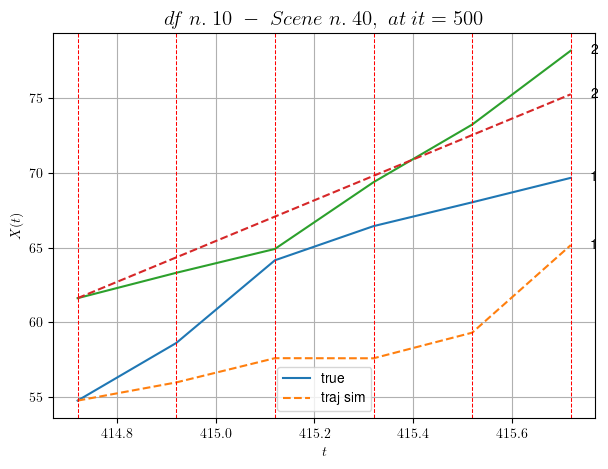

        For scene 40/74
        * use LR_NN=0.01 with err=44.903534975051485 at it=24
        * v0_scn_mean = 14.319443676682724
        * MAE = 1.634609132940553



df n.10, scene n.41/74
    We have 2 time intervals inside [438.12,438.52]
            - Time interval n.0: [438.12, 438.32]
                * y_true: [18.11175084]
                * v_ann: [16.500324249267578, 22.86952706359366]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [438.32, 438.52]
                * y_true: [20.13213509]
                * v_ann: [21.414518356323242, 22.86952706359366]

----------------------------------------------------------------------------------------------------
    * err= 0.08755975646136038
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.0002290909065083696


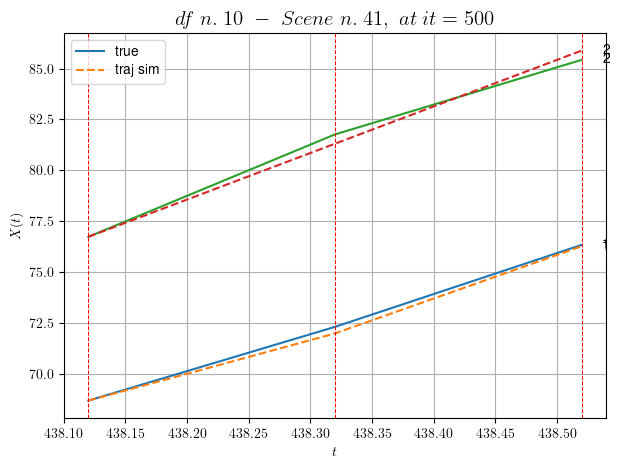

        For scene 41/74
        * use LR_NN=0.0005 with err=1.9846220230289842 at it=24
        * v0_scn_mean = 23.154745980994093
        * MAE = 0.08755975646136038



df n.10, scene n.42/74
    We have 8 time intervals inside [450.52,452.12]
            - Time interval n.0: [450.52, 450.72]
                * y_true: [19.74053482]
                * v_ann: [-0.013713502325117588, 28.14739698832753]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [450.72, 450.92]
                * y_true: [18.37058864]
                * v_ann: [0.3988179564476013, 28.14739698832753]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [450.92, 451.12]
                * y_true: [14.15053763]
                * v_ann: [2.131211519241333, 28.14739698832753]

-----------------------------------------------------------------------------------

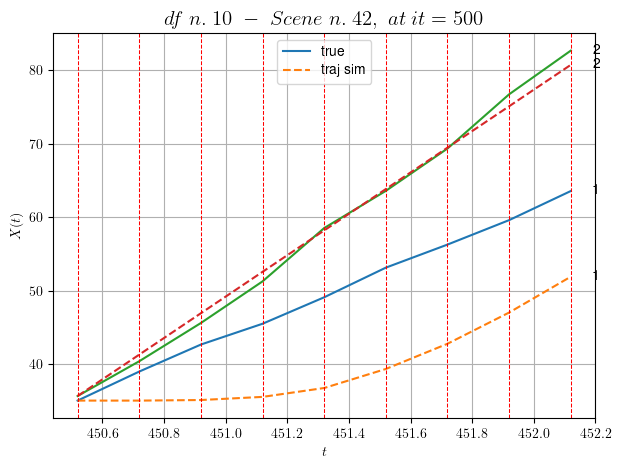

        For scene 42/74
        * use LR_NN=0.001 with err=7.464225726407935 at it=24
        * v0_scn_mean = 28.221501108780775
        * MAE = 39.09877337521718



df n.10, scene n.43/74
    We have 6 time intervals inside [473.52,474.72]
            - Time interval n.0: [473.52, 473.72]
                * y_true: [13.95954906]
                * v_ann: [0.0004178359522484243, 14.20936957568644]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [473.72, 473.92]
                * y_true: [2.95022692]
                * v_ann: [-0.015652311965823174, 14.20936957568644]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [473.92, 474.12]
                * y_true: [4.0903274]
                * v_ann: [-4.475577952689491e-06, 14.20936957568644]

----------------------------------------------------------------------------------

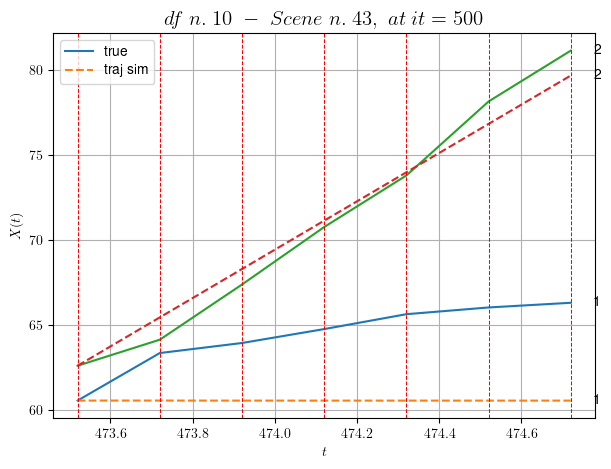

        For scene 43/74
        * use LR_NN=0.005 with err=60.96482046263685 at it=24
        * v0_scn_mean = 14.84099479253804
        * MAE = 9.372996729579926



df n.10, scene n.44/74
    We have 5 time intervals inside [475.32,476.32]
    * err= 5.067173959099505
    * Learning rate NN = 5.9048988987342454e-06
    * diff = 5.394223769883411e-07


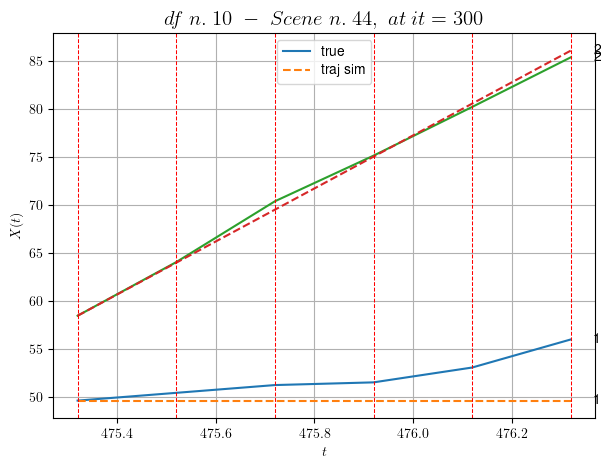

        For scene 44/74
        * use LR_NN=1e-05 with err=1.5051743401545785 at it=24
        * v0_scn_mean = 27.789124935588813
        * MAE = 5.067173959099505



df n.10, scene n.45/74
    We have 7 time intervals inside [481.32,482.72]
            - Time interval n.0: [481.32, 481.52]
                * y_true: [17.06089731]
                * v_ann: [-1.3390786079980899e-05, 12.339647994143354]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [481.52, 481.72]
                * y_true: [23.79147598]
                * v_ann: [-1.3552298696595244e-05, 12.339647994143354]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [481.72, 481.92]
                * y_true: [3.38203106]
                * v_ann: [-0.061932649463415146, 12.339647994143354]

-------------------------------------------------------------------------

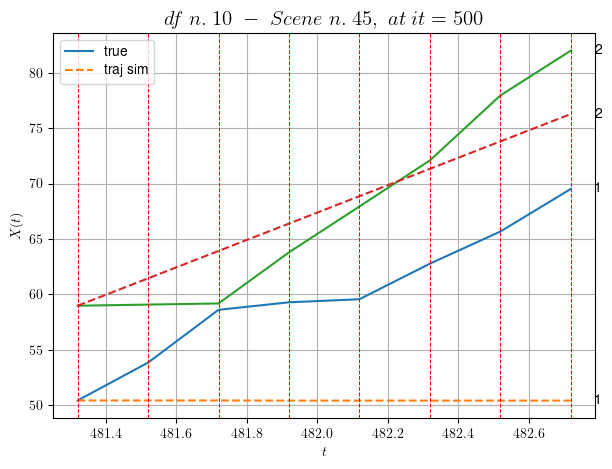

        For scene 45/74
        * use LR_NN=0.0005 with err=96.02454538346481 at it=24
        * v0_scn_mean = 13.046062074242403
        * MAE = 66.26428016267657



df n.10, scene n.46/74
    We have 14 time intervals inside [496.52,499.32]
    * err= 35.77540690704832
    * Learning rate NN = 4.923851884086616e-05
    * diff = 2.0957900659368534e-07


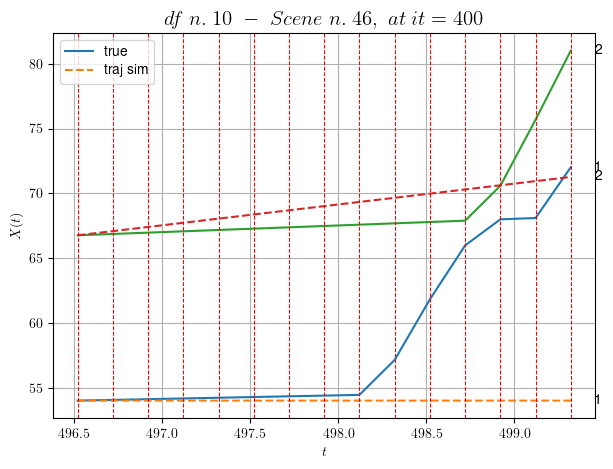

        For scene 46/74
        * use LR_NN=0.0005 with err=1073.3933890159788 at it=24
        * v0_scn_mean = 3.0257113966751956
        * MAE = 35.528104118807384



df n.10, scene n.47/74
    We have 8 time intervals inside [502.92,504.52]
    * err= 37.658436837051774
    * Learning rate NN = 2.824294460879173e-05
    * diff = 1.348774887333093e-07


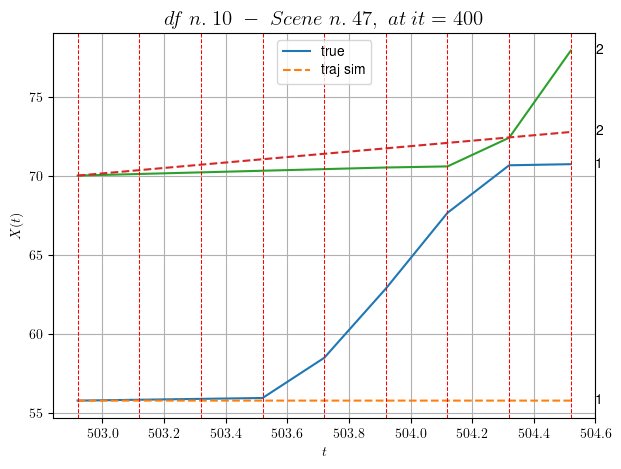

        For scene 47/74
        * use LR_NN=0.0001 with err=358.74817953368984 at it=24
        * v0_scn_mean = 3.140589139874028
        * MAE = 37.562286197590645



df n.10, scene n.48/74
    We have 6 time intervals inside [541.32,542.52]
            - Time interval n.0: [541.32, 541.52]
                * y_true: [18.55124697]
                * v_ann: [21.858503341674805, 5.721147250846534]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [541.52, 541.72]
                * y_true: [14.20106309]
                * v_ann: [17.306062698364258, 5.721147250846534]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [541.72, 541.92]
                * y_true: [25.10212309]
                * v_ann: [14.982208251953125, 5.721147250846534]

---------------------------------------------------------------------------------------

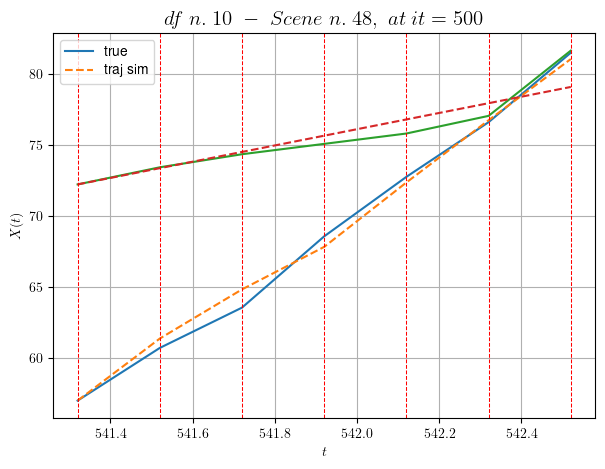

        For scene 48/74
        * use LR_NN=0.001 with err=155.71539175846524 at it=24
        * v0_scn_mean = 6.6923013606272725
        * MAE = 0.8356705125101282



df n.10, scene n.49/74
    We have 5 time intervals inside [569.72,570.72]
            - Time interval n.0: [569.72, 569.92]
                * y_true: [21.60177945]
                * v_ann: [19.391986846923828, 10.43973796346797]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [569.92, 570.12]
                * y_true: [16.8515553]
                * v_ann: [21.60006332397461, 10.43973796346797]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [570.12, 570.32]
                * y_true: [21.85224833]
                * v_ann: [20.67439842224121, 10.43973796346797]

------------------------------------------------------------------------------------------

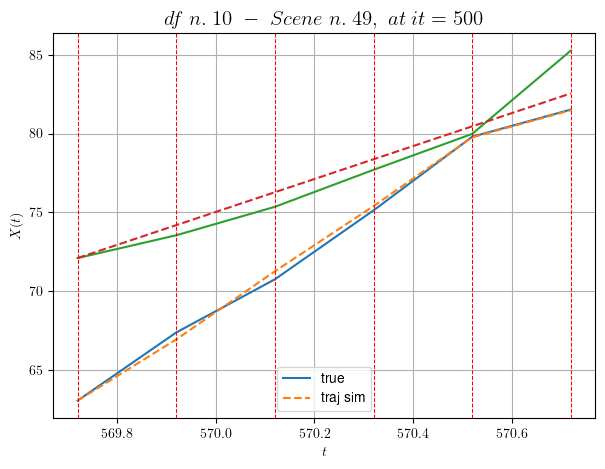

        For scene 49/74
        * use LR_NN=0.001 with err=67.55672467832235 at it=24
        * v0_scn_mean = 11.222148444779524
        * MAE = 0.8201083224594405



df n.10, scene n.50/74
    We have 3 time intervals inside [577.52,578.12]
            - Time interval n.0: [577.52, 577.72]
                * y_true: [27.0001475]
                * v_ann: [22.08477210998535, 23.515861006610173]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [577.72, 577.92]
                * y_true: [16.65014335]
                * v_ann: [23.82020378112793, 23.515861006610173]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [577.92, 578.12]
                * y_true: [23.40028509]
                * v_ann: [21.304676055908203, 23.515861006610173]

----------------------------------------------------------------------------------------

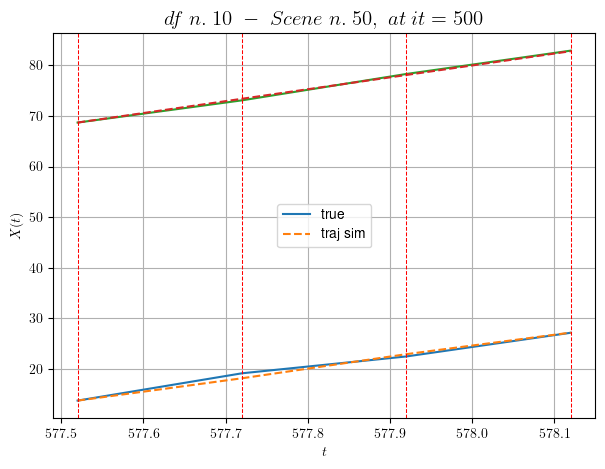

        For scene 50/74
        * use LR_NN=1e-05 with err=2.9484966225704334 at it=24
        * v0_scn_mean = 23.775226566296222
        * MAE = 0.16460765686982076



df n.10, scene n.51/74
    We have 8 time intervals inside [578.92,580.52]
            - Time interval n.0: [578.92, 579.12]
                * y_true: [21.44058363]
                * v_ann: [19.63895034790039, 23.72801795429845]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [579.12, 579.32]
                * y_true: [24.12080869]
                * v_ann: [20.125934600830078, 23.72801795429845]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [579.32, 579.52]
                * y_true: [19.95083625]
                * v_ann: [21.46556282043457, 23.72801795429845]

----------------------------------------------------------------------------------------

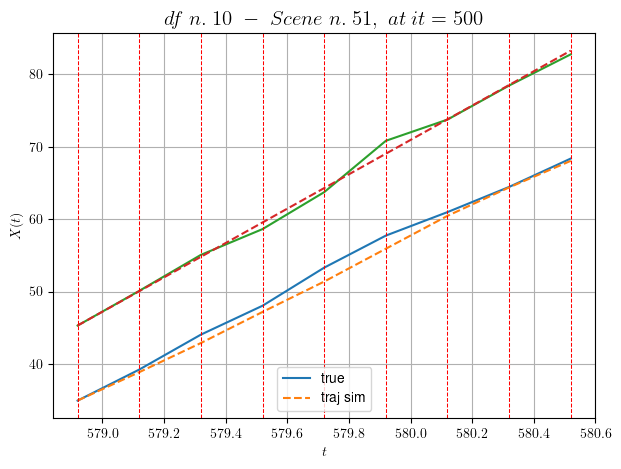

        For scene 51/74
        * use LR_NN=0.001 with err=19.43657583018847 at it=24
        * v0_scn_mean = 23.978897236080105
        * MAE = 0.7907928998438825



df n.10, scene n.52/74
    We have 2 time intervals inside [25.72,26.12]
            - Time interval n.0: [25.72, 25.92]
                * y_true: [19.85100065 23.2716    ]
                * v_ann: [23.384878158569336, 23.89606285095215, 19.708783583228207]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [25.92, 26.12]
                * y_true: [21.59125574 29.46240542]
                * v_ann: [23.19729995727539, 23.459461212158203, 19.708783583228207]

----------------------------------------------------------------------------------------------------
    * err= 0.31934827320682474
    * Learning rate NN = 7.289998757187277e-05
    * diff = 0.002874687272808041


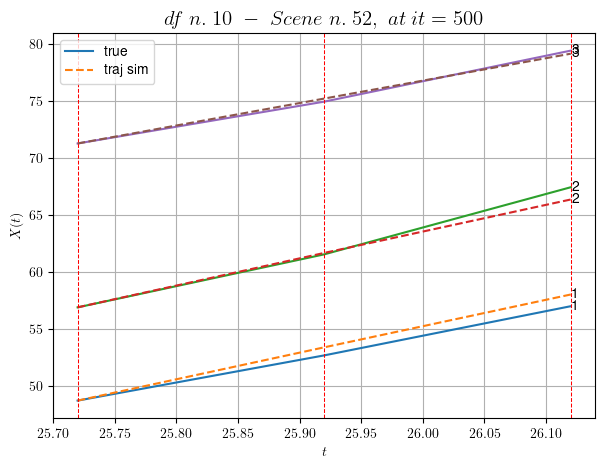

        For scene 52/74
        * use LR_NN=0.0001 with err=2.6762624319411206 at it=24
        * v0_scn_mean = 20.326256106181162
        * MAE = 0.28697904390368595



df n.10, scene n.53/74
    We have 7 time intervals inside [71.72,73.12]
            - Time interval n.0: [71.72, 71.92]
                * y_true: [25.44045996  0.68637625]
                * v_ann: [15.254847526550293, 16.97393035888672, 24.69618010022442]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [71.92, 72.12]
                * y_true: [ 7.65710886 16.8398502 ]
                * v_ann: [11.957738876342773, 20.223880767822266, 24.69618010022442]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.12, 72.32]
                * y_true: [ 0.68637625 22.9307169 ]
                * v_ann: [12.87546443939209, 19.95827865600586, 24.69618010022442]



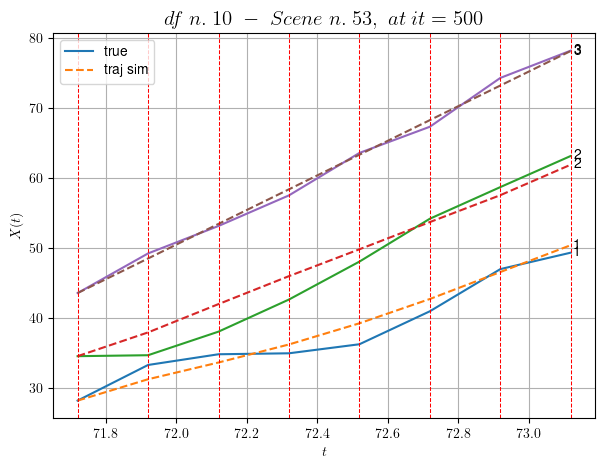

        For scene 53/74
        * use LR_NN=0.0005 with err=11.88411935297963 at it=24
        * v0_scn_mean = 25.014409056080943
        * MAE = 2.7143232094059377



df n.10, scene n.54/74
    We have 3 time intervals inside [120.92,121.52]
            - Time interval n.0: [120.92, 121.12]
                * y_true: [2.40007998 4.01291198]
                * v_ann: [7.291210174560547, 7.154763698577881, 19.87543626344988]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.12, 121.32]
                * y_true: [3.94779745 3.96114827]
                * v_ann: [7.276120185852051, 7.5128254890441895, 19.87543626344988]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.32, 121.52]
                * y_true: [24.74097787  3.92663913]
                * v_ann: [7.230810642242432, 7.749060153961182, 19.87543626344988]



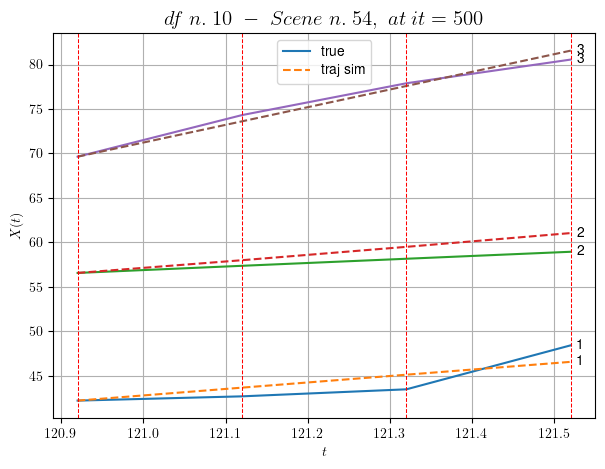

        For scene 54/74
        * use LR_NN=5e-05 with err=6.758445629575847 at it=24
        * v0_scn_mean = 20.48290963307194
        * MAE = 1.2761067694538333



df n.10, scene n.55/74
    We have 3 time intervals inside [122.12,122.72]
            - Time interval n.0: [122.12, 122.32]
                * y_true: [20.84138029  3.6661027 ]
                * v_ann: [9.435110092163086, 9.945648193359375, 27.527679985064857]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [122.32, 122.52]
                * y_true: [11.80149783  9.92593948]
                * v_ann: [11.430508613586426, 10.45256233215332, 27.527679985064857]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [122.52, 122.72]
                * y_true: [ 5.61571017 11.00089954]
                * v_ann: [11.472195625305176, 9.822829246520996, 27.527679985064

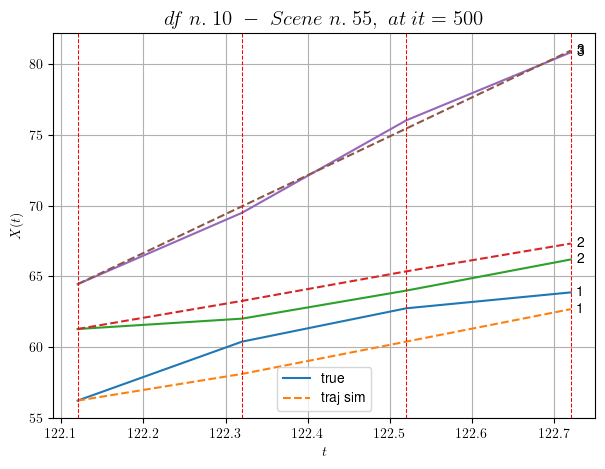

        For scene 55/74
        * use LR_NN=0.005 with err=2.4939725082264137 at it=24
        * v0_scn_mean = 27.67601907495927
        * MAE = 1.4446707530341587



df n.10, scene n.56/74
    We have 3 time intervals inside [194.52,195.12]
            - Time interval n.0: [194.52, 194.72]
                * y_true: [18.69097642 14.73135237]
                * v_ann: [22.262670516967773, 20.357126235961914, 15.385046662986701]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [194.72, 194.92]
                * y_true: [17.84107996 20.91213867]
                * v_ann: [17.33565330505371, 18.36128807067871, 15.385046662986701]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [194.92, 195.12]
                * y_true: [20.95142105 24.20273885]
                * v_ann: [18.846391677856445, 18.991268157958984, 15.385046662

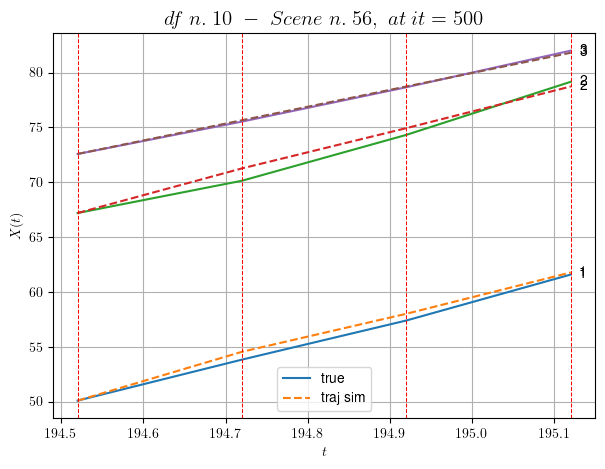

        For scene 56/74
        * use LR_NN=0.001 with err=14.26838269932012 at it=24
        * v0_scn_mean = 16.26194320702762
        * MAE = 0.23073695644019906



df n.10, scene n.57/74
    We have 8 time intervals inside [201.52,203.12]
            - Time interval n.0: [201.52, 201.72]
                * y_true: [45.67726396 25.9301702 ]
                * v_ann: [29.25126838684082, 29.712326049804688, 25.797423357466364]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [201.72, 201.92]
                * y_true: [22.15536429 29.26032799]
                * v_ann: [30.336240768432617, 32.9979362487793, 25.797423357466364]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [201.92, 202.12]
                * y_true: [30.43022185 23.25036083]
                * v_ann: [29.215801239013672, 29.841617584228516, 25.7974233574

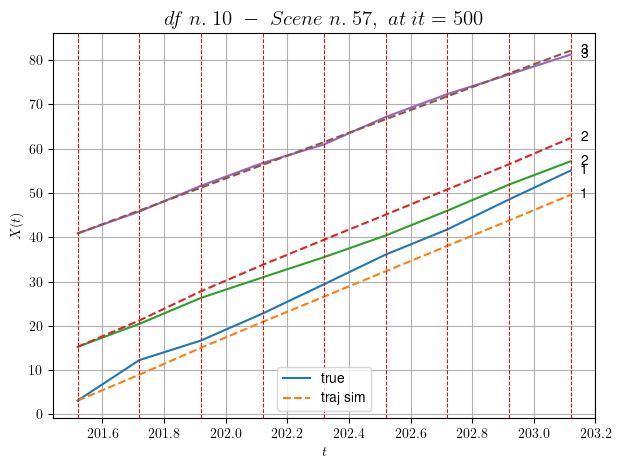

        For scene 57/74
        * use LR_NN=0.0005 with err=124.30286028801704 at it=24
        * v0_scn_mean = 26.049577767331904
        * MAE = 8.438580534893331



df n.10, scene n.58/74
    We have 2 time intervals inside [210.12,210.52]
            - Time interval n.0: [210.12, 210.32]
                * y_true: [23.65050773 21.02104774]
                * v_ann: [23.962120056152344, 22.973712921142578, 24.3828994232012]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [210.32, 210.52]
                * y_true: [27.53081175 21.02121012]
                * v_ann: [23.903671264648438, 22.696348190307617, 24.3828994232012]

----------------------------------------------------------------------------------------------------
    * err= 0.13070766279703339
    * Learning rate NN = 3.6449993785936385e-05
    * diff = 0.0020083629689118254


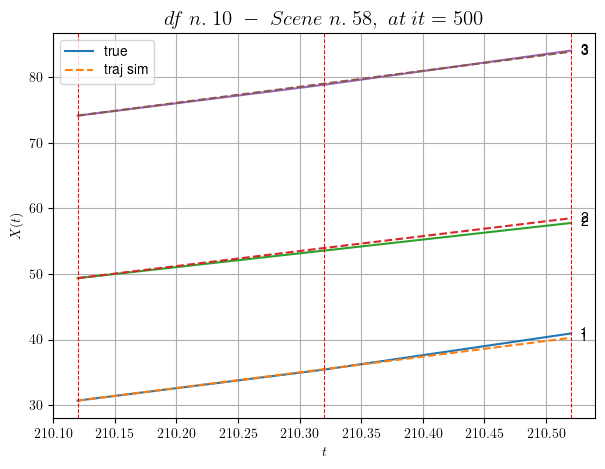

        For scene 58/74
        * use LR_NN=5e-05 with err=2.0275905093443316 at it=24
        * v0_scn_mean = 24.71992520561357
        * MAE = 0.1105004520272178



df n.10, scene n.59/74
    We have 3 time intervals inside [236.52,237.12]
            - Time interval n.0: [236.52, 236.72]
                * y_true: [22.75077388 14.36119092]
                * v_ann: [23.532001495361328, 22.014142990112305, 24.944260756133577]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [236.72, 236.92]
                * y_true: [21.51093715 22.77208028]
                * v_ann: [20.60951042175293, 21.04289436340332, 24.944260756133577]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [236.92, 237.12]
                * y_true: [26.0213192  23.10241688]
                * v_ann: [21.430110931396484, 21.376466751098633, 24.944260756

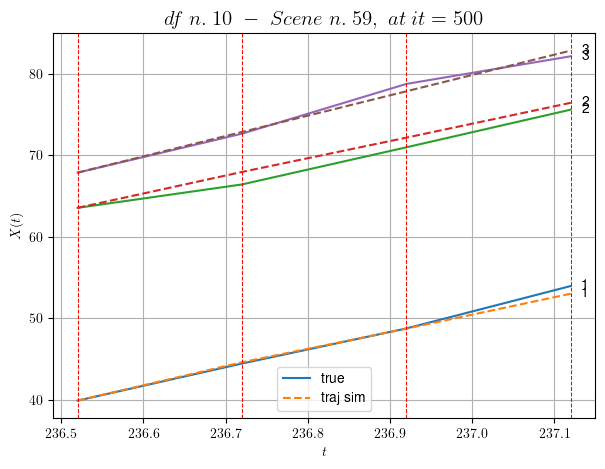

        For scene 59/74
        * use LR_NN=0.0005 with err=7.424560226621957 at it=24
        * v0_scn_mean = 25.247604883774052
        * MAE = 0.5380594236477868



df n.10, scene n.60/74
    We have 2 time intervals inside [237.72,238.12]
            - Time interval n.0: [237.72, 237.92]
                * y_true: [25.90146221 17.55123599]
                * v_ann: [21.587533950805664, 21.583742141723633, 25.832592439472933]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.92, 238.12]
                * y_true: [21.20141323 21.76181979]
                * v_ann: [21.624799728393555, 21.618619918823242, 25.832592439472933]

----------------------------------------------------------------------------------------------------
    * err= 0.30271504437285796
    * Learning rate NN = 0.00036449998151510954
    * diff = 0.00010243639232476731


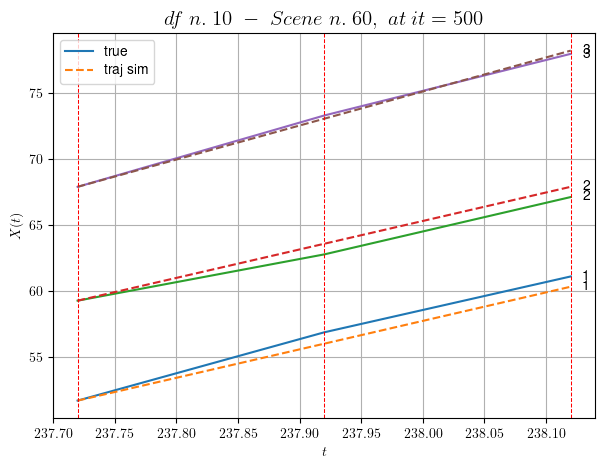

        For scene 60/74
        * use LR_NN=0.0005 with err=1.805895739614763 at it=24
        * v0_scn_mean = 26.08263670599705
        * MAE = 0.30271504437285796



df n.10, scene n.61/74
    We have 6 time intervals inside [317.32,318.52]
            - Time interval n.0: [317.32, 317.52]
                * y_true: [14.46061508  5.00523108]
                * v_ann: [10.279050827026367, 10.246342658996582, 5.959391366535926]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.52, 317.72]
                * y_true: [10.48047894  8.66542797]
                * v_ann: [10.218174934387207, 10.142423629760742, 5.959391366535926]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [317.72, 317.92]
                * y_true: [ 5.95030099 13.38070893]
                * v_ann: [10.119933128356934, 10.03490924835205, 5.9593913665

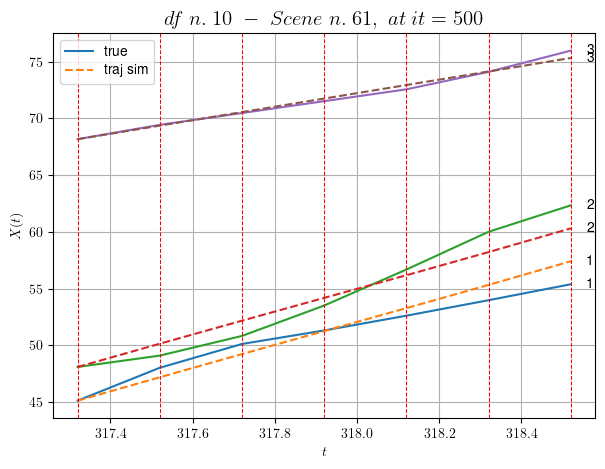

        For scene 61/74
        * use LR_NN=0.001 with err=101.3481110491163 at it=24
        * v0_scn_mean = 7.4018268051724
        * MAE = 0.9241132846014044



df n.10, scene n.62/74
    We have 4 time intervals inside [321.12,321.92]
            - Time interval n.0: [321.12, 321.32]
                * y_true: [25.50087189 14.95118626]
                * v_ann: [19.33743667602539, 17.906137466430664, 25.328428635552914]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [321.32, 321.52]
                * y_true: [23.87107171  3.25027229]
                * v_ann: [19.112573623657227, 18.316198348999023, 25.328428635552914]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [321.52, 321.72]
                * y_true: [25.04128771 23.00208642]
                * v_ann: [18.104644775390625, 18.706716537475586, 25.32842863555

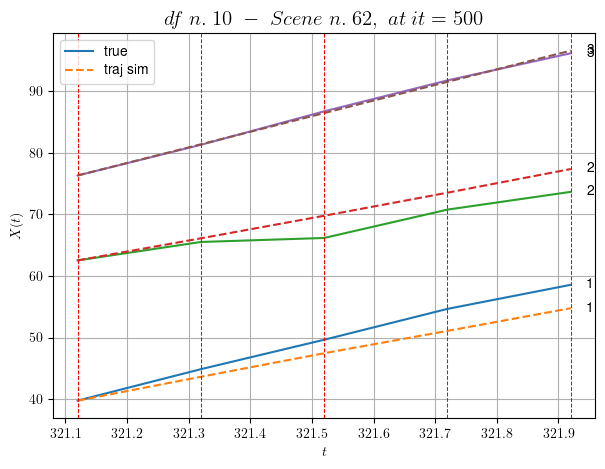

        For scene 62/74
        * use LR_NN=0.0001 with err=4.575553901917698 at it=24
        * v0_scn_mean = 25.608722707676396
        * MAE = 4.35167277398022



df n.10, scene n.63/74
    We have 4 time intervals inside [323.12,323.92]
            - Time interval n.0: [323.12, 323.32]
                * y_true: [ 6.90008114 15.05052158]
                * v_ann: [12.169904708862305, 11.526001930236816, 13.16131714775954]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [323.32, 323.52]
                * y_true: [ 8.30010994 16.45065772]
                * v_ann: [12.046719551086426, 11.5615873336792, 13.16131714775954]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [323.52, 323.72]
                * y_true: [ 9.85014911 16.15074097]
                * v_ann: [11.961466789245605, 11.612791061401367, 13.161317147759

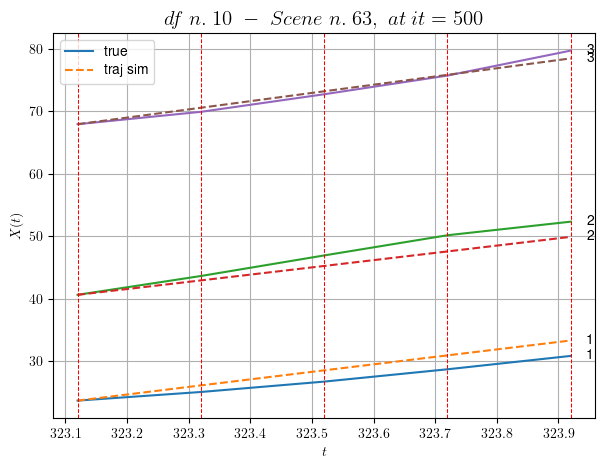

        For scene 63/74
        * use LR_NN=5e-05 with err=21.874112914470842 at it=24
        * v0_scn_mean = 14.171637362873575
        * MAE = 2.236402963256664



df n.10, scene n.64/74
    We have 3 time intervals inside [337.72,338.32]
            - Time interval n.0: [337.72, 337.92]
                * y_true: [11.69035174 22.47147634]
                * v_ann: [13.869771003723145, 14.058001518249512, 16.73844444980725]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [337.92, 338.12]
                * y_true: [10.20034007 18.27135214]
                * v_ann: [13.91536808013916, 14.321025848388672, 16.73844444980725]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.12, 338.32]
                * y_true: [ 7.94029275 13.91116184]
                * v_ann: [13.822209358215332, 14.33576774597168, 16.73844444980

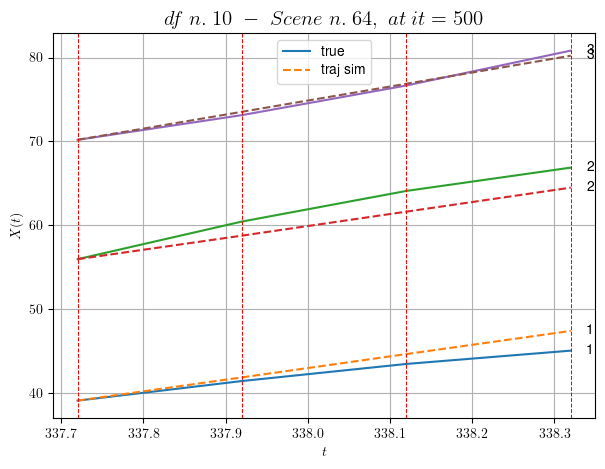

        For scene 64/74
        * use LR_NN=0.0001 with err=12.000082576803912 at it=24
        * v0_scn_mean = 17.534137187403676
        * MAE = 1.862248704766868



df n.10, scene n.65/74
    We have 3 time intervals inside [369.32,369.92]
            - Time interval n.0: [369.32, 369.52]
                * y_true: [22.34117259 11.42097363]
                * v_ann: [16.361549377441406, 16.446205139160156, 20.508861972534493]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.52, 369.72]
                * y_true: [22.31135956  8.65079743]
                * v_ann: [16.494230270385742, 16.509017944335938, 20.508861972534493]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.72, 369.92]
                * y_true: [16.17115552 17.53172003]
                * v_ann: [16.280109405517578, 16.326677322387695, 20.508861

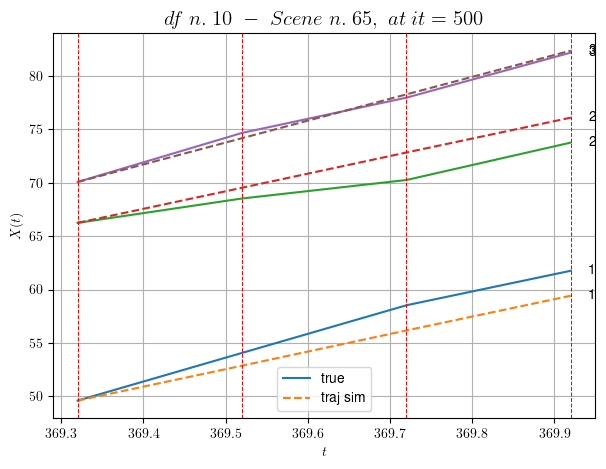

        For scene 65/74
        * use LR_NN=0.0005 with err=4.922208591295793 at it=24
        * v0_scn_mean = 21.078329828051007
        * MAE = 2.1611418882158158



df n.10, scene n.66/74
    We have 6 time intervals inside [370.92,372.12]
            - Time interval n.0: [370.92, 371.12]
                * y_true: [12.30016813 11.70074461]
                * v_ann: [9.924227714538574, 9.018723487854004, 19.892120453787278]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.12, 371.32]
                * y_true: [ 9.3501493  10.70073785]
                * v_ann: [10.60191535949707, 10.797085762023926, 19.892120453787278]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.32, 371.52]
                * y_true: [ 8.90016062 10.12074395]
                * v_ann: [10.396245956420898, 10.698620796203613, 19.892120453

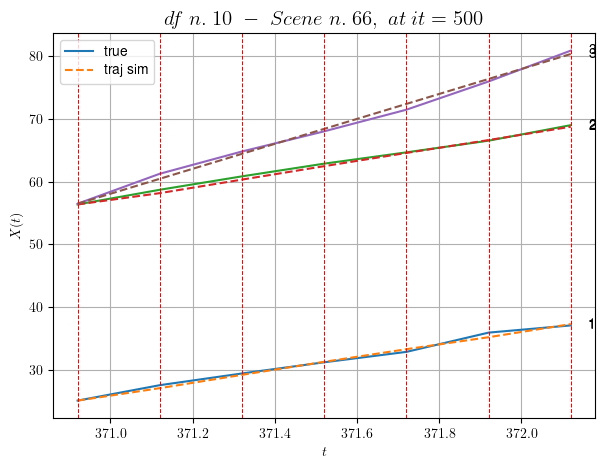

        For scene 66/74
        * use LR_NN=0.001 with err=20.220541037732062 at it=24
        * v0_scn_mean = 20.498592772738228
        * MAE = 0.19457436449927426



df n.10, scene n.67/74
    We have 3 time intervals inside [376.92,377.52]
            - Time interval n.0: [376.92, 377.12]
                * y_true: [ 9.78017765 12.68091602]
                * v_ann: [11.072627067565918, 11.084150314331055, 13.629666231203483]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [377.12, 377.32]
                * y_true: [10.39021059 11.81092637]
                * v_ann: [11.083395004272461, 11.089168548583984, 13.629666231203483]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [377.32, 377.52]
                * y_true: [10.59024861 11.25094207]
                * v_ann: [11.084455490112305, 11.089417457580566, 13.62966

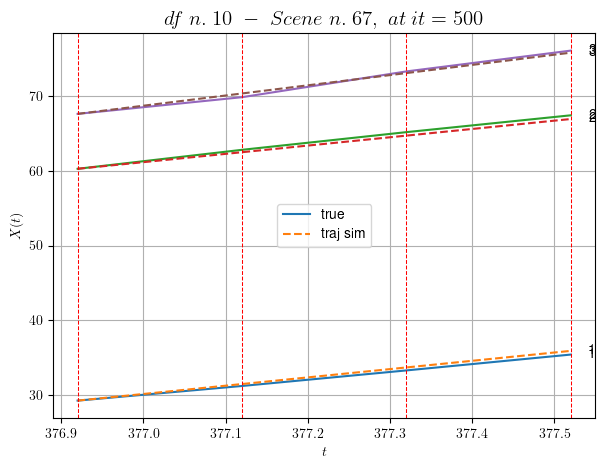

        For scene 67/74
        * use LR_NN=0.0001 with err=15.396558084689604 at it=24
        * v0_scn_mean = 14.611885522338877
        * MAE = 0.11515129640067616



df n.10, scene n.68/74
    We have 3 time intervals inside [433.52,434.12]
            - Time interval n.0: [433.52, 433.72]
                * y_true: [21.56070162 24.64178312]
                * v_ann: [22.755746841430664, 22.320859909057617, 21.095678523799478]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [433.72, 433.92]
                * y_true: [20.75082718 21.171764  ]
                * v_ann: [23.422733306884766, 22.648033142089844, 21.095678523799478]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [433.92, 434.12]
                * y_true: [19.97093958 25.19244807]
                * v_ann: [20.827468872070312, 21.04327392578125, 21.09567

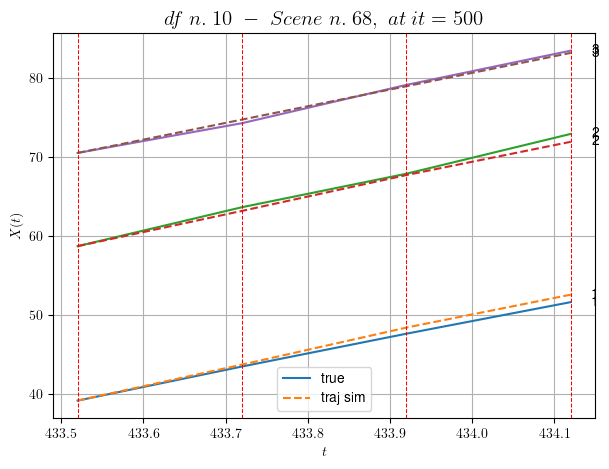

        For scene 68/74
        * use LR_NN=0.001 with err=7.637474827504609 at it=24
        * v0_scn_mean = 21.629937412587008
        * MAE = 0.2588610432509928



df n.10, scene n.69/74
    We have 2 time intervals inside [483.92,484.32]
            - Time interval n.0: [483.92, 484.12]
                * y_true: [19.08092085  0.51217506]
                * v_ann: [9.843103408813477, 9.86316204071045, 22.61891693965095]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [484.12, 484.32]
                * y_true: [19.26103904  0.51217506]
                * v_ann: [9.842692375183105, 9.820796966552734, 22.61891693965095]

----------------------------------------------------------------------------------------------------
    * err= 3.8874643547946417
    * Learning rate NN = 0.0007289999630302191
    * diff = 0.000893181271871768


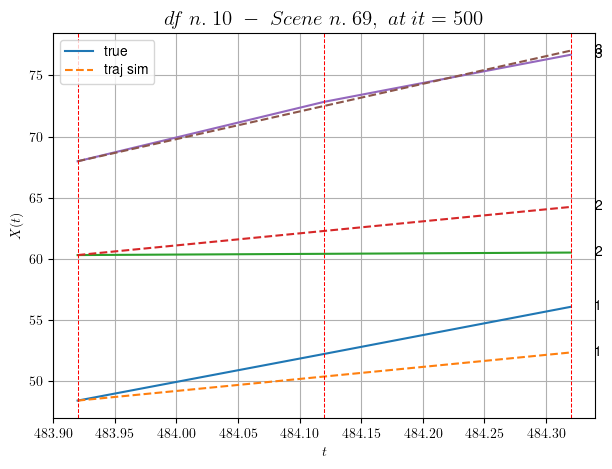

        For scene 69/74
        * use LR_NN=0.001 with err=4.921759363099487 at it=24
        * v0_scn_mean = 23.061781591876205
        * MAE = 3.8874643547946417



df n.10, scene n.70/74
    We have 3 time intervals inside [531.72,532.32]
            - Time interval n.0: [531.72, 531.92]
                * y_true: [0.21693371 8.7044085 ]
                * v_ann: [9.570411682128906, 8.8480224609375, 18.205173948354133]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.92, 532.12]
                * y_true: [13.20333652  9.14775604]
                * v_ann: [9.535364151000977, 8.864584922790527, 18.205173948354133]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.12, 532.32]
                * y_true: [18.40074328  5.60188997]
                * v_ann: [9.546146392822266, 8.953771591186523, 18.205173948354133]


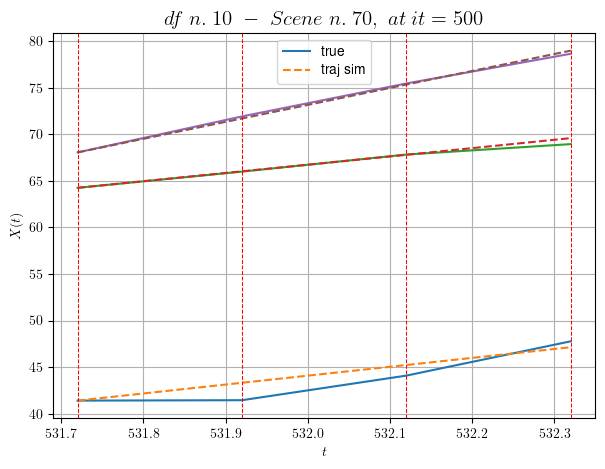

        For scene 70/74
        * use LR_NN=5e-05 with err=8.727612419987295 at it=24
        * v0_scn_mean = 18.91286298189043
        * MAE = 0.48191815618838124



df n.10, scene n.71/74
    We have 3 time intervals inside [202.52,203.12]
            - Time interval n.0: [202.52, 202.72]
                * y_true: [23.35318258 28.37081651 28.03104175]
                * v_ann: [27.915245056152344, 27.880136489868164, 28.11280059814453, 24.014144704149427]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [202.72, 202.92]
                * y_true: [23.6005682  33.85129081 29.41136895]
                * v_ann: [26.864099502563477, 27.18287467956543, 25.60428810119629, 24.014144704149427]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [202.92, 203.12]
                * y_true: [26.25082225 32.65166271 26.3315156 ]
   

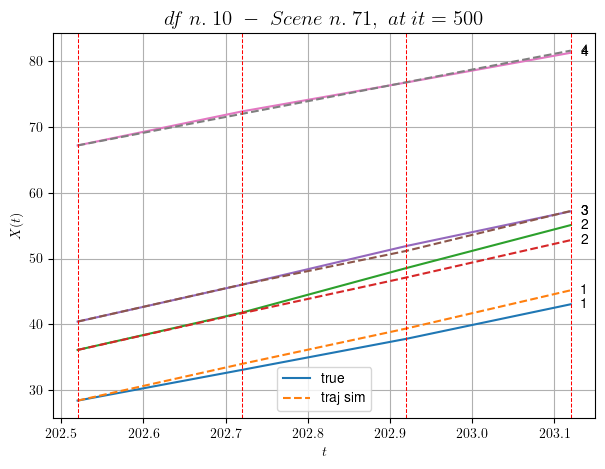

        For scene 71/74
        * use LR_NN=0.001 with err=17.77880495650395 at it=24
        * v0_scn_mean = 24.492993649053158
        * MAE = 0.9935829450202378



df n.10, scene n.72/74
    We have 2 time intervals inside [342.92,343.32]
            - Time interval n.0: [342.92, 343.12]
                * y_true: [ 9.90771225 17.81228574 16.23940532]
                * v_ann: [15.989265441894531, 15.792383193969727, 15.99332046508789, 15.47153779428759]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [343.12, 343.32]
                * y_true: [13.33029638 14.00078454 21.70124661]
                * v_ann: [15.01519775390625, 15.067506790161133, 15.034528732299805, 15.47153779428759]

----------------------------------------------------------------------------------------------------
    * err= 0.5179627215982867
    * Learning rate NN = 0.0007289999630302191
    * diff = 1.0450907699244283e-06


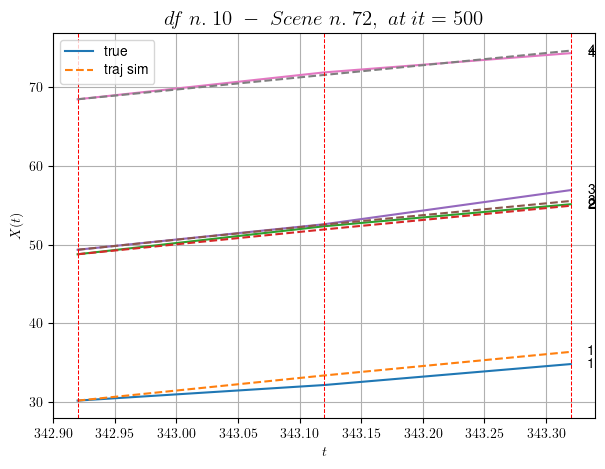

        For scene 72/74
        * use LR_NN=0.001 with err=7.118952709138463 at it=24
        * v0_scn_mean = 16.633767493208335
        * MAE = 0.5171016545921265



df n.10, scene n.73/74
    We have 2 time intervals inside [441.12,441.52]
            - Time interval n.0: [441.12, 441.32]
                * y_true: [16.40031153 12.42055509 15.89074593]
                * v_ann: [15.193495750427246, 15.143889427185059, 15.227200508117676, 19.35260174440309]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [441.32, 441.52]
                * y_true: [16.46038907  8.18039995 21.4511847 ]
                * v_ann: [15.079570770263672, 15.107612609863281, 15.047484397888184, 19.35260174440309]

----------------------------------------------------------------------------------------------------
    * err= 0.5771212381911542
    * Learning rate NN = 0.00036449998151510954
    * diff = 1.4912782820841741e-06


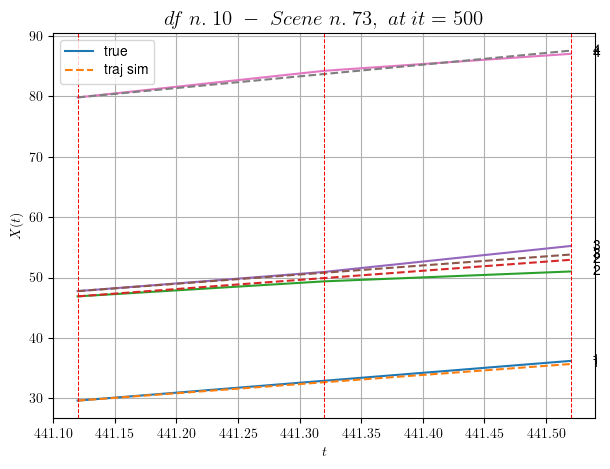

        For scene 73/74
        * use LR_NN=0.0005 with err=3.4727257573164847 at it=24
        * v0_scn_mean = 20.20435895680844
        * MAE = 0.5761528077738456



For df=10 with 74 scenes, time taken:        1546.98
****************************************************************************************************

Time taken for the computation: 12517.64
----------------------------------------------------------------------------------------------------


In [5]:
info_nn10 = solve_nn_dataset(DOE, v0_guess, dataset, processed_flag, NUM_ITER, LEARNING_RATE_v0)

## Prepare the out dir

In [6]:
# Create the directory..
if flag_save:
    
    ext = ".svg"
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{DOE[1]}")
    
    path = 'out/' + d
    os.mkdir(path)

In [7]:
if flag_save:
    # Save the solution in a file
    namefile = '/info_nn10.txt'

    with open(path + namefile, 'w') as output:
        info_nn10.to_csv(path + namefile, sep=',', index=False)